<a href="https://colab.research.google.com/github/jerryzhu1/Have-fun-with-deep-learning----pytorch-tensorflow/blob/master/GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install torchvision tensorboardx jupyter matplotlib numpy

In [0]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets


In [0]:
import os
import numpy as np
import errno
import torchvision.utils as vutils
from tensorboardX import SummaryWriter
from IPython import display
from matplotlib import pyplot as plt
import torch

'''
    TensorBoard Data will be stored in './runs' path
'''


class Logger:

    def __init__(self, model_name, data_name):
        self.model_name = model_name
        self.data_name = data_name

        self.comment = '{}_{}'.format(model_name, data_name)
        self.data_subdir = '{}/{}'.format(model_name, data_name)

        # TensorBoard
        self.writer = SummaryWriter(comment=self.comment)

    def log(self, d_error, g_error, epoch, n_batch, num_batches):

        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()

        step = Logger._step(epoch, n_batch, num_batches)
        self.writer.add_scalar(
            '{}/D_error'.format(self.comment), d_error, step)
        self.writer.add_scalar(
            '{}/G_error'.format(self.comment), g_error, step)

    def log_images(self, images, num_images, epoch, n_batch, num_batches, format='NCHW', normalize=True):
        '''
        input images are expected in format (NCHW)
        '''
        if type(images) == np.ndarray:
            images = torch.from_numpy(images)
        
        if format=='NHWC':
            images = images.transpose(1,3)
        

        step = Logger._step(epoch, n_batch, num_batches)
        img_name = '{}/images{}'.format(self.comment, '')

        # Make horizontal grid from image tensor
        horizontal_grid = vutils.make_grid(
            images, normalize=normalize, scale_each=True)
        # Make vertical grid from image tensor
        nrows = int(np.sqrt(num_images))
        grid = vutils.make_grid(
            images, nrow=nrows, normalize=True, scale_each=True)

        # Add horizontal images to tensorboard
        self.writer.add_image(img_name, horizontal_grid, step)

        # Save plots
        self.save_torch_images(horizontal_grid, grid, epoch, n_batch)

    def save_torch_images(self, horizontal_grid, grid, epoch, n_batch, plot_horizontal=True):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)

        # Plot and save horizontal
        fig = plt.figure(figsize=(16, 16))
        plt.imshow(np.moveaxis(horizontal_grid.numpy(), 0, -1))
        plt.axis('off')
        if plot_horizontal:
            display.display(plt.gcf())
        self._save_images(fig, epoch, n_batch, 'hori')
        plt.close()

        # Save squared
        fig = plt.figure()
        plt.imshow(np.moveaxis(grid.numpy(), 0, -1))
        plt.axis('off')
        self._save_images(fig, epoch, n_batch)
        plt.close()

    def _save_images(self, fig, epoch, n_batch, comment=''):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        fig.savefig('{}/{}_epoch_{}_batch_{}.png'.format(out_dir,
                                                         comment, epoch, n_batch))

    def display_status(self, epoch, num_epochs, n_batch, num_batches, d_error, g_error, d_pred_real, d_pred_fake):
        
        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()
        if isinstance(d_pred_real, torch.autograd.Variable):
            d_pred_real = d_pred_real.data
        if isinstance(d_pred_fake, torch.autograd.Variable):
            d_pred_fake = d_pred_fake.data
        
        
        print('Epoch: [{}/{}], Batch Num: [{}/{}]'.format(
            epoch,num_epochs, n_batch, num_batches)
             )
        print('Discriminator Loss: {:.4f}, Generator Loss: {:.4f}'.format(d_error, g_error))
        print('D(x): {:.4f}, D(G(z)): {:.4f}'.format(d_pred_real.mean(), d_pred_fake.mean()))

    def save_models(self, generator, discriminator, epoch):
        out_dir = './data/models/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        torch.save(generator.state_dict(),
                   '{}/G_epoch_{}'.format(out_dir, epoch))
        torch.save(discriminator.state_dict(),
                   '{}/D_epoch_{}'.format(out_dir, epoch))

    def close(self):
        self.writer.close()

    # Private Functionality

    @staticmethod
    def _step(epoch, n_batch, num_batches):
        return epoch * num_batches + n_batch

    @staticmethod
    def _make_dir(directory):
        try:
            os.makedirs(directory)
        except OSError as e:
            if e.errno != errno.EEXIST:
                raise

In [0]:
def mnist_data():
    # compose = transforms.Compose(
    #     [transforms.ToTensor(),
    #      transforms.Normalize((.5, .5, .5), (.5, .5, .5))
    #     ])
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize([.5], [.5])
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

In [0]:
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# device = 'cpu'

In [0]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
discriminator = DiscriminatorNet().to(device)

In [0]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [0]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet().to(device)

In [0]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100)).to(device)
    return n

In [0]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [0]:
loss = nn.BCELoss()

In [0]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1)).to(device)

    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1)).to(device)
    return data

In [0]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data).to(device)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N))
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [0]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [0]:
num_test_samples = 16
test_noise = noise(num_test_samples)

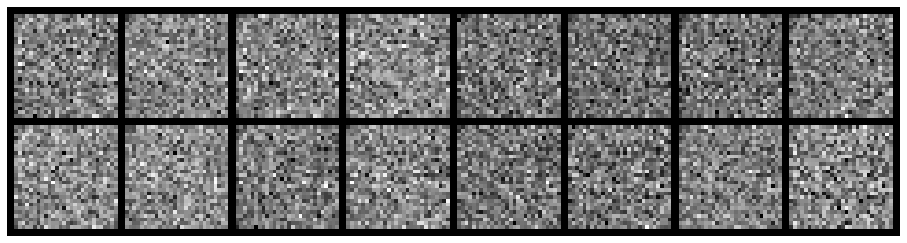

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3899, Generator Loss: 0.7150
D(x): 0.4875, D(G(z)): 0.4888


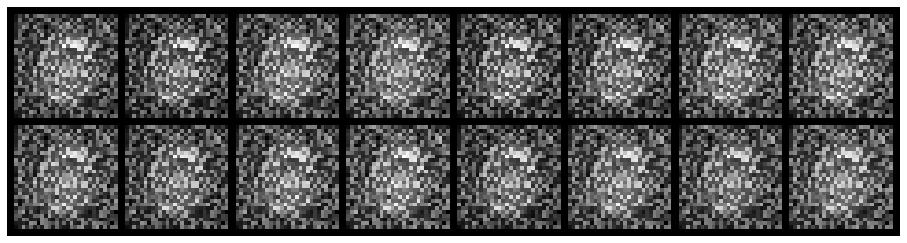

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.8215, Generator Loss: 1.8688
D(x): 0.7407, D(G(z)): 0.3147


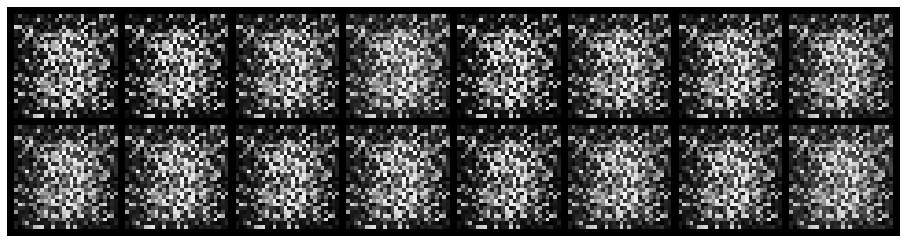

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.6537, Generator Loss: 2.9056
D(x): 0.7670, D(G(z)): 0.2629


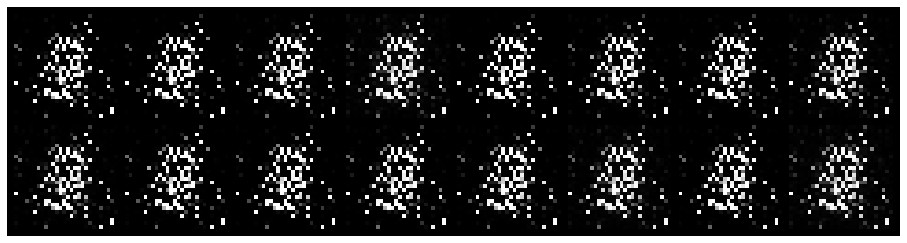

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0882, Generator Loss: 5.6972
D(x): 0.9722, D(G(z)): 0.0515


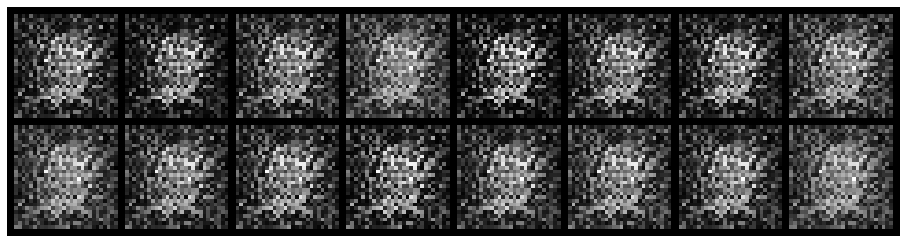

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.9898, Generator Loss: 1.5092
D(x): 0.6187, D(G(z)): 0.3768


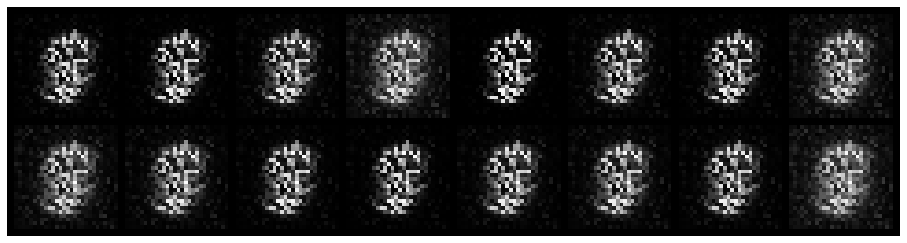

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 1.2529, Generator Loss: 0.9501
D(x): 0.5401, D(G(z)): 0.4432


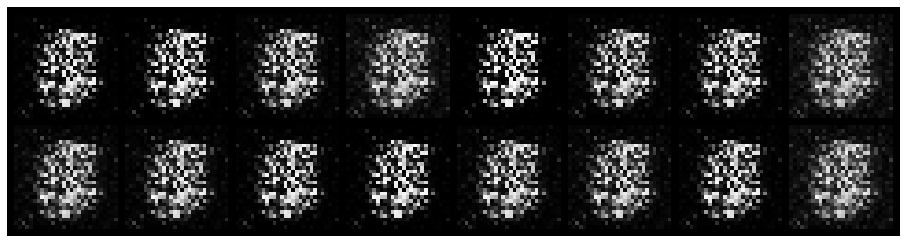

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.5087, Generator Loss: 3.0152
D(x): 0.7165, D(G(z)): 0.1465


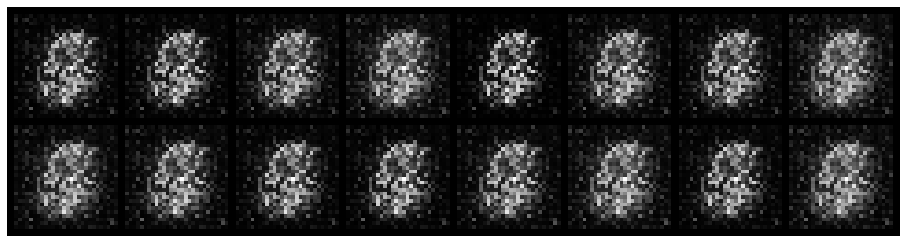

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.6968, Generator Loss: 2.2481
D(x): 0.7231, D(G(z)): 0.2459


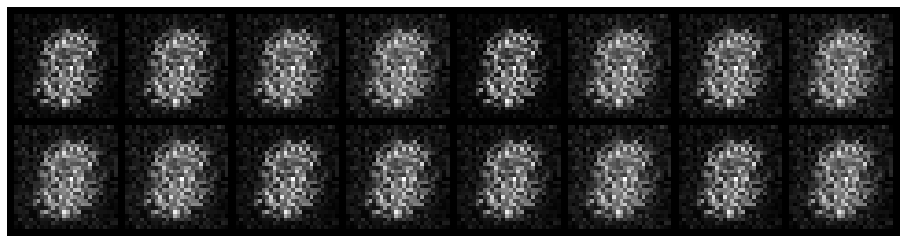

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.5428, Generator Loss: 0.7104
D(x): 0.6127, D(G(z)): 0.5953


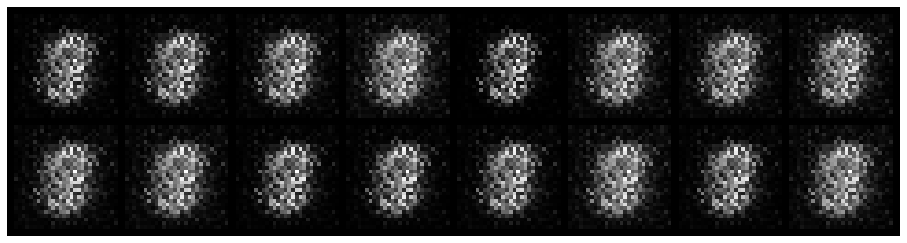

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 1.4118, Generator Loss: 1.5503
D(x): 0.5421, D(G(z)): 0.3887


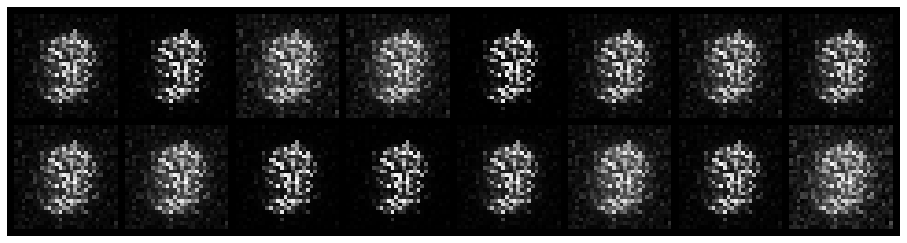

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.2154, Generator Loss: 2.4902
D(x): 0.7031, D(G(z)): 0.3116


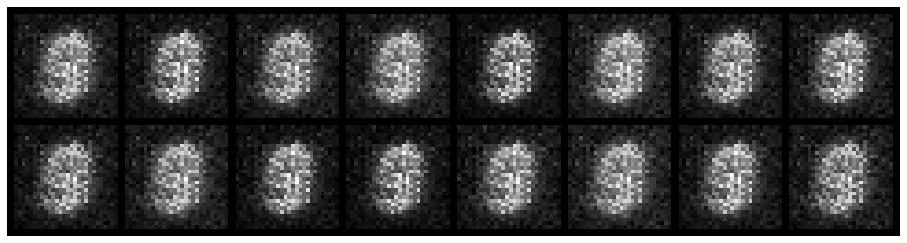

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.2840, Generator Loss: 2.2956
D(x): 0.8690, D(G(z)): 0.1191


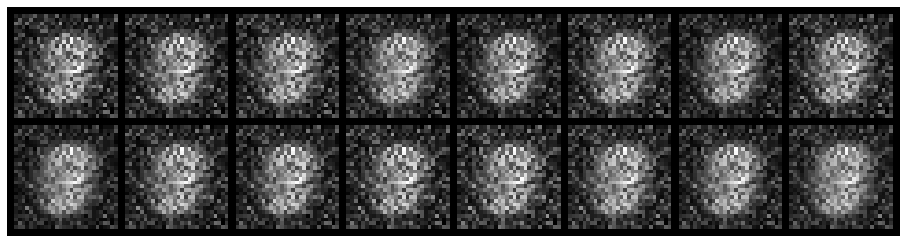

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.5018, Generator Loss: 1.5762
D(x): 0.8797, D(G(z)): 0.2965


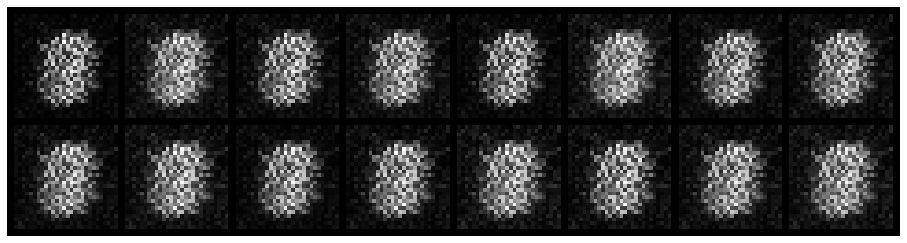

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.6196, Generator Loss: 2.1007
D(x): 0.8089, D(G(z)): 0.2770


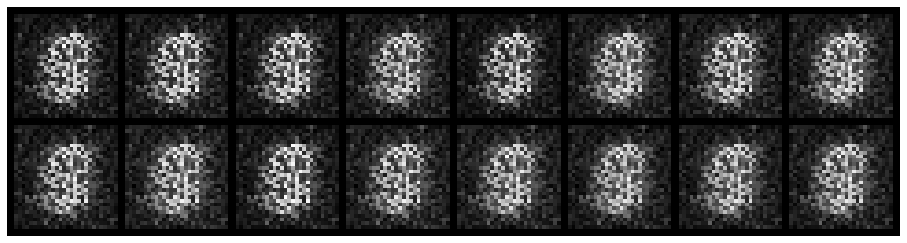

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.8745, Generator Loss: 1.7388
D(x): 0.8456, D(G(z)): 0.4376


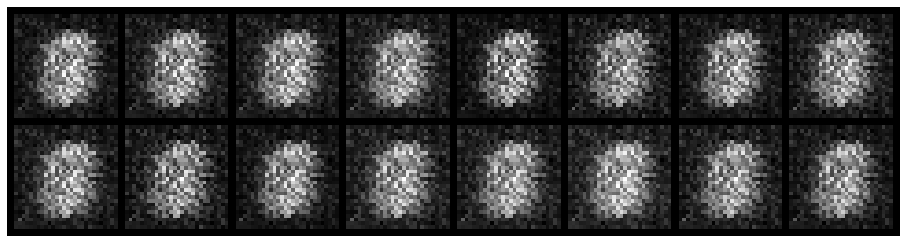

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 1.2469, Generator Loss: 0.9086
D(x): 0.6362, D(G(z)): 0.4880


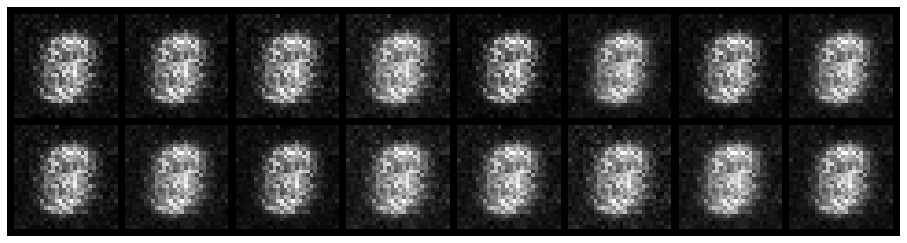

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.8326, Generator Loss: 1.4178
D(x): 0.7417, D(G(z)): 0.3485


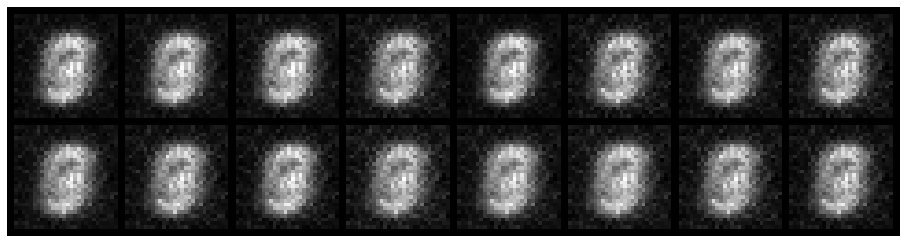

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.8743, Generator Loss: 1.6422
D(x): 0.6656, D(G(z)): 0.3092


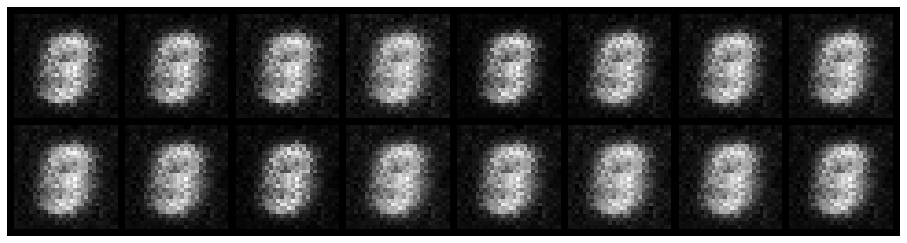

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 1.2555, Generator Loss: 0.6869
D(x): 0.6419, D(G(z)): 0.5325


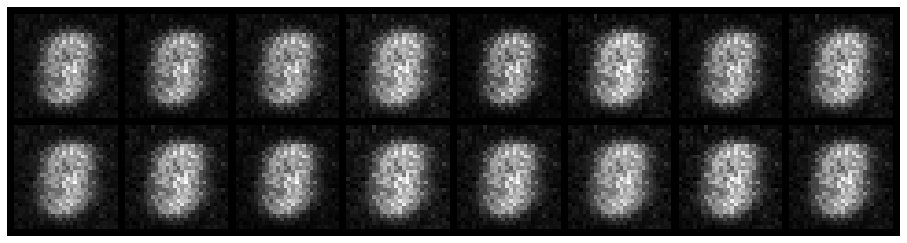

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 1.9192, Generator Loss: 0.7129
D(x): 0.4641, D(G(z)): 0.5335


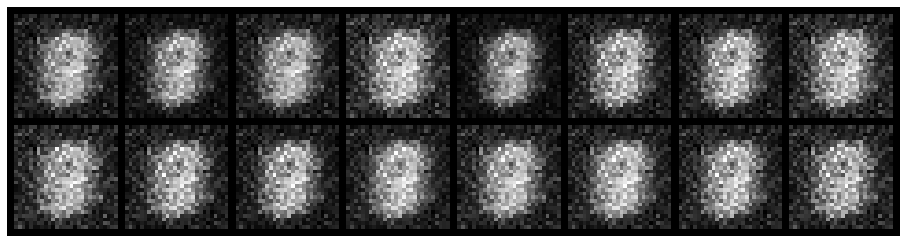

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.7942, Generator Loss: 2.3956
D(x): 0.7788, D(G(z)): 0.2770


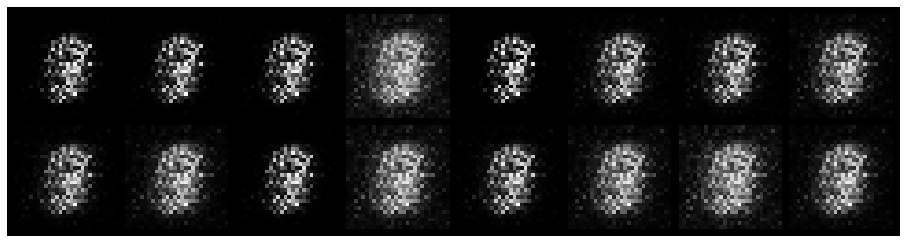

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.7856, Generator Loss: 2.4689
D(x): 0.6824, D(G(z)): 0.2081


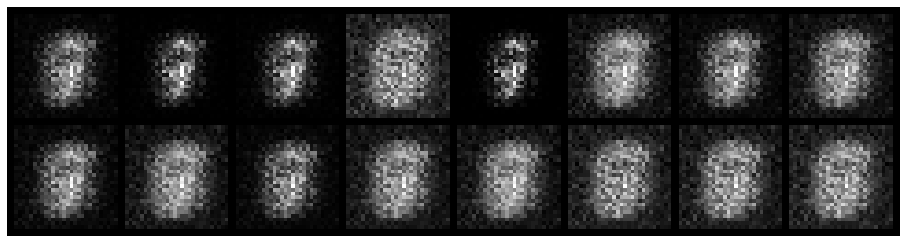

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.6390, Generator Loss: 2.5781
D(x): 0.8094, D(G(z)): 0.2117


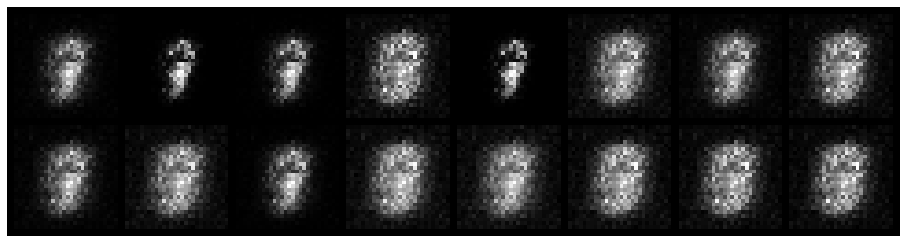

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.5386, Generator Loss: 2.5155
D(x): 0.8240, D(G(z)): 0.1700


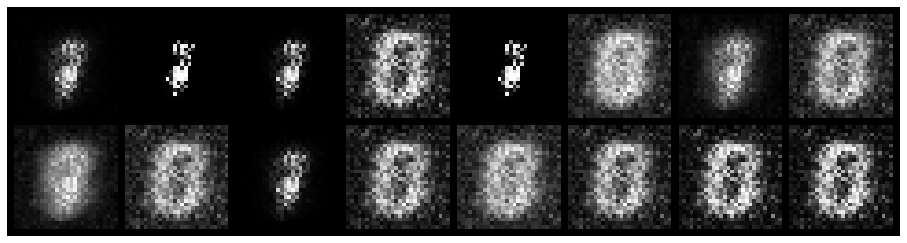

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 1.1283, Generator Loss: 2.1227
D(x): 0.7312, D(G(z)): 0.3422


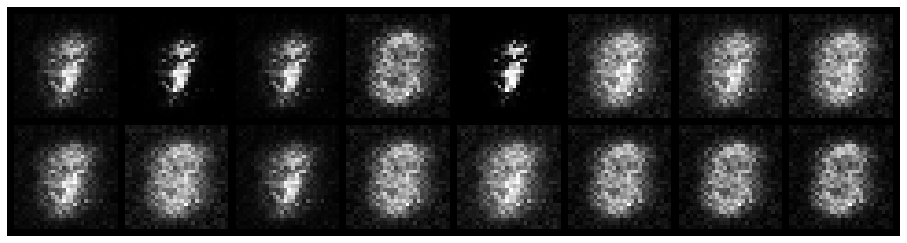

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.4848, Generator Loss: 2.2526
D(x): 0.8343, D(G(z)): 0.1488


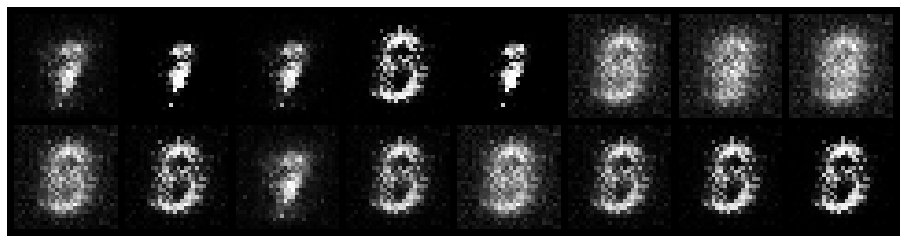

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.5661, Generator Loss: 2.3273
D(x): 0.8944, D(G(z)): 0.2287


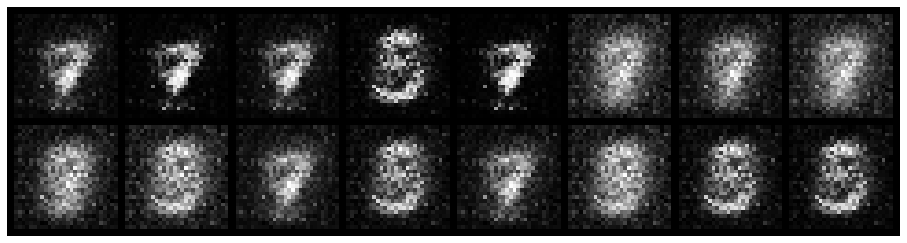

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.6323, Generator Loss: 1.5374
D(x): 0.8768, D(G(z)): 0.3114


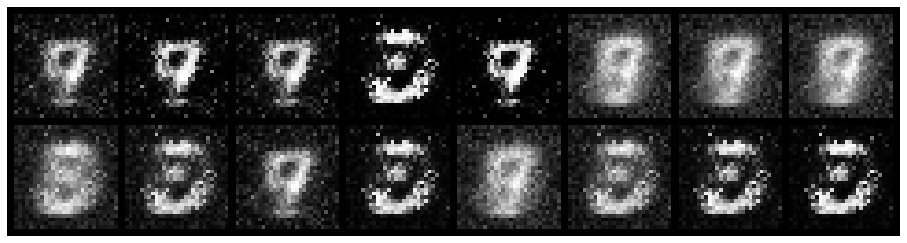

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.4725, Generator Loss: 2.2197
D(x): 0.9125, D(G(z)): 0.2278


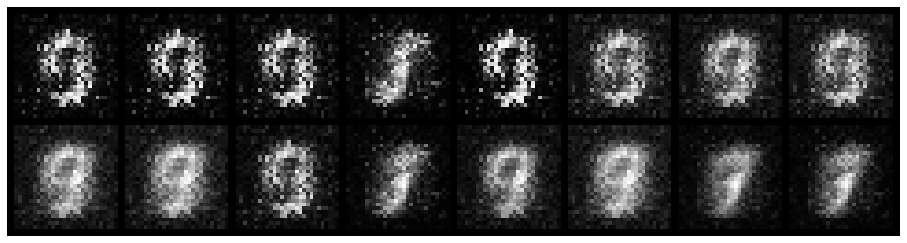

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.6219, Generator Loss: 2.0999
D(x): 0.7742, D(G(z)): 0.1660


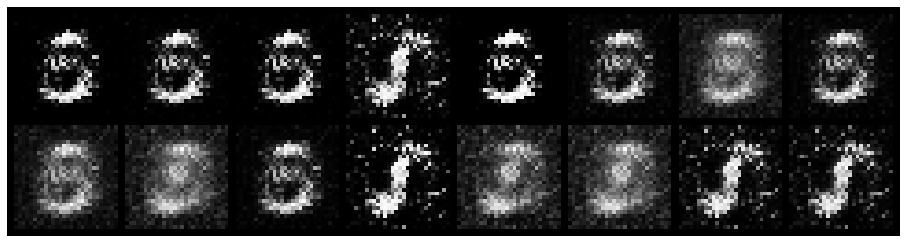

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.5729, Generator Loss: 2.9559
D(x): 0.8209, D(G(z)): 0.1996


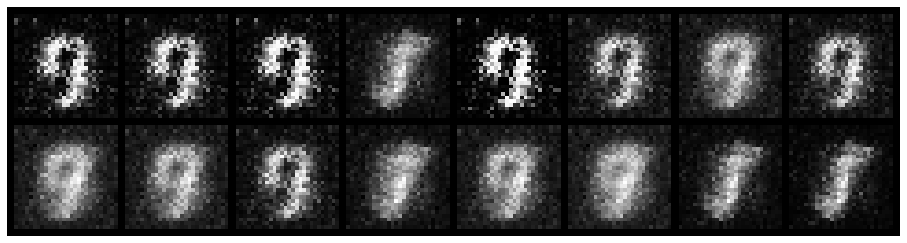

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.5841, Generator Loss: 2.6824
D(x): 0.8973, D(G(z)): 0.2466


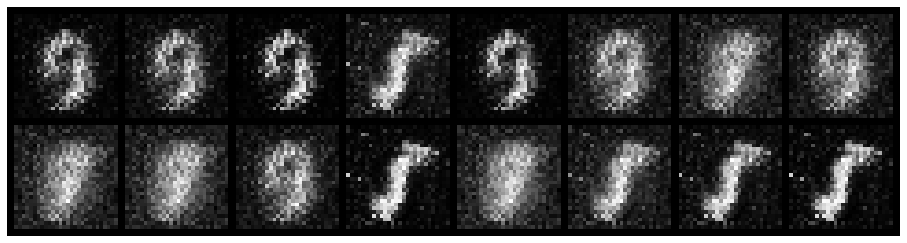

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3117, Generator Loss: 2.7062
D(x): 0.9308, D(G(z)): 0.1481


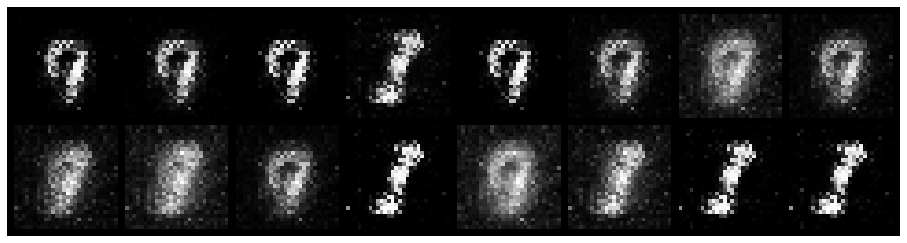

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.5414, Generator Loss: 3.8797
D(x): 0.8393, D(G(z)): 0.0862


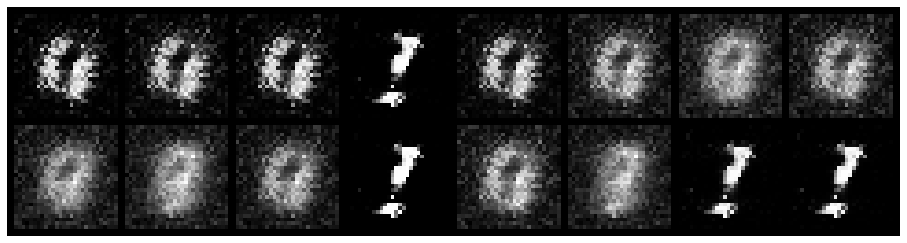

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.3221, Generator Loss: 3.1022
D(x): 0.8603, D(G(z)): 0.0944


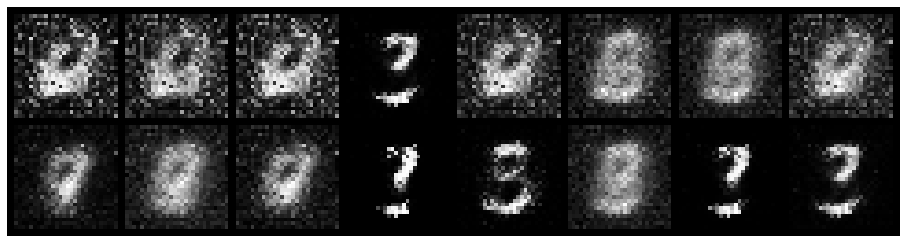

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.5834, Generator Loss: 2.7089
D(x): 0.8791, D(G(z)): 0.2113


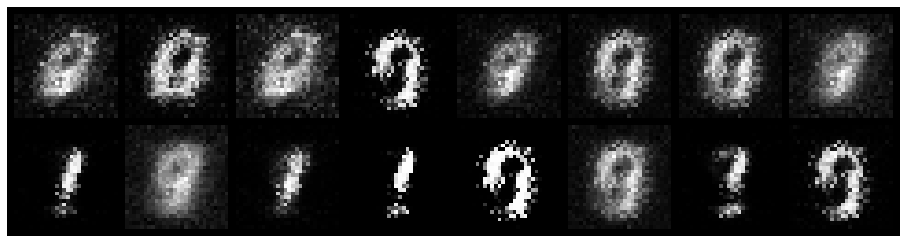

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.5869, Generator Loss: 3.4606
D(x): 0.8992, D(G(z)): 0.2183


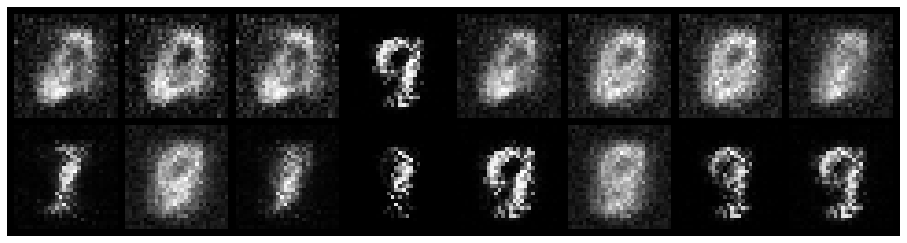

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.5215, Generator Loss: 2.6283
D(x): 0.8319, D(G(z)): 0.1375


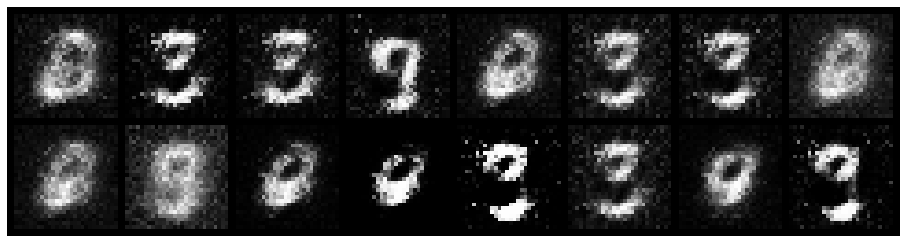

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.5581, Generator Loss: 2.4312
D(x): 0.8179, D(G(z)): 0.1641


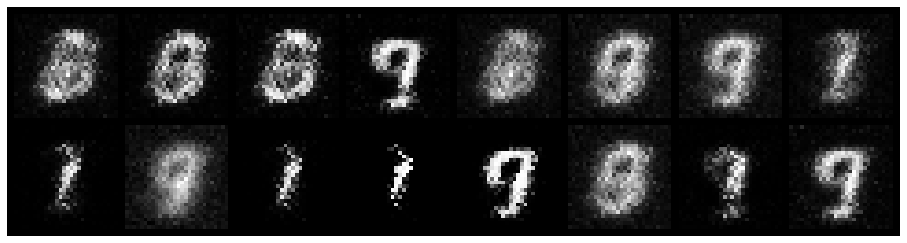

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.3263, Generator Loss: 2.4662
D(x): 0.9233, D(G(z)): 0.1707


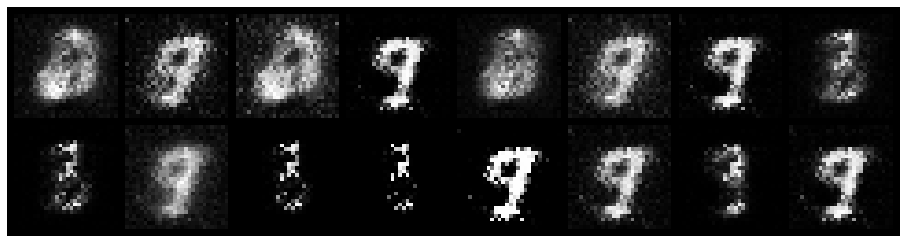

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.4578, Generator Loss: 1.8609
D(x): 0.8803, D(G(z)): 0.1998


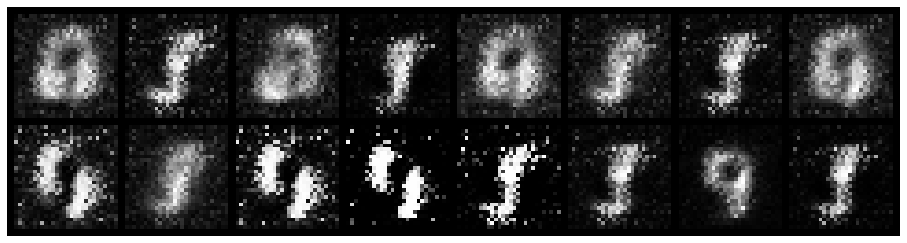

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.6619, Generator Loss: 2.8524
D(x): 0.8084, D(G(z)): 0.2036


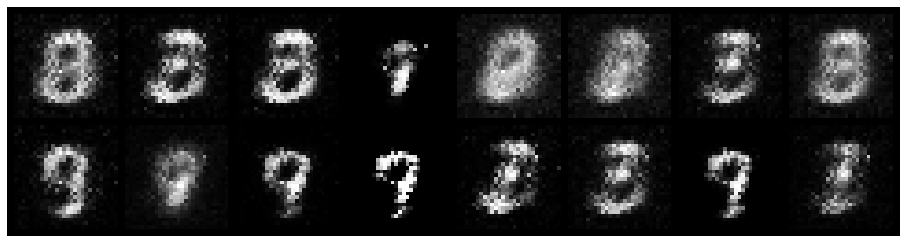

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.5877, Generator Loss: 2.7600
D(x): 0.8667, D(G(z)): 0.1859


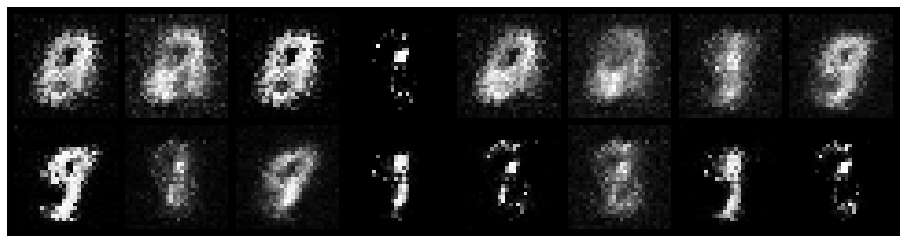

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.7690, Generator Loss: 2.6051
D(x): 0.7977, D(G(z)): 0.2267


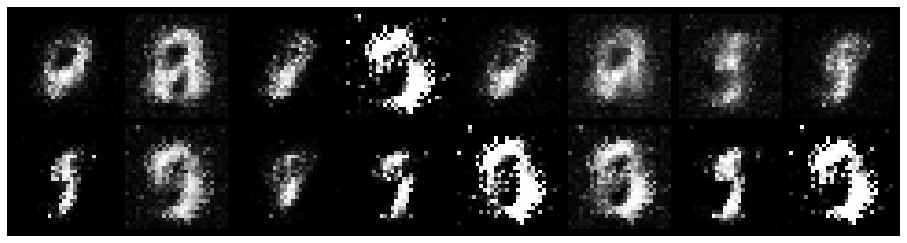

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.6945, Generator Loss: 2.8797
D(x): 0.8100, D(G(z)): 0.2031


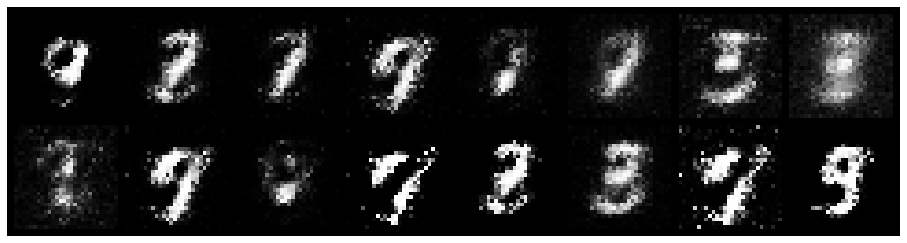

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.7577, Generator Loss: 2.2844
D(x): 0.8535, D(G(z)): 0.2938


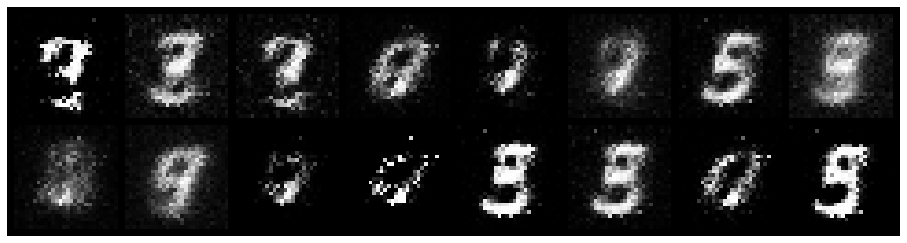

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.5918, Generator Loss: 2.0717
D(x): 0.8506, D(G(z)): 0.2035


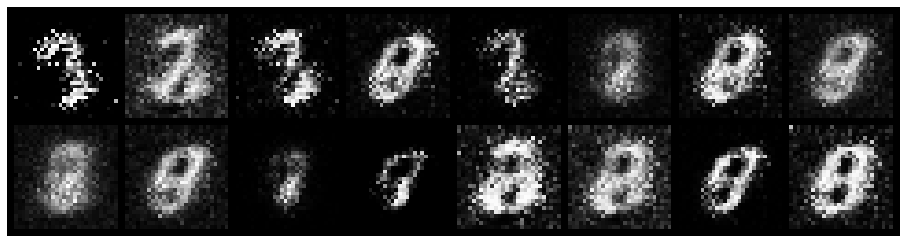

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.7577, Generator Loss: 1.9228
D(x): 0.8096, D(G(z)): 0.2534


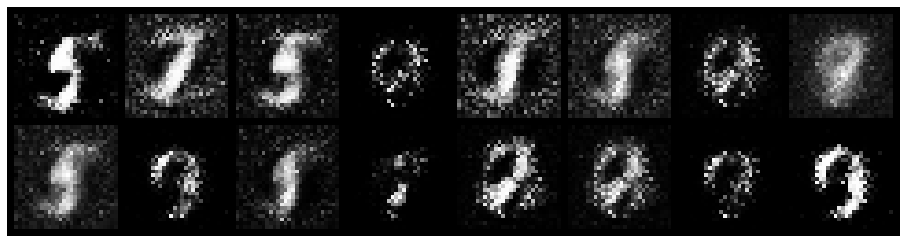

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.7094, Generator Loss: 1.7531
D(x): 0.7945, D(G(z)): 0.2718


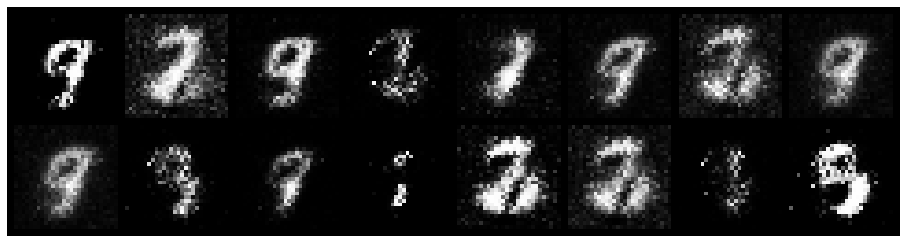

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5900, Generator Loss: 2.7029
D(x): 0.8133, D(G(z)): 0.1124


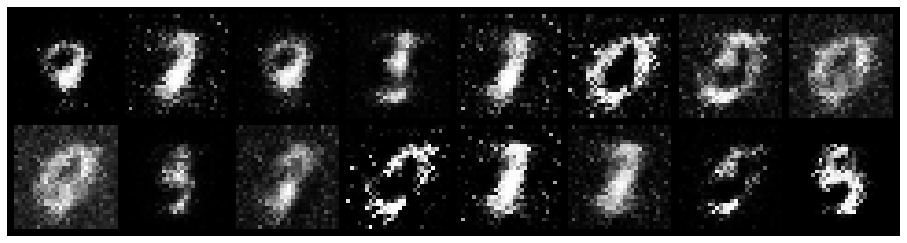

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.8156, Generator Loss: 2.8720
D(x): 0.8168, D(G(z)): 0.2490


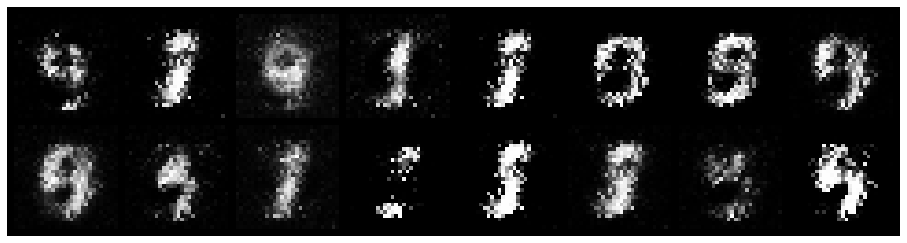

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.9274, Generator Loss: 2.0513
D(x): 0.7158, D(G(z)): 0.2636


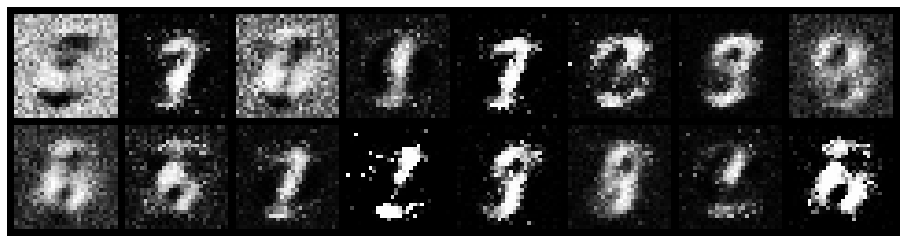

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 1.4217, Generator Loss: 1.5959
D(x): 0.6287, D(G(z)): 0.4052


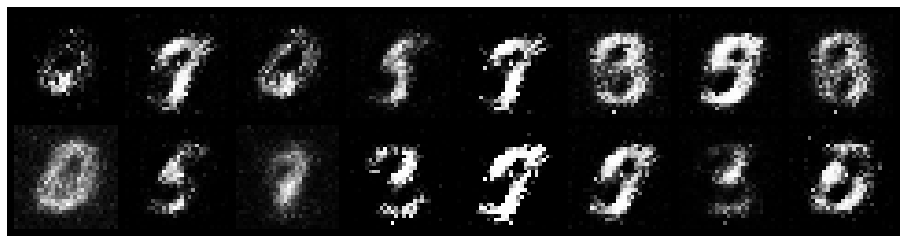

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.4684, Generator Loss: 2.4550
D(x): 0.8583, D(G(z)): 0.1911


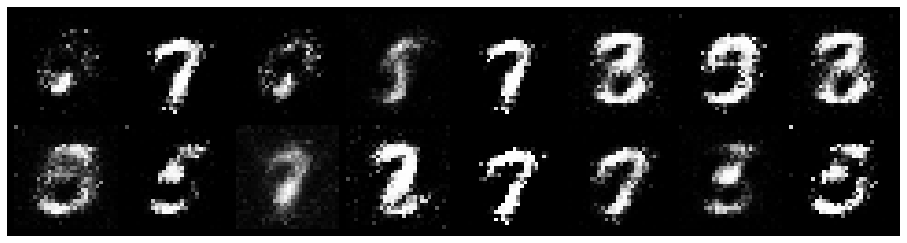

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7425, Generator Loss: 2.7306
D(x): 0.7946, D(G(z)): 0.1736


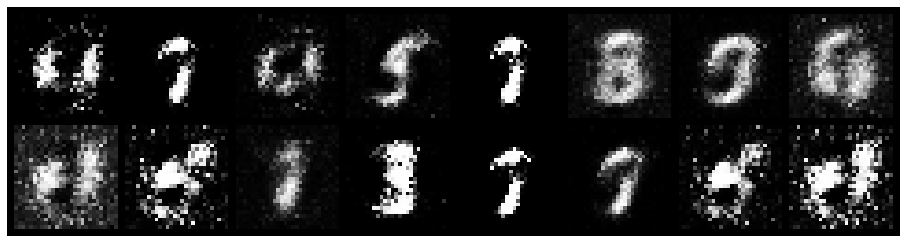

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.7614, Generator Loss: 3.0837
D(x): 0.7120, D(G(z)): 0.1105


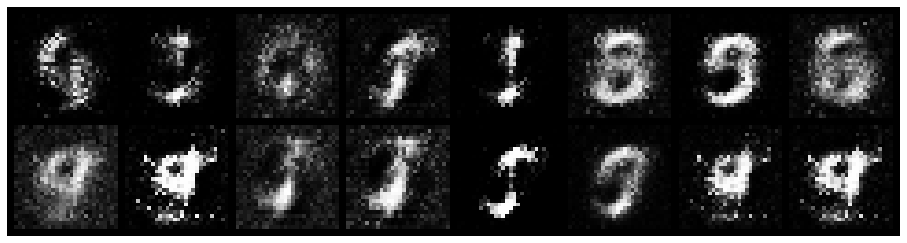

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.7868, Generator Loss: 2.0722
D(x): 0.7902, D(G(z)): 0.2805


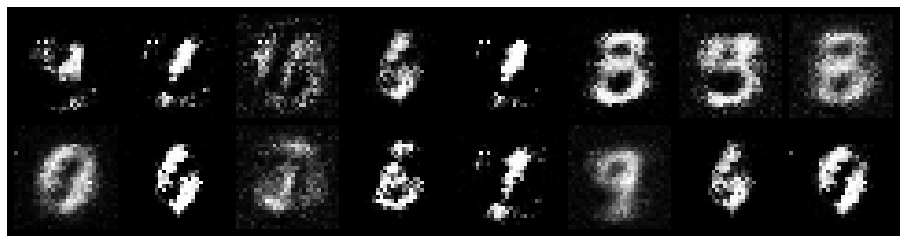

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.7325, Generator Loss: 2.0442
D(x): 0.8086, D(G(z)): 0.2687


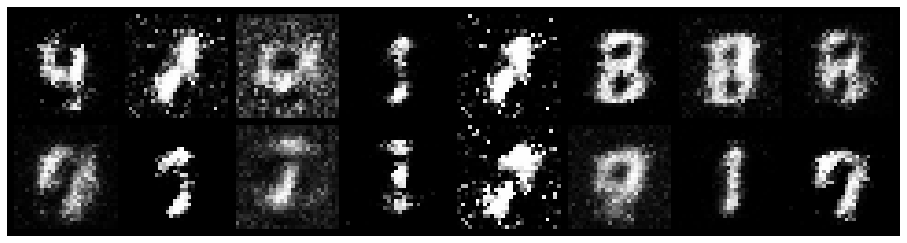

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.7845, Generator Loss: 2.2035
D(x): 0.8269, D(G(z)): 0.2258


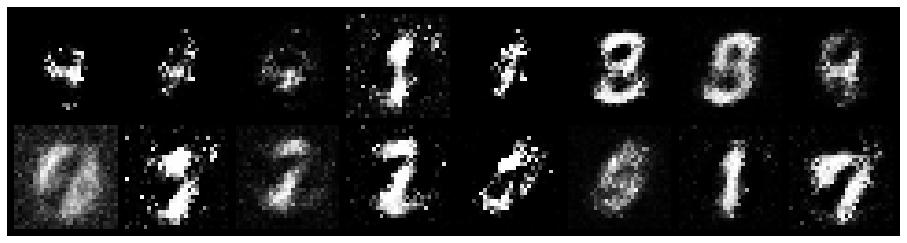

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.5411, Generator Loss: 2.7282
D(x): 0.8540, D(G(z)): 0.1725


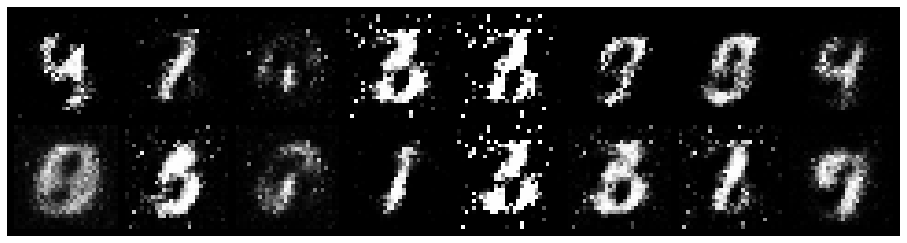

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.5053, Generator Loss: 3.2763
D(x): 0.8306, D(G(z)): 0.1205


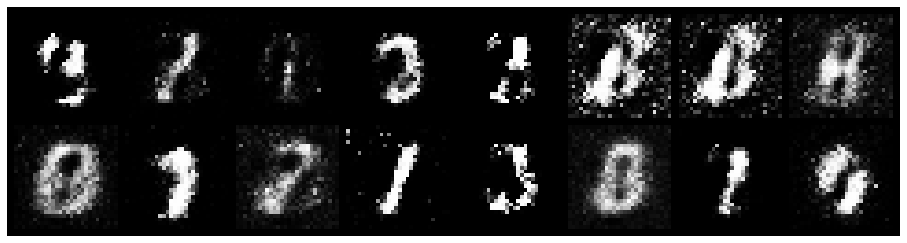

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.5655, Generator Loss: 2.9946
D(x): 0.8588, D(G(z)): 0.1943


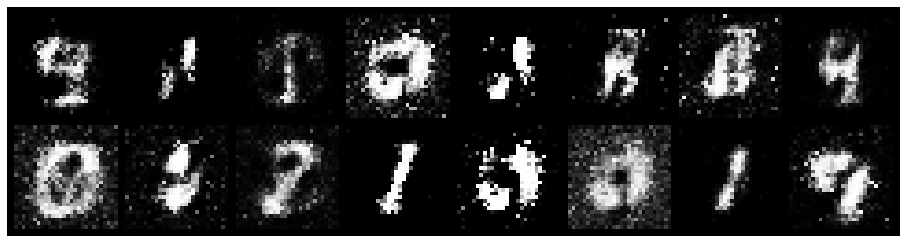

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.7397, Generator Loss: 2.3059
D(x): 0.7286, D(G(z)): 0.1738


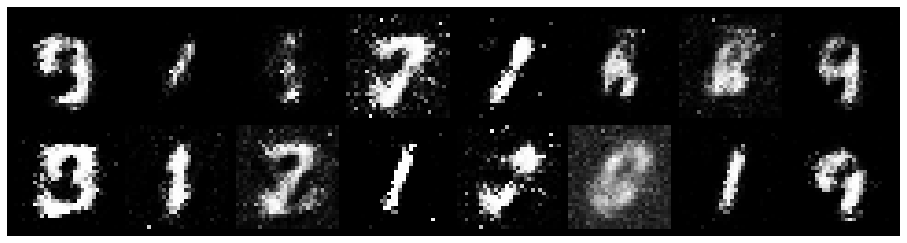

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.5095, Generator Loss: 2.2160
D(x): 0.8563, D(G(z)): 0.1726


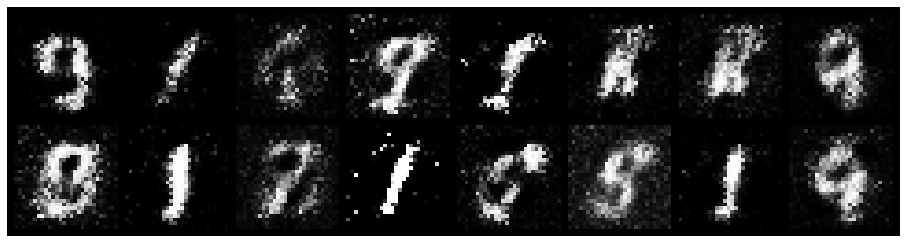

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.5552, Generator Loss: 2.1913
D(x): 0.8539, D(G(z)): 0.2054


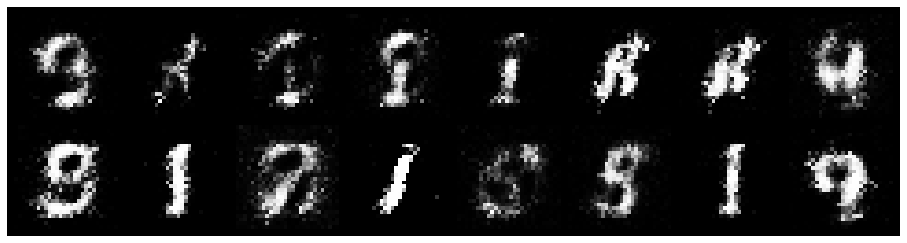

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.6505, Generator Loss: 1.9811
D(x): 0.8885, D(G(z)): 0.2868


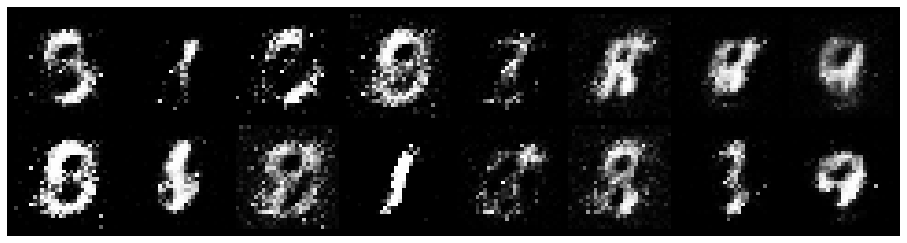

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.7913, Generator Loss: 1.4886
D(x): 0.7532, D(G(z)): 0.2575


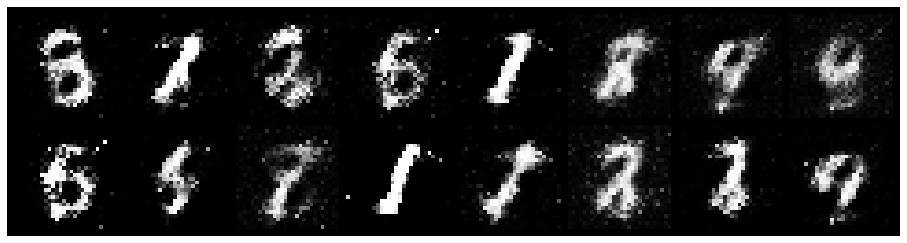

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.7561, Generator Loss: 2.0798
D(x): 0.7557, D(G(z)): 0.2287


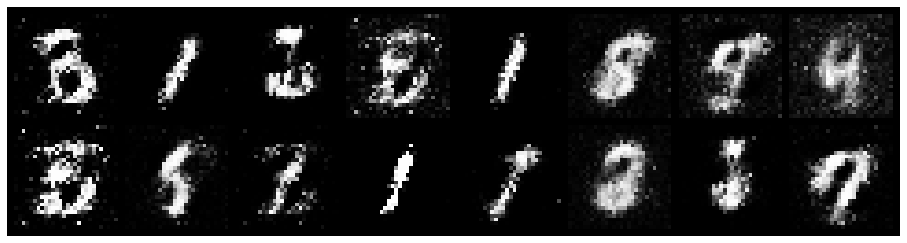

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.4309, Generator Loss: 2.4274
D(x): 0.8381, D(G(z)): 0.1477


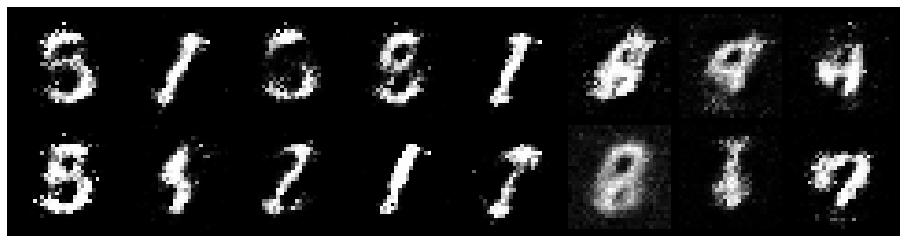

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.4695, Generator Loss: 2.7605
D(x): 0.8733, D(G(z)): 0.1796


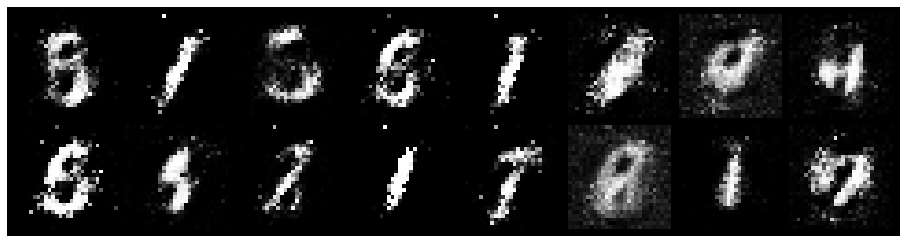

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.4992, Generator Loss: 2.7641
D(x): 0.8073, D(G(z)): 0.1239


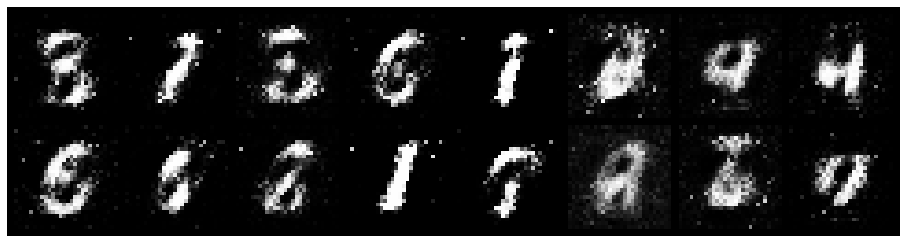

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.3927, Generator Loss: 2.6837
D(x): 0.8666, D(G(z)): 0.1336


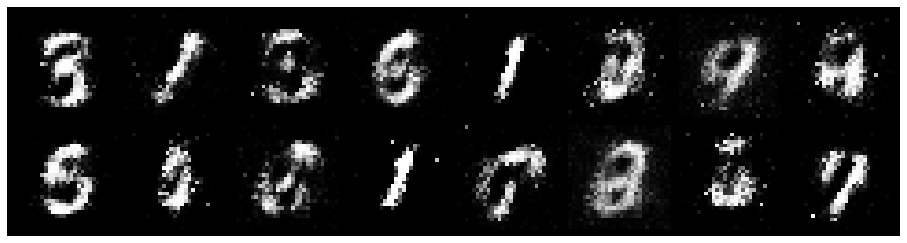

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.8155, Generator Loss: 1.8492
D(x): 0.6944, D(G(z)): 0.2252


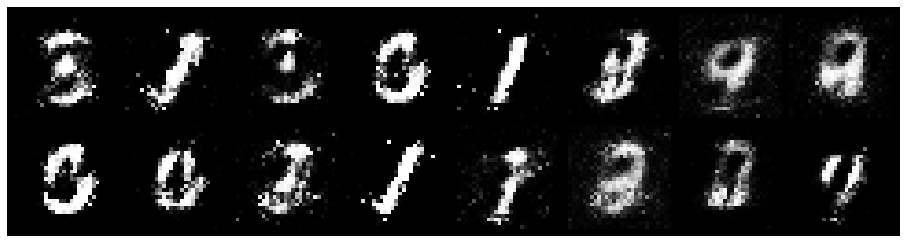

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.7861, Generator Loss: 1.8369
D(x): 0.7638, D(G(z)): 0.2964


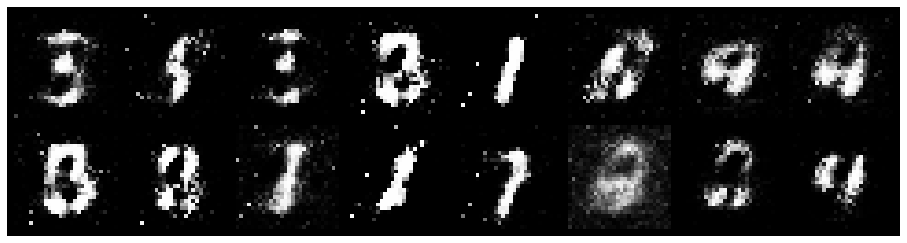

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.7121, Generator Loss: 1.5502
D(x): 0.7827, D(G(z)): 0.3055


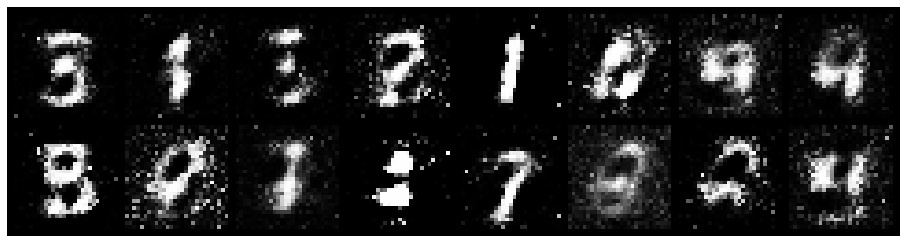

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.9024, Generator Loss: 1.5162
D(x): 0.8123, D(G(z)): 0.3705


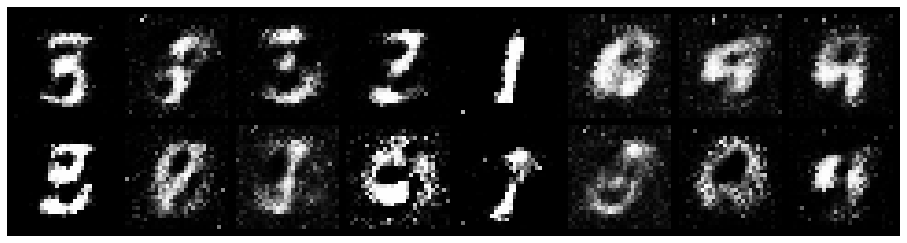

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.6785, Generator Loss: 1.6531
D(x): 0.7691, D(G(z)): 0.2331


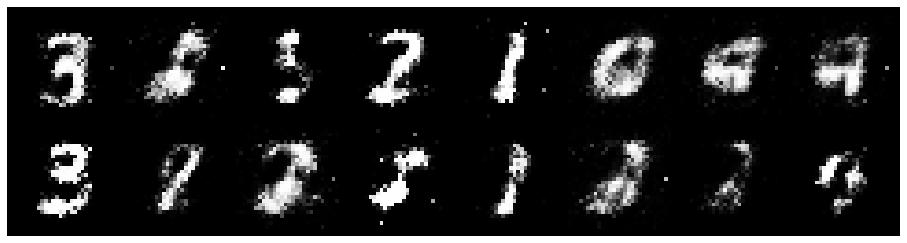

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.8569, Generator Loss: 1.9356
D(x): 0.7583, D(G(z)): 0.2483


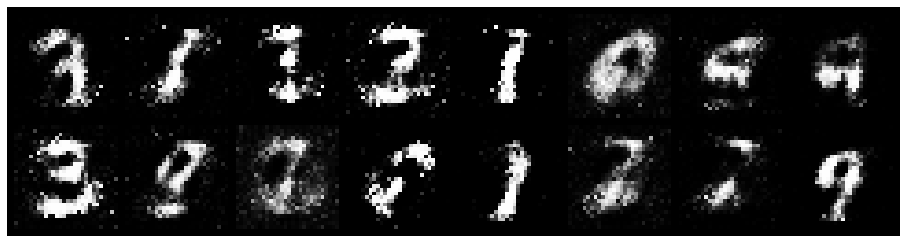

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.6442, Generator Loss: 1.7404
D(x): 0.7903, D(G(z)): 0.2229


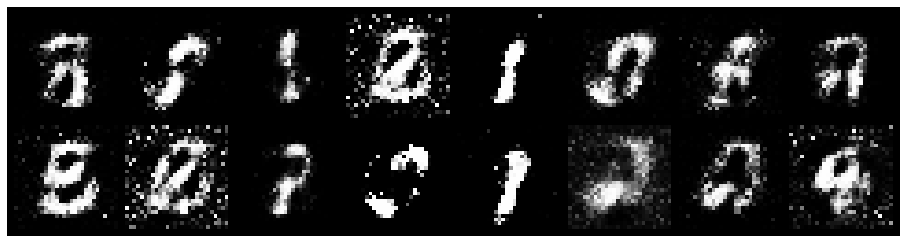

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 1.0999, Generator Loss: 1.6655
D(x): 0.6604, D(G(z)): 0.2681


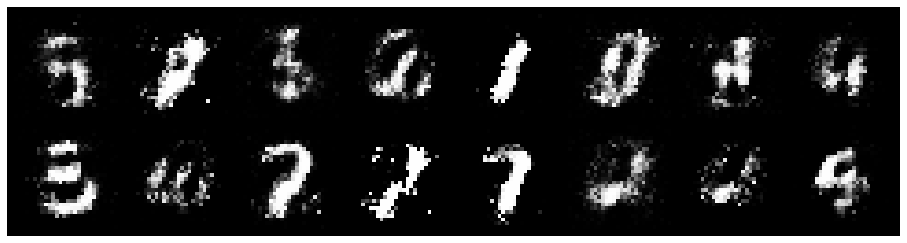

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.7739, Generator Loss: 1.9342
D(x): 0.7119, D(G(z)): 0.1911


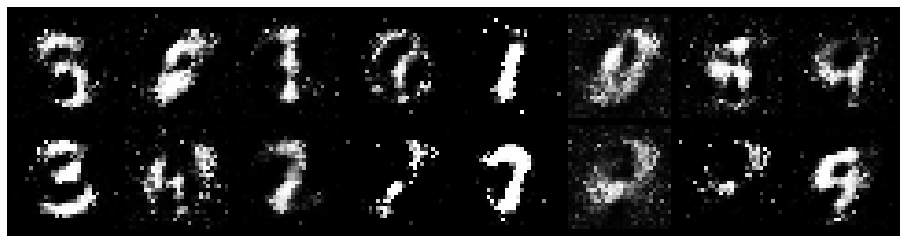

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.7832, Generator Loss: 1.7773
D(x): 0.7154, D(G(z)): 0.2127


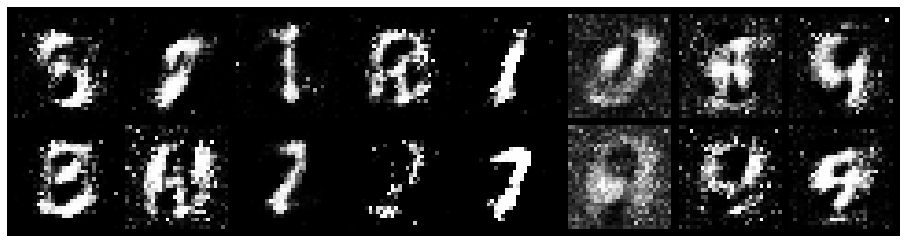

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.7379, Generator Loss: 2.6148
D(x): 0.7571, D(G(z)): 0.2176


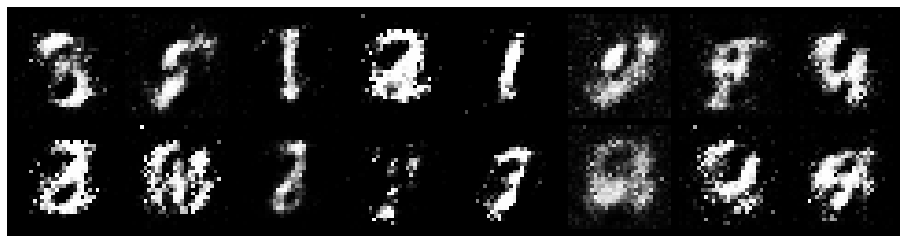

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 1.1000, Generator Loss: 1.4413
D(x): 0.6340, D(G(z)): 0.3050


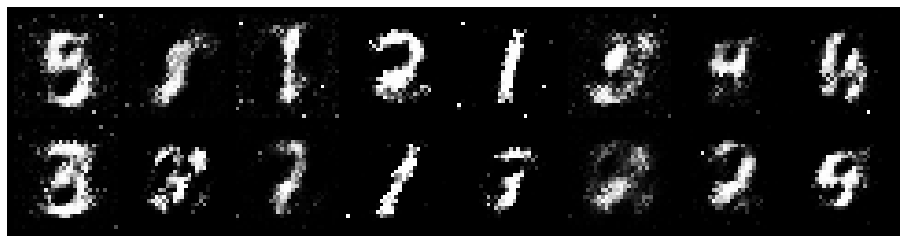

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.9887, Generator Loss: 1.0804
D(x): 0.7370, D(G(z)): 0.3821


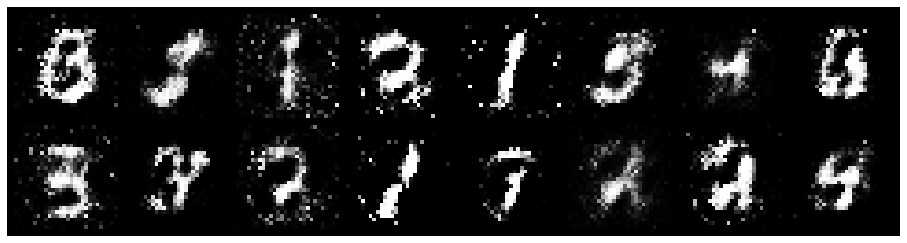

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.8614, Generator Loss: 1.9924
D(x): 0.7602, D(G(z)): 0.3251


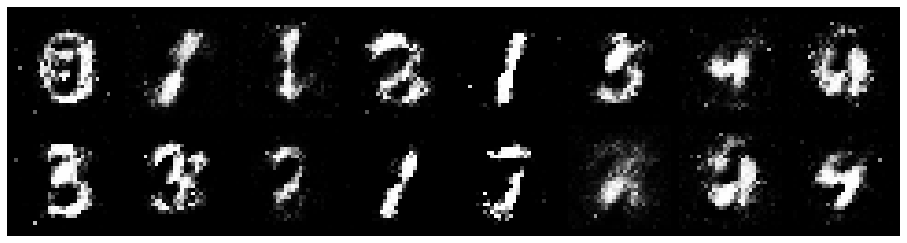

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 1.0273, Generator Loss: 1.5678
D(x): 0.6375, D(G(z)): 0.2709


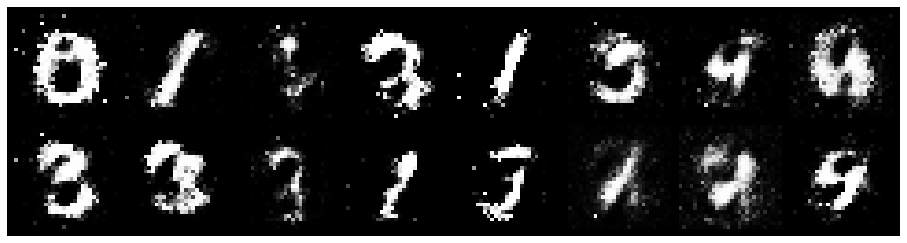

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.6730, Generator Loss: 1.9568
D(x): 0.7669, D(G(z)): 0.2090


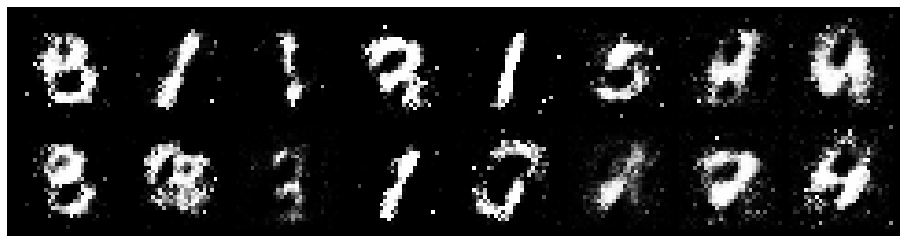

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8986, Generator Loss: 2.1687
D(x): 0.7767, D(G(z)): 0.2761


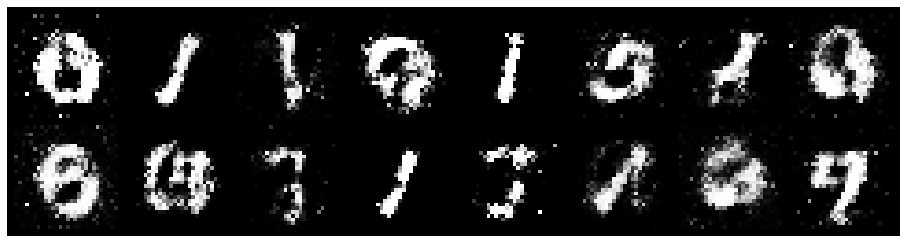

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 1.0346, Generator Loss: 1.6965
D(x): 0.8123, D(G(z)): 0.3997


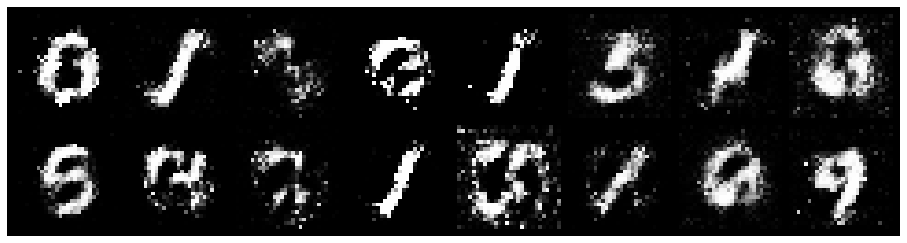

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.9077, Generator Loss: 2.1901
D(x): 0.7168, D(G(z)): 0.2657


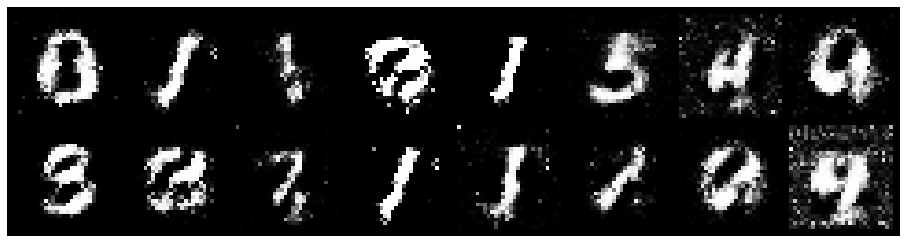

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.7074, Generator Loss: 2.3893
D(x): 0.7458, D(G(z)): 0.2122


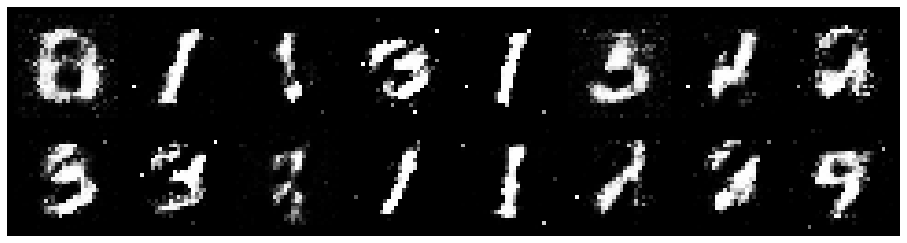

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.5987, Generator Loss: 2.0833
D(x): 0.8102, D(G(z)): 0.2382


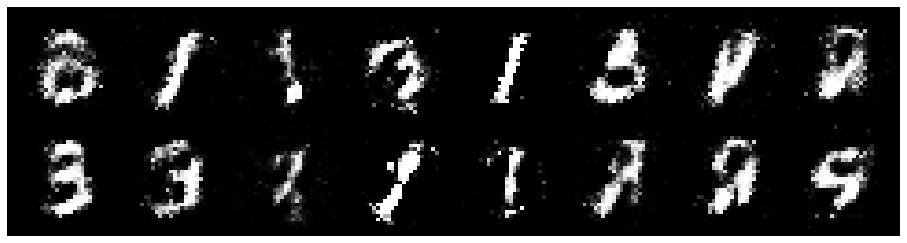

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.9807, Generator Loss: 1.5183
D(x): 0.7219, D(G(z)): 0.3322


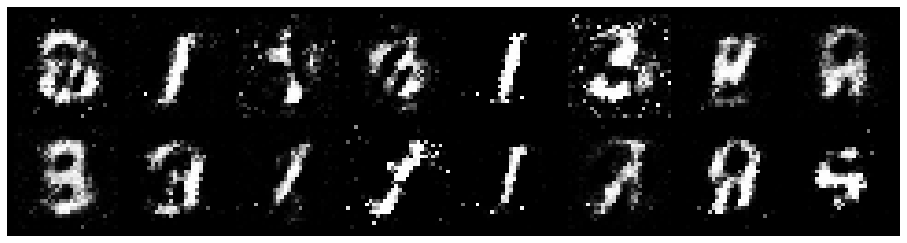

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.6653, Generator Loss: 2.2064
D(x): 0.7605, D(G(z)): 0.2255


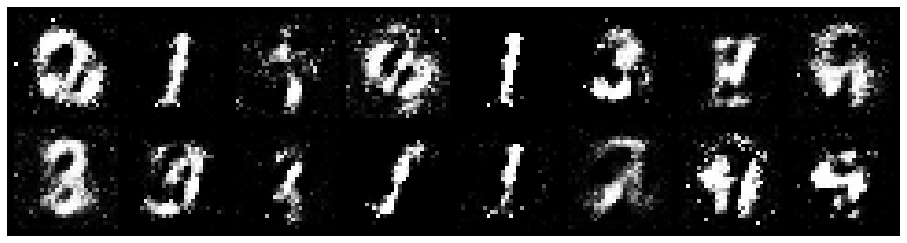

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7470, Generator Loss: 1.6353
D(x): 0.7655, D(G(z)): 0.2879


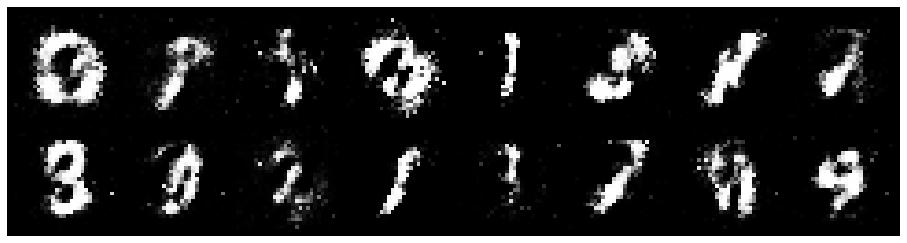

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 1.3236, Generator Loss: 1.1717
D(x): 0.6187, D(G(z)): 0.3652


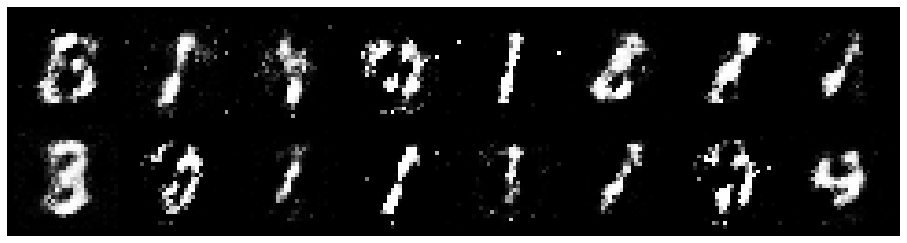

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.9300, Generator Loss: 1.4261
D(x): 0.7845, D(G(z)): 0.3491


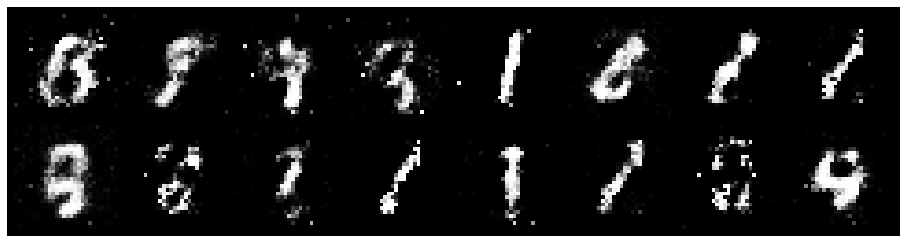

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 1.0572, Generator Loss: 1.3712
D(x): 0.6811, D(G(z)): 0.3403


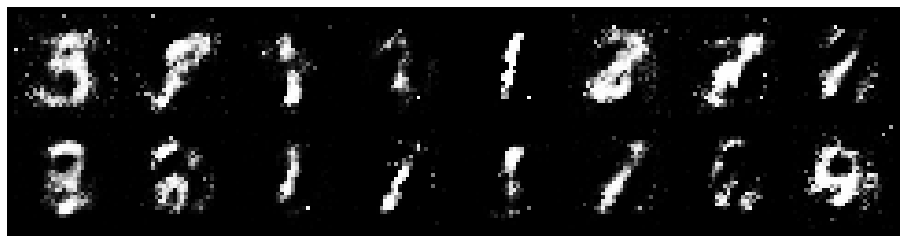

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.9847, Generator Loss: 1.5171
D(x): 0.5979, D(G(z)): 0.2257


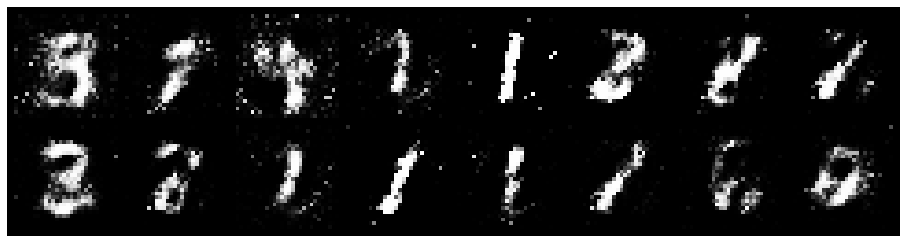

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.7976, Generator Loss: 2.1081
D(x): 0.7026, D(G(z)): 0.2279


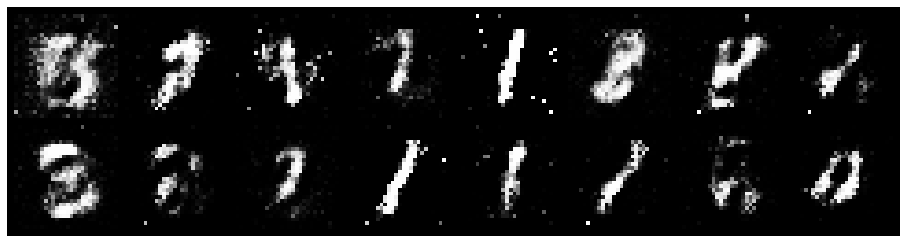

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.9124, Generator Loss: 1.5162
D(x): 0.7523, D(G(z)): 0.3282


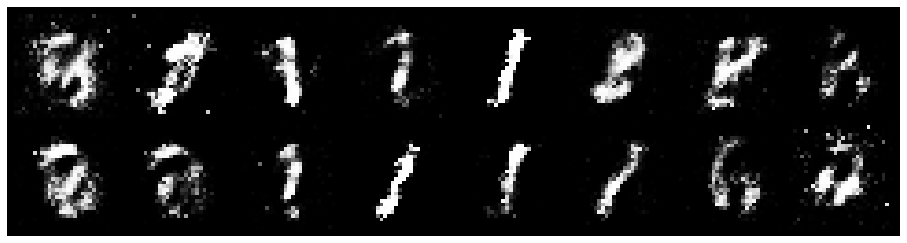

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.9895, Generator Loss: 1.5975
D(x): 0.6669, D(G(z)): 0.2996


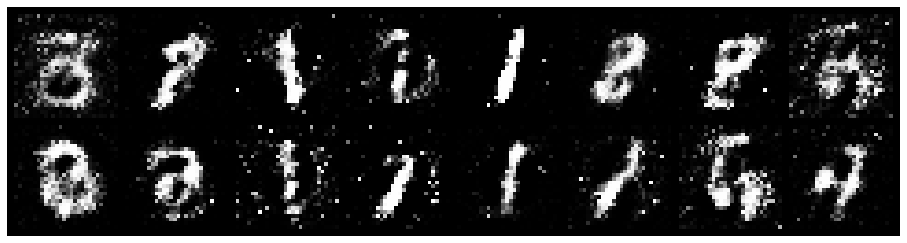

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.9865, Generator Loss: 1.4405
D(x): 0.6926, D(G(z)): 0.3077


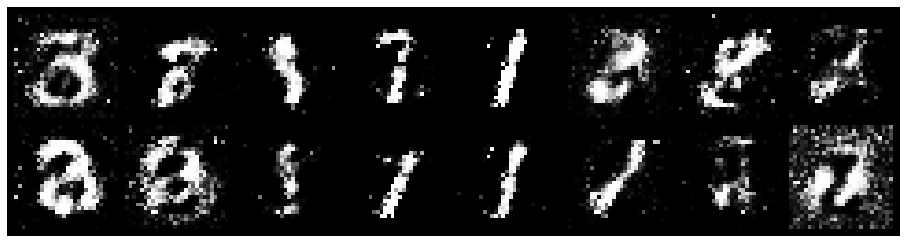

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.8820, Generator Loss: 2.1005
D(x): 0.6532, D(G(z)): 0.1901


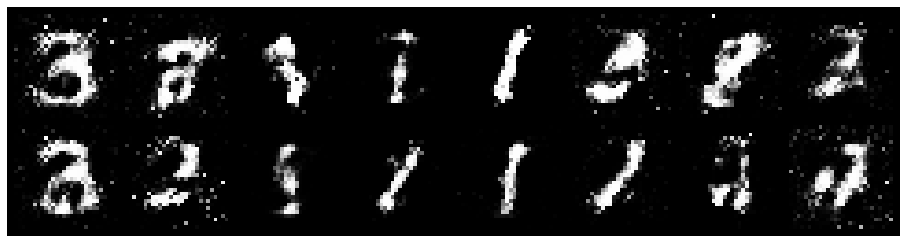

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 1.0925, Generator Loss: 2.1080
D(x): 0.7414, D(G(z)): 0.3257


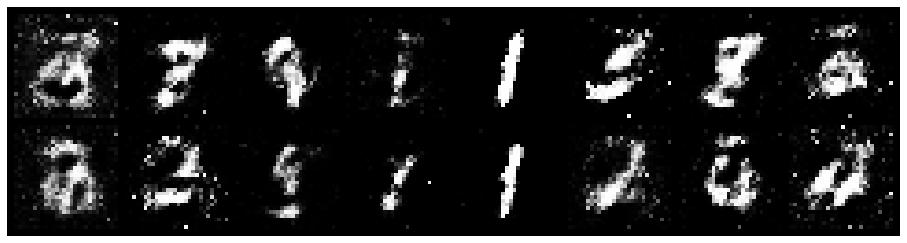

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.7711, Generator Loss: 1.4907
D(x): 0.7573, D(G(z)): 0.2822


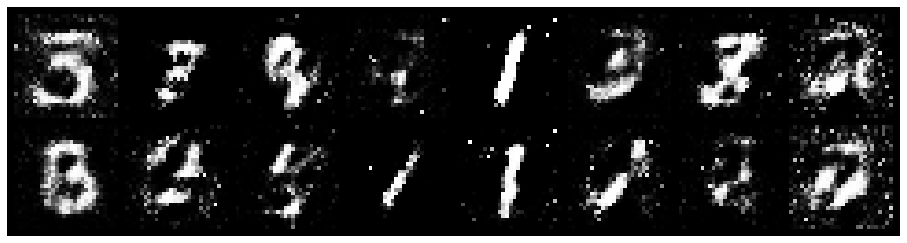

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.7838, Generator Loss: 1.3366
D(x): 0.7331, D(G(z)): 0.2661


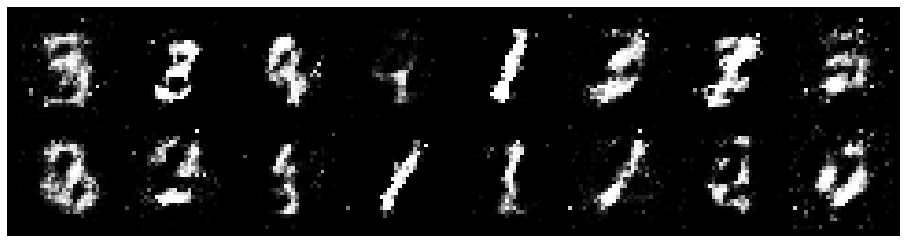

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.6787, Generator Loss: 2.1650
D(x): 0.7606, D(G(z)): 0.2297


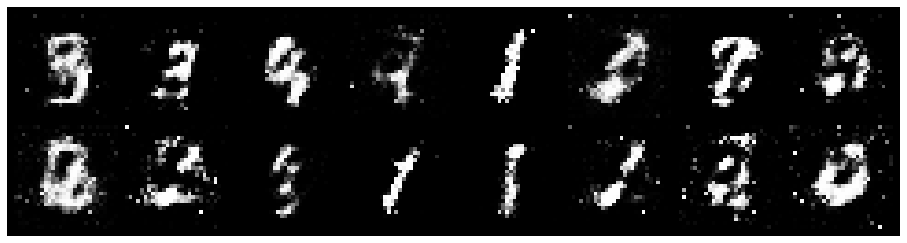

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.9611, Generator Loss: 1.7173
D(x): 0.6860, D(G(z)): 0.2941


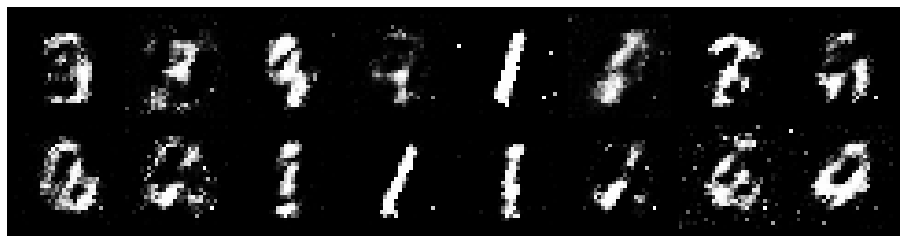

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8973, Generator Loss: 1.8921
D(x): 0.7055, D(G(z)): 0.2780


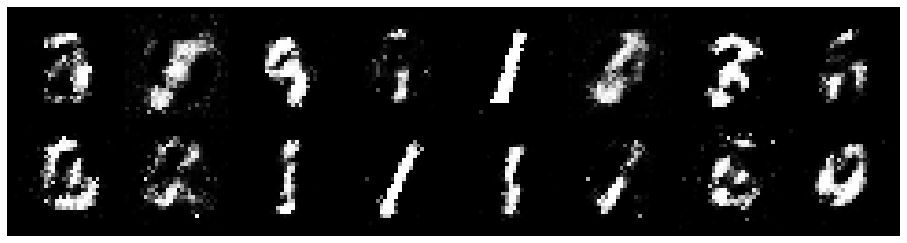

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.6645, Generator Loss: 1.6552
D(x): 0.7854, D(G(z)): 0.2109


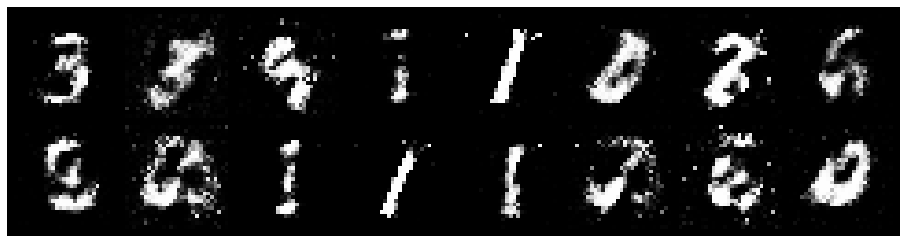

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8238, Generator Loss: 2.0375
D(x): 0.7104, D(G(z)): 0.2163


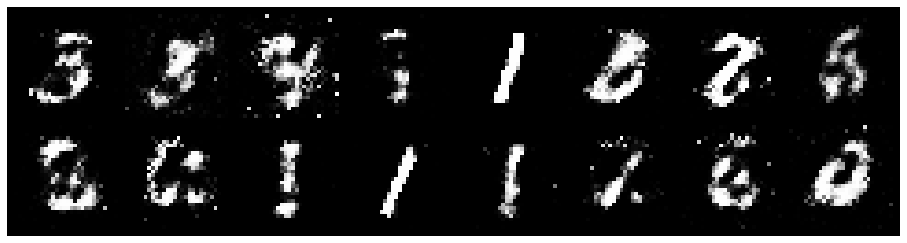

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.6931, Generator Loss: 1.9969
D(x): 0.7890, D(G(z)): 0.2642


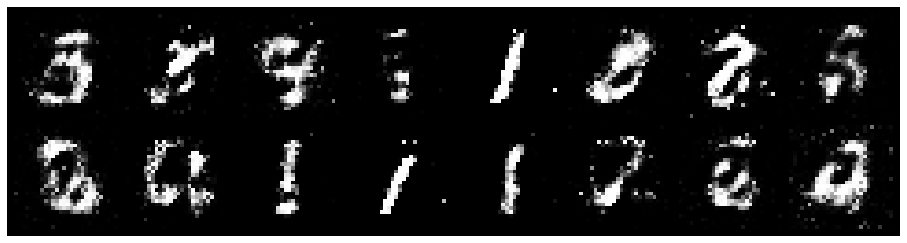

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.9554, Generator Loss: 1.5732
D(x): 0.6927, D(G(z)): 0.2925


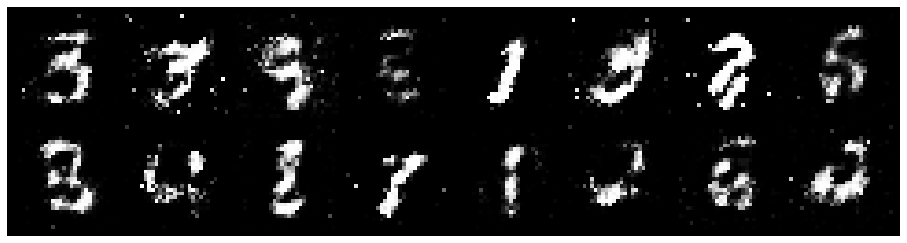

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 1.0198, Generator Loss: 1.8885
D(x): 0.6096, D(G(z)): 0.2222


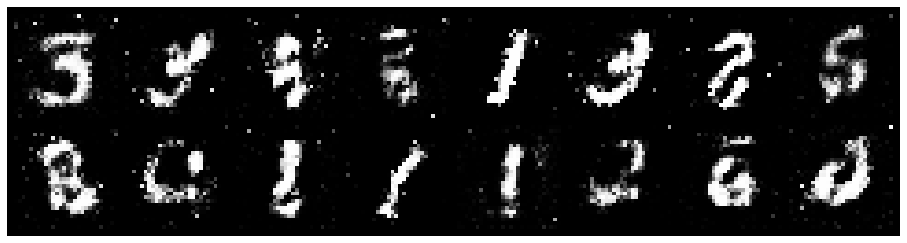

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7814, Generator Loss: 1.8799
D(x): 0.7814, D(G(z)): 0.2765


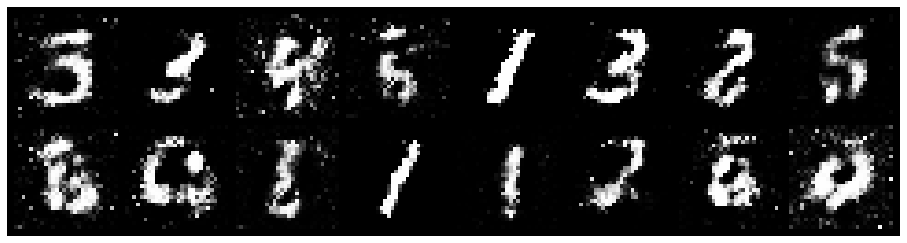

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7247, Generator Loss: 1.9053
D(x): 0.7590, D(G(z)): 0.2551


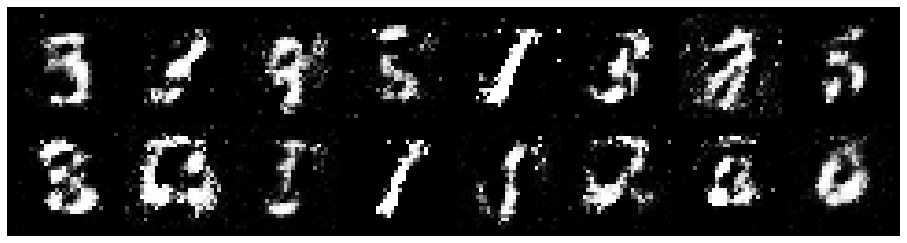

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.9236, Generator Loss: 1.4671
D(x): 0.7470, D(G(z)): 0.3726


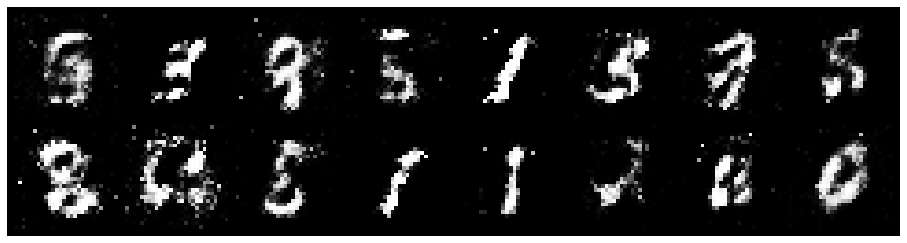

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.6618, Generator Loss: 1.7208
D(x): 0.7944, D(G(z)): 0.2422


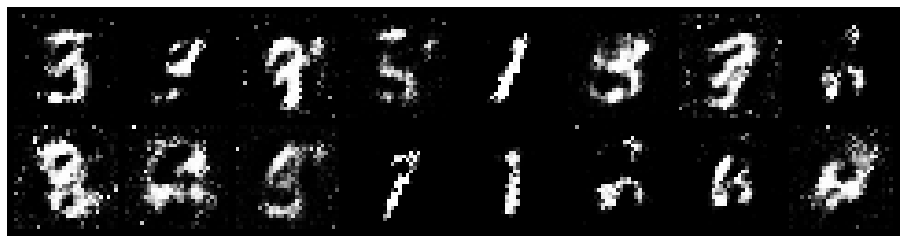

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.8080, Generator Loss: 1.5593
D(x): 0.6747, D(G(z)): 0.2247


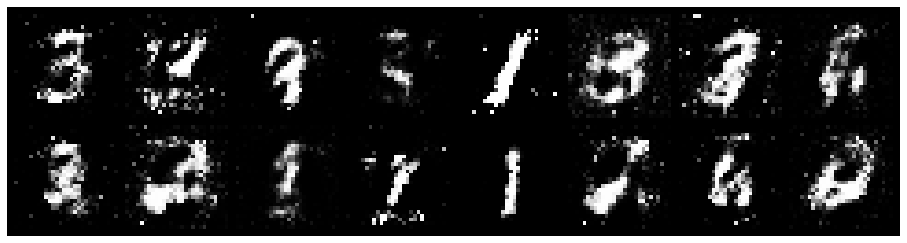

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.6414, Generator Loss: 1.8311
D(x): 0.7582, D(G(z)): 0.2010


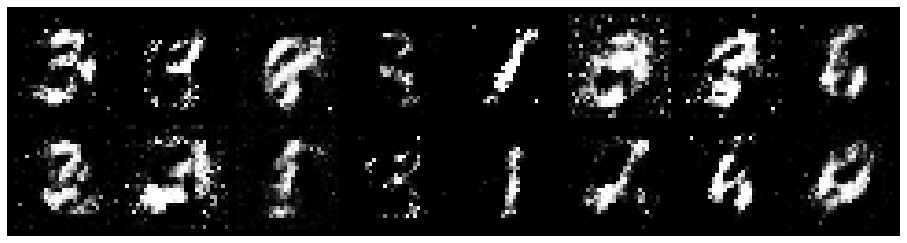

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.6919, Generator Loss: 2.1390
D(x): 0.7658, D(G(z)): 0.2185


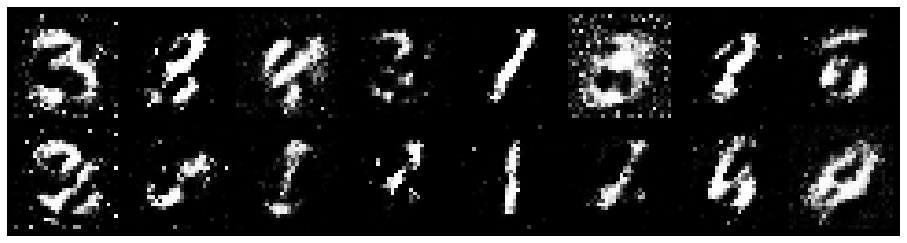

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.8691, Generator Loss: 1.7978
D(x): 0.7519, D(G(z)): 0.2982


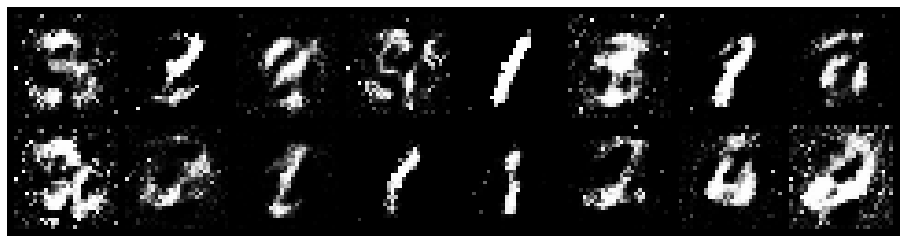

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.8418, Generator Loss: 2.0562
D(x): 0.7420, D(G(z)): 0.2575


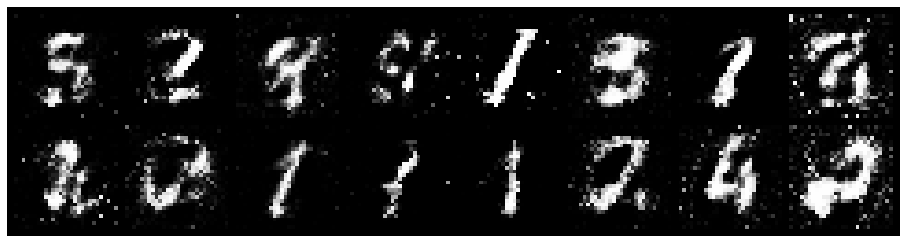

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.9698, Generator Loss: 1.2285
D(x): 0.7100, D(G(z)): 0.3154


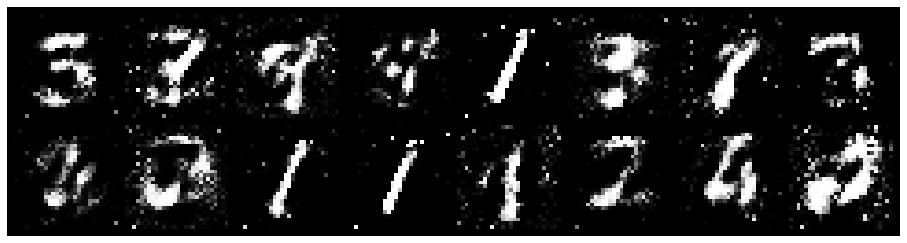

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 1.1502, Generator Loss: 1.5140
D(x): 0.6967, D(G(z)): 0.3397


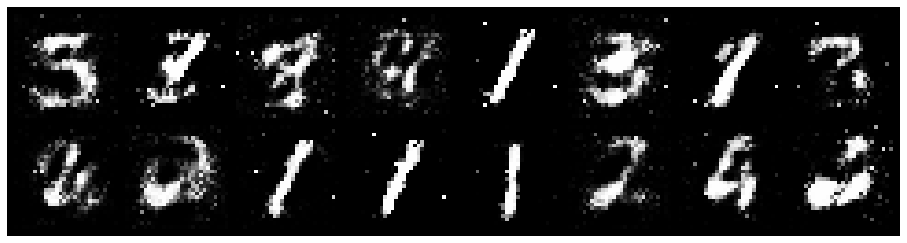

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.0873, Generator Loss: 1.3837
D(x): 0.6326, D(G(z)): 0.2903


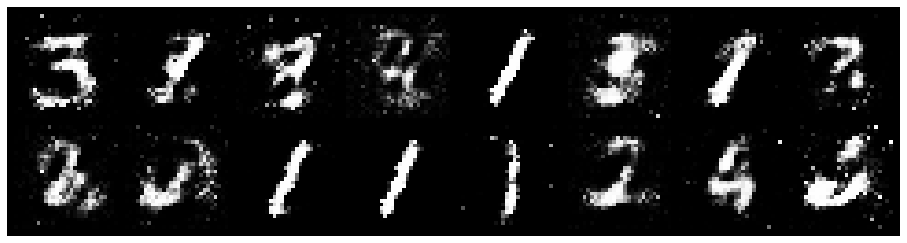

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.8421, Generator Loss: 1.4894
D(x): 0.7460, D(G(z)): 0.2943


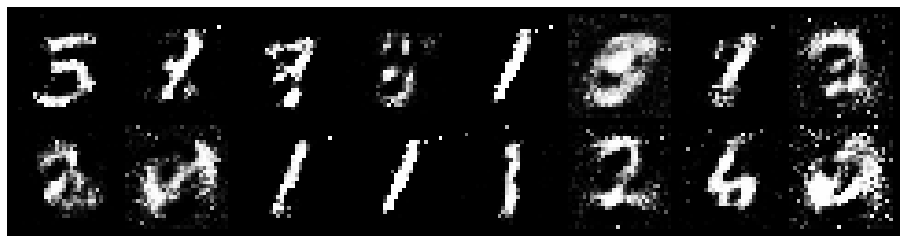

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.9622, Generator Loss: 1.3273
D(x): 0.6624, D(G(z)): 0.3066


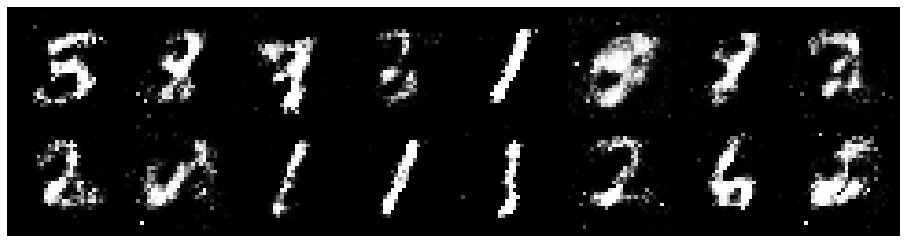

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.9569, Generator Loss: 1.4626
D(x): 0.6596, D(G(z)): 0.2953


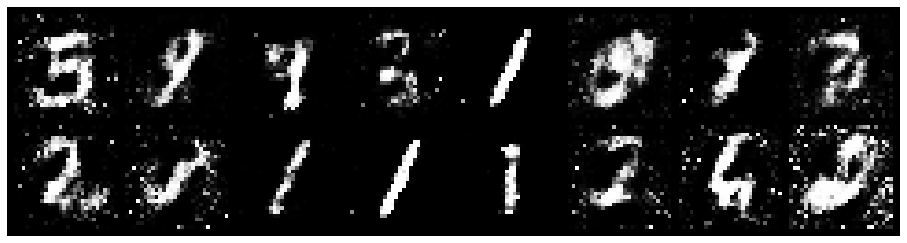

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.9132, Generator Loss: 1.5951
D(x): 0.6627, D(G(z)): 0.2370


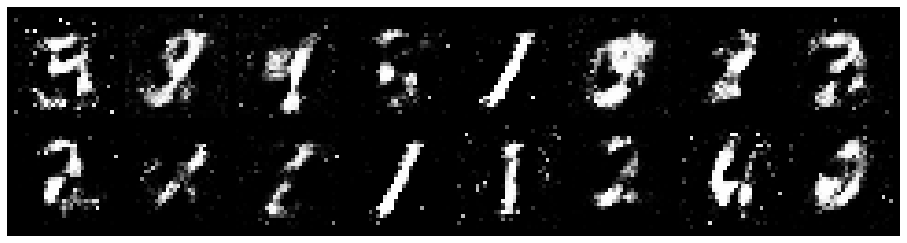

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.9328, Generator Loss: 1.6483
D(x): 0.6743, D(G(z)): 0.2742


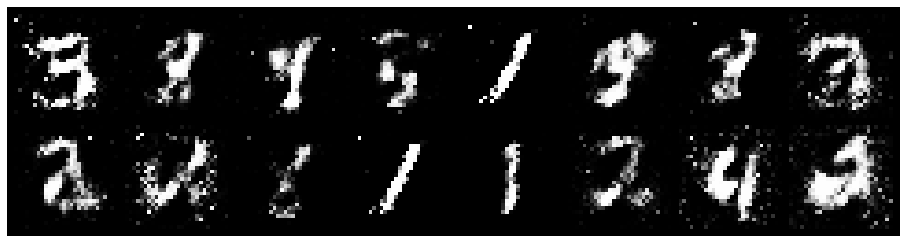

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.7876, Generator Loss: 1.7639
D(x): 0.7323, D(G(z)): 0.2859


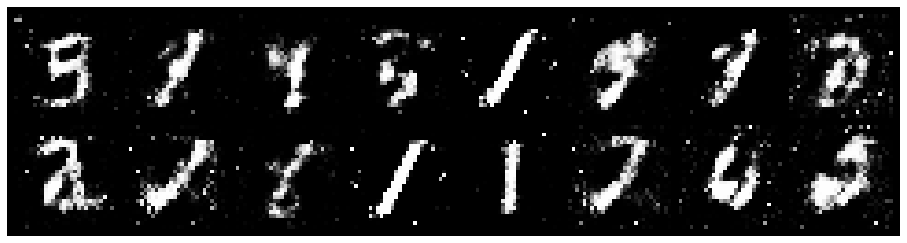

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0341, Generator Loss: 1.7109
D(x): 0.6675, D(G(z)): 0.2712


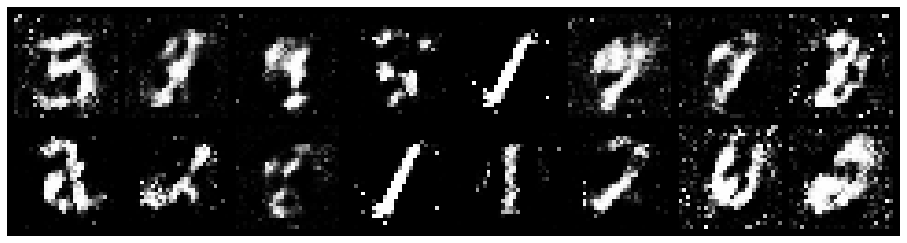

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 1.0680, Generator Loss: 1.3435
D(x): 0.6898, D(G(z)): 0.3782


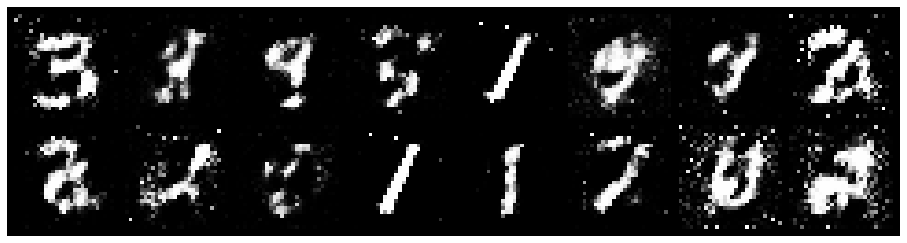

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9746, Generator Loss: 1.4887
D(x): 0.7328, D(G(z)): 0.3592


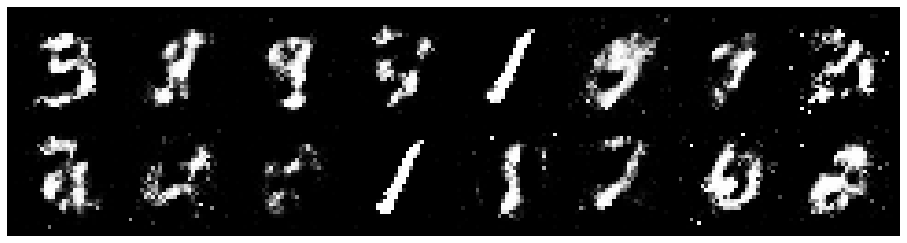

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 1.0060, Generator Loss: 1.7026
D(x): 0.6280, D(G(z)): 0.2978


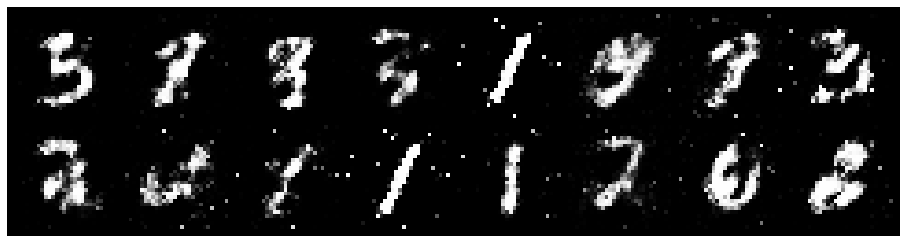

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8461, Generator Loss: 1.8801
D(x): 0.7734, D(G(z)): 0.3362


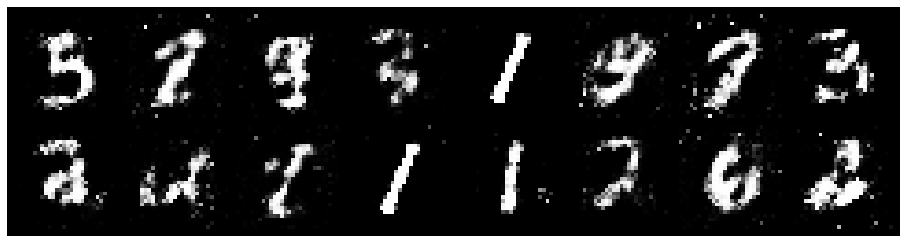

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.8640, Generator Loss: 1.8097
D(x): 0.7489, D(G(z)): 0.2901


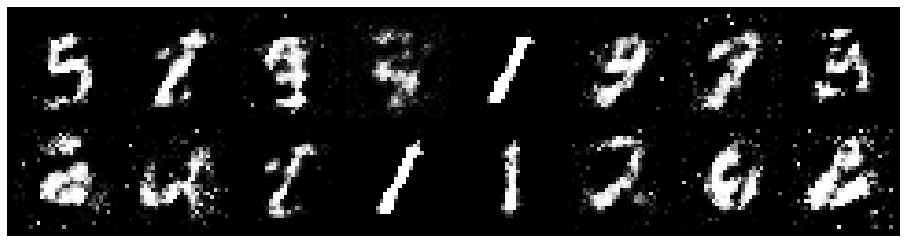

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.9148, Generator Loss: 1.7282
D(x): 0.6433, D(G(z)): 0.2469


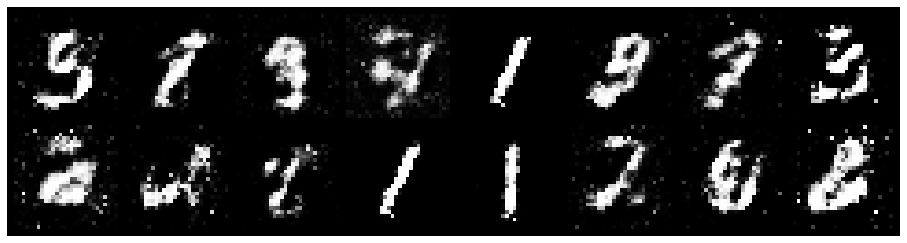

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.0025, Generator Loss: 1.7729
D(x): 0.7175, D(G(z)): 0.3252


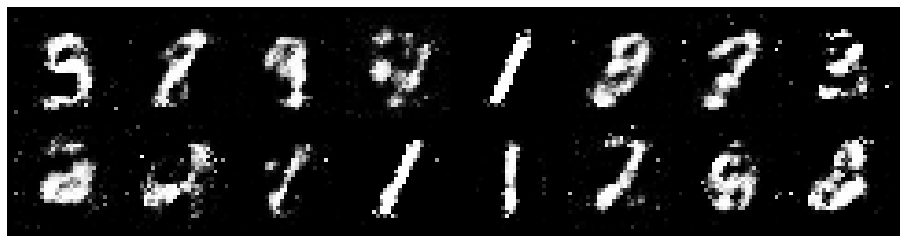

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.8286, Generator Loss: 1.6883
D(x): 0.7321, D(G(z)): 0.2939


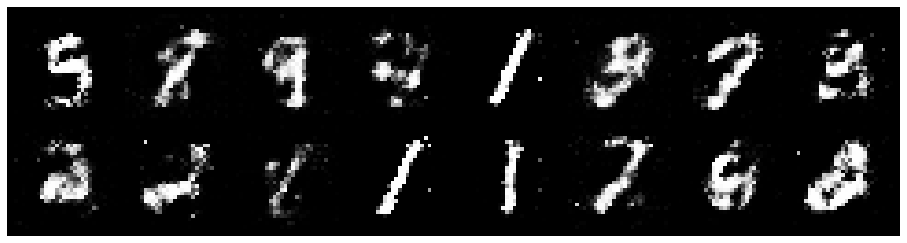

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.9989, Generator Loss: 1.5968
D(x): 0.6754, D(G(z)): 0.3448


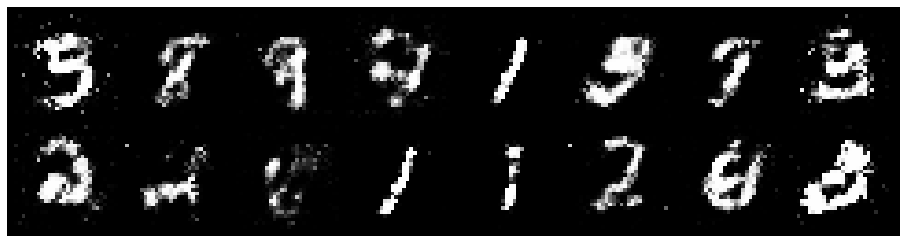

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.8995, Generator Loss: 1.6532
D(x): 0.6738, D(G(z)): 0.2862


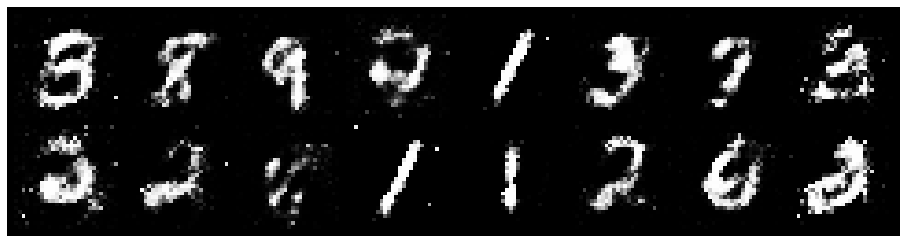

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.9629, Generator Loss: 1.2949
D(x): 0.6879, D(G(z)): 0.3182


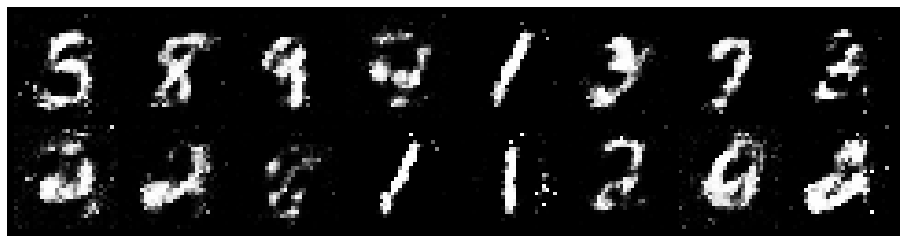

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9456, Generator Loss: 1.3636
D(x): 0.6700, D(G(z)): 0.3089


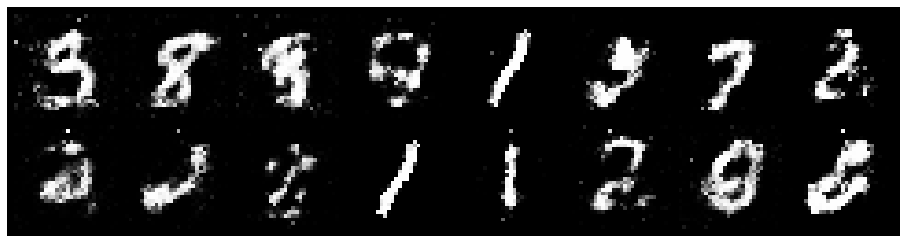

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.7019, Generator Loss: 1.7604
D(x): 0.7515, D(G(z)): 0.2348


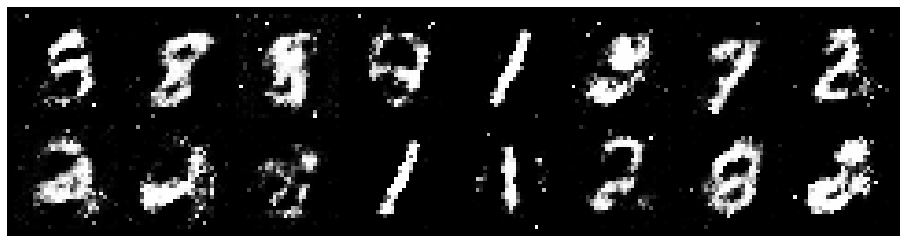

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.8457, Generator Loss: 1.5754
D(x): 0.6875, D(G(z)): 0.2726


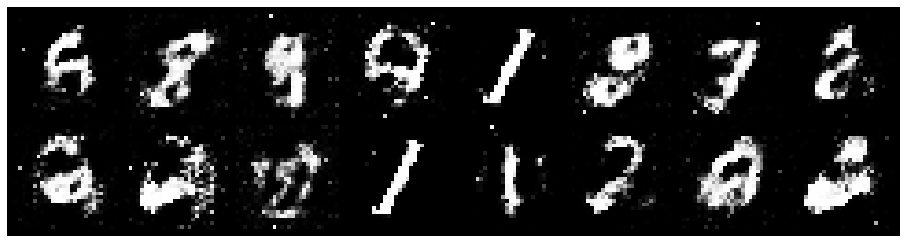

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9667, Generator Loss: 1.2070
D(x): 0.7121, D(G(z)): 0.3791


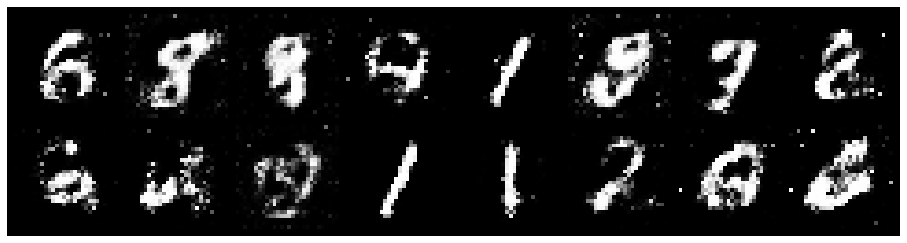

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.8911, Generator Loss: 1.6307
D(x): 0.7180, D(G(z)): 0.3349


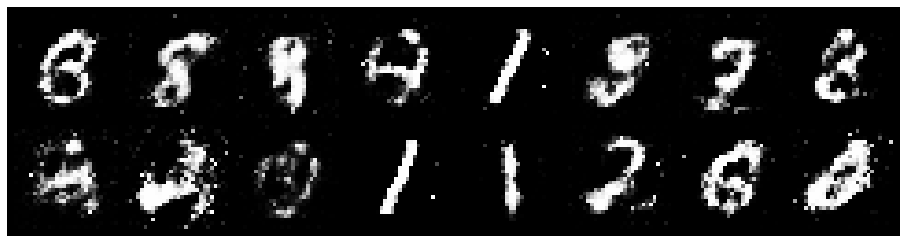

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9183, Generator Loss: 1.6122
D(x): 0.7176, D(G(z)): 0.3142


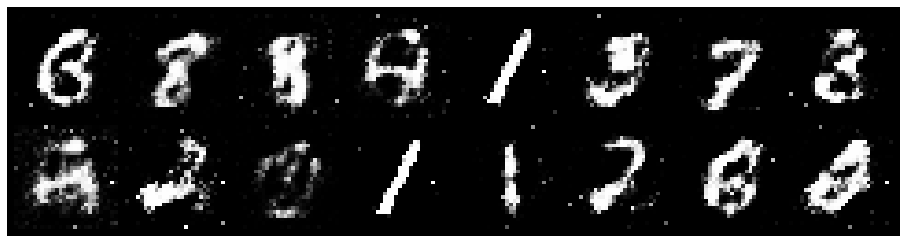

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9012, Generator Loss: 1.7410
D(x): 0.6722, D(G(z)): 0.2922


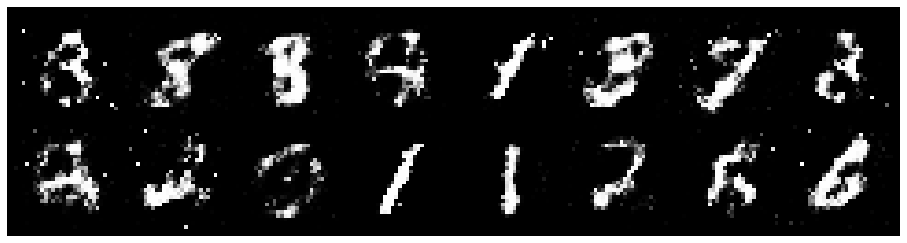

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.8500, Generator Loss: 1.5125
D(x): 0.7446, D(G(z)): 0.3434


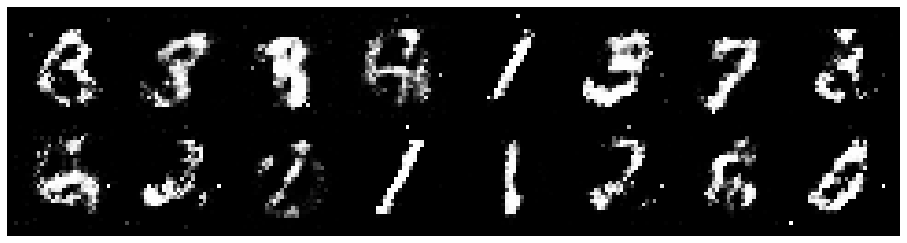

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.8499, Generator Loss: 1.6602
D(x): 0.7077, D(G(z)): 0.2986


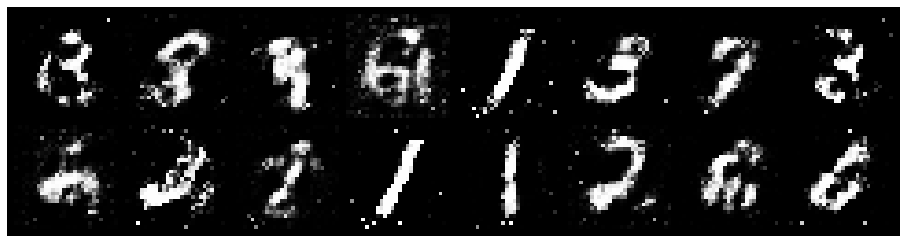

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.9808, Generator Loss: 1.1785
D(x): 0.7113, D(G(z)): 0.3499


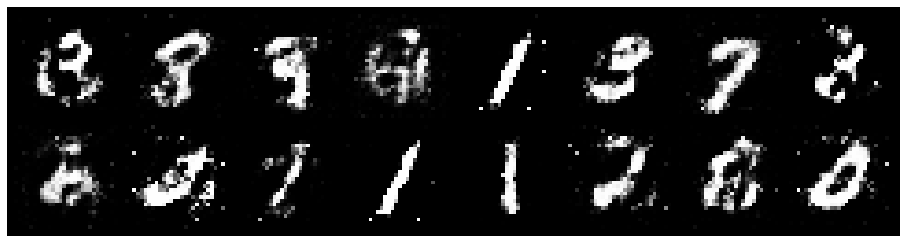

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.8971, Generator Loss: 1.4040
D(x): 0.7112, D(G(z)): 0.3175


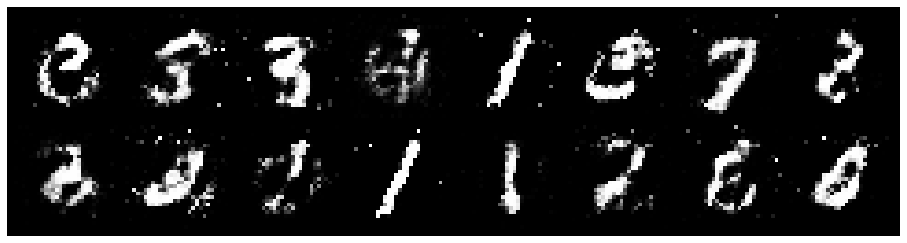

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.9146, Generator Loss: 1.1990
D(x): 0.7127, D(G(z)): 0.3297


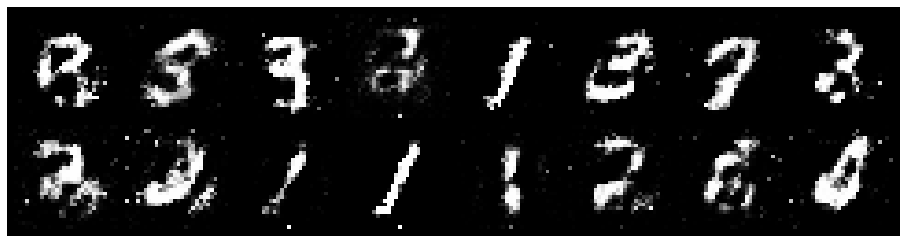

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.8981, Generator Loss: 1.3024
D(x): 0.7266, D(G(z)): 0.3392


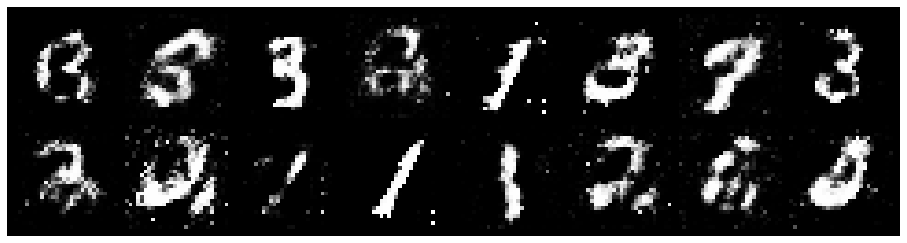

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 1.0455, Generator Loss: 1.3010
D(x): 0.6266, D(G(z)): 0.3126


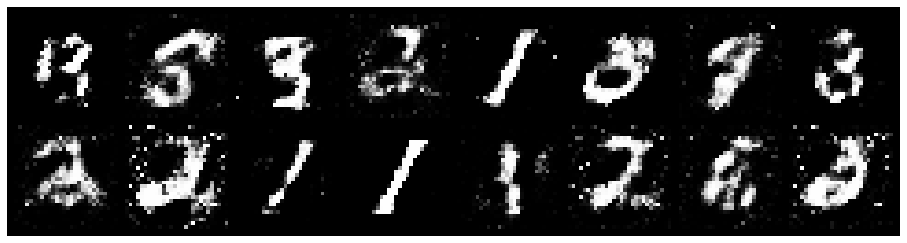

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.1408, Generator Loss: 1.5268
D(x): 0.5679, D(G(z)): 0.3023


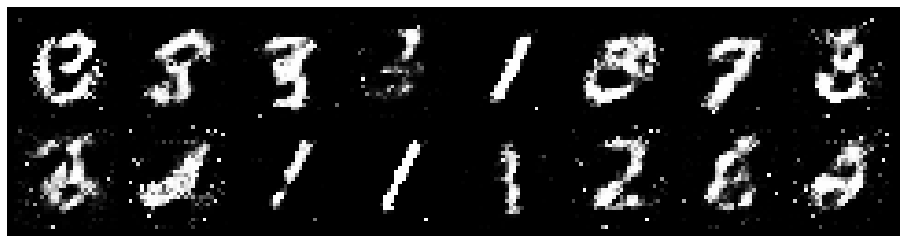

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0593, Generator Loss: 1.8713
D(x): 0.5392, D(G(z)): 0.1924


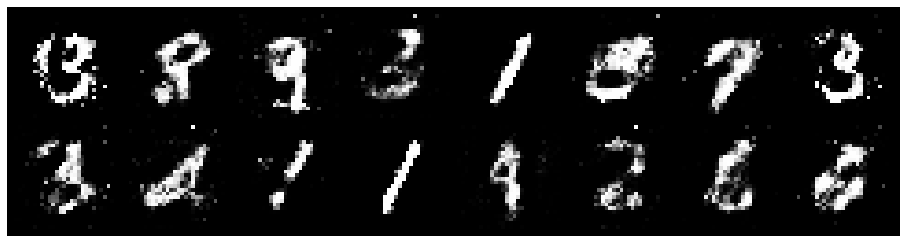

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9583, Generator Loss: 1.3679
D(x): 0.6576, D(G(z)): 0.3065


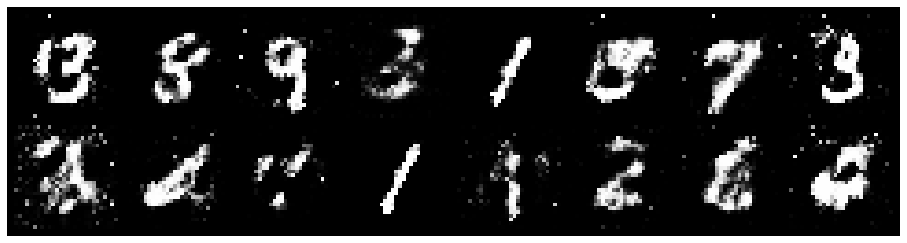

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.0279, Generator Loss: 1.1539
D(x): 0.6027, D(G(z)): 0.3319


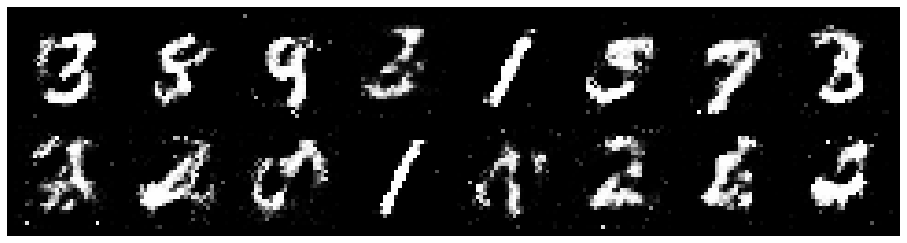

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8528, Generator Loss: 1.2324
D(x): 0.6952, D(G(z)): 0.3023


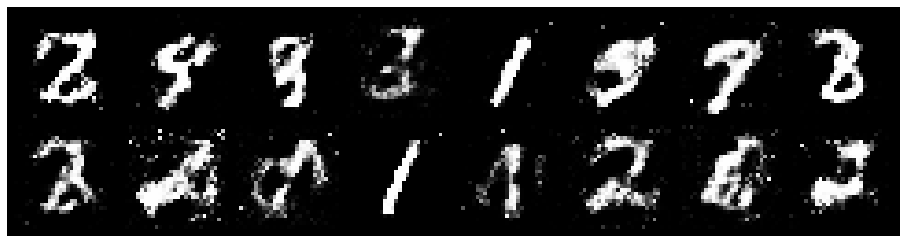

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8662, Generator Loss: 1.5119
D(x): 0.7273, D(G(z)): 0.3323


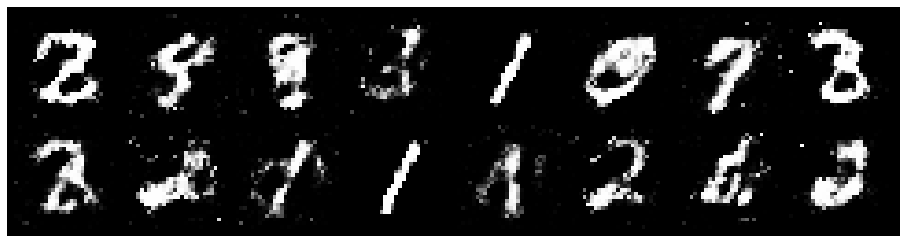

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.9744, Generator Loss: 1.5254
D(x): 0.7401, D(G(z)): 0.3818


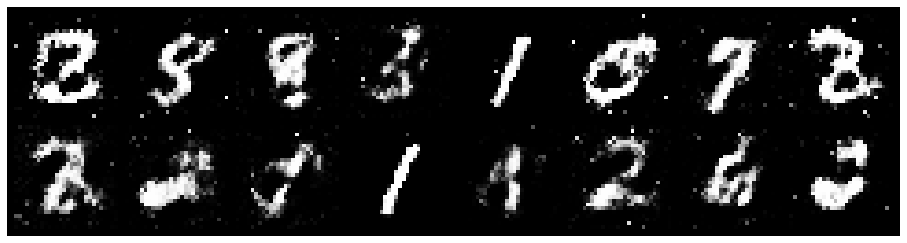

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.1080, Generator Loss: 1.2775
D(x): 0.6917, D(G(z)): 0.4055


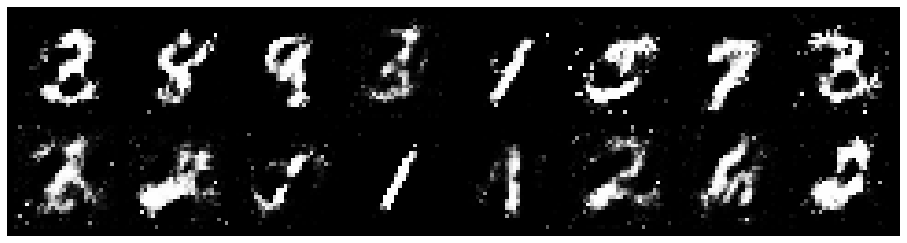

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.0293, Generator Loss: 1.1921
D(x): 0.6833, D(G(z)): 0.3818


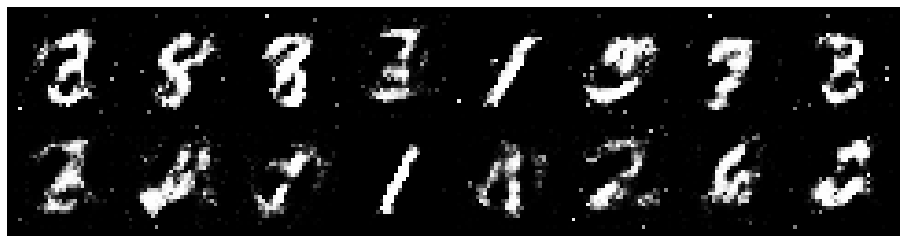

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0374, Generator Loss: 1.4731
D(x): 0.7298, D(G(z)): 0.4086


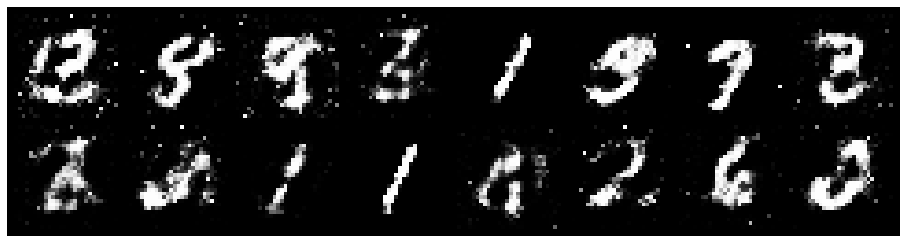

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.0590, Generator Loss: 1.2539
D(x): 0.5992, D(G(z)): 0.2995


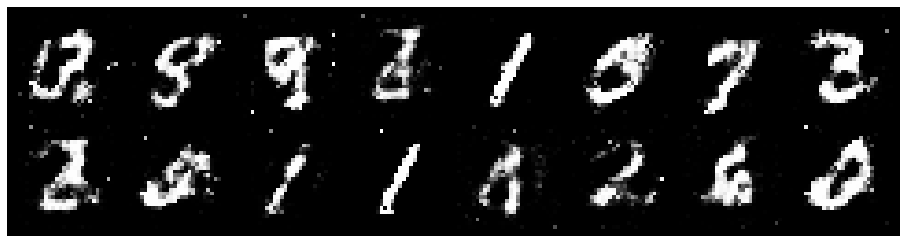

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.8995, Generator Loss: 1.4981
D(x): 0.6716, D(G(z)): 0.2599


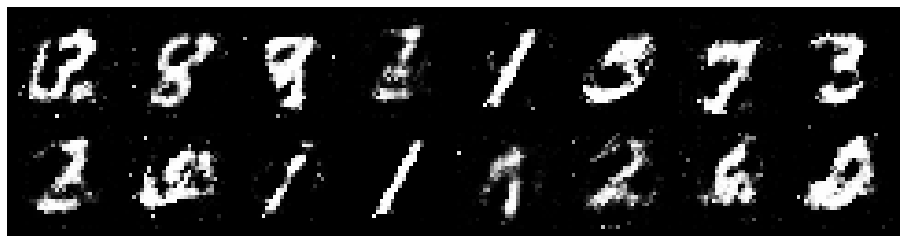

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.0244, Generator Loss: 1.6851
D(x): 0.6764, D(G(z)): 0.3139


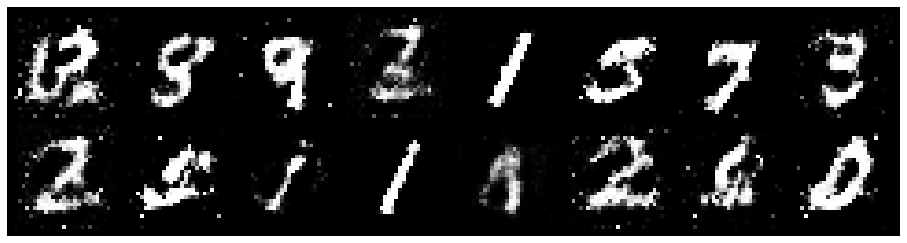

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9413, Generator Loss: 1.3084
D(x): 0.7066, D(G(z)): 0.3444


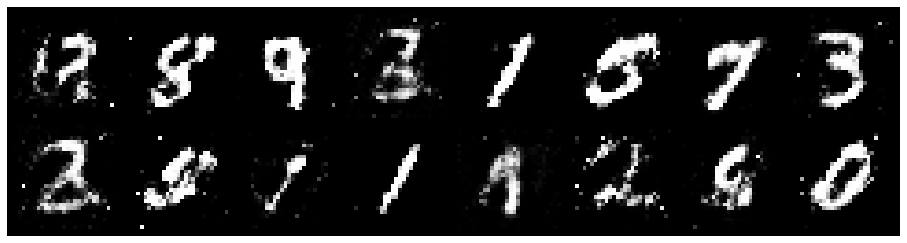

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.8884, Generator Loss: 1.4068
D(x): 0.7235, D(G(z)): 0.3370


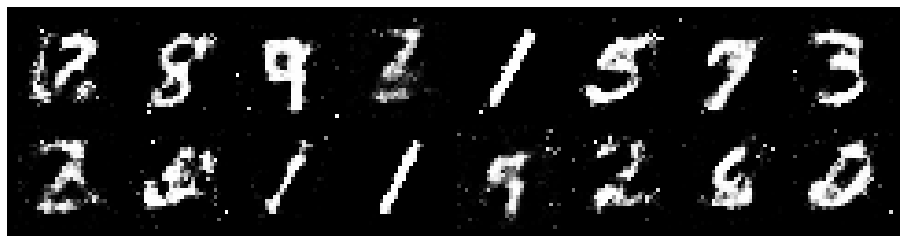

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.1114, Generator Loss: 1.5795
D(x): 0.5833, D(G(z)): 0.2773


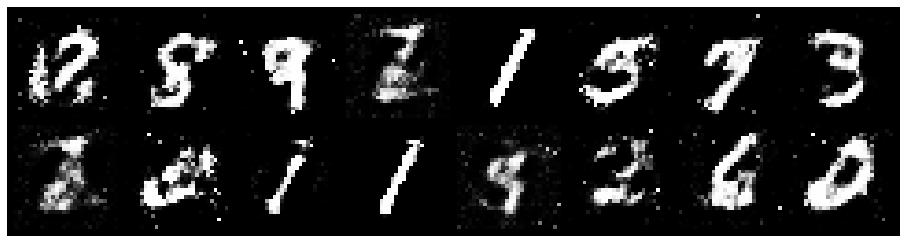

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.8974, Generator Loss: 1.4365
D(x): 0.7046, D(G(z)): 0.2924


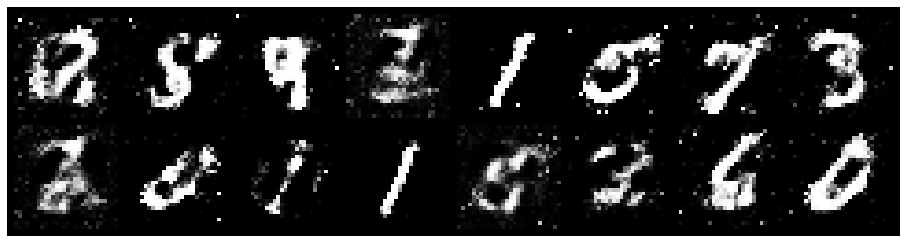

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.0946, Generator Loss: 1.6101
D(x): 0.6632, D(G(z)): 0.3484


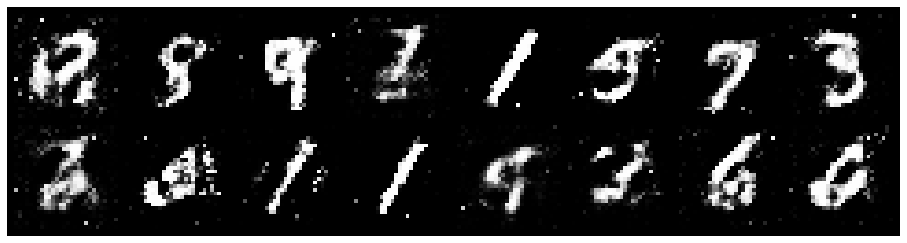

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.8735, Generator Loss: 1.4912
D(x): 0.7018, D(G(z)): 0.2961


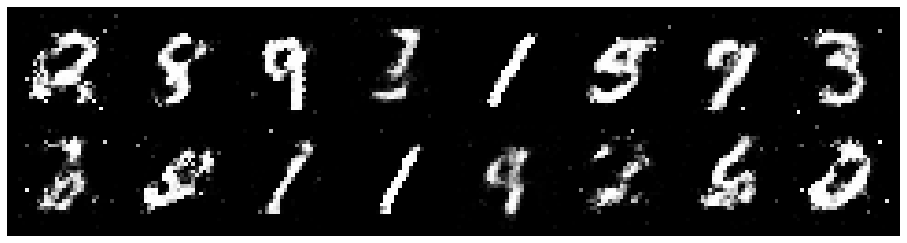

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.2668, Generator Loss: 1.1736
D(x): 0.5355, D(G(z)): 0.3561


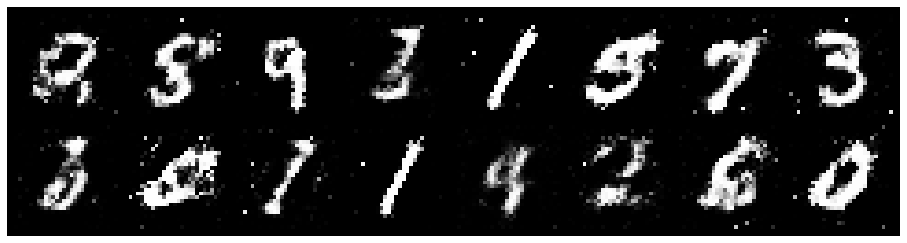

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.8671, Generator Loss: 1.3083
D(x): 0.6757, D(G(z)): 0.2877


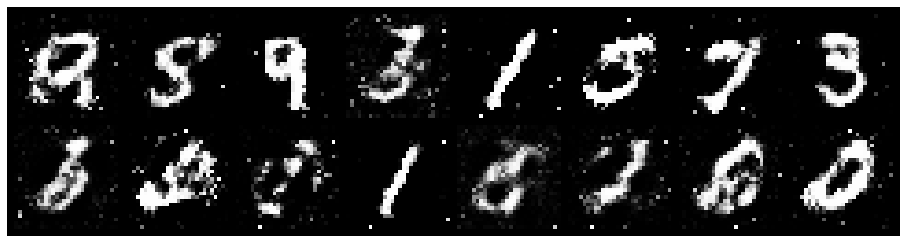

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.8399, Generator Loss: 1.5017
D(x): 0.6665, D(G(z)): 0.2867


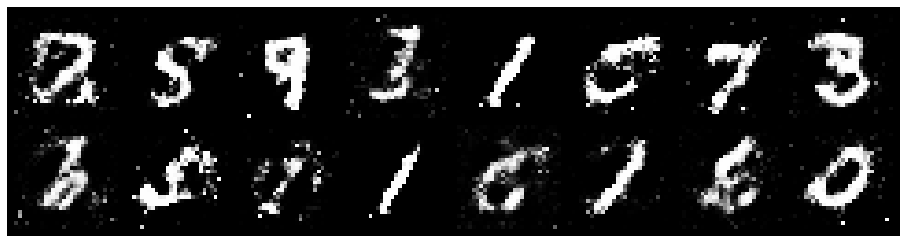

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9297, Generator Loss: 1.4250
D(x): 0.6539, D(G(z)): 0.2913


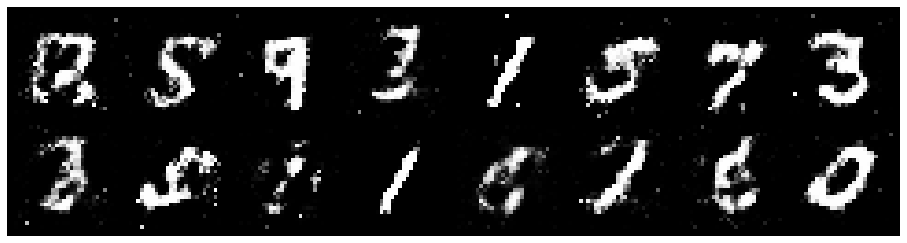

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.8981, Generator Loss: 1.2240
D(x): 0.6647, D(G(z)): 0.3092


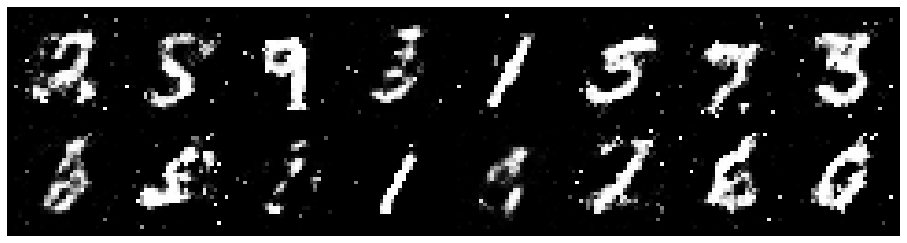

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.8367, Generator Loss: 1.3538
D(x): 0.7024, D(G(z)): 0.2943


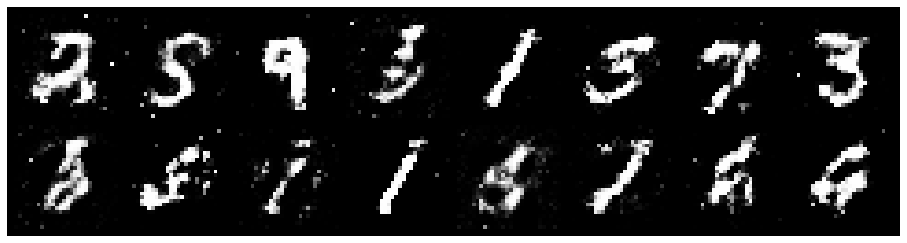

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.0396, Generator Loss: 1.2253
D(x): 0.7399, D(G(z)): 0.4215


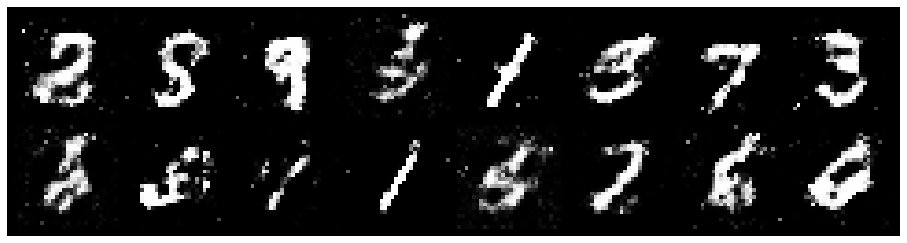

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.0044, Generator Loss: 1.3580
D(x): 0.6596, D(G(z)): 0.3466


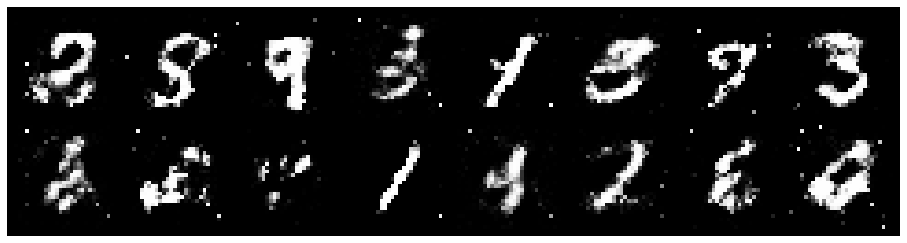

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9323, Generator Loss: 1.4803
D(x): 0.6617, D(G(z)): 0.2934


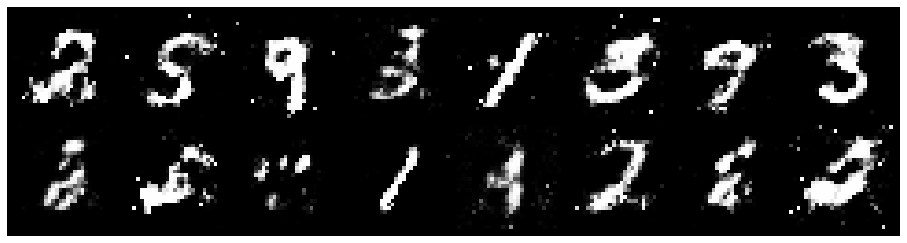

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1017, Generator Loss: 1.3519
D(x): 0.7194, D(G(z)): 0.4363


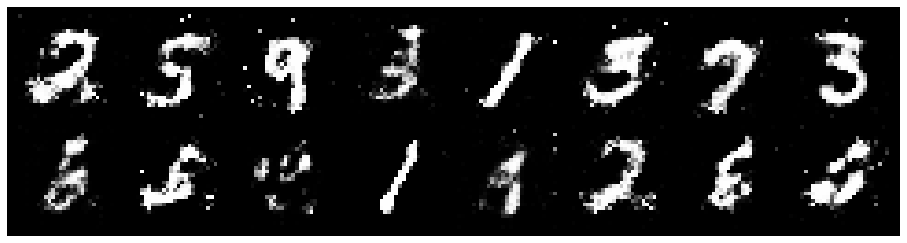

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.0088, Generator Loss: 1.4033
D(x): 0.6033, D(G(z)): 0.2858


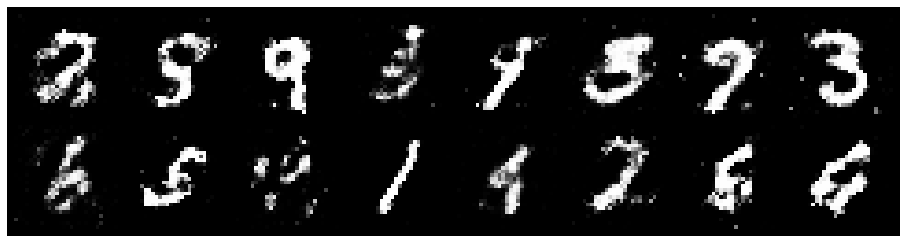

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9910, Generator Loss: 1.4523
D(x): 0.6714, D(G(z)): 0.3538


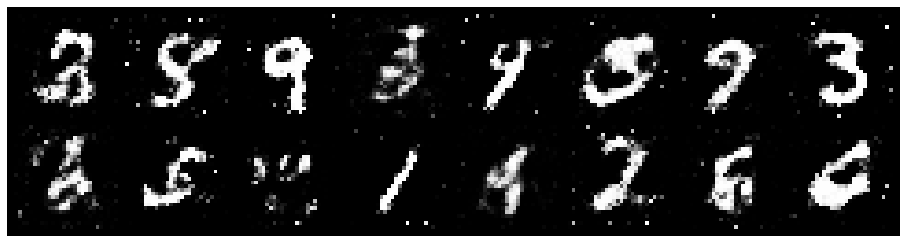

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.0230, Generator Loss: 1.2318
D(x): 0.6438, D(G(z)): 0.3691


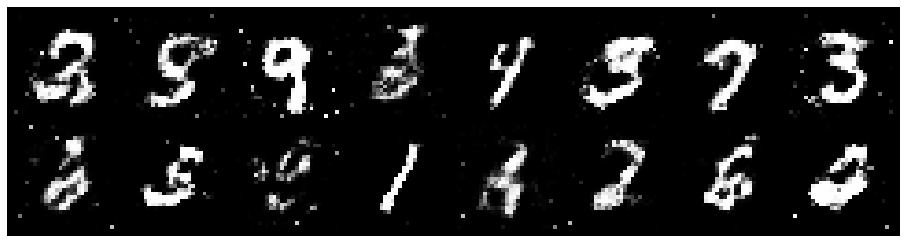

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0402, Generator Loss: 1.3727
D(x): 0.7005, D(G(z)): 0.3949


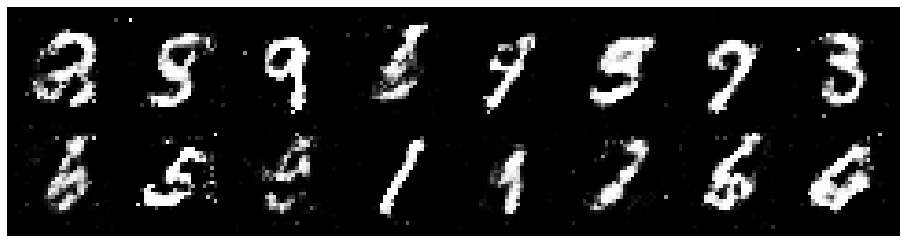

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0086, Generator Loss: 1.6372
D(x): 0.6745, D(G(z)): 0.3063


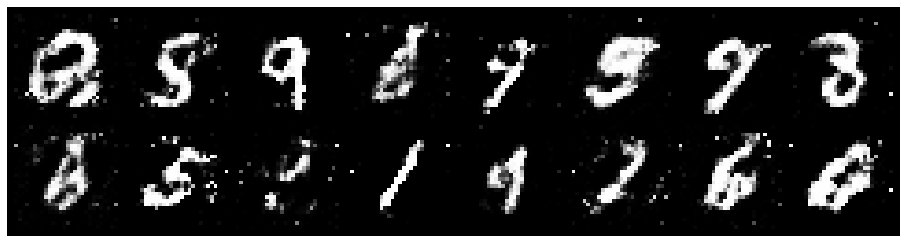

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0943, Generator Loss: 1.7324
D(x): 0.6163, D(G(z)): 0.3302


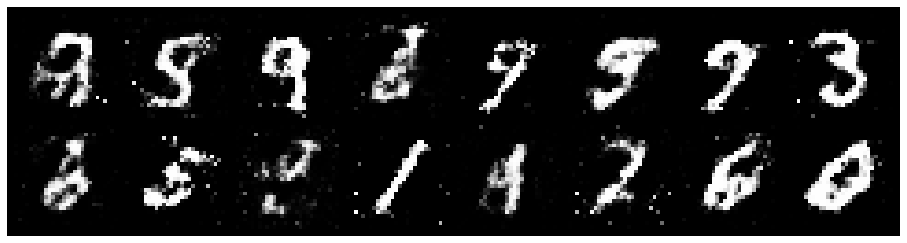

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.2644, Generator Loss: 1.0945
D(x): 0.5735, D(G(z)): 0.3933


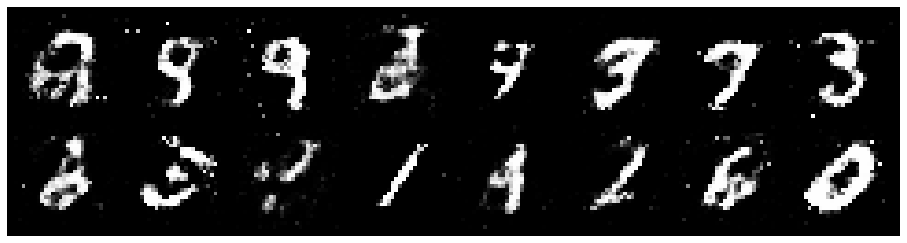

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0164, Generator Loss: 1.2766
D(x): 0.7018, D(G(z)): 0.3735


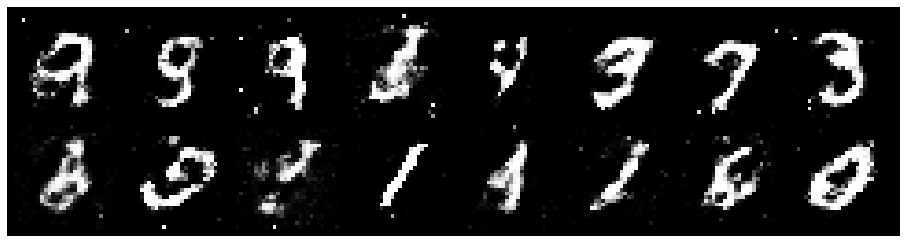

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.0353, Generator Loss: 1.1913
D(x): 0.5999, D(G(z)): 0.3190


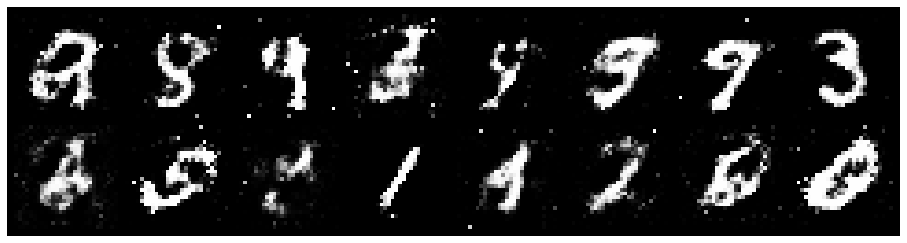

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.9805, Generator Loss: 1.2476
D(x): 0.7465, D(G(z)): 0.3966


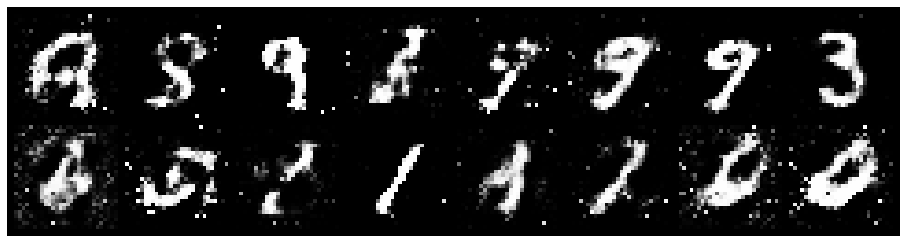

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.9893, Generator Loss: 1.4264
D(x): 0.6632, D(G(z)): 0.3611


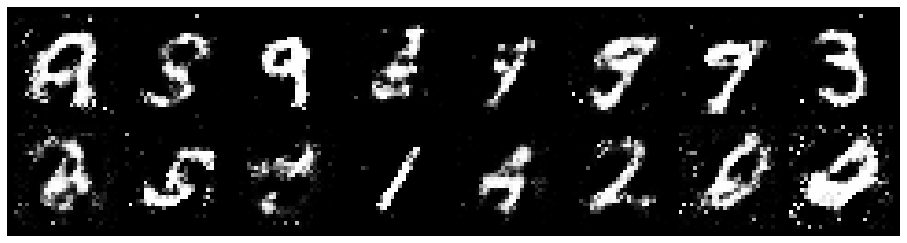

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.1497, Generator Loss: 1.2287
D(x): 0.5927, D(G(z)): 0.3691


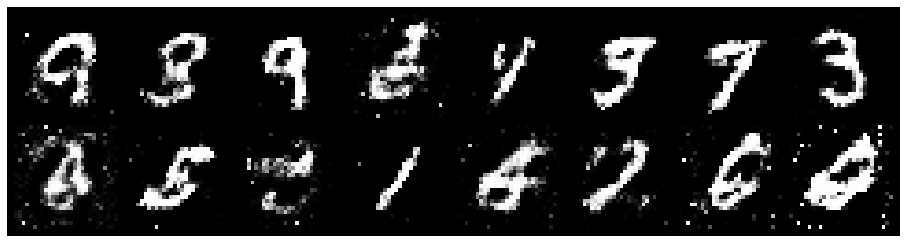

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.1234, Generator Loss: 1.1940
D(x): 0.5809, D(G(z)): 0.3393


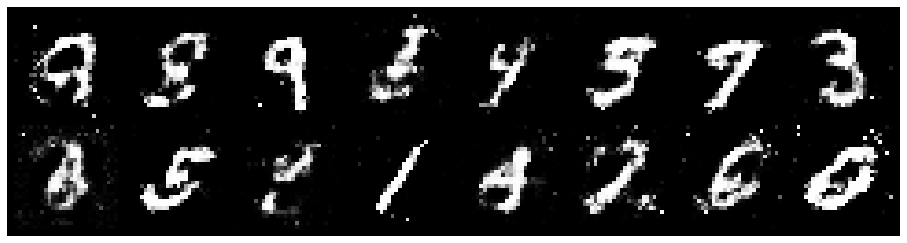

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0540, Generator Loss: 1.2438
D(x): 0.5995, D(G(z)): 0.2904


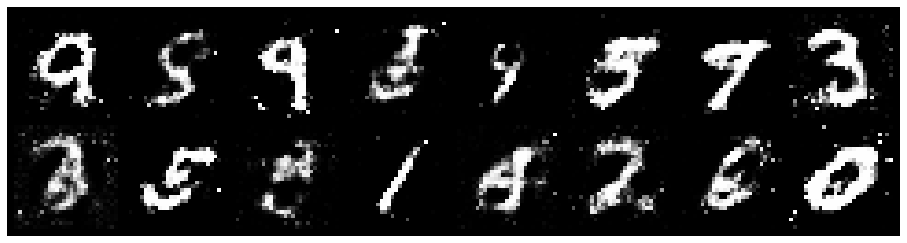

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 0.9912, Generator Loss: 1.4766
D(x): 0.6528, D(G(z)): 0.3056


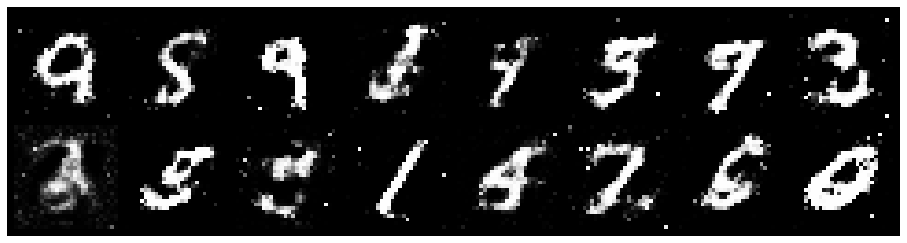

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.1254, Generator Loss: 1.4001
D(x): 0.6252, D(G(z)): 0.3698


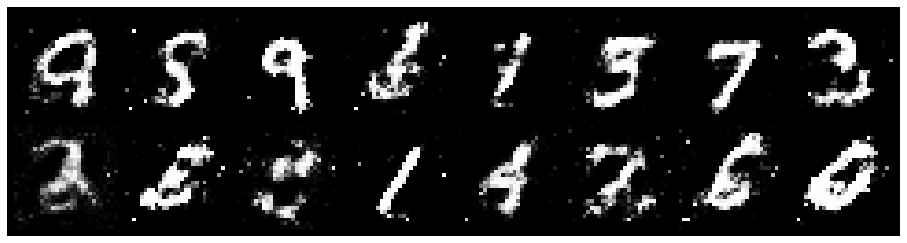

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.9287, Generator Loss: 1.5267
D(x): 0.6591, D(G(z)): 0.2808


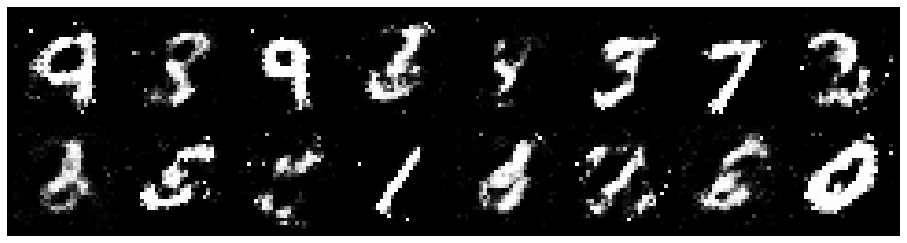

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.1354, Generator Loss: 1.4222
D(x): 0.6827, D(G(z)): 0.4052


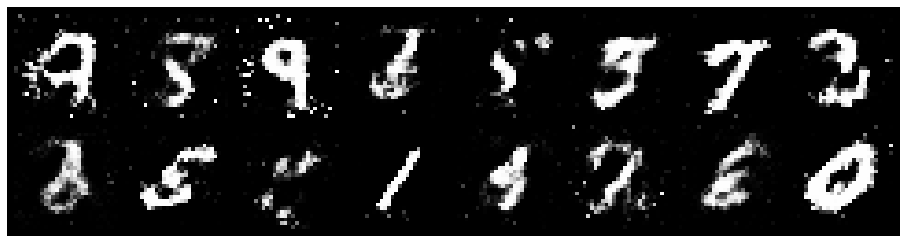

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0428, Generator Loss: 1.6181
D(x): 0.6520, D(G(z)): 0.2889


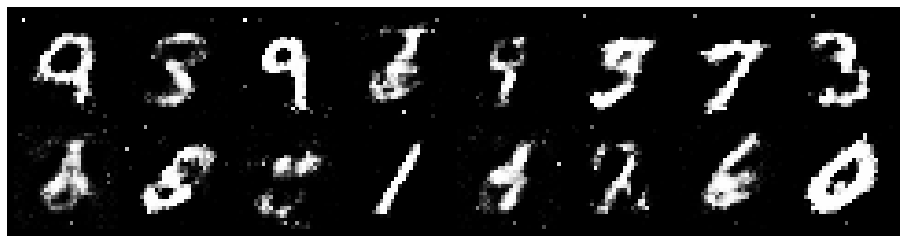

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.2586, Generator Loss: 1.3843
D(x): 0.6431, D(G(z)): 0.3782


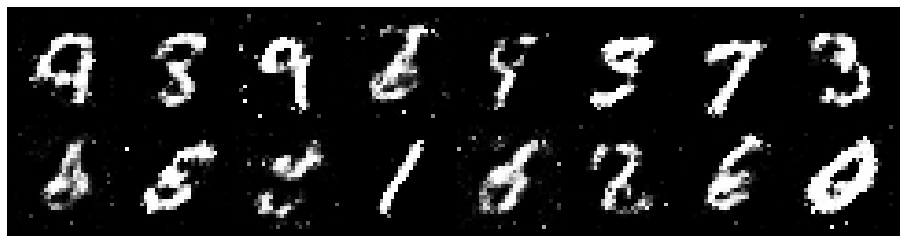

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.2239, Generator Loss: 1.3450
D(x): 0.6481, D(G(z)): 0.4001


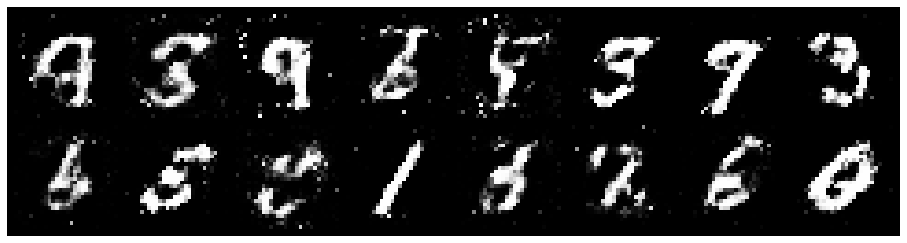

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.2248, Generator Loss: 1.1832
D(x): 0.5393, D(G(z)): 0.3198


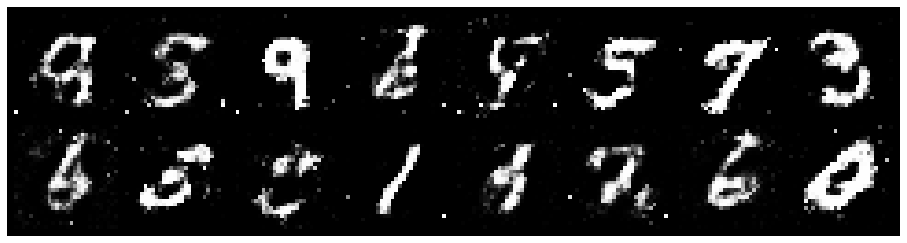

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.1468, Generator Loss: 1.2299
D(x): 0.5903, D(G(z)): 0.3637


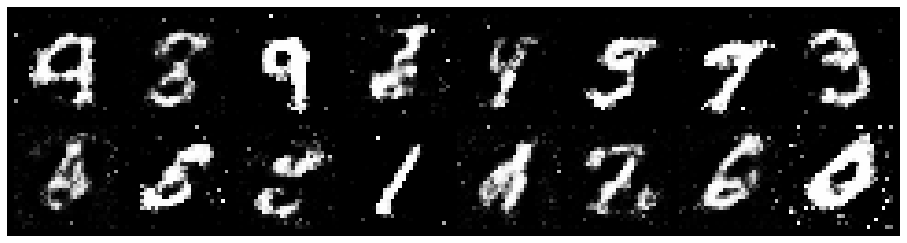

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.0718, Generator Loss: 1.3655
D(x): 0.6662, D(G(z)): 0.3629


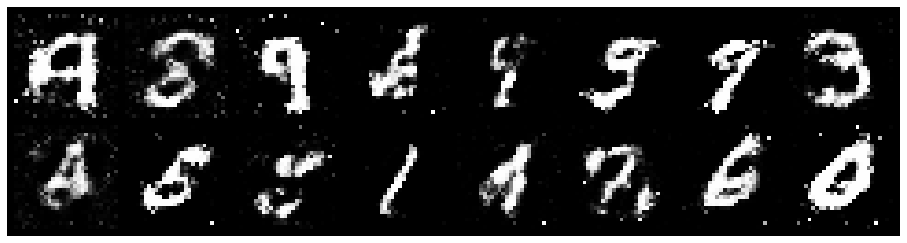

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.0121, Generator Loss: 1.0638
D(x): 0.6692, D(G(z)): 0.4011


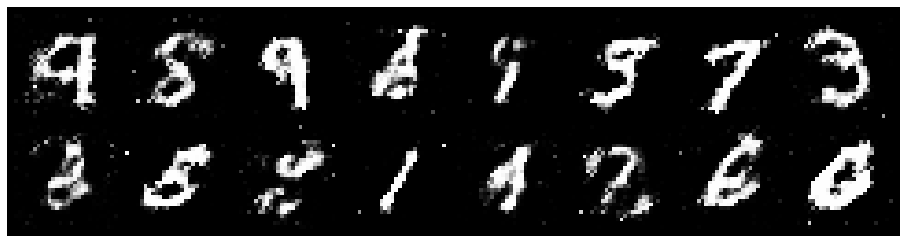

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.9633, Generator Loss: 1.3462
D(x): 0.7237, D(G(z)): 0.3749


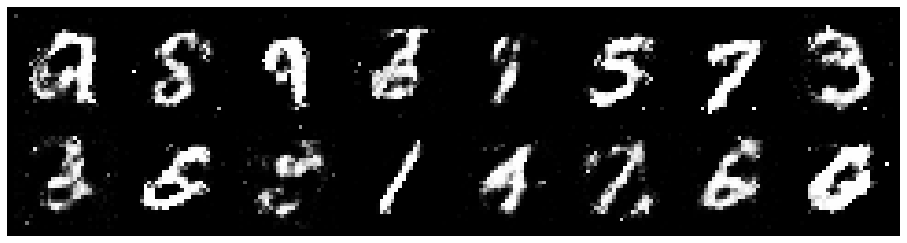

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 0.9720, Generator Loss: 1.2929
D(x): 0.6376, D(G(z)): 0.2930


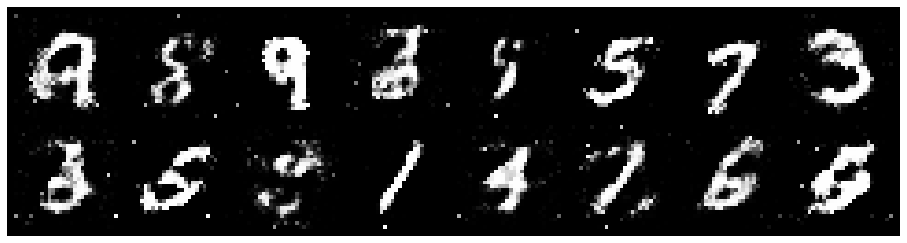

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 0.9486, Generator Loss: 1.2786
D(x): 0.7024, D(G(z)): 0.3629


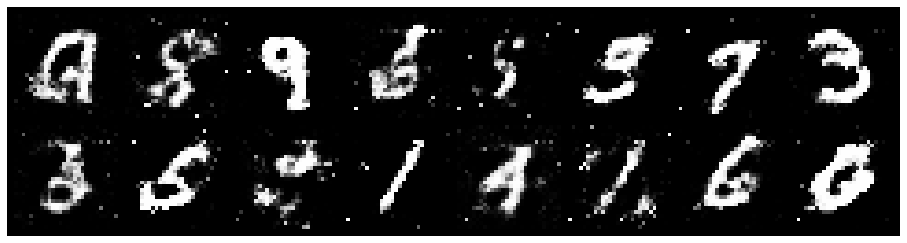

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0245, Generator Loss: 1.3392
D(x): 0.6263, D(G(z)): 0.3473


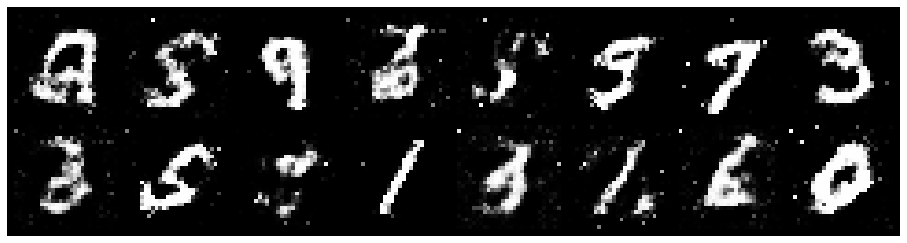

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.9664, Generator Loss: 1.4260
D(x): 0.6548, D(G(z)): 0.3401


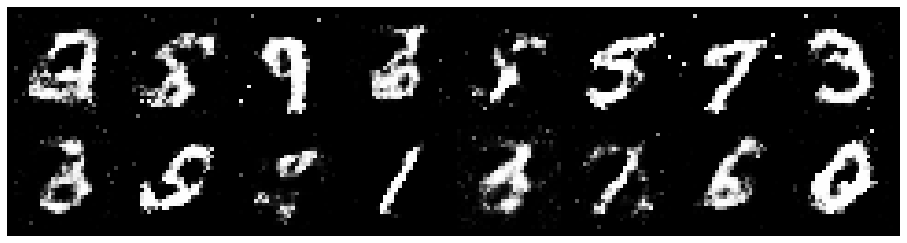

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0450, Generator Loss: 1.1585
D(x): 0.6751, D(G(z)): 0.3766


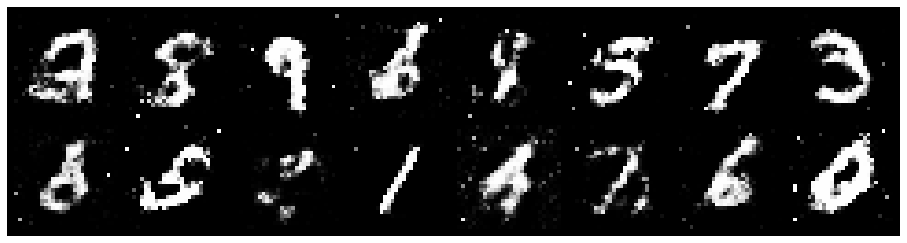

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9755, Generator Loss: 1.4127
D(x): 0.6513, D(G(z)): 0.3181


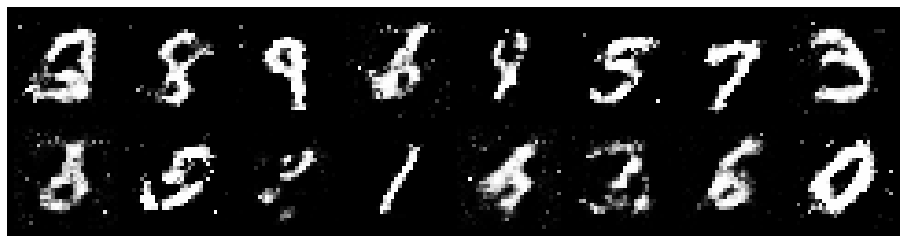

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 0.9800, Generator Loss: 1.4988
D(x): 0.7168, D(G(z)): 0.3923


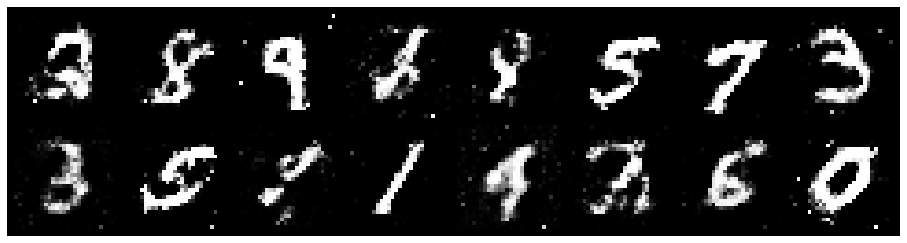

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0457, Generator Loss: 1.2608
D(x): 0.6914, D(G(z)): 0.3918


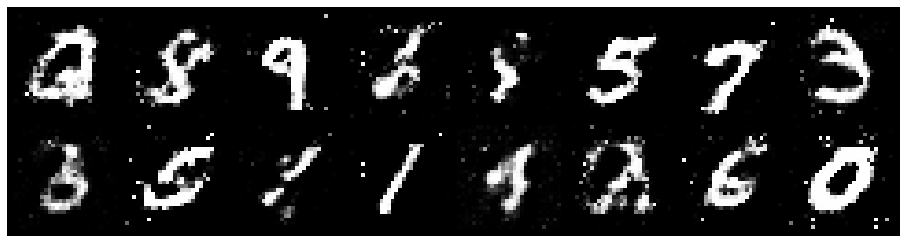

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0563, Generator Loss: 1.3506
D(x): 0.6781, D(G(z)): 0.3356


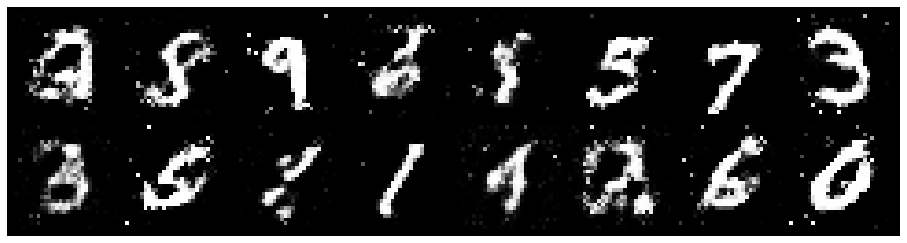

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0282, Generator Loss: 1.4213
D(x): 0.6346, D(G(z)): 0.3340


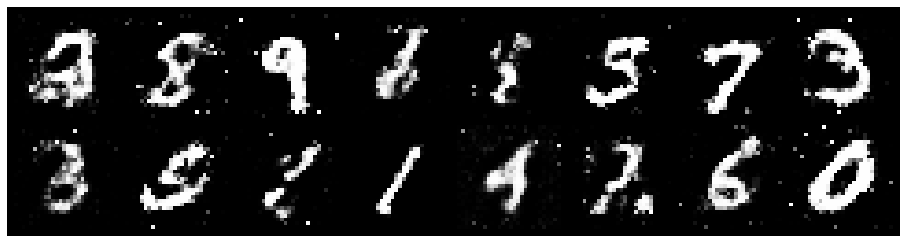

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.1872, Generator Loss: 1.3362
D(x): 0.6104, D(G(z)): 0.3959


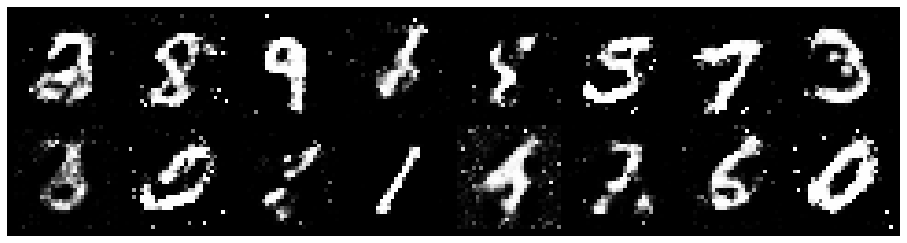

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.9942, Generator Loss: 1.3464
D(x): 0.6561, D(G(z)): 0.3327


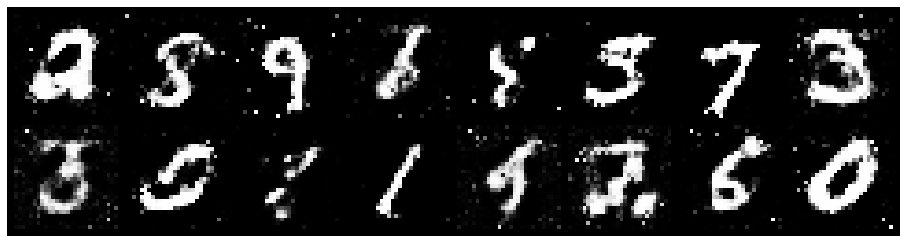

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.2630, Generator Loss: 1.1003
D(x): 0.6085, D(G(z)): 0.4095


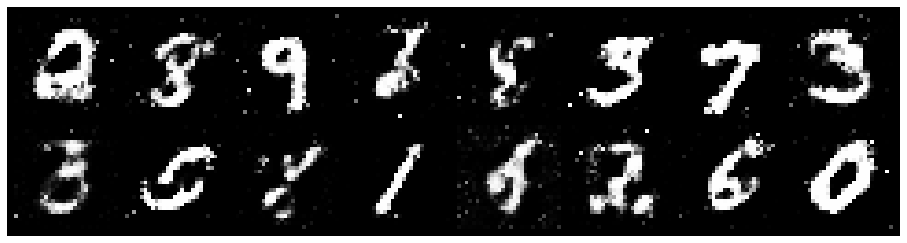

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1689, Generator Loss: 1.2491
D(x): 0.5881, D(G(z)): 0.3676


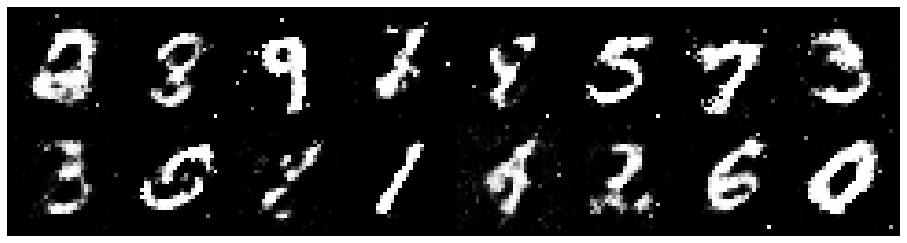

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1568, Generator Loss: 0.9994
D(x): 0.6431, D(G(z)): 0.4183


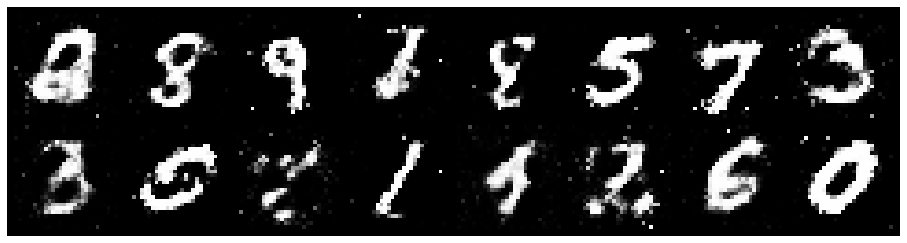

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.2237, Generator Loss: 1.1087
D(x): 0.6671, D(G(z)): 0.4609


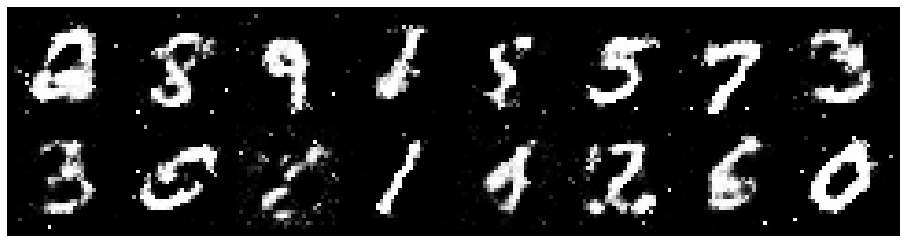

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.2276, Generator Loss: 1.0377
D(x): 0.5580, D(G(z)): 0.3712


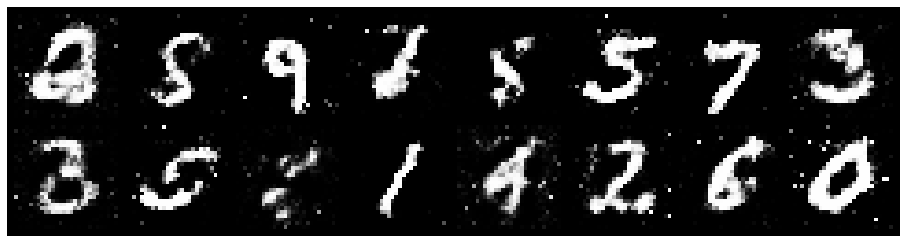

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.2250, Generator Loss: 0.9108
D(x): 0.5748, D(G(z)): 0.4103


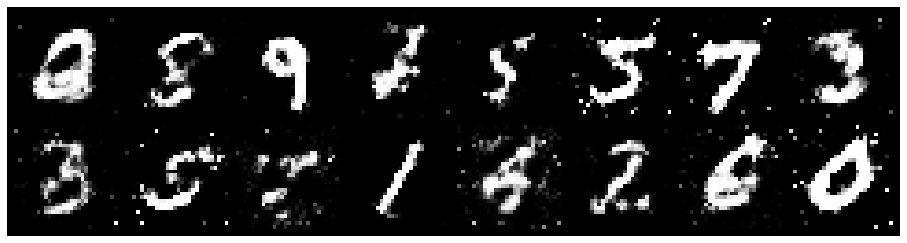

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.1149, Generator Loss: 0.9921
D(x): 0.6175, D(G(z)): 0.3883


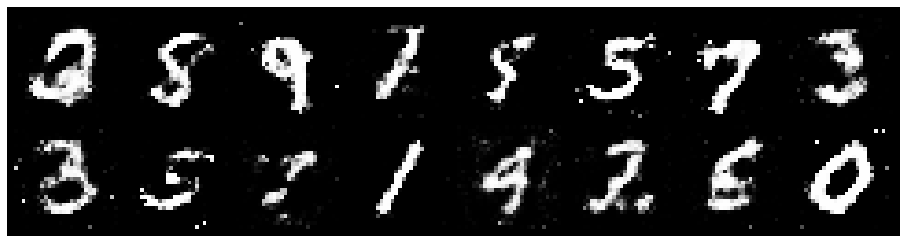

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1183, Generator Loss: 1.2089
D(x): 0.6489, D(G(z)): 0.4123


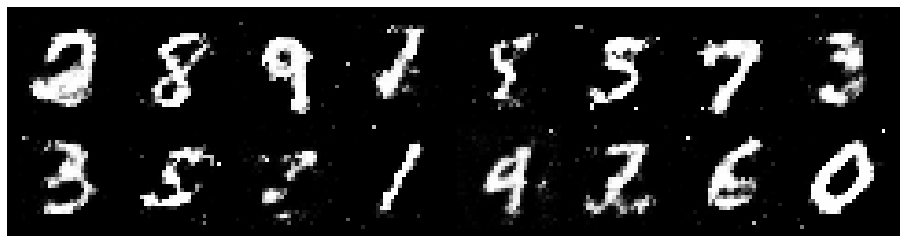

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1340, Generator Loss: 1.0963
D(x): 0.7091, D(G(z)): 0.4305


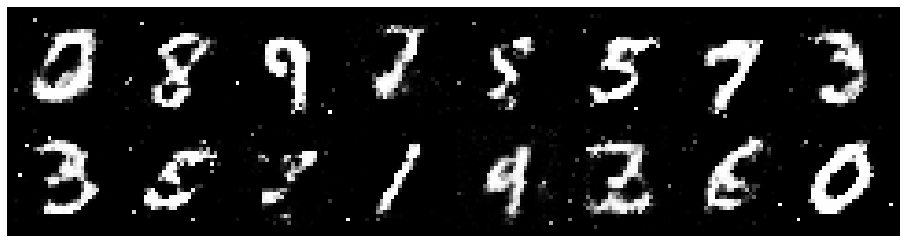

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.2592, Generator Loss: 1.0177
D(x): 0.5416, D(G(z)): 0.3626


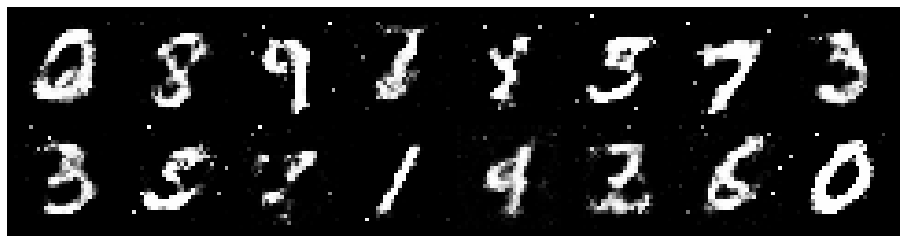

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.2950, Generator Loss: 1.1936
D(x): 0.5580, D(G(z)): 0.3669


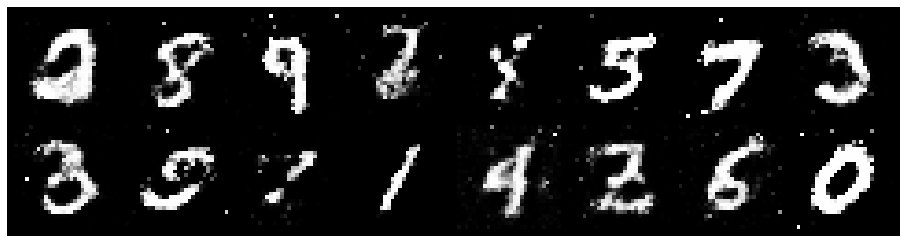

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.0767, Generator Loss: 1.2597
D(x): 0.6141, D(G(z)): 0.3659


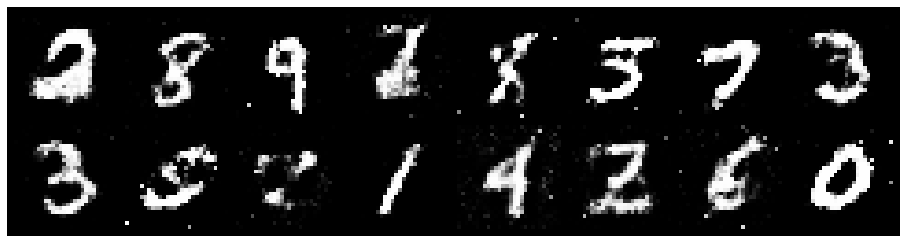

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.2711, Generator Loss: 1.0813
D(x): 0.5765, D(G(z)): 0.4307


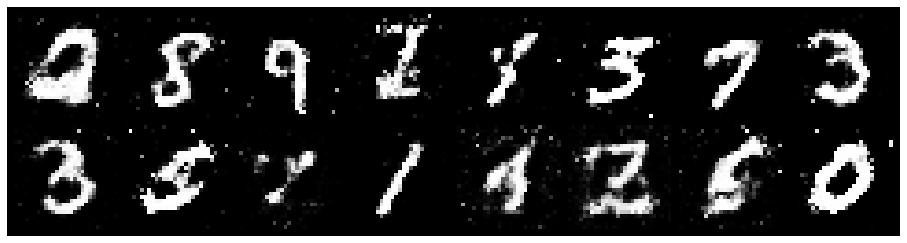

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1490, Generator Loss: 0.8806
D(x): 0.6083, D(G(z)): 0.4273


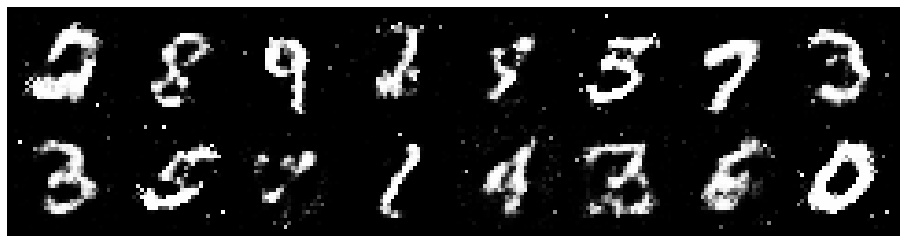

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.2155, Generator Loss: 1.0748
D(x): 0.5801, D(G(z)): 0.4061


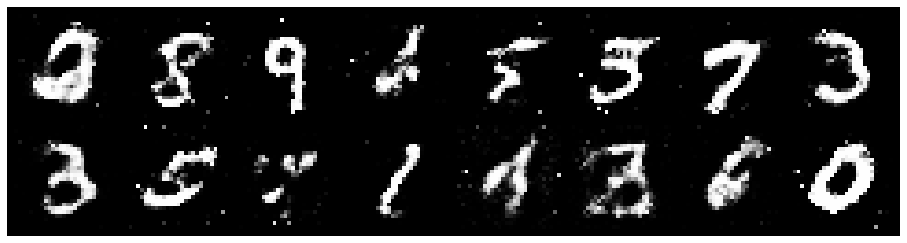

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.3015, Generator Loss: 1.1947
D(x): 0.5666, D(G(z)): 0.3761


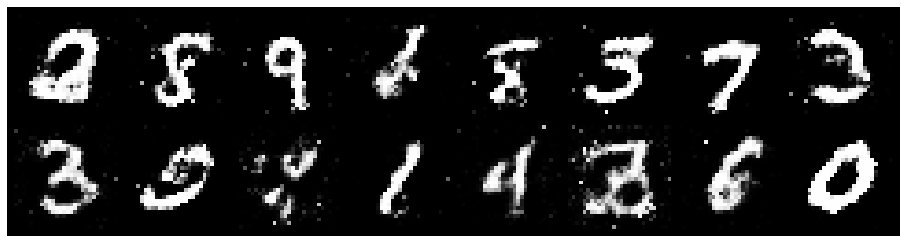

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.3793, Generator Loss: 0.8555
D(x): 0.6137, D(G(z)): 0.5105


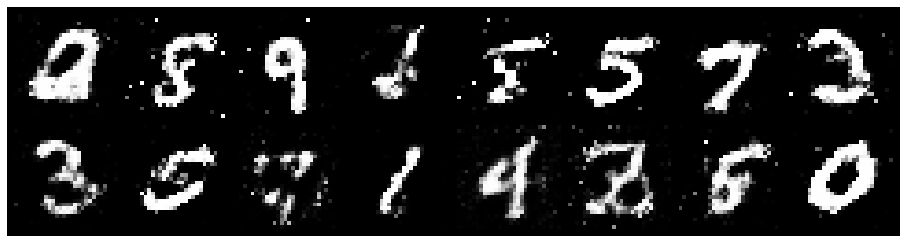

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.1521, Generator Loss: 1.0152
D(x): 0.5888, D(G(z)): 0.3896


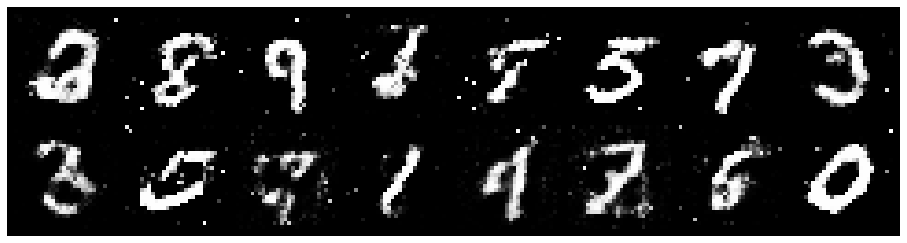

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.1435, Generator Loss: 0.9190
D(x): 0.6519, D(G(z)): 0.4527


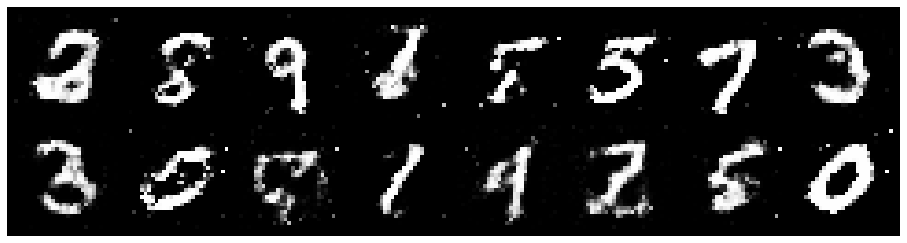

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.2882, Generator Loss: 1.3265
D(x): 0.5380, D(G(z)): 0.3567


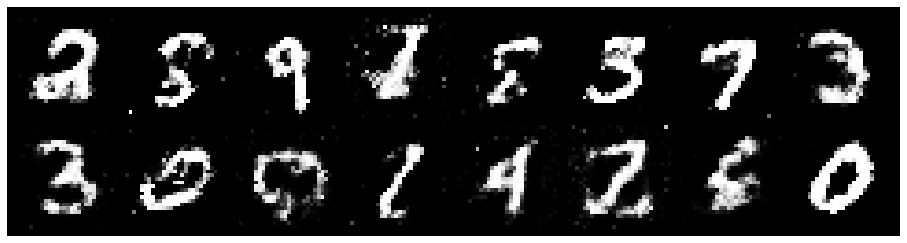

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1064, Generator Loss: 1.0168
D(x): 0.6195, D(G(z)): 0.3983


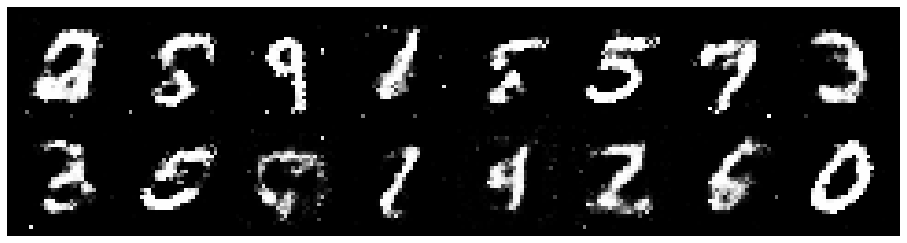

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1855, Generator Loss: 0.9656
D(x): 0.5694, D(G(z)): 0.3916


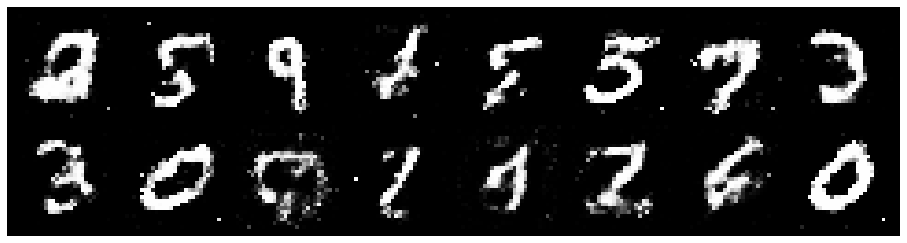

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0886, Generator Loss: 1.1434
D(x): 0.6363, D(G(z)): 0.3996


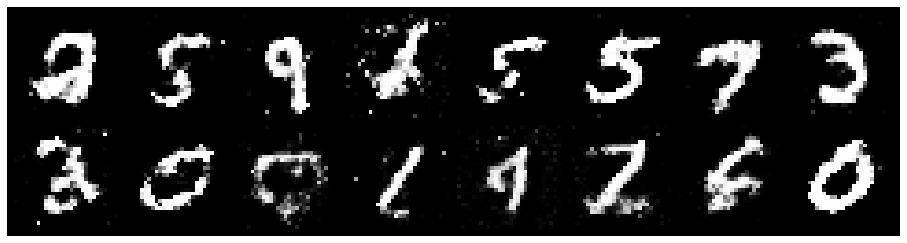

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1147, Generator Loss: 1.0866
D(x): 0.6509, D(G(z)): 0.4361


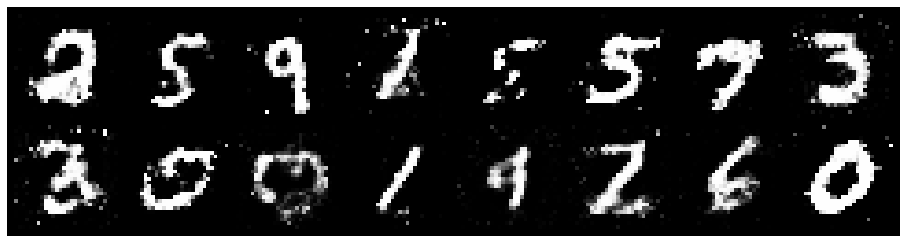

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1675, Generator Loss: 1.0641
D(x): 0.5705, D(G(z)): 0.3544


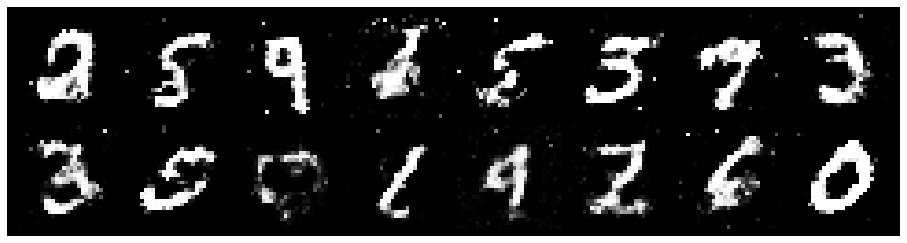

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.3814, Generator Loss: 0.9399
D(x): 0.5291, D(G(z)): 0.4159


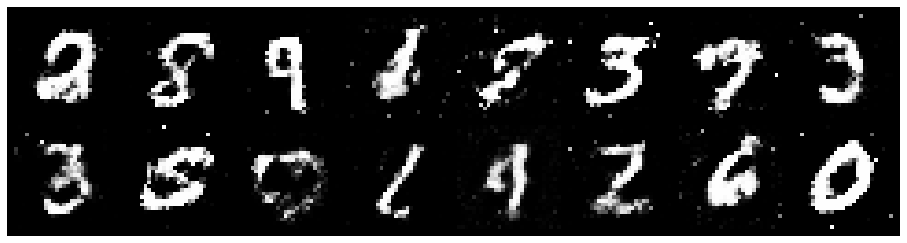

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1168, Generator Loss: 0.9129
D(x): 0.6797, D(G(z)): 0.4521


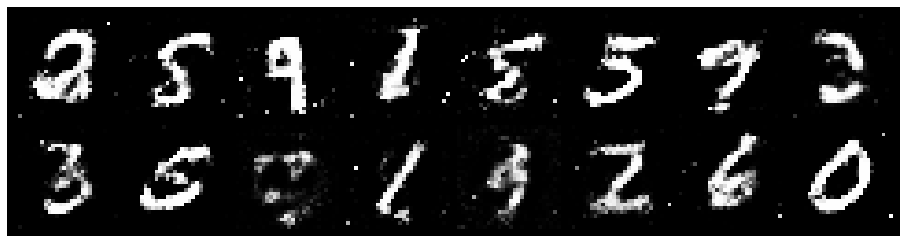

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1426, Generator Loss: 1.0390
D(x): 0.6301, D(G(z)): 0.4039


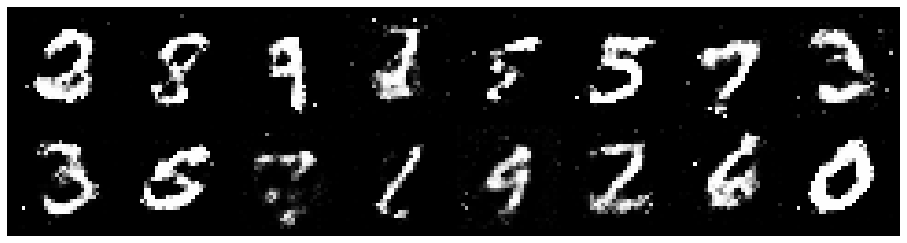

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1915, Generator Loss: 0.9844
D(x): 0.6055, D(G(z)): 0.4185


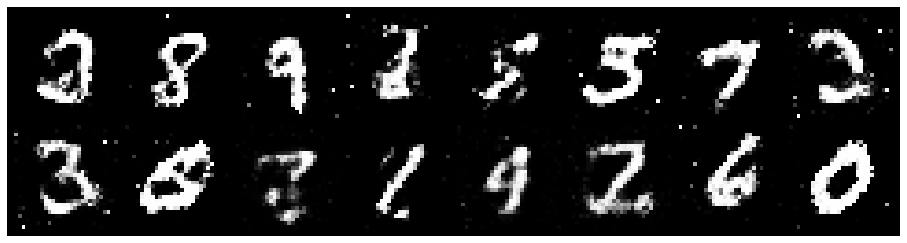

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.2150, Generator Loss: 1.0259
D(x): 0.5760, D(G(z)): 0.4163


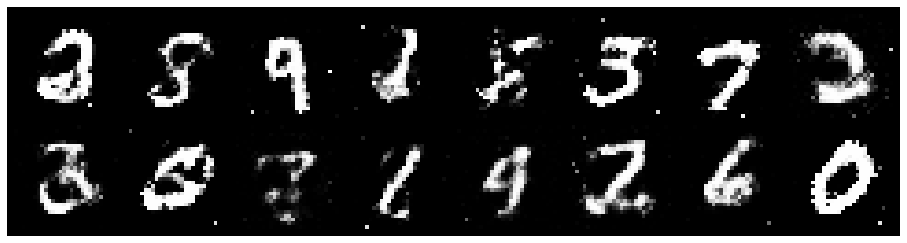

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0721, Generator Loss: 1.0603
D(x): 0.6249, D(G(z)): 0.3930


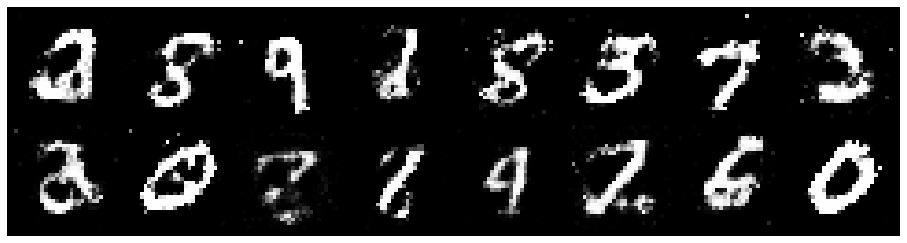

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1741, Generator Loss: 1.1654
D(x): 0.5662, D(G(z)): 0.3550


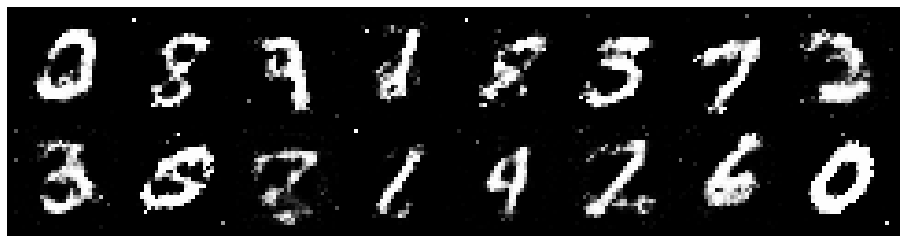

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 0.8905, Generator Loss: 1.4872
D(x): 0.6981, D(G(z)): 0.3271


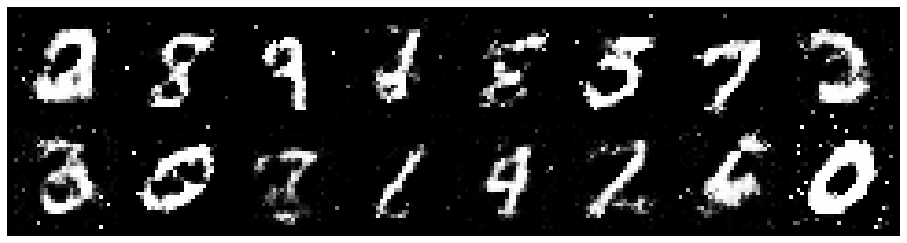

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 0.9871, Generator Loss: 1.3159
D(x): 0.6408, D(G(z)): 0.3216


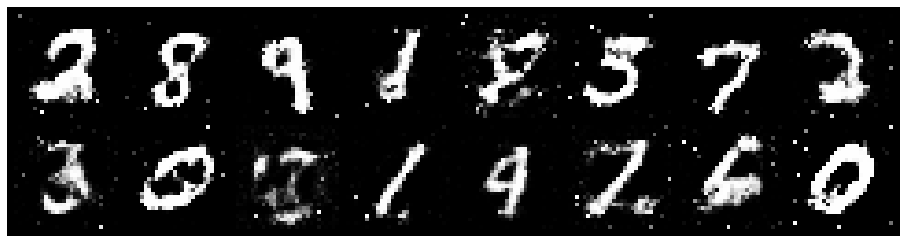

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.0583, Generator Loss: 1.1916
D(x): 0.6659, D(G(z)): 0.3741


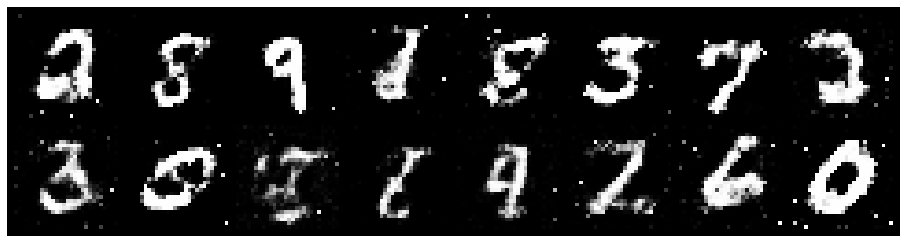

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 0.9596, Generator Loss: 1.3311
D(x): 0.6645, D(G(z)): 0.3280


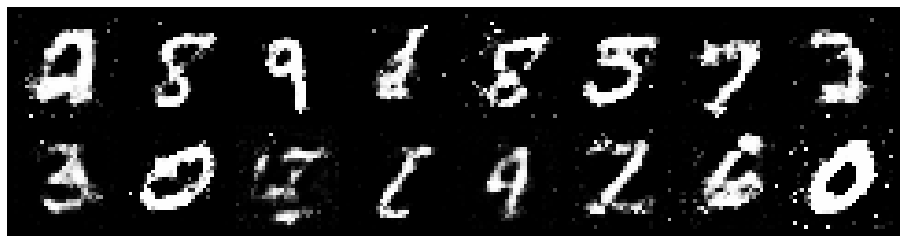

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.1341, Generator Loss: 1.1805
D(x): 0.6919, D(G(z)): 0.4490


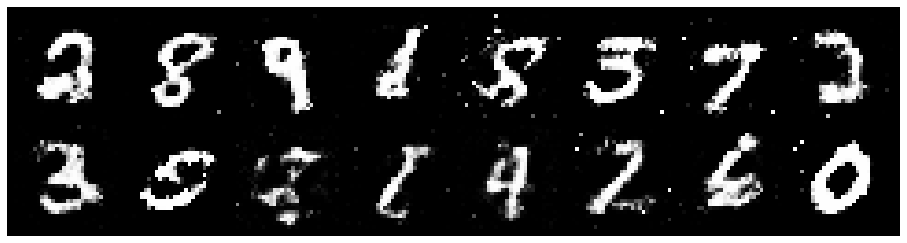

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.0585, Generator Loss: 1.3356
D(x): 0.6245, D(G(z)): 0.3659


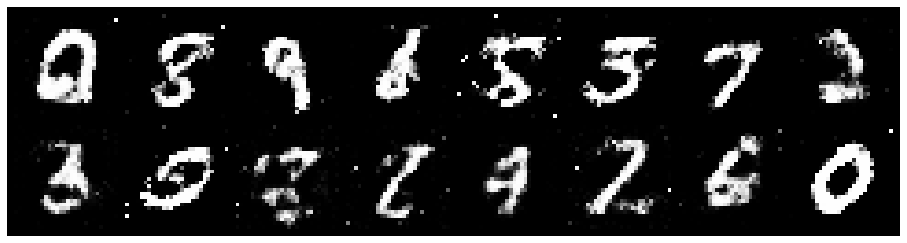

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 0.9849, Generator Loss: 1.0363
D(x): 0.6703, D(G(z)): 0.3904


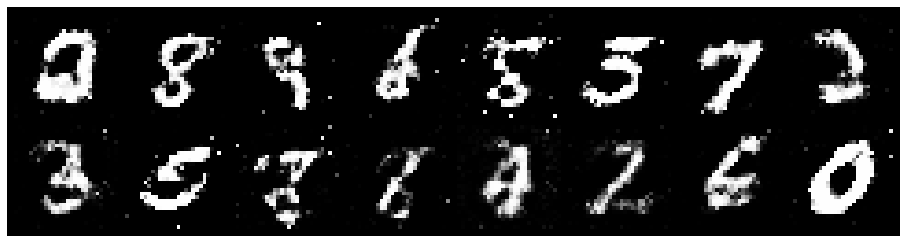

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1172, Generator Loss: 1.3199
D(x): 0.5948, D(G(z)): 0.3661


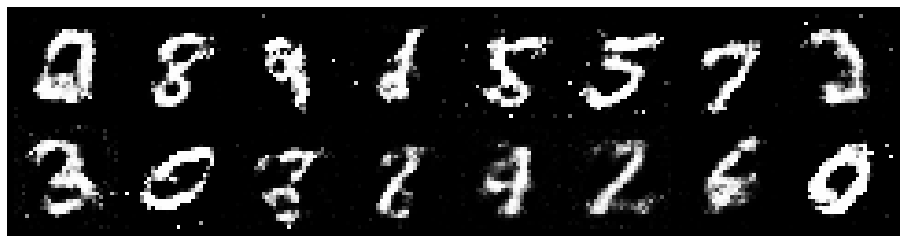

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.2048, Generator Loss: 1.0226
D(x): 0.6287, D(G(z)): 0.4301


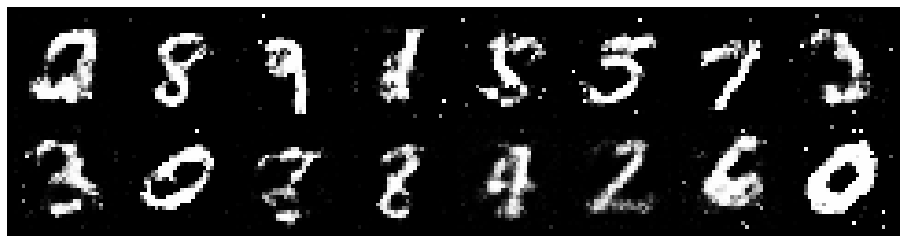

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.2178, Generator Loss: 1.0245
D(x): 0.5436, D(G(z)): 0.3677


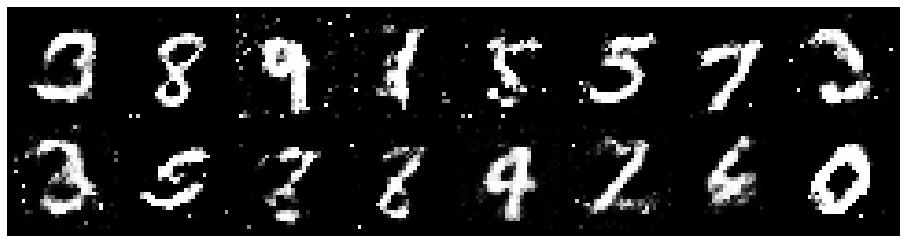

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.1927, Generator Loss: 0.9465
D(x): 0.5835, D(G(z)): 0.4062


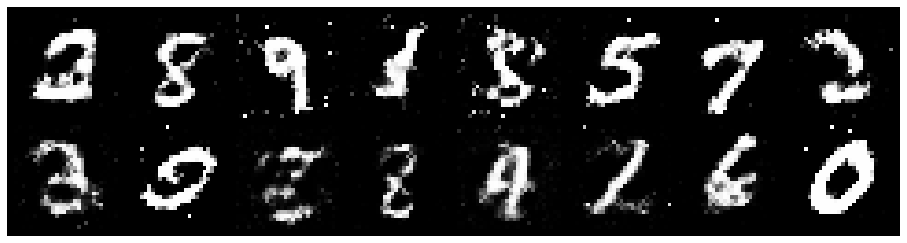

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.2344, Generator Loss: 1.1389
D(x): 0.5911, D(G(z)): 0.4228


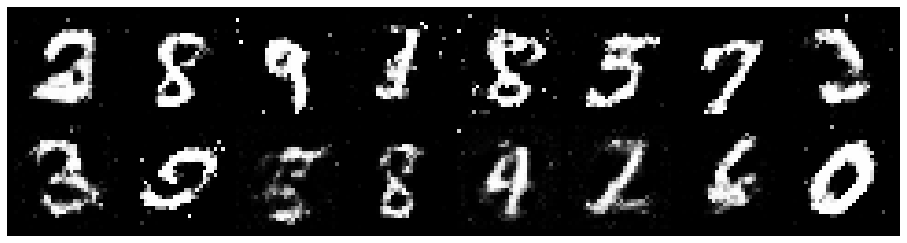

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.2270, Generator Loss: 1.0409
D(x): 0.5531, D(G(z)): 0.3805


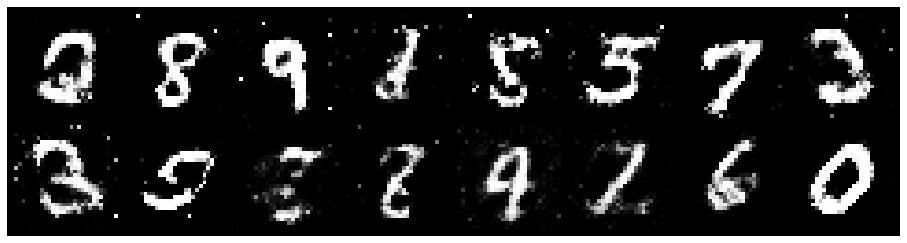

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1548, Generator Loss: 1.0186
D(x): 0.5941, D(G(z)): 0.3858


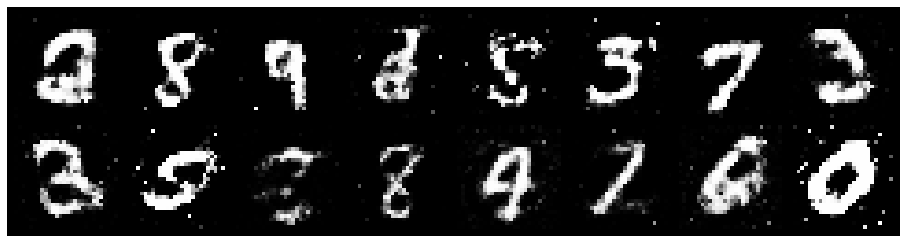

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.1196, Generator Loss: 1.1259
D(x): 0.6315, D(G(z)): 0.3991


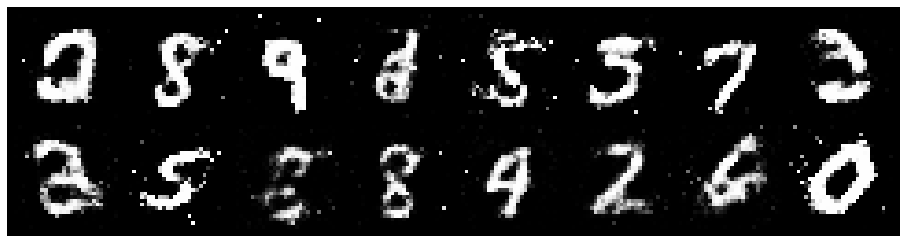

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.2110, Generator Loss: 1.3354
D(x): 0.6482, D(G(z)): 0.4088


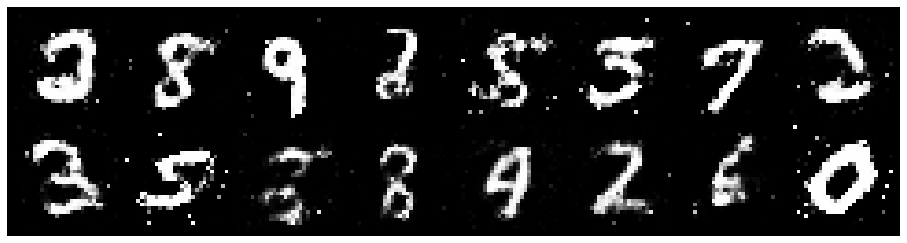

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0732, Generator Loss: 1.2741
D(x): 0.6163, D(G(z)): 0.3518


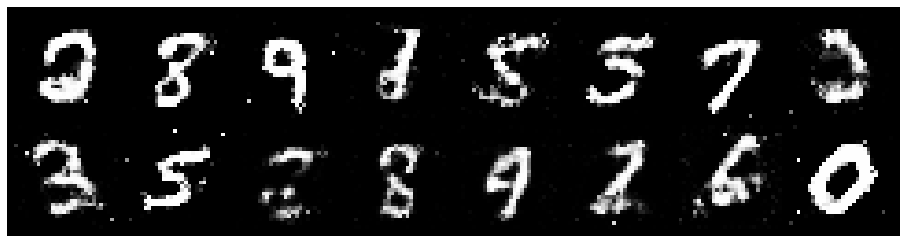

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.0487, Generator Loss: 1.4037
D(x): 0.6179, D(G(z)): 0.3491


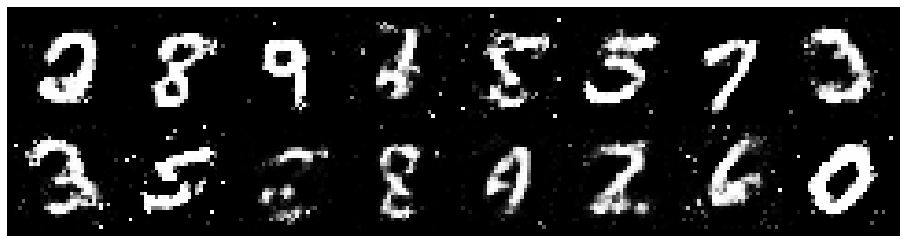

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0697, Generator Loss: 1.1317
D(x): 0.6545, D(G(z)): 0.3887


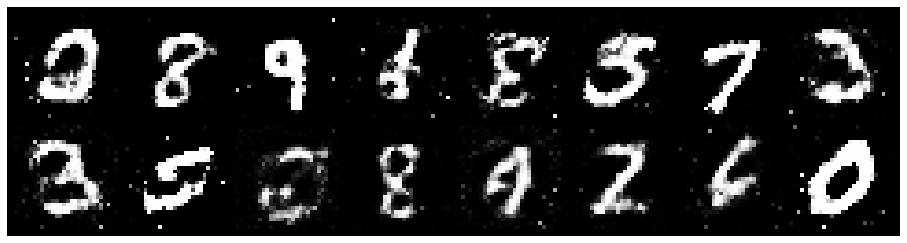

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.3117, Generator Loss: 1.0762
D(x): 0.6009, D(G(z)): 0.3985


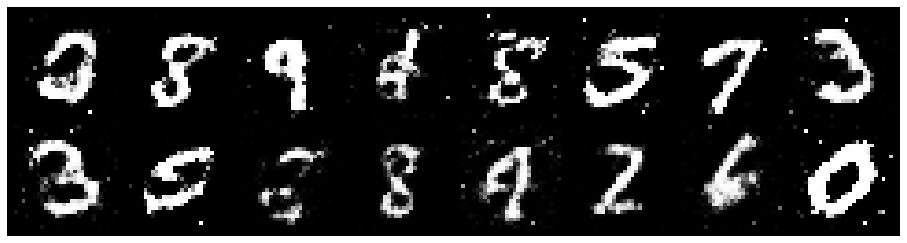

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.2185, Generator Loss: 0.9481
D(x): 0.6023, D(G(z)): 0.4322


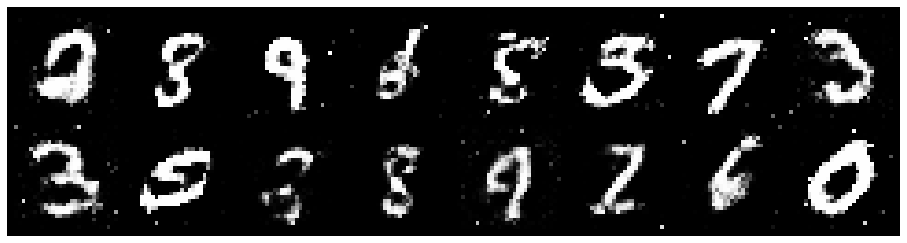

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0609, Generator Loss: 1.2384
D(x): 0.5784, D(G(z)): 0.3180


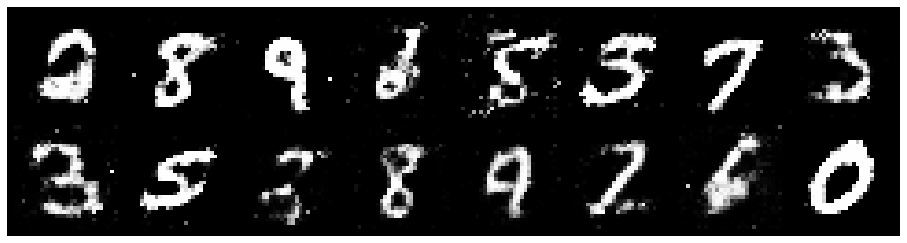

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1524, Generator Loss: 1.1893
D(x): 0.5832, D(G(z)): 0.3691


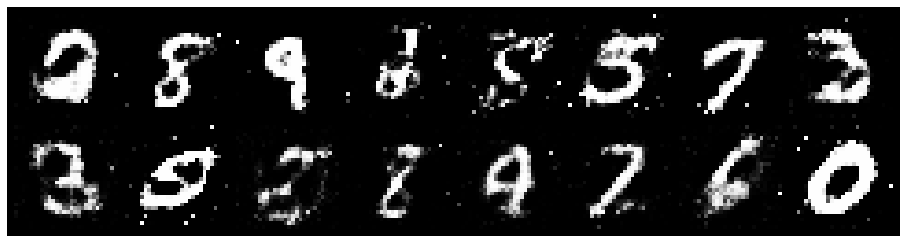

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.2350, Generator Loss: 1.1436
D(x): 0.5461, D(G(z)): 0.3926


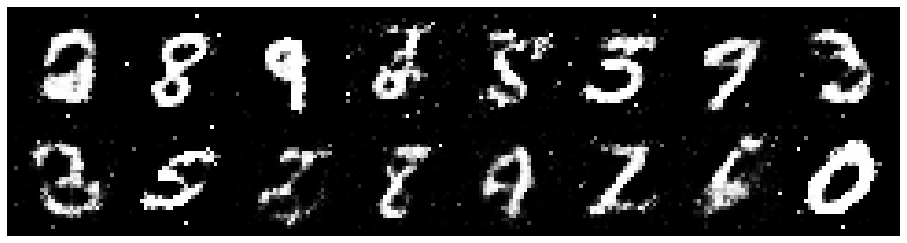

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1493, Generator Loss: 0.9871
D(x): 0.5981, D(G(z)): 0.4034


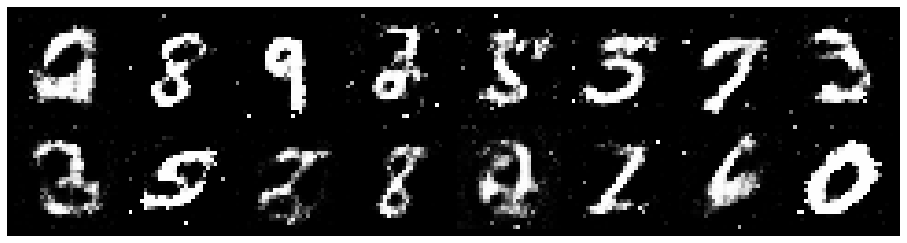

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1056, Generator Loss: 1.0225
D(x): 0.5880, D(G(z)): 0.3636


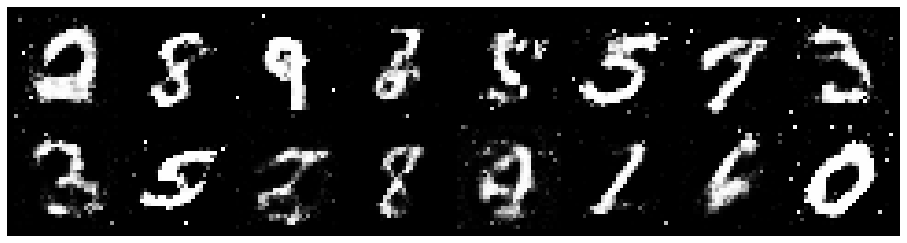

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.0915, Generator Loss: 1.0390
D(x): 0.6154, D(G(z)): 0.3840


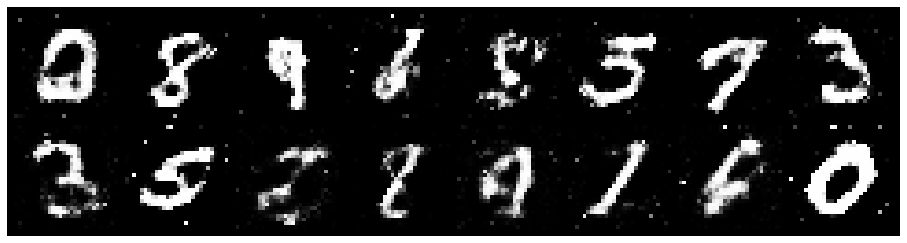

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1331, Generator Loss: 1.3292
D(x): 0.5791, D(G(z)): 0.3433


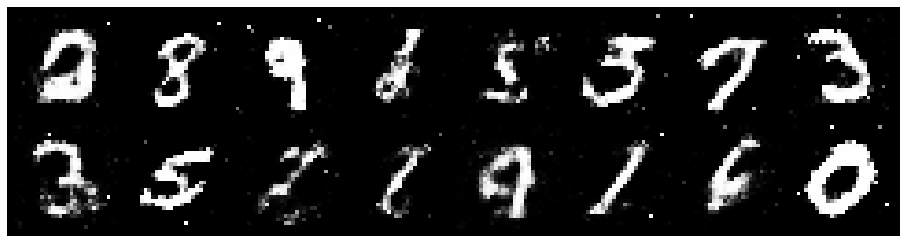

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 0.9959, Generator Loss: 1.3430
D(x): 0.5922, D(G(z)): 0.3003


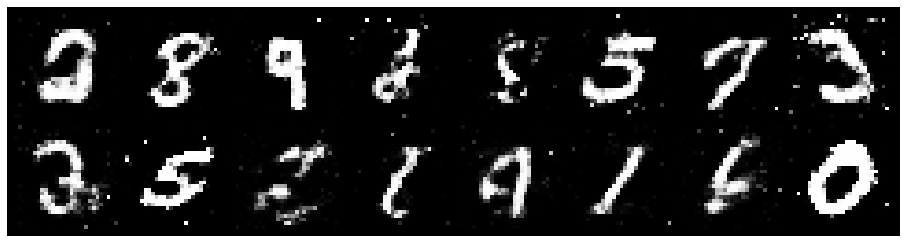

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1157, Generator Loss: 1.0706
D(x): 0.6237, D(G(z)): 0.4121


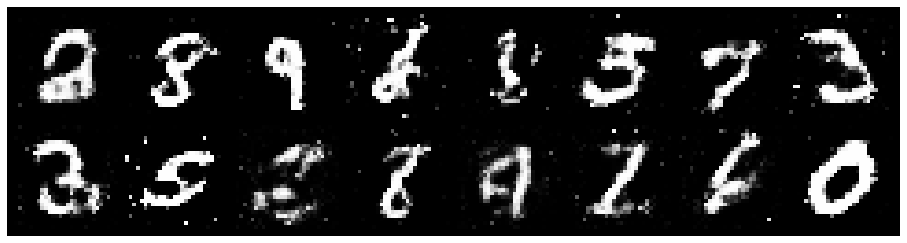

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.1120, Generator Loss: 1.2169
D(x): 0.5931, D(G(z)): 0.3732


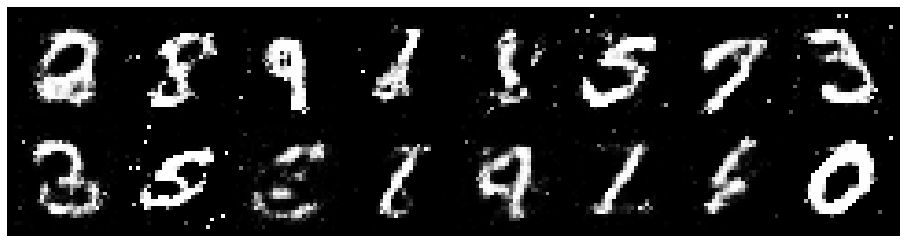

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.2835, Generator Loss: 1.0270
D(x): 0.5754, D(G(z)): 0.4139


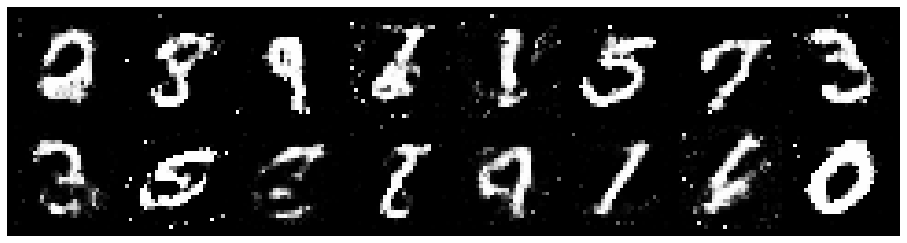

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.2075, Generator Loss: 1.1498
D(x): 0.5931, D(G(z)): 0.3951


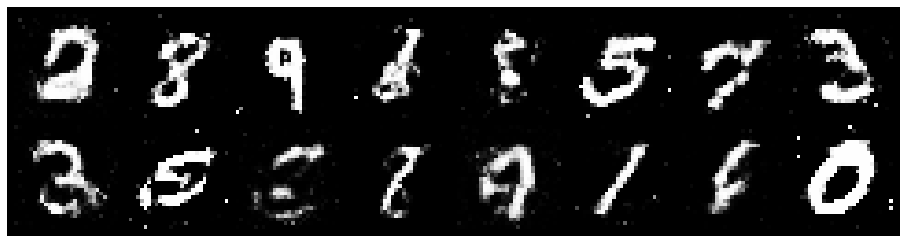

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.2065, Generator Loss: 1.0275
D(x): 0.6059, D(G(z)): 0.4106


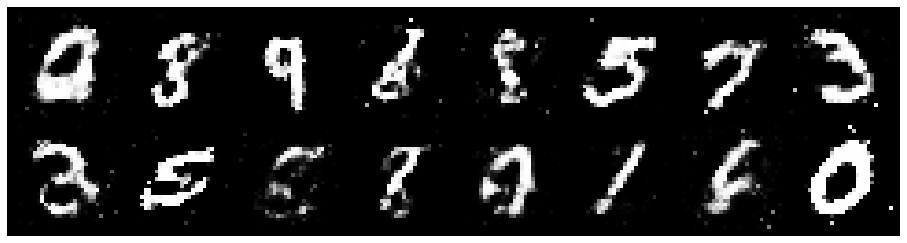

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.2834, Generator Loss: 1.0504
D(x): 0.6017, D(G(z)): 0.4095


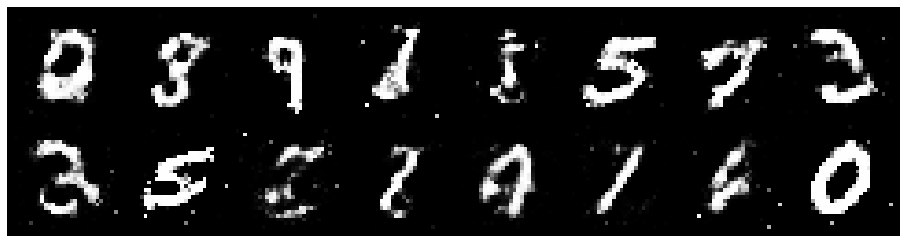

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1929, Generator Loss: 0.8591
D(x): 0.5801, D(G(z)): 0.4194


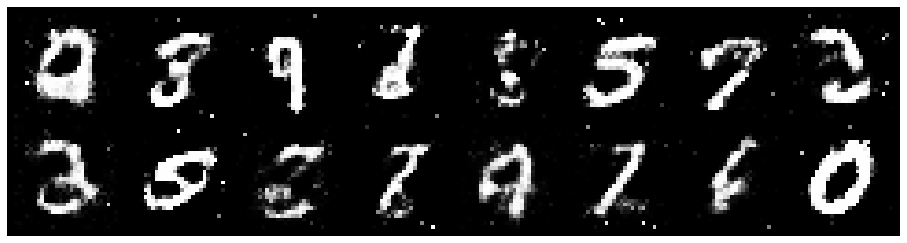

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.2280, Generator Loss: 1.1262
D(x): 0.5334, D(G(z)): 0.3521


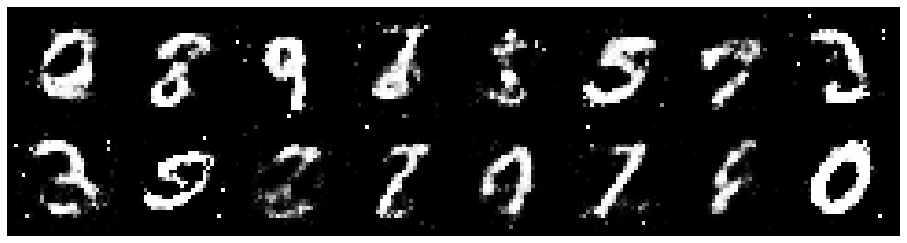

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1893, Generator Loss: 0.9689
D(x): 0.5969, D(G(z)): 0.4266


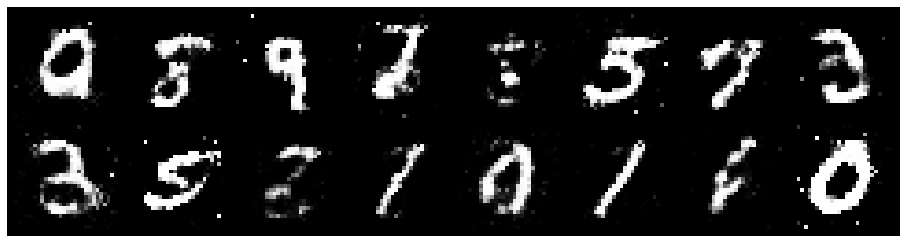

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1845, Generator Loss: 0.8901
D(x): 0.5703, D(G(z)): 0.4068


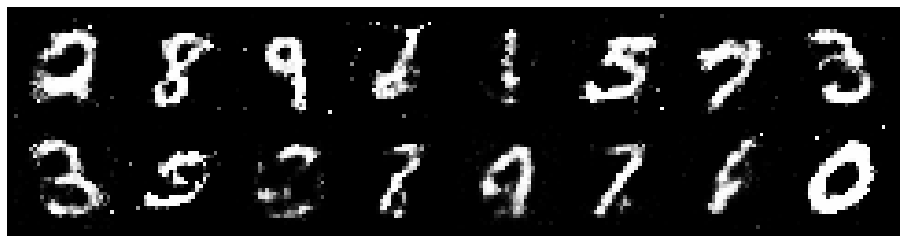

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.3250, Generator Loss: 0.9117
D(x): 0.5027, D(G(z)): 0.4059


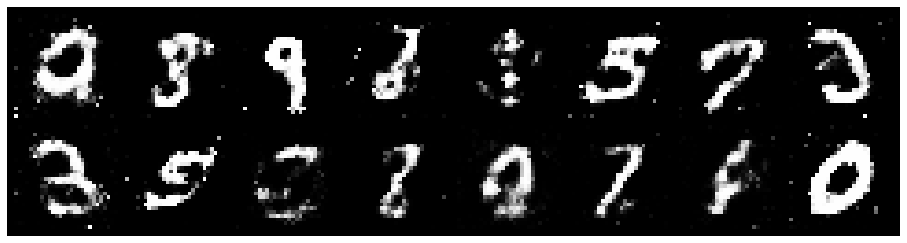

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.1497, Generator Loss: 1.0051
D(x): 0.6475, D(G(z)): 0.4493


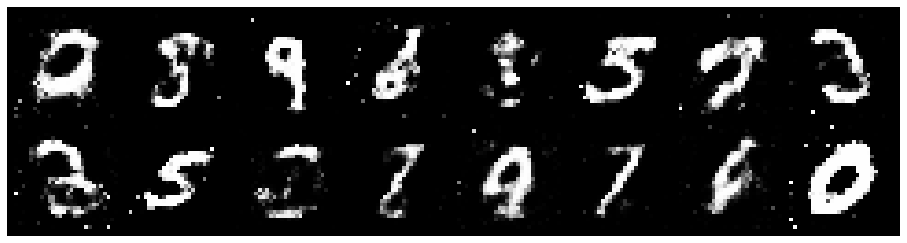

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1617, Generator Loss: 1.0071
D(x): 0.6142, D(G(z)): 0.3961


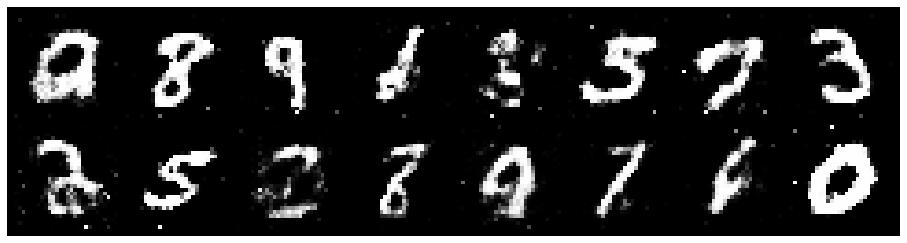

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.3136, Generator Loss: 0.8106
D(x): 0.5548, D(G(z)): 0.4477


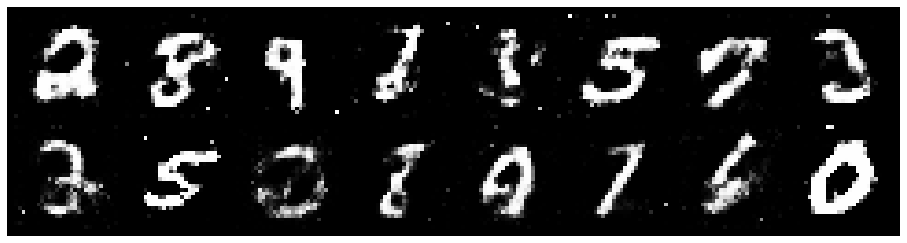

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.1700, Generator Loss: 0.9647
D(x): 0.6083, D(G(z)): 0.4078


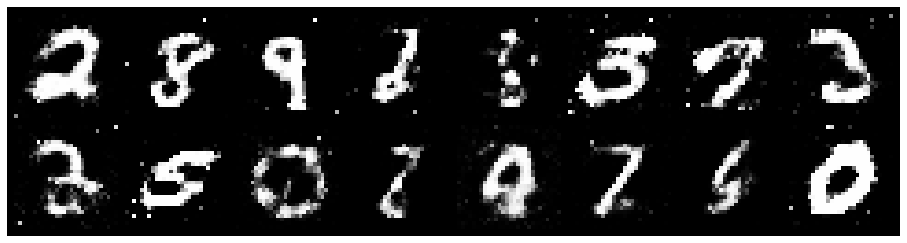

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.2692, Generator Loss: 1.0430
D(x): 0.5473, D(G(z)): 0.3989


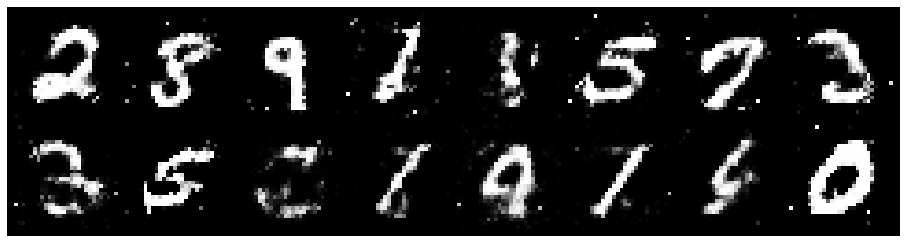

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.2051, Generator Loss: 1.0412
D(x): 0.6206, D(G(z)): 0.4047


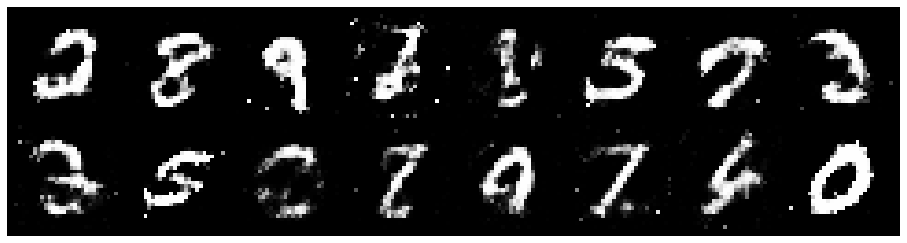

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.2475, Generator Loss: 0.8952
D(x): 0.5521, D(G(z)): 0.4096


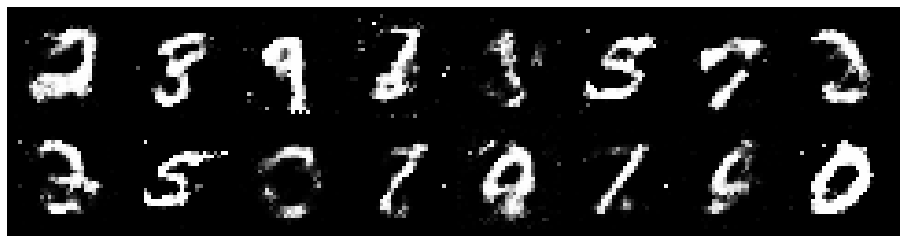

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.3792, Generator Loss: 0.7704
D(x): 0.5488, D(G(z)): 0.4768


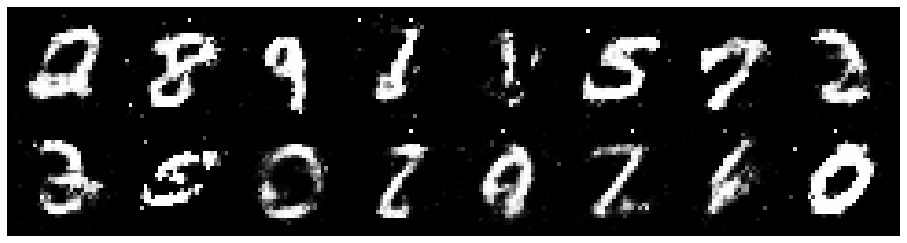

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.4135, Generator Loss: 0.7434
D(x): 0.6342, D(G(z)): 0.5487


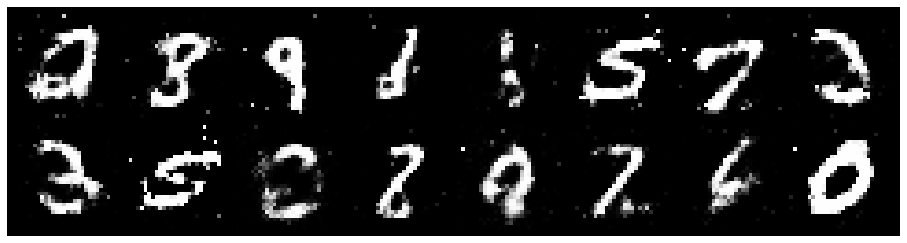

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.3522, Generator Loss: 0.9232
D(x): 0.5789, D(G(z)): 0.4731


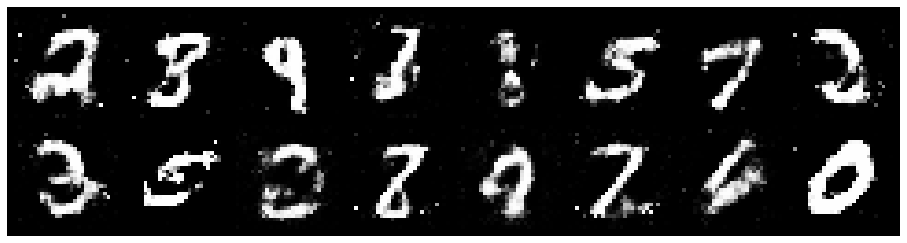

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.4388, Generator Loss: 0.9071
D(x): 0.5215, D(G(z)): 0.4627


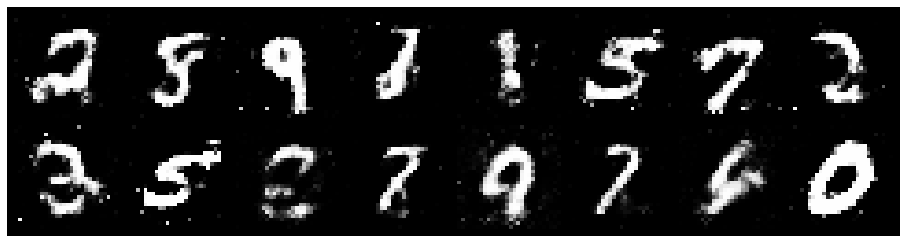

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.3826, Generator Loss: 1.0281
D(x): 0.5662, D(G(z)): 0.4621


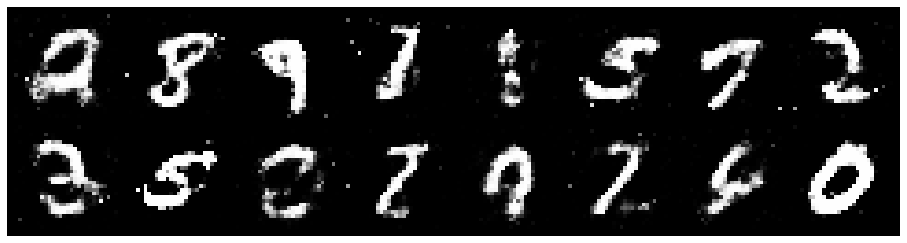

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1461, Generator Loss: 0.9533
D(x): 0.6263, D(G(z)): 0.4323


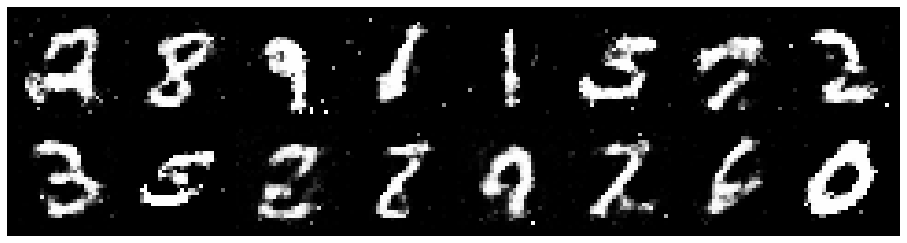

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1283, Generator Loss: 1.1701
D(x): 0.6107, D(G(z)): 0.4014


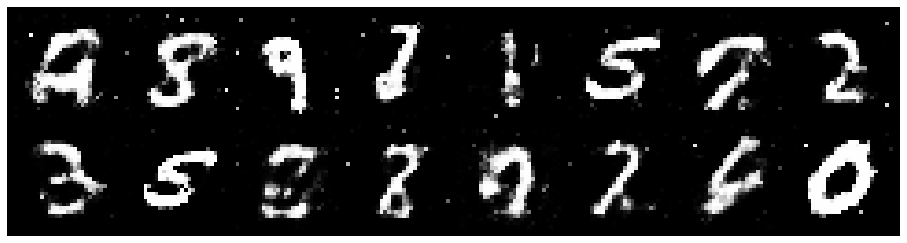

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.2355, Generator Loss: 1.1965
D(x): 0.5553, D(G(z)): 0.3903


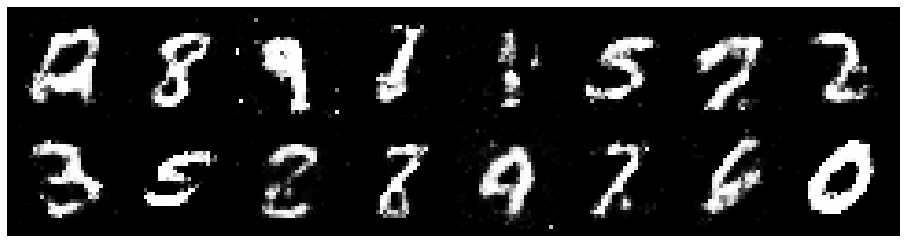

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1973, Generator Loss: 1.4160
D(x): 0.5739, D(G(z)): 0.3697


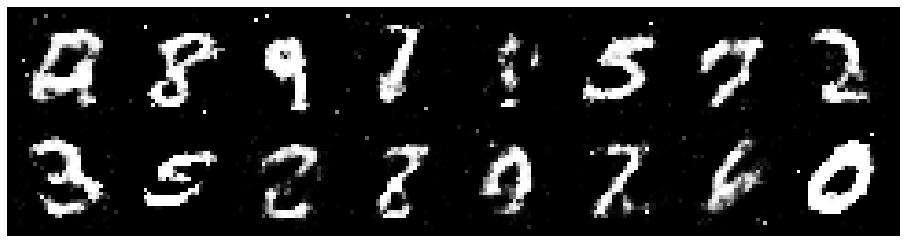

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1224, Generator Loss: 1.2336
D(x): 0.6142, D(G(z)): 0.3752


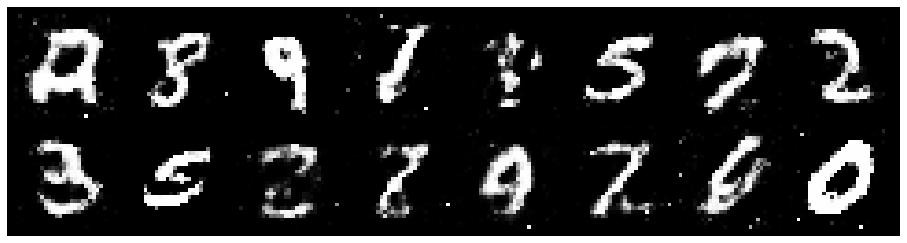

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.0190, Generator Loss: 1.2751
D(x): 0.6537, D(G(z)): 0.3407


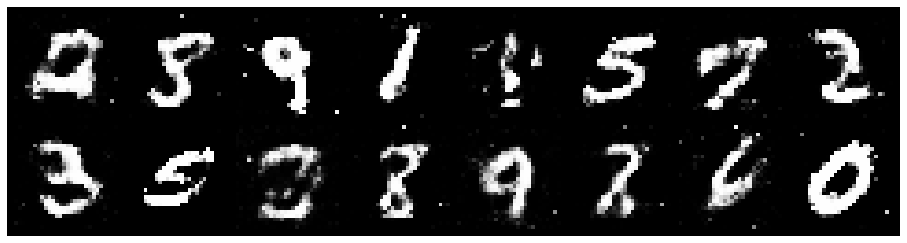

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1494, Generator Loss: 1.4823
D(x): 0.6207, D(G(z)): 0.3841


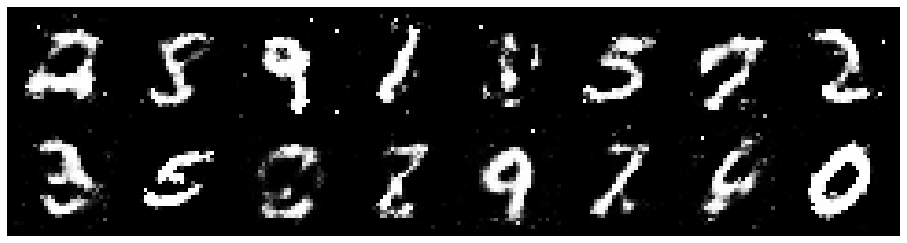

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.2370, Generator Loss: 1.1054
D(x): 0.5706, D(G(z)): 0.4045


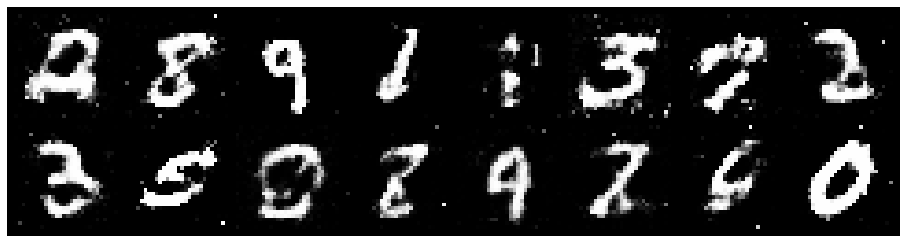

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2201, Generator Loss: 1.2565
D(x): 0.6159, D(G(z)): 0.3970


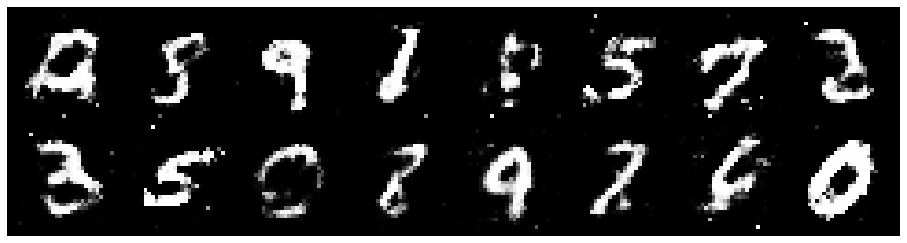

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.0702, Generator Loss: 1.0325
D(x): 0.6430, D(G(z)): 0.3968


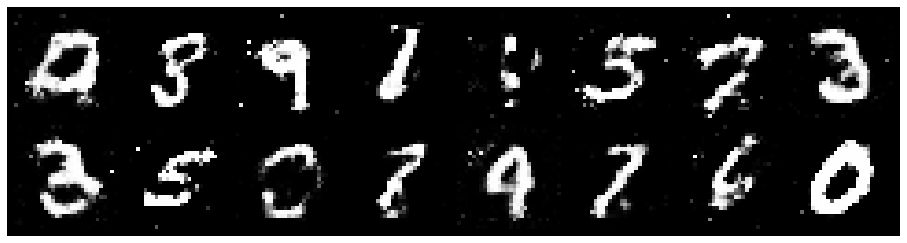

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.1221, Generator Loss: 1.1851
D(x): 0.5631, D(G(z)): 0.3555


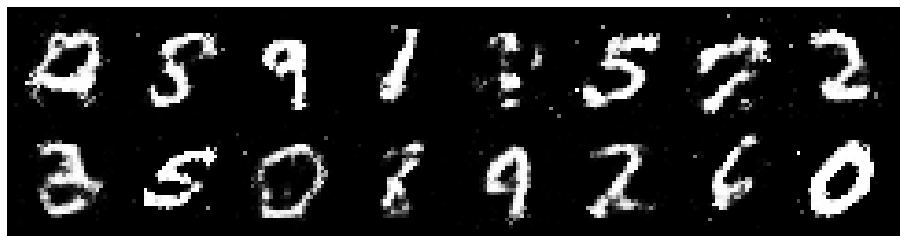

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.0925, Generator Loss: 1.1046
D(x): 0.6087, D(G(z)): 0.3851


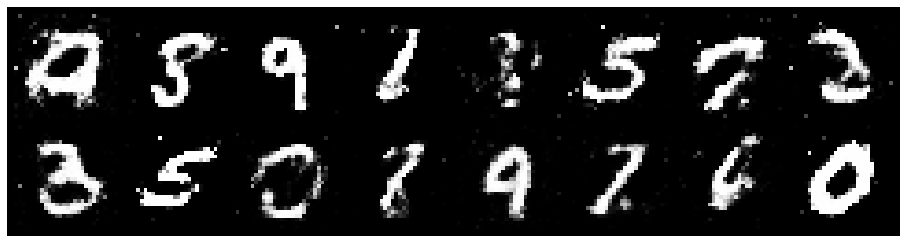

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.2341, Generator Loss: 0.9226
D(x): 0.5984, D(G(z)): 0.4483


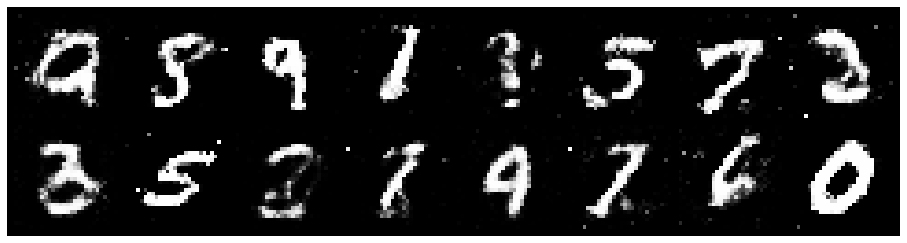

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1844, Generator Loss: 0.9043
D(x): 0.6023, D(G(z)): 0.4275


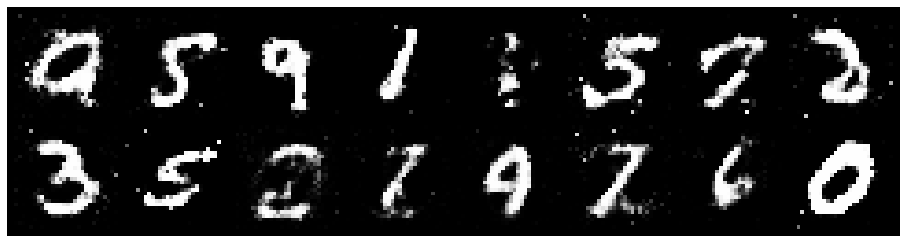

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.1432, Generator Loss: 0.9219
D(x): 0.6051, D(G(z)): 0.4085


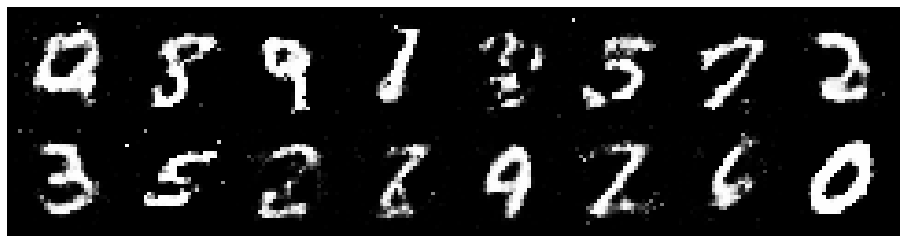

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.1626, Generator Loss: 1.0891
D(x): 0.6463, D(G(z)): 0.4371


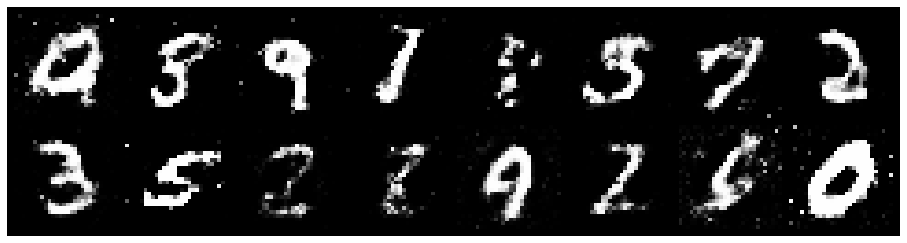

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1277, Generator Loss: 1.0742
D(x): 0.6238, D(G(z)): 0.4198


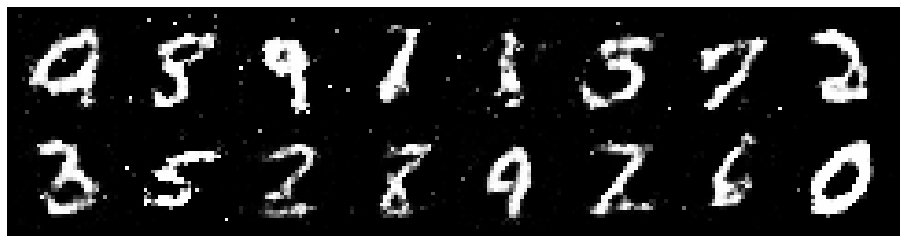

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2213, Generator Loss: 1.0439
D(x): 0.5838, D(G(z)): 0.4267


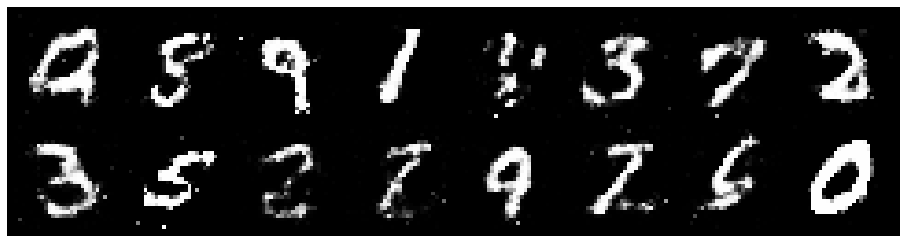

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2110, Generator Loss: 0.9558
D(x): 0.5666, D(G(z)): 0.4297


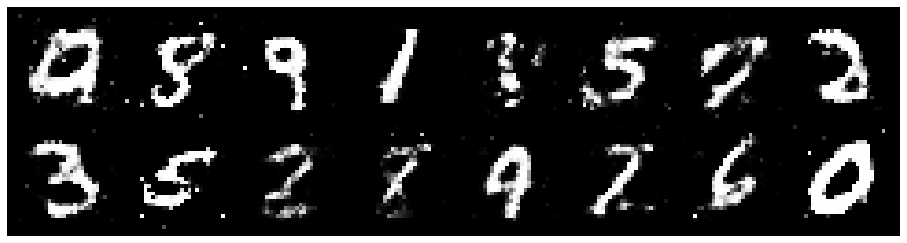

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.1459, Generator Loss: 0.9656
D(x): 0.5600, D(G(z)): 0.3930


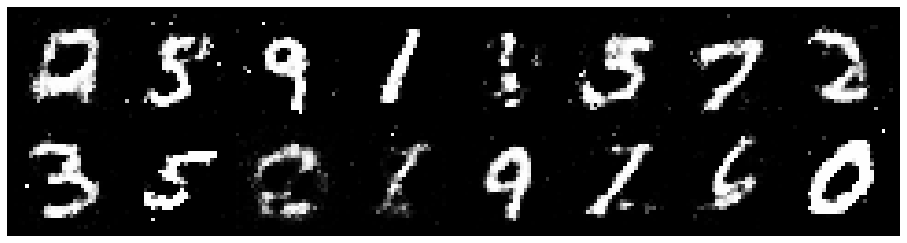

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2131, Generator Loss: 0.8848
D(x): 0.6091, D(G(z)): 0.4550


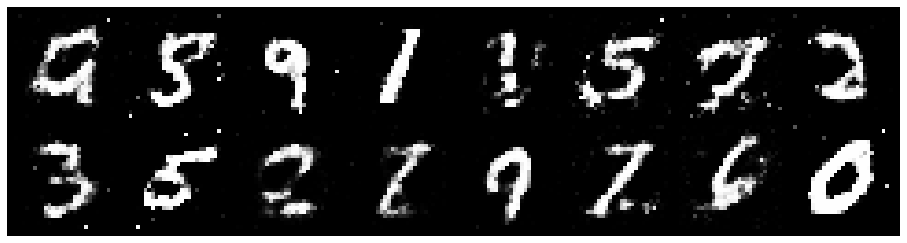

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.1991, Generator Loss: 0.9746
D(x): 0.6073, D(G(z)): 0.4498


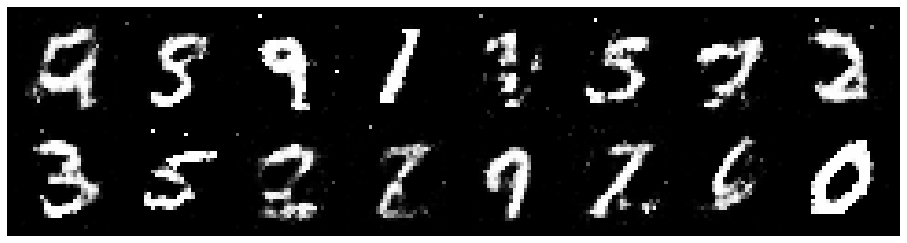

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1190, Generator Loss: 1.1009
D(x): 0.5746, D(G(z)): 0.3823


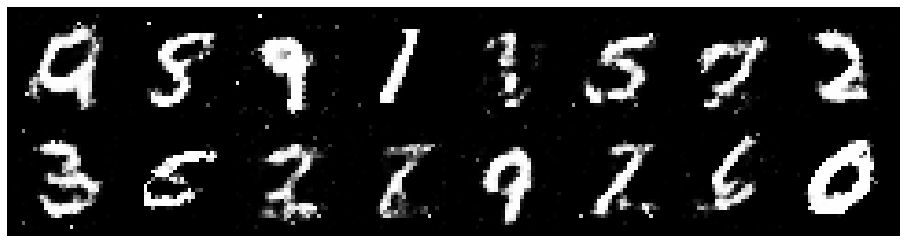

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.0290, Generator Loss: 1.0645
D(x): 0.6605, D(G(z)): 0.4067


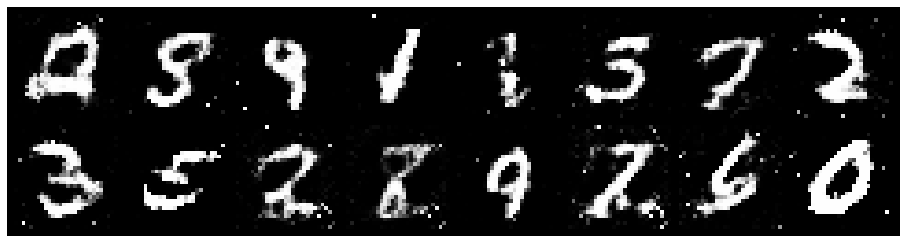

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.1471, Generator Loss: 0.9774
D(x): 0.5865, D(G(z)): 0.3973


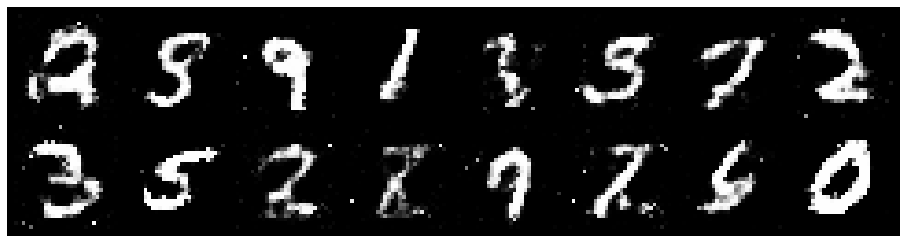

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.3083, Generator Loss: 0.9833
D(x): 0.5660, D(G(z)): 0.4504


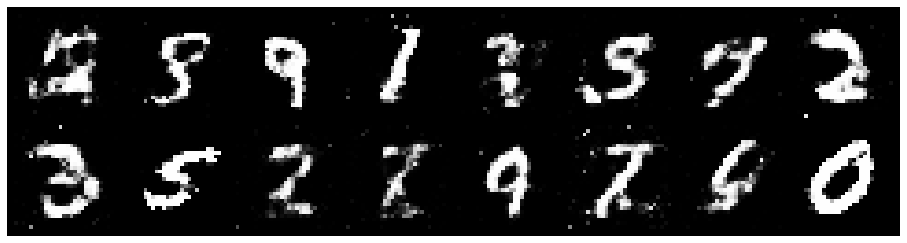

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1663, Generator Loss: 0.9947
D(x): 0.5943, D(G(z)): 0.4300


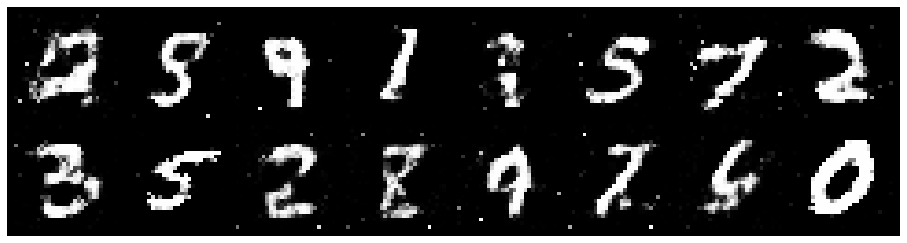

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2165, Generator Loss: 1.1355
D(x): 0.5811, D(G(z)): 0.4216


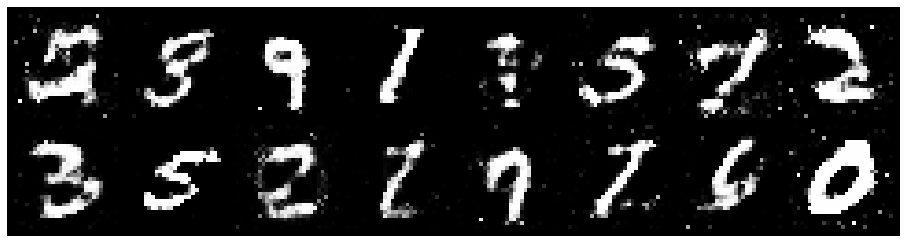

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2003, Generator Loss: 1.0544
D(x): 0.5760, D(G(z)): 0.4153


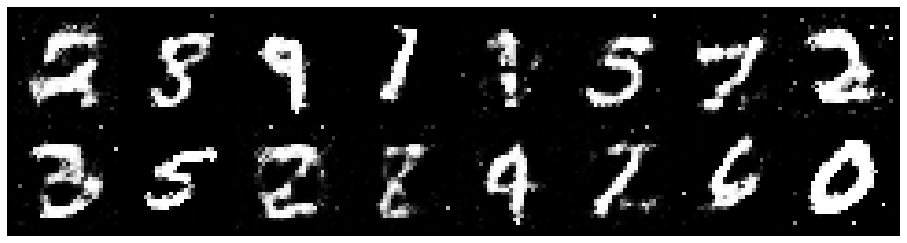

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.2298, Generator Loss: 1.0267
D(x): 0.5846, D(G(z)): 0.4341


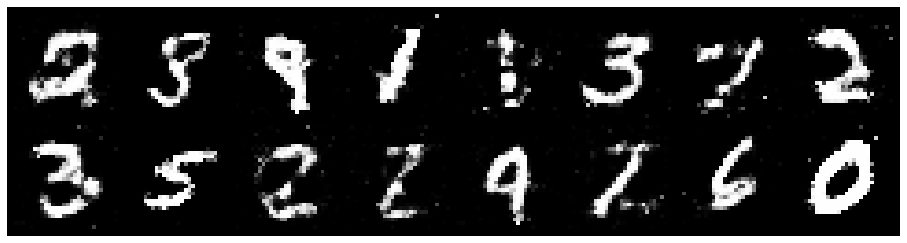

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1511, Generator Loss: 1.0734
D(x): 0.6116, D(G(z)): 0.4170


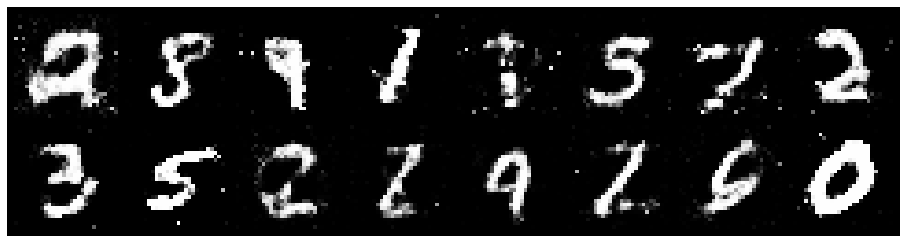

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 0.9858, Generator Loss: 1.1034
D(x): 0.6413, D(G(z)): 0.3512


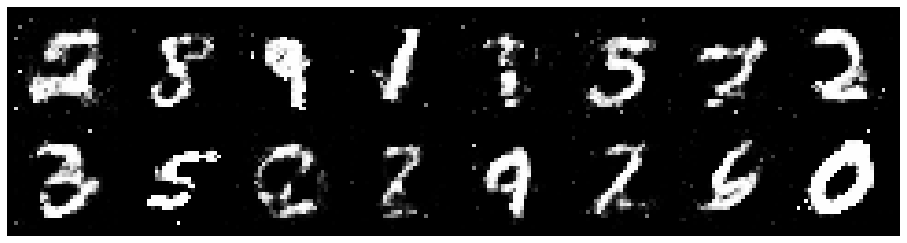

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.1571, Generator Loss: 1.0358
D(x): 0.6013, D(G(z)): 0.4190


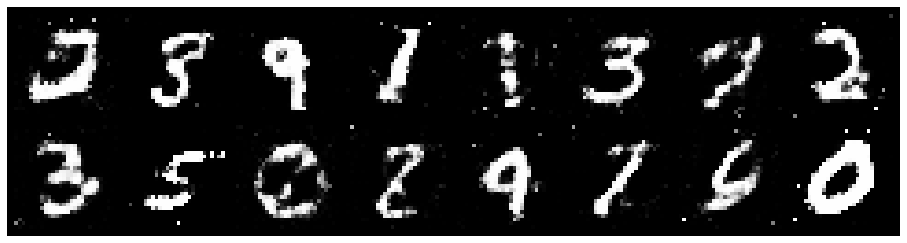

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2412, Generator Loss: 1.0099
D(x): 0.5470, D(G(z)): 0.4112


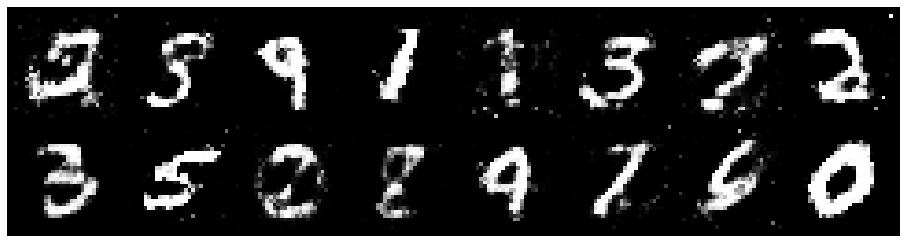

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2963, Generator Loss: 0.9199
D(x): 0.5330, D(G(z)): 0.4270


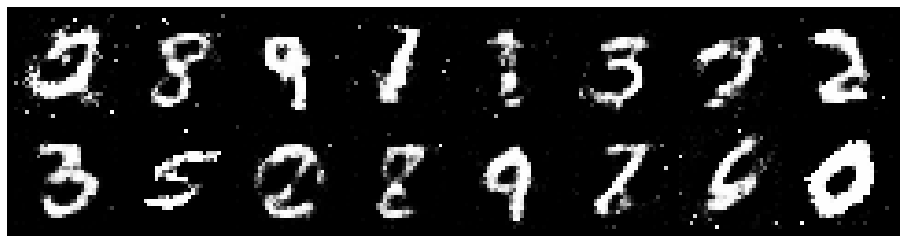

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.3982, Generator Loss: 0.9582
D(x): 0.5727, D(G(z)): 0.4817


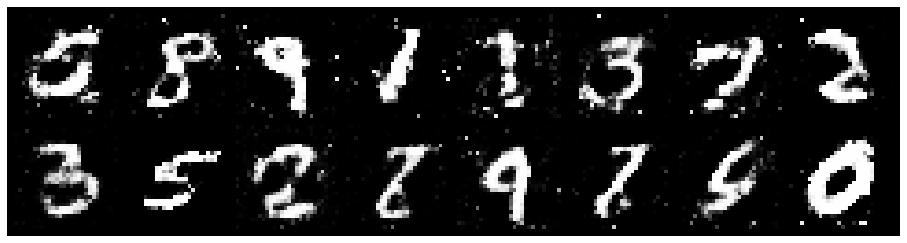

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.3214, Generator Loss: 0.9886
D(x): 0.5944, D(G(z)): 0.4570


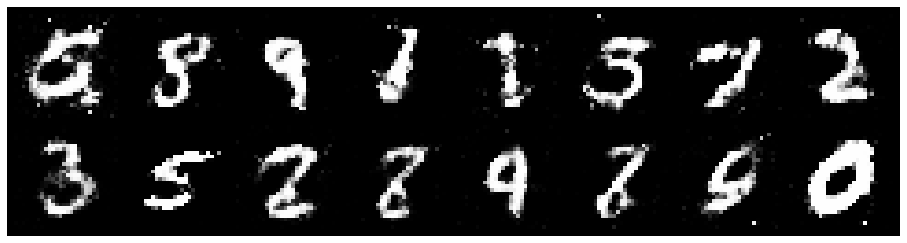

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1344, Generator Loss: 1.0525
D(x): 0.6064, D(G(z)): 0.3931


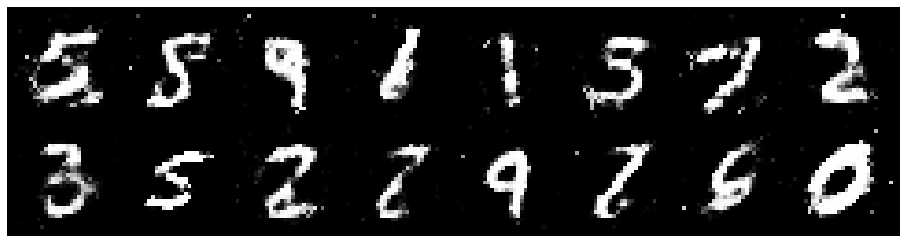

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.2150, Generator Loss: 0.9814
D(x): 0.6290, D(G(z)): 0.4319


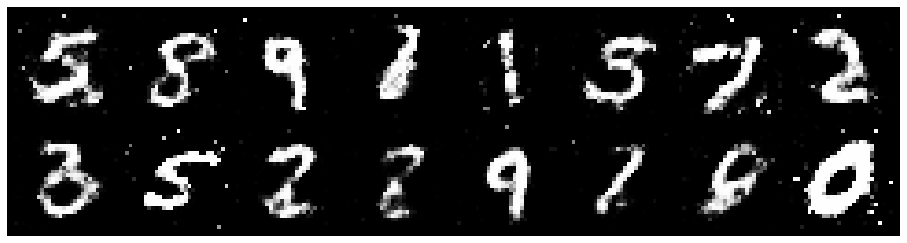

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1317, Generator Loss: 1.2353
D(x): 0.5929, D(G(z)): 0.3863


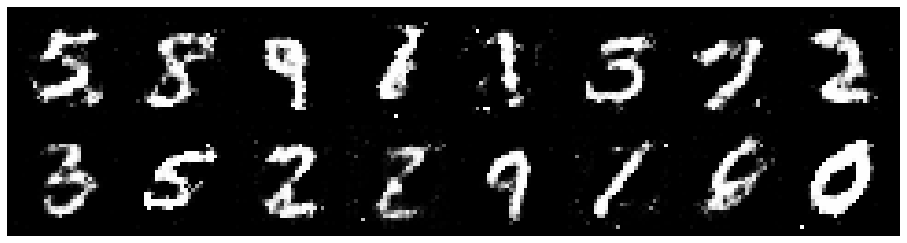

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2762, Generator Loss: 1.0983
D(x): 0.6157, D(G(z)): 0.4567


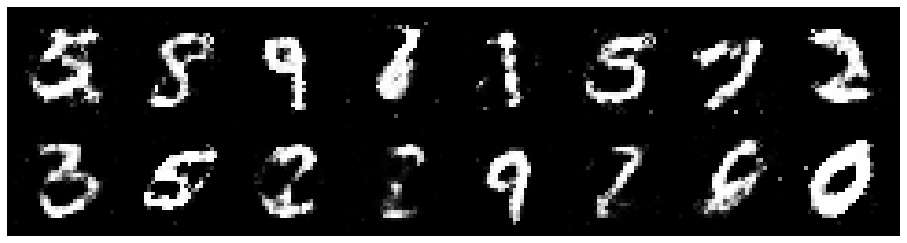

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1955, Generator Loss: 1.1660
D(x): 0.6039, D(G(z)): 0.3831


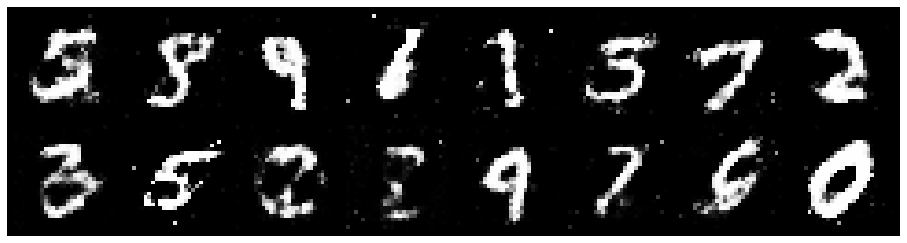

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.1968, Generator Loss: 1.0162
D(x): 0.6023, D(G(z)): 0.4257


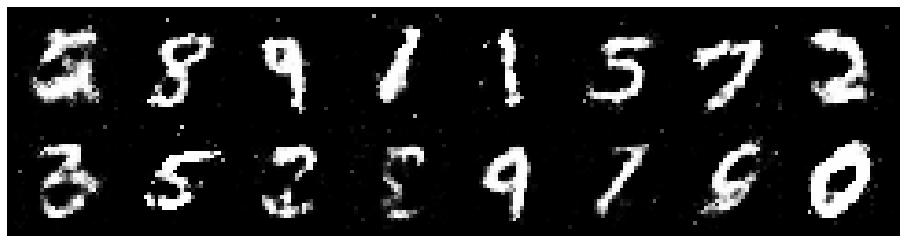

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1828, Generator Loss: 1.0620
D(x): 0.5940, D(G(z)): 0.3813


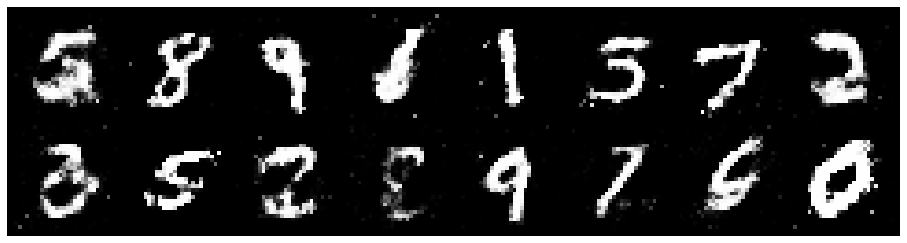

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.3283, Generator Loss: 0.8666
D(x): 0.6148, D(G(z)): 0.4745


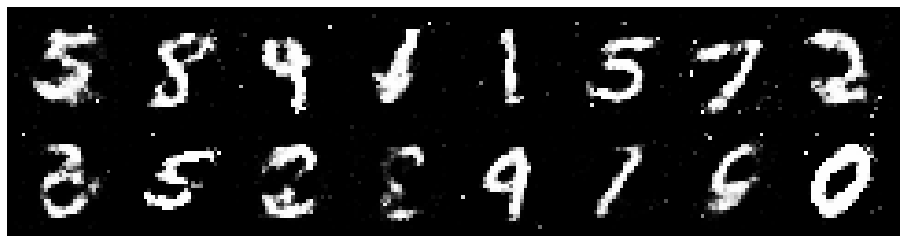

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.3060, Generator Loss: 1.2181
D(x): 0.5663, D(G(z)): 0.4369


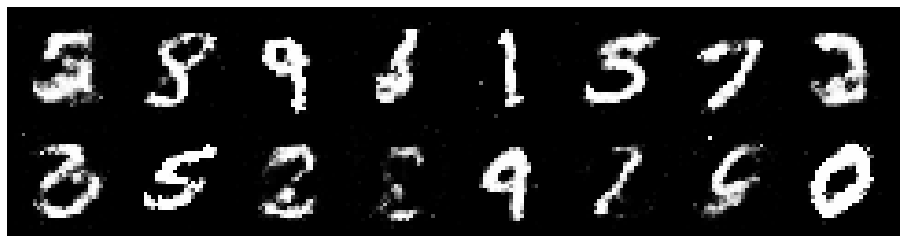

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2982, Generator Loss: 1.0338
D(x): 0.5245, D(G(z)): 0.4141


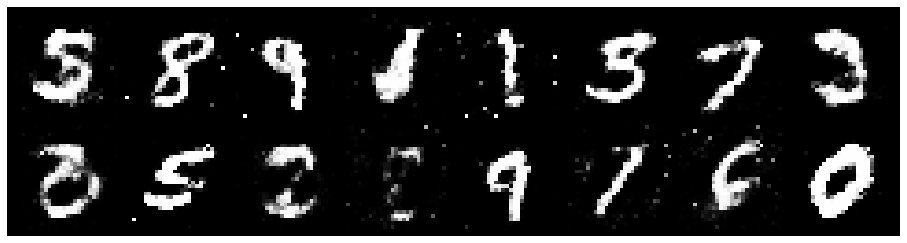

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.3054, Generator Loss: 1.0831
D(x): 0.5159, D(G(z)): 0.4150


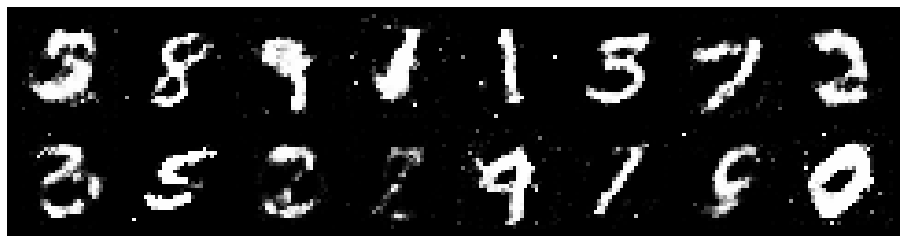

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.2876, Generator Loss: 1.1056
D(x): 0.5353, D(G(z)): 0.4033


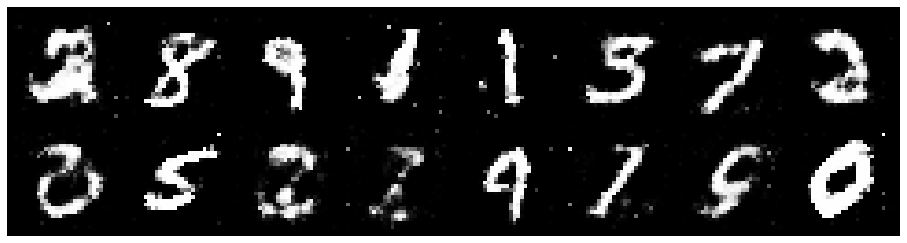

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.3084, Generator Loss: 0.9639
D(x): 0.5378, D(G(z)): 0.4412


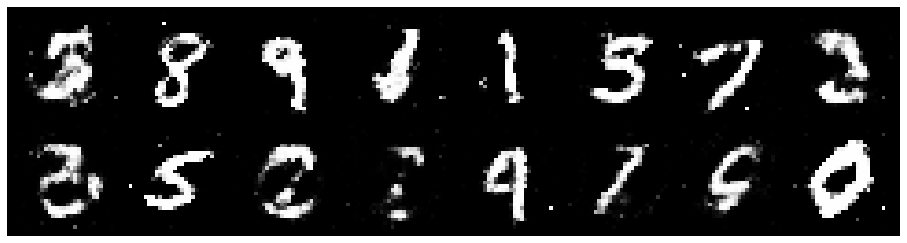

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.3481, Generator Loss: 0.9409
D(x): 0.5538, D(G(z)): 0.4732


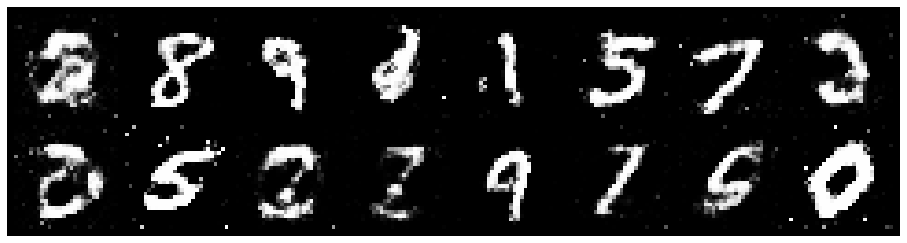

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1699, Generator Loss: 1.0885
D(x): 0.5849, D(G(z)): 0.3960


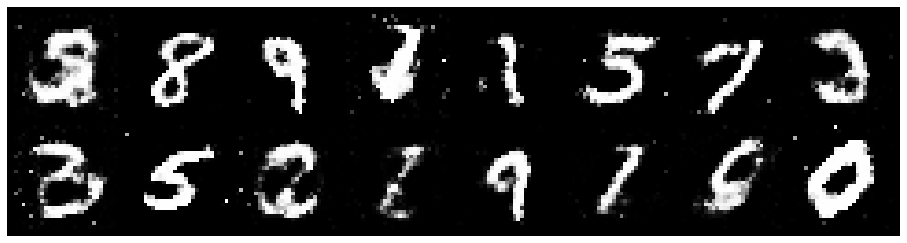

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1325, Generator Loss: 1.0881
D(x): 0.5465, D(G(z)): 0.3371


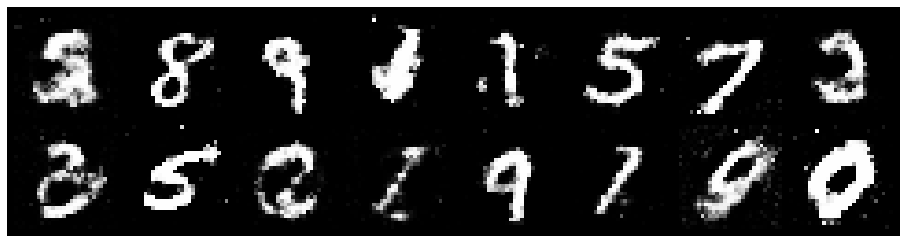

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1305, Generator Loss: 1.0639
D(x): 0.6074, D(G(z)): 0.4083


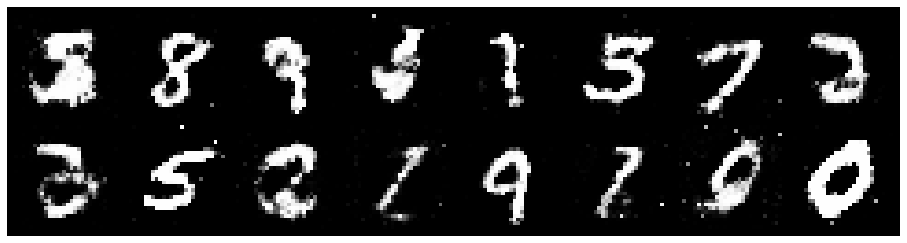

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1752, Generator Loss: 0.9571
D(x): 0.5971, D(G(z)): 0.4298


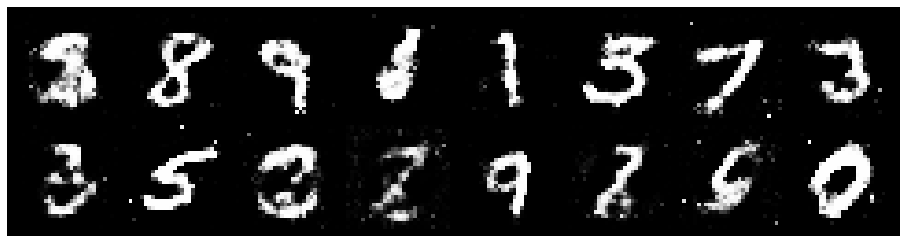

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.2994, Generator Loss: 0.8927
D(x): 0.5671, D(G(z)): 0.4596


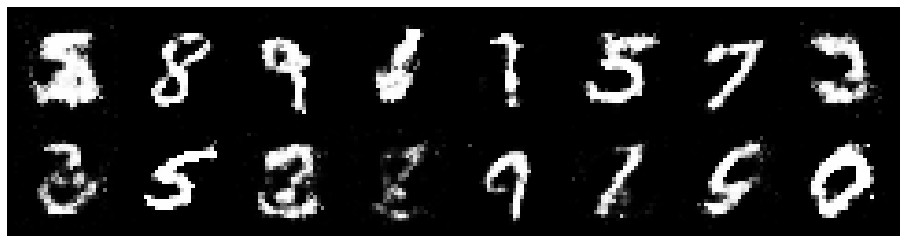

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.3350, Generator Loss: 0.8331
D(x): 0.5552, D(G(z)): 0.4680


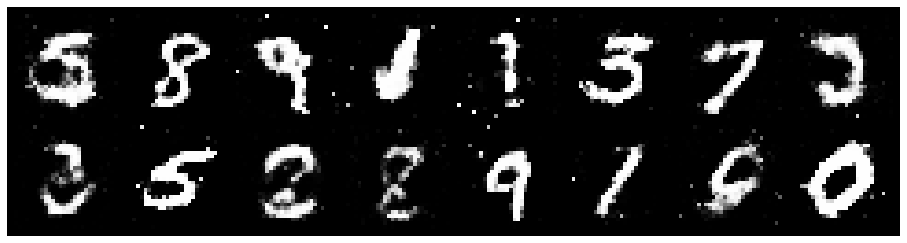

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.3288, Generator Loss: 1.0218
D(x): 0.5906, D(G(z)): 0.4269


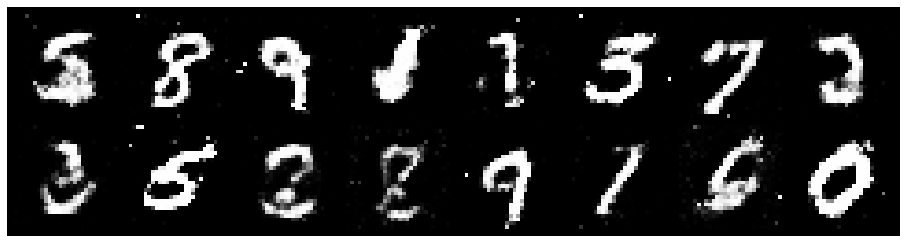

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1889, Generator Loss: 1.1344
D(x): 0.6334, D(G(z)): 0.4286


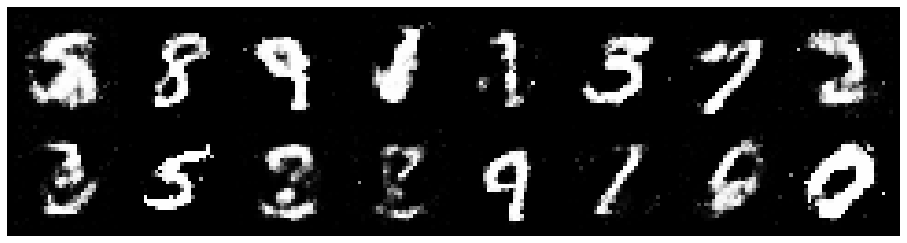

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1821, Generator Loss: 1.1037
D(x): 0.5683, D(G(z)): 0.3687


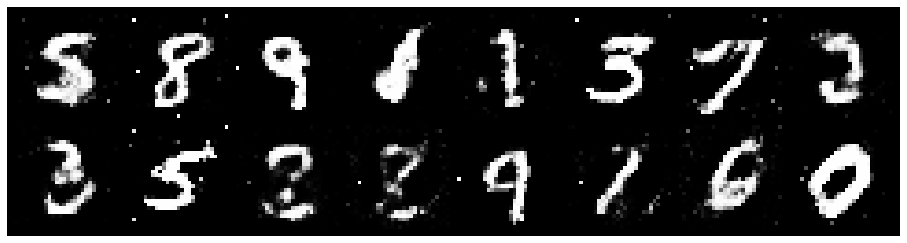

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.2189, Generator Loss: 1.2412
D(x): 0.6083, D(G(z)): 0.4102


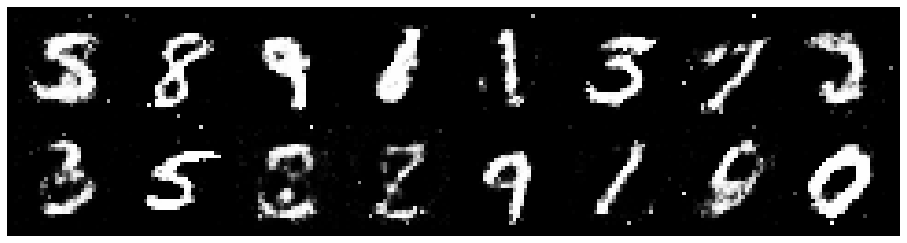

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2000, Generator Loss: 1.1173
D(x): 0.5538, D(G(z)): 0.3654


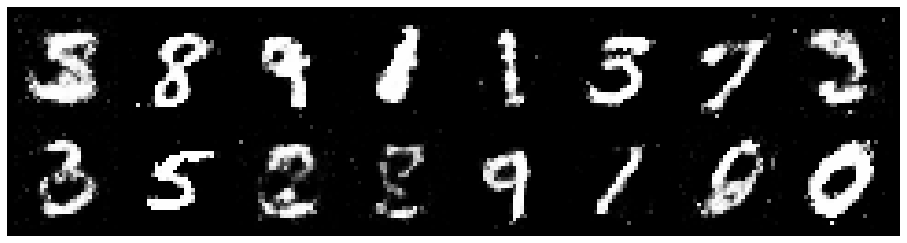

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1956, Generator Loss: 1.0059
D(x): 0.5954, D(G(z)): 0.4075


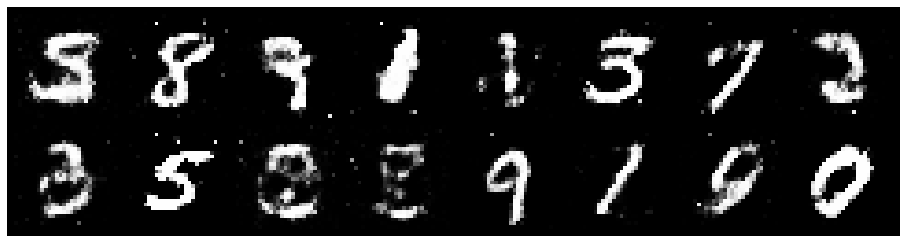

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.1369, Generator Loss: 0.8744
D(x): 0.6226, D(G(z)): 0.4245


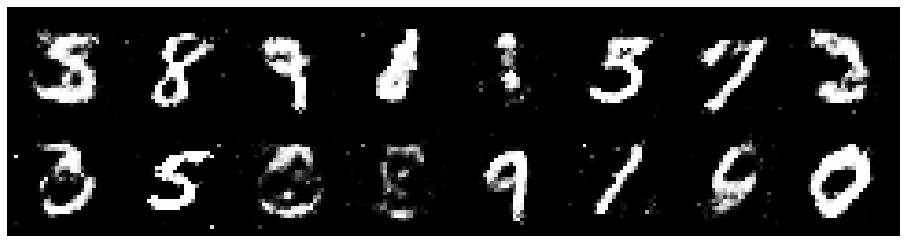

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.1420, Generator Loss: 1.0541
D(x): 0.5739, D(G(z)): 0.3952


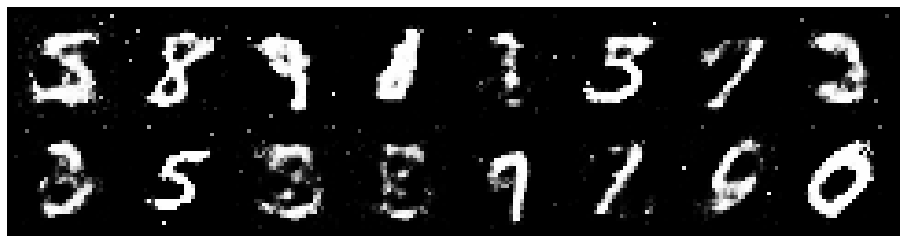

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.1680, Generator Loss: 1.0349
D(x): 0.5642, D(G(z)): 0.3851


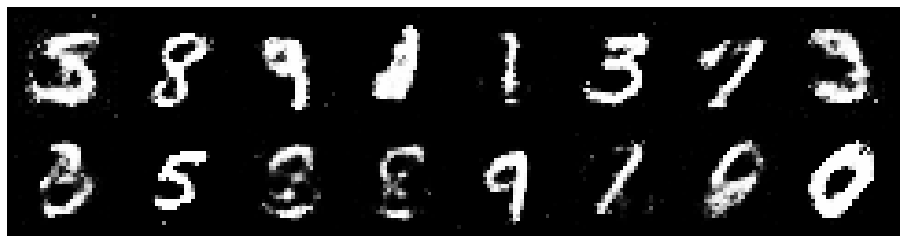

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.1184, Generator Loss: 0.9945
D(x): 0.6103, D(G(z)): 0.3969


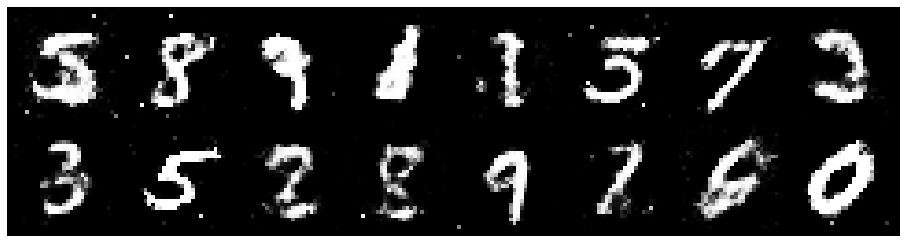

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2195, Generator Loss: 1.1570
D(x): 0.5342, D(G(z)): 0.3709


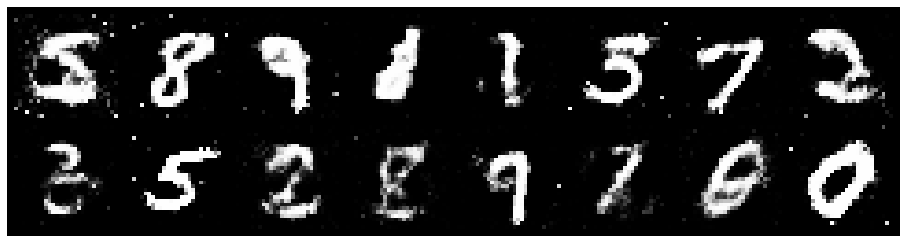

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.2462, Generator Loss: 1.0406
D(x): 0.5782, D(G(z)): 0.4159


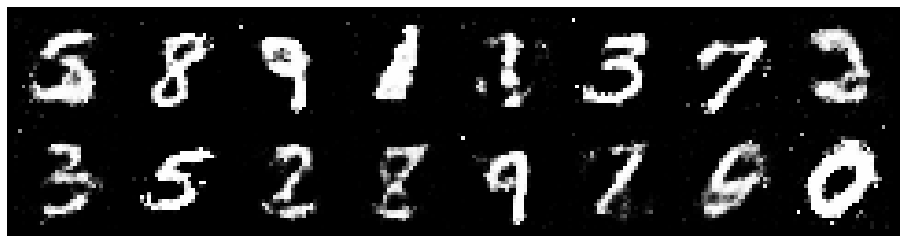

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2075, Generator Loss: 0.9266
D(x): 0.6277, D(G(z)): 0.4506


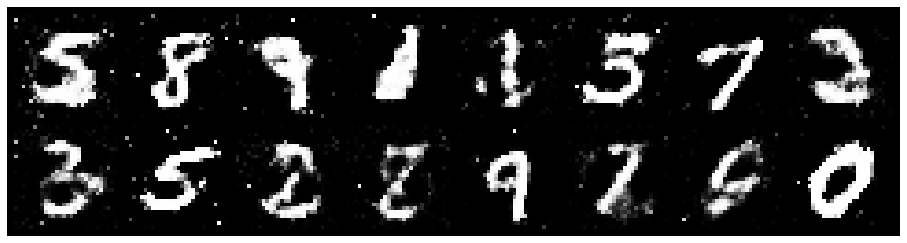

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.2701, Generator Loss: 0.8298
D(x): 0.6152, D(G(z)): 0.4768


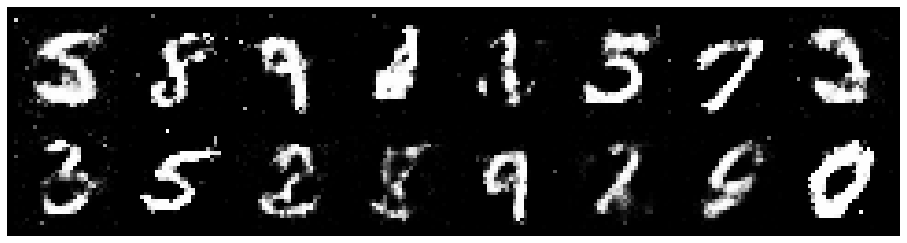

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1904, Generator Loss: 0.9919
D(x): 0.5916, D(G(z)): 0.4232


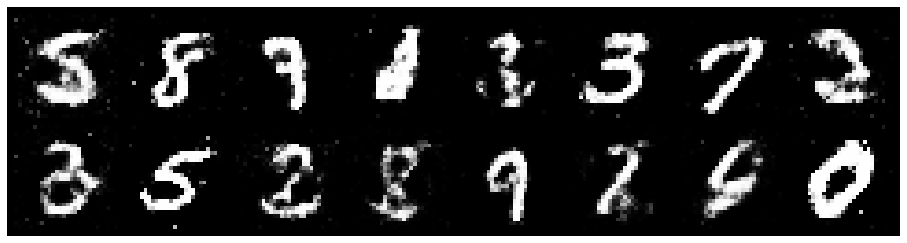

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2546, Generator Loss: 0.8518
D(x): 0.5411, D(G(z)): 0.4332


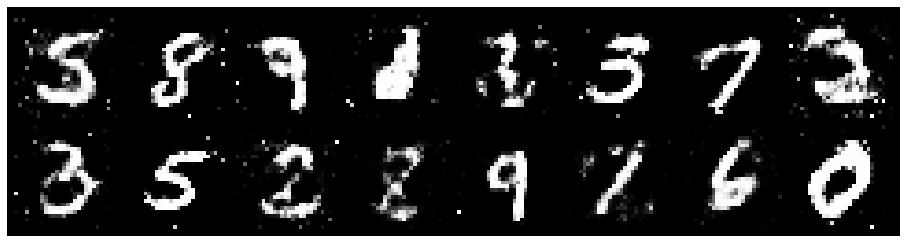

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.1359, Generator Loss: 1.0303
D(x): 0.5944, D(G(z)): 0.3984


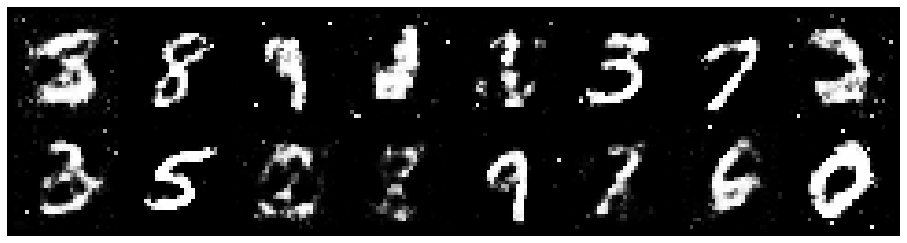

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.3452, Generator Loss: 0.8452
D(x): 0.5575, D(G(z)): 0.4356


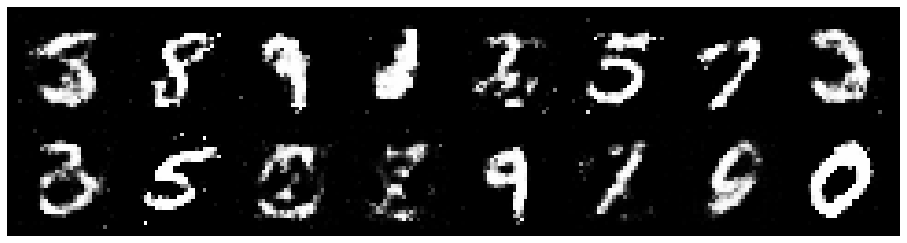

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.2833, Generator Loss: 0.9802
D(x): 0.5319, D(G(z)): 0.4220


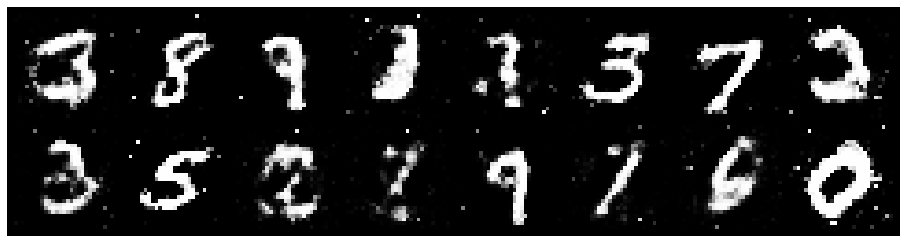

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.3811, Generator Loss: 0.8951
D(x): 0.5927, D(G(z)): 0.5064


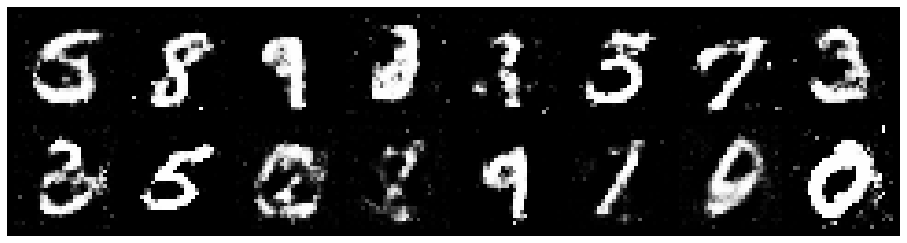

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2028, Generator Loss: 1.0559
D(x): 0.5534, D(G(z)): 0.3738


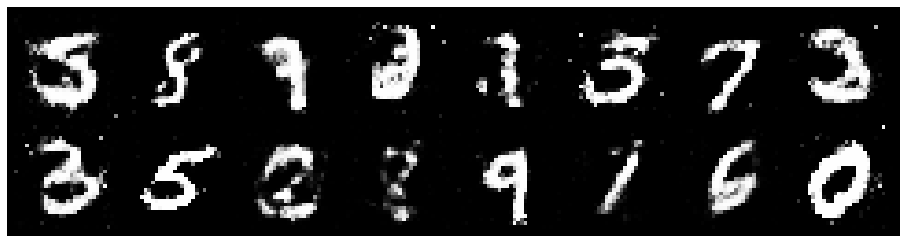

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1699, Generator Loss: 0.9177
D(x): 0.6183, D(G(z)): 0.4461


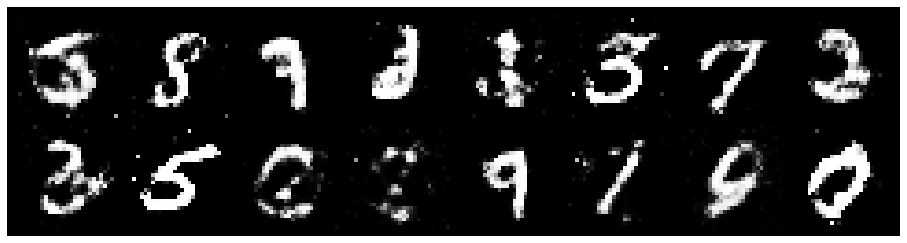

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.1997, Generator Loss: 1.0432
D(x): 0.6217, D(G(z)): 0.4357


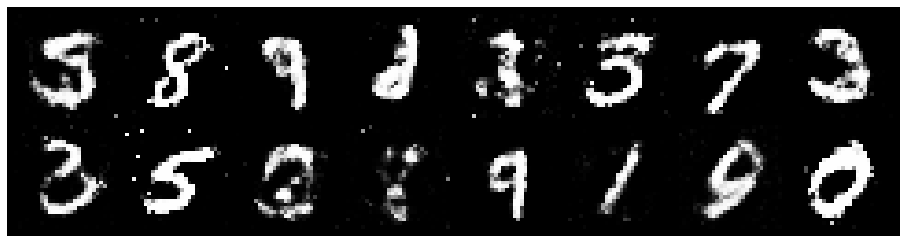

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.1949, Generator Loss: 0.9612
D(x): 0.6106, D(G(z)): 0.4375


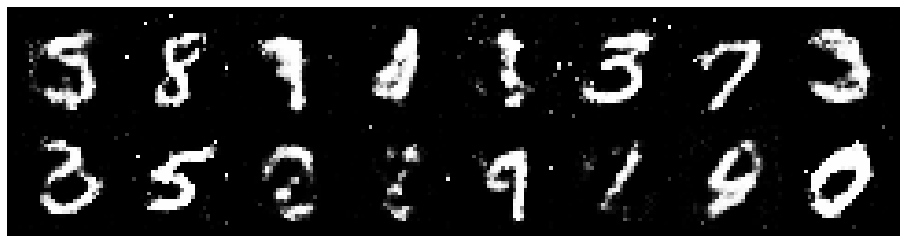

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2070, Generator Loss: 0.9930
D(x): 0.5561, D(G(z)): 0.3871


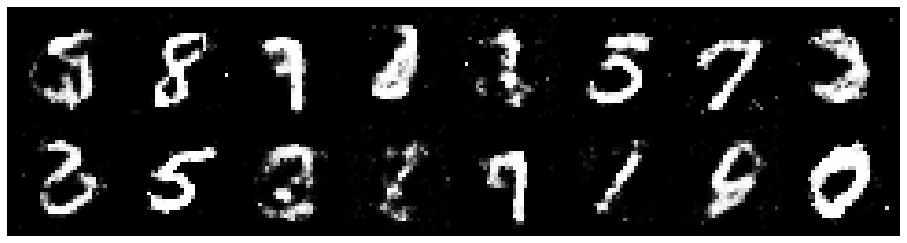

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.1521, Generator Loss: 1.0407
D(x): 0.5654, D(G(z)): 0.3663


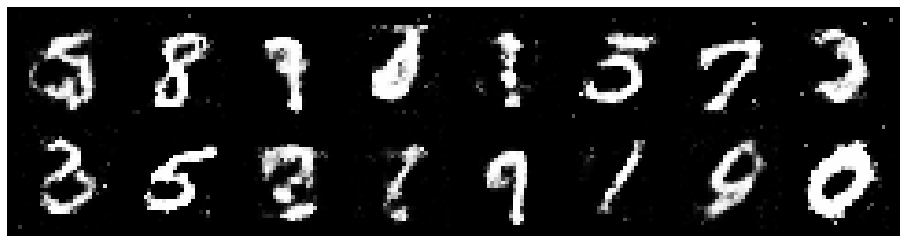

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2832, Generator Loss: 0.9295
D(x): 0.5777, D(G(z)): 0.4460


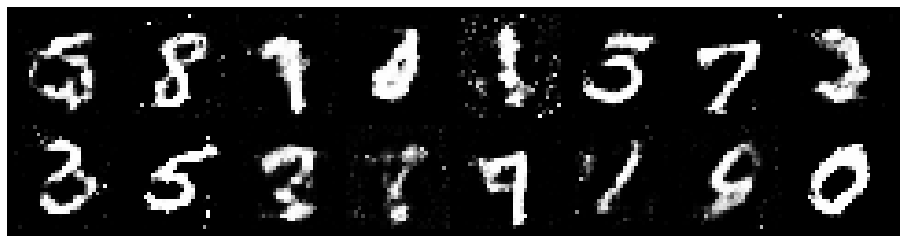

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2973, Generator Loss: 0.9188
D(x): 0.5726, D(G(z)): 0.4464


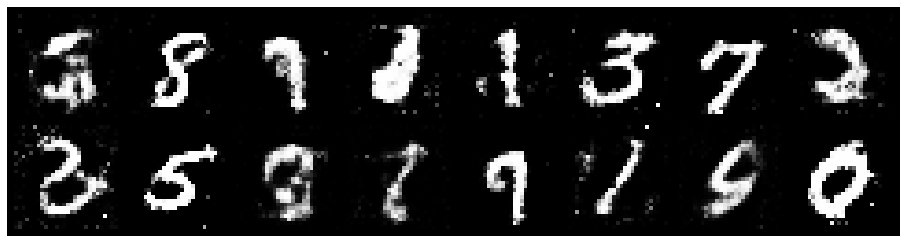

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2837, Generator Loss: 0.9906
D(x): 0.6207, D(G(z)): 0.4561


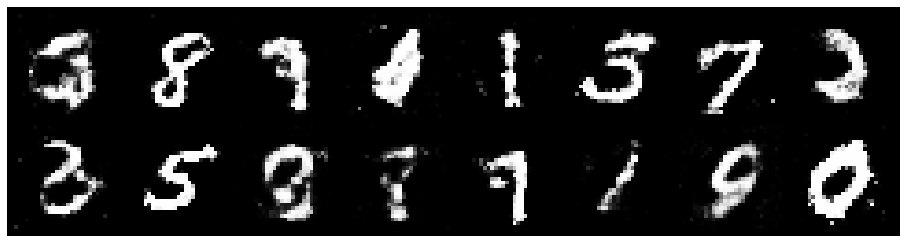

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2659, Generator Loss: 1.0522
D(x): 0.6154, D(G(z)): 0.4499


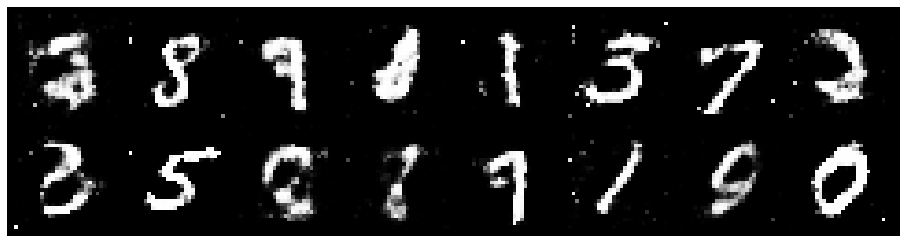

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2925, Generator Loss: 1.0023
D(x): 0.6001, D(G(z)): 0.4473


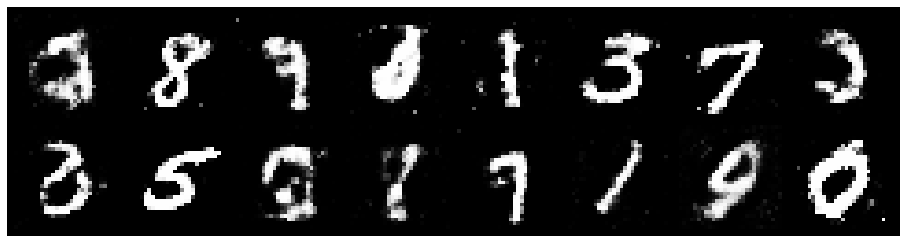

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.0986, Generator Loss: 1.0804
D(x): 0.6125, D(G(z)): 0.3929


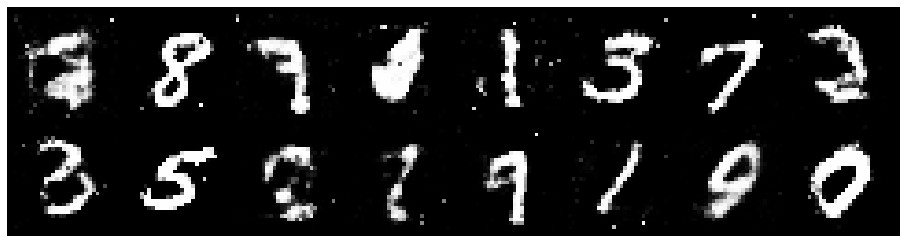

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.1011, Generator Loss: 1.2943
D(x): 0.6135, D(G(z)): 0.3849


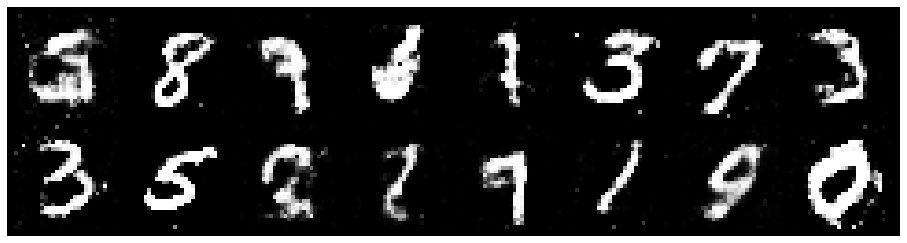

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.1116, Generator Loss: 0.9790
D(x): 0.6282, D(G(z)): 0.3941


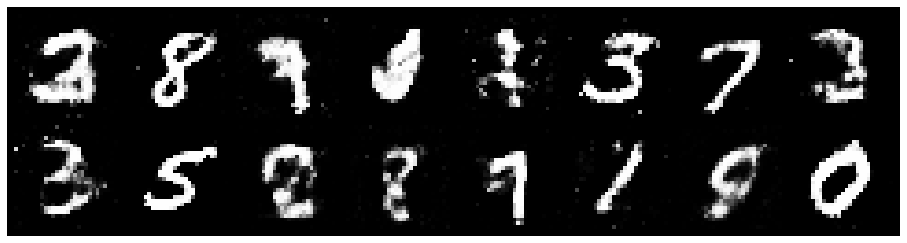

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2089, Generator Loss: 0.9465
D(x): 0.6326, D(G(z)): 0.4502


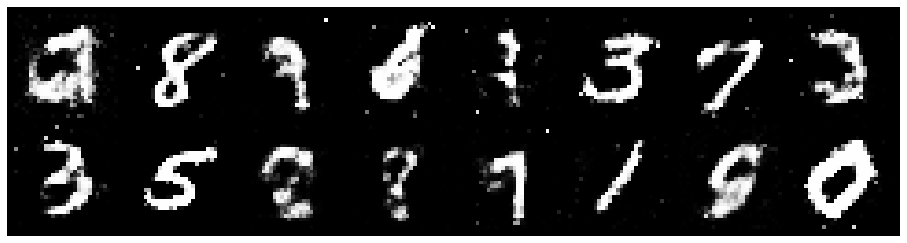

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.3238, Generator Loss: 0.8485
D(x): 0.5914, D(G(z)): 0.4778


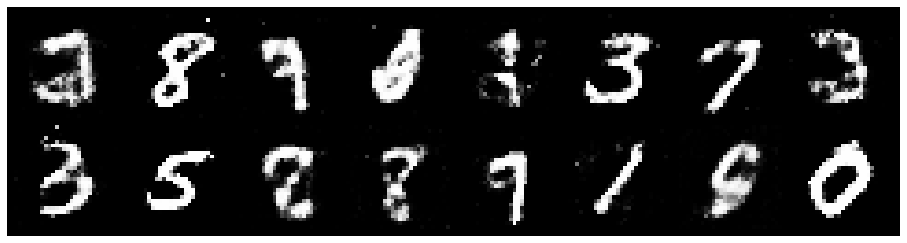

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1843, Generator Loss: 0.9253
D(x): 0.6058, D(G(z)): 0.4493


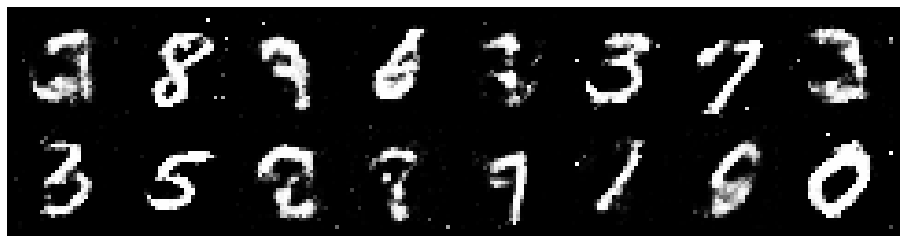

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2039, Generator Loss: 1.1919
D(x): 0.5755, D(G(z)): 0.4194


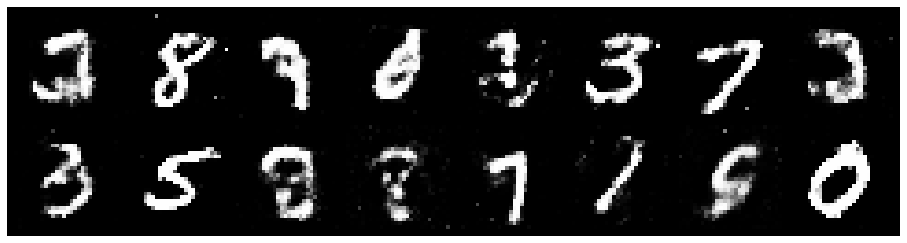

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.2631, Generator Loss: 1.0039
D(x): 0.6011, D(G(z)): 0.4685


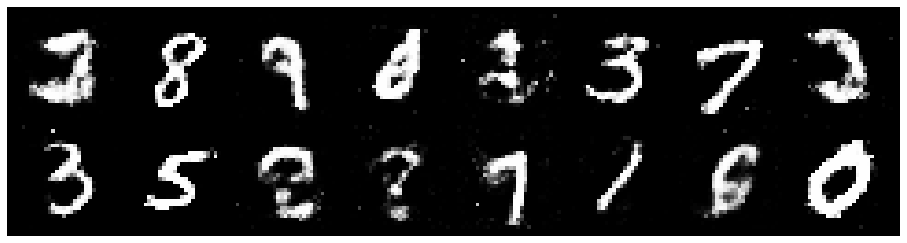

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1386, Generator Loss: 0.9913
D(x): 0.6336, D(G(z)): 0.4292


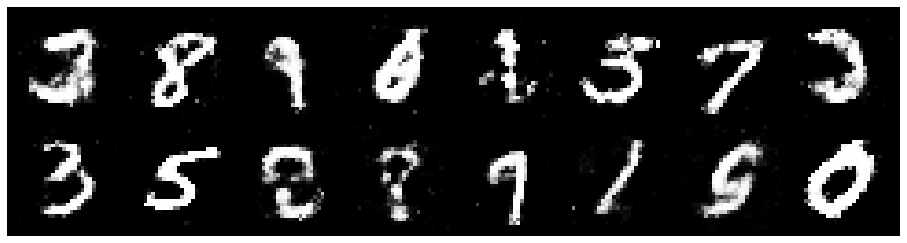

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.1855, Generator Loss: 0.9765
D(x): 0.6242, D(G(z)): 0.4240


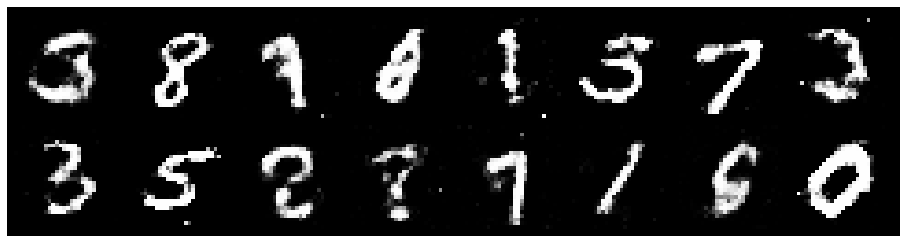

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.0499, Generator Loss: 0.9954
D(x): 0.6662, D(G(z)): 0.4267


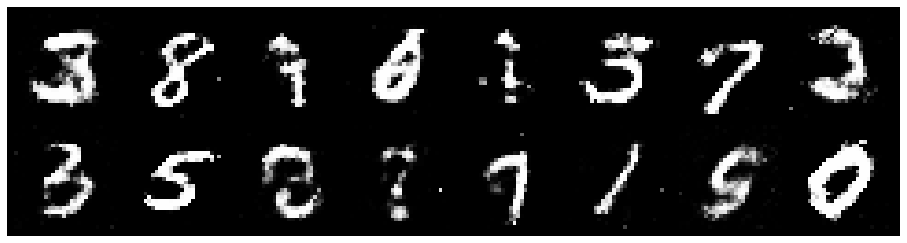

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.1810, Generator Loss: 1.0016
D(x): 0.6046, D(G(z)): 0.4207


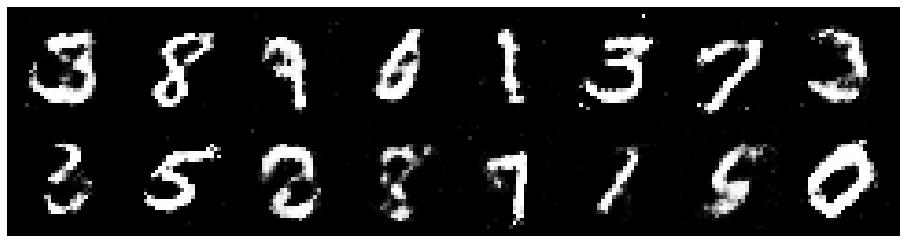

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1477, Generator Loss: 0.9607
D(x): 0.5822, D(G(z)): 0.4080


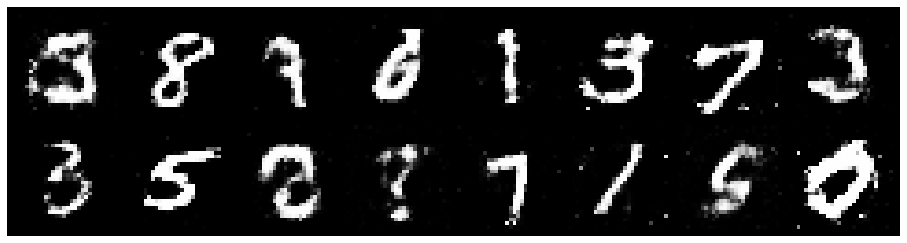

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2498, Generator Loss: 0.9362
D(x): 0.5867, D(G(z)): 0.4391


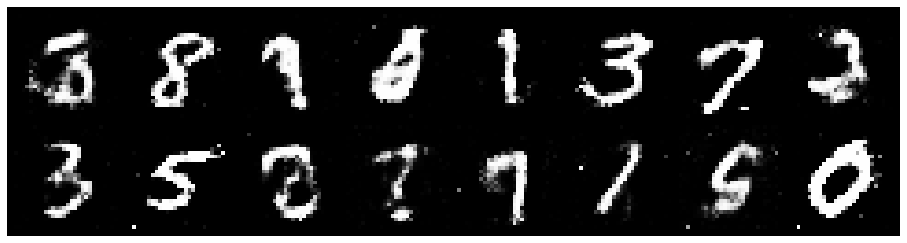

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2079, Generator Loss: 0.8319
D(x): 0.6430, D(G(z)): 0.4621


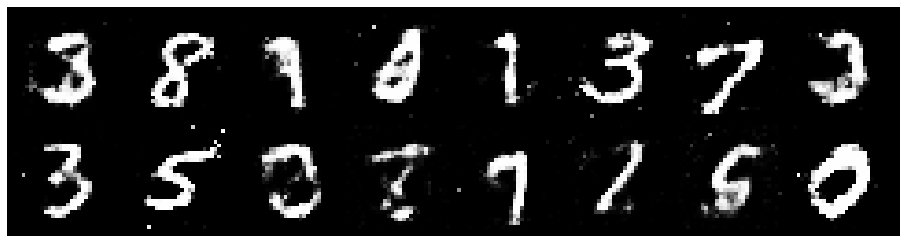

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1095, Generator Loss: 1.0987
D(x): 0.6059, D(G(z)): 0.3780


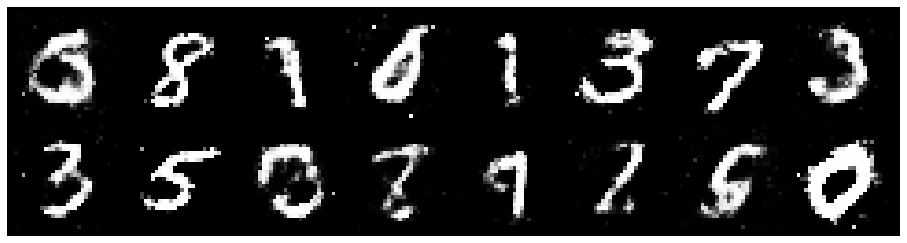

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.4184, Generator Loss: 1.0212
D(x): 0.5380, D(G(z)): 0.4382


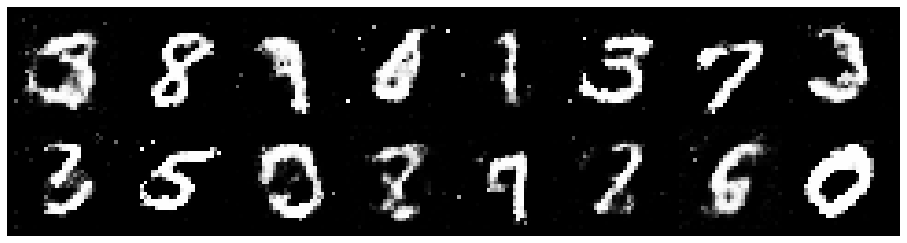

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2452, Generator Loss: 1.2149
D(x): 0.5712, D(G(z)): 0.3955


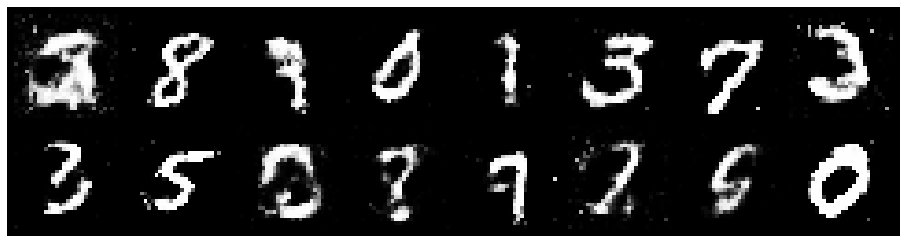

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.3245, Generator Loss: 1.0106
D(x): 0.5487, D(G(z)): 0.4322


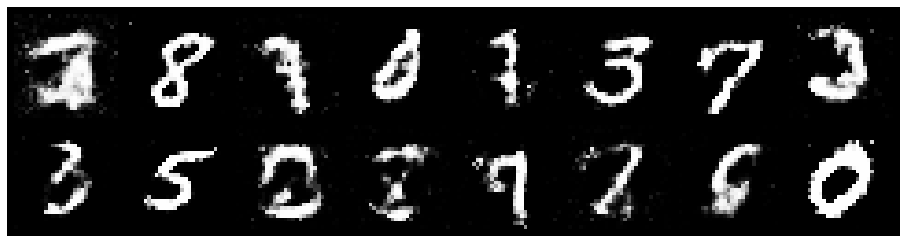

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.2337, Generator Loss: 0.8648
D(x): 0.5796, D(G(z)): 0.4273


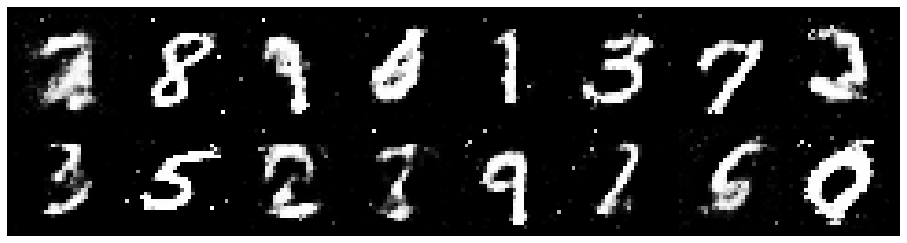

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.4337, Generator Loss: 0.9666
D(x): 0.5490, D(G(z)): 0.4460


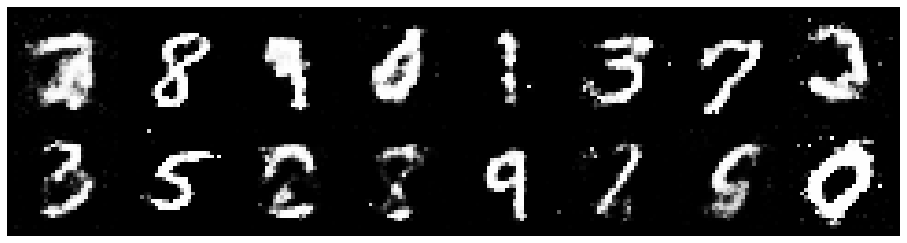

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.3199, Generator Loss: 0.8891
D(x): 0.5838, D(G(z)): 0.4559


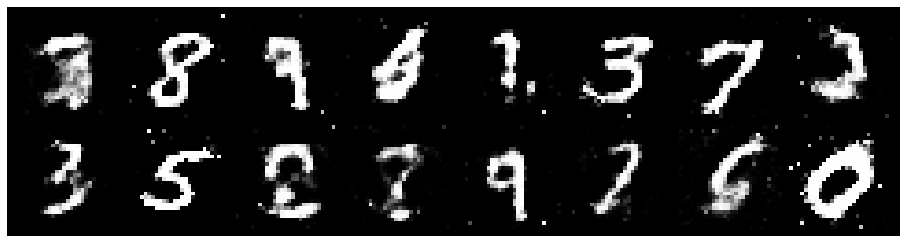

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.3296, Generator Loss: 0.9742
D(x): 0.5947, D(G(z)): 0.4531


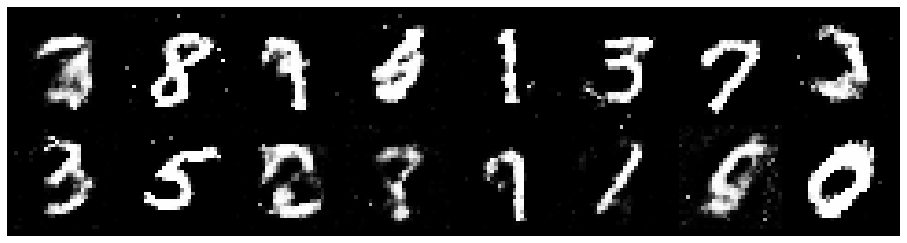

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1559, Generator Loss: 1.0013
D(x): 0.5957, D(G(z)): 0.4221


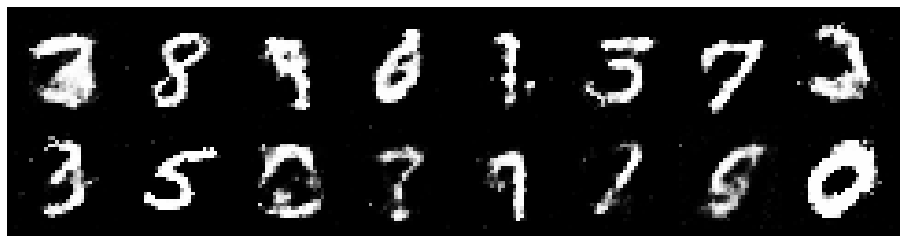

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1018, Generator Loss: 0.9985
D(x): 0.6252, D(G(z)): 0.4066


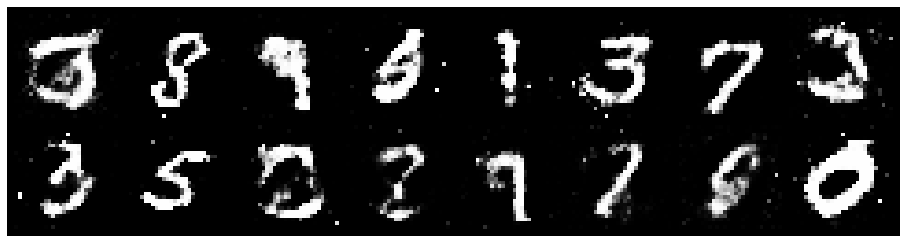

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.2216, Generator Loss: 0.9270
D(x): 0.6152, D(G(z)): 0.4457


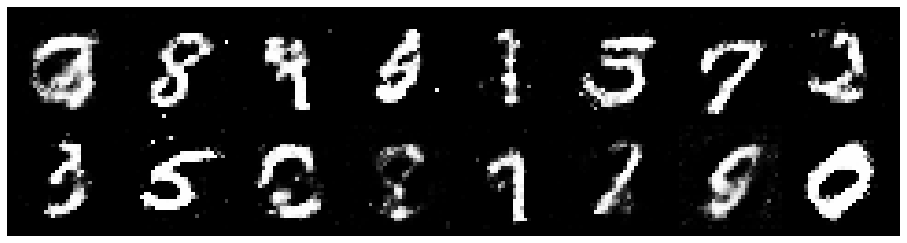

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.3093, Generator Loss: 0.8318
D(x): 0.5193, D(G(z)): 0.4473


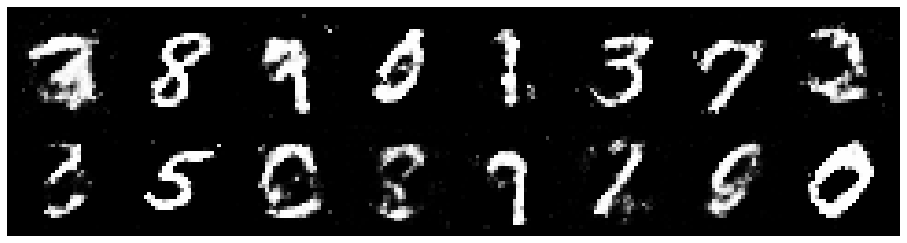

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.3302, Generator Loss: 0.8689
D(x): 0.5333, D(G(z)): 0.4615


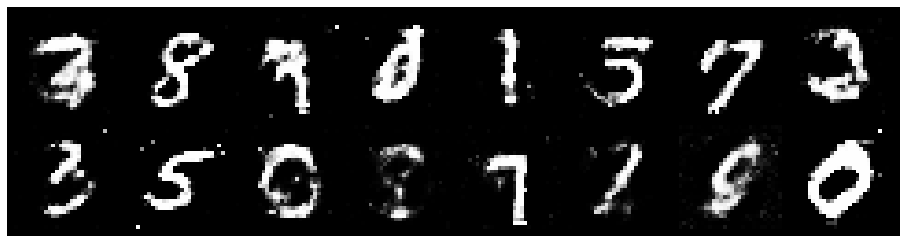

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1926, Generator Loss: 0.9704
D(x): 0.6035, D(G(z)): 0.4272


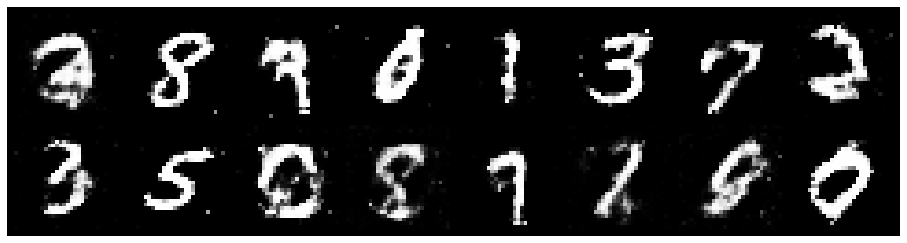

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1803, Generator Loss: 1.0196
D(x): 0.6096, D(G(z)): 0.4224


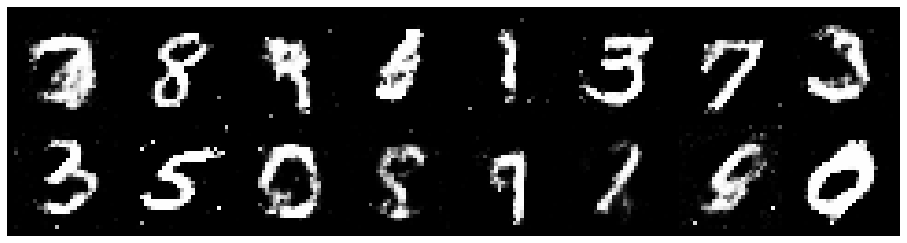

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.0628, Generator Loss: 1.0628
D(x): 0.6235, D(G(z)): 0.4027


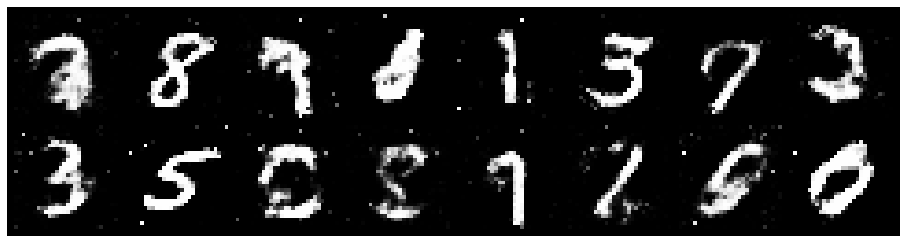

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.1357, Generator Loss: 0.9749
D(x): 0.6367, D(G(z)): 0.4226


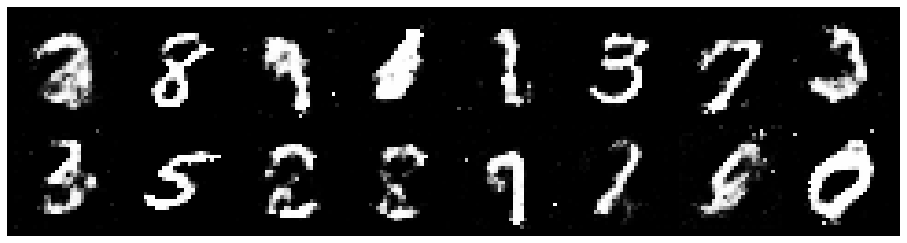

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.1751, Generator Loss: 0.9425
D(x): 0.5571, D(G(z)): 0.4075


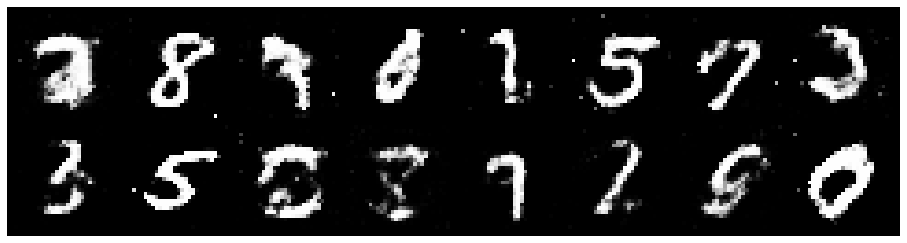

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1195, Generator Loss: 1.0710
D(x): 0.6204, D(G(z)): 0.4196


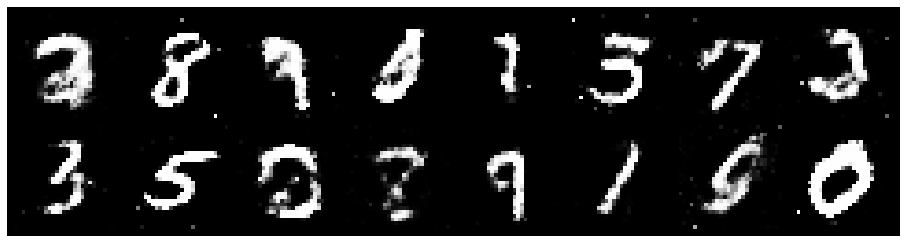

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1138, Generator Loss: 1.1040
D(x): 0.5806, D(G(z)): 0.3465


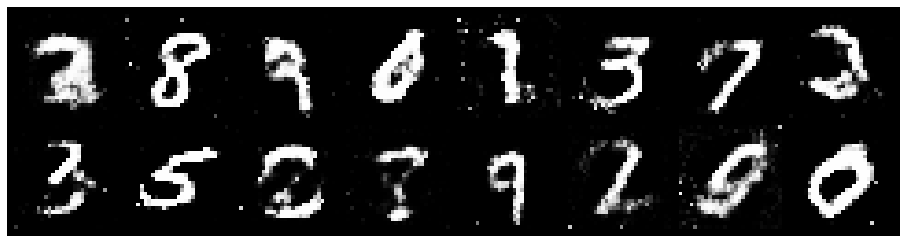

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2032, Generator Loss: 0.8399
D(x): 0.6012, D(G(z)): 0.4506


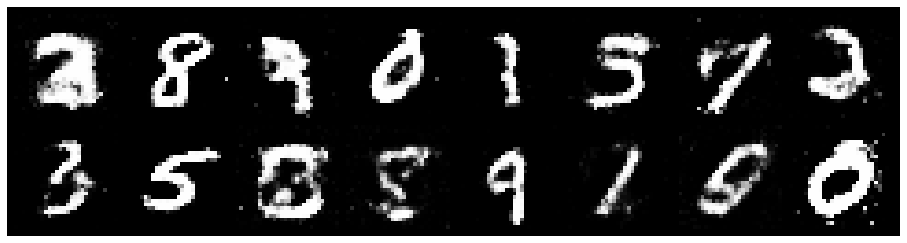

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.1373, Generator Loss: 1.0499
D(x): 0.5926, D(G(z)): 0.3875


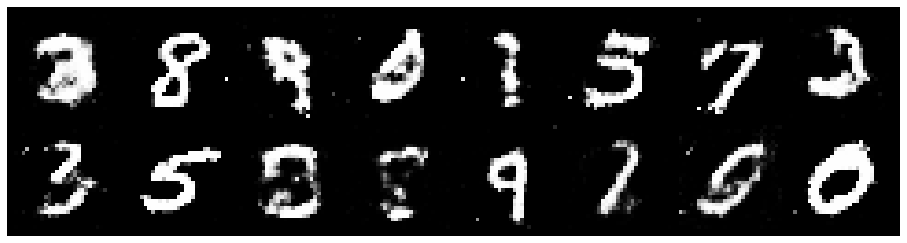

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2620, Generator Loss: 0.8822
D(x): 0.5960, D(G(z)): 0.4445


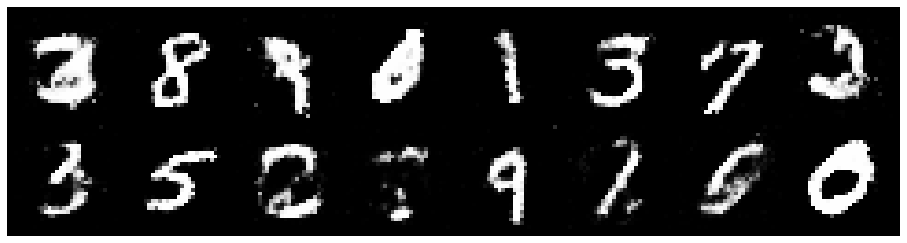

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.4584, Generator Loss: 0.9807
D(x): 0.5257, D(G(z)): 0.4455


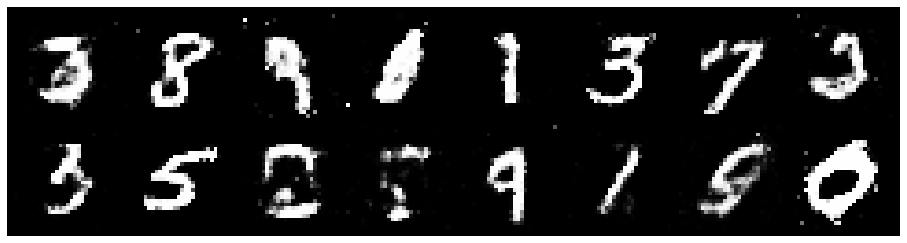

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.0092, Generator Loss: 1.1664
D(x): 0.6673, D(G(z)): 0.3870


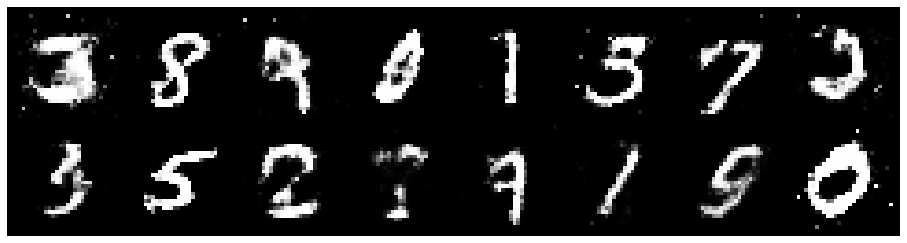

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1639, Generator Loss: 1.2067
D(x): 0.5364, D(G(z)): 0.3226


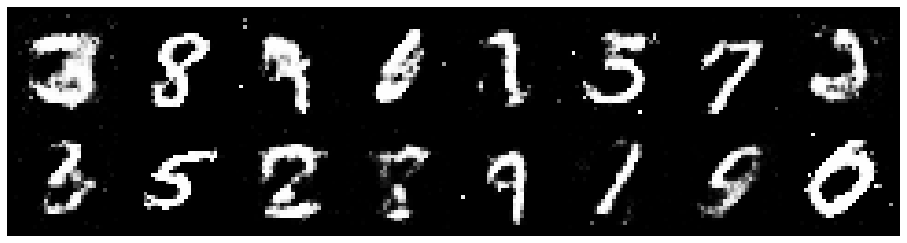

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.1467, Generator Loss: 1.1323
D(x): 0.5854, D(G(z)): 0.3788


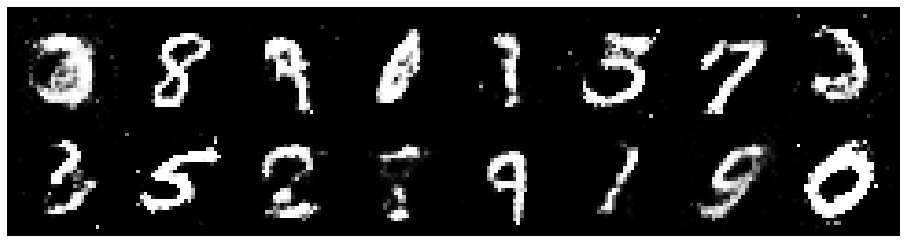

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.3292, Generator Loss: 0.9686
D(x): 0.5528, D(G(z)): 0.4542


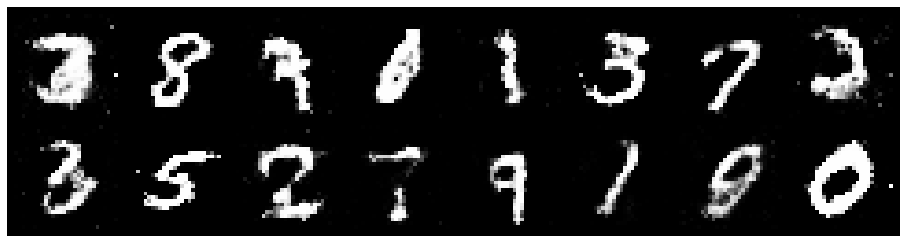

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.1786, Generator Loss: 0.9976
D(x): 0.6112, D(G(z)): 0.4450


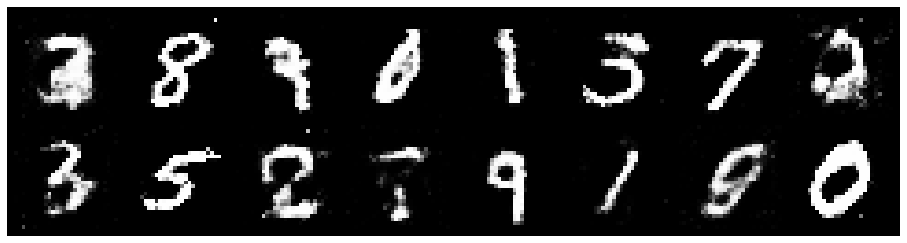

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2553, Generator Loss: 1.1280
D(x): 0.5846, D(G(z)): 0.4120


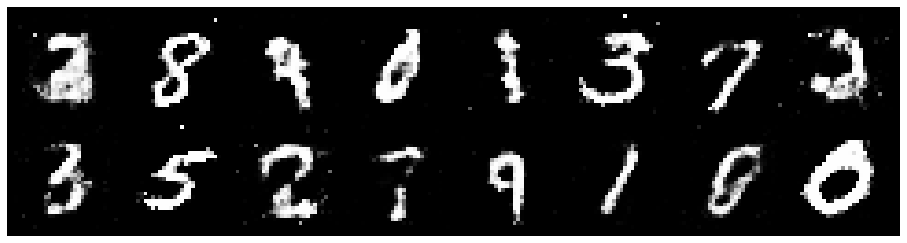

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.3234, Generator Loss: 0.9567
D(x): 0.5672, D(G(z)): 0.4530


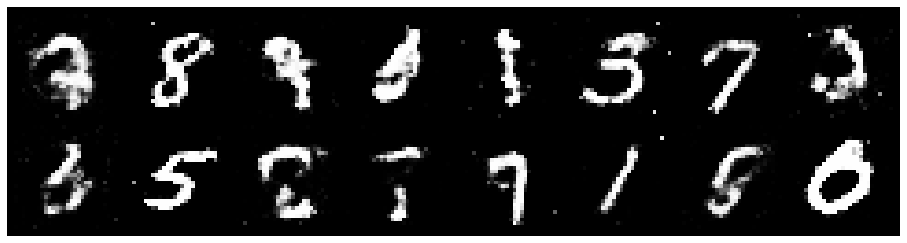

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1363, Generator Loss: 0.9519
D(x): 0.6354, D(G(z)): 0.4342


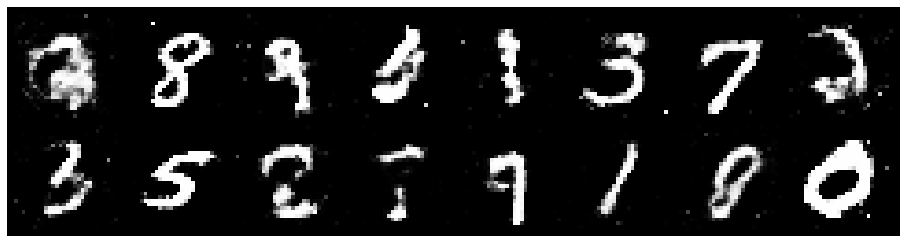

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.3822, Generator Loss: 1.0994
D(x): 0.5426, D(G(z)): 0.4395


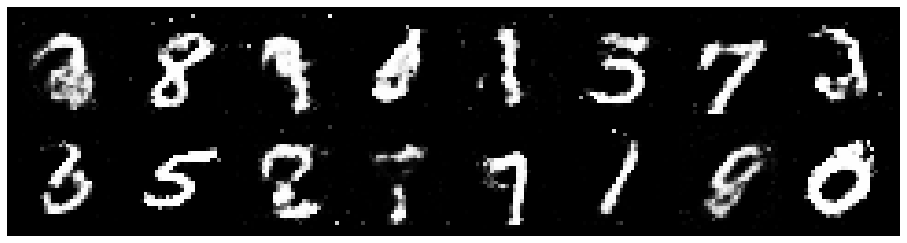

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2790, Generator Loss: 0.9366
D(x): 0.5816, D(G(z)): 0.4316


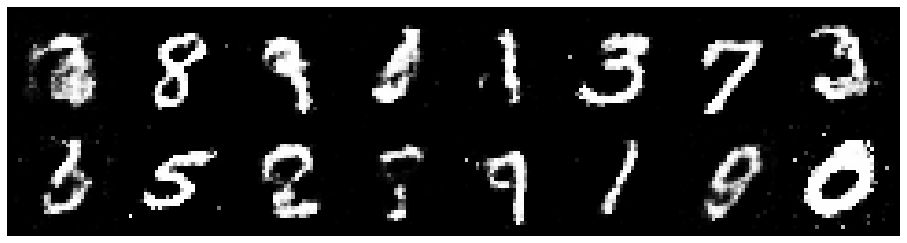

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.3551, Generator Loss: 0.9725
D(x): 0.5217, D(G(z)): 0.4223


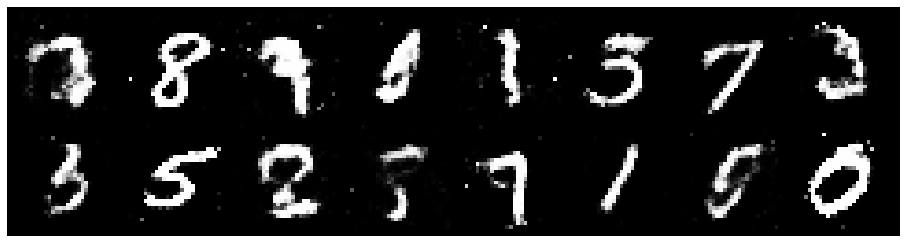

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.3432, Generator Loss: 0.8854
D(x): 0.5679, D(G(z)): 0.4687


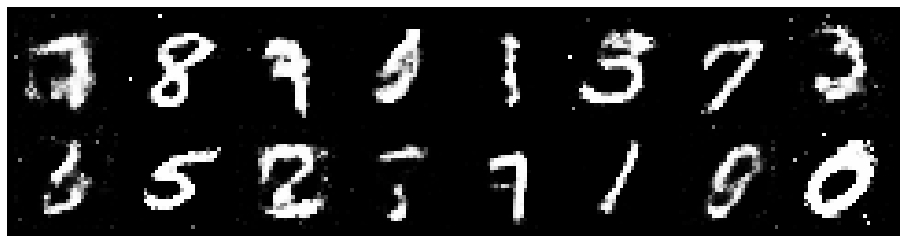

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.3398, Generator Loss: 0.9575
D(x): 0.5890, D(G(z)): 0.4498


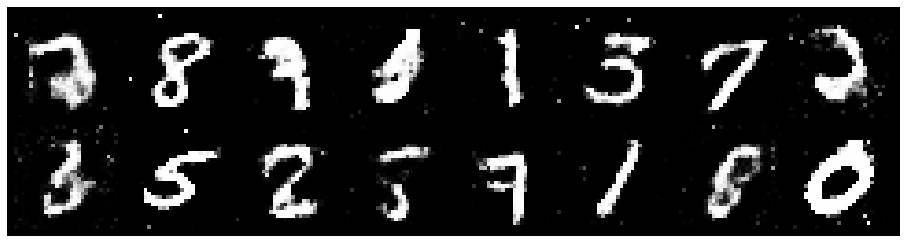

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2153, Generator Loss: 0.9527
D(x): 0.5896, D(G(z)): 0.4157


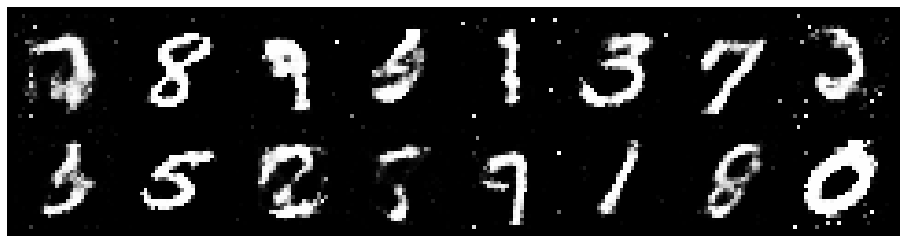

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2523, Generator Loss: 0.8639
D(x): 0.6100, D(G(z)): 0.4756


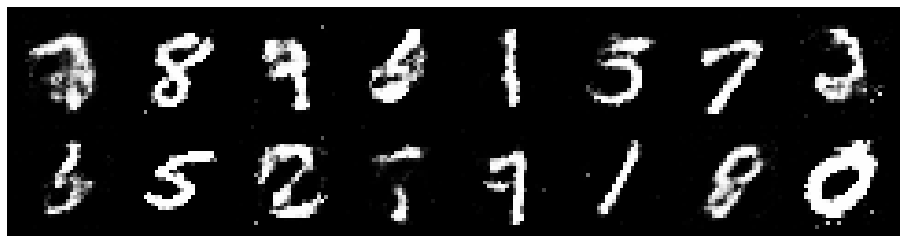

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2245, Generator Loss: 0.8351
D(x): 0.6252, D(G(z)): 0.4695


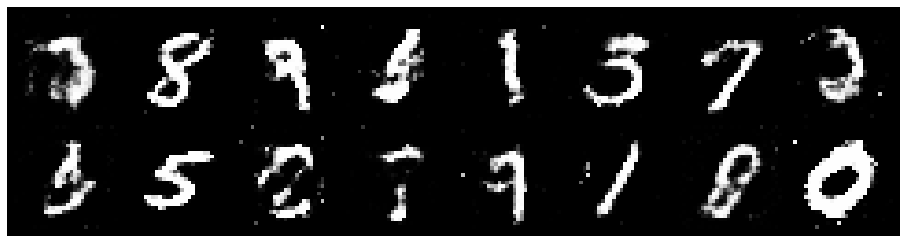

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.3738, Generator Loss: 0.9930
D(x): 0.5615, D(G(z)): 0.4699


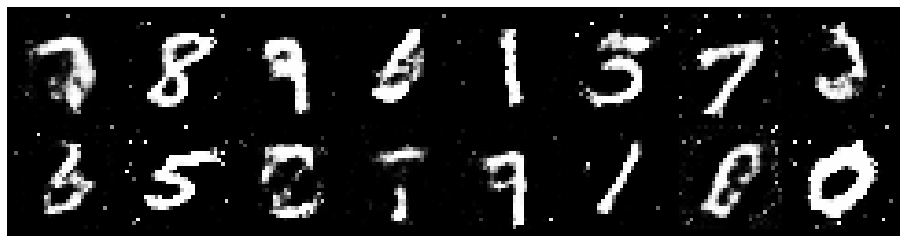

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2872, Generator Loss: 1.0169
D(x): 0.5468, D(G(z)): 0.4301


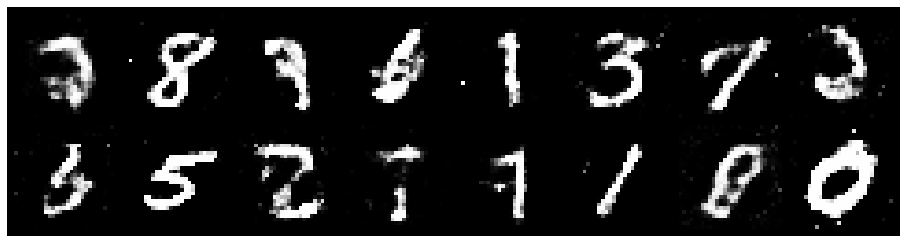

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.0649, Generator Loss: 1.0549
D(x): 0.6141, D(G(z)): 0.3643


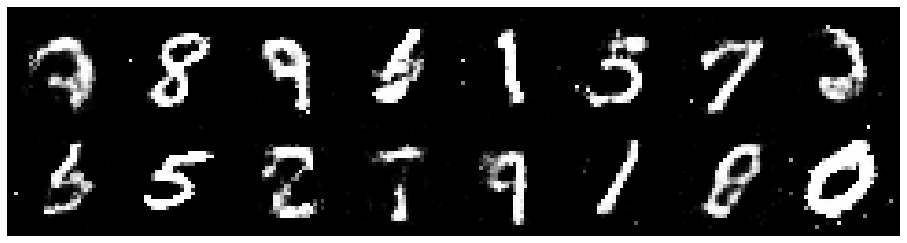

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2278, Generator Loss: 1.1099
D(x): 0.5850, D(G(z)): 0.4162


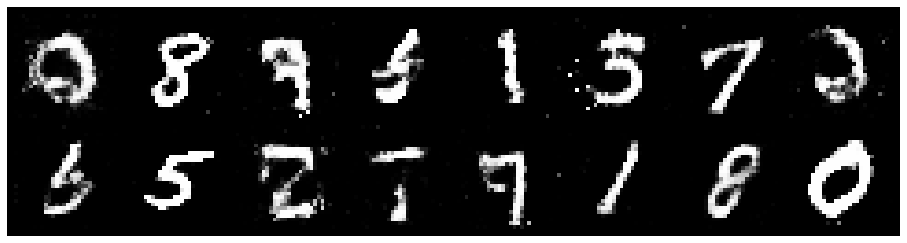

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.1548, Generator Loss: 1.0235
D(x): 0.5647, D(G(z)): 0.3810


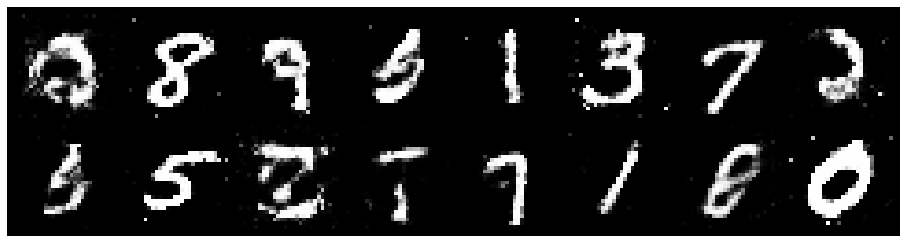

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3493, Generator Loss: 0.9595
D(x): 0.5821, D(G(z)): 0.4613


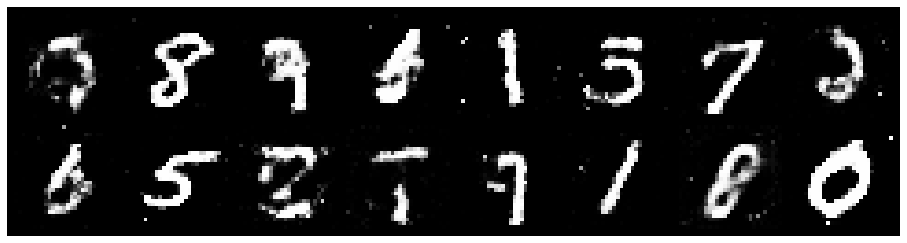

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.3208, Generator Loss: 0.8862
D(x): 0.5554, D(G(z)): 0.4510


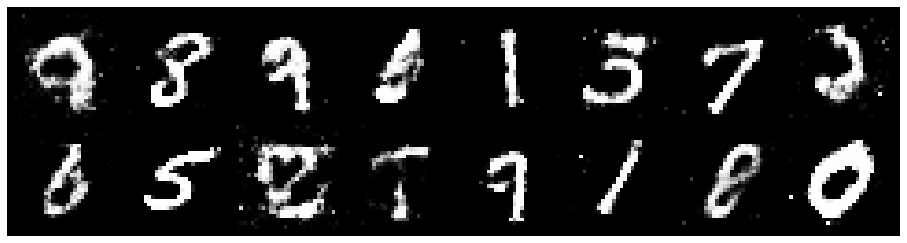

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2834, Generator Loss: 0.9419
D(x): 0.5467, D(G(z)): 0.4160


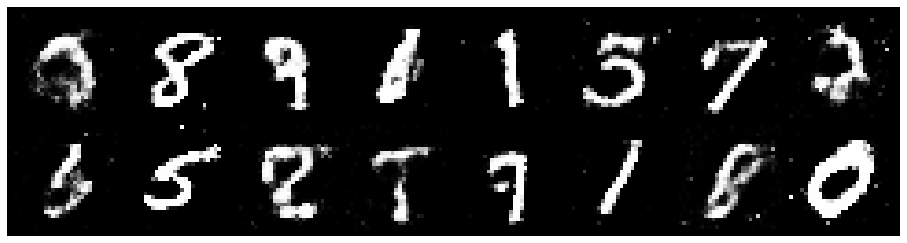

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.3268, Generator Loss: 0.8429
D(x): 0.5492, D(G(z)): 0.4593


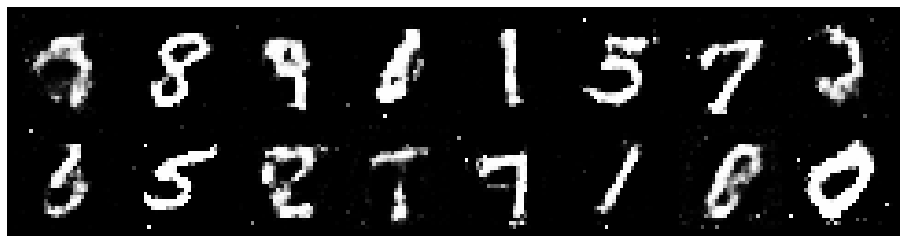

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2194, Generator Loss: 0.9018
D(x): 0.5947, D(G(z)): 0.4522


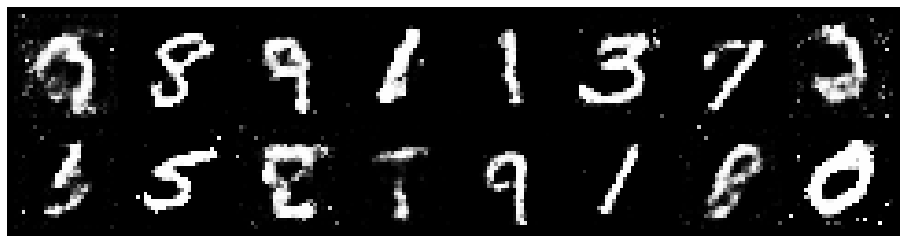

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.0865, Generator Loss: 0.8779
D(x): 0.6170, D(G(z)): 0.4116


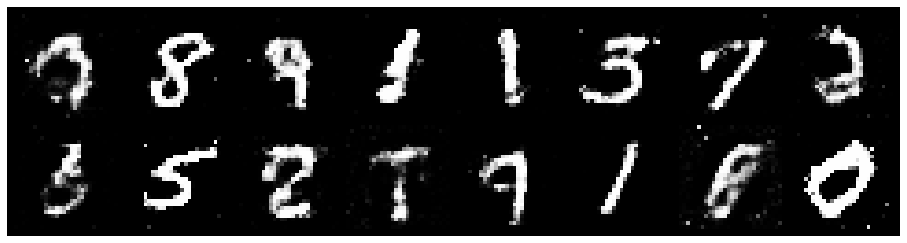

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2333, Generator Loss: 0.9122
D(x): 0.5642, D(G(z)): 0.4145


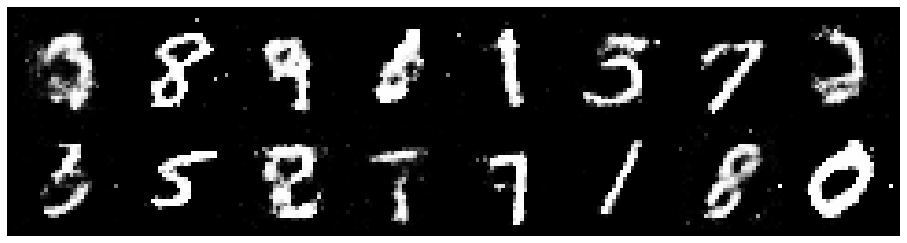

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.3083, Generator Loss: 1.0581
D(x): 0.5842, D(G(z)): 0.4402


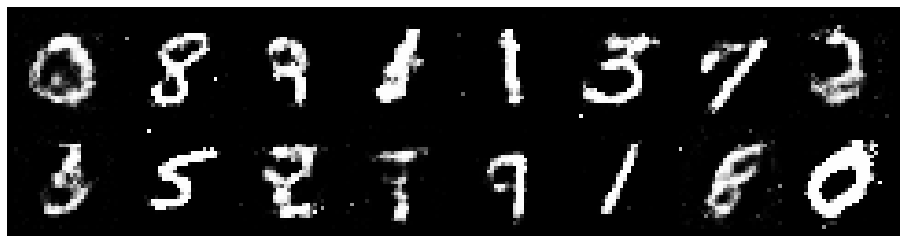

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1573, Generator Loss: 1.0876
D(x): 0.5885, D(G(z)): 0.4073


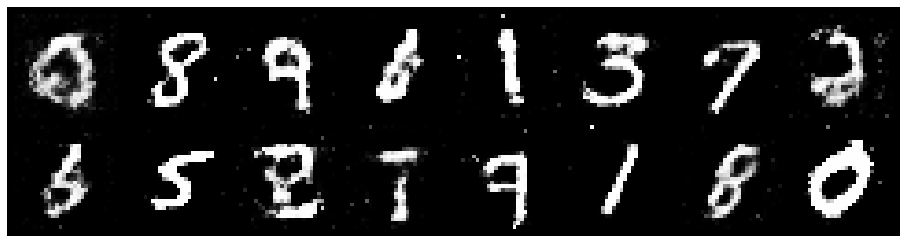

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.3654, Generator Loss: 0.8668
D(x): 0.5695, D(G(z)): 0.4656


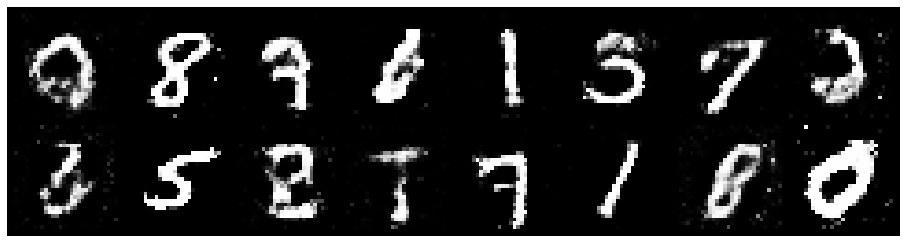

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2570, Generator Loss: 1.0252
D(x): 0.5670, D(G(z)): 0.4112


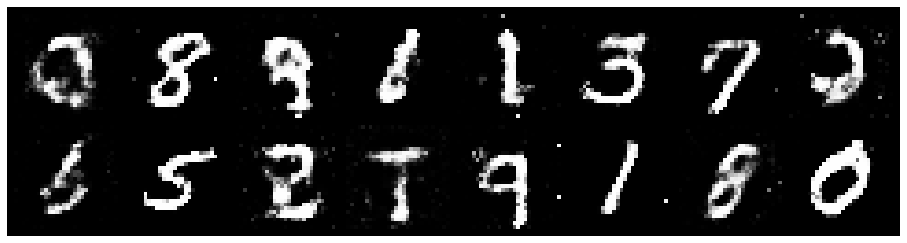

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2792, Generator Loss: 0.9240
D(x): 0.5845, D(G(z)): 0.4451


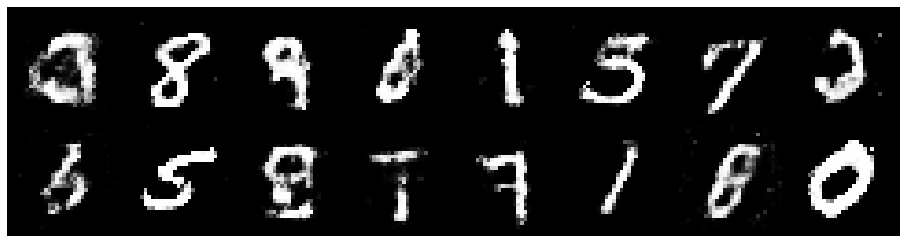

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2085, Generator Loss: 1.0424
D(x): 0.5995, D(G(z)): 0.4313


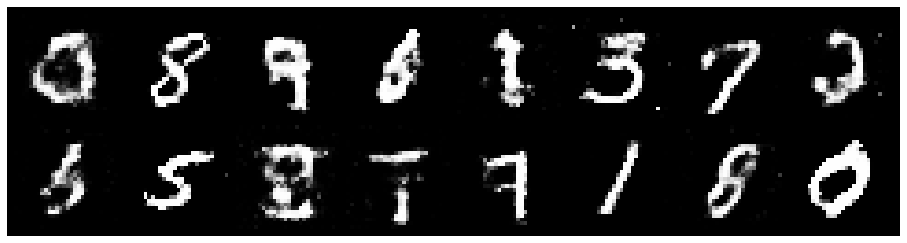

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8757
D(x): 0.5770, D(G(z)): 0.4425


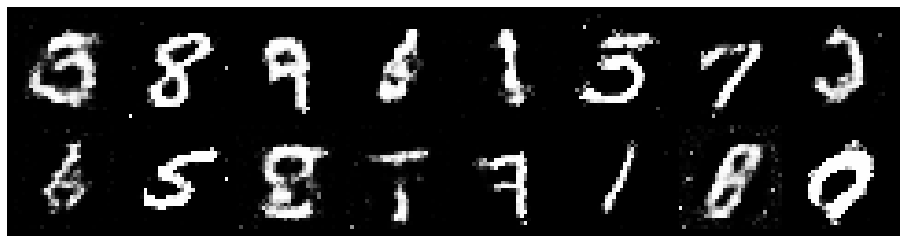

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9419
D(x): 0.5343, D(G(z)): 0.4073


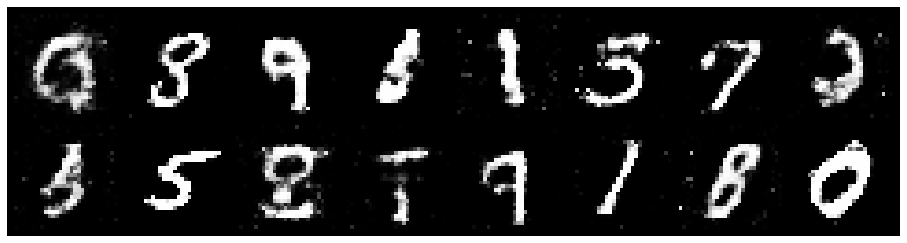

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.1984, Generator Loss: 0.9988
D(x): 0.5984, D(G(z)): 0.4357


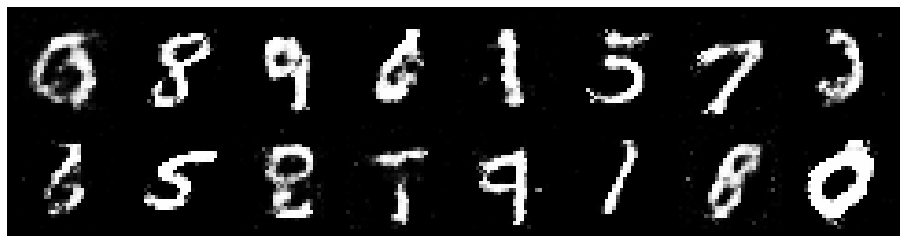

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2529, Generator Loss: 0.9263
D(x): 0.5660, D(G(z)): 0.4418


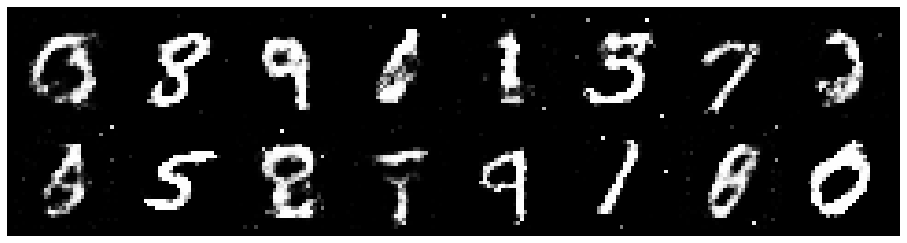

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1828, Generator Loss: 1.0144
D(x): 0.5767, D(G(z)): 0.4170


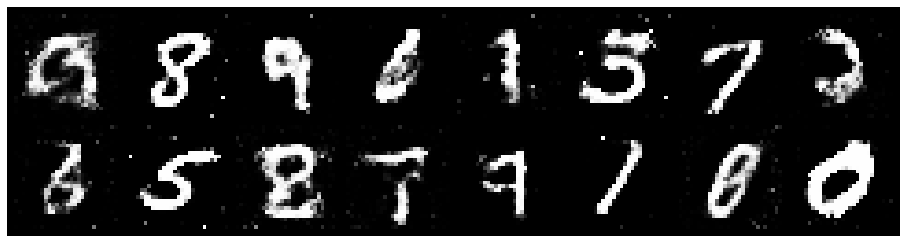

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.0901, Generator Loss: 1.0820
D(x): 0.6411, D(G(z)): 0.4110


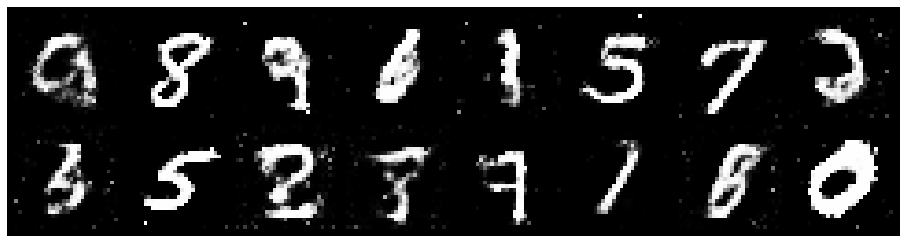

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1377, Generator Loss: 0.9897
D(x): 0.5552, D(G(z)): 0.3776


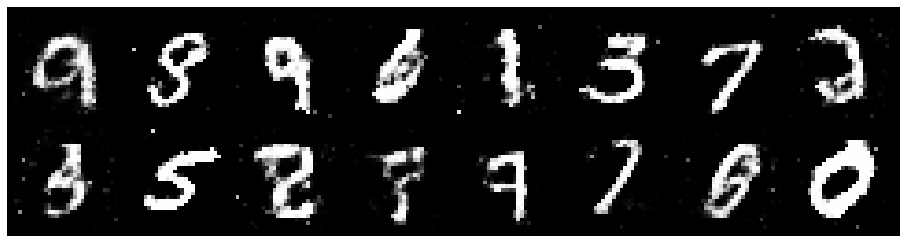

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2667, Generator Loss: 0.8950
D(x): 0.5707, D(G(z)): 0.4539


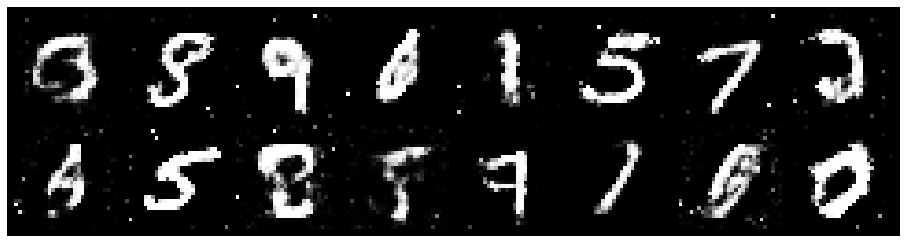

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2069, Generator Loss: 0.9934
D(x): 0.5554, D(G(z)): 0.4064


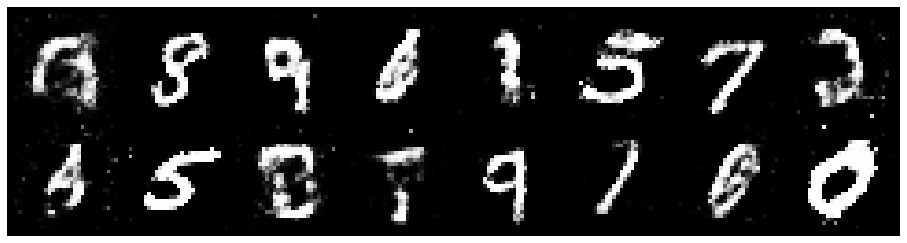

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2837, Generator Loss: 0.8714
D(x): 0.5581, D(G(z)): 0.4549


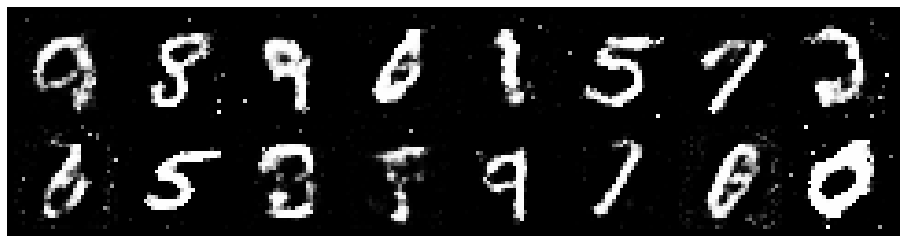

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.1459, Generator Loss: 1.0488
D(x): 0.5956, D(G(z)): 0.4105


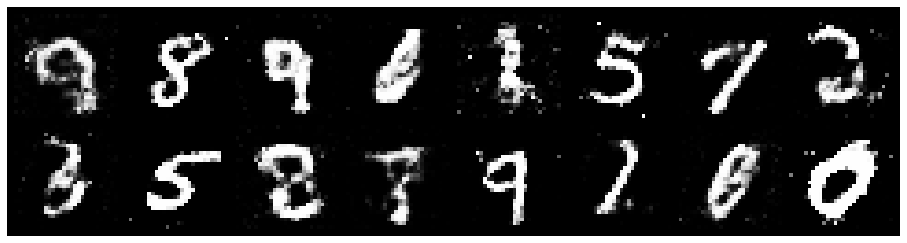

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1447, Generator Loss: 0.9285
D(x): 0.5720, D(G(z)): 0.3932


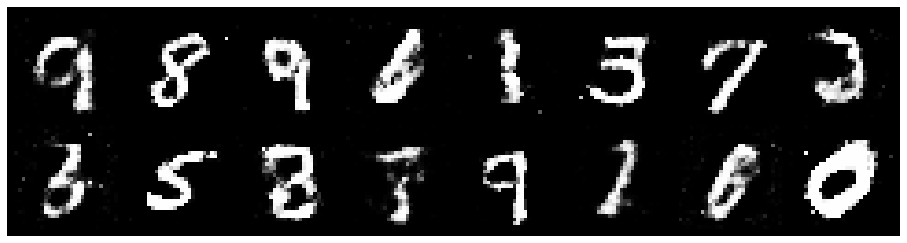

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.1920, Generator Loss: 0.9430
D(x): 0.5796, D(G(z)): 0.4320


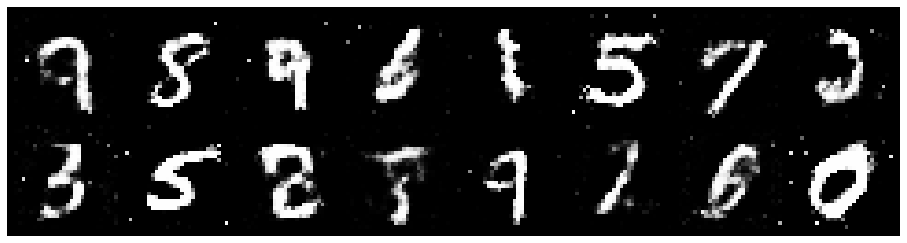

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.3290, Generator Loss: 0.9829
D(x): 0.5054, D(G(z)): 0.4123


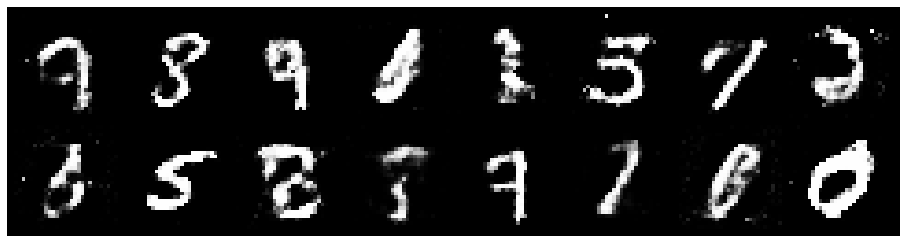

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2621, Generator Loss: 1.0457
D(x): 0.5889, D(G(z)): 0.4456


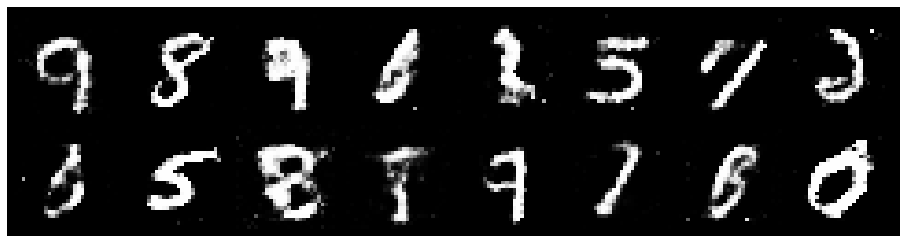

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1944, Generator Loss: 0.8731
D(x): 0.5802, D(G(z)): 0.4037


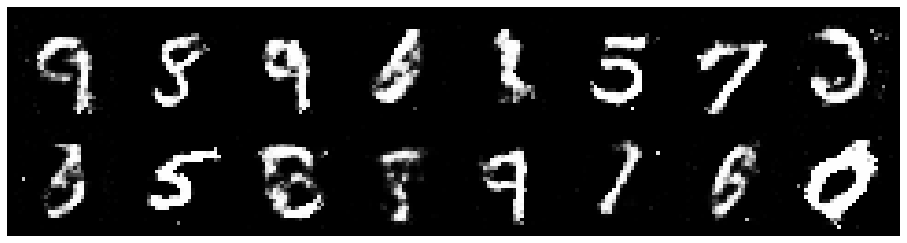

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1745, Generator Loss: 1.1136
D(x): 0.5971, D(G(z)): 0.4029


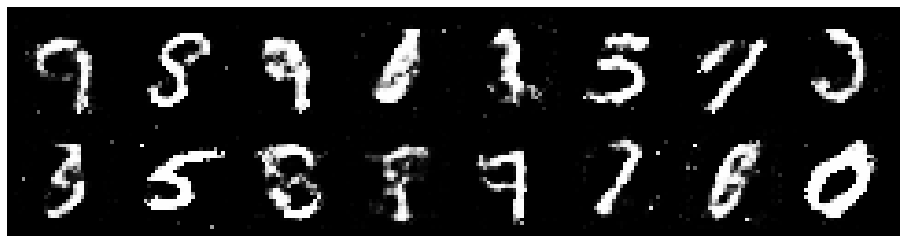

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.1853, Generator Loss: 1.1503
D(x): 0.5697, D(G(z)): 0.3793


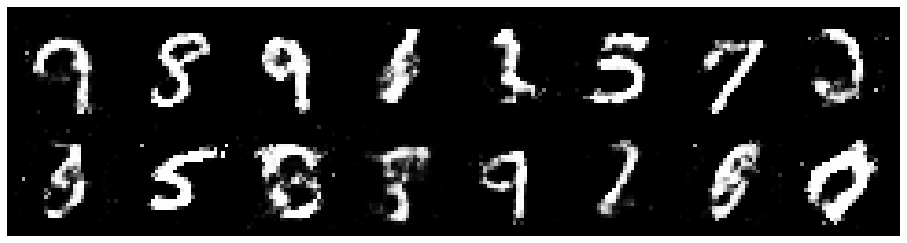

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2042, Generator Loss: 0.9803
D(x): 0.5434, D(G(z)): 0.3710


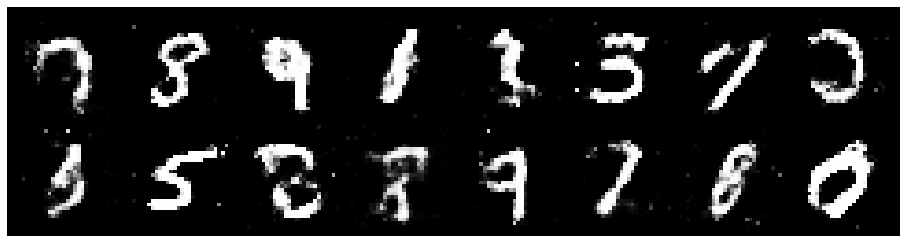

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1492, Generator Loss: 0.9307
D(x): 0.5833, D(G(z)): 0.4039


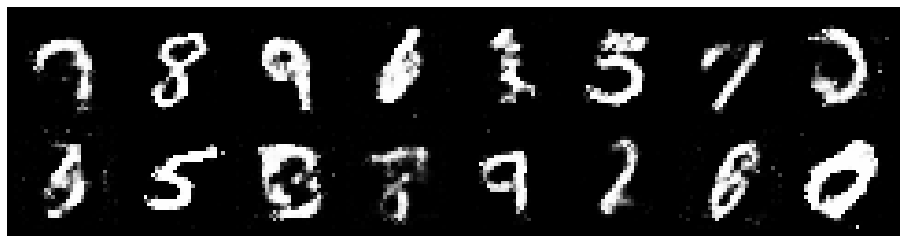

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.1475, Generator Loss: 0.9191
D(x): 0.6086, D(G(z)): 0.4416


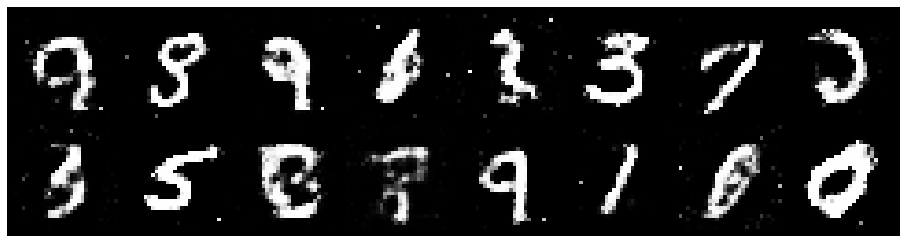

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.1974, Generator Loss: 1.1979
D(x): 0.5565, D(G(z)): 0.3894


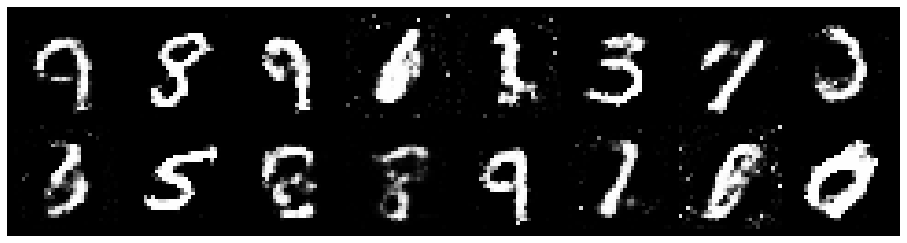

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.2357, Generator Loss: 0.9617
D(x): 0.5601, D(G(z)): 0.4317


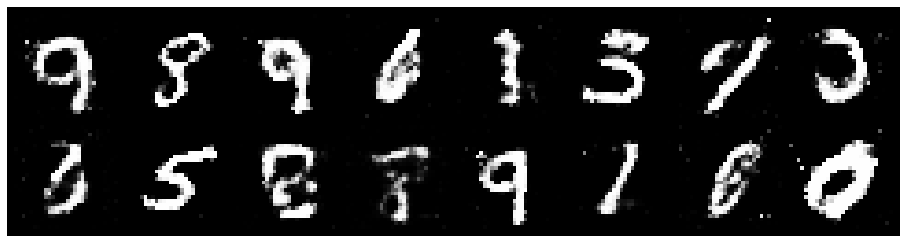

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.1910, Generator Loss: 0.9405
D(x): 0.5757, D(G(z)): 0.4272


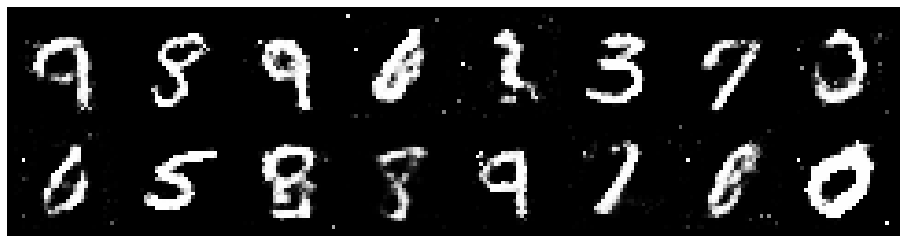

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2157, Generator Loss: 1.0492
D(x): 0.5864, D(G(z)): 0.4202


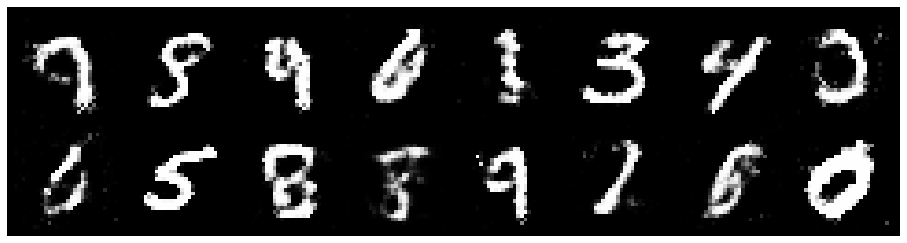

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2211, Generator Loss: 1.1580
D(x): 0.5708, D(G(z)): 0.4223


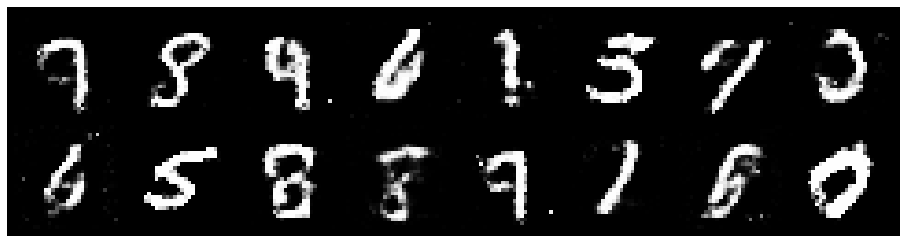

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1527, Generator Loss: 1.0986
D(x): 0.5951, D(G(z)): 0.3870


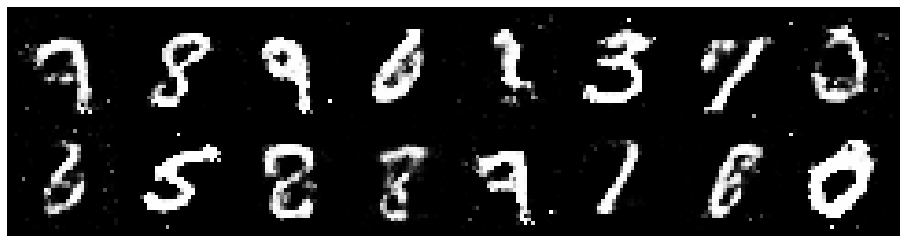

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2372, Generator Loss: 0.9348
D(x): 0.5544, D(G(z)): 0.4302


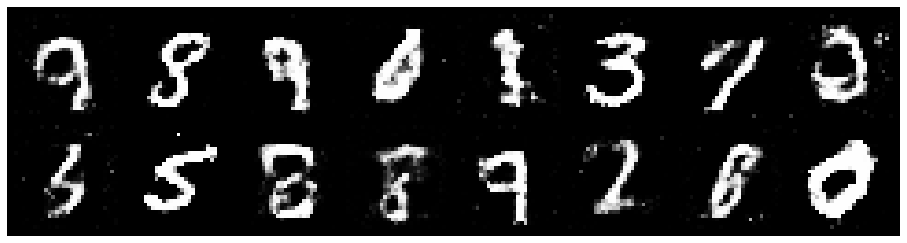

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2535, Generator Loss: 0.8326
D(x): 0.5675, D(G(z)): 0.4428


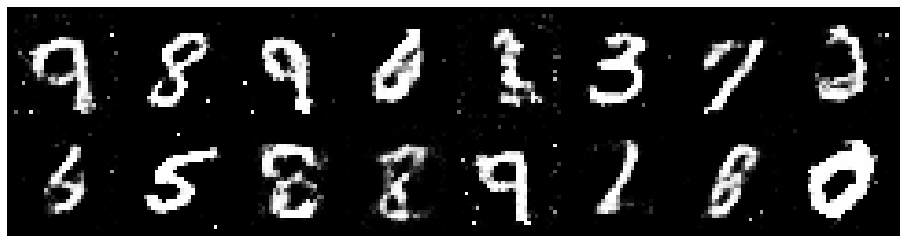

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2438, Generator Loss: 0.9403
D(x): 0.5588, D(G(z)): 0.4344


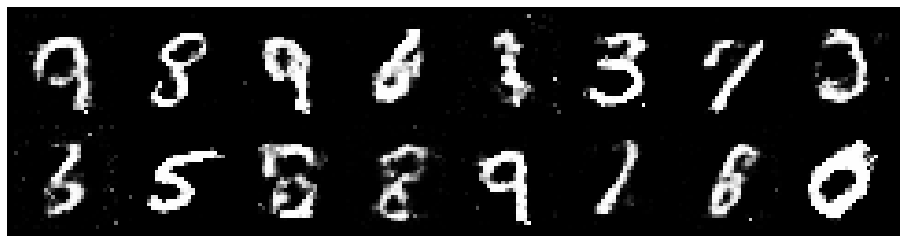

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.1949, Generator Loss: 0.8936
D(x): 0.5630, D(G(z)): 0.4135


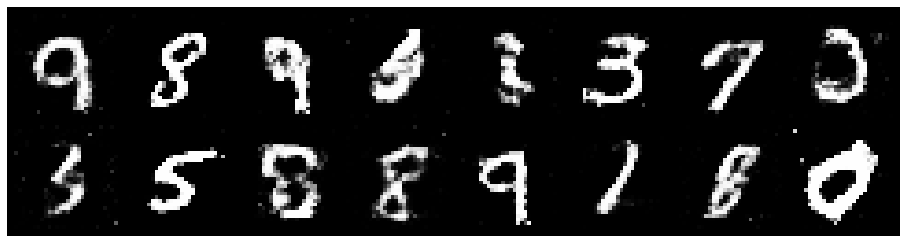

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.3155, Generator Loss: 0.9310
D(x): 0.5318, D(G(z)): 0.4390


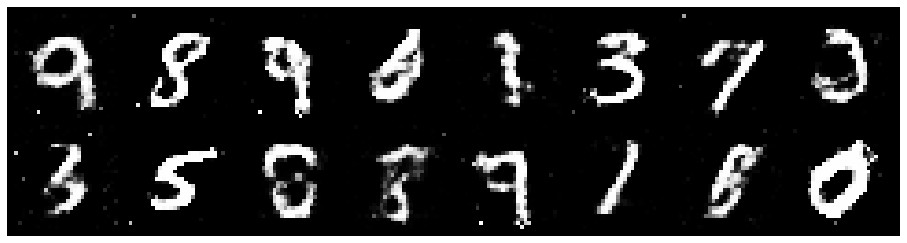

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2078, Generator Loss: 1.0020
D(x): 0.5690, D(G(z)): 0.4130


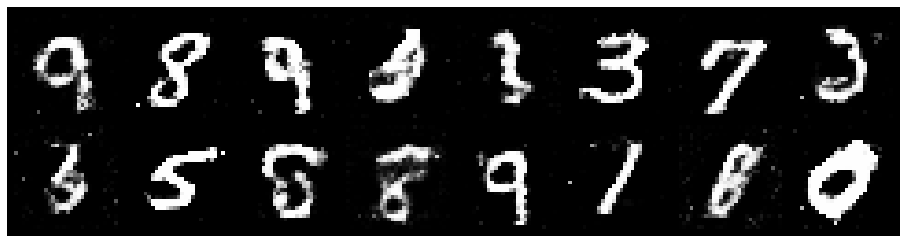

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.2848, Generator Loss: 1.0415
D(x): 0.5780, D(G(z)): 0.4505


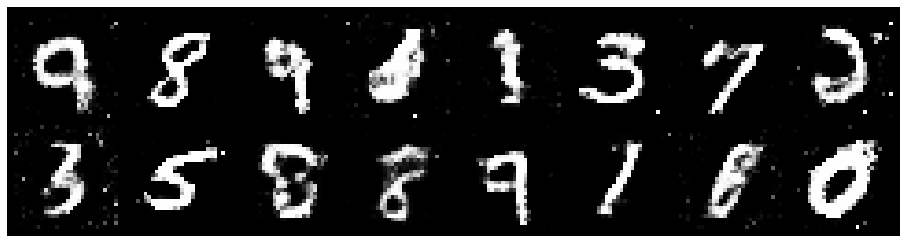

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.1810, Generator Loss: 0.9034
D(x): 0.5985, D(G(z)): 0.4383


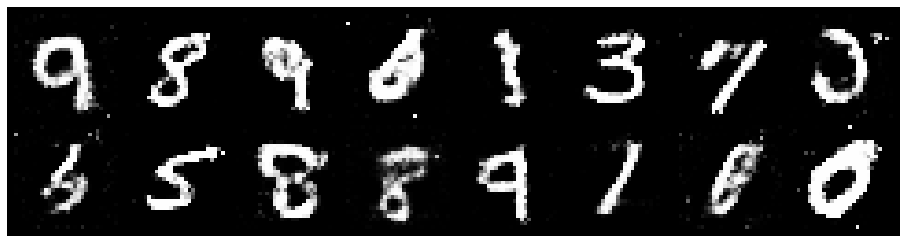

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2474, Generator Loss: 0.9828
D(x): 0.5851, D(G(z)): 0.4469


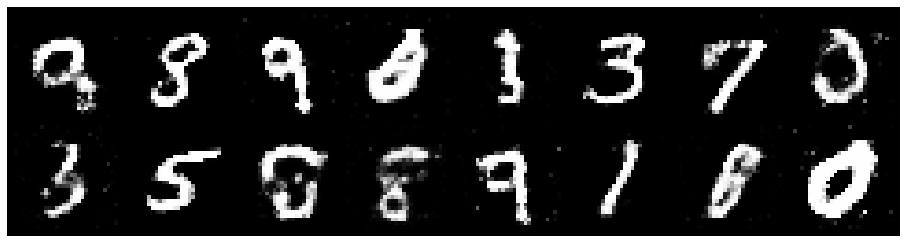

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.0741, Generator Loss: 1.1704
D(x): 0.6113, D(G(z)): 0.3729


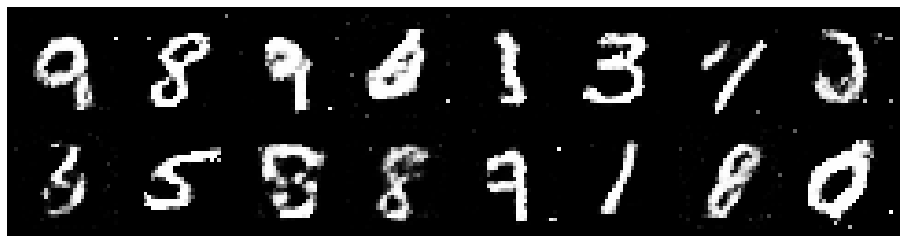

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2637, Generator Loss: 1.0077
D(x): 0.5798, D(G(z)): 0.4474


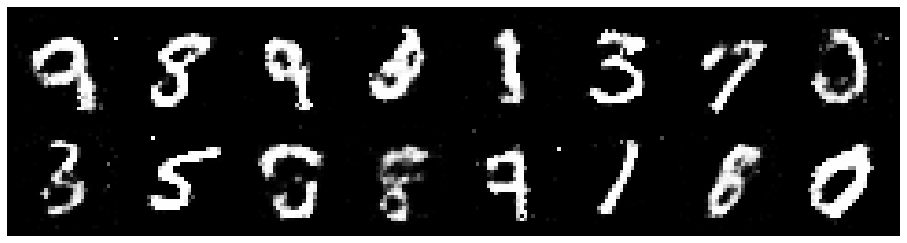

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.1979, Generator Loss: 0.8724
D(x): 0.5848, D(G(z)): 0.4345


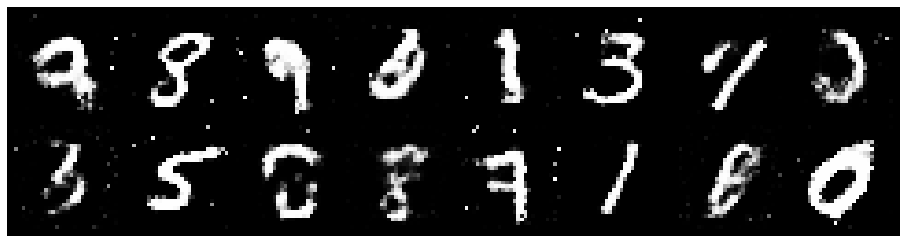

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2876, Generator Loss: 1.1137
D(x): 0.5301, D(G(z)): 0.4078


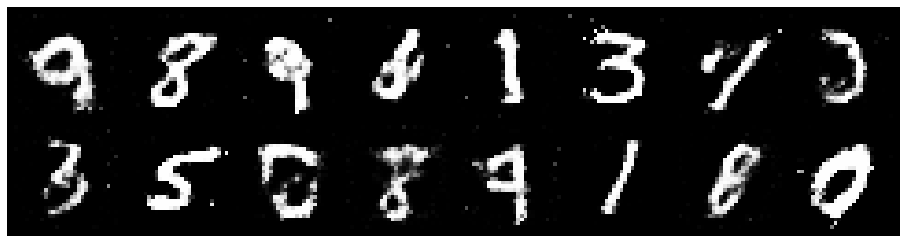

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.1257, Generator Loss: 1.0549
D(x): 0.6140, D(G(z)): 0.4026


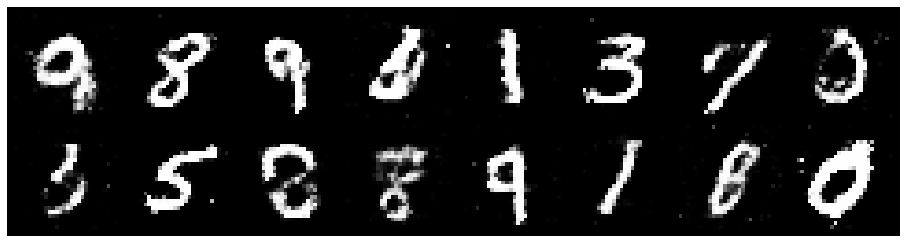

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.1507, Generator Loss: 1.0667
D(x): 0.5808, D(G(z)): 0.3922


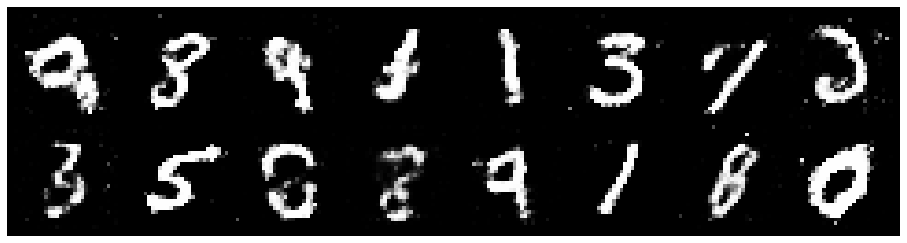

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2677, Generator Loss: 0.7545
D(x): 0.5564, D(G(z)): 0.4456


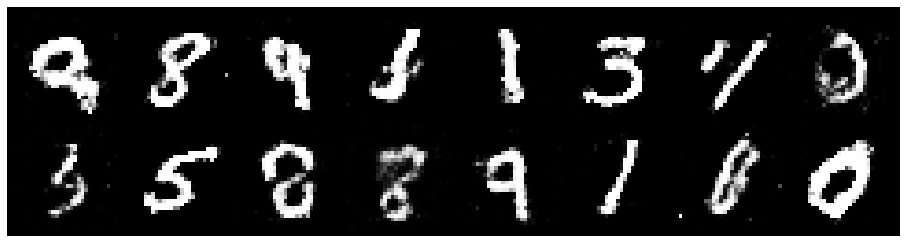

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.1498, Generator Loss: 0.8562
D(x): 0.5747, D(G(z)): 0.4041


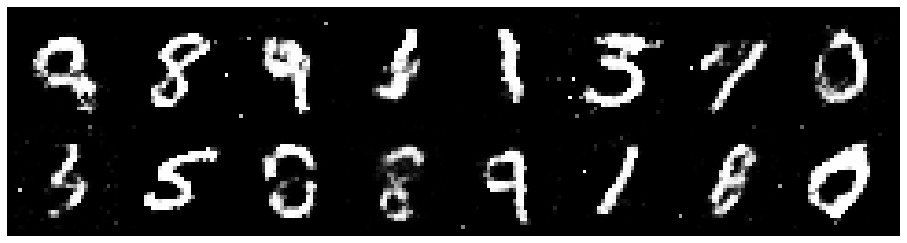

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2646, Generator Loss: 0.9720
D(x): 0.5298, D(G(z)): 0.4138


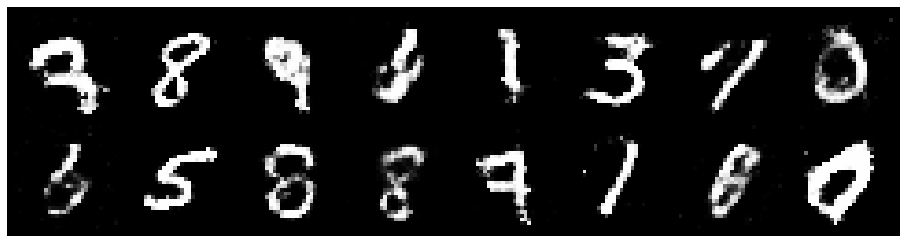

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.0758, Generator Loss: 0.9986
D(x): 0.6154, D(G(z)): 0.3983


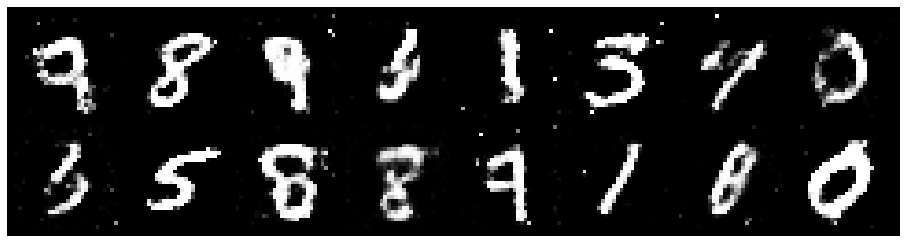

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.1387, Generator Loss: 0.9026
D(x): 0.5919, D(G(z)): 0.4033


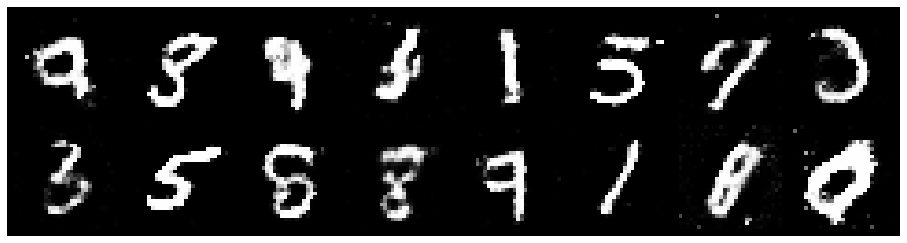

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.1246, Generator Loss: 1.1159
D(x): 0.5791, D(G(z)): 0.3813


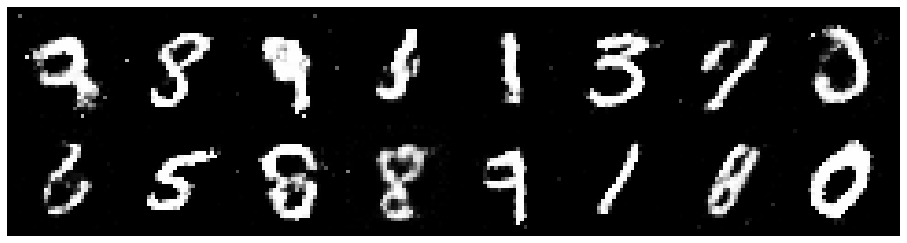

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.1121, Generator Loss: 1.0734
D(x): 0.5658, D(G(z)): 0.3569


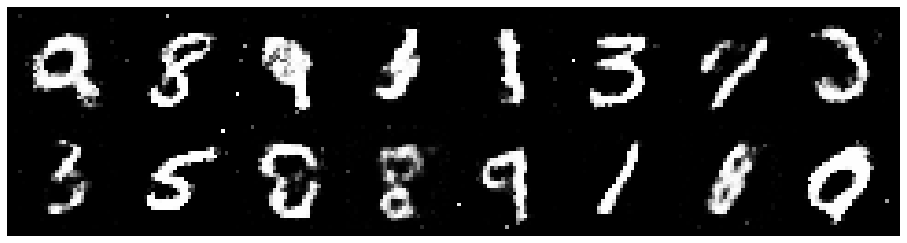

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.0672, Generator Loss: 0.9289
D(x): 0.6353, D(G(z)): 0.4106


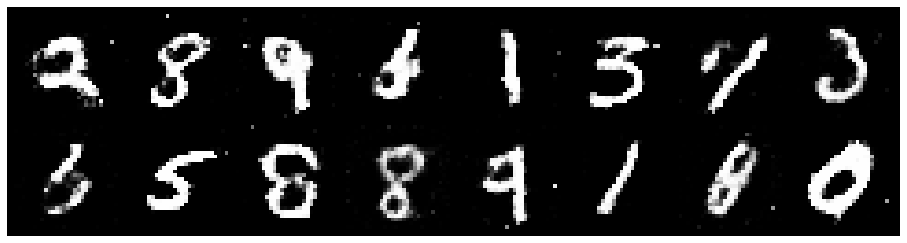

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2677, Generator Loss: 0.8411
D(x): 0.5618, D(G(z)): 0.4418


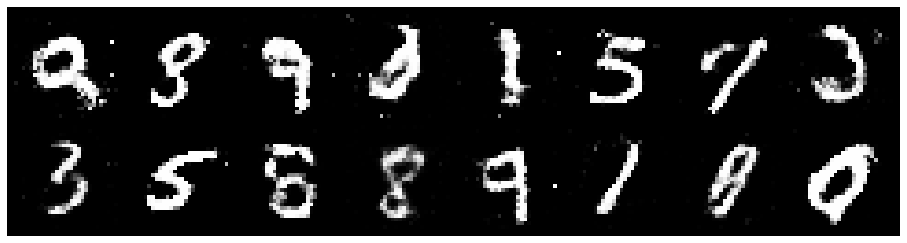

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2026, Generator Loss: 0.8577
D(x): 0.5846, D(G(z)): 0.4585


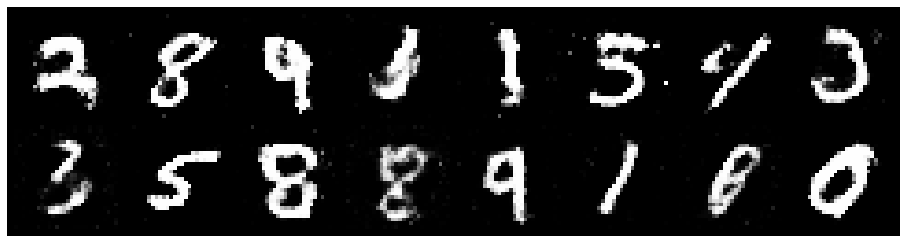

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.1815, Generator Loss: 0.8073
D(x): 0.6132, D(G(z)): 0.4512


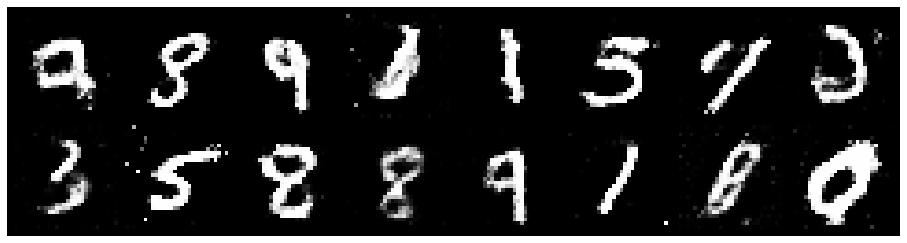

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2912, Generator Loss: 0.9482
D(x): 0.5536, D(G(z)): 0.4353


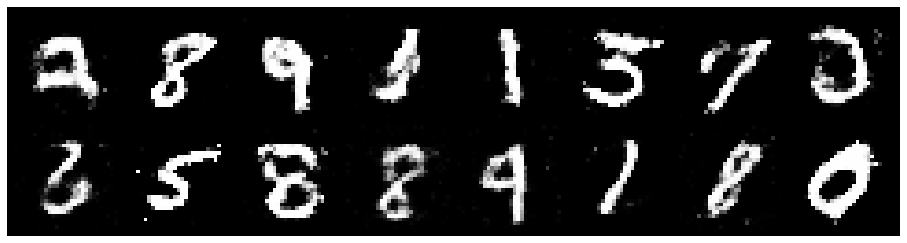

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1776, Generator Loss: 0.8179
D(x): 0.6041, D(G(z)): 0.4581


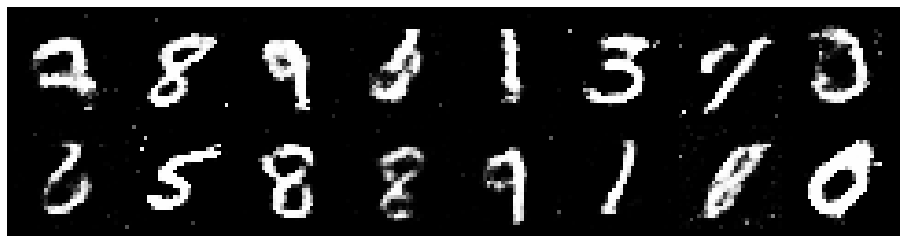

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2910, Generator Loss: 0.9612
D(x): 0.5275, D(G(z)): 0.4327


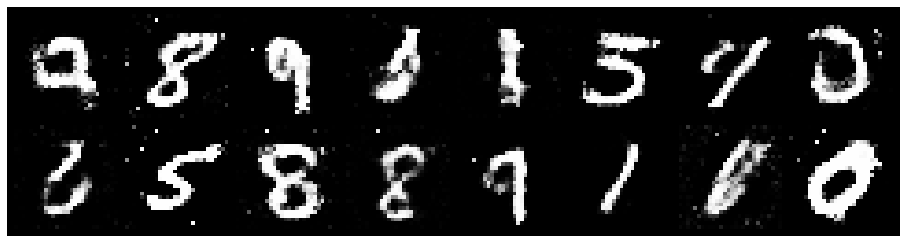

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2170, Generator Loss: 0.9943
D(x): 0.6089, D(G(z)): 0.4568


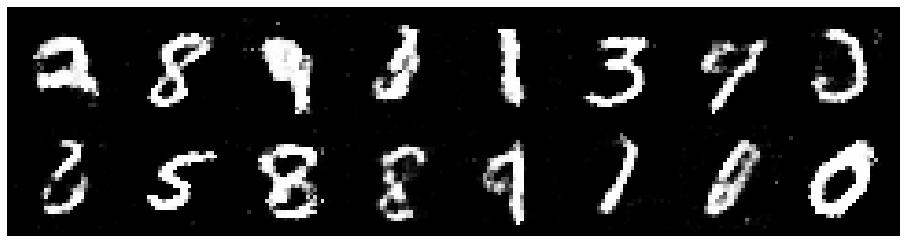

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2409, Generator Loss: 1.0819
D(x): 0.5793, D(G(z)): 0.4277


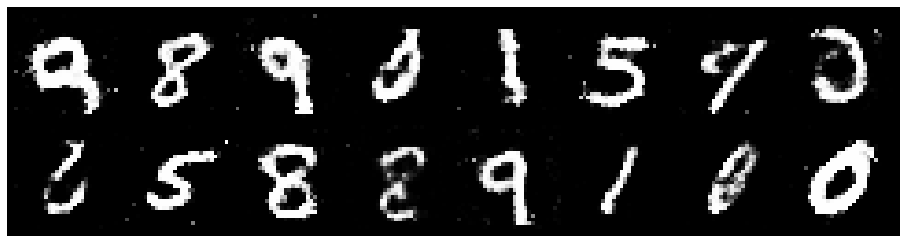

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2202, Generator Loss: 0.9882
D(x): 0.5733, D(G(z)): 0.4324


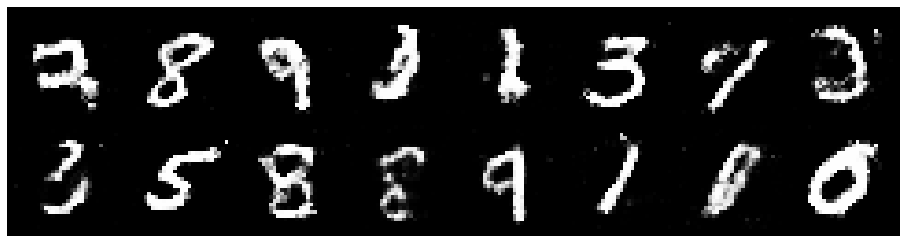

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.1627, Generator Loss: 0.9304
D(x): 0.5823, D(G(z)): 0.4201


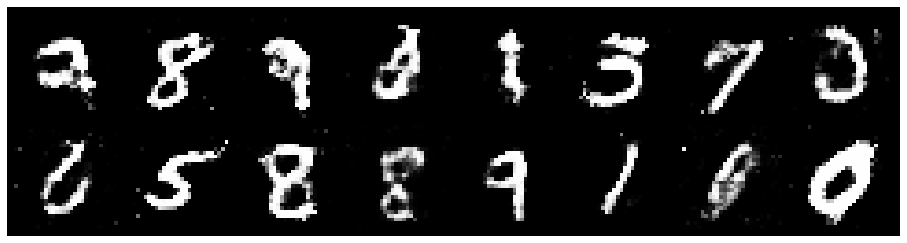

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.2282, Generator Loss: 0.8873
D(x): 0.5768, D(G(z)): 0.4461


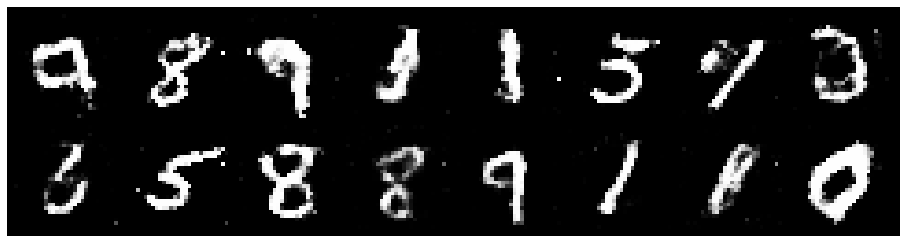

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.3053, Generator Loss: 0.8793
D(x): 0.5333, D(G(z)): 0.4663


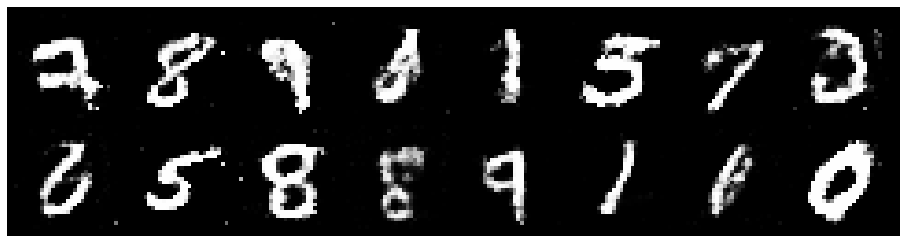

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.1808, Generator Loss: 0.9810
D(x): 0.5604, D(G(z)): 0.3991


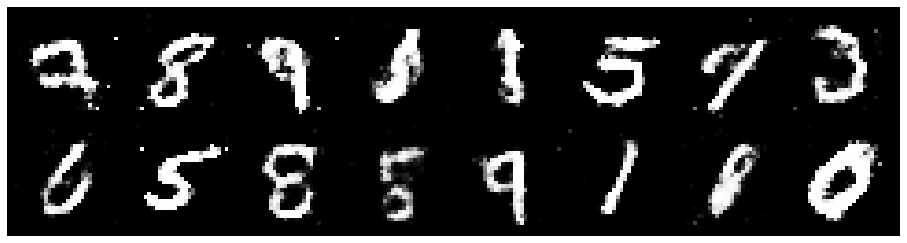

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3718, Generator Loss: 1.0193
D(x): 0.5325, D(G(z)): 0.4482


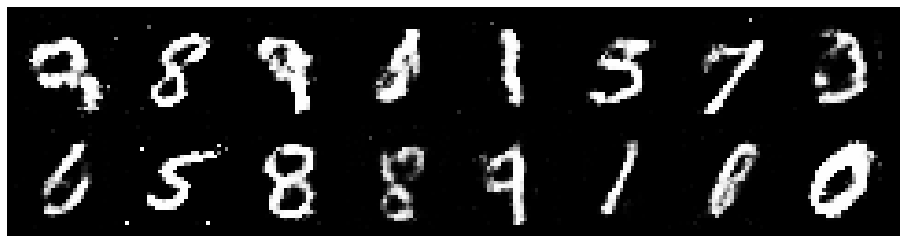

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.3133, Generator Loss: 0.8819
D(x): 0.5432, D(G(z)): 0.4585


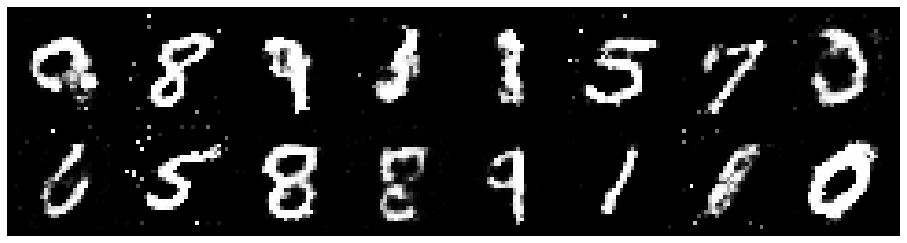

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2348, Generator Loss: 0.9165
D(x): 0.5840, D(G(z)): 0.4340


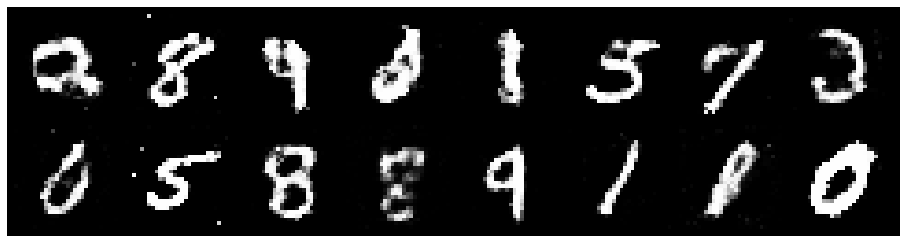

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.4102, Generator Loss: 0.7601
D(x): 0.5439, D(G(z)): 0.4969


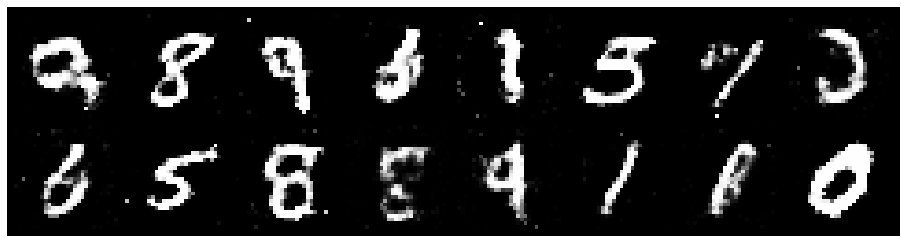

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.3302, Generator Loss: 0.9388
D(x): 0.5529, D(G(z)): 0.4731


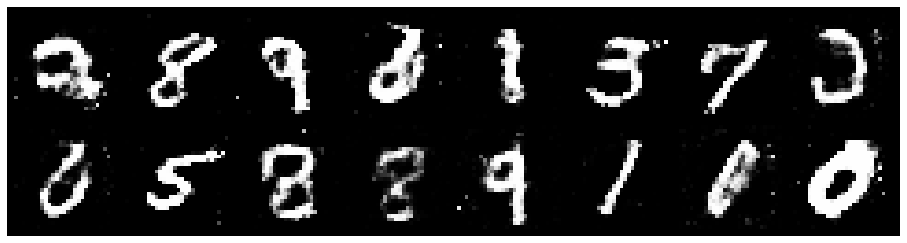

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.3276, Generator Loss: 0.8118
D(x): 0.5472, D(G(z)): 0.4765


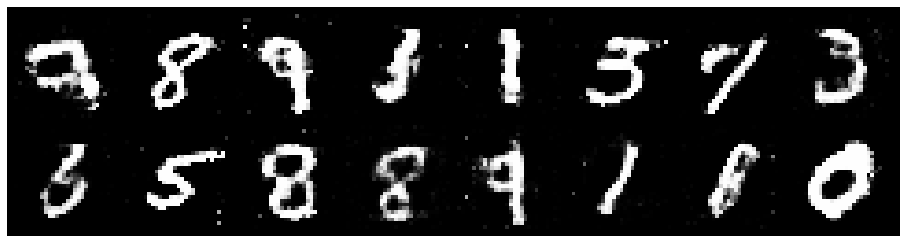

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.1389, Generator Loss: 0.8573
D(x): 0.6184, D(G(z)): 0.4317


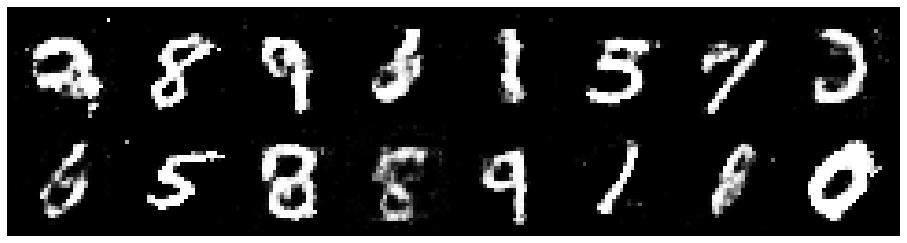

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2511, Generator Loss: 1.0109
D(x): 0.5834, D(G(z)): 0.4145


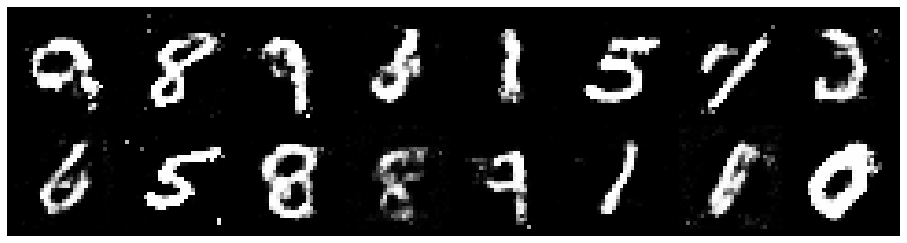

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2292, Generator Loss: 0.9091
D(x): 0.5937, D(G(z)): 0.4107


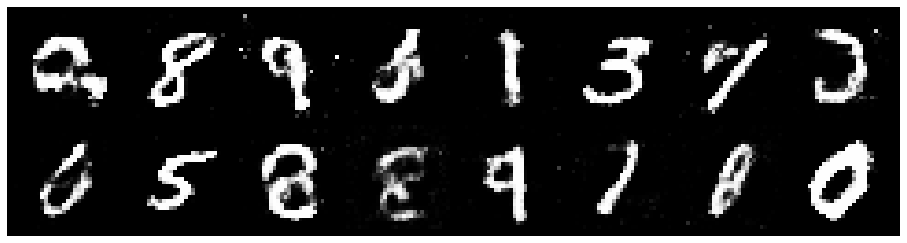

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2997, Generator Loss: 0.9542
D(x): 0.5913, D(G(z)): 0.4655


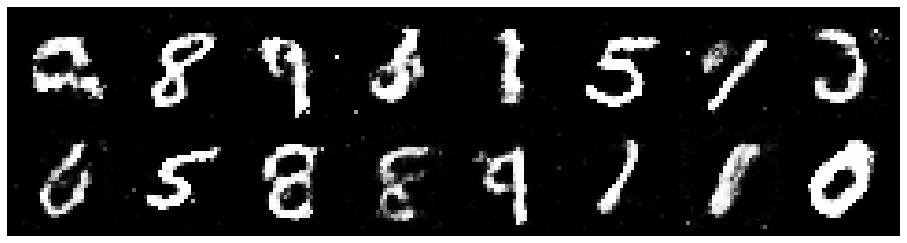

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.1604, Generator Loss: 0.8390
D(x): 0.6112, D(G(z)): 0.4220


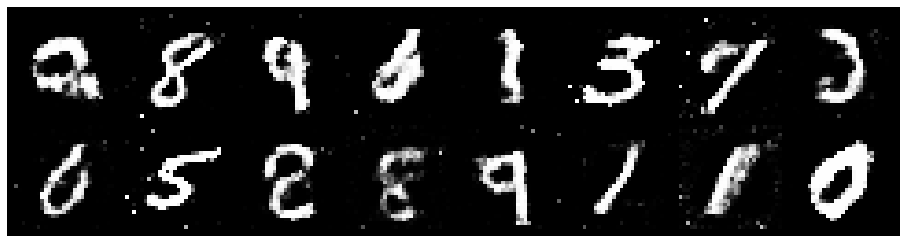

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1764, Generator Loss: 1.0281
D(x): 0.5752, D(G(z)): 0.3992


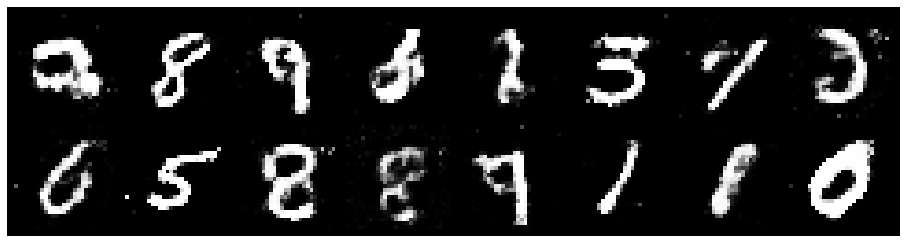

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2674, Generator Loss: 1.1018
D(x): 0.5420, D(G(z)): 0.4238


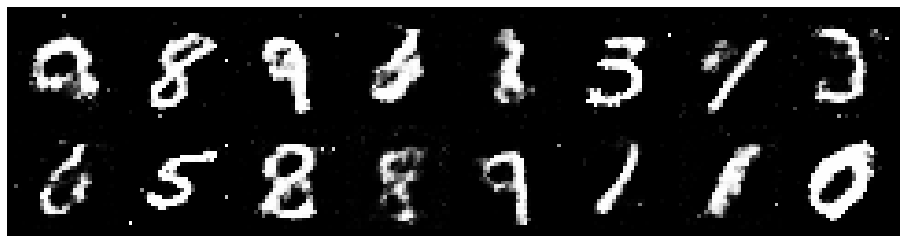

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.3381, Generator Loss: 0.8039
D(x): 0.5895, D(G(z)): 0.4910


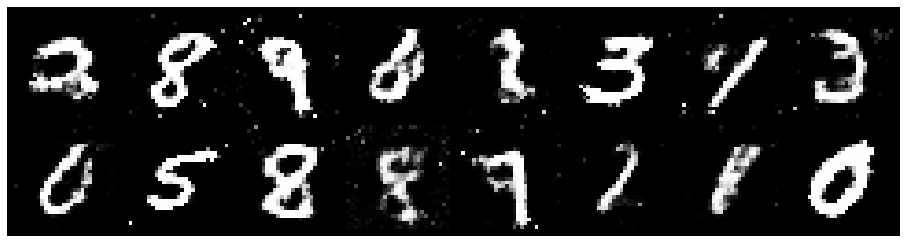

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.4104, Generator Loss: 0.8936
D(x): 0.5338, D(G(z)): 0.4858


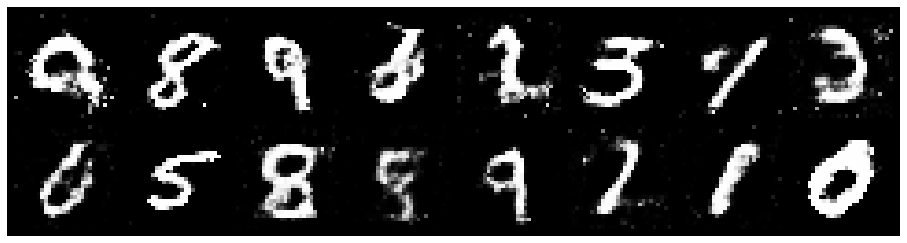

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2990, Generator Loss: 0.9531
D(x): 0.5593, D(G(z)): 0.4330


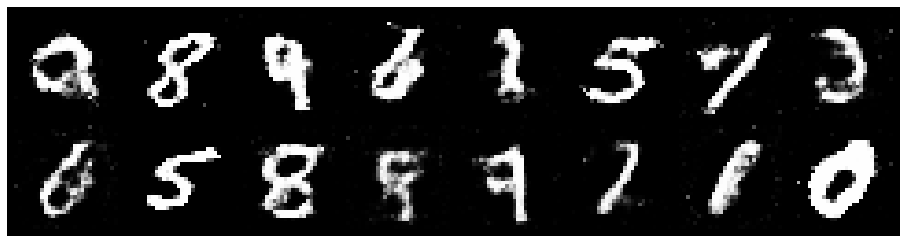

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2472, Generator Loss: 1.1009
D(x): 0.5531, D(G(z)): 0.4075


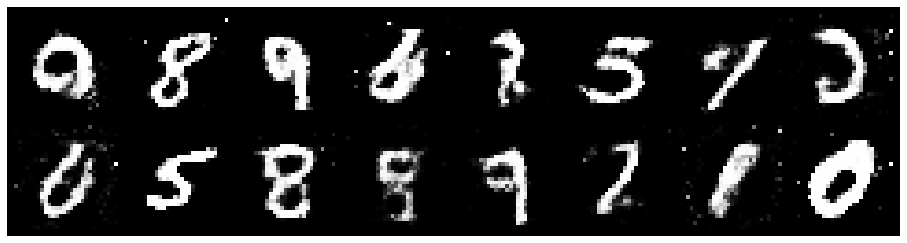

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.3011, Generator Loss: 0.9752
D(x): 0.5330, D(G(z)): 0.4301


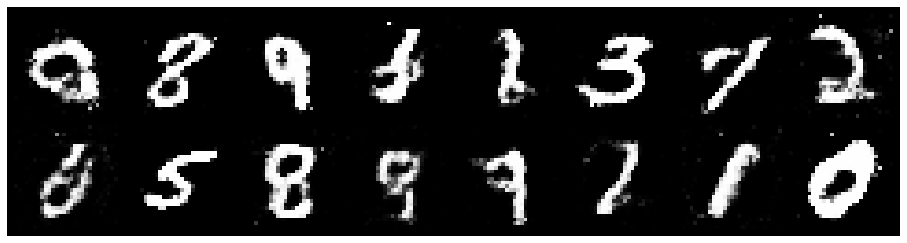

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.3636, Generator Loss: 0.9085
D(x): 0.5649, D(G(z)): 0.4734


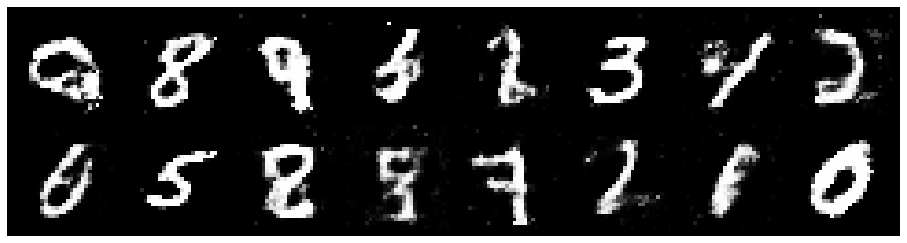

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2763, Generator Loss: 1.0453
D(x): 0.5371, D(G(z)): 0.4109


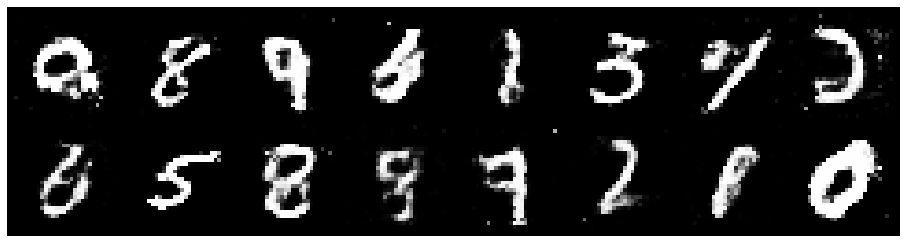

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1887, Generator Loss: 1.0194
D(x): 0.5751, D(G(z)): 0.3987


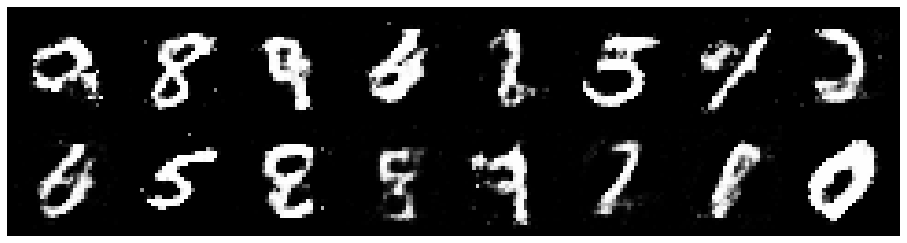

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2028, Generator Loss: 1.0926
D(x): 0.5975, D(G(z)): 0.4106


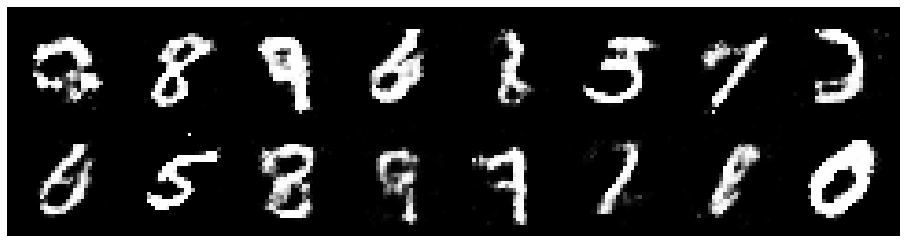

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2016, Generator Loss: 1.0786
D(x): 0.5817, D(G(z)): 0.4161


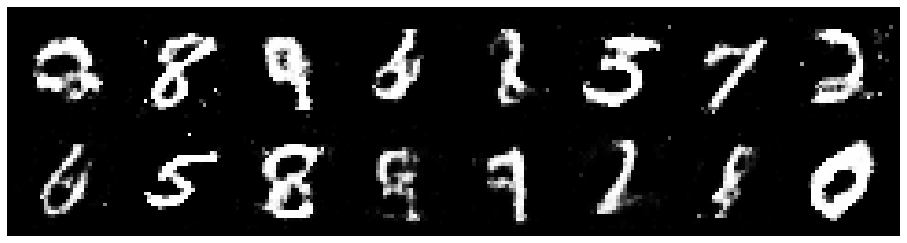

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.2170, Generator Loss: 0.9047
D(x): 0.5616, D(G(z)): 0.4309


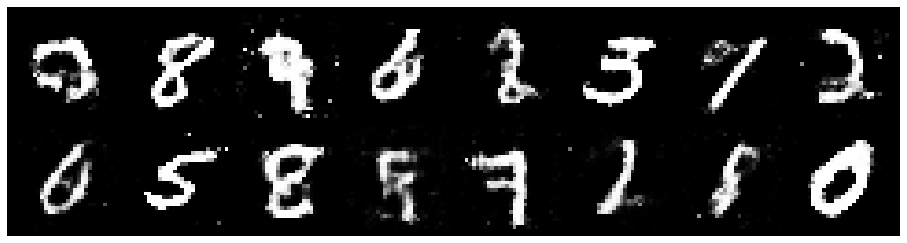

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.1668, Generator Loss: 0.9640
D(x): 0.5917, D(G(z)): 0.4265


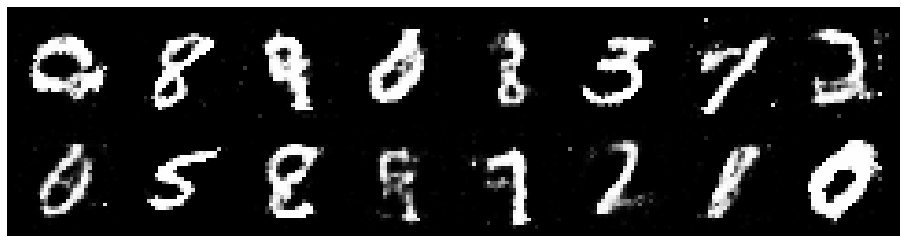

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.3052, Generator Loss: 0.7796
D(x): 0.5722, D(G(z)): 0.4817


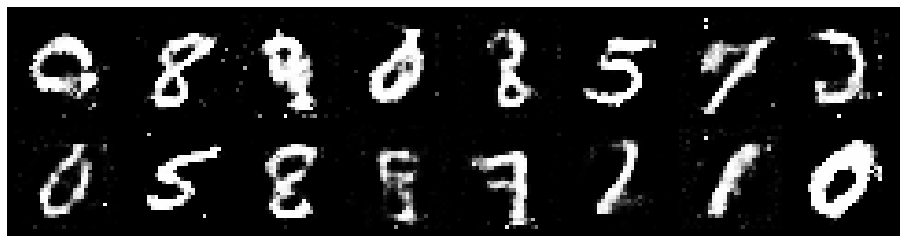

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2886, Generator Loss: 0.8968
D(x): 0.5300, D(G(z)): 0.4254


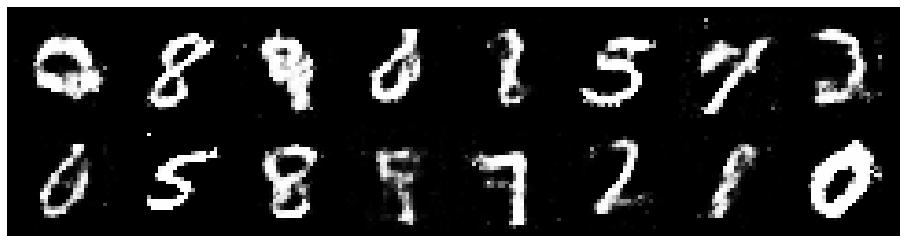

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.3591, Generator Loss: 0.8713
D(x): 0.5671, D(G(z)): 0.4786


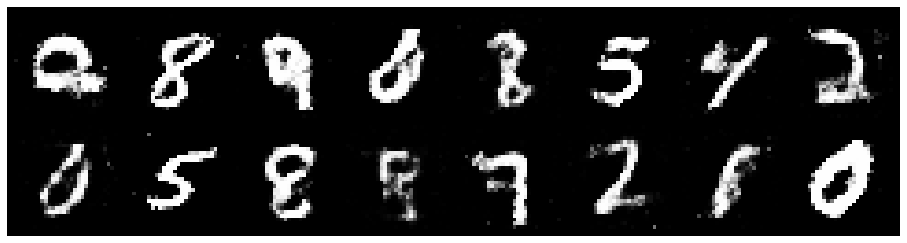

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.1703, Generator Loss: 0.9588
D(x): 0.5384, D(G(z)): 0.3854


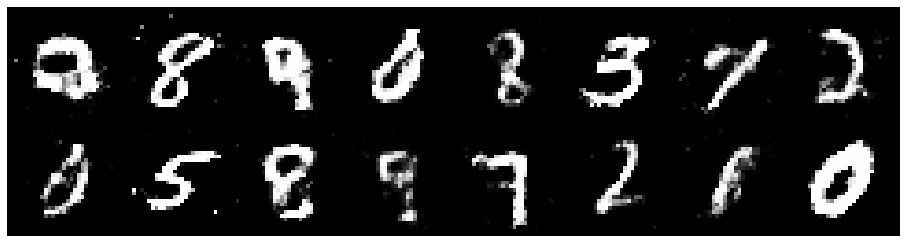

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.1485, Generator Loss: 1.0488
D(x): 0.5485, D(G(z)): 0.3644


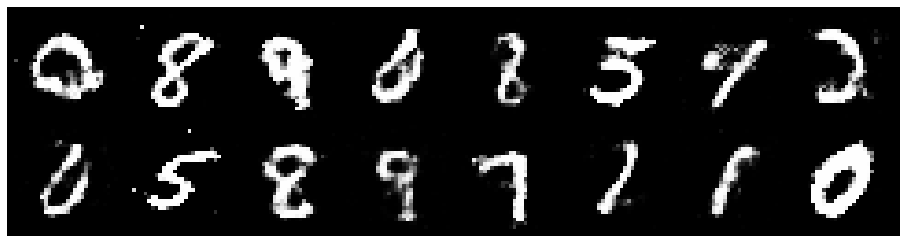

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.1552, Generator Loss: 0.9682
D(x): 0.5588, D(G(z)): 0.3955


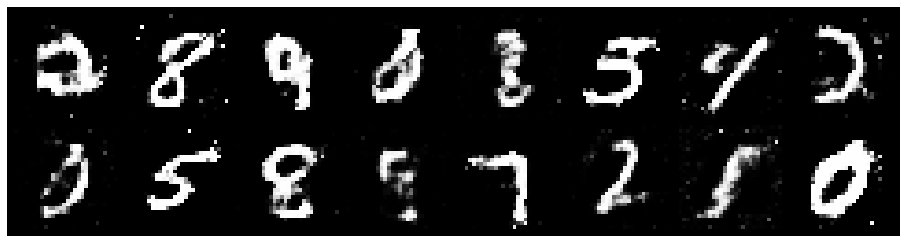

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2278, Generator Loss: 0.8906
D(x): 0.5674, D(G(z)): 0.4479


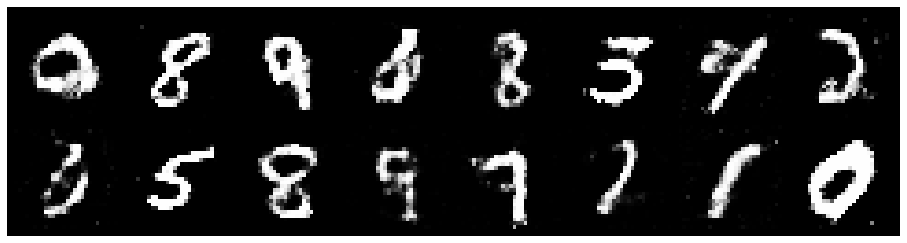

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2192, Generator Loss: 1.0315
D(x): 0.5448, D(G(z)): 0.4132


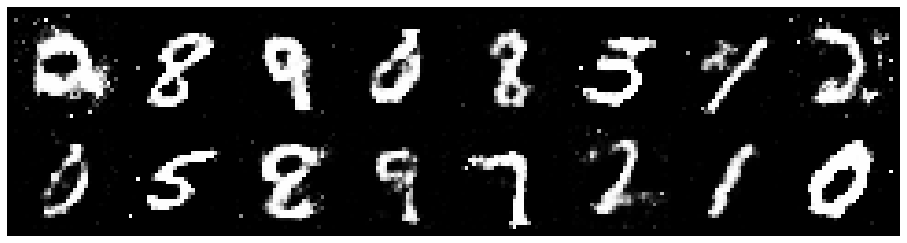

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.1843, Generator Loss: 0.8615
D(x): 0.6079, D(G(z)): 0.4396


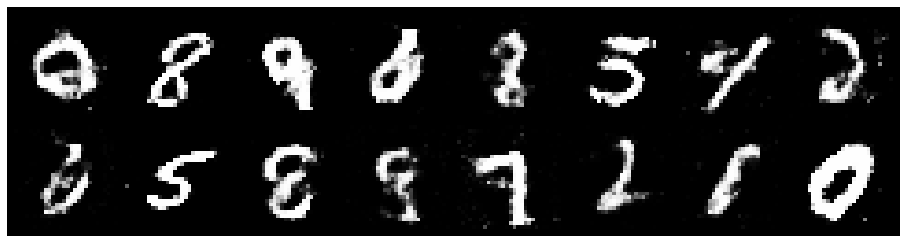

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2719, Generator Loss: 0.9099
D(x): 0.5346, D(G(z)): 0.4169


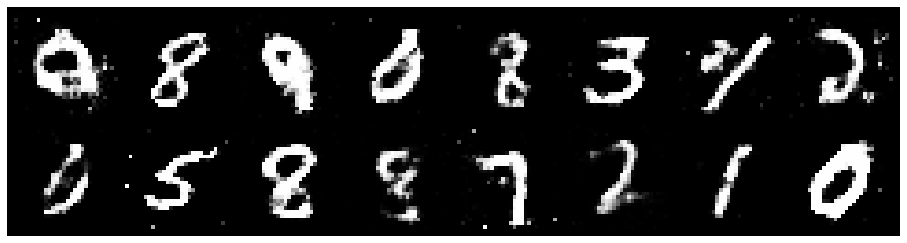

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.1804, Generator Loss: 1.0049
D(x): 0.5683, D(G(z)): 0.3940


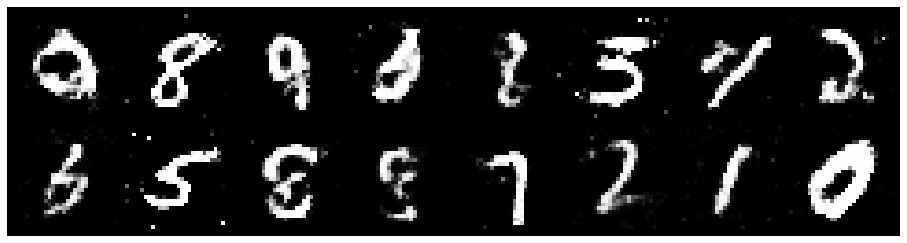

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2138, Generator Loss: 0.9615
D(x): 0.6001, D(G(z)): 0.4415


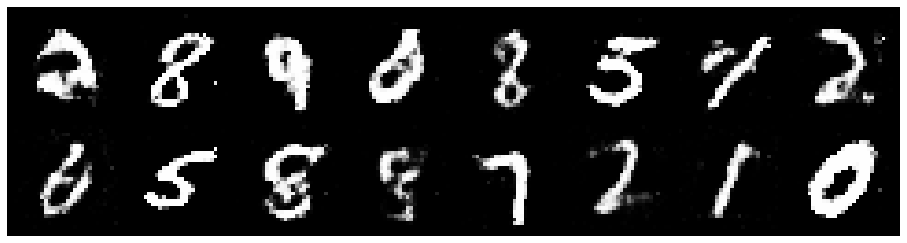

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2213, Generator Loss: 1.1999
D(x): 0.5834, D(G(z)): 0.4326


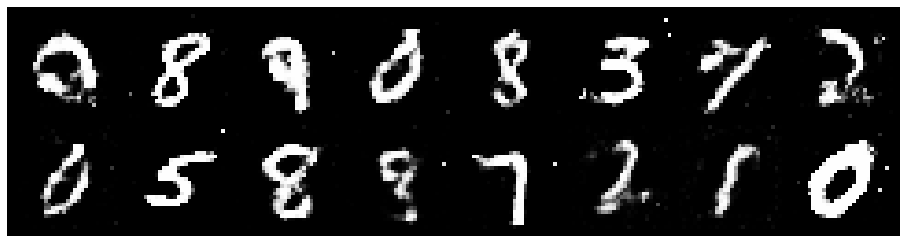

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2120, Generator Loss: 1.0163
D(x): 0.5850, D(G(z)): 0.4192


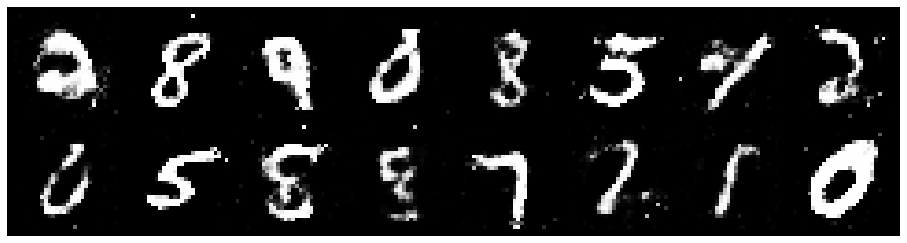

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2871, Generator Loss: 1.0321
D(x): 0.5742, D(G(z)): 0.4596


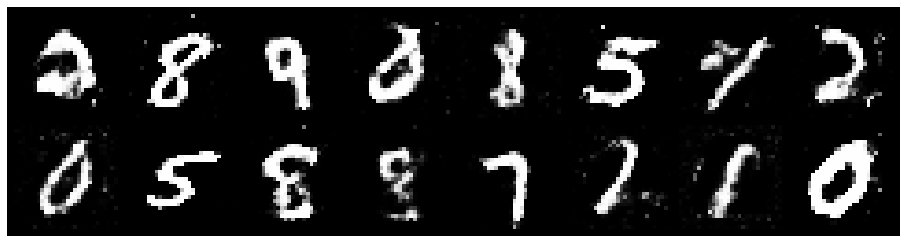

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.1346, Generator Loss: 0.9454
D(x): 0.5787, D(G(z)): 0.3884


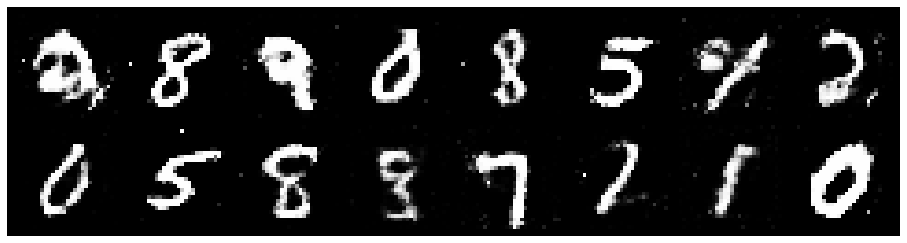

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2277, Generator Loss: 0.8085
D(x): 0.5944, D(G(z)): 0.4702


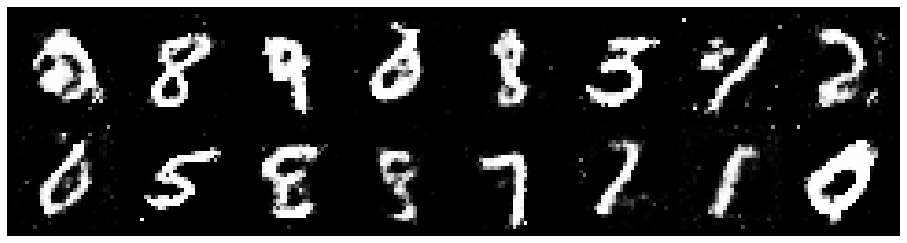

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2010, Generator Loss: 0.9777
D(x): 0.5781, D(G(z)): 0.4308


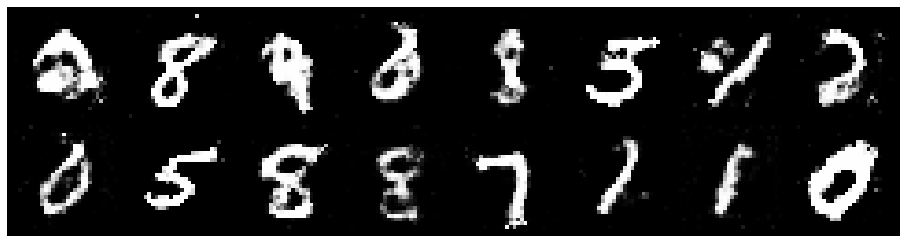

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.3564, Generator Loss: 0.8566
D(x): 0.5595, D(G(z)): 0.4772


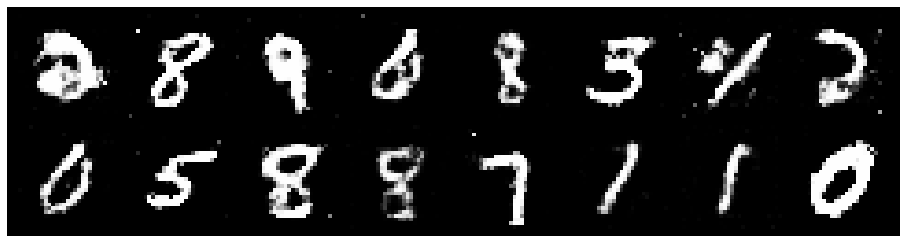

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2960, Generator Loss: 0.9660
D(x): 0.5645, D(G(z)): 0.4672


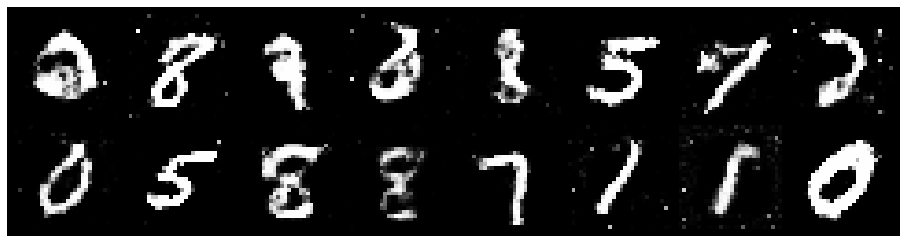

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8864
D(x): 0.5713, D(G(z)): 0.4436


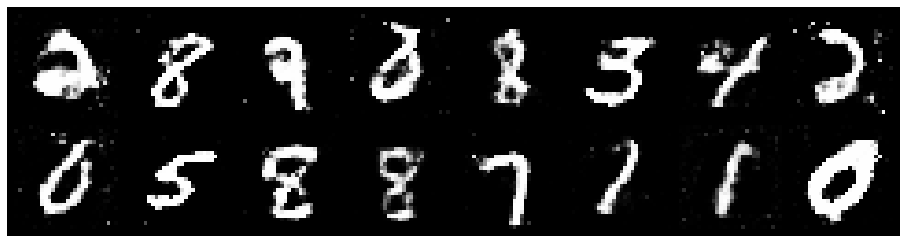

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.2097, Generator Loss: 0.8461
D(x): 0.5931, D(G(z)): 0.4357


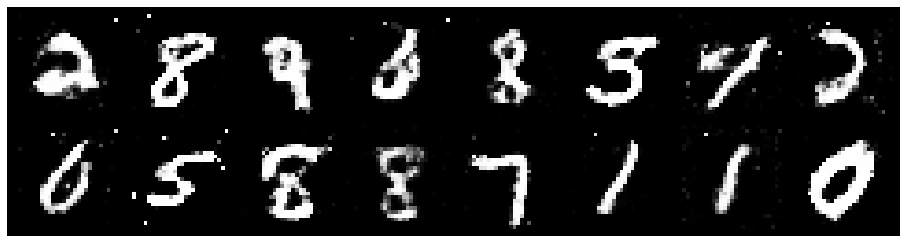

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2222, Generator Loss: 0.9730
D(x): 0.5478, D(G(z)): 0.4061


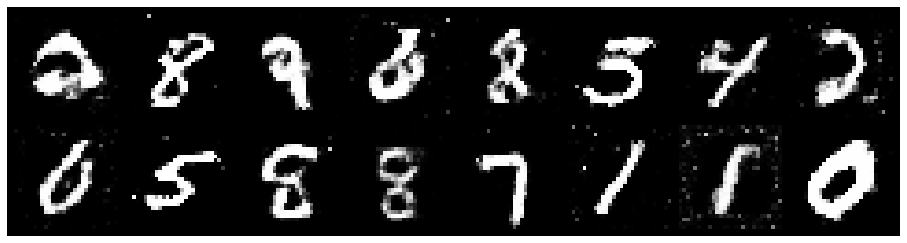

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.1521, Generator Loss: 0.9844
D(x): 0.5467, D(G(z)): 0.3781


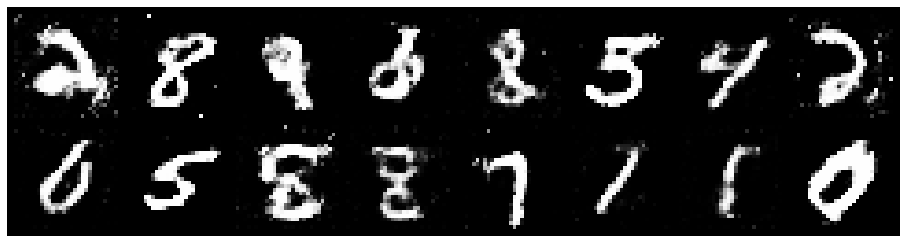

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2555, Generator Loss: 1.0120
D(x): 0.5478, D(G(z)): 0.4098


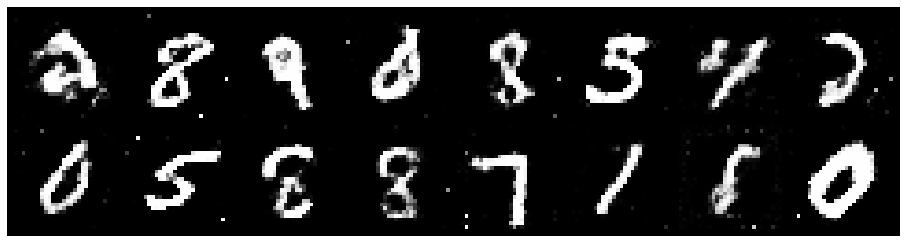

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2663, Generator Loss: 0.9929
D(x): 0.5483, D(G(z)): 0.4238


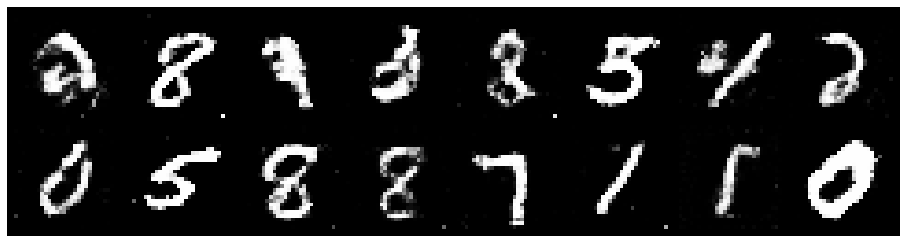

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2823, Generator Loss: 1.1803
D(x): 0.5476, D(G(z)): 0.4103


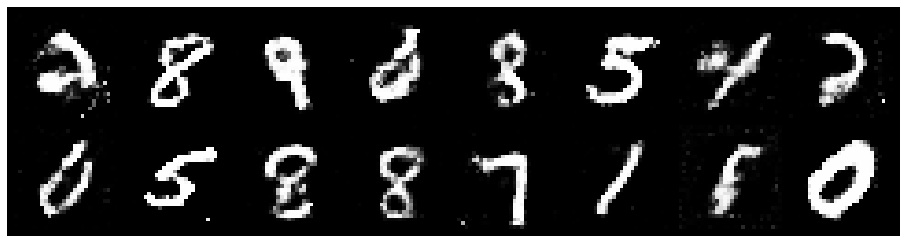

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.3054, Generator Loss: 0.9625
D(x): 0.5264, D(G(z)): 0.4258


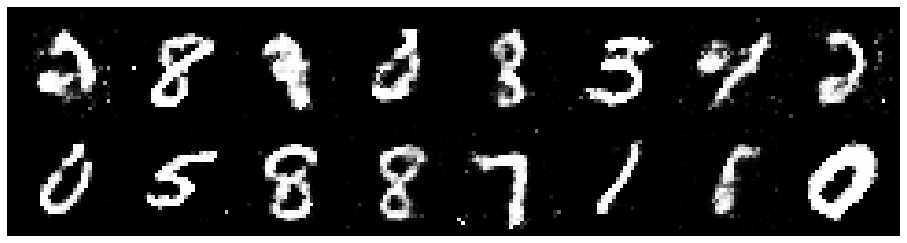

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.1469, Generator Loss: 1.0525
D(x): 0.5744, D(G(z)): 0.3893


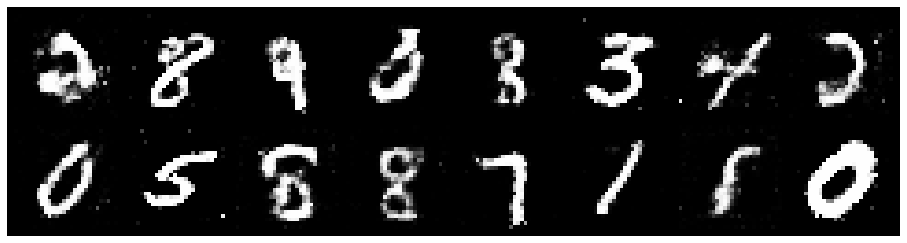

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.1880, Generator Loss: 0.9849
D(x): 0.5633, D(G(z)): 0.3934


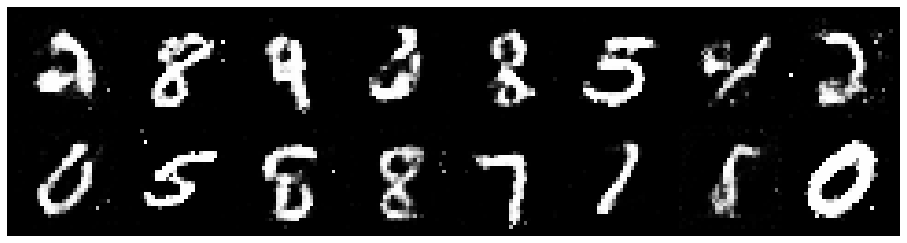

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.1620, Generator Loss: 1.1013
D(x): 0.6304, D(G(z)): 0.4289


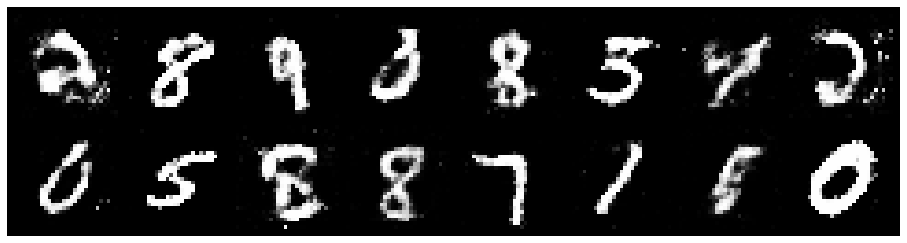

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1032, Generator Loss: 1.0154
D(x): 0.5949, D(G(z)): 0.3948


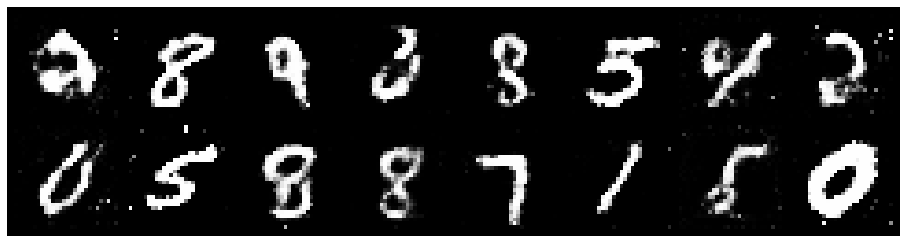

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.1677, Generator Loss: 0.8989
D(x): 0.5358, D(G(z)): 0.3758


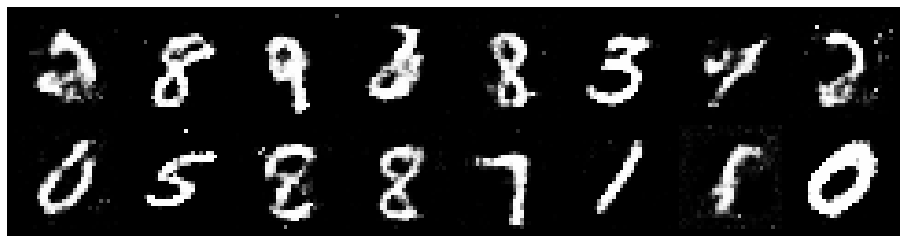

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2363, Generator Loss: 0.9038
D(x): 0.5403, D(G(z)): 0.4195


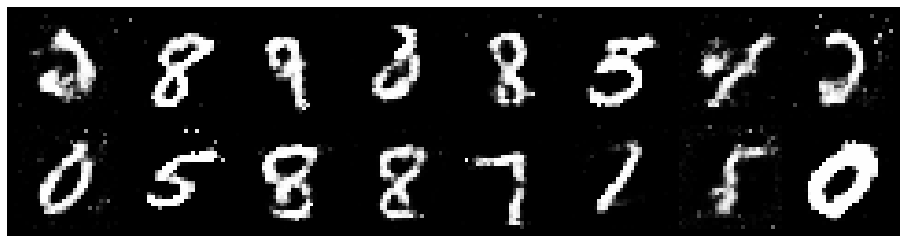

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.3005, Generator Loss: 0.8497
D(x): 0.5215, D(G(z)): 0.4271


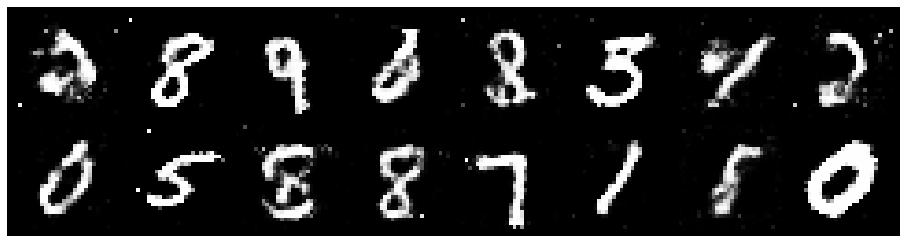

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2941, Generator Loss: 0.9830
D(x): 0.5279, D(G(z)): 0.4137


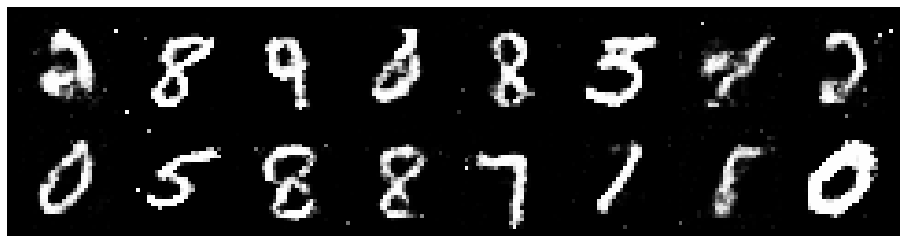

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.3155, Generator Loss: 0.8964
D(x): 0.5323, D(G(z)): 0.4474


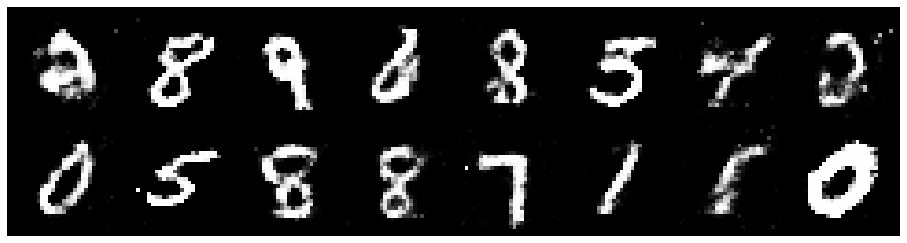

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3611, Generator Loss: 0.8600
D(x): 0.5386, D(G(z)): 0.4678


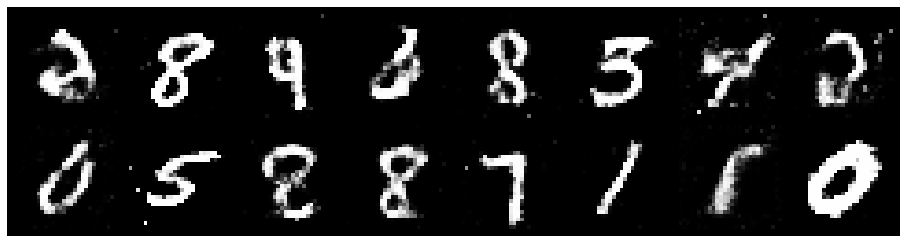

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2938, Generator Loss: 0.8619
D(x): 0.5405, D(G(z)): 0.4495


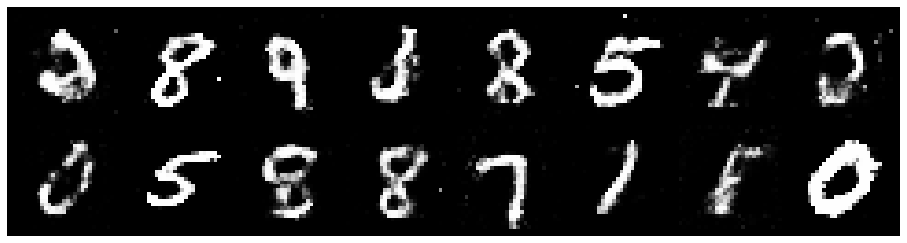

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2632, Generator Loss: 0.9872
D(x): 0.5398, D(G(z)): 0.4074


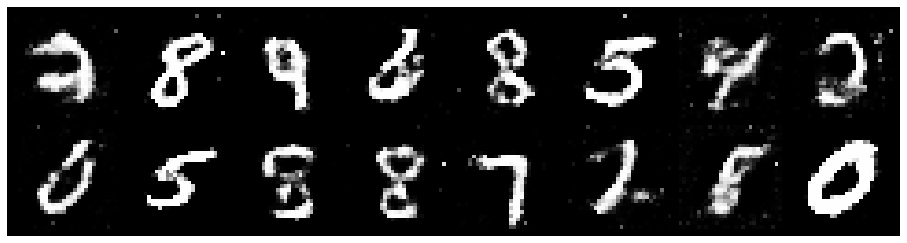

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.1479, Generator Loss: 0.9964
D(x): 0.5599, D(G(z)): 0.3755


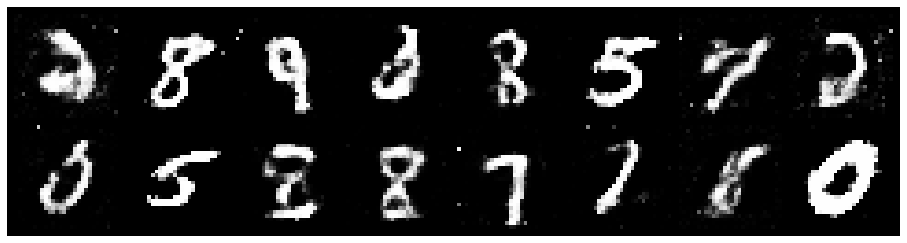

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2457, Generator Loss: 0.9106
D(x): 0.5643, D(G(z)): 0.3884


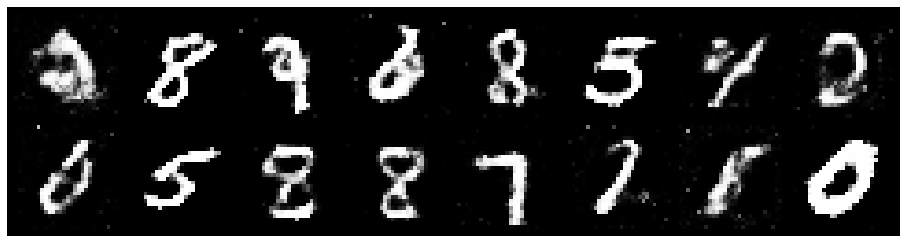

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2154, Generator Loss: 0.9439
D(x): 0.5534, D(G(z)): 0.4044


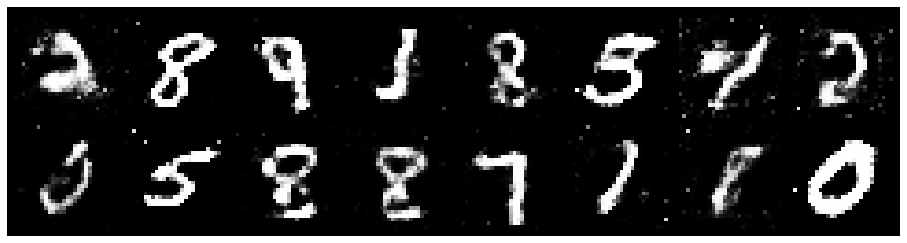

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2010, Generator Loss: 1.0136
D(x): 0.5782, D(G(z)): 0.4232


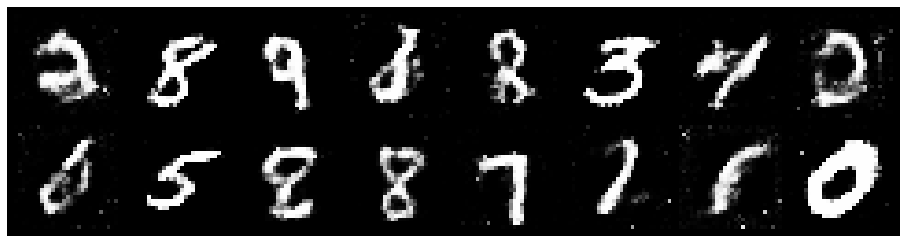

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.1671, Generator Loss: 0.8838
D(x): 0.5888, D(G(z)): 0.4319


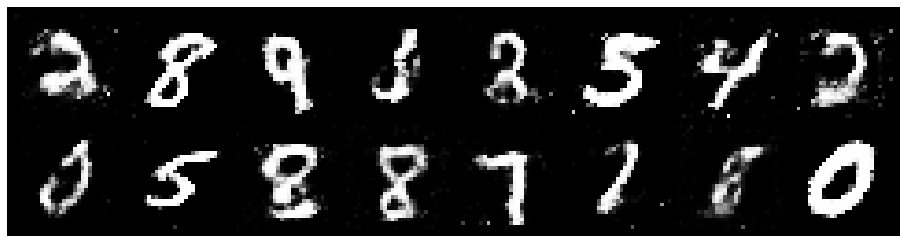

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2889, Generator Loss: 0.8616
D(x): 0.5530, D(G(z)): 0.4561


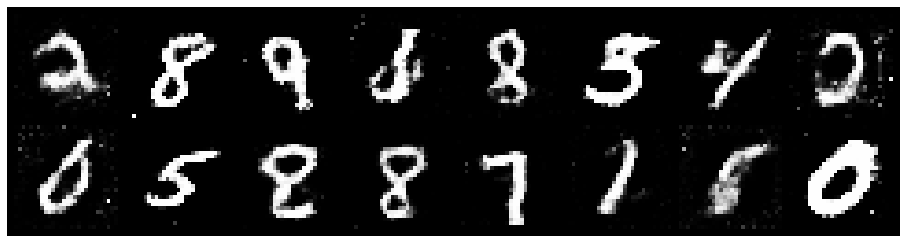

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2139, Generator Loss: 0.8798
D(x): 0.5913, D(G(z)): 0.4441


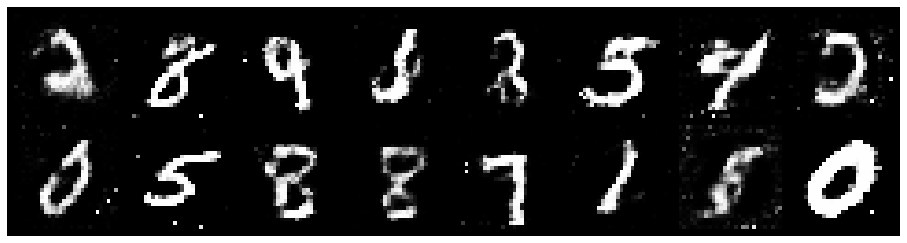

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.1629, Generator Loss: 1.0418
D(x): 0.5854, D(G(z)): 0.4337


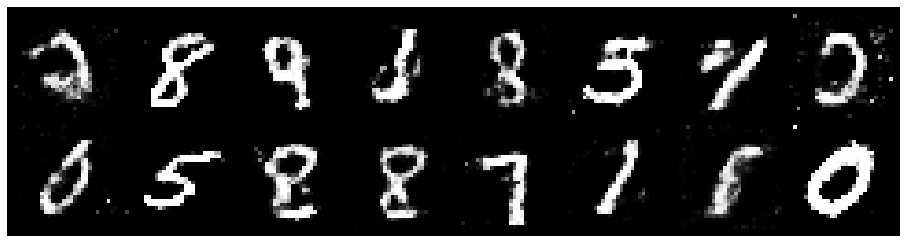

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2179, Generator Loss: 0.9428
D(x): 0.5606, D(G(z)): 0.4237


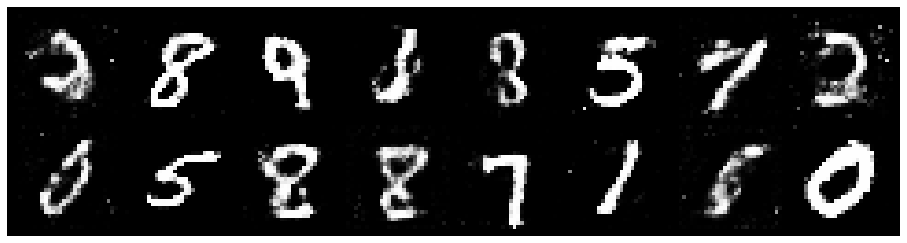

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.1550, Generator Loss: 0.9445
D(x): 0.5862, D(G(z)): 0.4150


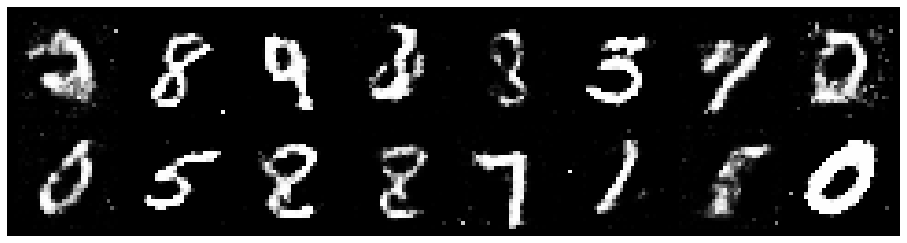

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.1244, Generator Loss: 1.1228
D(x): 0.5629, D(G(z)): 0.3629


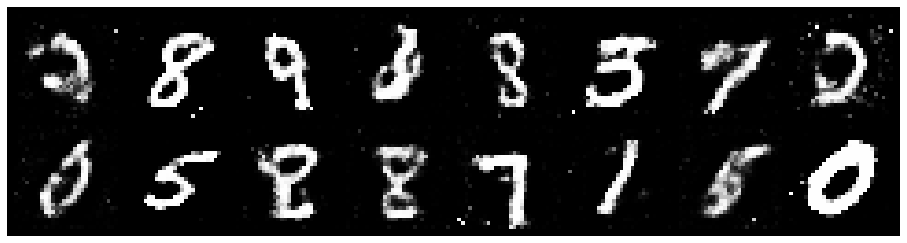

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2254, Generator Loss: 0.9682
D(x): 0.6121, D(G(z)): 0.4315


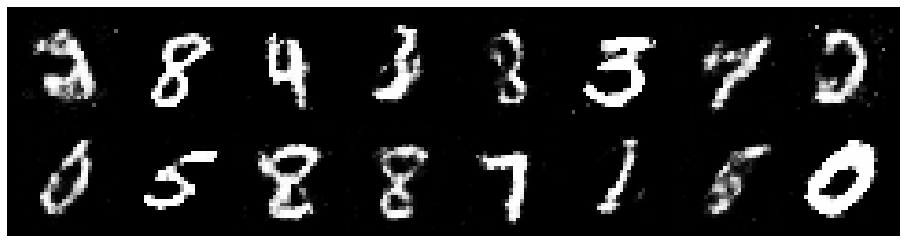

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.2020, Generator Loss: 0.9887
D(x): 0.5633, D(G(z)): 0.4261


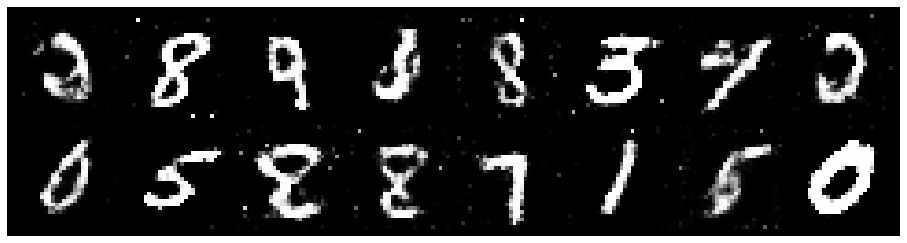

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.1880, Generator Loss: 0.8776
D(x): 0.5819, D(G(z)): 0.4188


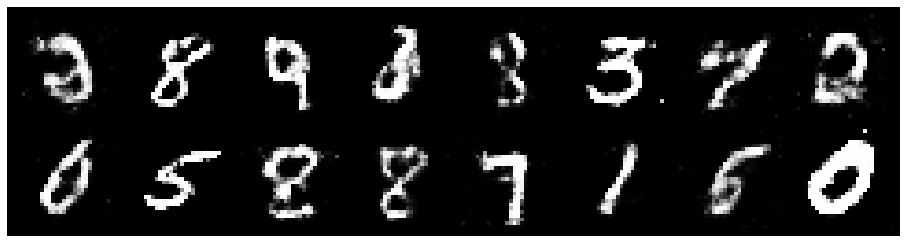

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.1469, Generator Loss: 0.9286
D(x): 0.5774, D(G(z)): 0.3819


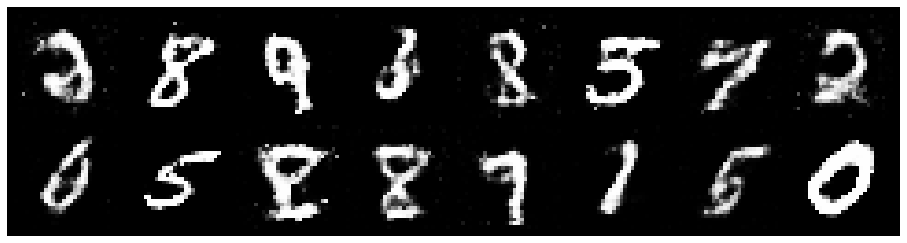

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2419, Generator Loss: 0.9241
D(x): 0.5544, D(G(z)): 0.4227


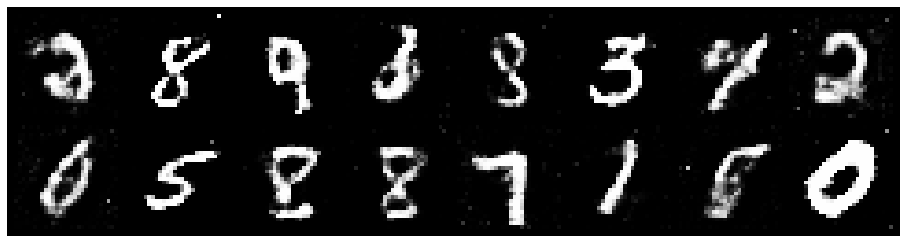

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2818, Generator Loss: 0.9097
D(x): 0.5521, D(G(z)): 0.4473


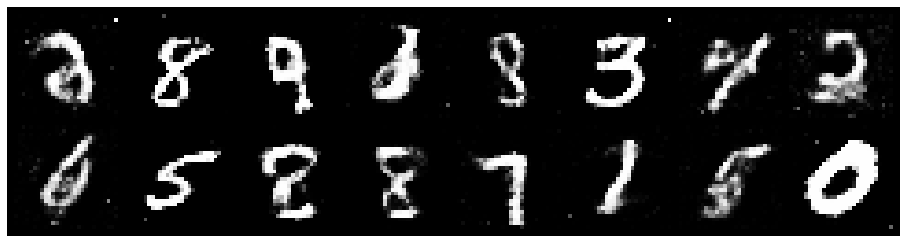

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.3513, Generator Loss: 0.8149
D(x): 0.5464, D(G(z)): 0.4799


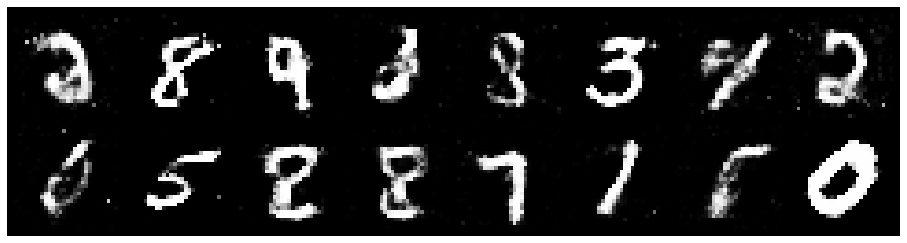

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2662, Generator Loss: 0.9372
D(x): 0.5377, D(G(z)): 0.4186


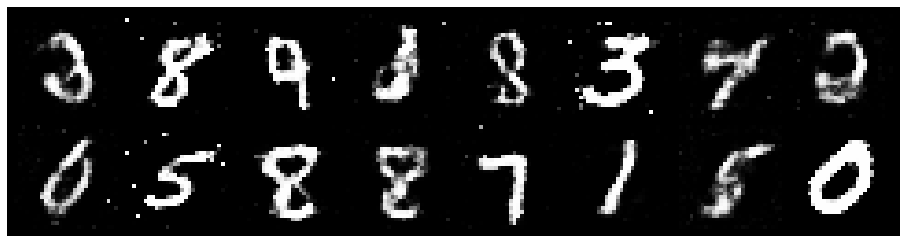

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3729, Generator Loss: 0.8464
D(x): 0.5562, D(G(z)): 0.4824


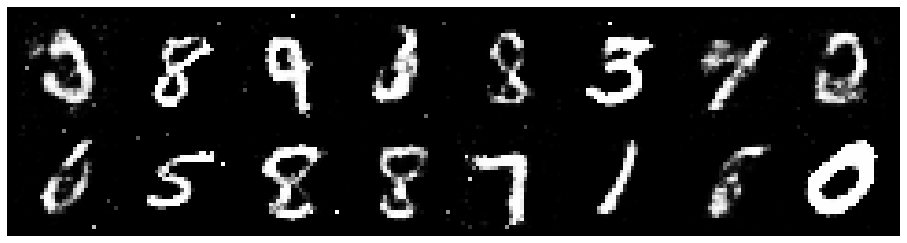

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2652, Generator Loss: 0.8844
D(x): 0.5581, D(G(z)): 0.4331


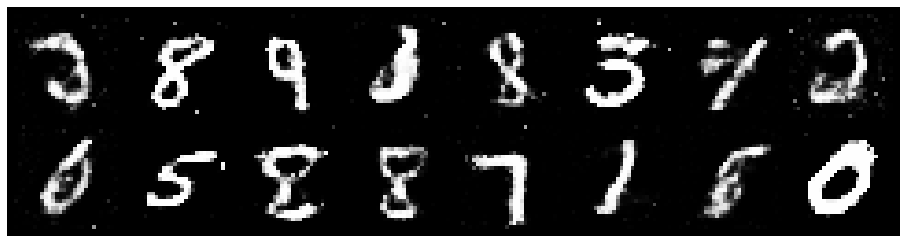

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2882, Generator Loss: 0.9458
D(x): 0.5265, D(G(z)): 0.4241


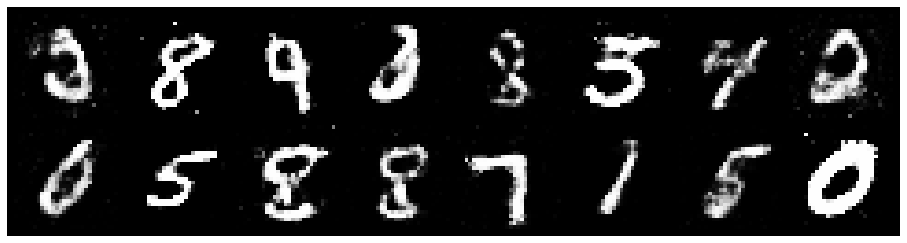

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.3447, Generator Loss: 0.8426
D(x): 0.5665, D(G(z)): 0.4782


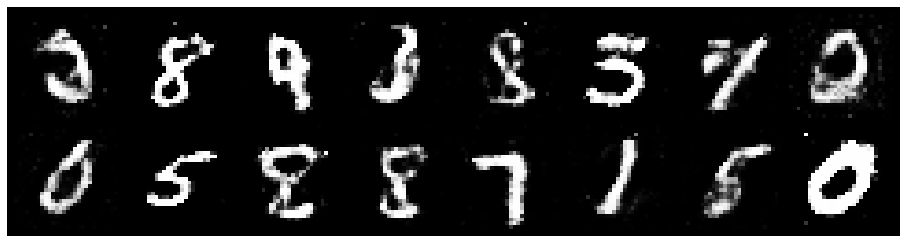

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.5001, Generator Loss: 0.8587
D(x): 0.4783, D(G(z)): 0.4729


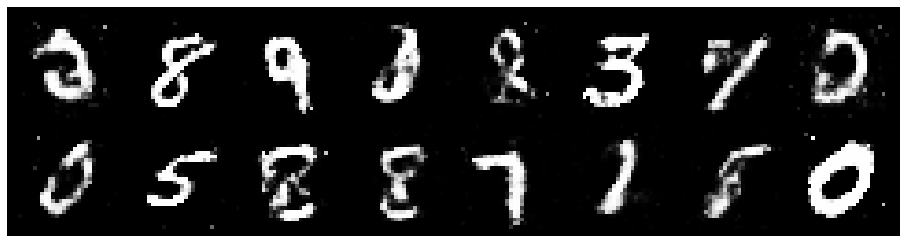

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.3608, Generator Loss: 0.9634
D(x): 0.5444, D(G(z)): 0.4588


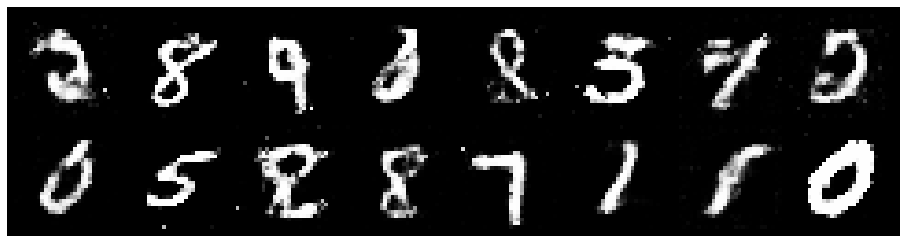

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.2610, Generator Loss: 0.7973
D(x): 0.5594, D(G(z)): 0.4492


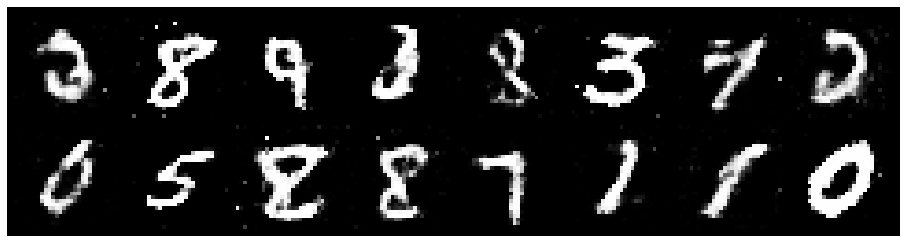

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2761, Generator Loss: 0.8179
D(x): 0.5551, D(G(z)): 0.4461


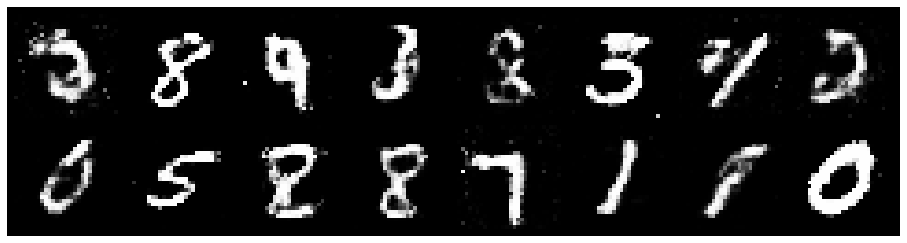

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.1967, Generator Loss: 0.8499
D(x): 0.5872, D(G(z)): 0.4386


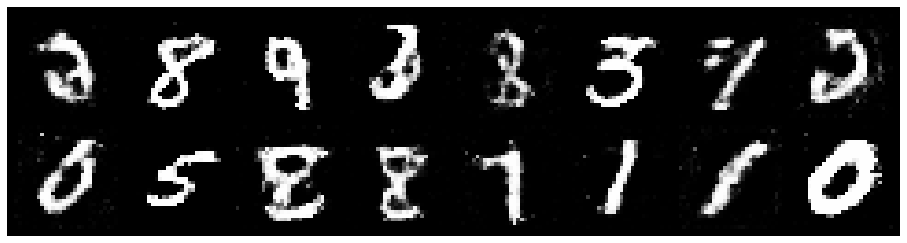

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2261, Generator Loss: 0.8502
D(x): 0.5729, D(G(z)): 0.4531


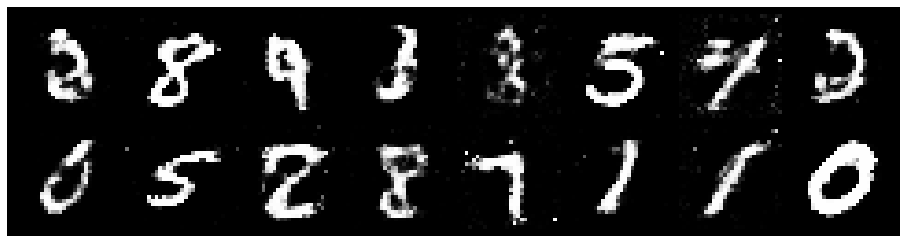

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2552, Generator Loss: 0.8318
D(x): 0.5976, D(G(z)): 0.4852


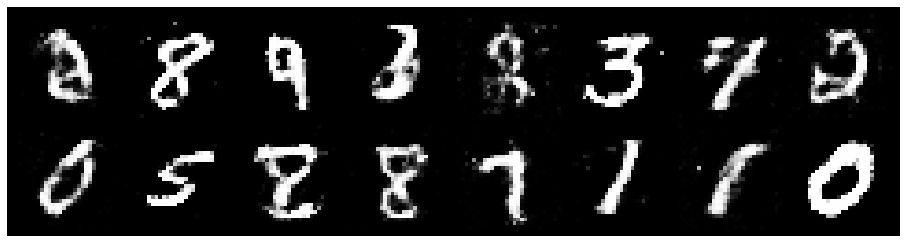

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2358, Generator Loss: 0.9807
D(x): 0.5723, D(G(z)): 0.4428


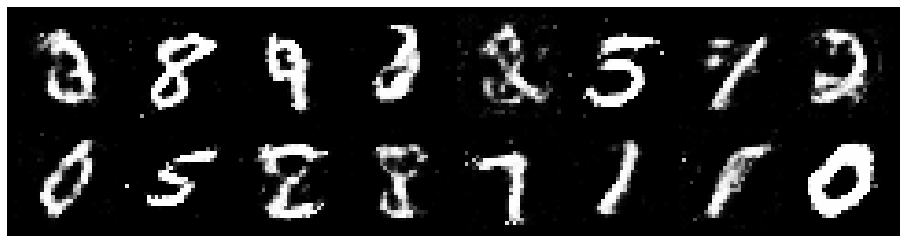

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.1584, Generator Loss: 1.0237
D(x): 0.6004, D(G(z)): 0.4030


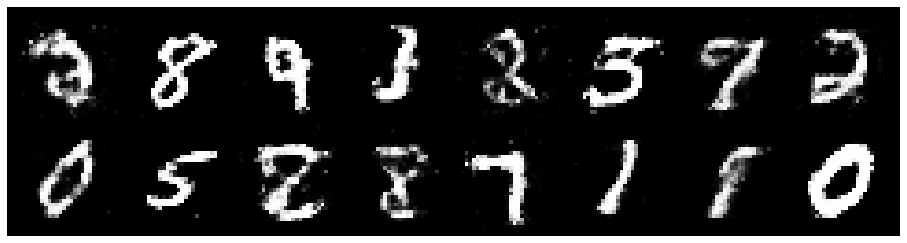

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.1687, Generator Loss: 0.9399
D(x): 0.5800, D(G(z)): 0.4253


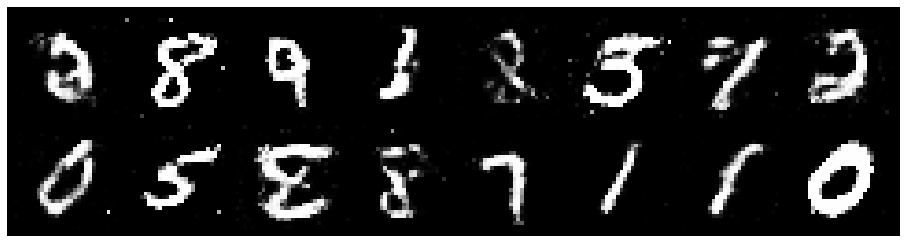

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.2426, Generator Loss: 0.9317
D(x): 0.5626, D(G(z)): 0.4414


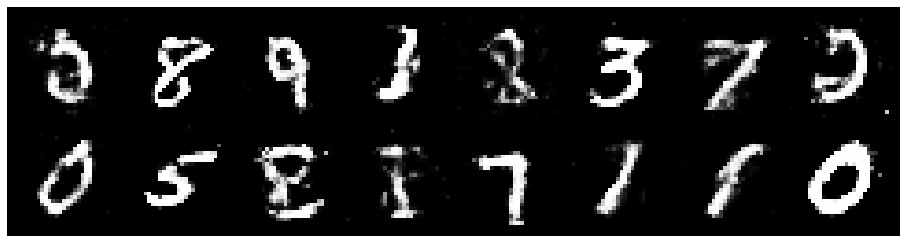

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2770, Generator Loss: 0.9043
D(x): 0.5360, D(G(z)): 0.4450


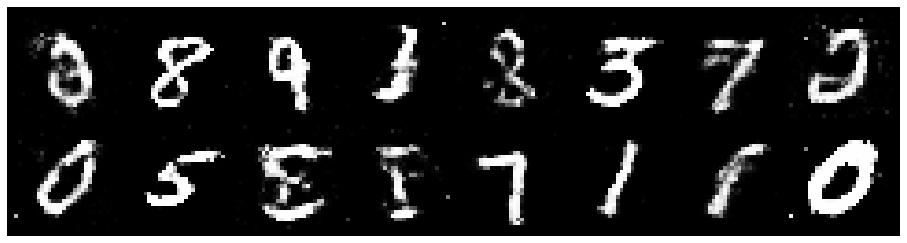

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3043, Generator Loss: 0.8686
D(x): 0.5553, D(G(z)): 0.4424


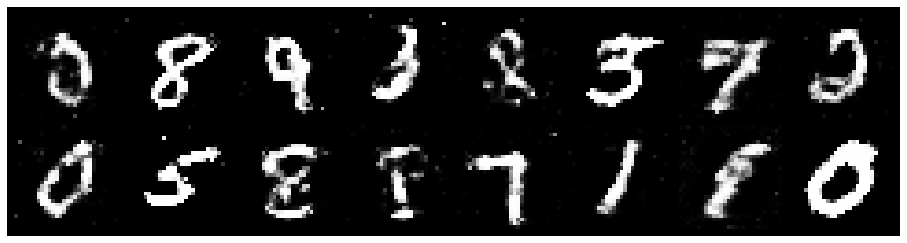

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2102, Generator Loss: 0.9851
D(x): 0.5432, D(G(z)): 0.4005


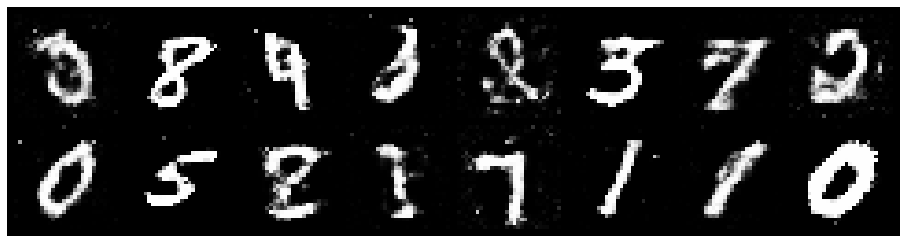

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.3106, Generator Loss: 0.9077
D(x): 0.5621, D(G(z)): 0.4349


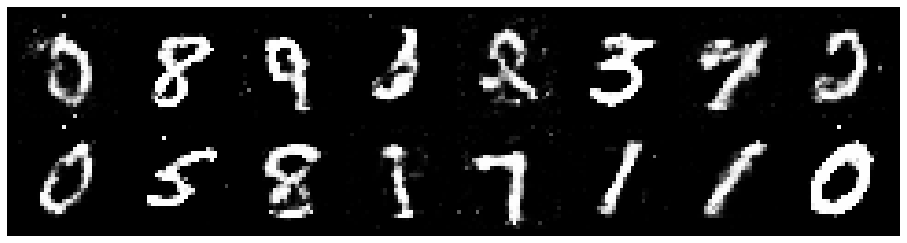

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2879, Generator Loss: 0.8966
D(x): 0.5308, D(G(z)): 0.4171


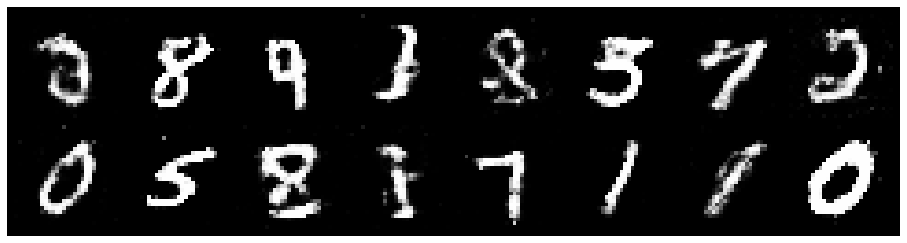

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.3356, Generator Loss: 0.9954
D(x): 0.5885, D(G(z)): 0.4595


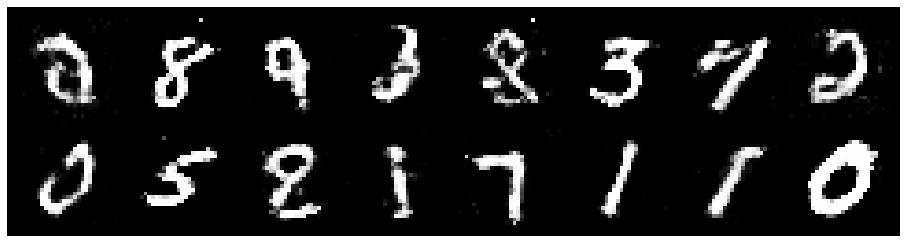

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.1812, Generator Loss: 0.7802
D(x): 0.6031, D(G(z)): 0.4241


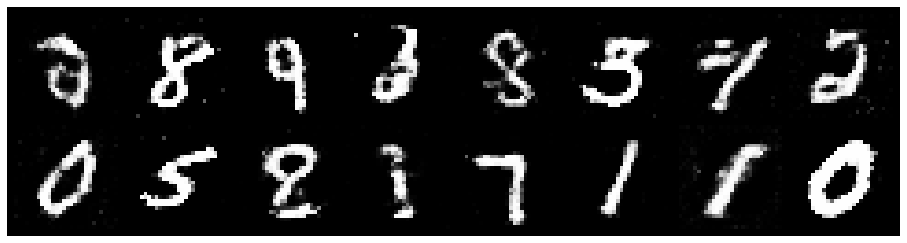

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.1376, Generator Loss: 0.8806
D(x): 0.6428, D(G(z)): 0.4577


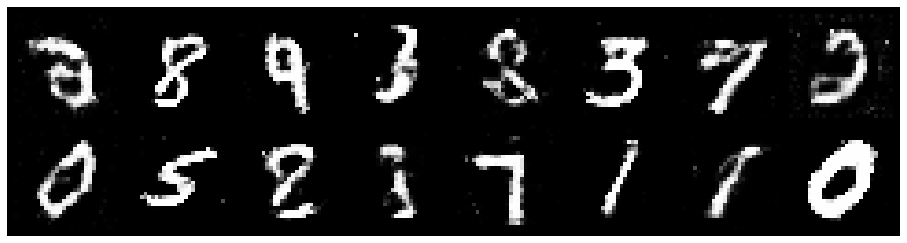

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.1769, Generator Loss: 0.9586
D(x): 0.5383, D(G(z)): 0.3764


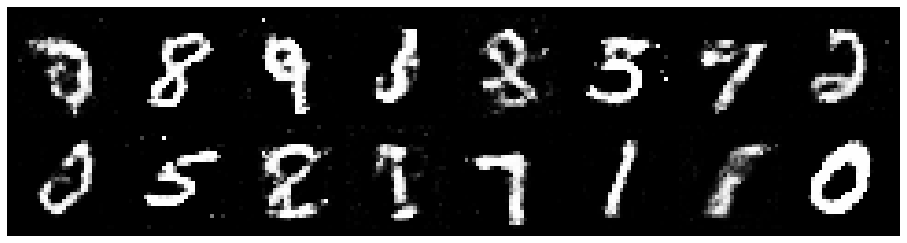

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2380, Generator Loss: 0.9194
D(x): 0.5690, D(G(z)): 0.4363


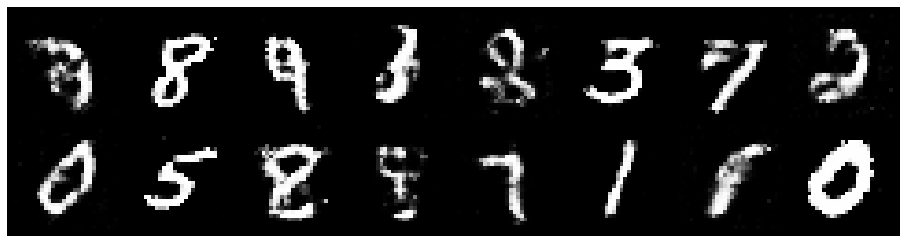

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.1978, Generator Loss: 1.0655
D(x): 0.5869, D(G(z)): 0.4179


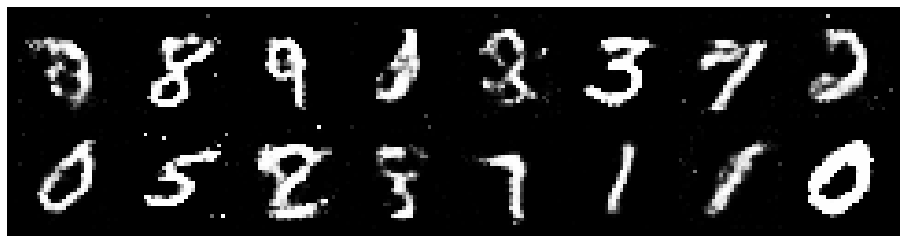

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2371, Generator Loss: 0.9066
D(x): 0.5519, D(G(z)): 0.4312


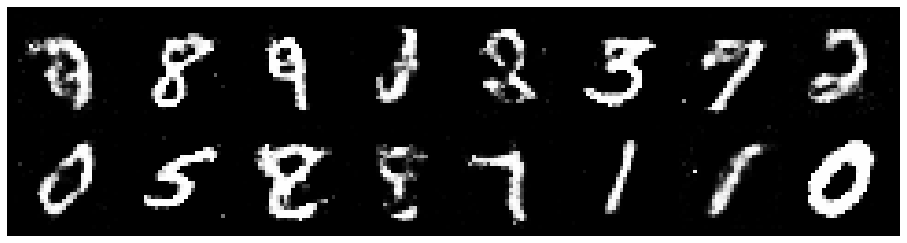

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.3063, Generator Loss: 0.9852
D(x): 0.5294, D(G(z)): 0.4143


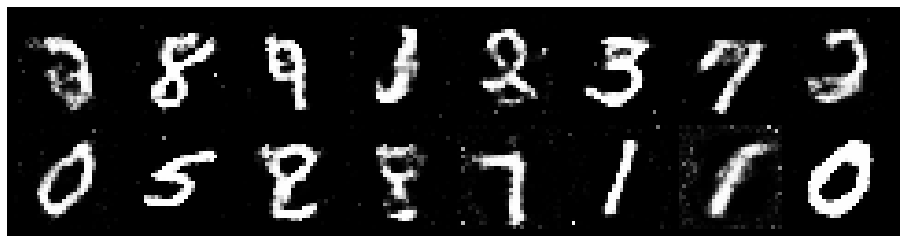

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.0871, Generator Loss: 1.0864
D(x): 0.6408, D(G(z)): 0.4046


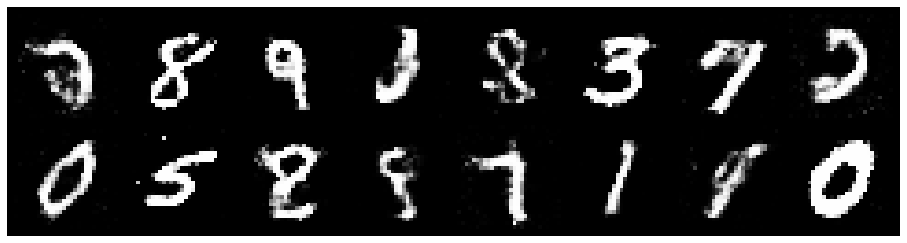

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2641, Generator Loss: 1.1148
D(x): 0.5744, D(G(z)): 0.4246


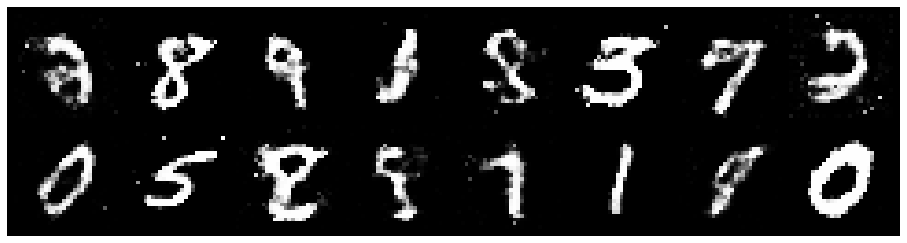

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.1296, Generator Loss: 0.8920
D(x): 0.6102, D(G(z)): 0.4223


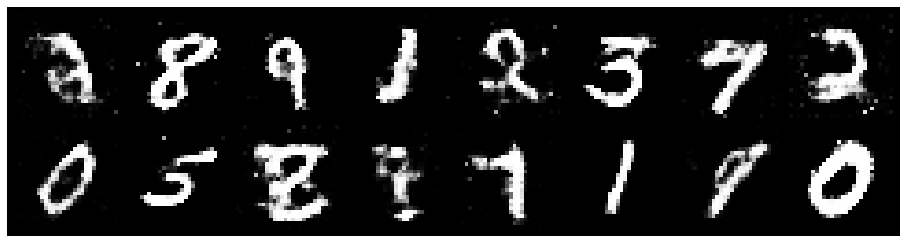

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.1338, Generator Loss: 1.0346
D(x): 0.5985, D(G(z)): 0.4081


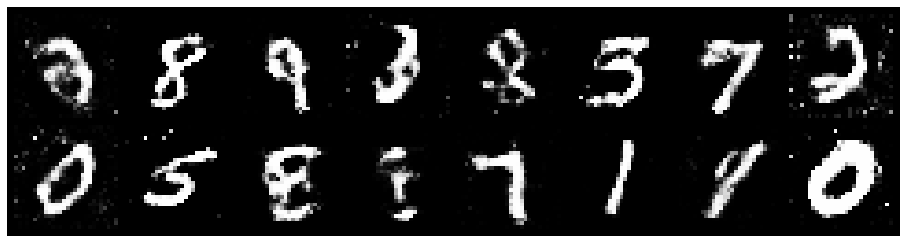

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2158, Generator Loss: 0.9158
D(x): 0.5979, D(G(z)): 0.4417


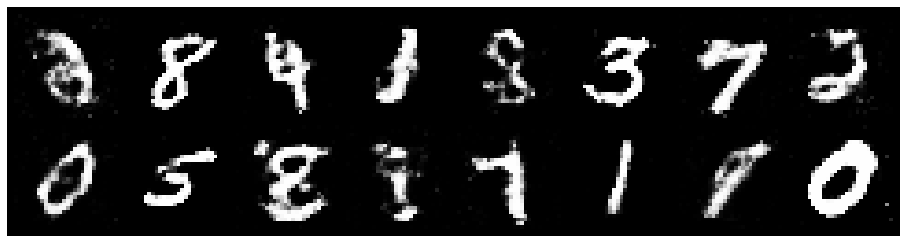

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2660, Generator Loss: 1.0224
D(x): 0.5820, D(G(z)): 0.4576


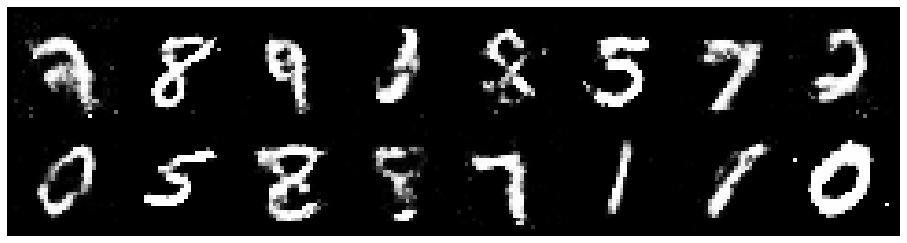

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.2519, Generator Loss: 0.8095
D(x): 0.5879, D(G(z)): 0.4596


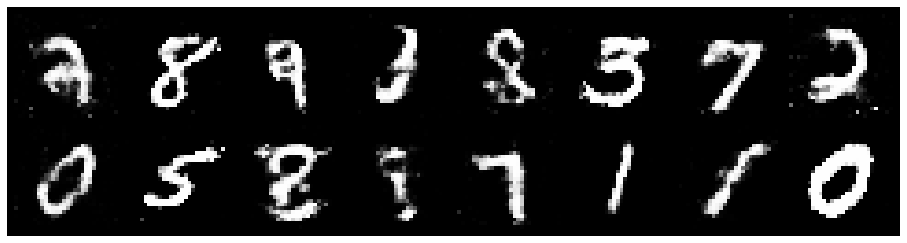

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2804, Generator Loss: 1.0367
D(x): 0.5536, D(G(z)): 0.4399


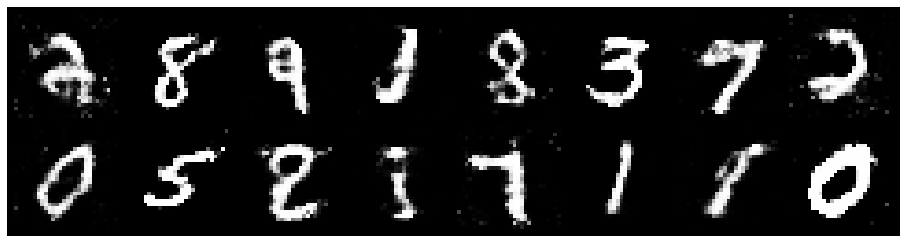

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.1838, Generator Loss: 0.9574
D(x): 0.5717, D(G(z)): 0.4218


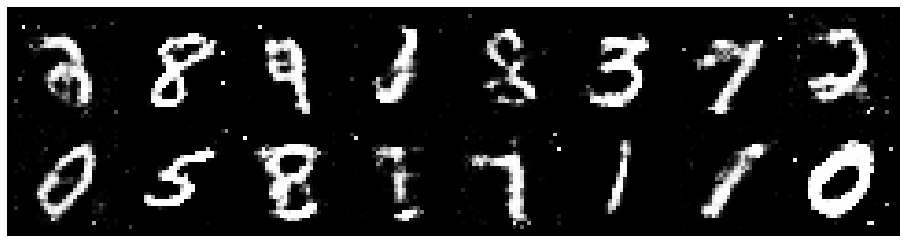

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2707, Generator Loss: 0.9515
D(x): 0.5571, D(G(z)): 0.4351


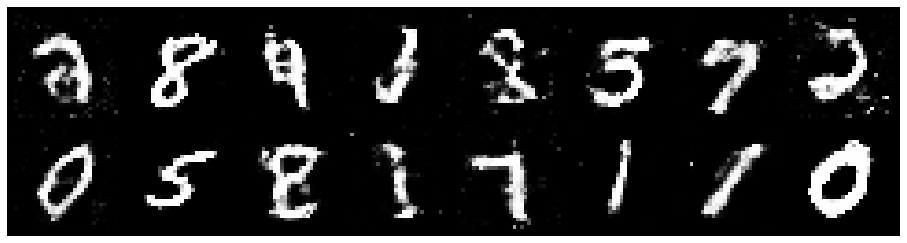

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.4621, Generator Loss: 0.8120
D(x): 0.4825, D(G(z)): 0.4396


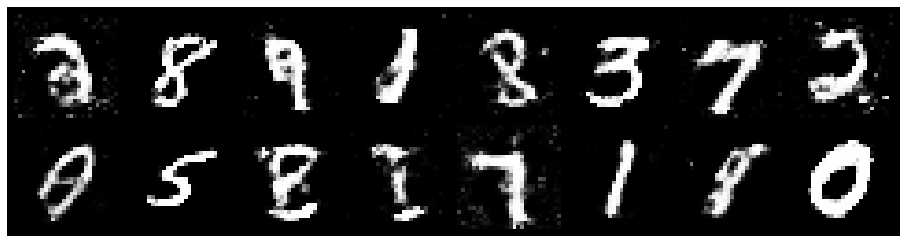

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3696, Generator Loss: 0.7583
D(x): 0.5487, D(G(z)): 0.4903


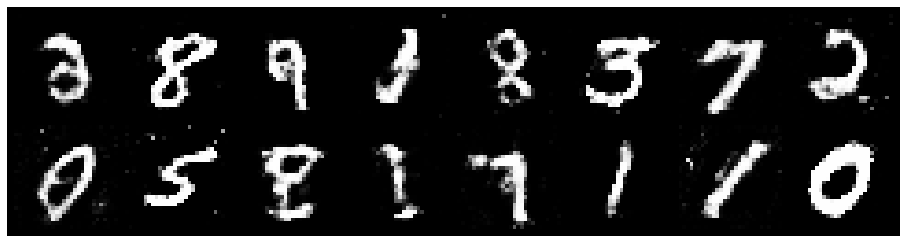

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.3125, Generator Loss: 0.8483
D(x): 0.5240, D(G(z)): 0.4358


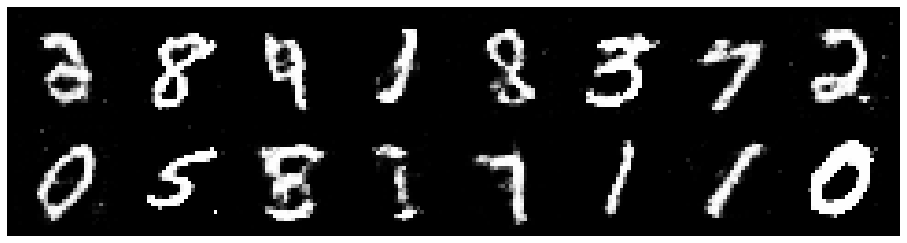

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2501, Generator Loss: 0.8901
D(x): 0.5608, D(G(z)): 0.4451


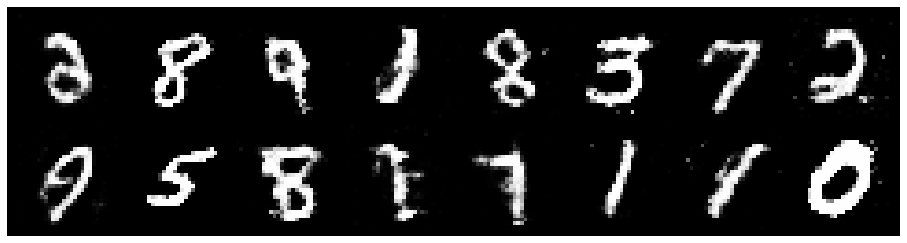

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2968, Generator Loss: 0.8996
D(x): 0.5349, D(G(z)): 0.4335


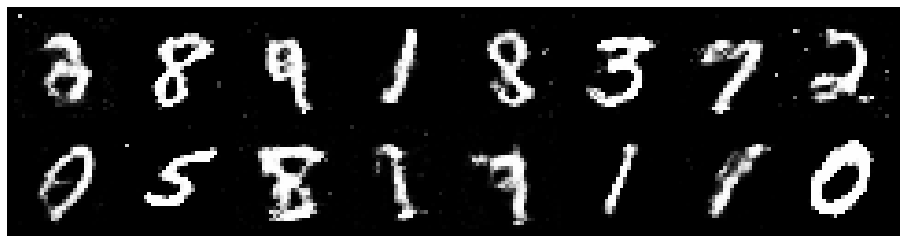

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.3109, Generator Loss: 0.9627
D(x): 0.4981, D(G(z)): 0.4183


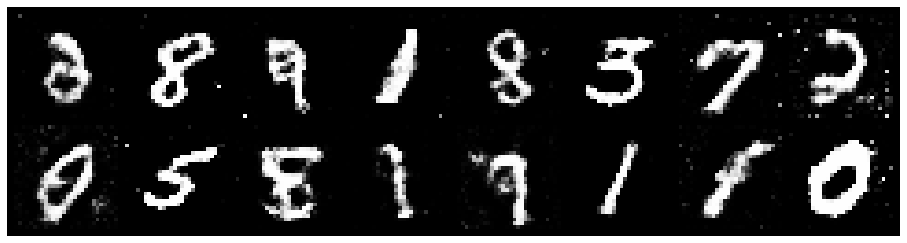

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2208, Generator Loss: 0.9202
D(x): 0.5653, D(G(z)): 0.4290


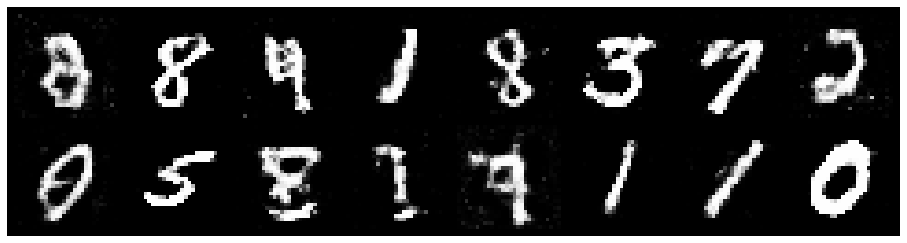

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.1743, Generator Loss: 0.9318
D(x): 0.5583, D(G(z)): 0.4004


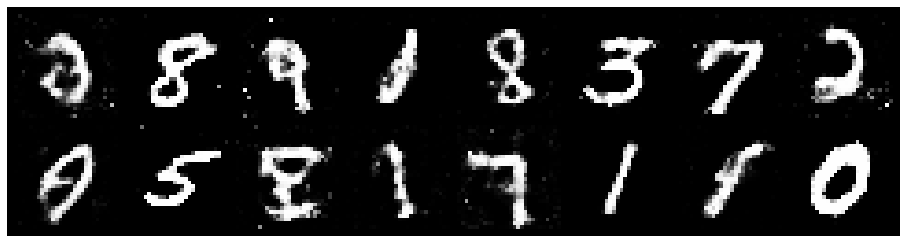

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.2448, Generator Loss: 0.8779
D(x): 0.5608, D(G(z)): 0.4350


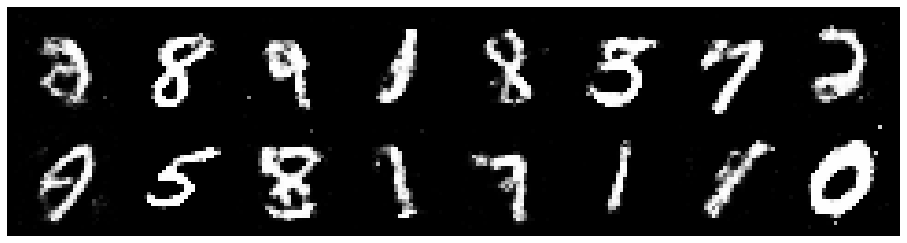

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.1564, Generator Loss: 1.0575
D(x): 0.5726, D(G(z)): 0.3771


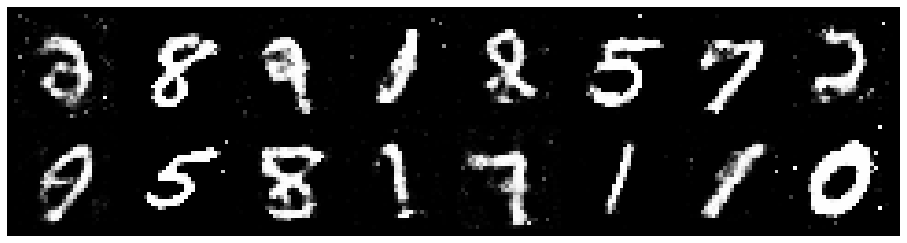

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.0479, Generator Loss: 1.1304
D(x): 0.6244, D(G(z)): 0.3708


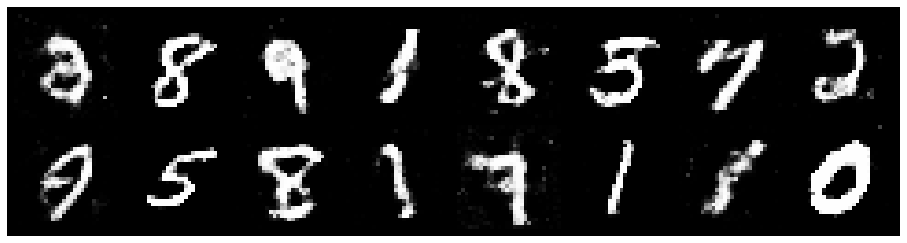

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.1638, Generator Loss: 1.0559
D(x): 0.5937, D(G(z)): 0.3993


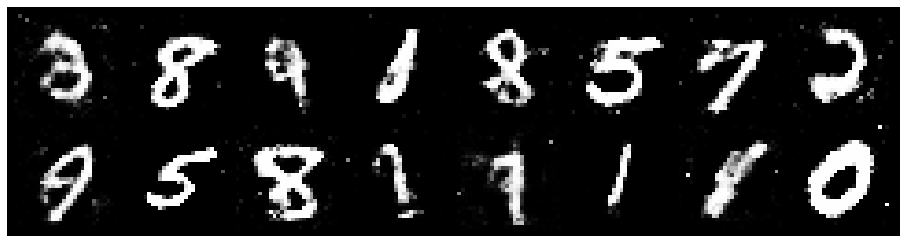

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.1614, Generator Loss: 1.0817
D(x): 0.5568, D(G(z)): 0.3855


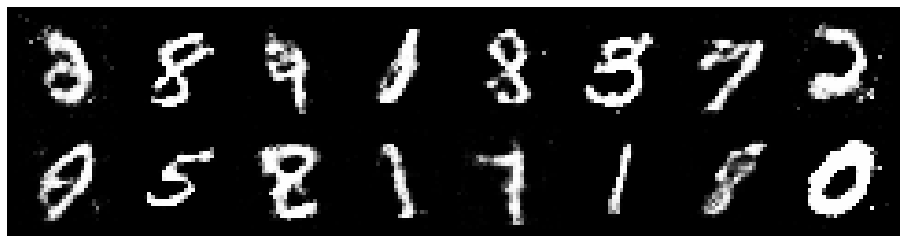

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.1353, Generator Loss: 0.9538
D(x): 0.5858, D(G(z)): 0.4058


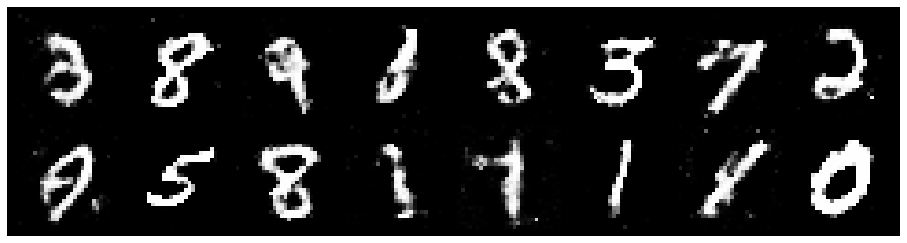

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.1974, Generator Loss: 0.8419
D(x): 0.5843, D(G(z)): 0.4521


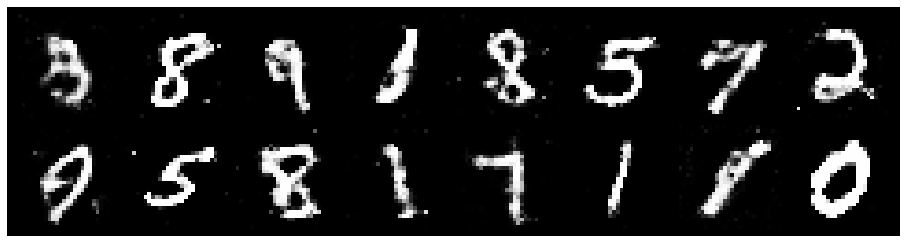

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2638, Generator Loss: 0.9229
D(x): 0.5643, D(G(z)): 0.4573


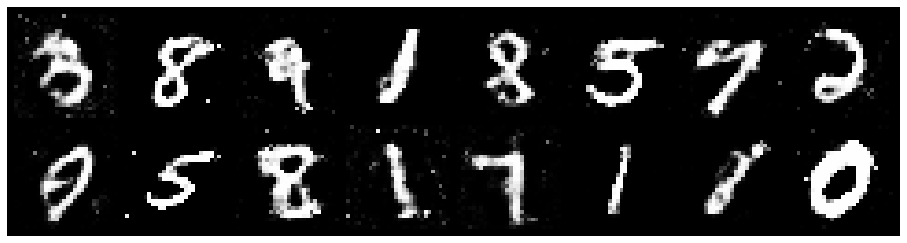

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.1674, Generator Loss: 0.9520
D(x): 0.5683, D(G(z)): 0.4031


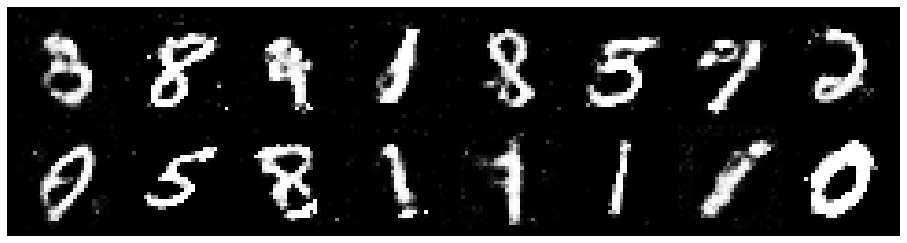

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2191, Generator Loss: 1.0728
D(x): 0.5410, D(G(z)): 0.3794


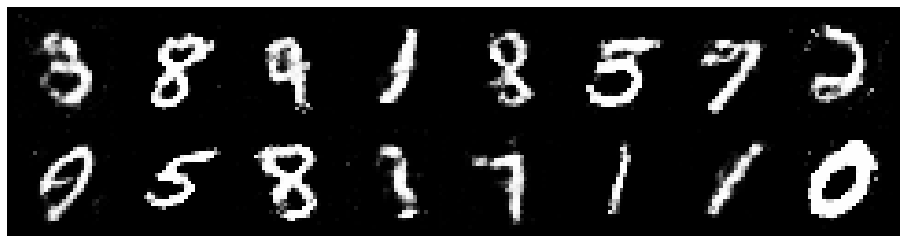

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8962
D(x): 0.5532, D(G(z)): 0.4486


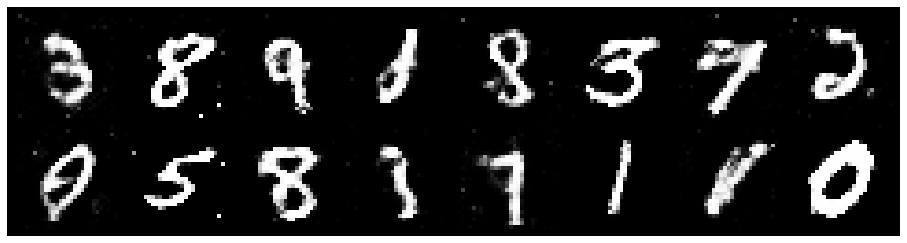

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.3158, Generator Loss: 0.8706
D(x): 0.5108, D(G(z)): 0.4301


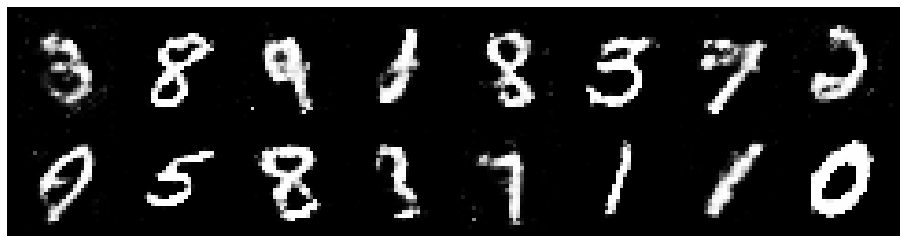

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.1761, Generator Loss: 0.8740
D(x): 0.5653, D(G(z)): 0.4174


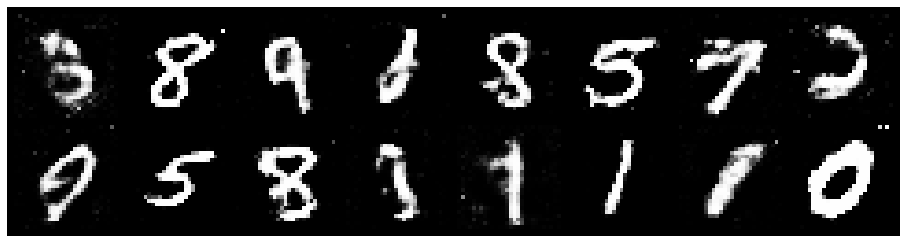

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.4077, Generator Loss: 0.8929
D(x): 0.5021, D(G(z)): 0.4588


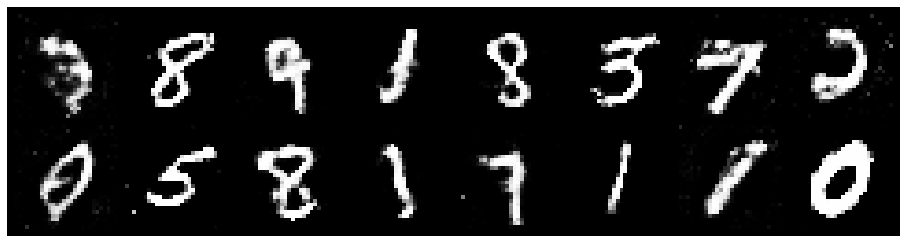

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3018, Generator Loss: 0.8675
D(x): 0.5726, D(G(z)): 0.4621


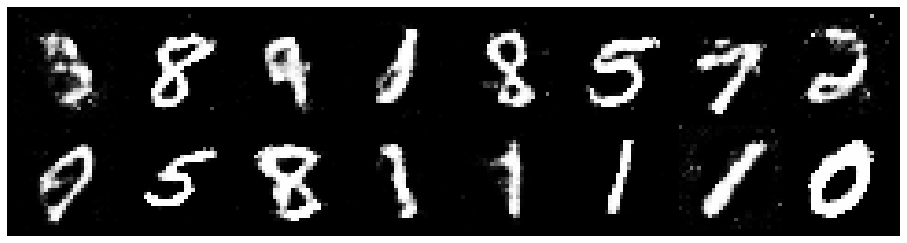

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2463, Generator Loss: 0.9166
D(x): 0.5460, D(G(z)): 0.4232


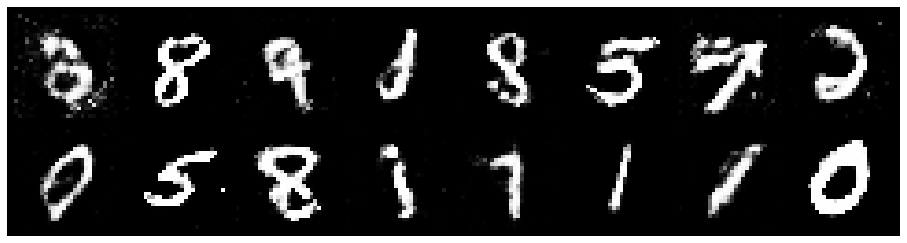

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2566, Generator Loss: 0.8442
D(x): 0.5875, D(G(z)): 0.4742


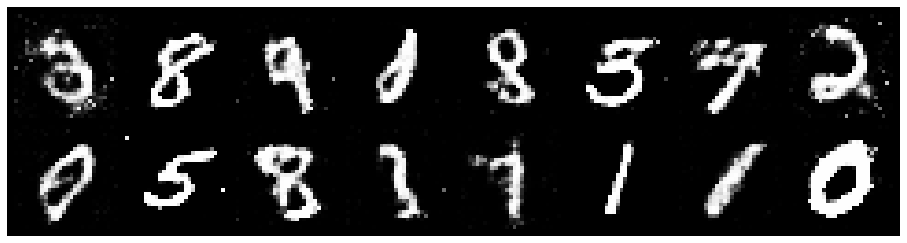

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2515, Generator Loss: 0.8760
D(x): 0.5354, D(G(z)): 0.4184


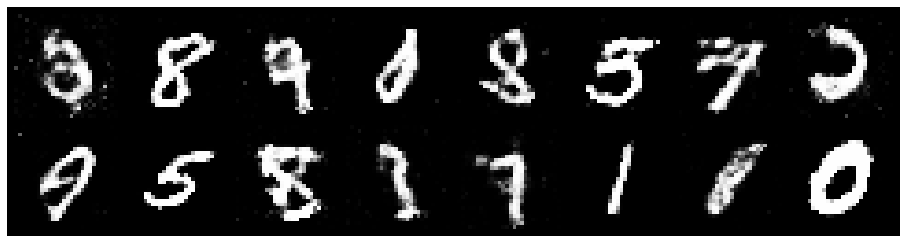

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.3313, Generator Loss: 0.7741
D(x): 0.5703, D(G(z)): 0.4997


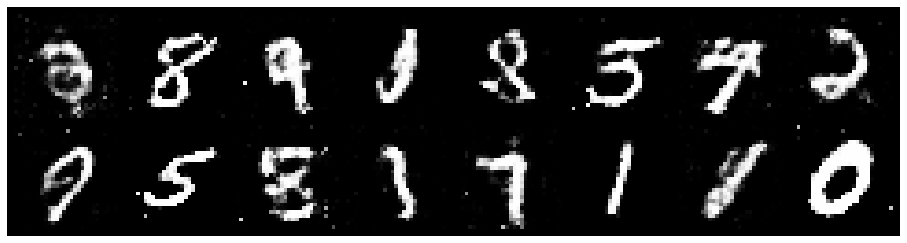

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3591, Generator Loss: 0.8632
D(x): 0.5051, D(G(z)): 0.4352


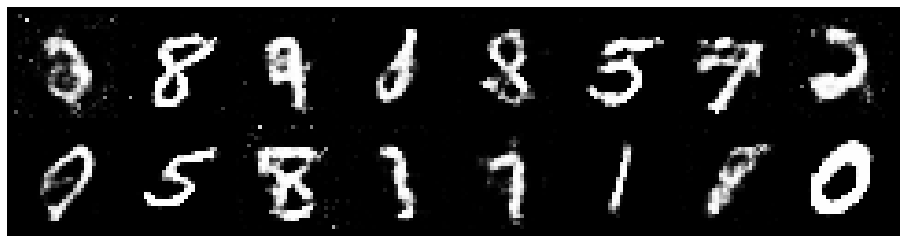

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2182, Generator Loss: 0.8176
D(x): 0.5555, D(G(z)): 0.4186


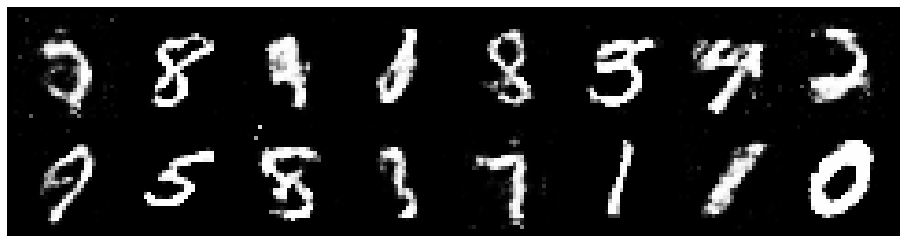

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3675, Generator Loss: 0.8105
D(x): 0.5380, D(G(z)): 0.4729


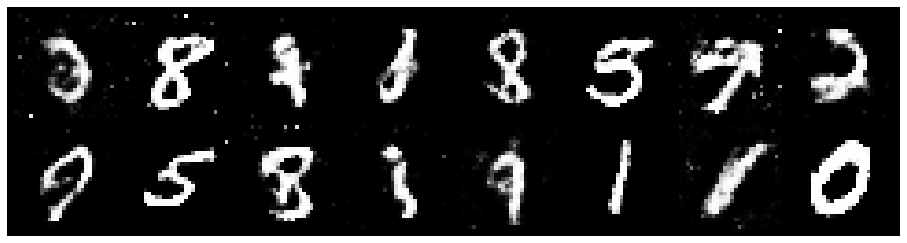

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.3331, Generator Loss: 0.8070
D(x): 0.5639, D(G(z)): 0.4936


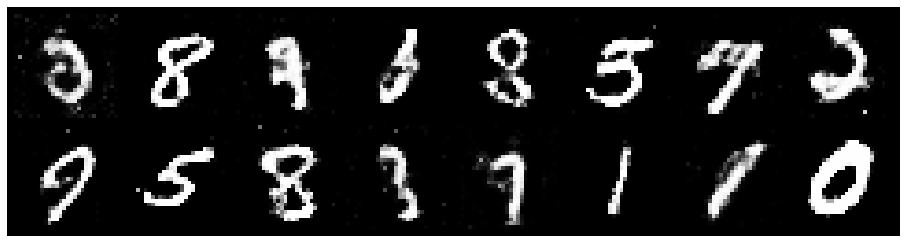

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.3232, Generator Loss: 0.8490
D(x): 0.5423, D(G(z)): 0.4606


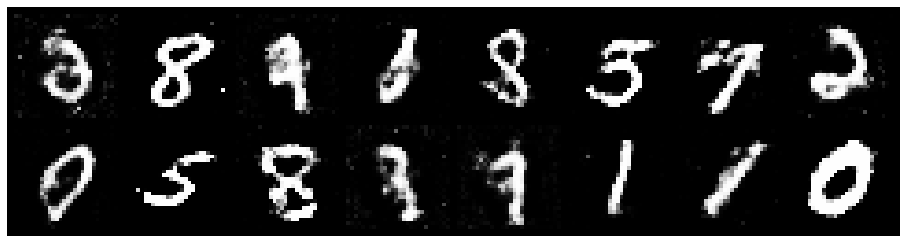

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.1273, Generator Loss: 0.9547
D(x): 0.5851, D(G(z)): 0.3981


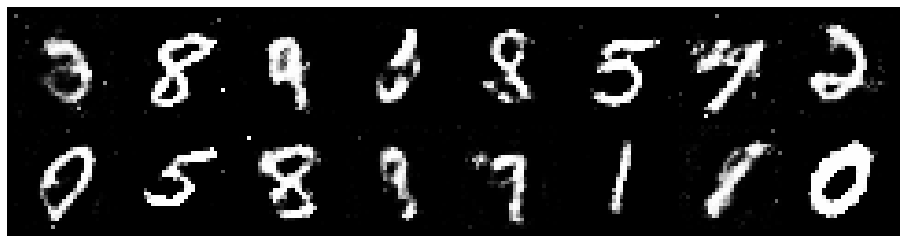

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.1379, Generator Loss: 1.0208
D(x): 0.6111, D(G(z)): 0.4118


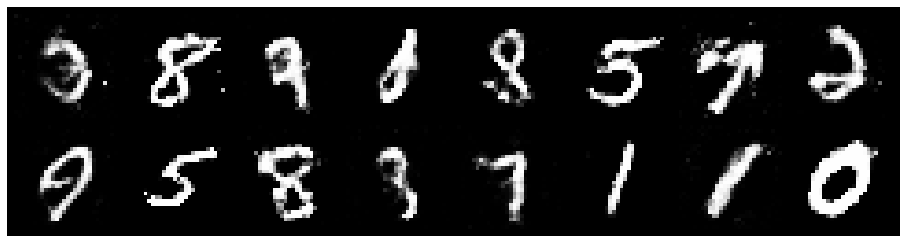

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2854, Generator Loss: 0.9070
D(x): 0.5428, D(G(z)): 0.4485


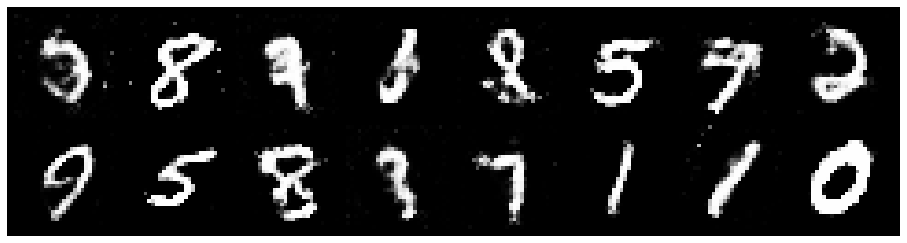

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.3028, Generator Loss: 0.8897
D(x): 0.5505, D(G(z)): 0.4587


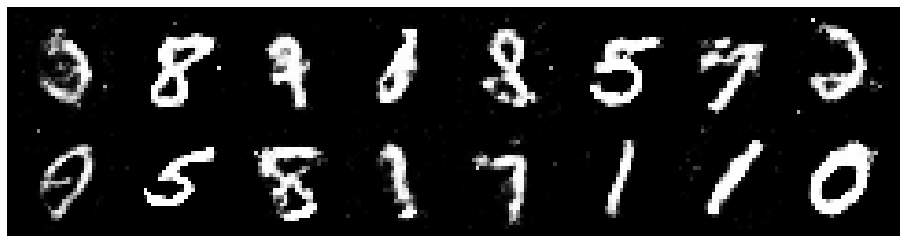

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2799, Generator Loss: 0.8337
D(x): 0.5546, D(G(z)): 0.4512


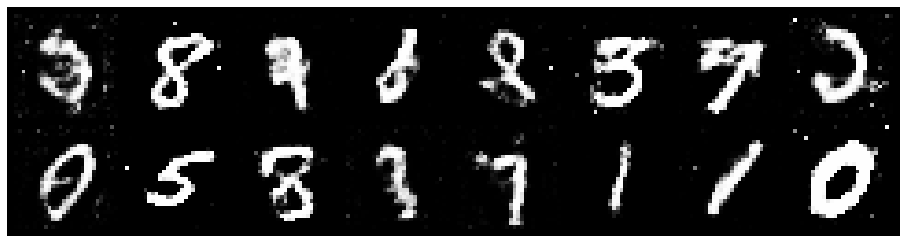

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.1918, Generator Loss: 0.9229
D(x): 0.5764, D(G(z)): 0.4300


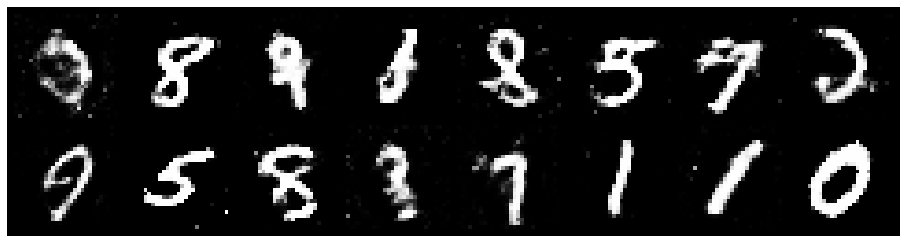

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.3275, Generator Loss: 0.8755
D(x): 0.5764, D(G(z)): 0.4748


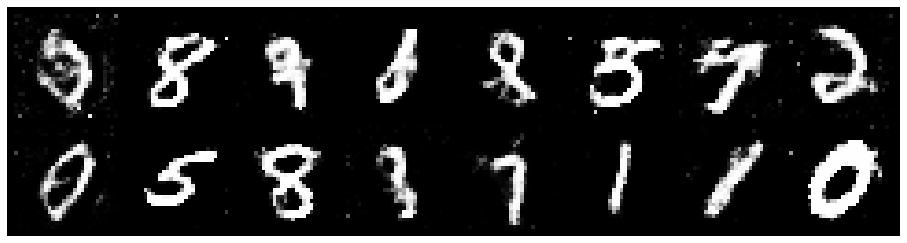

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.4271, Generator Loss: 0.7920
D(x): 0.5427, D(G(z)): 0.4778


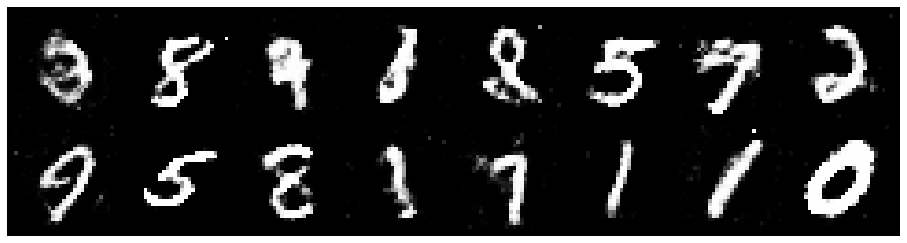

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.4555, Generator Loss: 0.9742
D(x): 0.5144, D(G(z)): 0.4532


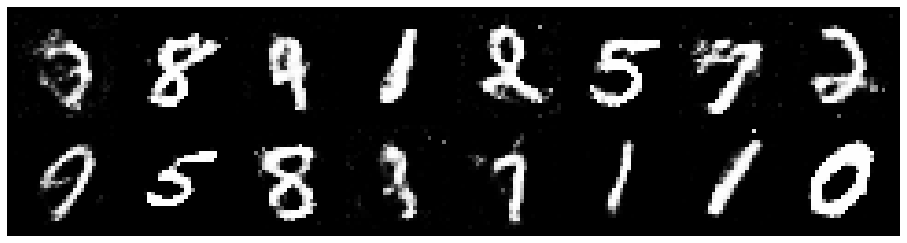

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3879, Generator Loss: 0.9746
D(x): 0.5498, D(G(z)): 0.4752


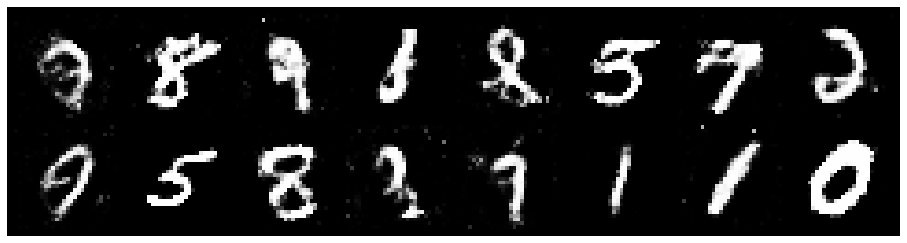

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2634, Generator Loss: 0.8991
D(x): 0.5742, D(G(z)): 0.4505


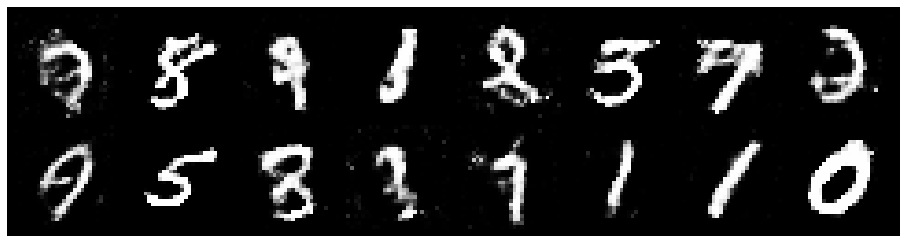

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3464, Generator Loss: 0.8763
D(x): 0.5310, D(G(z)): 0.4514


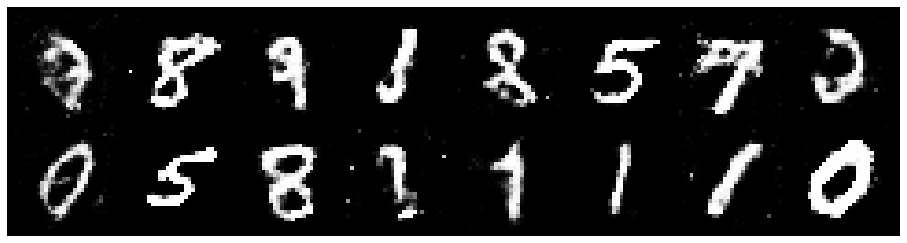

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.1908, Generator Loss: 0.9378
D(x): 0.5484, D(G(z)): 0.3847


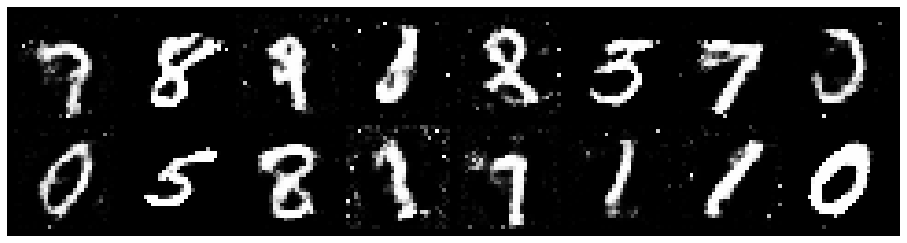

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2057, Generator Loss: 0.9468
D(x): 0.5772, D(G(z)): 0.4393


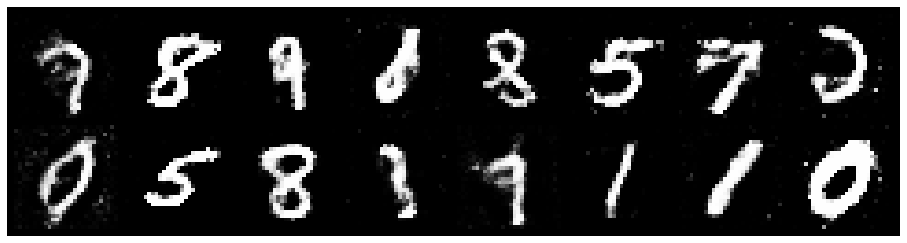

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2582, Generator Loss: 0.9185
D(x): 0.5761, D(G(z)): 0.4494


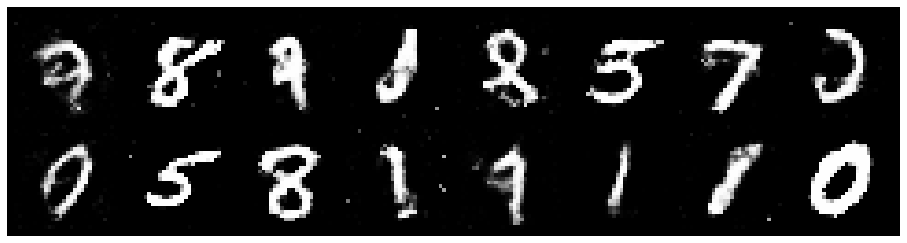

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2628, Generator Loss: 0.9014
D(x): 0.5450, D(G(z)): 0.4111


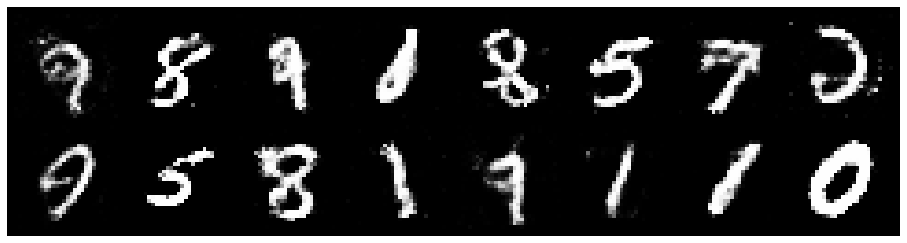

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2192, Generator Loss: 0.9301
D(x): 0.5844, D(G(z)): 0.4411


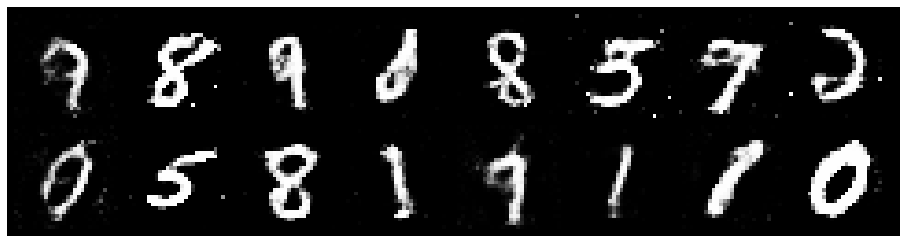

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.3091, Generator Loss: 1.0383
D(x): 0.5333, D(G(z)): 0.4356


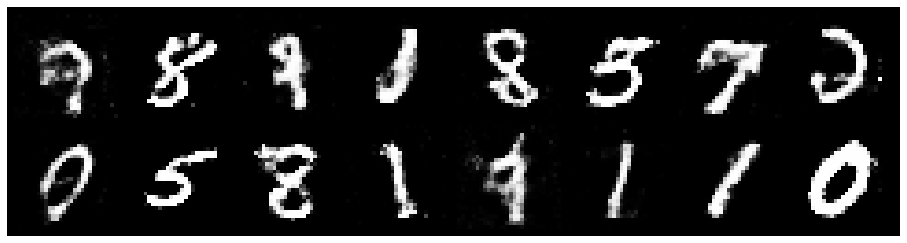

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.1819, Generator Loss: 1.1396
D(x): 0.5633, D(G(z)): 0.3943


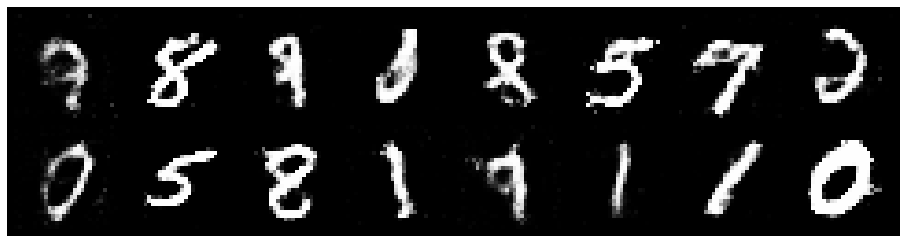

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.3103, Generator Loss: 0.8745
D(x): 0.5303, D(G(z)): 0.4250


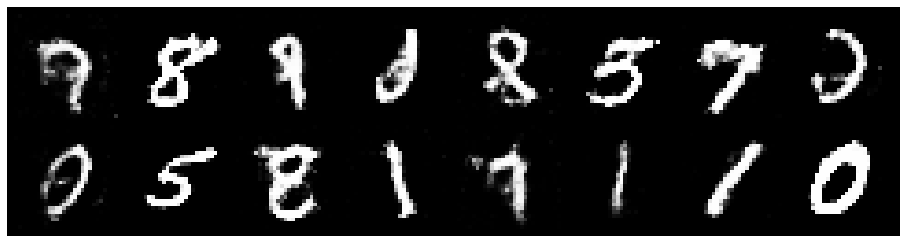

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.1910, Generator Loss: 0.9486
D(x): 0.5926, D(G(z)): 0.4344


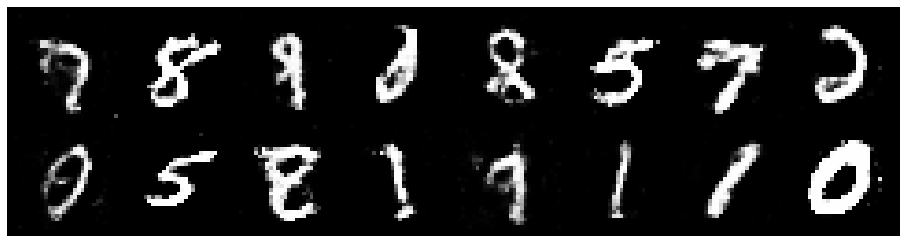

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3236, Generator Loss: 0.8778
D(x): 0.5568, D(G(z)): 0.4713


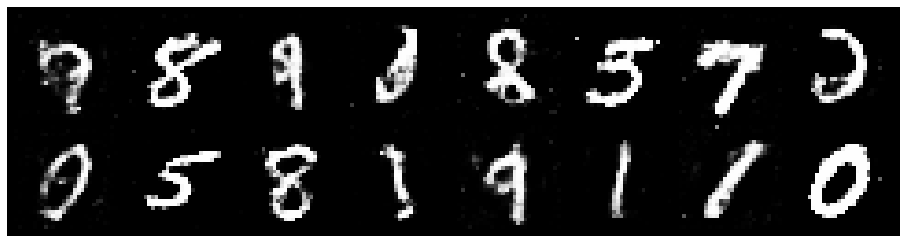

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.4164, Generator Loss: 0.8424
D(x): 0.5097, D(G(z)): 0.4708


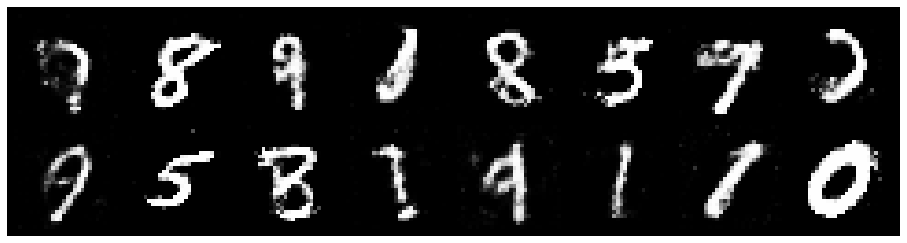

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.3705, Generator Loss: 0.9310
D(x): 0.4749, D(G(z)): 0.4080


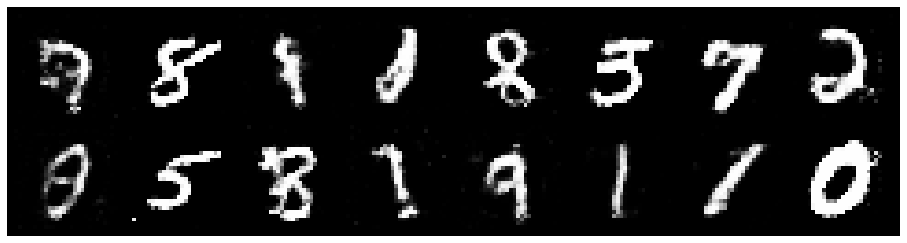

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.3485, Generator Loss: 0.7950
D(x): 0.5142, D(G(z)): 0.4577


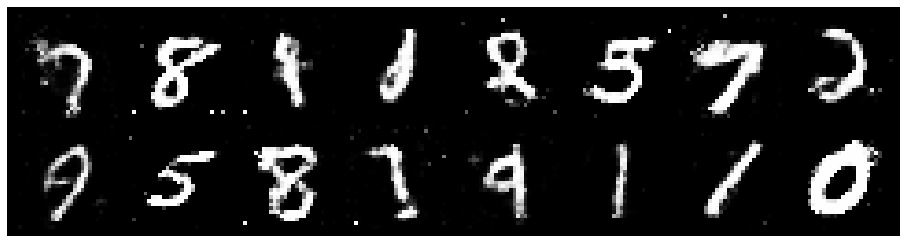

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.3729, Generator Loss: 0.8690
D(x): 0.5174, D(G(z)): 0.4581


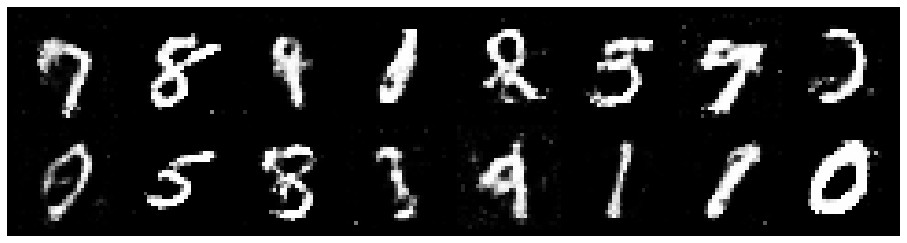

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2923, Generator Loss: 0.7719
D(x): 0.5874, D(G(z)): 0.4893


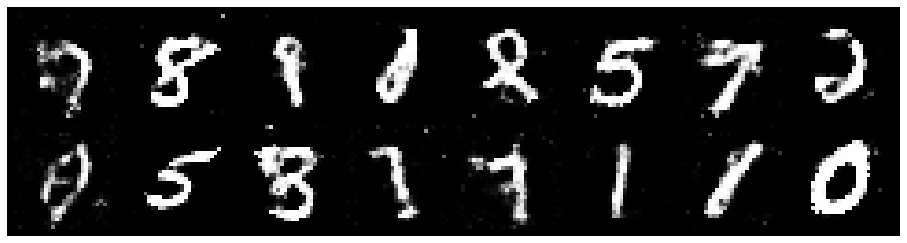

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2720, Generator Loss: 0.8760
D(x): 0.5268, D(G(z)): 0.4140


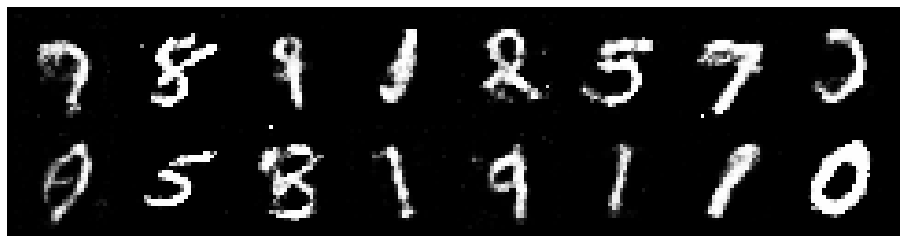

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.2334, Generator Loss: 0.9777
D(x): 0.5760, D(G(z)): 0.4364


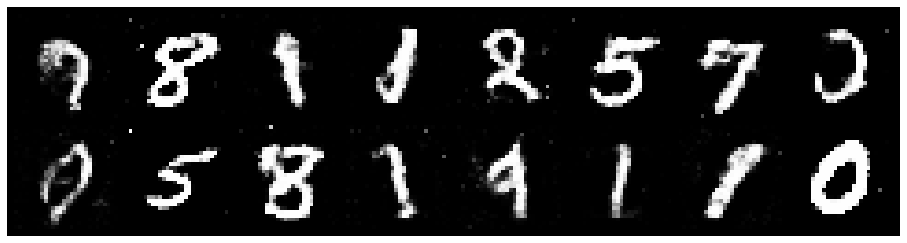

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.2314, Generator Loss: 1.0233
D(x): 0.5727, D(G(z)): 0.4358


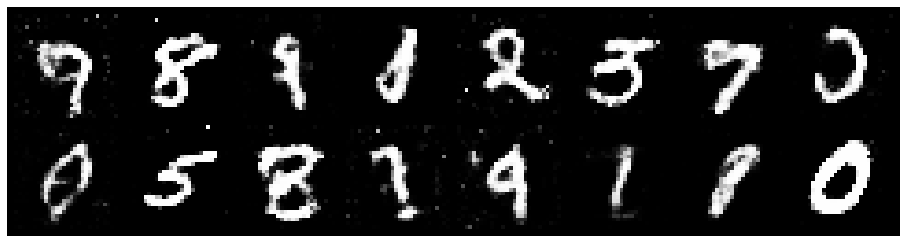

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2216, Generator Loss: 1.0020
D(x): 0.5677, D(G(z)): 0.4275


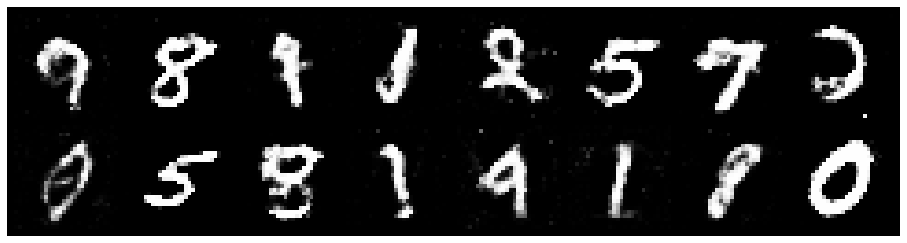

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2254, Generator Loss: 0.9493
D(x): 0.5391, D(G(z)): 0.4019


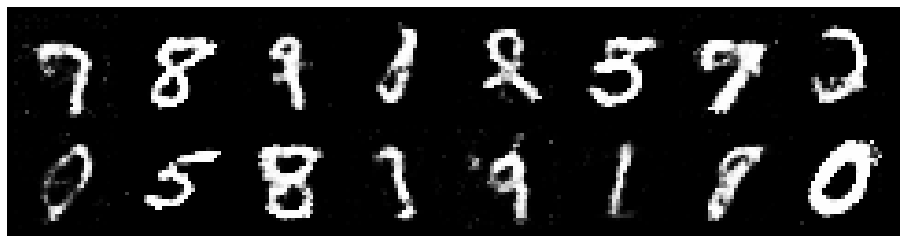

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2550, Generator Loss: 0.7735
D(x): 0.5997, D(G(z)): 0.4819


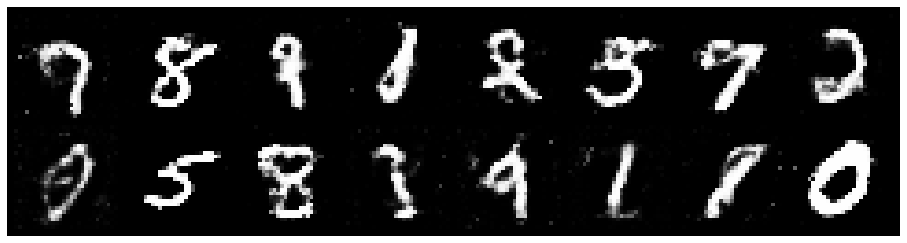

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9150
D(x): 0.5319, D(G(z)): 0.4195


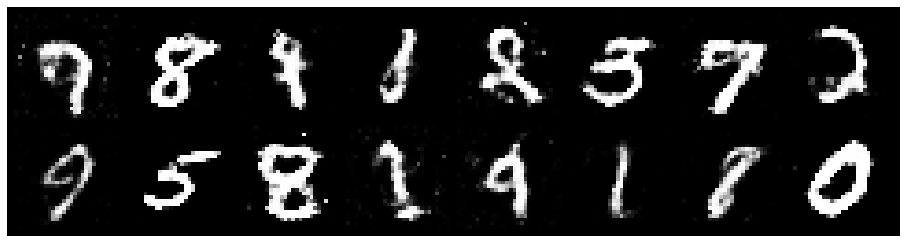

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2989, Generator Loss: 0.8974
D(x): 0.5275, D(G(z)): 0.4407


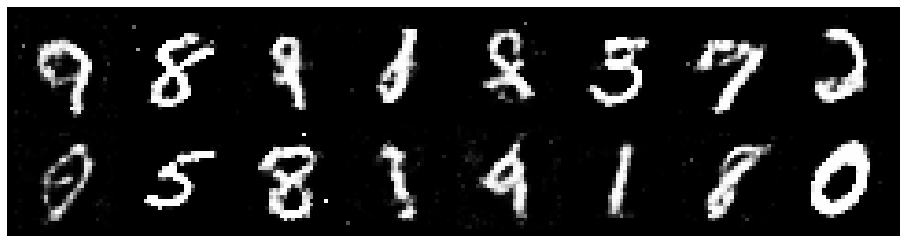

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2628, Generator Loss: 0.8946
D(x): 0.5418, D(G(z)): 0.4289


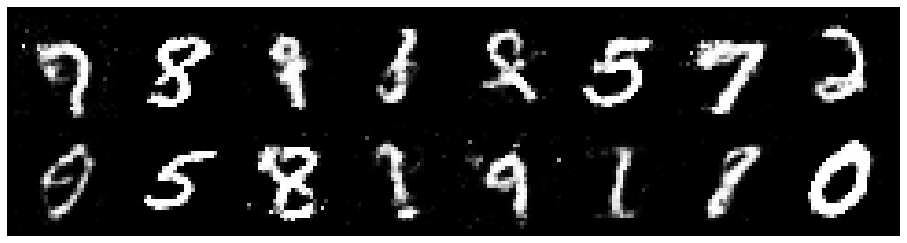

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3519, Generator Loss: 0.9637
D(x): 0.5637, D(G(z)): 0.4752


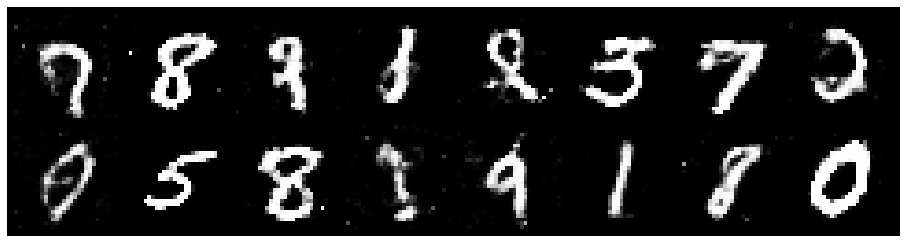

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2775, Generator Loss: 0.8406
D(x): 0.5722, D(G(z)): 0.4625


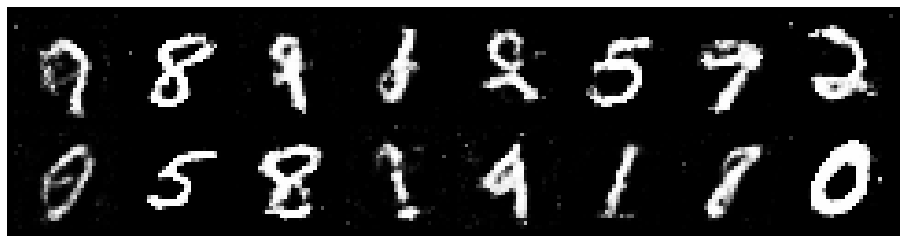

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2954, Generator Loss: 0.9622
D(x): 0.5069, D(G(z)): 0.3940


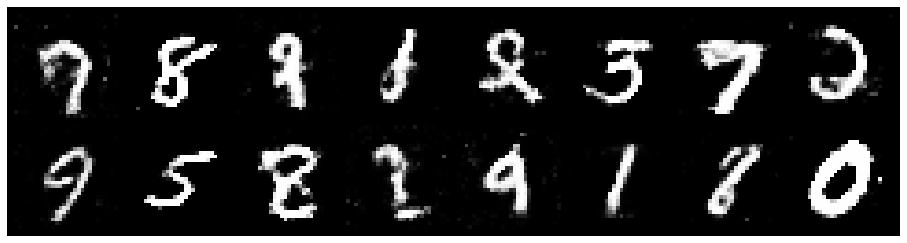

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2676, Generator Loss: 1.0478
D(x): 0.5402, D(G(z)): 0.4216


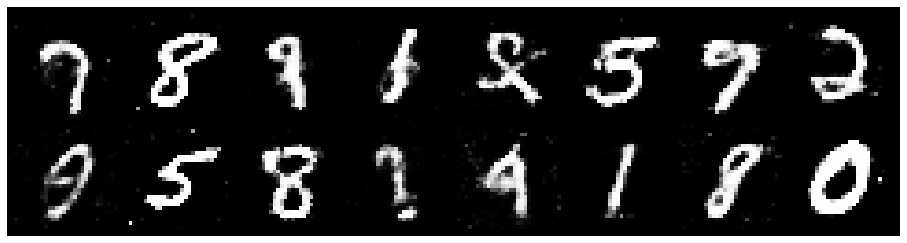

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2341, Generator Loss: 0.9588
D(x): 0.5572, D(G(z)): 0.4258


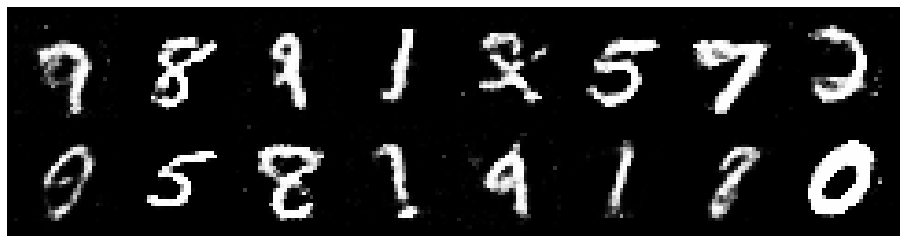

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.3479, Generator Loss: 0.9479
D(x): 0.4931, D(G(z)): 0.4233


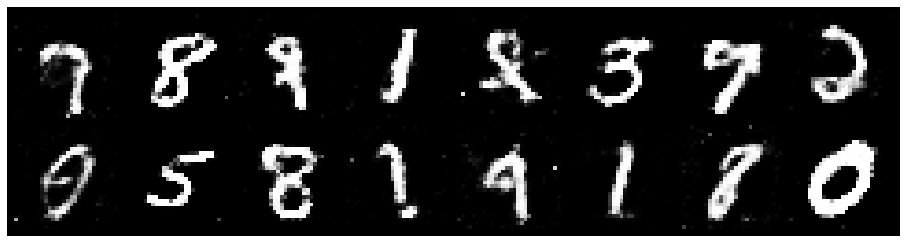

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2440, Generator Loss: 1.0661
D(x): 0.5633, D(G(z)): 0.4123


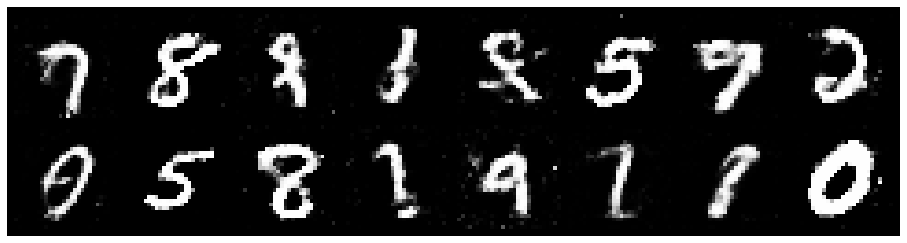

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2465, Generator Loss: 0.8369
D(x): 0.5721, D(G(z)): 0.4606


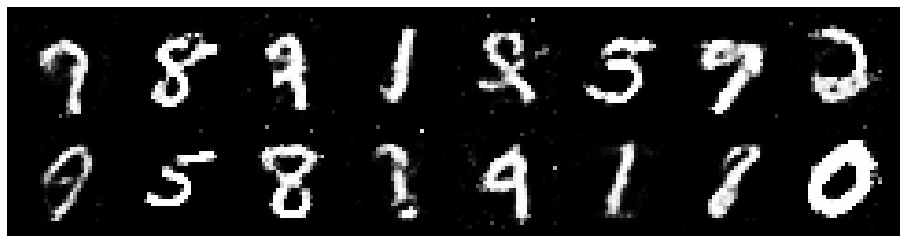

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2962, Generator Loss: 0.9848
D(x): 0.6146, D(G(z)): 0.4812


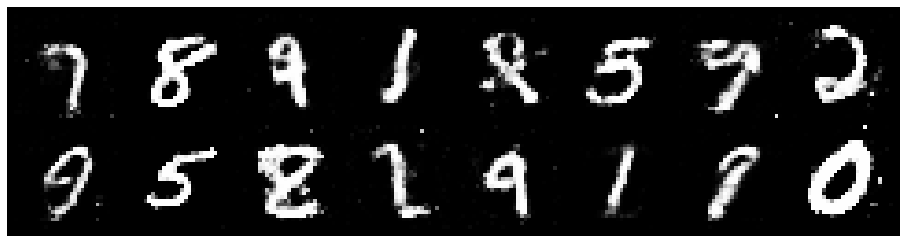

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2948, Generator Loss: 0.8956
D(x): 0.5521, D(G(z)): 0.4499


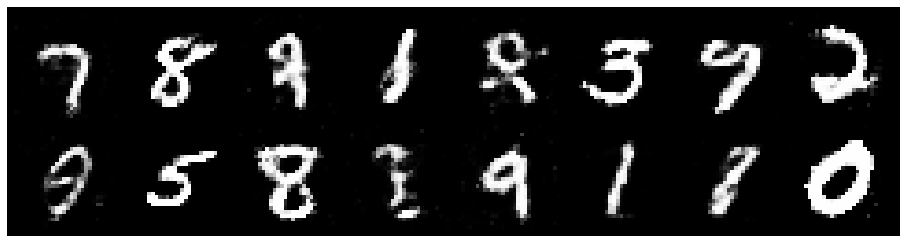

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.3211, Generator Loss: 0.8395
D(x): 0.5411, D(G(z)): 0.4687


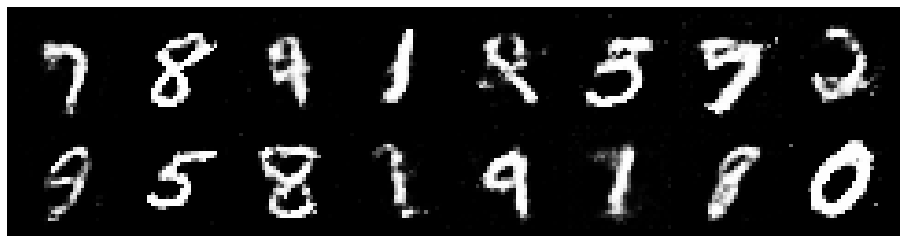

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2133, Generator Loss: 0.8976
D(x): 0.5471, D(G(z)): 0.4247


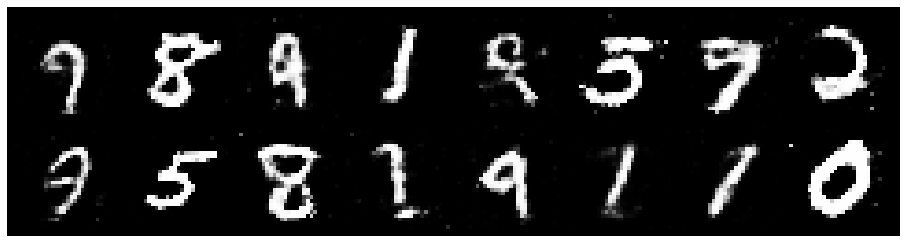

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.3675, Generator Loss: 0.8197
D(x): 0.5021, D(G(z)): 0.4543


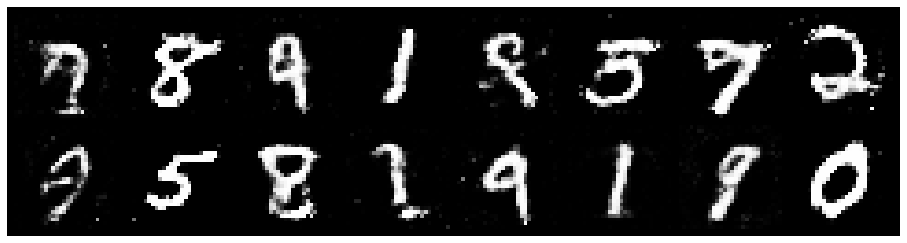

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3099, Generator Loss: 0.9093
D(x): 0.5119, D(G(z)): 0.4420


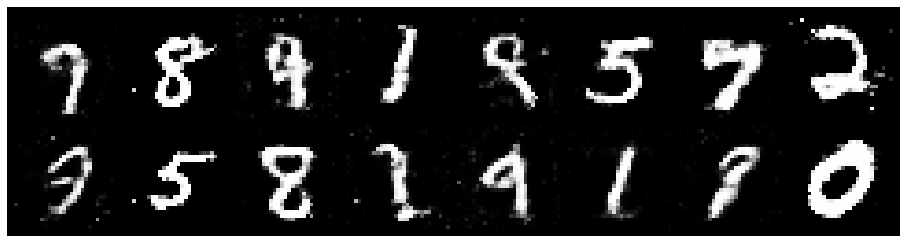

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2603, Generator Loss: 0.7895
D(x): 0.5593, D(G(z)): 0.4573


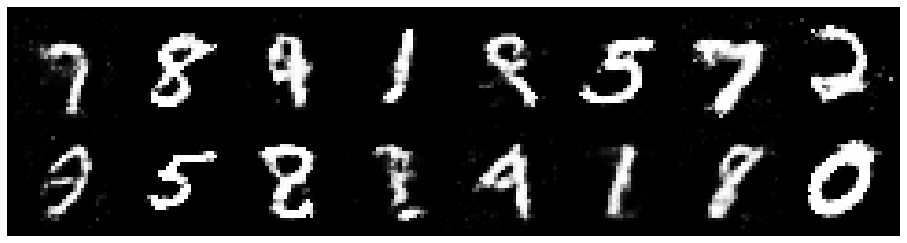

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.1967, Generator Loss: 0.8327
D(x): 0.6094, D(G(z)): 0.4571


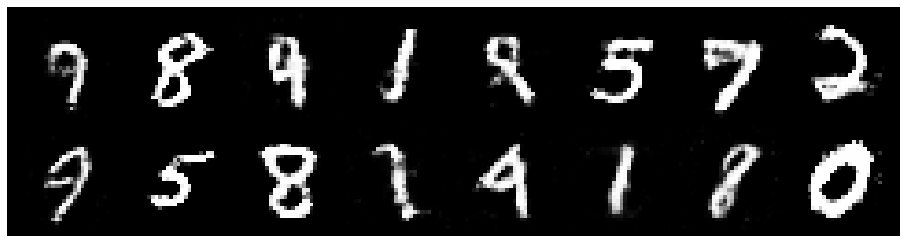

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2167, Generator Loss: 0.8392
D(x): 0.5627, D(G(z)): 0.4346


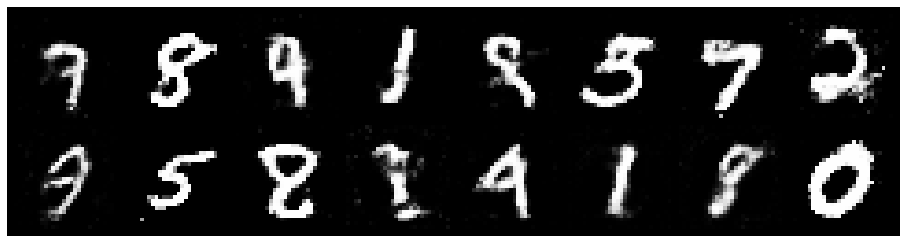

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3080, Generator Loss: 1.0467
D(x): 0.5382, D(G(z)): 0.4288


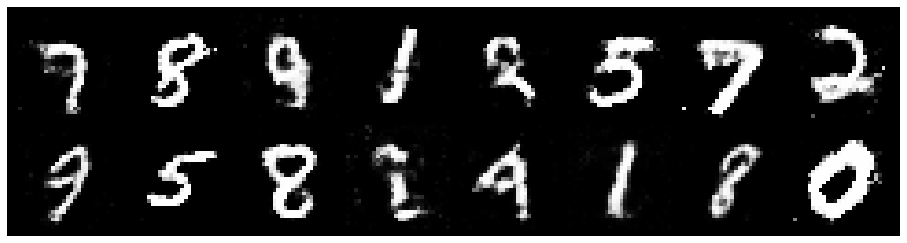

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2612, Generator Loss: 0.8081
D(x): 0.5687, D(G(z)): 0.4615


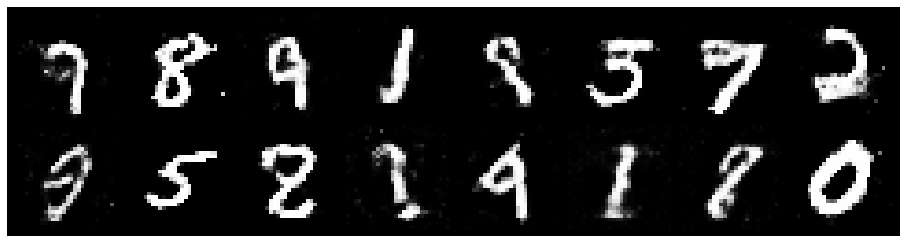

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.1672, Generator Loss: 0.8759
D(x): 0.5766, D(G(z)): 0.4036


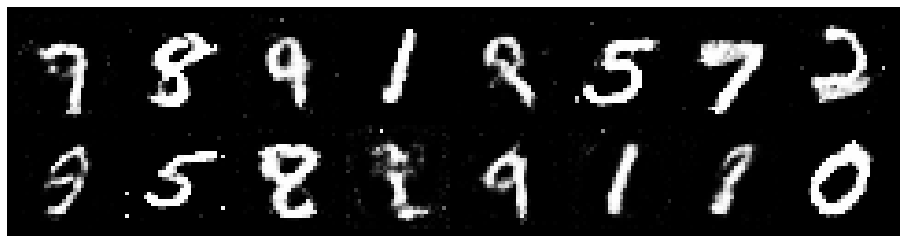

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3039, Generator Loss: 0.8642
D(x): 0.5884, D(G(z)): 0.4824


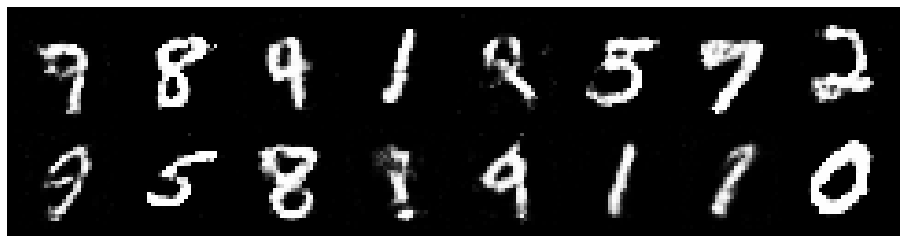

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2498, Generator Loss: 0.8893
D(x): 0.5757, D(G(z)): 0.4568


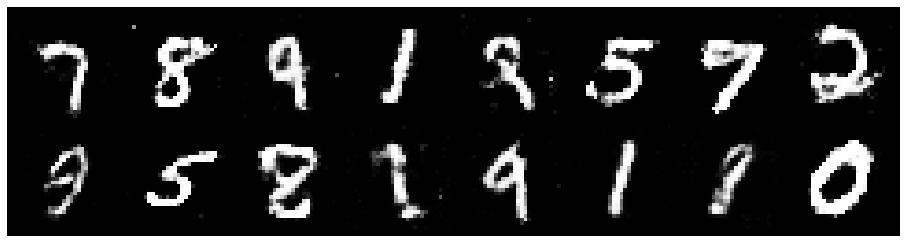

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2793, Generator Loss: 0.7998
D(x): 0.5453, D(G(z)): 0.4549


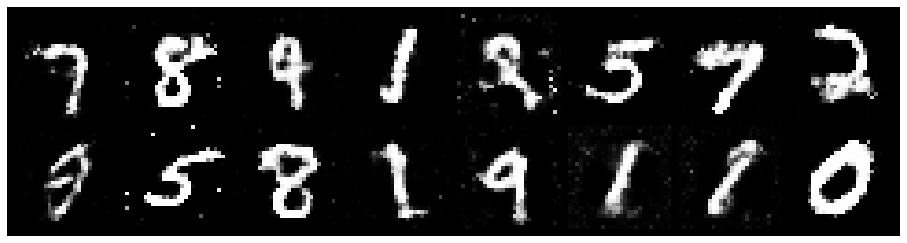

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2918, Generator Loss: 0.8979
D(x): 0.5433, D(G(z)): 0.4501


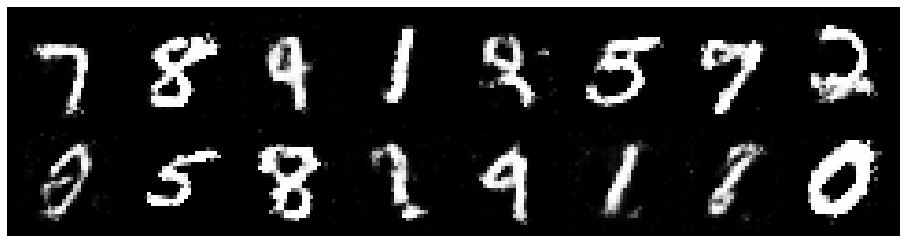

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2920, Generator Loss: 0.8353
D(x): 0.5396, D(G(z)): 0.4511


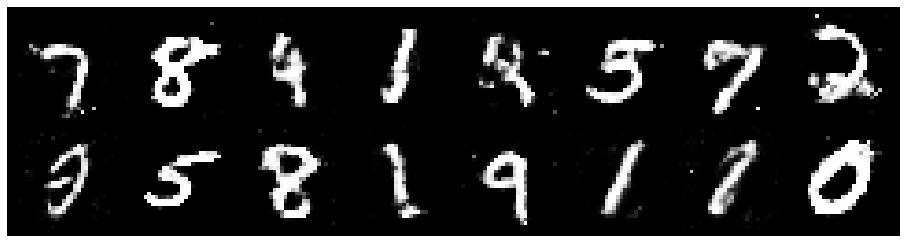

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3956, Generator Loss: 0.7945
D(x): 0.5261, D(G(z)): 0.4957


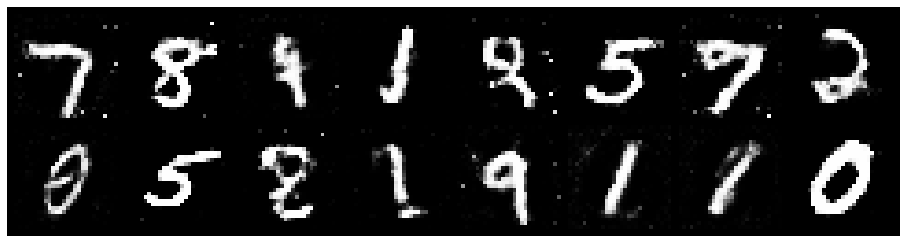

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.3709, Generator Loss: 0.8084
D(x): 0.5196, D(G(z)): 0.4709


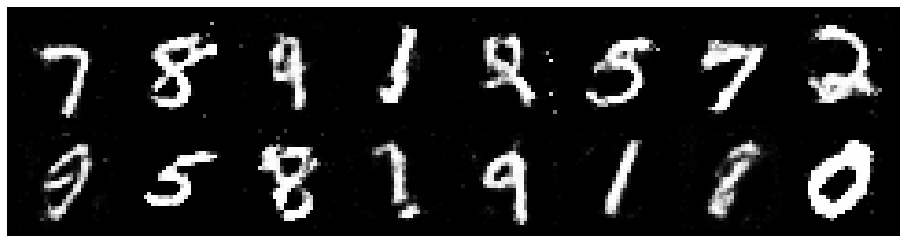

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.1744, Generator Loss: 0.8744
D(x): 0.6159, D(G(z)): 0.4459


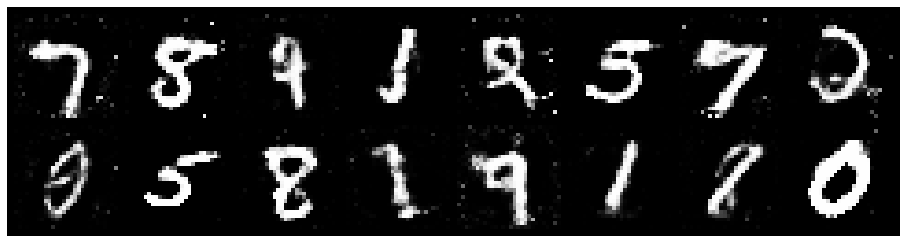

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.1053, Generator Loss: 1.0226
D(x): 0.6487, D(G(z)): 0.4181


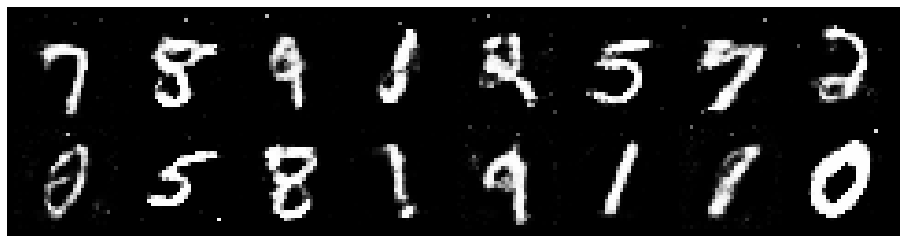

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.1873, Generator Loss: 0.8349
D(x): 0.6025, D(G(z)): 0.4252


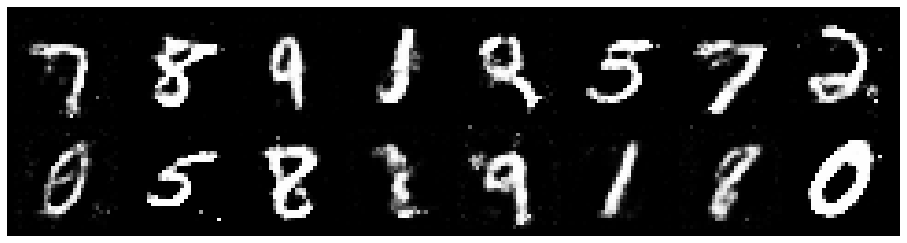

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2761, Generator Loss: 0.8707
D(x): 0.5567, D(G(z)): 0.4413


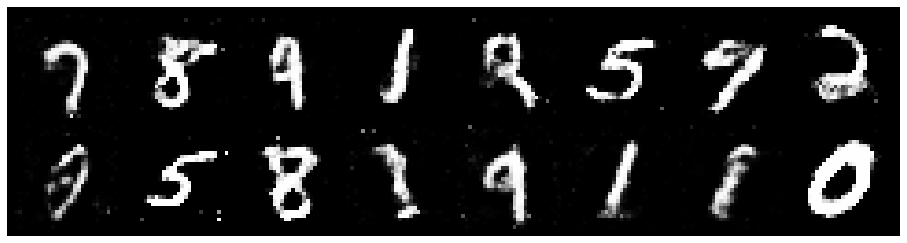

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2631, Generator Loss: 0.8858
D(x): 0.5482, D(G(z)): 0.4389


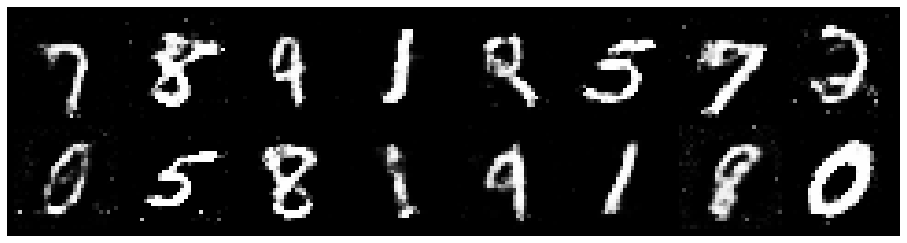

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2196, Generator Loss: 0.8954
D(x): 0.5844, D(G(z)): 0.4408


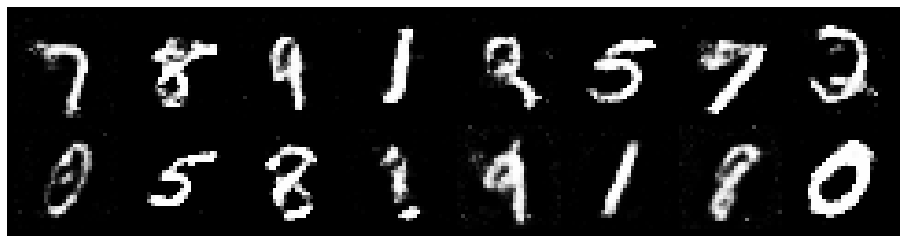

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2701, Generator Loss: 0.9644
D(x): 0.5431, D(G(z)): 0.4137


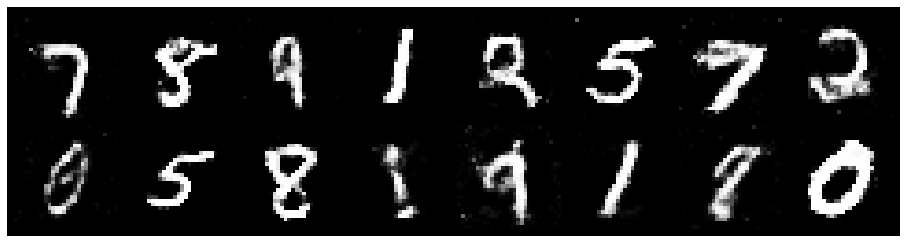

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2339, Generator Loss: 0.8641
D(x): 0.6084, D(G(z)): 0.4746


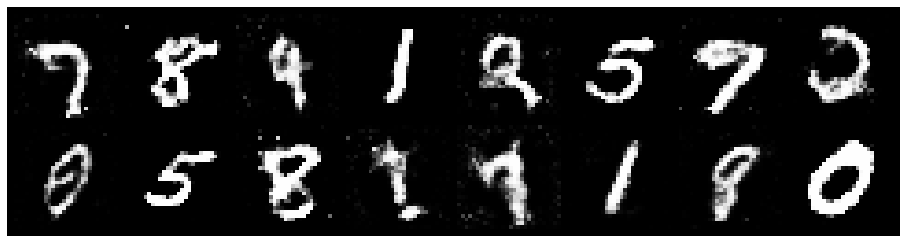

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2129, Generator Loss: 0.8755
D(x): 0.5976, D(G(z)): 0.4587


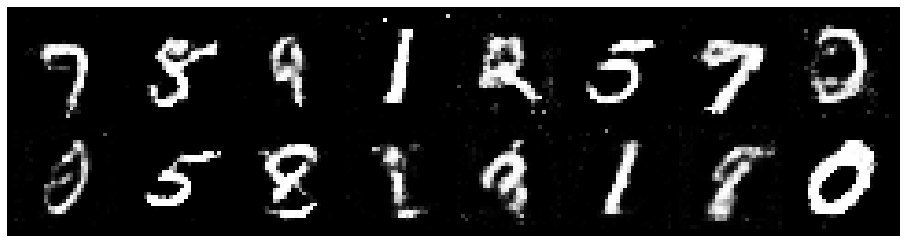

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2067, Generator Loss: 0.9303
D(x): 0.5812, D(G(z)): 0.4371


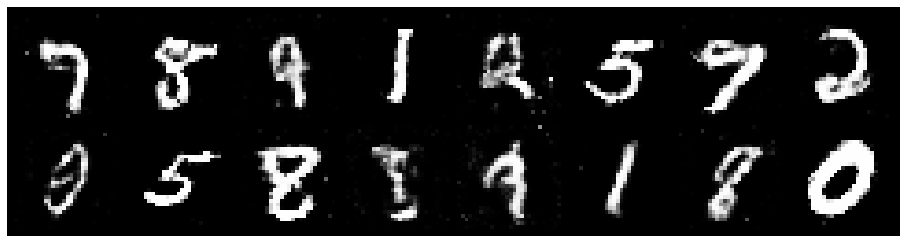

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2474, Generator Loss: 0.8624
D(x): 0.5595, D(G(z)): 0.4247


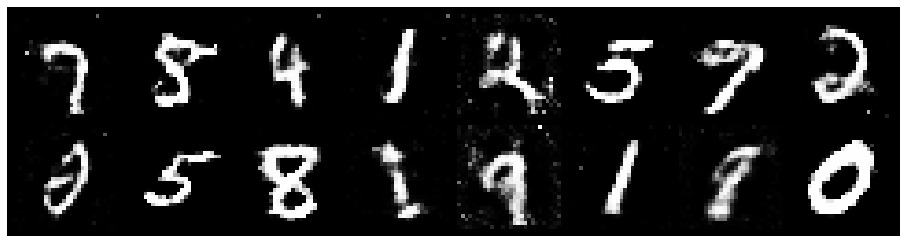

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2946, Generator Loss: 0.9548
D(x): 0.5393, D(G(z)): 0.4387


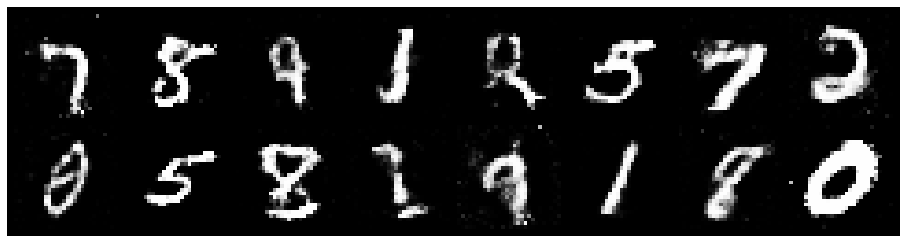

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.3536, Generator Loss: 0.7907
D(x): 0.5524, D(G(z)): 0.5037


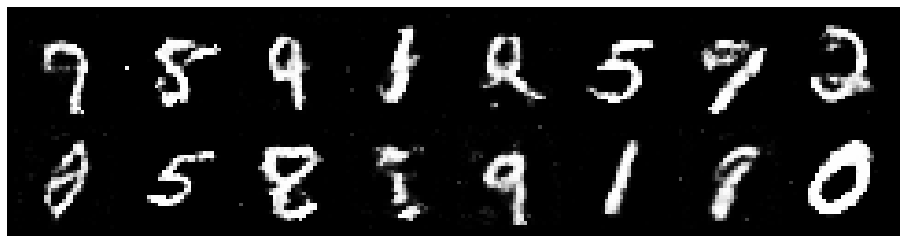

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2452, Generator Loss: 0.7928
D(x): 0.5548, D(G(z)): 0.4496


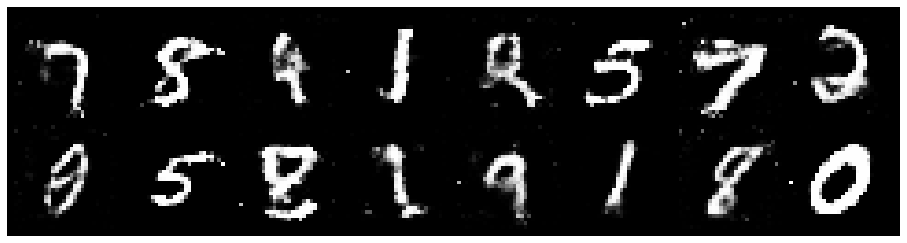

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.3064, Generator Loss: 0.9448
D(x): 0.5698, D(G(z)): 0.4606


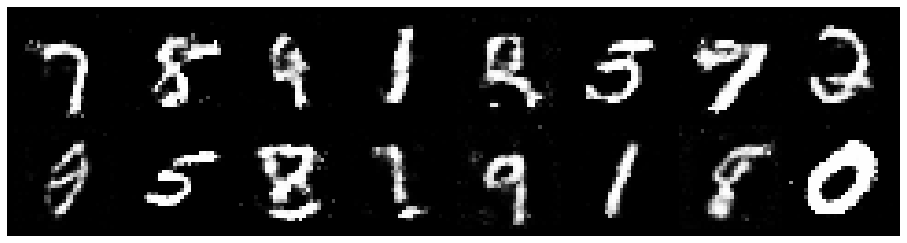

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2616, Generator Loss: 0.9115
D(x): 0.5871, D(G(z)): 0.4557


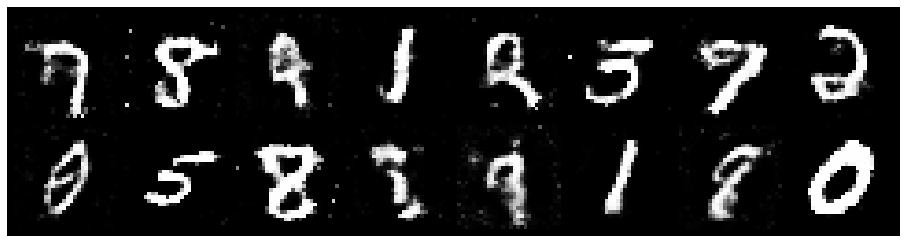

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3380, Generator Loss: 0.8840
D(x): 0.5670, D(G(z)): 0.4579


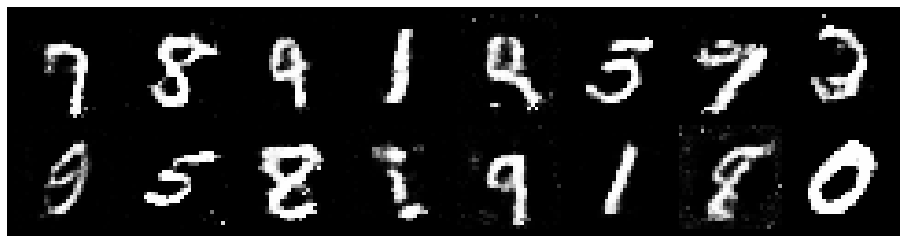

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3458, Generator Loss: 0.7867
D(x): 0.5435, D(G(z)): 0.4336


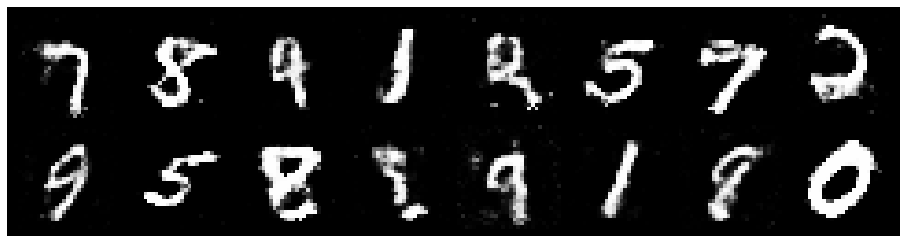

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8738
D(x): 0.5455, D(G(z)): 0.4554


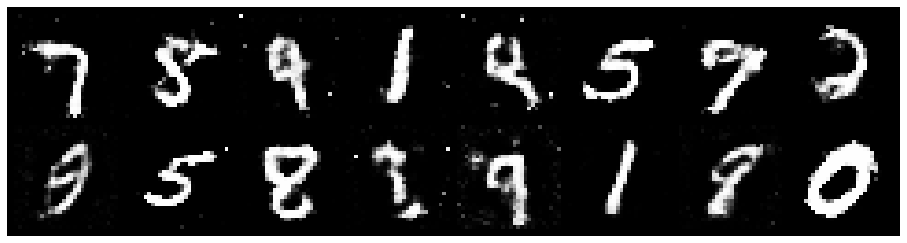

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.3231, Generator Loss: 0.8937
D(x): 0.5308, D(G(z)): 0.4390


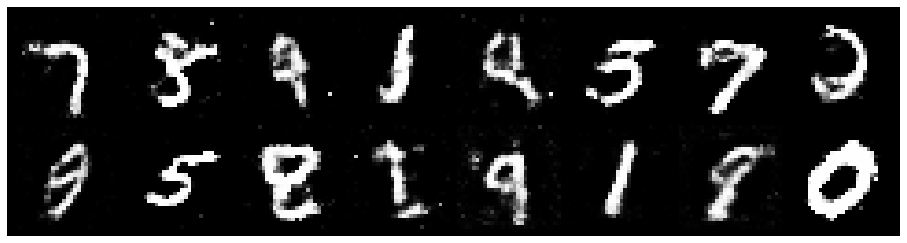

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2277, Generator Loss: 0.7726
D(x): 0.5817, D(G(z)): 0.4507


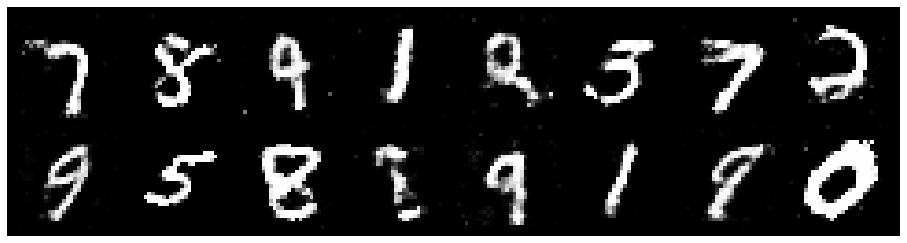

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.3048, Generator Loss: 0.8812
D(x): 0.5507, D(G(z)): 0.4653


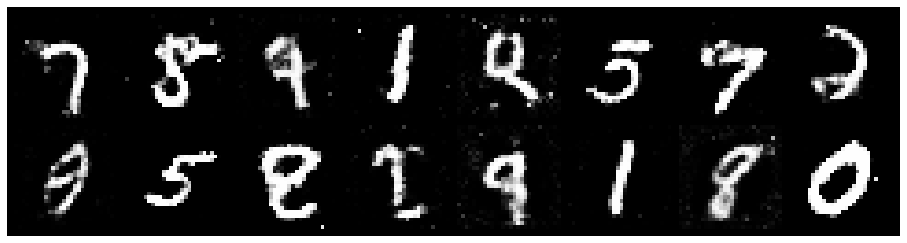

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.3834, Generator Loss: 0.8247
D(x): 0.5139, D(G(z)): 0.4596


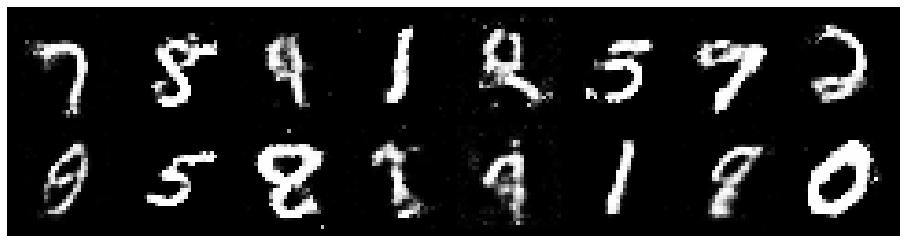

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.3419, Generator Loss: 0.7936
D(x): 0.5550, D(G(z)): 0.4946


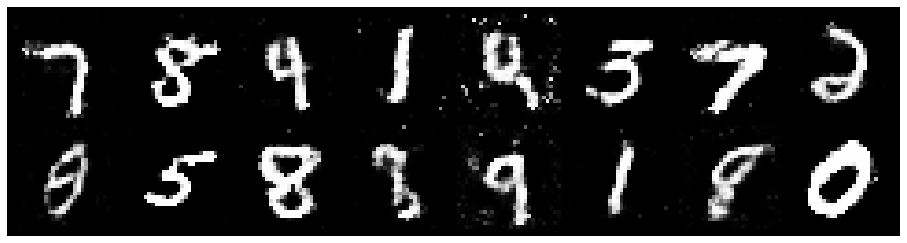

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2798, Generator Loss: 0.8854
D(x): 0.5860, D(G(z)): 0.4675


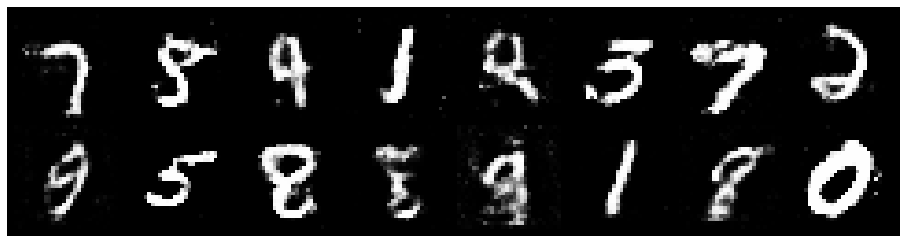

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.3110, Generator Loss: 0.9109
D(x): 0.5607, D(G(z)): 0.4542


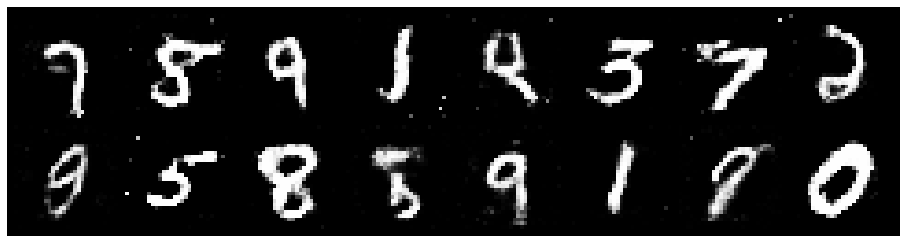

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2903, Generator Loss: 0.8871
D(x): 0.5655, D(G(z)): 0.4523


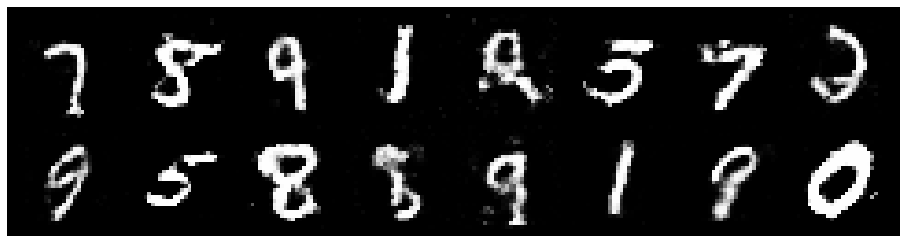

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2515, Generator Loss: 0.9965
D(x): 0.5685, D(G(z)): 0.4355


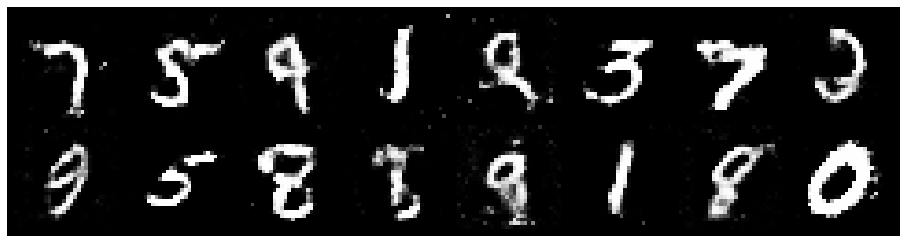

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.3485, Generator Loss: 0.9866
D(x): 0.5615, D(G(z)): 0.4760


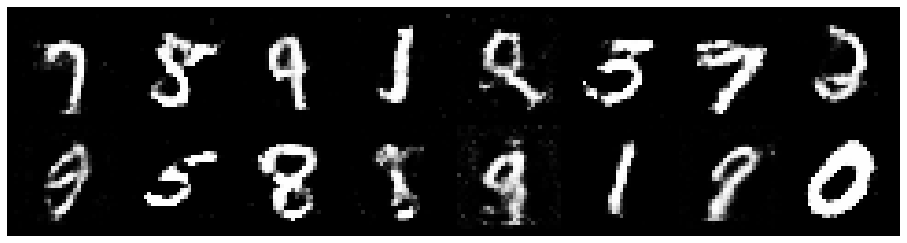

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2639, Generator Loss: 1.0104
D(x): 0.5791, D(G(z)): 0.4166


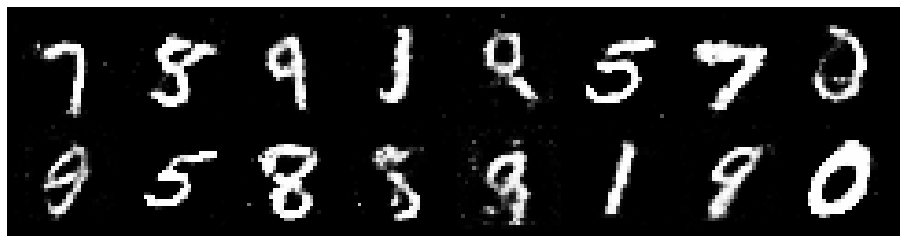

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.3301, Generator Loss: 0.9807
D(x): 0.5627, D(G(z)): 0.4722


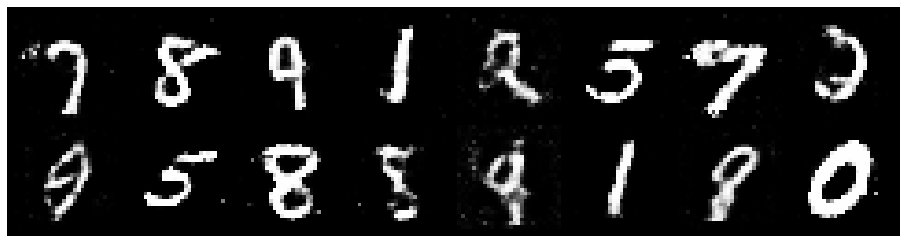

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.3060, Generator Loss: 0.9275
D(x): 0.5880, D(G(z)): 0.4833


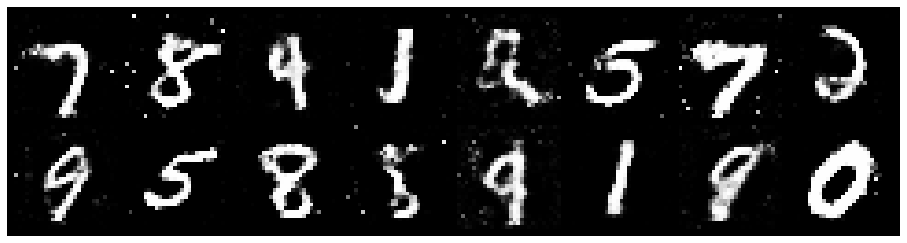

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.3165, Generator Loss: 0.7976
D(x): 0.5599, D(G(z)): 0.4587


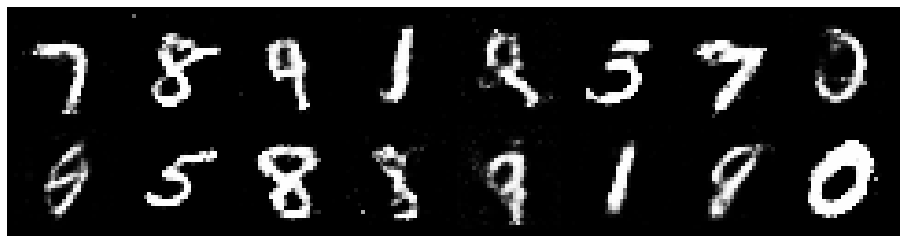

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3623, Generator Loss: 0.7895
D(x): 0.5256, D(G(z)): 0.4596


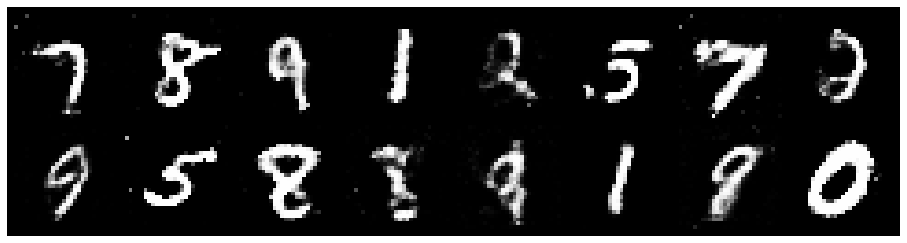

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.3855, Generator Loss: 0.8727
D(x): 0.5076, D(G(z)): 0.4551


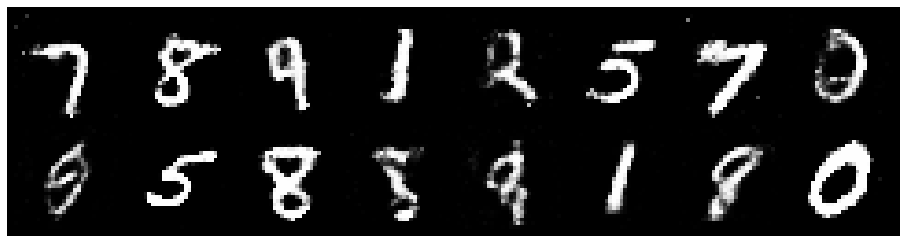

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.3690, Generator Loss: 0.8641
D(x): 0.5206, D(G(z)): 0.4705


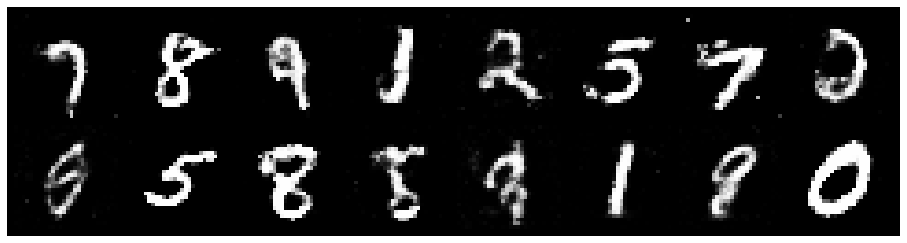

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2857, Generator Loss: 0.9439
D(x): 0.5246, D(G(z)): 0.4184


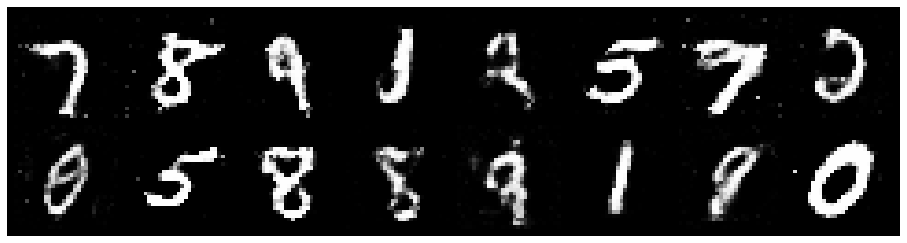

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3236, Generator Loss: 0.8177
D(x): 0.5416, D(G(z)): 0.4760


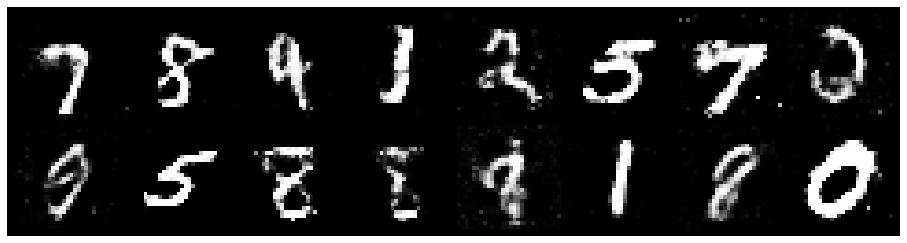

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2500, Generator Loss: 0.8906
D(x): 0.5334, D(G(z)): 0.4195


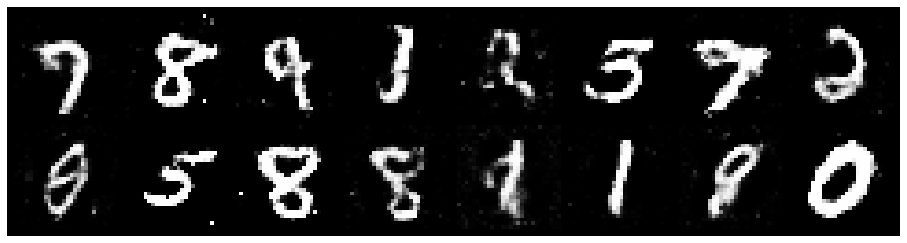

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2013, Generator Loss: 1.0898
D(x): 0.5777, D(G(z)): 0.4015


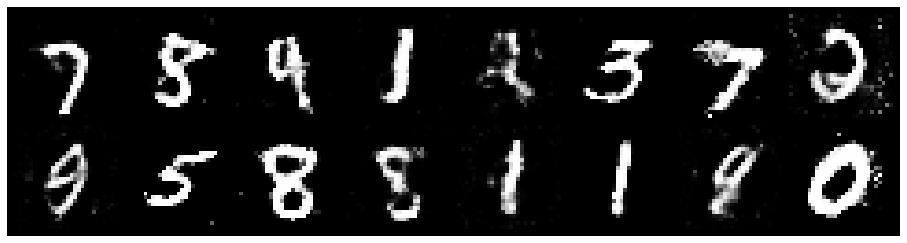

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3523, Generator Loss: 0.8416
D(x): 0.5303, D(G(z)): 0.4610


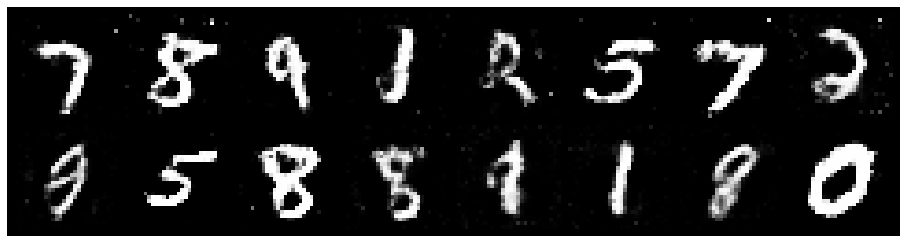

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.3665, Generator Loss: 0.8043
D(x): 0.5026, D(G(z)): 0.4413


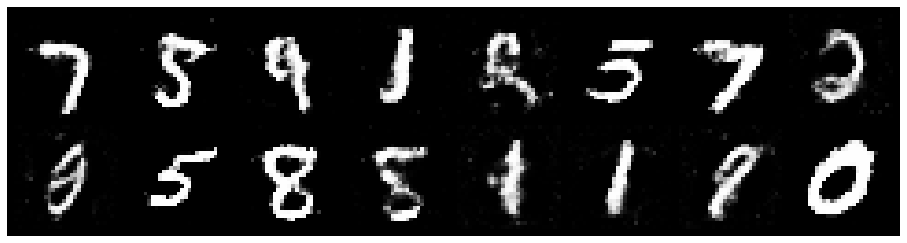

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.3450, Generator Loss: 0.8139
D(x): 0.5247, D(G(z)): 0.4625


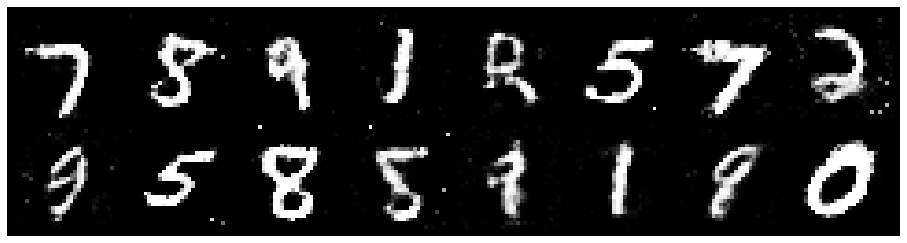

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2363, Generator Loss: 0.9666
D(x): 0.5587, D(G(z)): 0.4231


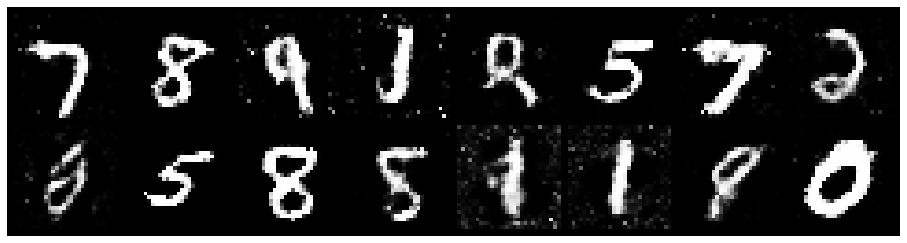

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2438, Generator Loss: 0.9176
D(x): 0.5412, D(G(z)): 0.4293


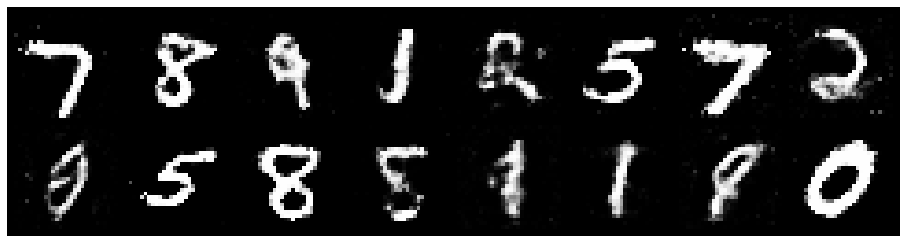

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2812, Generator Loss: 0.7947
D(x): 0.5437, D(G(z)): 0.4502


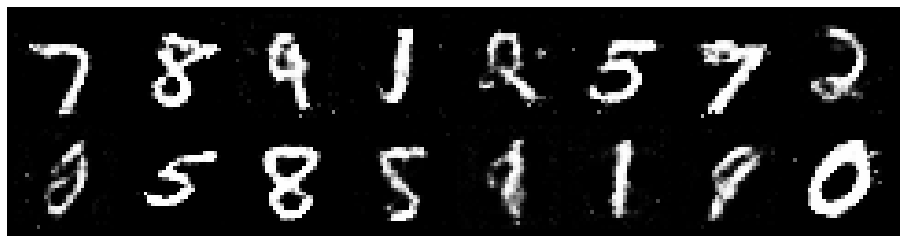

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3477, Generator Loss: 0.8818
D(x): 0.5274, D(G(z)): 0.4506


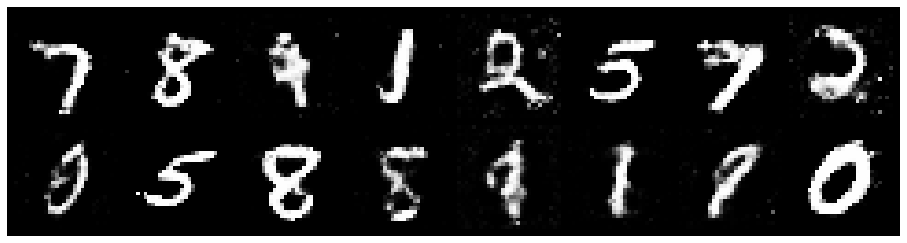

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2284, Generator Loss: 0.9123
D(x): 0.5485, D(G(z)): 0.4000


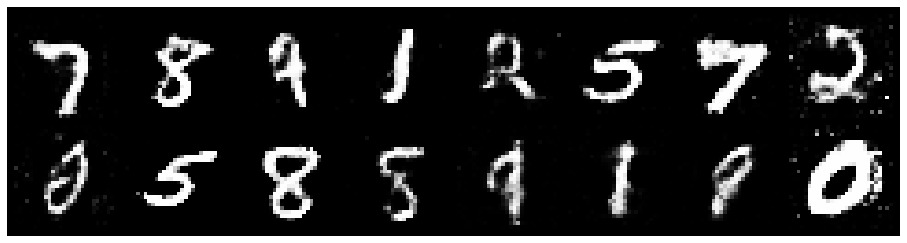

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.2152, Generator Loss: 0.9061
D(x): 0.5553, D(G(z)): 0.4264


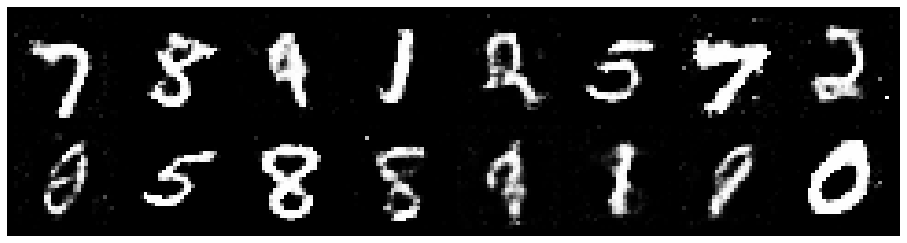

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.1427, Generator Loss: 1.0625
D(x): 0.5593, D(G(z)): 0.3724


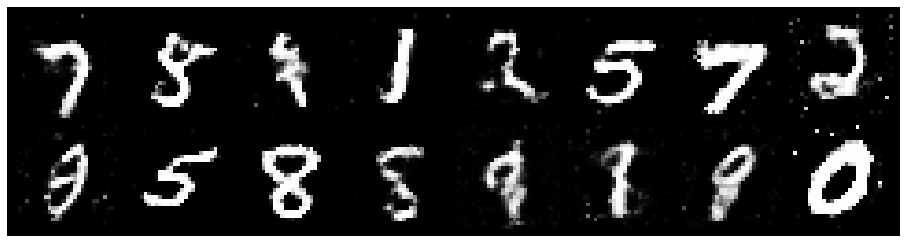

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2422, Generator Loss: 0.9710
D(x): 0.5734, D(G(z)): 0.4366


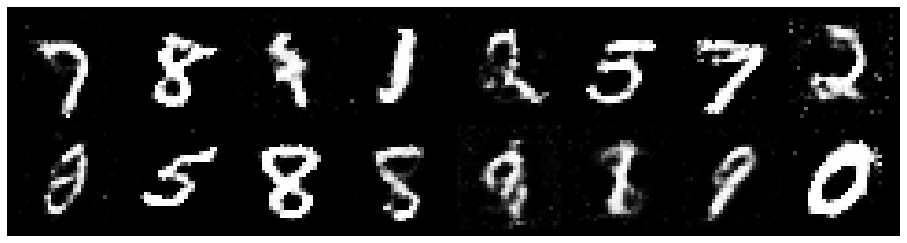

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.1859, Generator Loss: 0.8301
D(x): 0.5998, D(G(z)): 0.4431


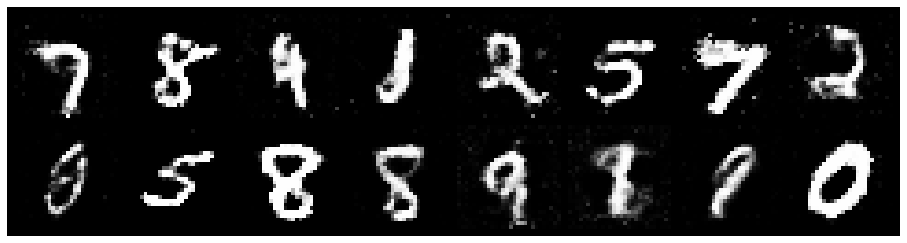

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.4573, Generator Loss: 0.7737
D(x): 0.5206, D(G(z)): 0.4910


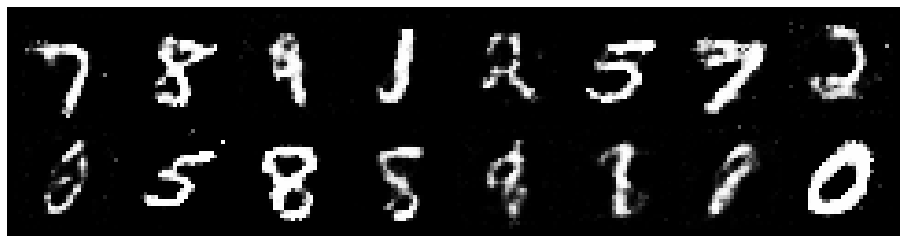

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.3055, Generator Loss: 0.8814
D(x): 0.5349, D(G(z)): 0.4538


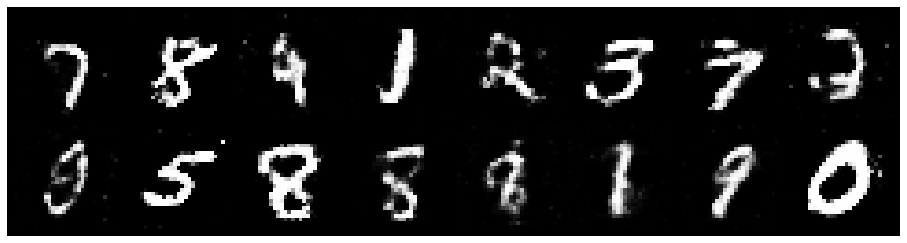

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2040, Generator Loss: 0.8488
D(x): 0.5428, D(G(z)): 0.4201


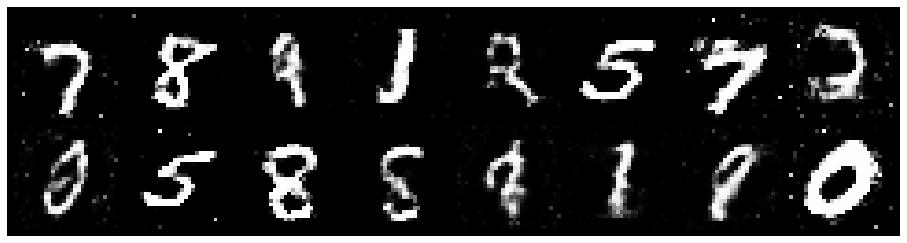

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.3365, Generator Loss: 0.8102
D(x): 0.5746, D(G(z)): 0.4945


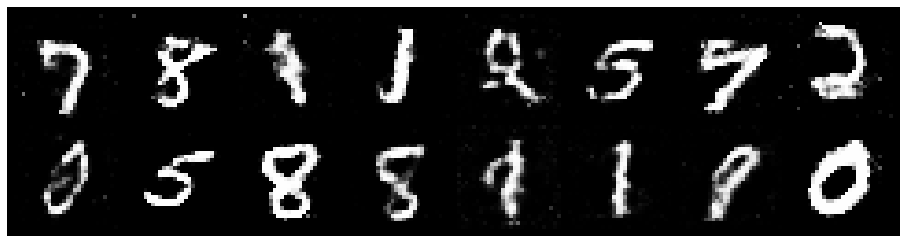

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2487, Generator Loss: 0.8025
D(x): 0.5851, D(G(z)): 0.4708


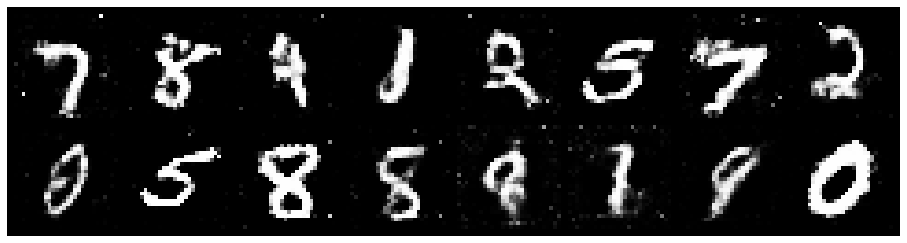

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2947, Generator Loss: 0.8761
D(x): 0.5308, D(G(z)): 0.4400


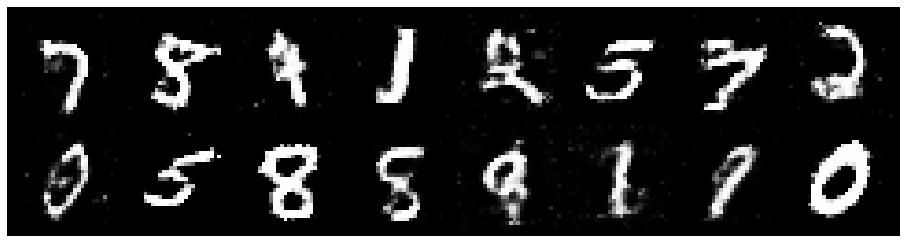

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.1664, Generator Loss: 0.8855
D(x): 0.5612, D(G(z)): 0.3962


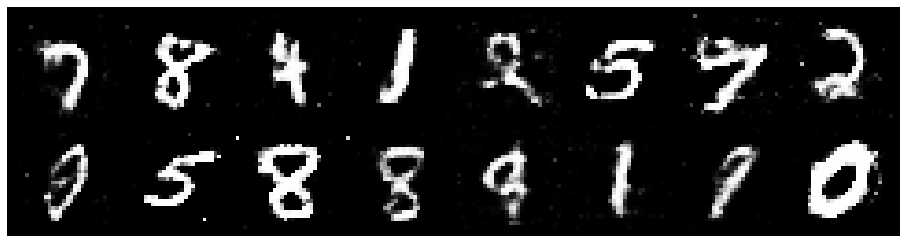

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2147, Generator Loss: 0.8428
D(x): 0.5553, D(G(z)): 0.4252


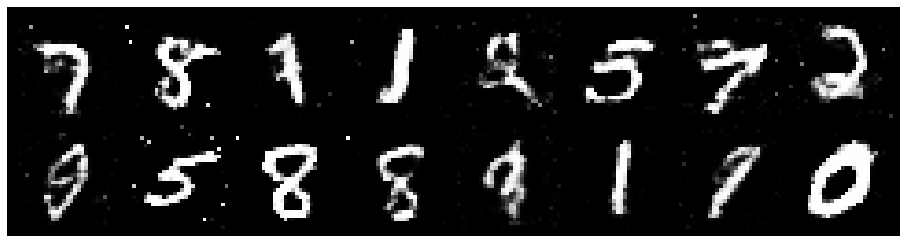

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2818, Generator Loss: 0.8778
D(x): 0.5474, D(G(z)): 0.4588


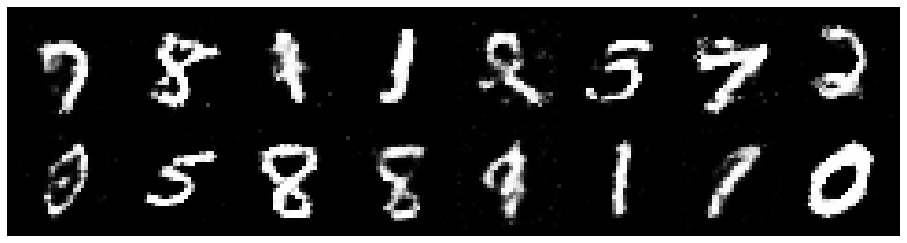

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.1758, Generator Loss: 0.8806
D(x): 0.5927, D(G(z)): 0.4434


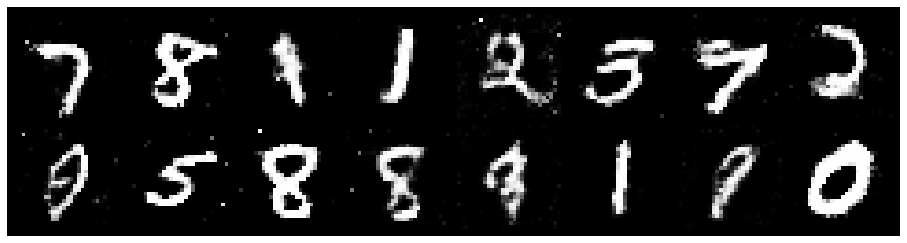

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2617, Generator Loss: 0.8687
D(x): 0.5507, D(G(z)): 0.4307


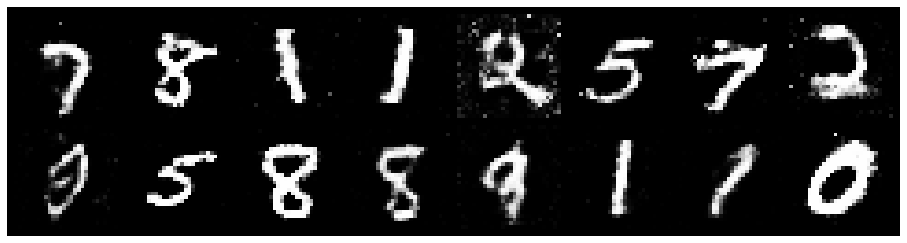

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2309, Generator Loss: 1.0108
D(x): 0.5453, D(G(z)): 0.3859


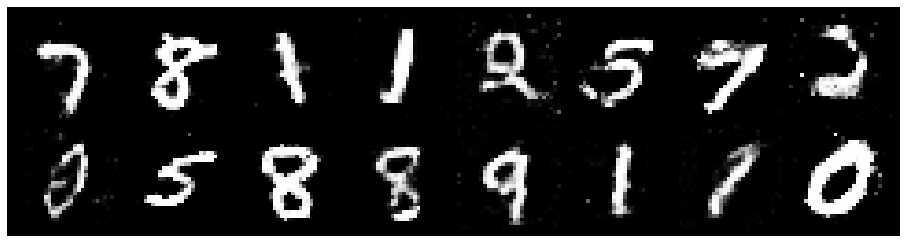

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2634, Generator Loss: 0.7617
D(x): 0.5683, D(G(z)): 0.4645


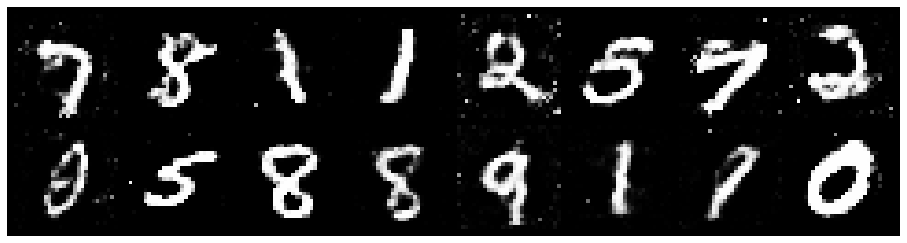

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2257, Generator Loss: 0.9096
D(x): 0.5724, D(G(z)): 0.4436


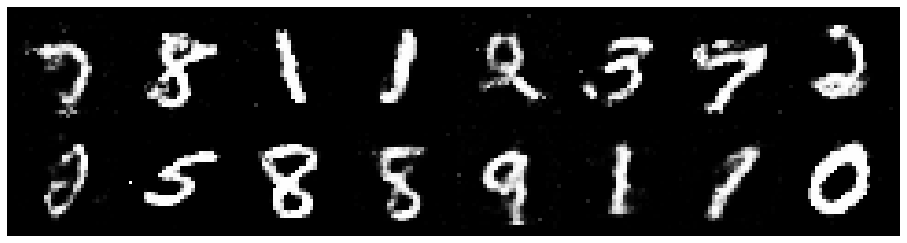

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2251, Generator Loss: 0.9594
D(x): 0.5563, D(G(z)): 0.4035


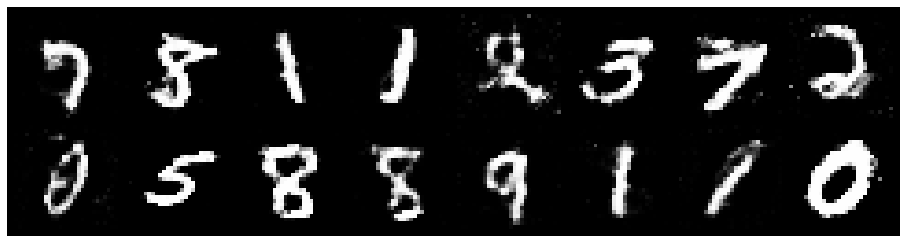

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8631
D(x): 0.5240, D(G(z)): 0.4386


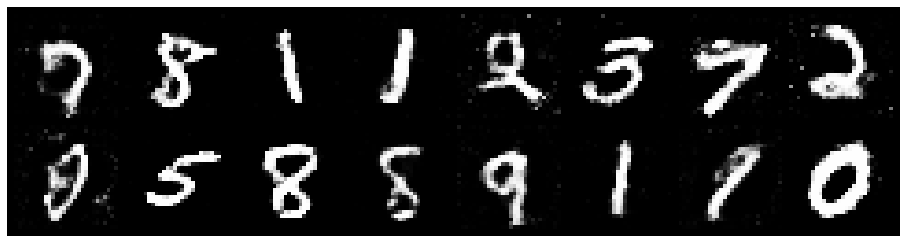

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.4301, Generator Loss: 0.8749
D(x): 0.5224, D(G(z)): 0.4784


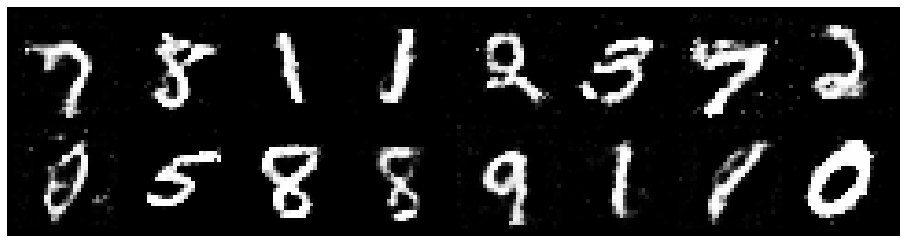

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8832
D(x): 0.5545, D(G(z)): 0.4621


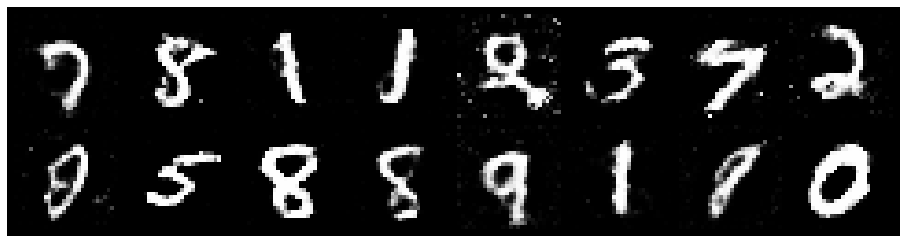

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.1863, Generator Loss: 1.0457
D(x): 0.5966, D(G(z)): 0.4404


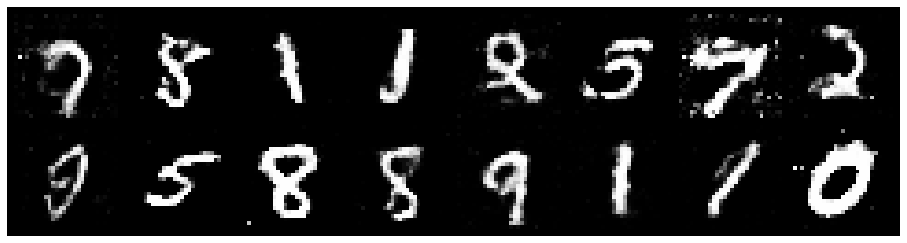

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2273, Generator Loss: 1.0009
D(x): 0.5500, D(G(z)): 0.4047


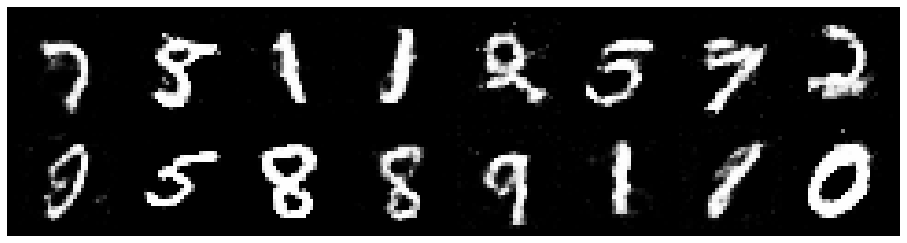

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2040, Generator Loss: 0.9224
D(x): 0.5945, D(G(z)): 0.4456


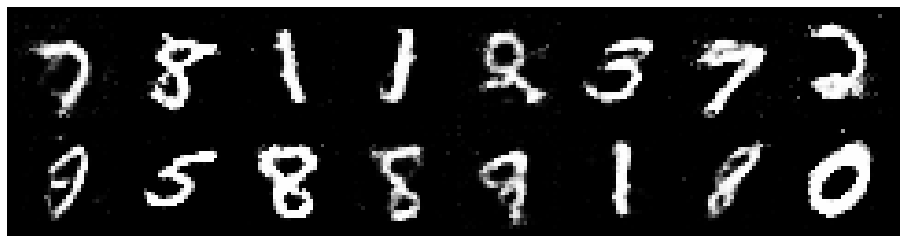

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.3147, Generator Loss: 0.8533
D(x): 0.5360, D(G(z)): 0.4527


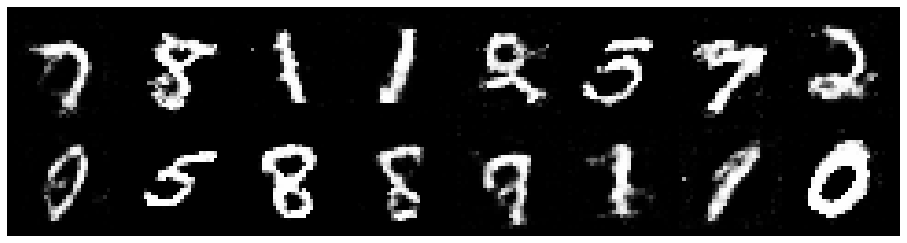

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2406, Generator Loss: 0.8774
D(x): 0.5919, D(G(z)): 0.4739


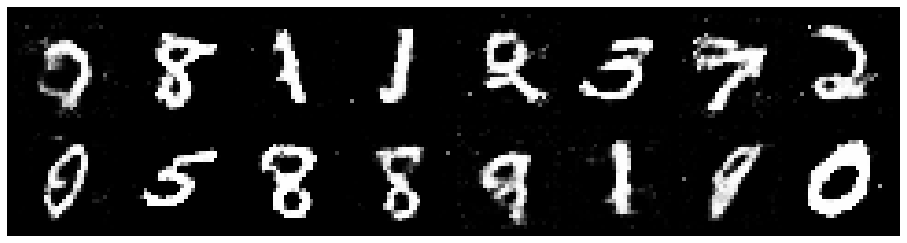

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.1145, Generator Loss: 1.0702
D(x): 0.5783, D(G(z)): 0.3660


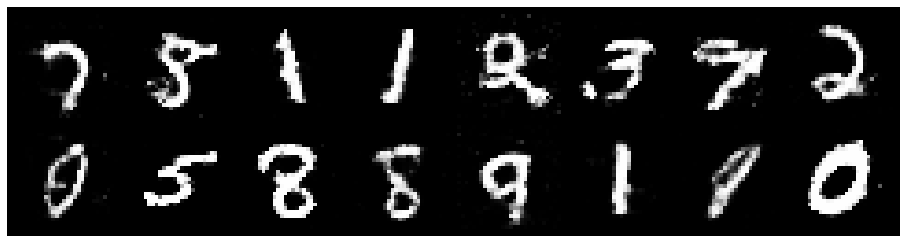

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.1744, Generator Loss: 0.9010
D(x): 0.5860, D(G(z)): 0.4346


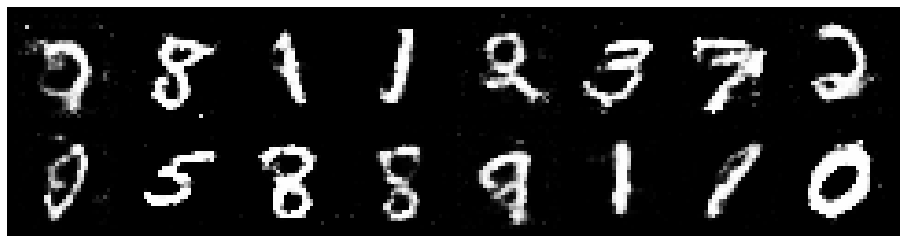

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3468, Generator Loss: 0.9680
D(x): 0.5386, D(G(z)): 0.4248


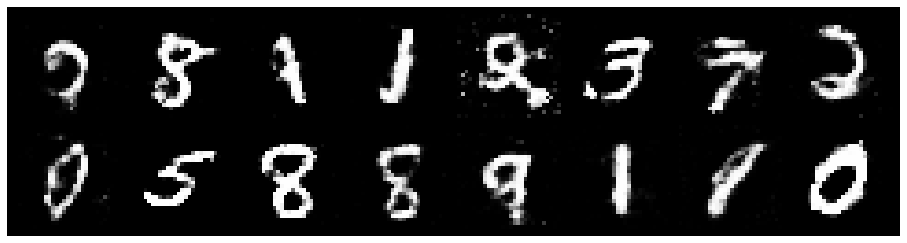

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2532, Generator Loss: 1.0681
D(x): 0.5489, D(G(z)): 0.4209


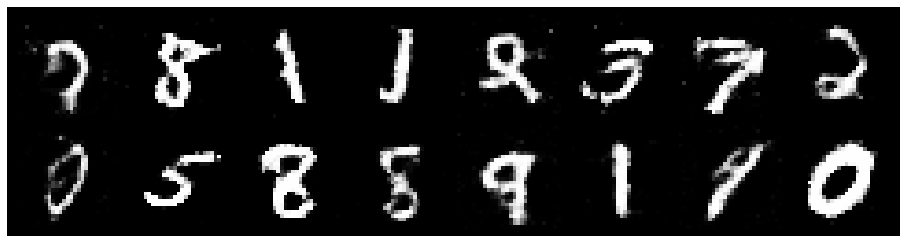

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2681, Generator Loss: 0.8383
D(x): 0.5395, D(G(z)): 0.4481


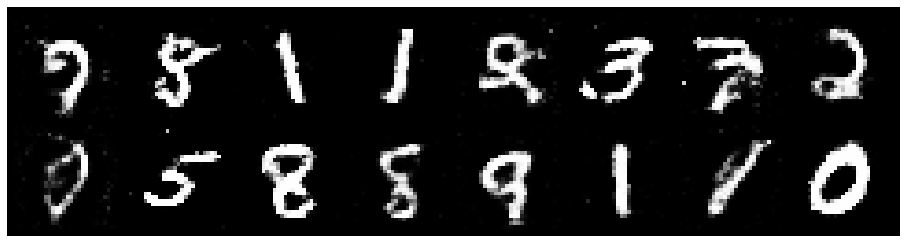

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.3467, Generator Loss: 0.9402
D(x): 0.5283, D(G(z)): 0.4493


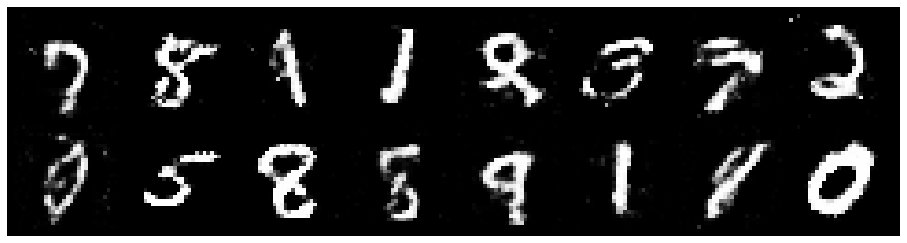

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.2570, Generator Loss: 0.8662
D(x): 0.5841, D(G(z)): 0.4714


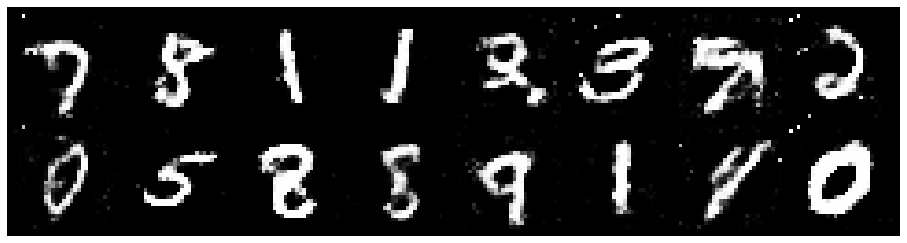

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.3314, Generator Loss: 0.9823
D(x): 0.5253, D(G(z)): 0.4243


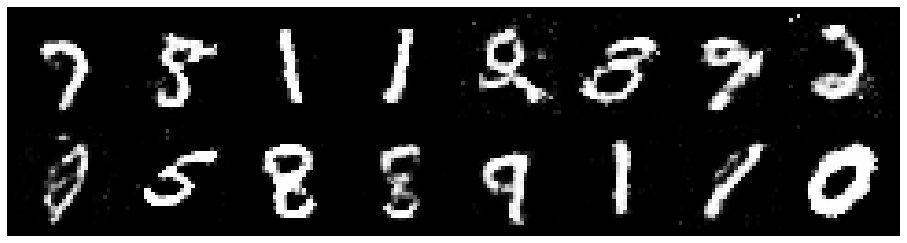

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.2340, Generator Loss: 0.9184
D(x): 0.5415, D(G(z)): 0.4220


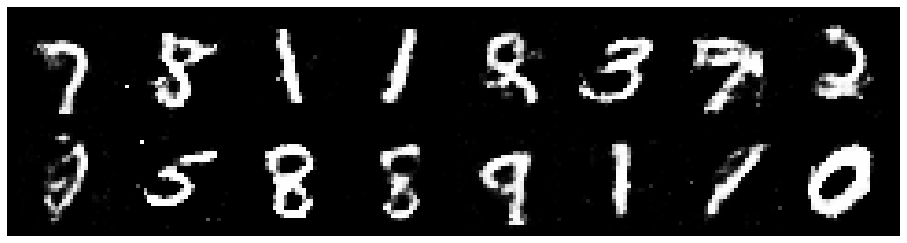

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8722
D(x): 0.5424, D(G(z)): 0.4437


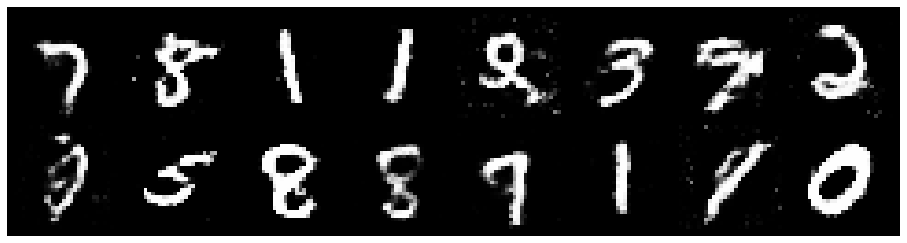

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2849, Generator Loss: 0.8214
D(x): 0.5235, D(G(z)): 0.4216


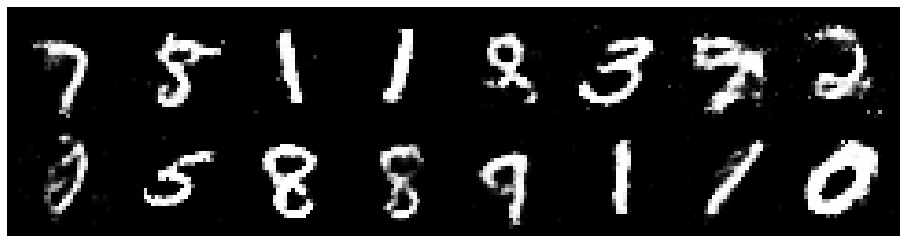

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2911, Generator Loss: 0.8372
D(x): 0.5443, D(G(z)): 0.4623


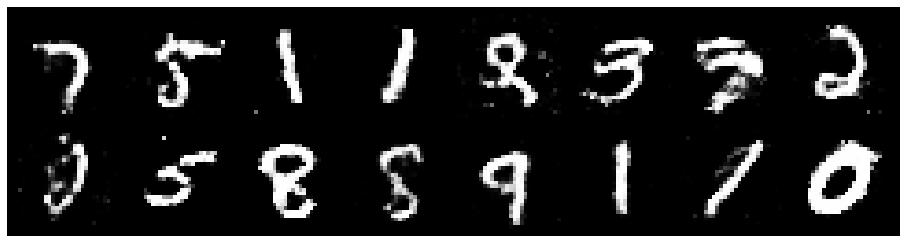

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2169, Generator Loss: 0.8557
D(x): 0.5344, D(G(z)): 0.4066


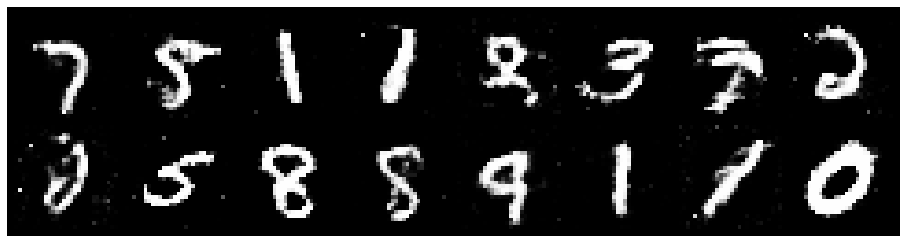

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.5206, Generator Loss: 0.8949
D(x): 0.5081, D(G(z)): 0.4860


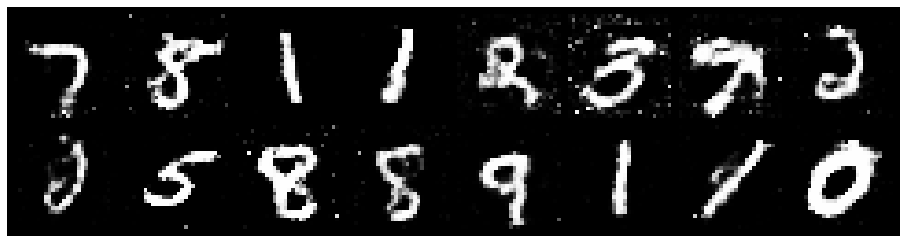

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3519, Generator Loss: 0.8803
D(x): 0.4787, D(G(z)): 0.4129


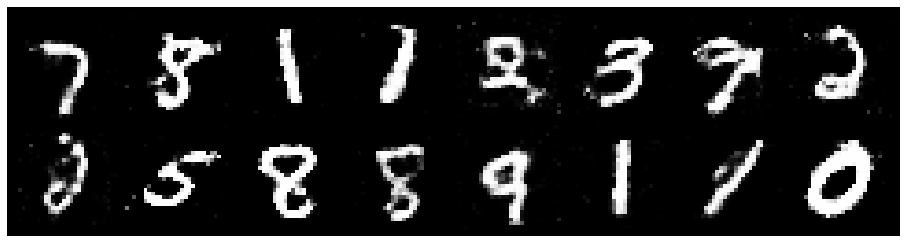

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.3722, Generator Loss: 0.8431
D(x): 0.5457, D(G(z)): 0.4806


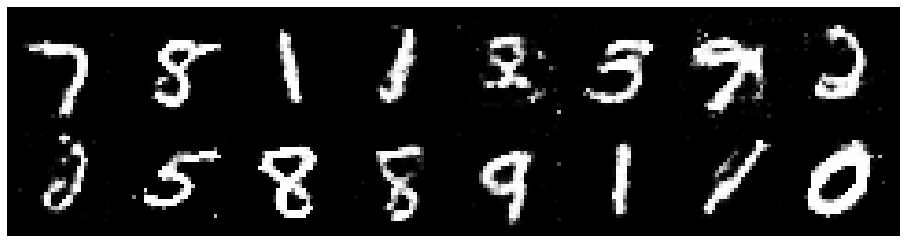

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2858, Generator Loss: 0.9033
D(x): 0.5199, D(G(z)): 0.4114


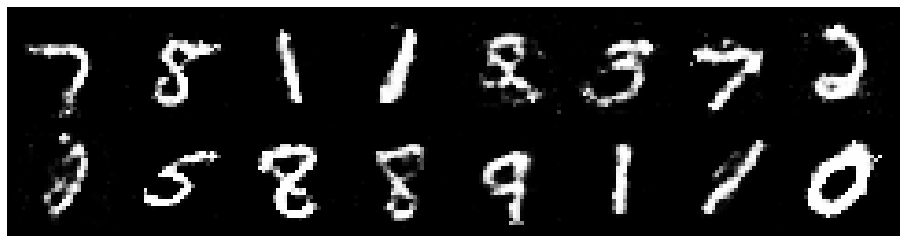

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2068, Generator Loss: 1.0116
D(x): 0.5568, D(G(z)): 0.4165


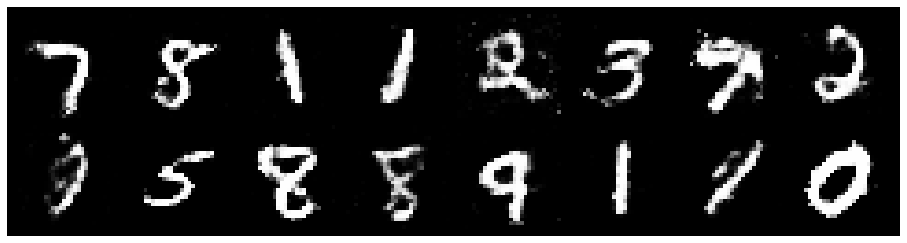

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2308, Generator Loss: 1.0636
D(x): 0.5461, D(G(z)): 0.4249


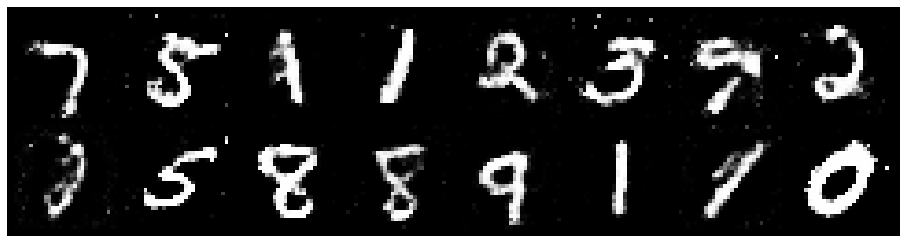

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2493, Generator Loss: 0.9156
D(x): 0.5583, D(G(z)): 0.4317


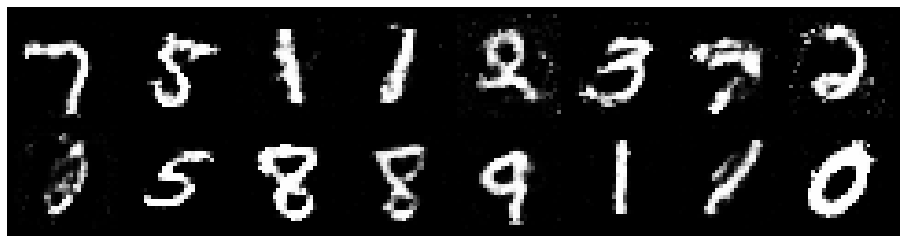

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.1636, Generator Loss: 0.9379
D(x): 0.5682, D(G(z)): 0.4106


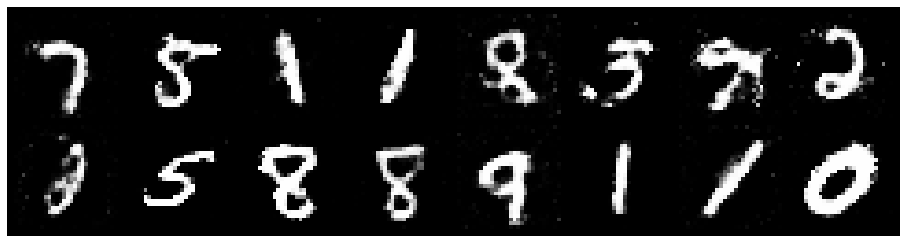

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2978, Generator Loss: 0.9169
D(x): 0.5095, D(G(z)): 0.4161


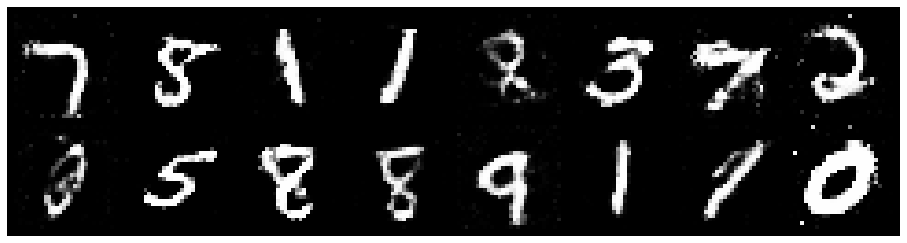

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2638, Generator Loss: 0.8330
D(x): 0.5338, D(G(z)): 0.4269


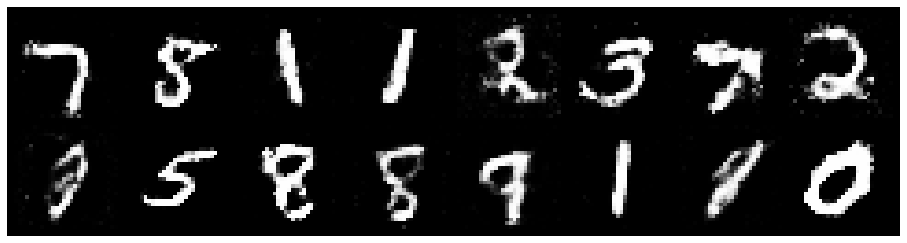

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2227, Generator Loss: 0.9681
D(x): 0.5804, D(G(z)): 0.4399


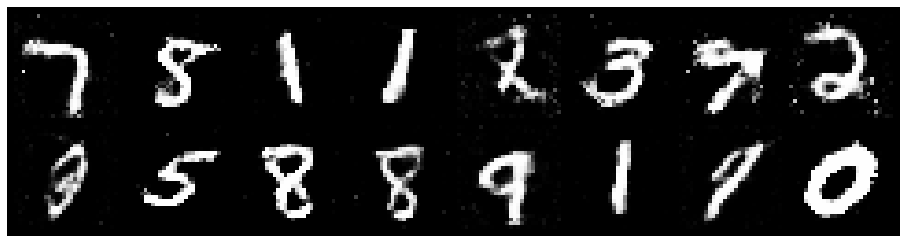

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.1660, Generator Loss: 0.9607
D(x): 0.6390, D(G(z)): 0.4684


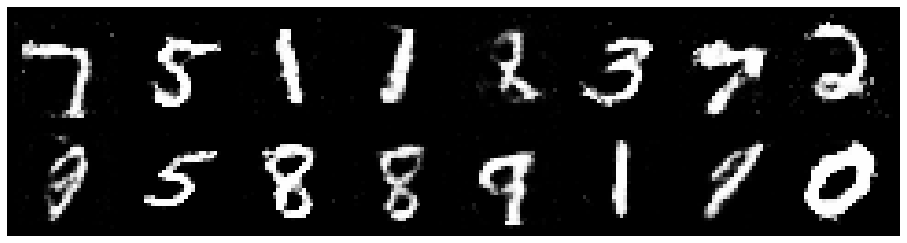

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2285, Generator Loss: 0.8451
D(x): 0.5796, D(G(z)): 0.4483


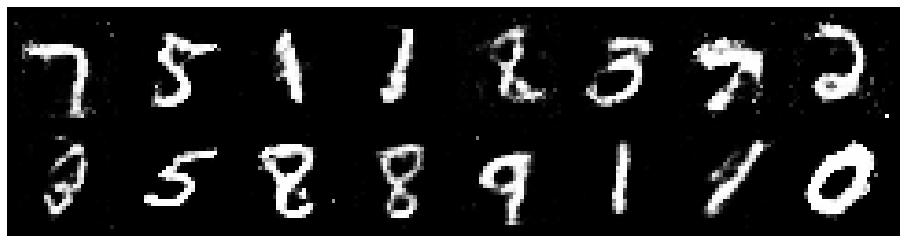

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8598
D(x): 0.5653, D(G(z)): 0.4622


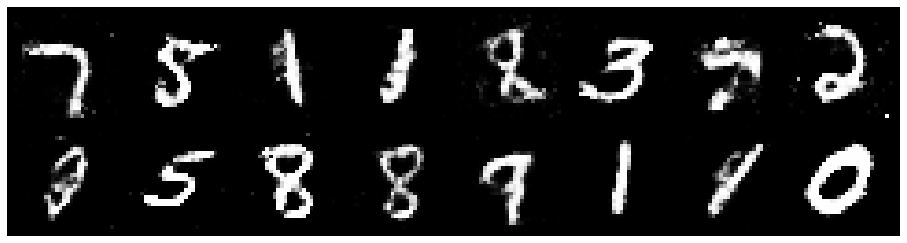

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2841, Generator Loss: 0.9600
D(x): 0.5503, D(G(z)): 0.4436


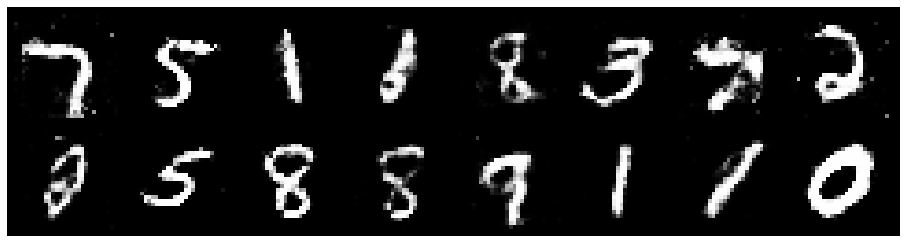

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2280, Generator Loss: 0.9730
D(x): 0.5324, D(G(z)): 0.4068


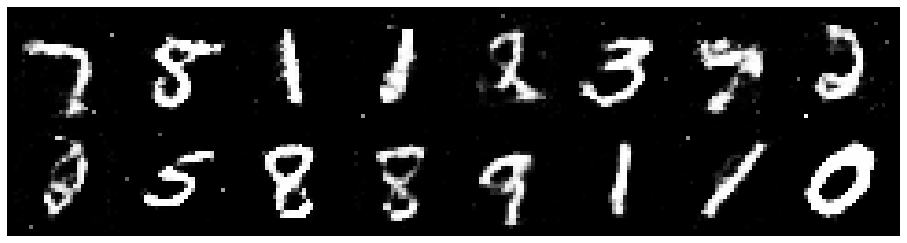

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.3504, Generator Loss: 0.8318
D(x): 0.5525, D(G(z)): 0.4907


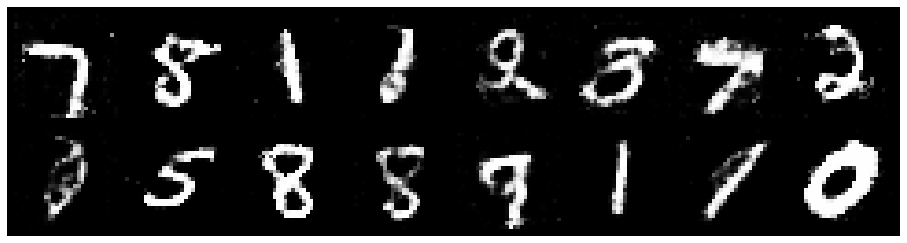

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2989, Generator Loss: 0.9857
D(x): 0.5109, D(G(z)): 0.4126


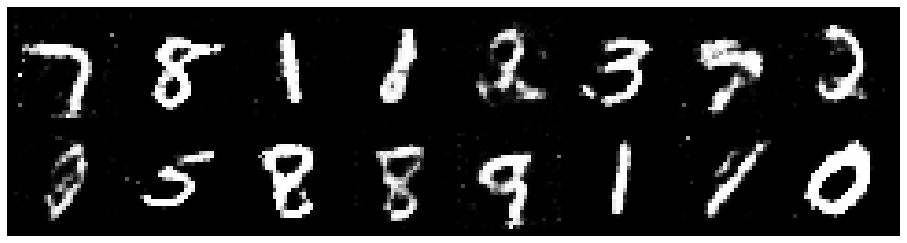

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2341, Generator Loss: 0.9626
D(x): 0.5256, D(G(z)): 0.3998


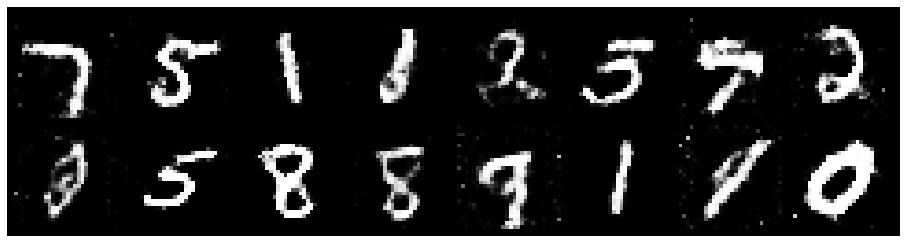

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.4170, Generator Loss: 0.9244
D(x): 0.4978, D(G(z)): 0.4459


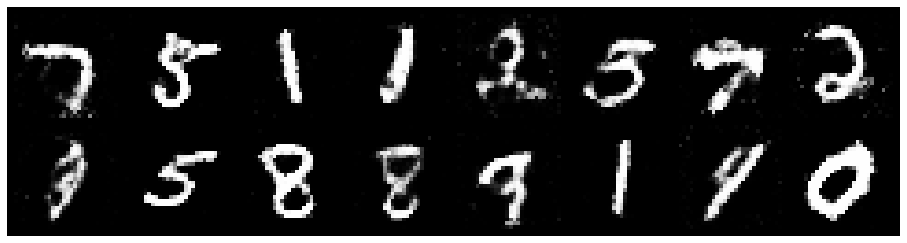

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.3471, Generator Loss: 0.8863
D(x): 0.5059, D(G(z)): 0.4249


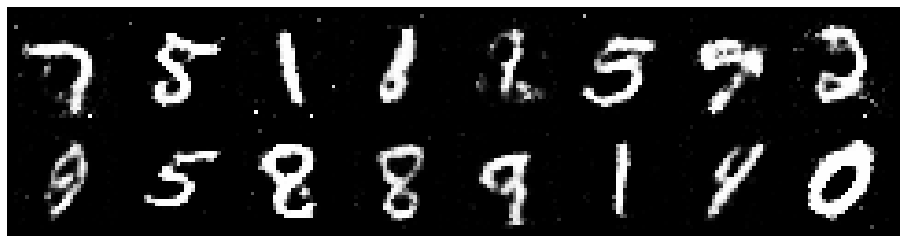

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2929, Generator Loss: 0.8916
D(x): 0.5494, D(G(z)): 0.4286


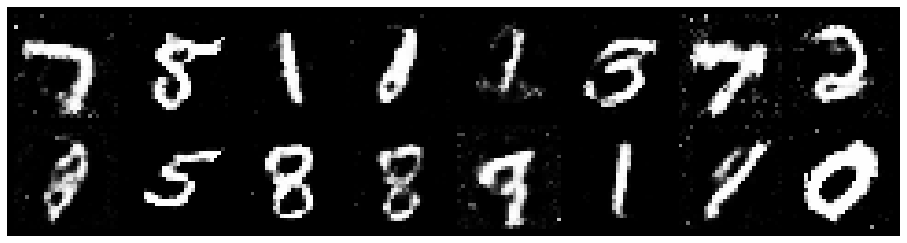

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.3304, Generator Loss: 0.9077
D(x): 0.5239, D(G(z)): 0.4559


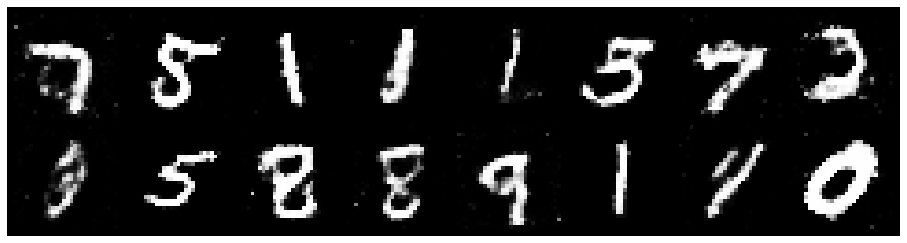

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3041, Generator Loss: 0.7450
D(x): 0.5338, D(G(z)): 0.4573


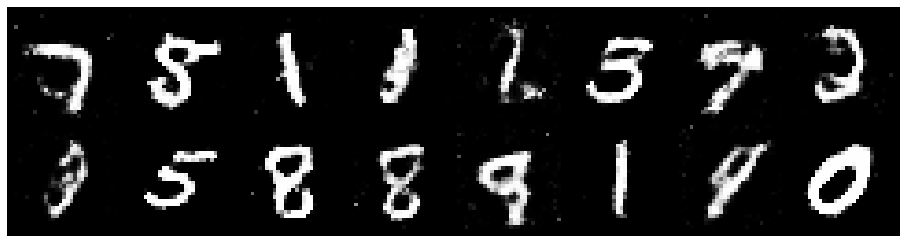

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2534, Generator Loss: 0.9728
D(x): 0.5294, D(G(z)): 0.4162


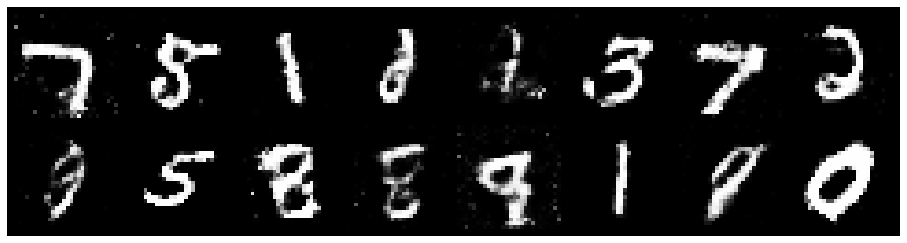

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2433, Generator Loss: 1.0391
D(x): 0.5674, D(G(z)): 0.4395


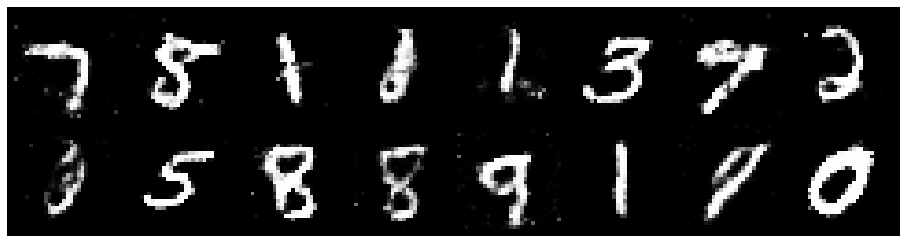

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8999
D(x): 0.5769, D(G(z)): 0.4799


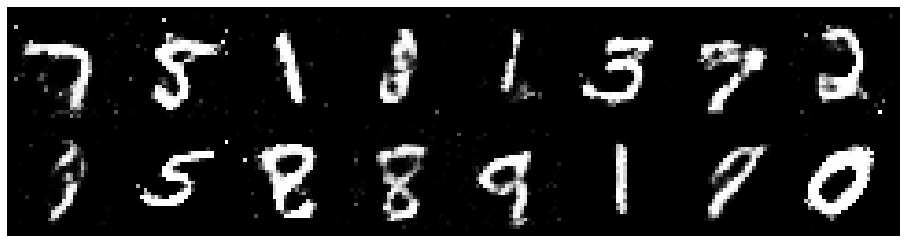

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2004, Generator Loss: 0.9016
D(x): 0.5473, D(G(z)): 0.4035


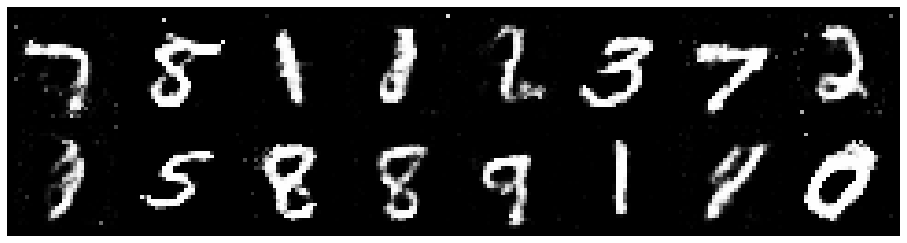

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2347, Generator Loss: 0.8598
D(x): 0.5846, D(G(z)): 0.4494


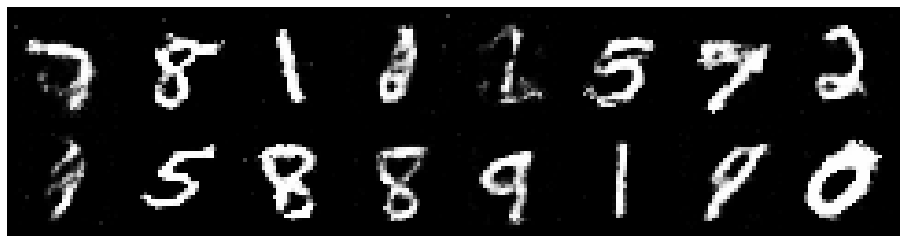

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2349, Generator Loss: 0.8562
D(x): 0.5515, D(G(z)): 0.4313


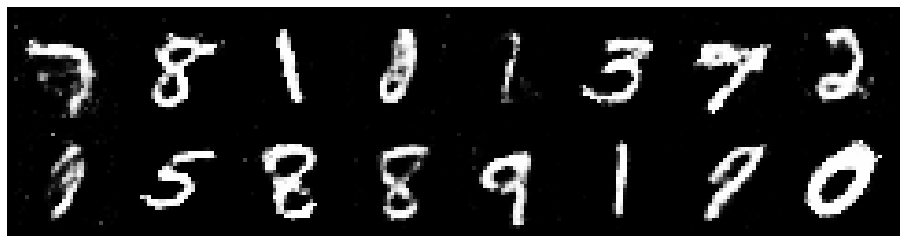

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.1786, Generator Loss: 0.8978
D(x): 0.5587, D(G(z)): 0.4093


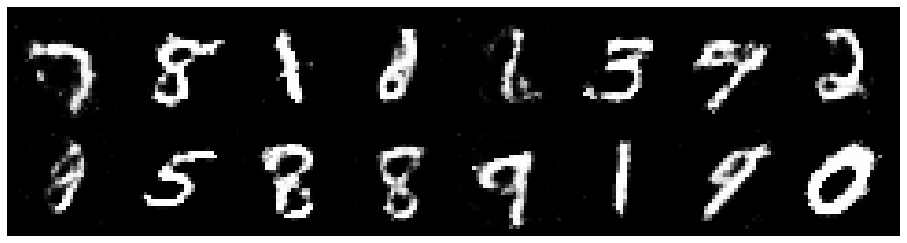

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2953, Generator Loss: 0.8652
D(x): 0.5410, D(G(z)): 0.4459


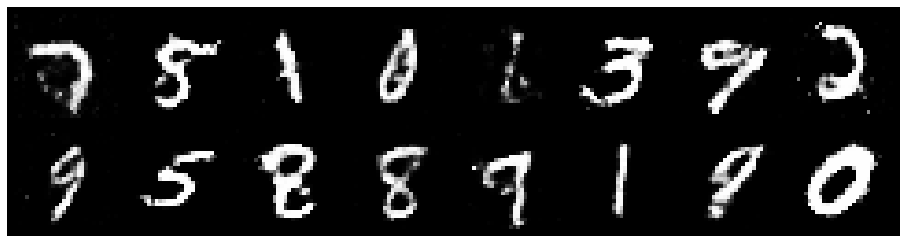

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2937, Generator Loss: 0.8533
D(x): 0.5594, D(G(z)): 0.4710


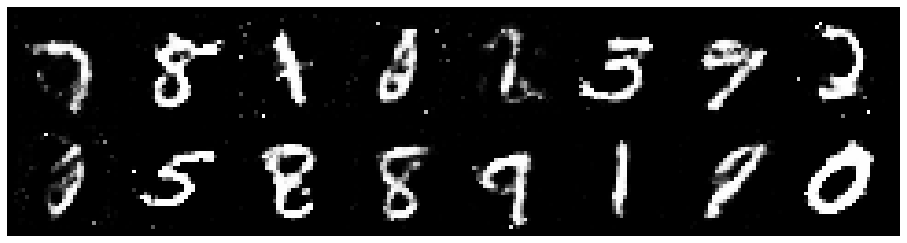

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.3520, Generator Loss: 0.8166
D(x): 0.5341, D(G(z)): 0.4671


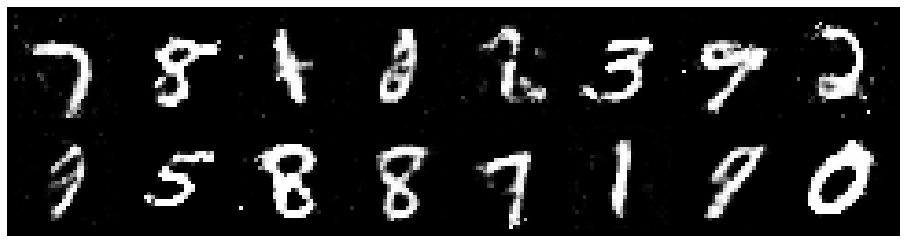

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8392
D(x): 0.5464, D(G(z)): 0.4515


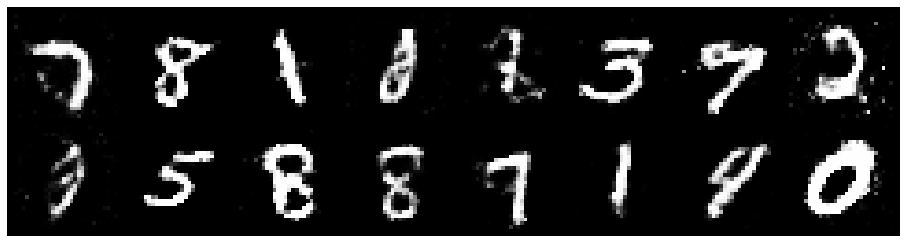

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.3468, Generator Loss: 0.8402
D(x): 0.5351, D(G(z)): 0.4547


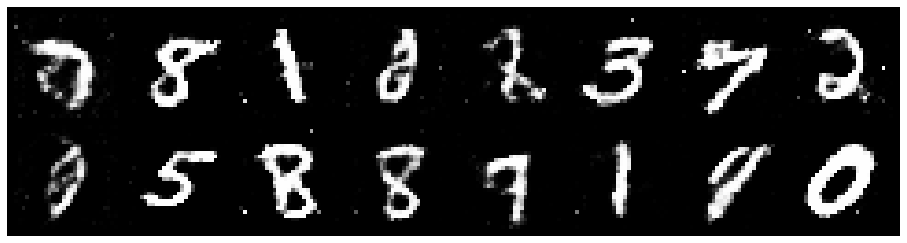

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3299, Generator Loss: 0.7904
D(x): 0.5550, D(G(z)): 0.4558


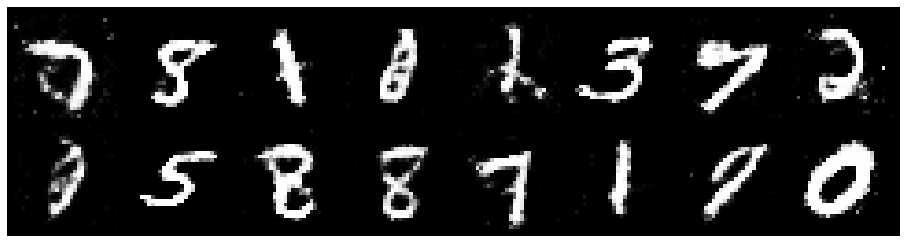

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.1873, Generator Loss: 0.9700
D(x): 0.5472, D(G(z)): 0.4001


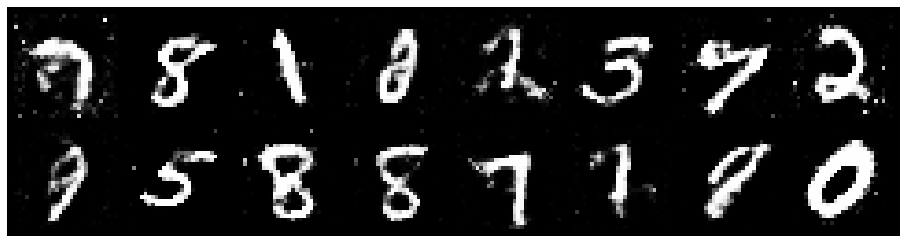

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.1838, Generator Loss: 1.0090
D(x): 0.5644, D(G(z)): 0.4062


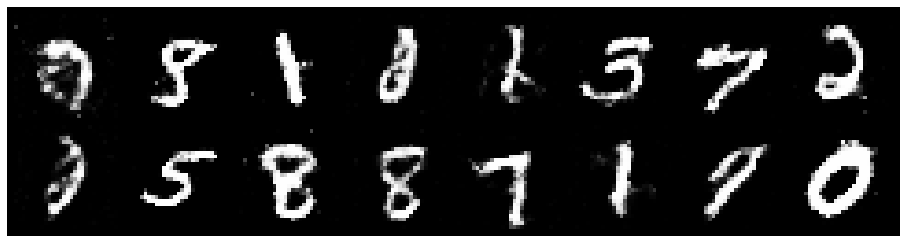

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3228, Generator Loss: 0.8910
D(x): 0.5421, D(G(z)): 0.4521


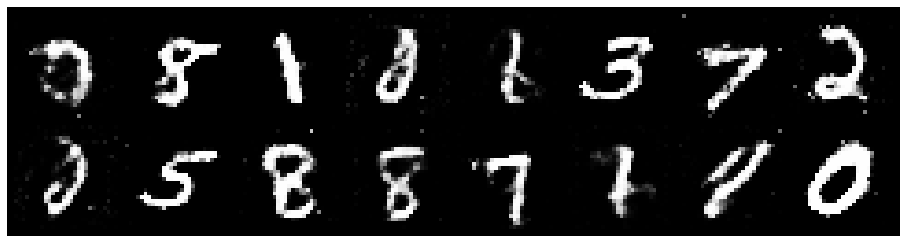

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.2224, Generator Loss: 0.9089
D(x): 0.5300, D(G(z)): 0.3880


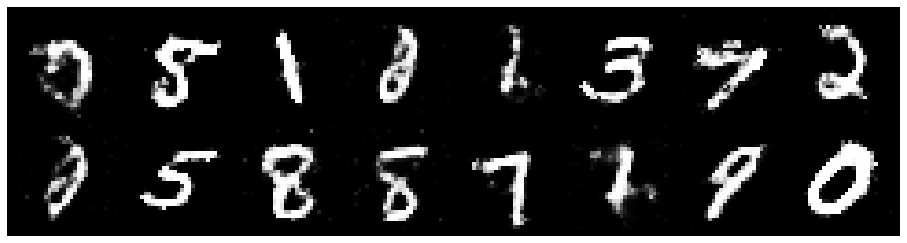

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3813, Generator Loss: 0.8120
D(x): 0.5815, D(G(z)): 0.5062


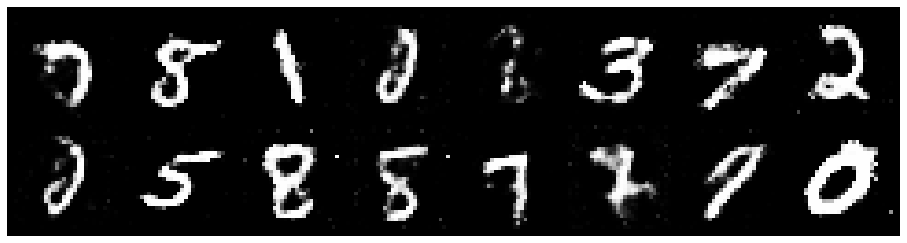

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.3289, Generator Loss: 0.8475
D(x): 0.5116, D(G(z)): 0.4358


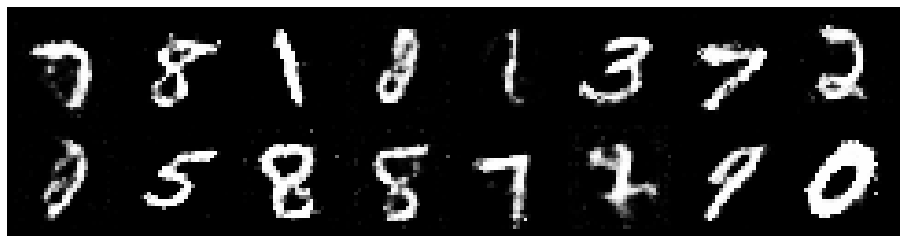

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.3639, Generator Loss: 0.7821
D(x): 0.5099, D(G(z)): 0.4547


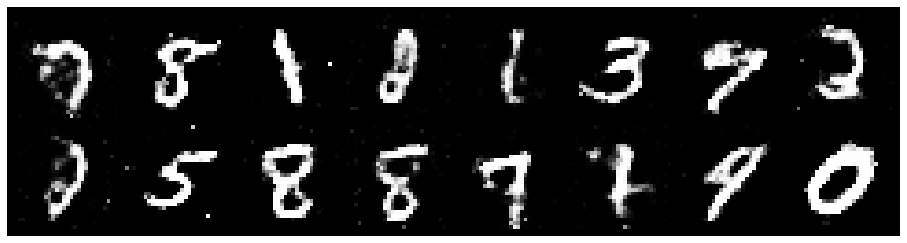

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2792, Generator Loss: 0.9665
D(x): 0.5558, D(G(z)): 0.4476


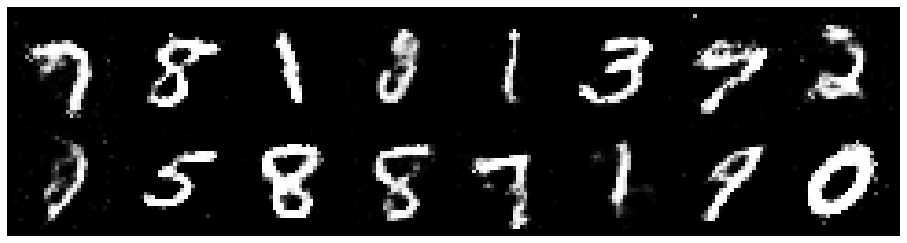

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3937, Generator Loss: 0.9858
D(x): 0.5600, D(G(z)): 0.4940


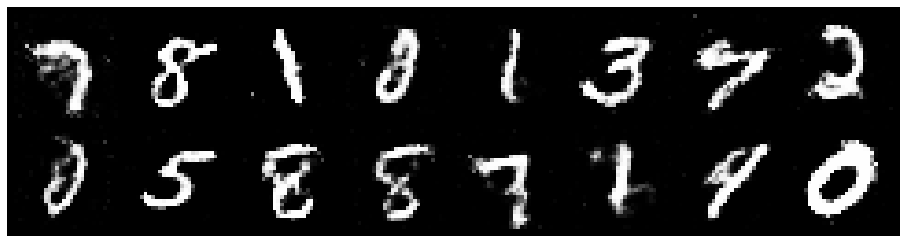

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2464, Generator Loss: 0.9202
D(x): 0.5562, D(G(z)): 0.4377


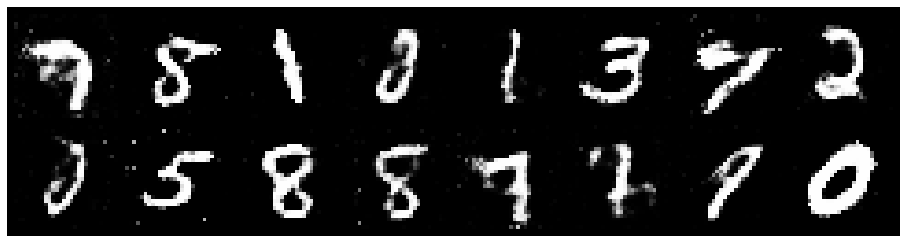

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.1826, Generator Loss: 0.9637
D(x): 0.5623, D(G(z)): 0.4054


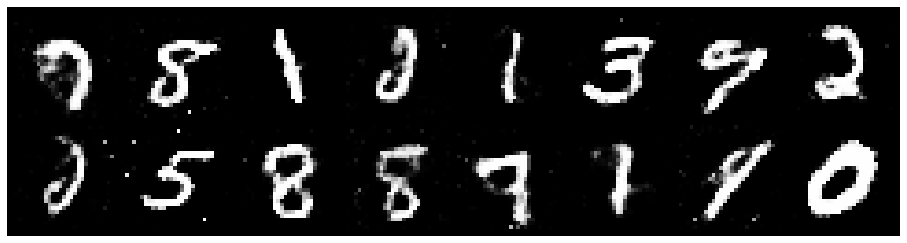

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.1748, Generator Loss: 0.9053
D(x): 0.5802, D(G(z)): 0.4153


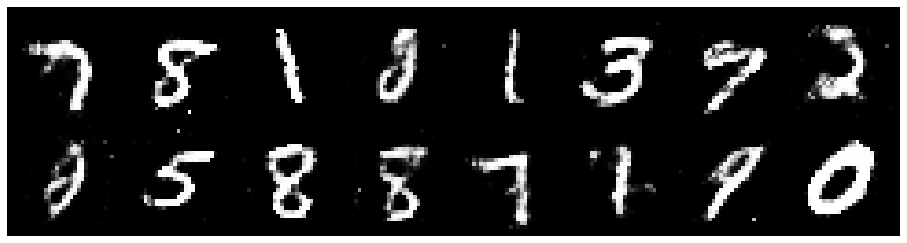

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2749, Generator Loss: 0.9127
D(x): 0.5665, D(G(z)): 0.4464


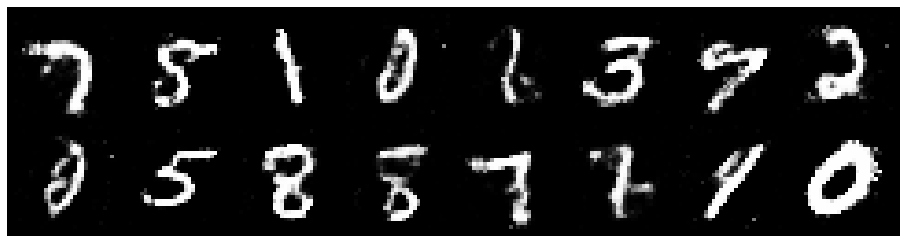

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.2980, Generator Loss: 0.8074
D(x): 0.5512, D(G(z)): 0.4592


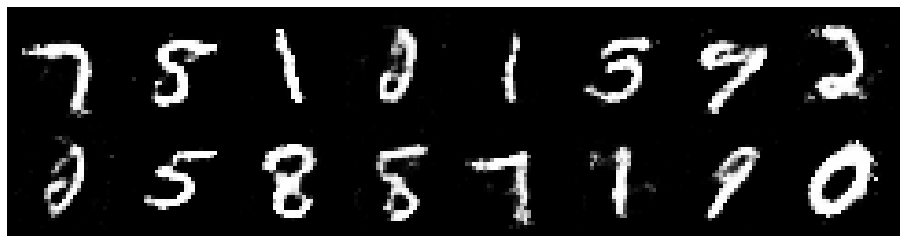

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.3158, Generator Loss: 0.8825
D(x): 0.5791, D(G(z)): 0.4833


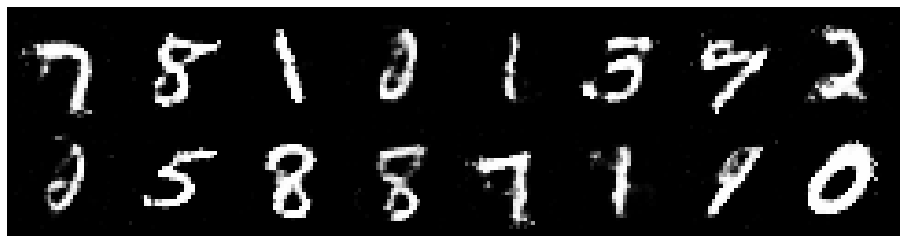

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2467, Generator Loss: 0.8517
D(x): 0.5646, D(G(z)): 0.4600


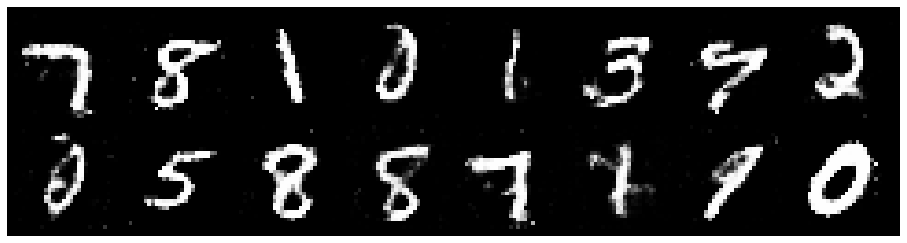

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2475, Generator Loss: 1.0362
D(x): 0.5378, D(G(z)): 0.4240


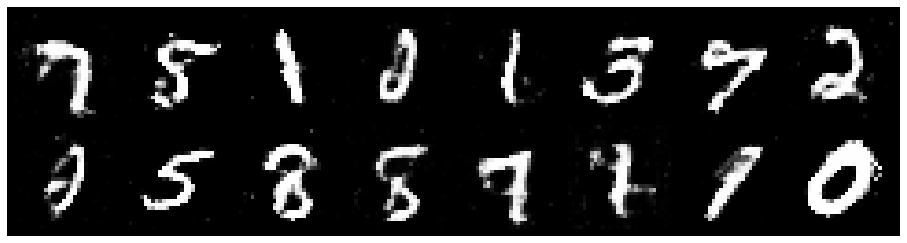

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.1999, Generator Loss: 0.9393
D(x): 0.6023, D(G(z)): 0.4318


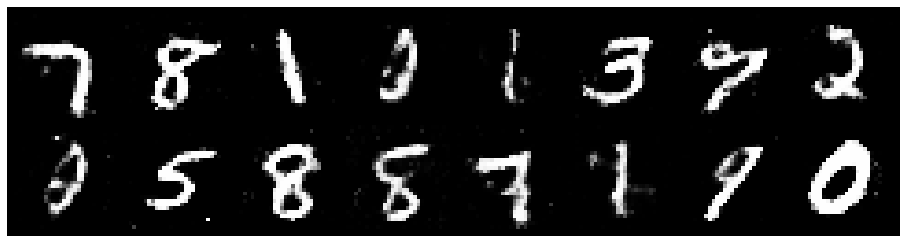

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2843, Generator Loss: 0.9090
D(x): 0.5445, D(G(z)): 0.4344


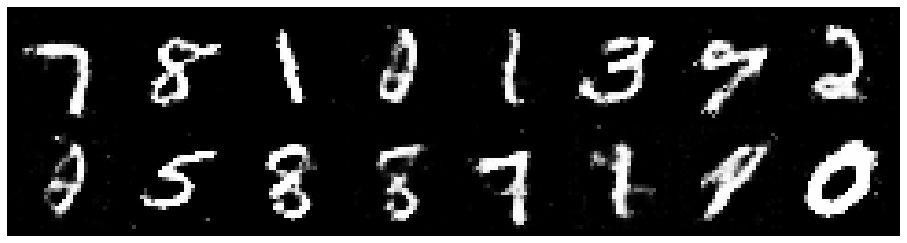

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.3827, Generator Loss: 0.9243
D(x): 0.5080, D(G(z)): 0.4537


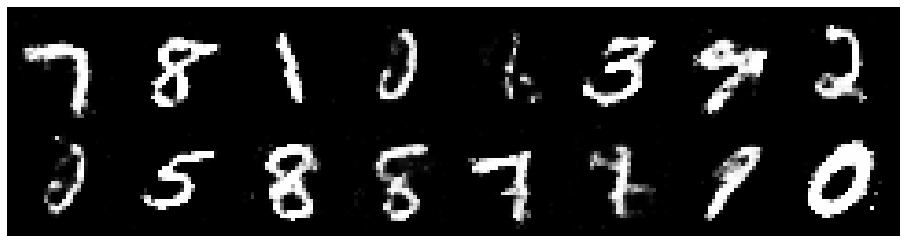

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3592, Generator Loss: 0.7612
D(x): 0.5442, D(G(z)): 0.4890


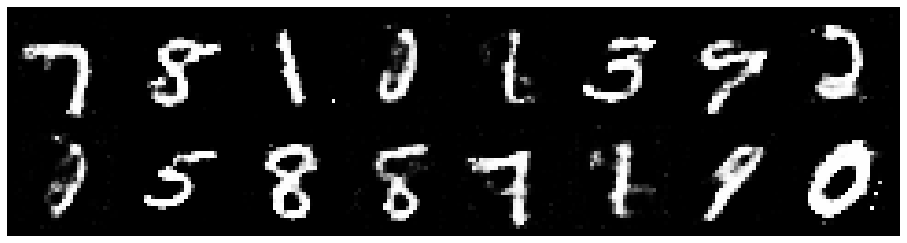

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.3215, Generator Loss: 0.8093
D(x): 0.5291, D(G(z)): 0.4525


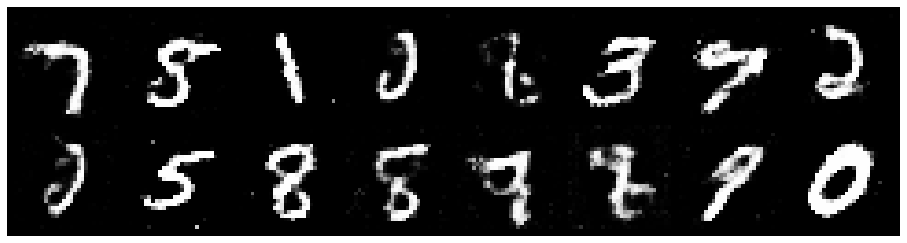

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.3097, Generator Loss: 0.8973
D(x): 0.5322, D(G(z)): 0.4426


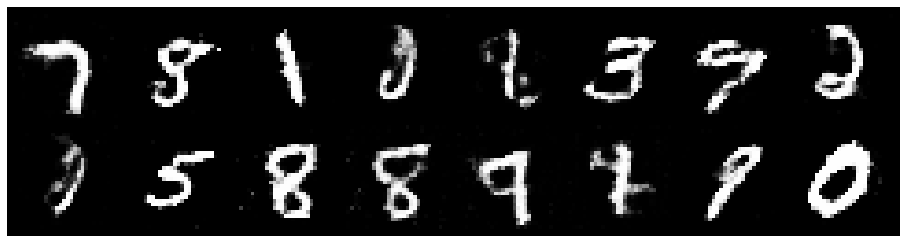

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2957, Generator Loss: 0.8713
D(x): 0.5313, D(G(z)): 0.4546


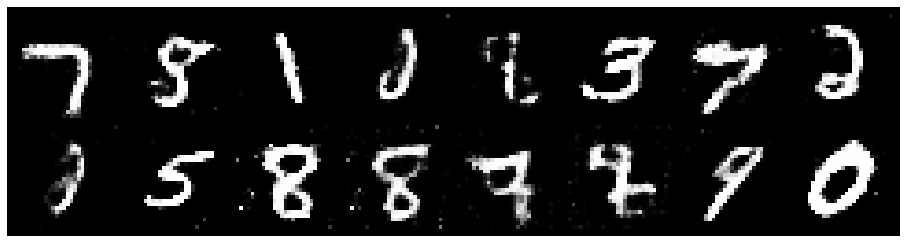

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2638, Generator Loss: 0.8603
D(x): 0.5380, D(G(z)): 0.4198


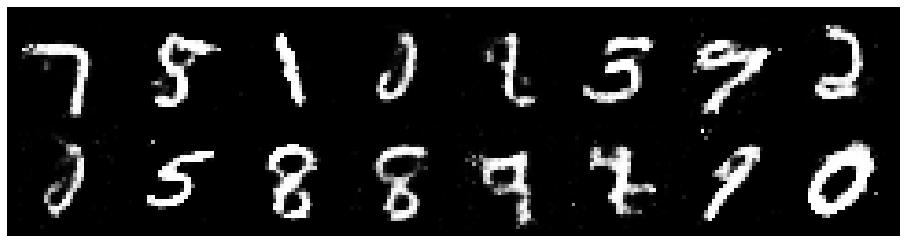

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2438, Generator Loss: 0.9850
D(x): 0.5626, D(G(z)): 0.4338


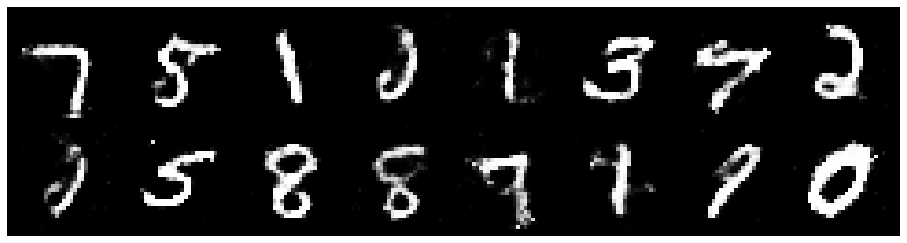

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.3381, Generator Loss: 0.9476
D(x): 0.5232, D(G(z)): 0.4374


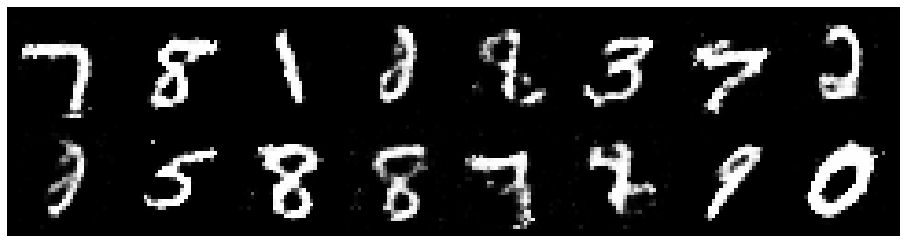

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2177, Generator Loss: 0.8436
D(x): 0.5695, D(G(z)): 0.4337


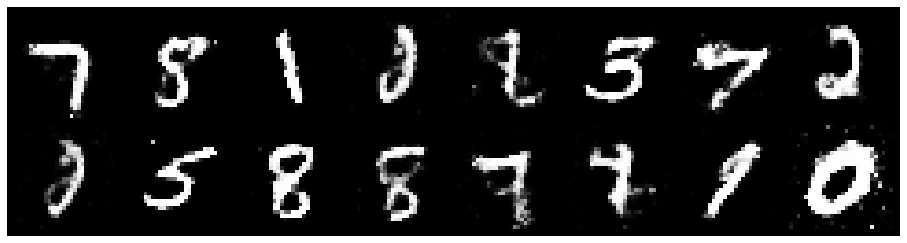

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2238, Generator Loss: 0.8316
D(x): 0.5699, D(G(z)): 0.4445


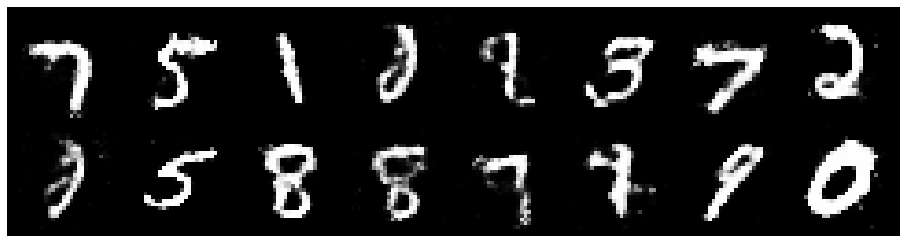

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.1976, Generator Loss: 0.8486
D(x): 0.5841, D(G(z)): 0.4341


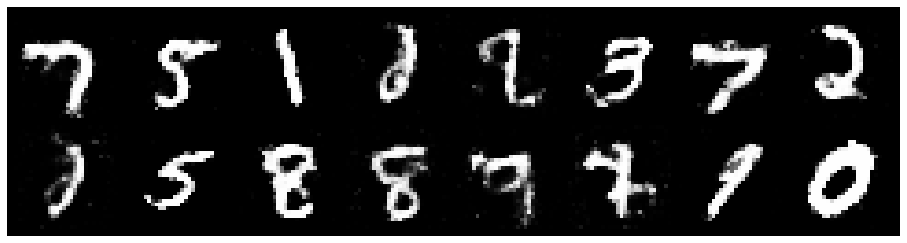

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2815, Generator Loss: 0.9395
D(x): 0.5433, D(G(z)): 0.4298


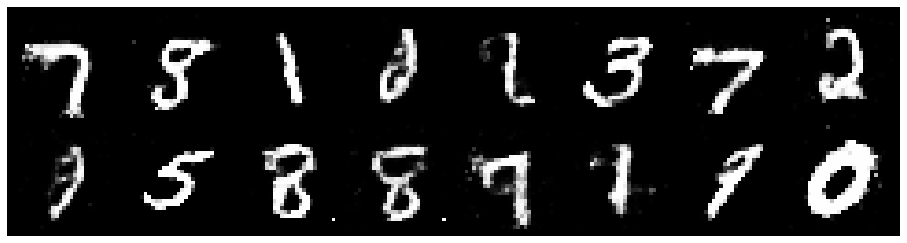

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.2572, Generator Loss: 0.8887
D(x): 0.5250, D(G(z)): 0.3924


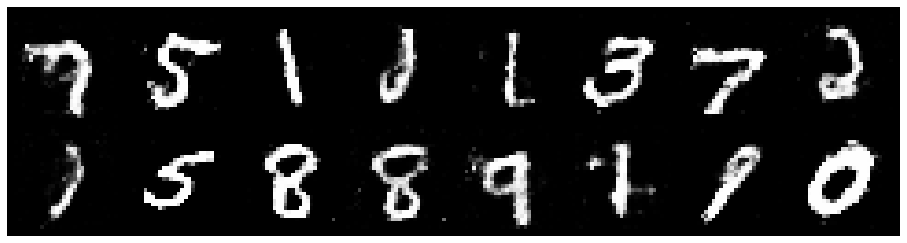

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2228, Generator Loss: 0.9887
D(x): 0.5399, D(G(z)): 0.4040


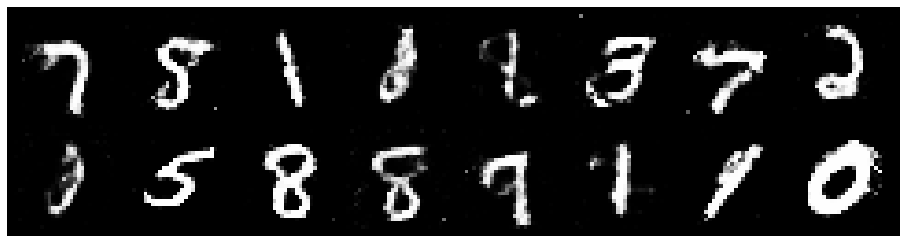

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2611, Generator Loss: 0.8819
D(x): 0.5343, D(G(z)): 0.4304


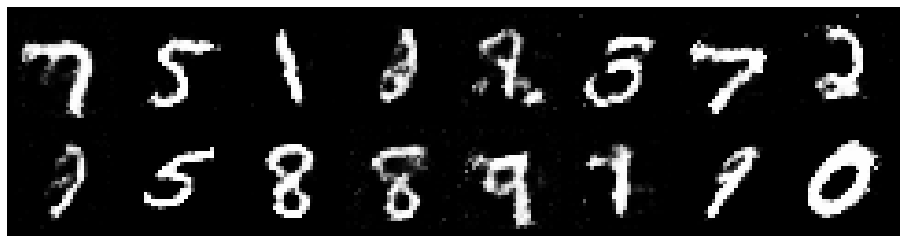

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2607, Generator Loss: 0.9117
D(x): 0.5751, D(G(z)): 0.4618


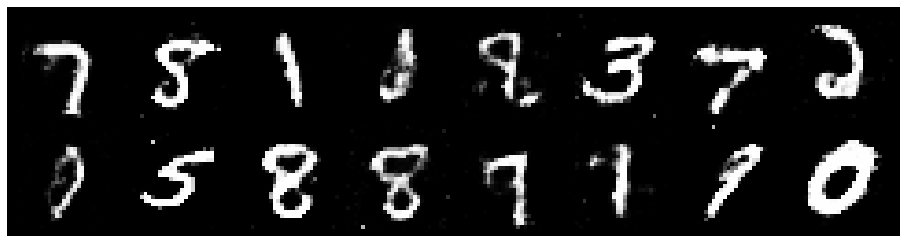

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2611, Generator Loss: 0.8661
D(x): 0.5679, D(G(z)): 0.4463


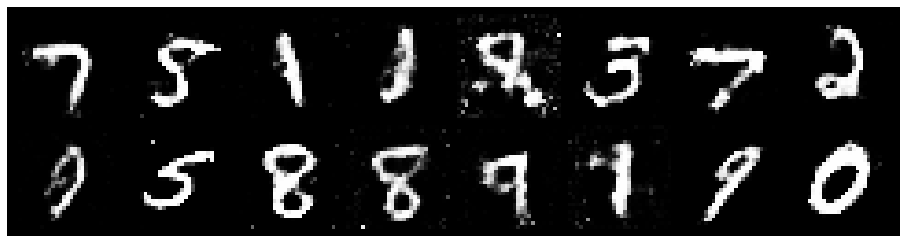

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.2264, Generator Loss: 0.8976
D(x): 0.5688, D(G(z)): 0.4331


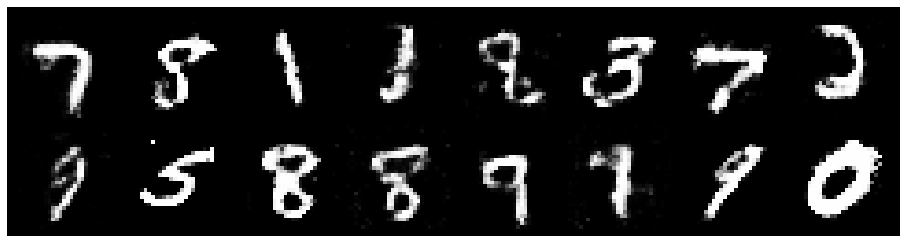

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2699, Generator Loss: 0.9112
D(x): 0.5628, D(G(z)): 0.4312


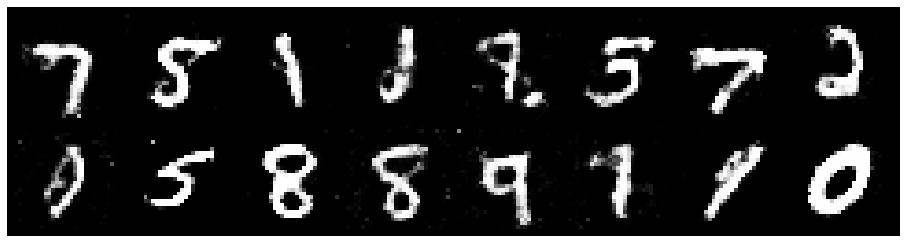

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.3274, Generator Loss: 0.8949
D(x): 0.5339, D(G(z)): 0.4423


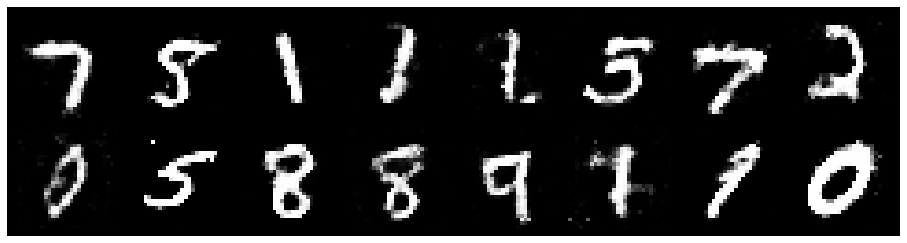

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2520, Generator Loss: 0.7768
D(x): 0.5621, D(G(z)): 0.4653


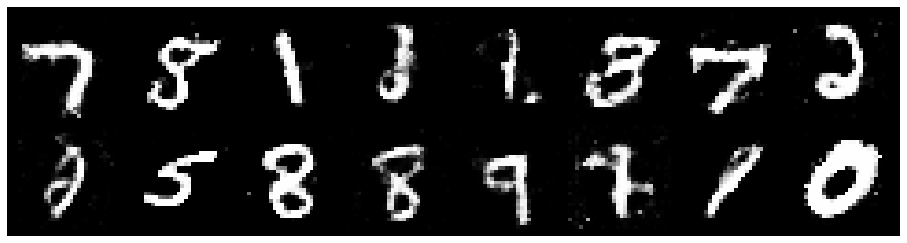

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.3013, Generator Loss: 0.8700
D(x): 0.5318, D(G(z)): 0.4446


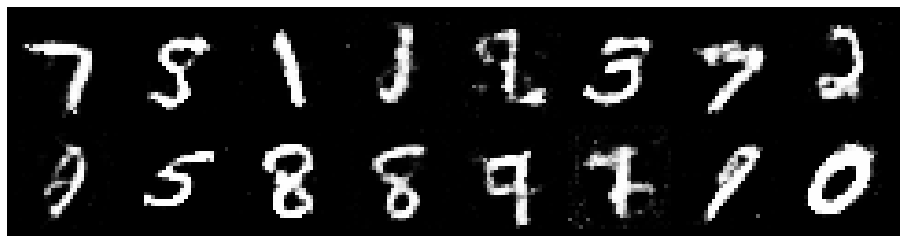

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.3656, Generator Loss: 0.8223
D(x): 0.5140, D(G(z)): 0.4439


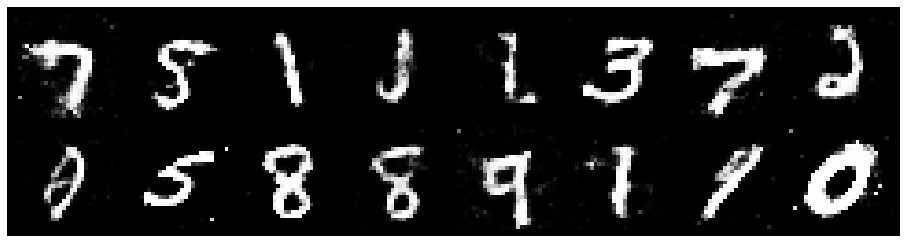

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.1801, Generator Loss: 0.8102
D(x): 0.5999, D(G(z)): 0.4466


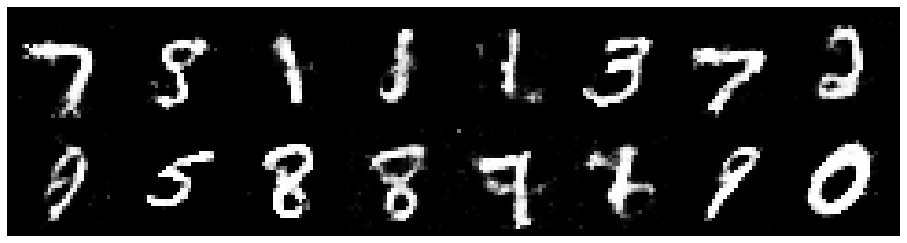

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2201, Generator Loss: 0.9551
D(x): 0.5689, D(G(z)): 0.4218


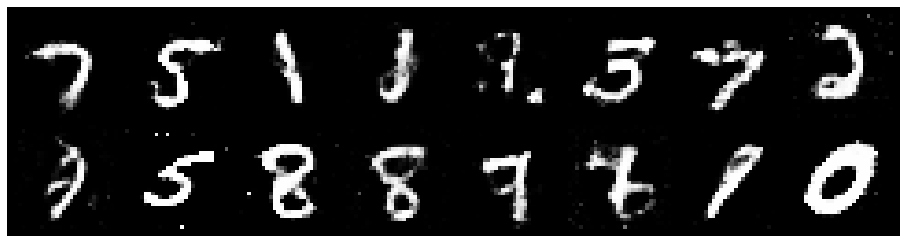

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9473
D(x): 0.5844, D(G(z)): 0.4356


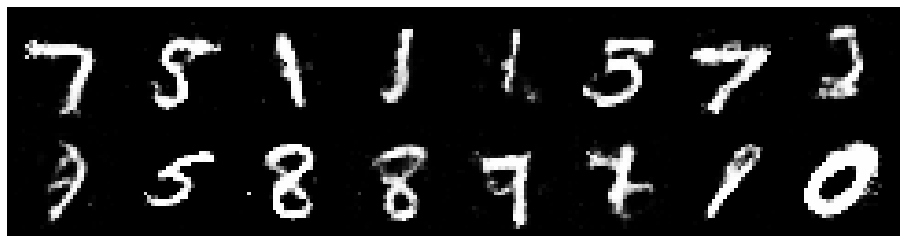

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2674, Generator Loss: 0.9552
D(x): 0.5646, D(G(z)): 0.4479


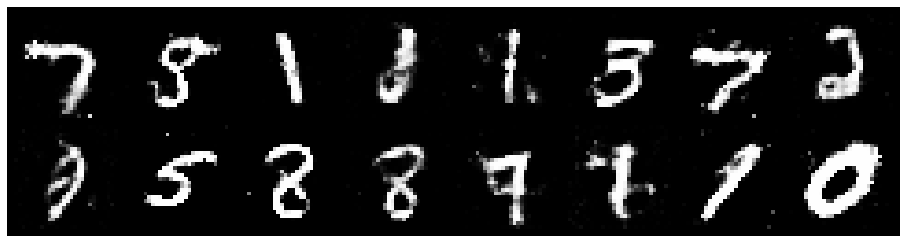

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2893, Generator Loss: 0.7939
D(x): 0.5484, D(G(z)): 0.4454


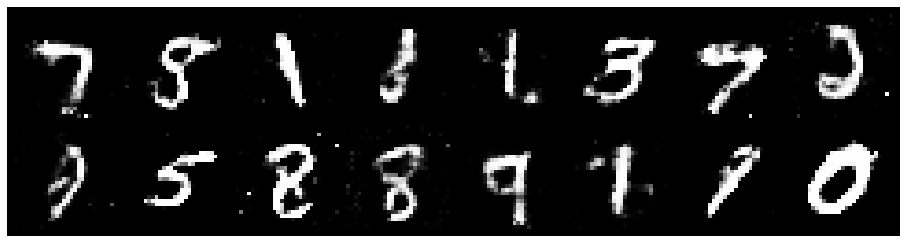

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2213, Generator Loss: 0.8711
D(x): 0.5494, D(G(z)): 0.4183


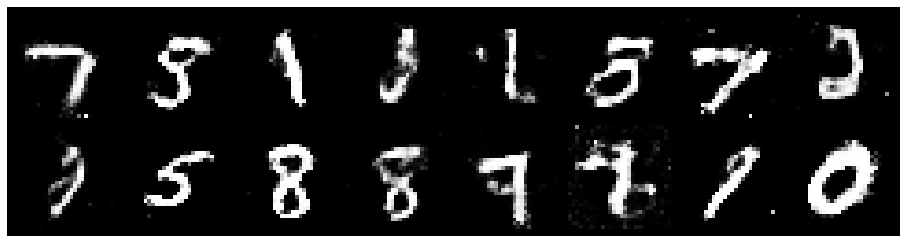

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3095, Generator Loss: 0.7635
D(x): 0.5566, D(G(z)): 0.4711


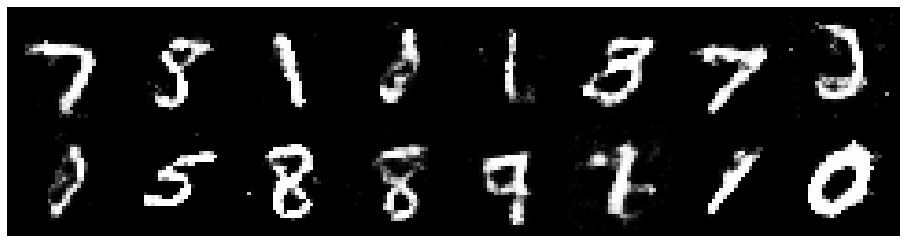

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.3840, Generator Loss: 0.8177
D(x): 0.5216, D(G(z)): 0.4801


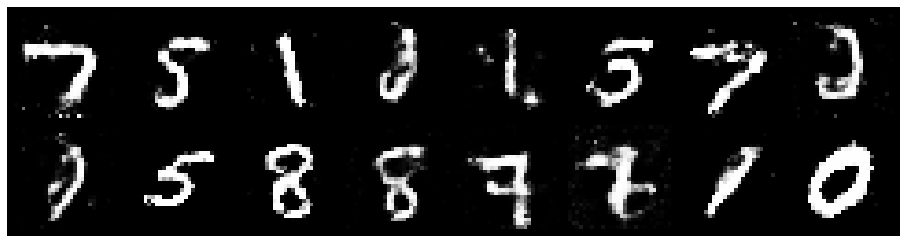

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2219, Generator Loss: 0.7923
D(x): 0.5679, D(G(z)): 0.4479


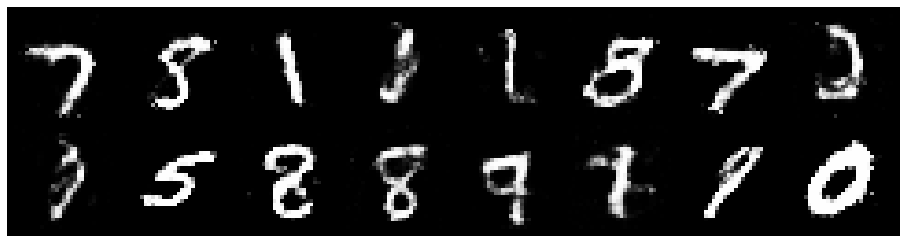

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.1778, Generator Loss: 0.9142
D(x): 0.5574, D(G(z)): 0.4032


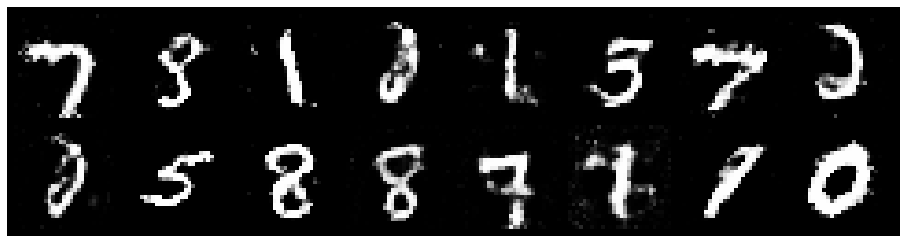

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2914, Generator Loss: 0.9632
D(x): 0.5502, D(G(z)): 0.4377


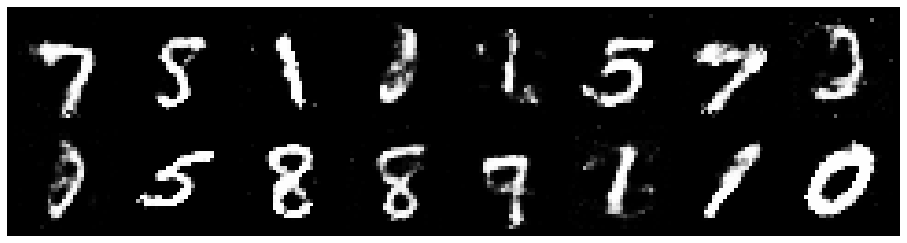

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2860, Generator Loss: 0.8722
D(x): 0.5902, D(G(z)): 0.4785


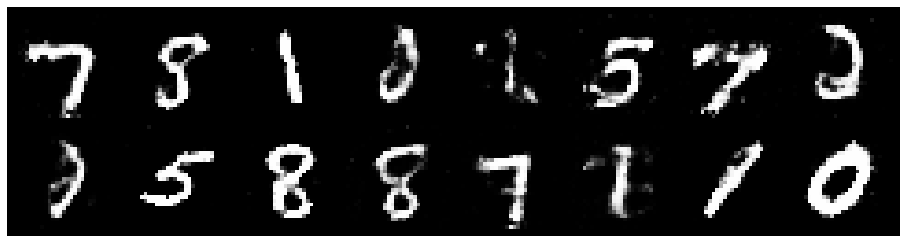

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.3026, Generator Loss: 0.8267
D(x): 0.5451, D(G(z)): 0.4624


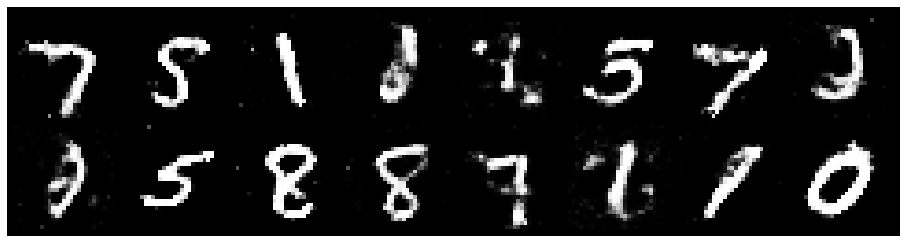

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2226, Generator Loss: 1.0168
D(x): 0.5272, D(G(z)): 0.3981


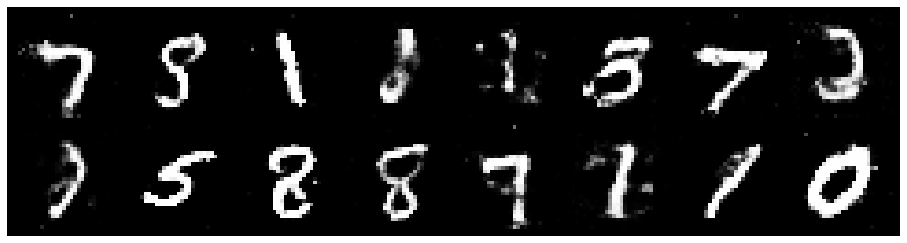

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2437, Generator Loss: 0.9939
D(x): 0.5579, D(G(z)): 0.4158


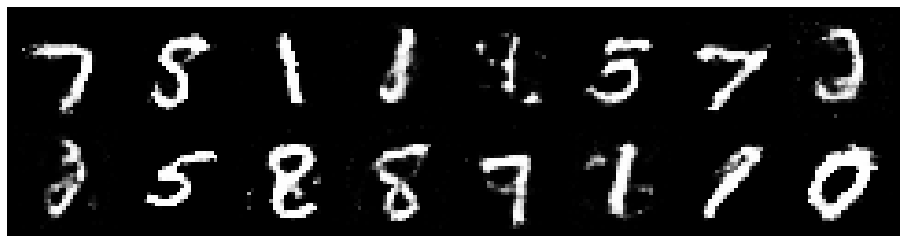

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.3681, Generator Loss: 0.8747
D(x): 0.4978, D(G(z)): 0.4274


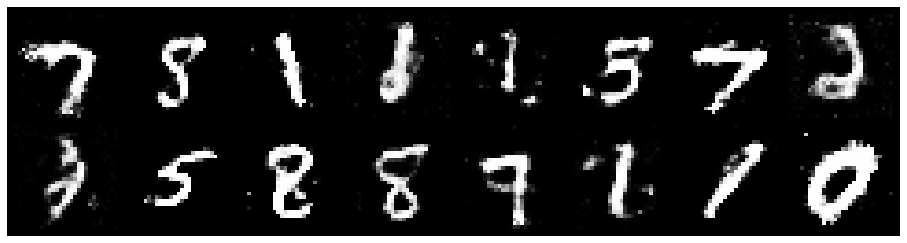

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2698, Generator Loss: 0.8312
D(x): 0.5523, D(G(z)): 0.4366


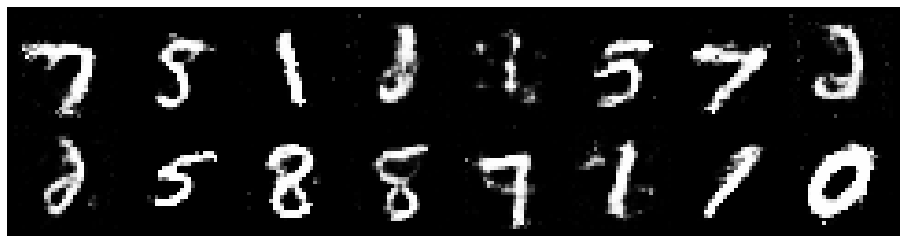

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2524, Generator Loss: 0.7971
D(x): 0.5683, D(G(z)): 0.4485


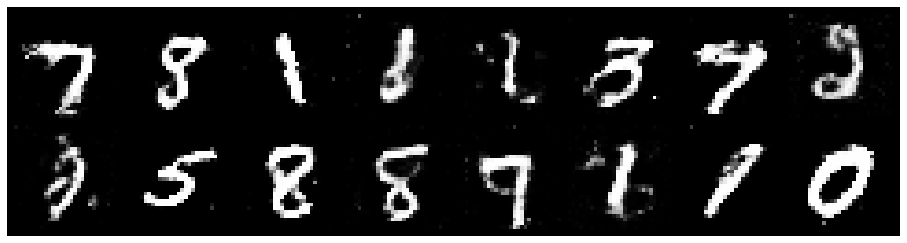

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.3194, Generator Loss: 0.8461
D(x): 0.5708, D(G(z)): 0.4907


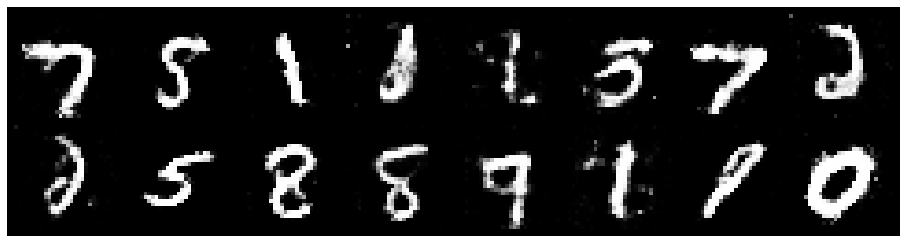

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3301, Generator Loss: 0.8275
D(x): 0.5220, D(G(z)): 0.4576


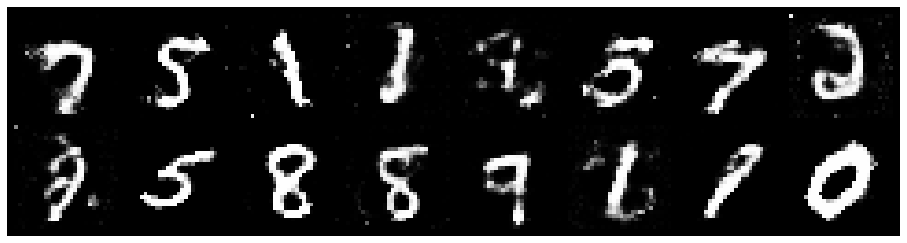

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.2335, Generator Loss: 0.8938
D(x): 0.5497, D(G(z)): 0.4154


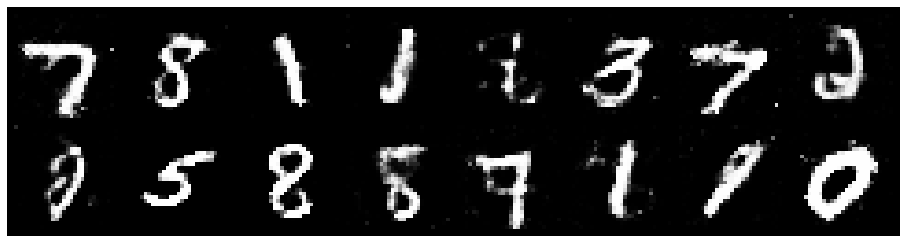

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2139, Generator Loss: 0.9016
D(x): 0.5665, D(G(z)): 0.4223


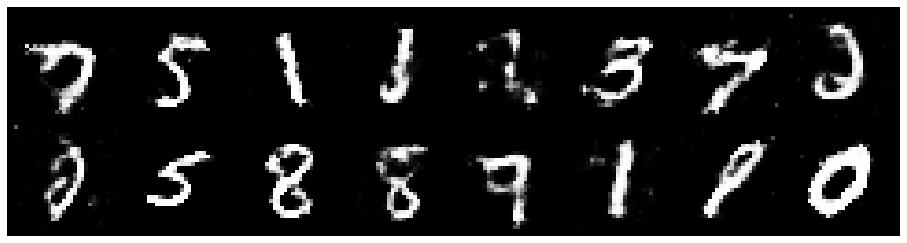

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.2944, Generator Loss: 0.8880
D(x): 0.5301, D(G(z)): 0.4283


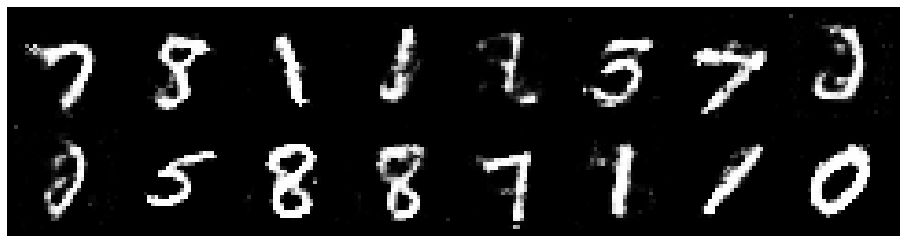

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.2561, Generator Loss: 0.9048
D(x): 0.5733, D(G(z)): 0.4598


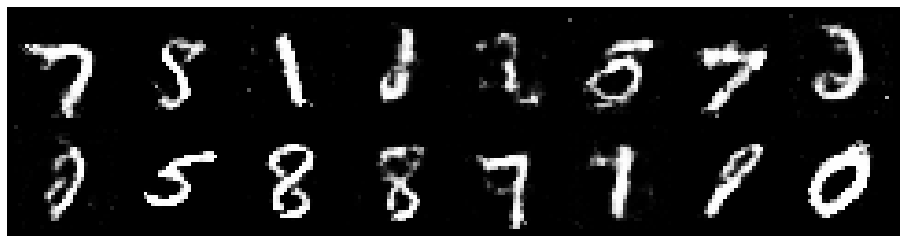

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.2445, Generator Loss: 0.8953
D(x): 0.5663, D(G(z)): 0.4446


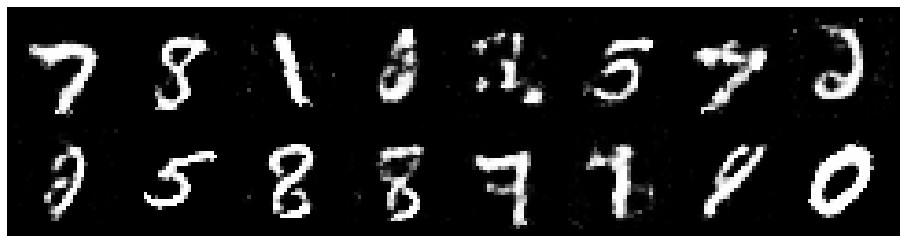

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.3443, Generator Loss: 0.7800
D(x): 0.5613, D(G(z)): 0.4909


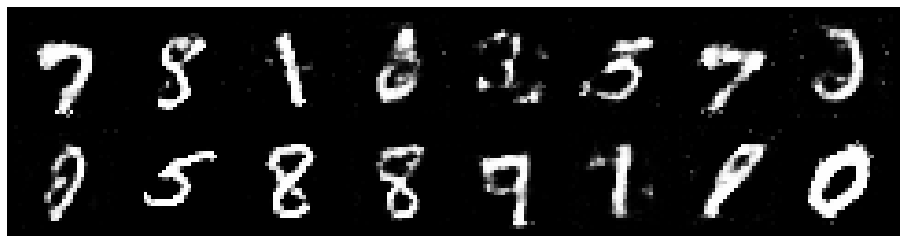

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3489, Generator Loss: 0.8744
D(x): 0.5016, D(G(z)): 0.4448


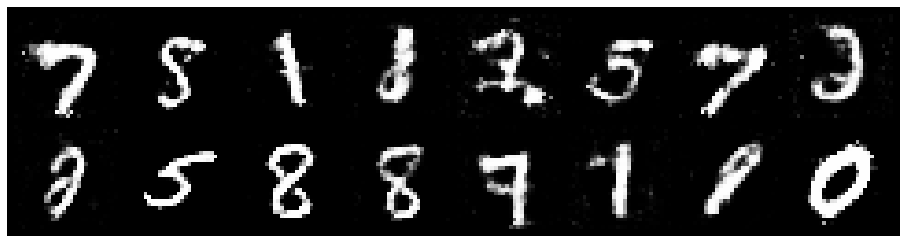

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3367, Generator Loss: 0.7585
D(x): 0.5603, D(G(z)): 0.5002


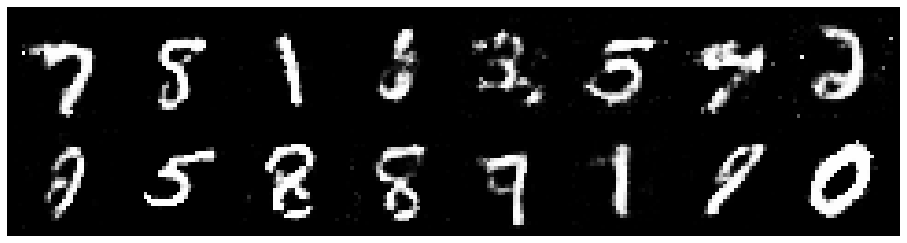

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.2967, Generator Loss: 0.8250
D(x): 0.5683, D(G(z)): 0.4814


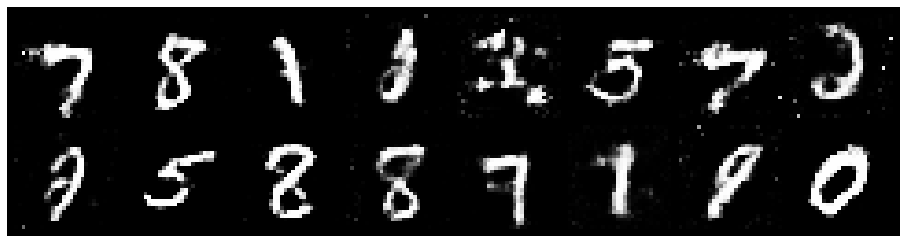

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2618, Generator Loss: 0.8620
D(x): 0.5575, D(G(z)): 0.4605


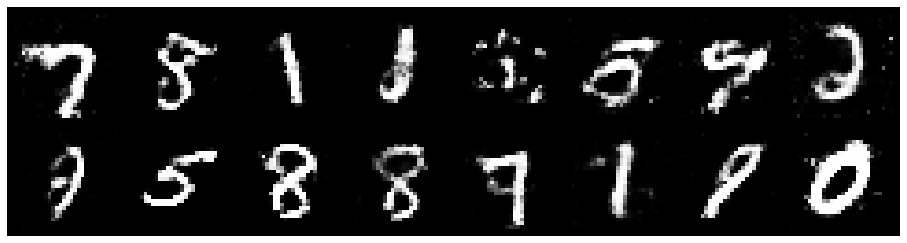

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2040, Generator Loss: 0.8608
D(x): 0.5869, D(G(z)): 0.4629


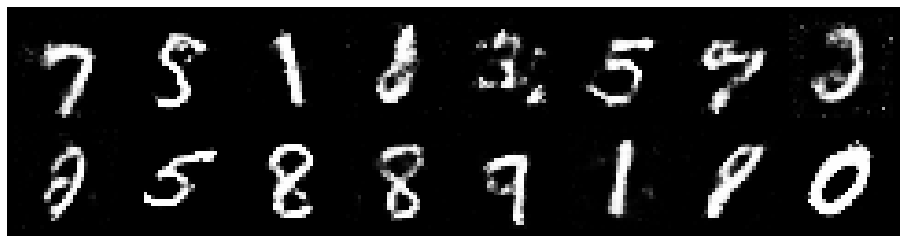

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2721, Generator Loss: 0.8617
D(x): 0.5468, D(G(z)): 0.4450


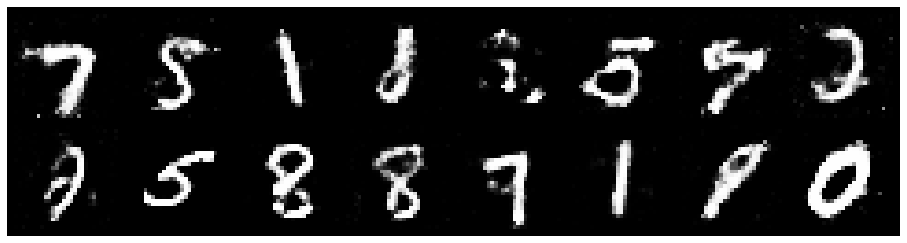

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.3459, Generator Loss: 0.8362
D(x): 0.5324, D(G(z)): 0.4631


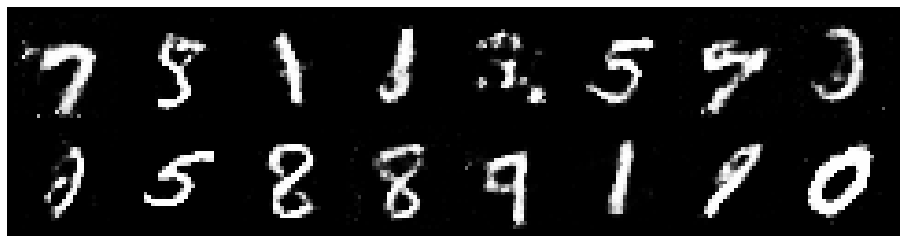

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3216, Generator Loss: 0.8230
D(x): 0.5195, D(G(z)): 0.4416


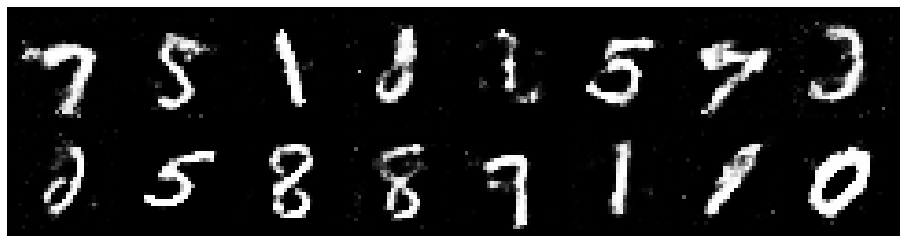

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3391, Generator Loss: 0.8198
D(x): 0.5565, D(G(z)): 0.4741


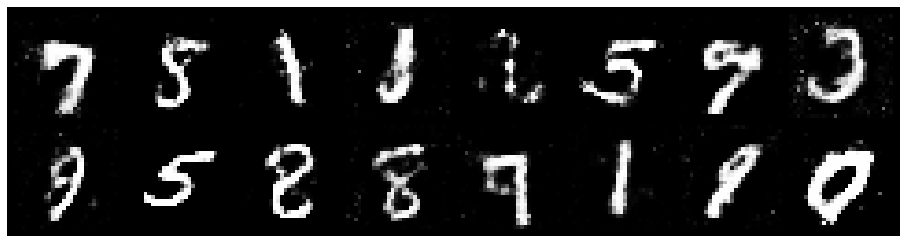

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2651, Generator Loss: 0.9950
D(x): 0.5300, D(G(z)): 0.4284


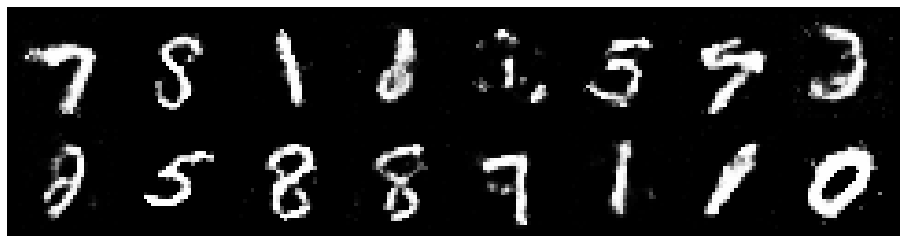

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.3355, Generator Loss: 0.8227
D(x): 0.5746, D(G(z)): 0.4933


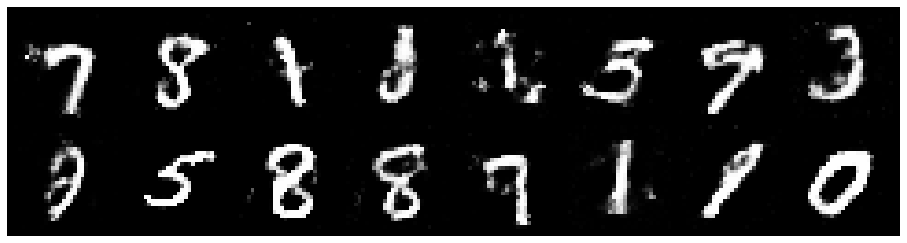

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2426, Generator Loss: 0.8618
D(x): 0.5629, D(G(z)): 0.4406


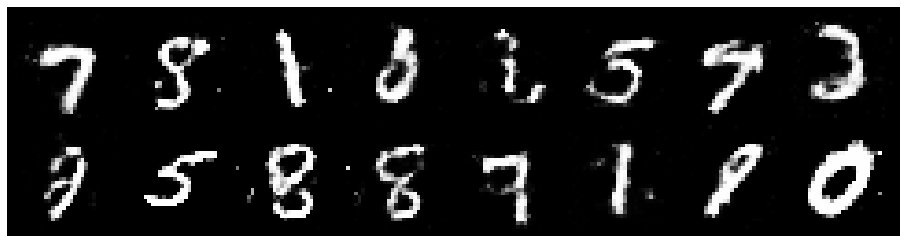

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.3362, Generator Loss: 0.7883
D(x): 0.5689, D(G(z)): 0.4905


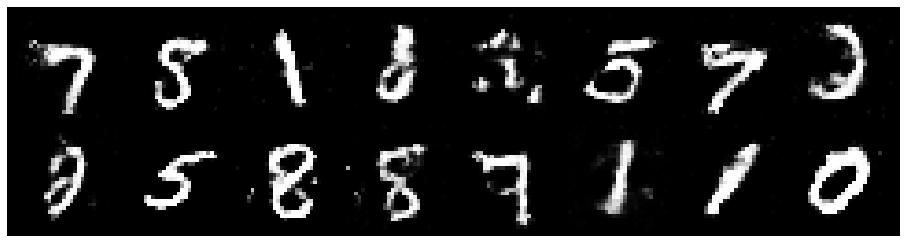

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.4072, Generator Loss: 0.8339
D(x): 0.5156, D(G(z)): 0.4716


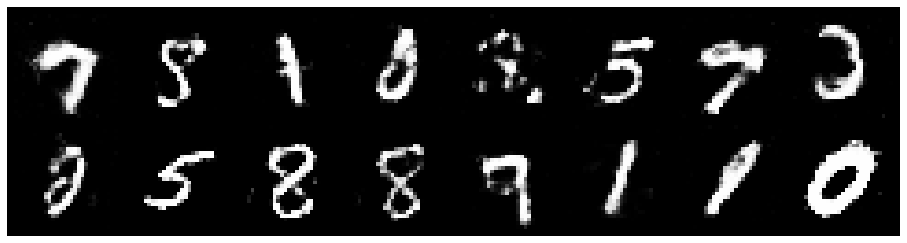

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.3889, Generator Loss: 0.8058
D(x): 0.5721, D(G(z)): 0.5120


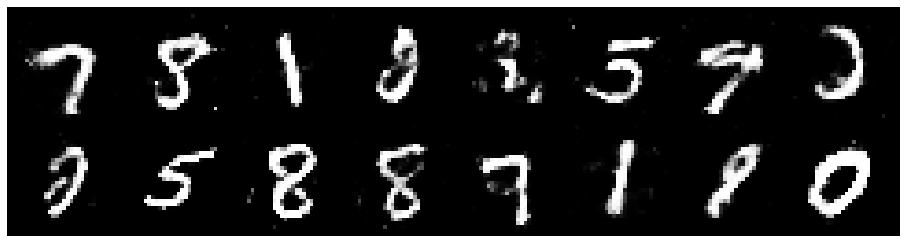

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2906, Generator Loss: 0.7584
D(x): 0.5300, D(G(z)): 0.4477


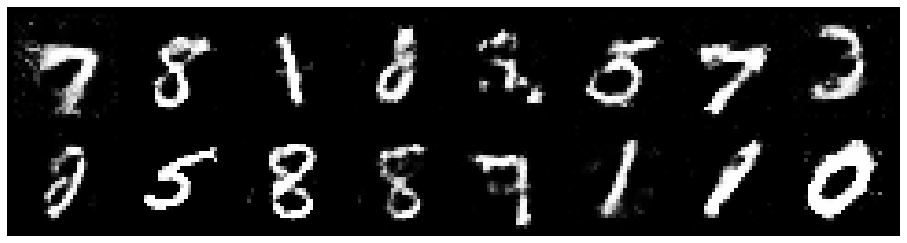

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.1711, Generator Loss: 0.9053
D(x): 0.5628, D(G(z)): 0.4087


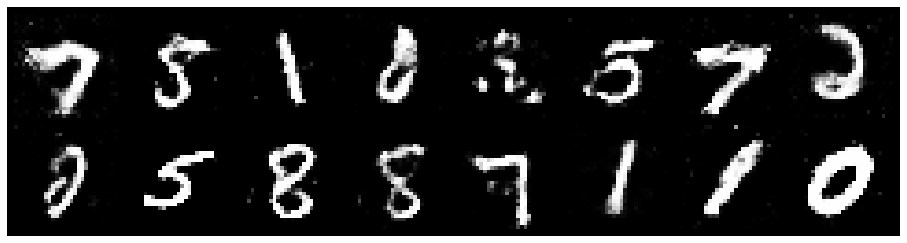

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.3445, Generator Loss: 0.8199
D(x): 0.5553, D(G(z)): 0.4812


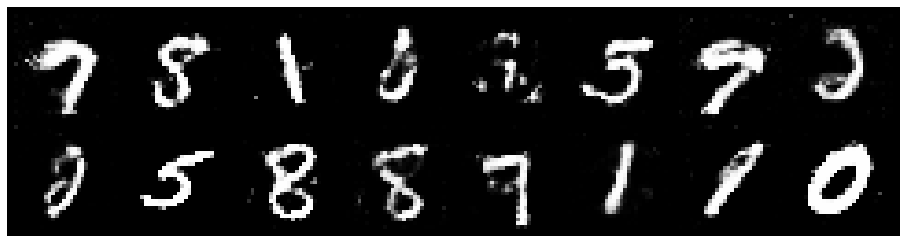

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.3323, Generator Loss: 0.8253
D(x): 0.5356, D(G(z)): 0.4458


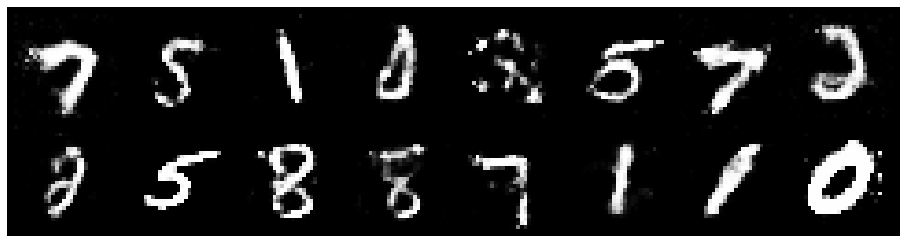

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.3165, Generator Loss: 0.7801
D(x): 0.5483, D(G(z)): 0.4884


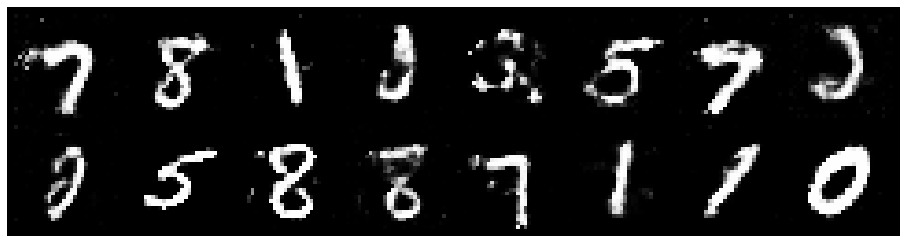

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9330
D(x): 0.5431, D(G(z)): 0.4311


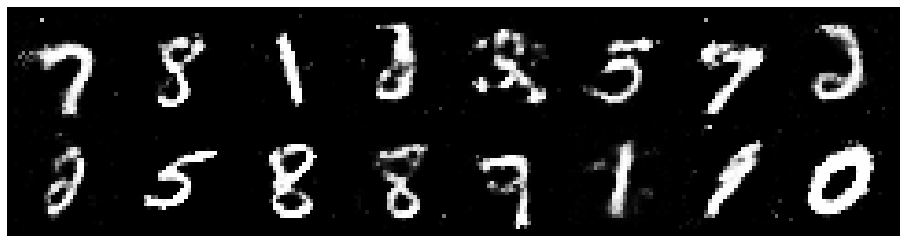

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2568, Generator Loss: 0.9219
D(x): 0.5626, D(G(z)): 0.4493


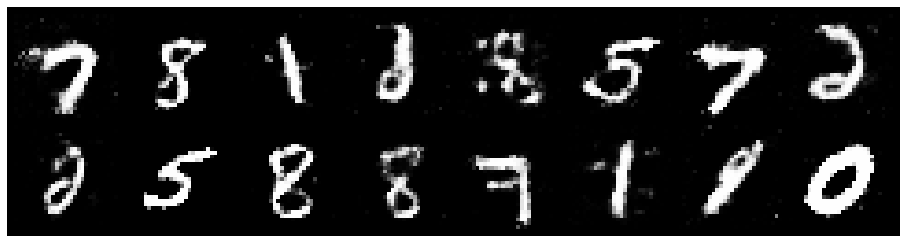

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.1908, Generator Loss: 1.0281
D(x): 0.5571, D(G(z)): 0.3891


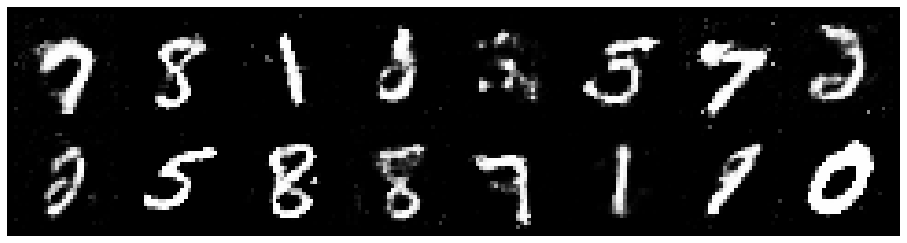

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.3561, Generator Loss: 0.8648
D(x): 0.5494, D(G(z)): 0.4624


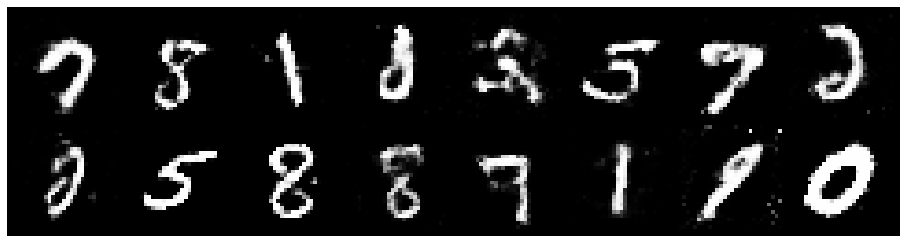

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.3297, Generator Loss: 0.9073
D(x): 0.5360, D(G(z)): 0.4591


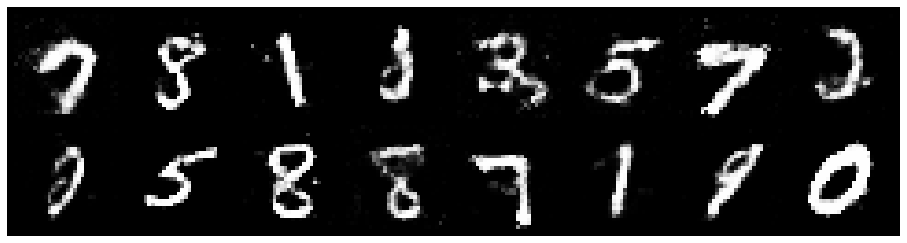

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8180
D(x): 0.5445, D(G(z)): 0.4515


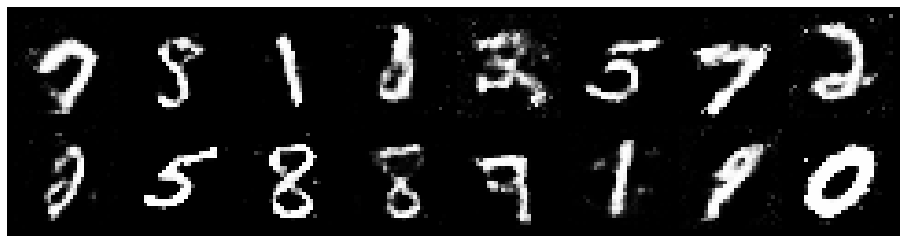

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.2586, Generator Loss: 0.9565
D(x): 0.5650, D(G(z)): 0.4450


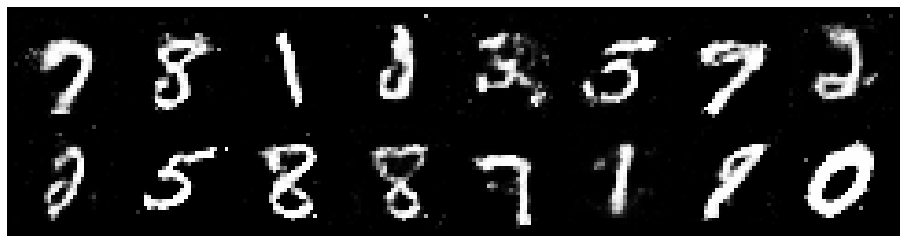

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.1744, Generator Loss: 0.9563
D(x): 0.5913, D(G(z)): 0.4088


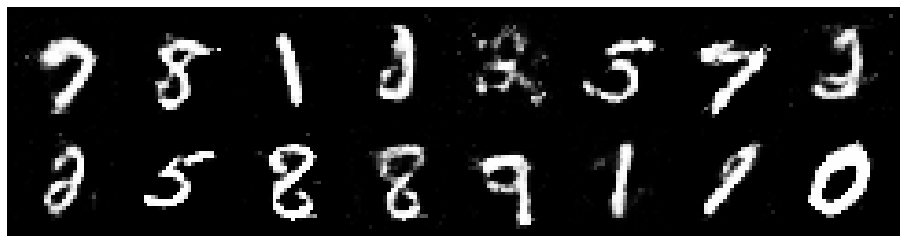

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.1888, Generator Loss: 0.9231
D(x): 0.5666, D(G(z)): 0.3985


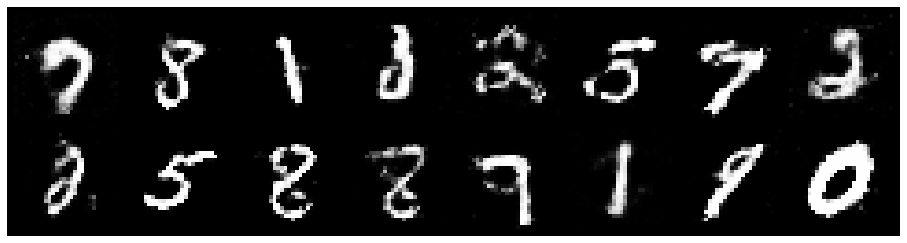

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3536, Generator Loss: 0.9029
D(x): 0.5288, D(G(z)): 0.4619


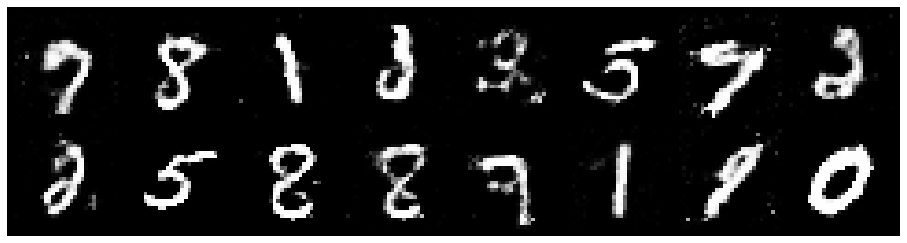

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3392, Generator Loss: 0.8912
D(x): 0.5194, D(G(z)): 0.4532


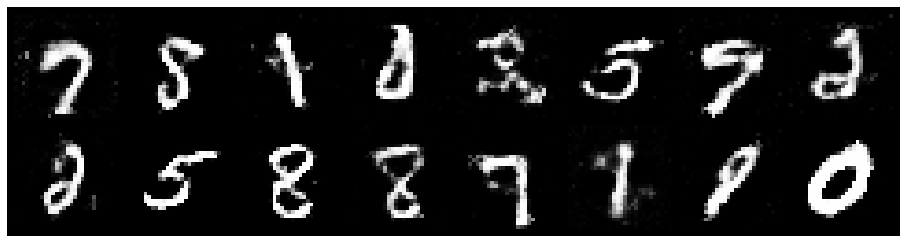

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.2820, Generator Loss: 0.8178
D(x): 0.5578, D(G(z)): 0.4653


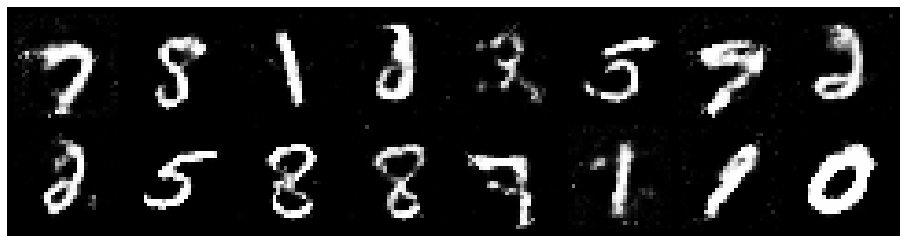

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3005, Generator Loss: 0.8899
D(x): 0.5235, D(G(z)): 0.4491


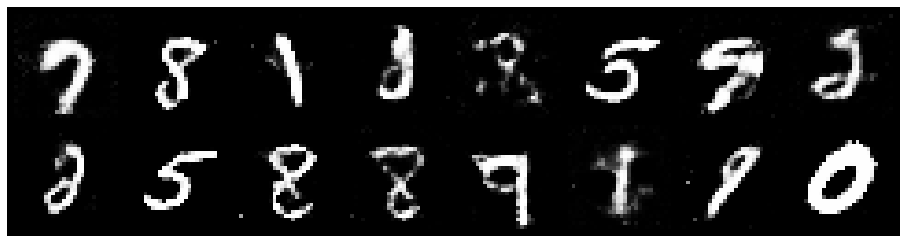

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2886, Generator Loss: 0.9267
D(x): 0.5288, D(G(z)): 0.4455


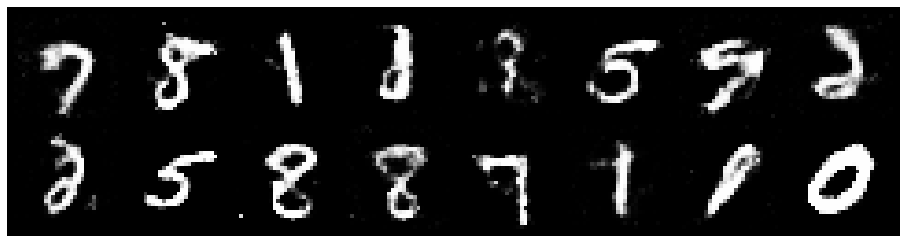

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.1360, Generator Loss: 0.8779
D(x): 0.6063, D(G(z)): 0.4274


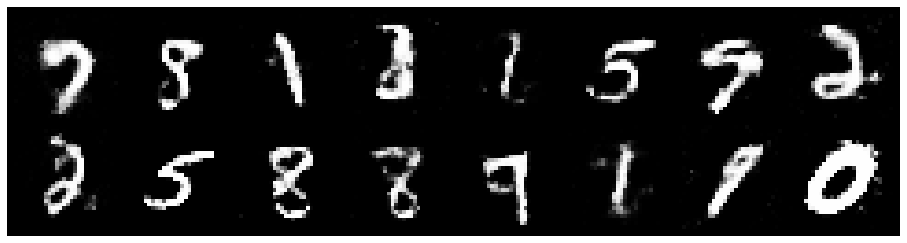

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2324, Generator Loss: 1.0311
D(x): 0.5316, D(G(z)): 0.4041


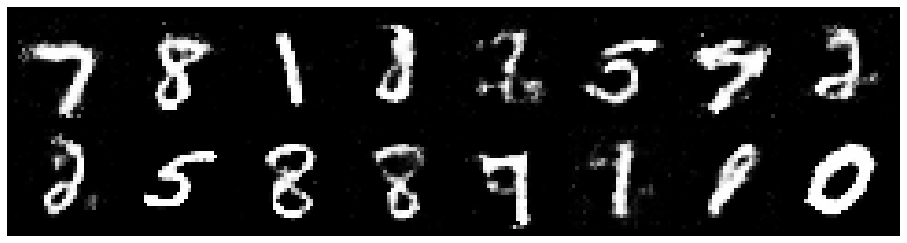

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2106, Generator Loss: 1.0389
D(x): 0.5740, D(G(z)): 0.4211


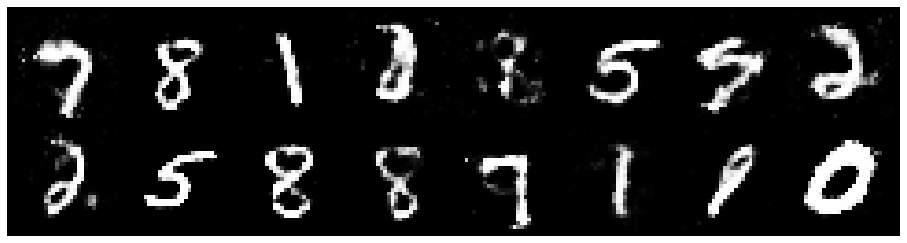

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2954, Generator Loss: 0.8388
D(x): 0.5502, D(G(z)): 0.4480


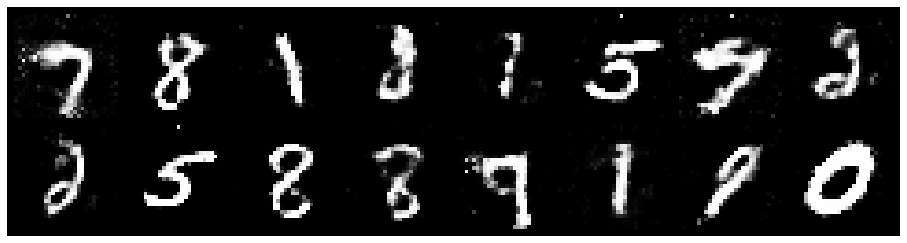

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.2902, Generator Loss: 0.8078
D(x): 0.5551, D(G(z)): 0.4598


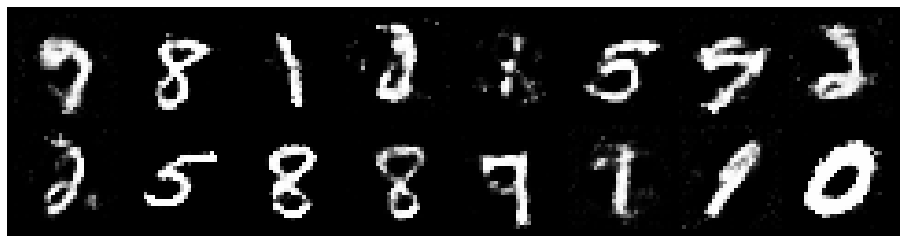

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2648, Generator Loss: 0.9746
D(x): 0.5440, D(G(z)): 0.4435


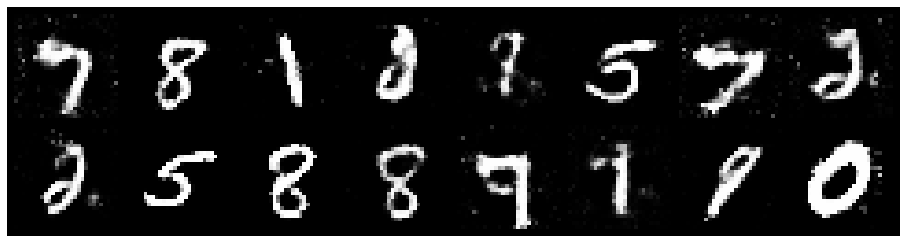

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2374, Generator Loss: 0.9548
D(x): 0.5584, D(G(z)): 0.4344


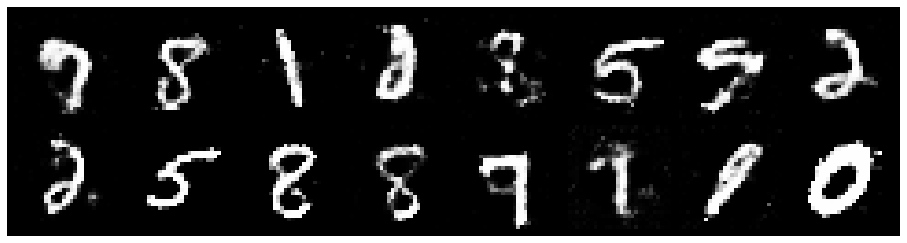

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.3534, Generator Loss: 0.7931
D(x): 0.5277, D(G(z)): 0.4668


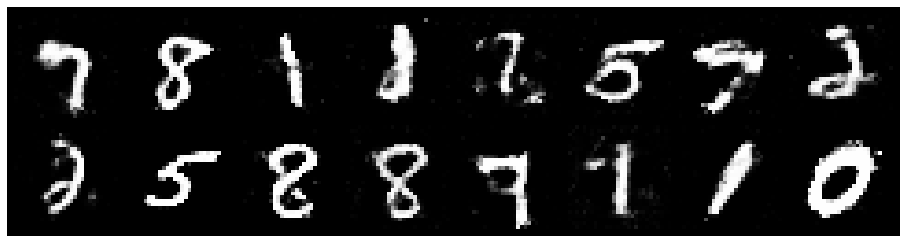

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.2829, Generator Loss: 0.8815
D(x): 0.5223, D(G(z)): 0.4335


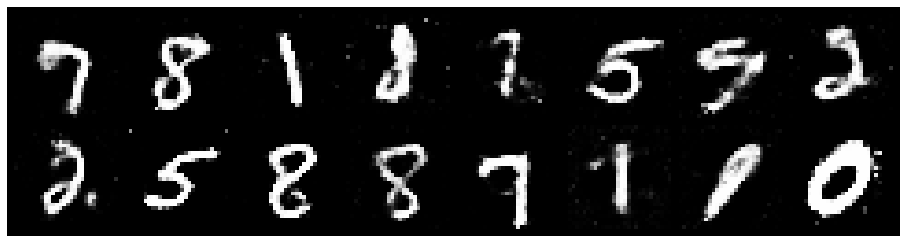

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2966, Generator Loss: 0.9026
D(x): 0.5667, D(G(z)): 0.4788


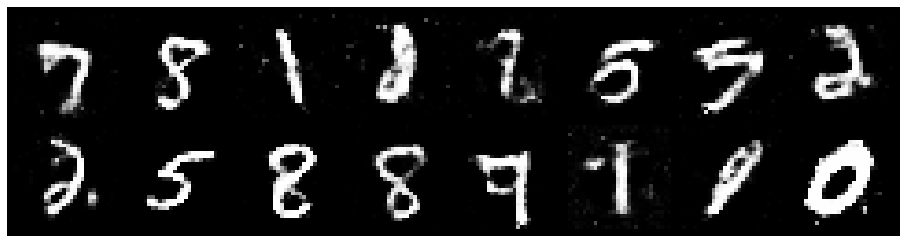

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2693, Generator Loss: 0.8446
D(x): 0.5702, D(G(z)): 0.4659


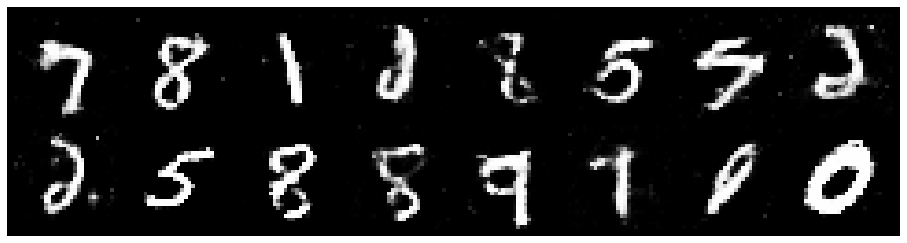

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2799, Generator Loss: 0.9807
D(x): 0.5184, D(G(z)): 0.3952


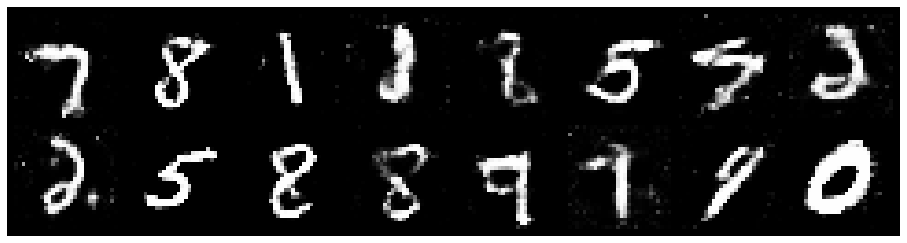

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3120, Generator Loss: 0.8913
D(x): 0.5106, D(G(z)): 0.4246


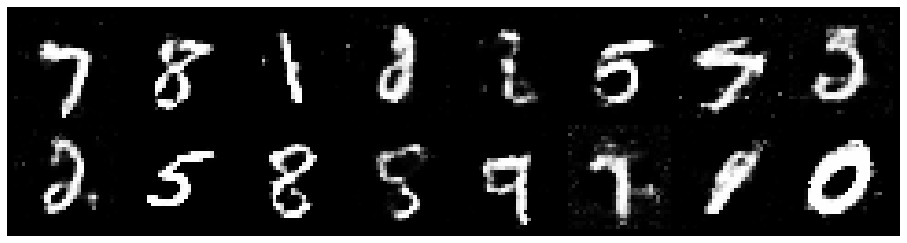

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.3916, Generator Loss: 0.8386
D(x): 0.5374, D(G(z)): 0.4861


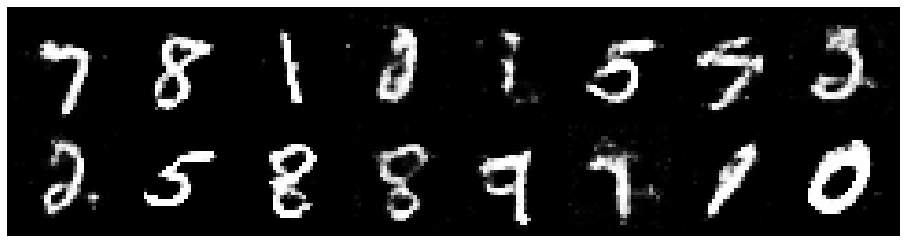

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3327, Generator Loss: 0.8701
D(x): 0.5195, D(G(z)): 0.4601


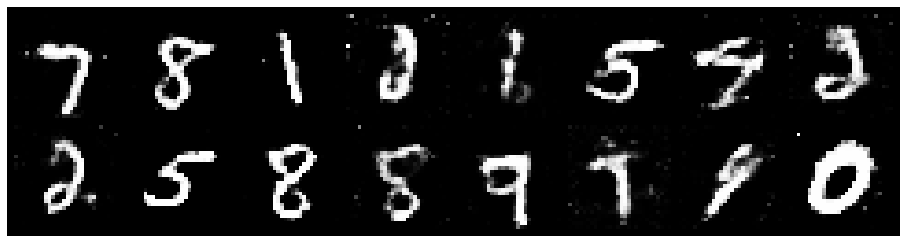

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2580, Generator Loss: 1.0119
D(x): 0.5291, D(G(z)): 0.4198


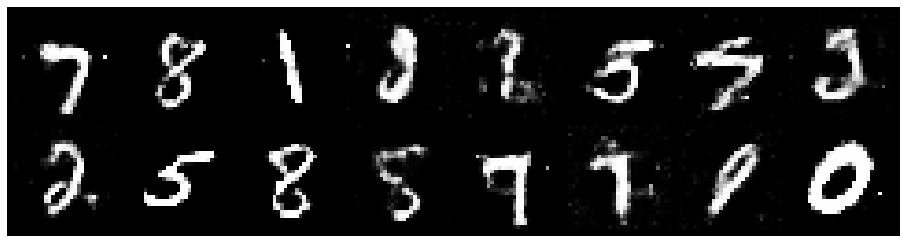

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.4007, Generator Loss: 0.6916
D(x): 0.5399, D(G(z)): 0.4920


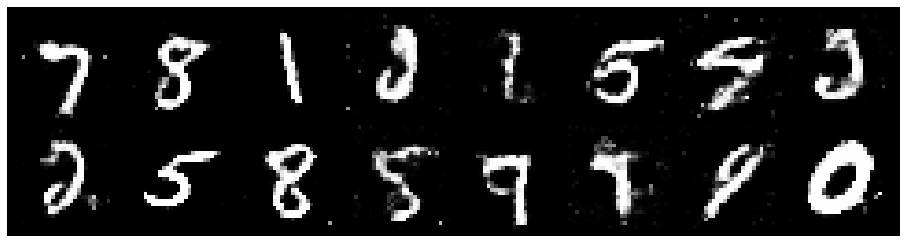

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.2887, Generator Loss: 0.9029
D(x): 0.5353, D(G(z)): 0.4520


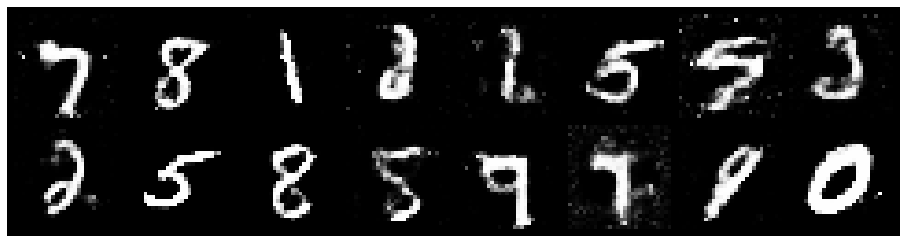

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2757, Generator Loss: 0.8818
D(x): 0.5335, D(G(z)): 0.4219


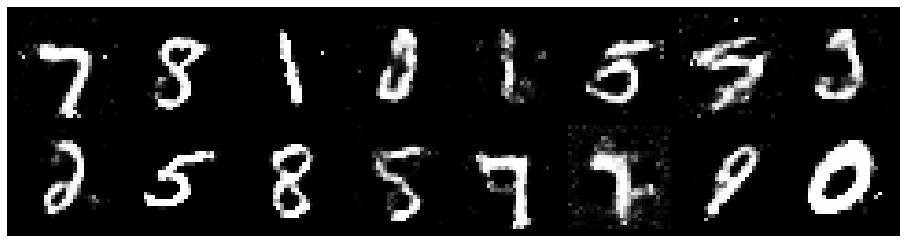

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2646, Generator Loss: 0.9028
D(x): 0.5464, D(G(z)): 0.4499


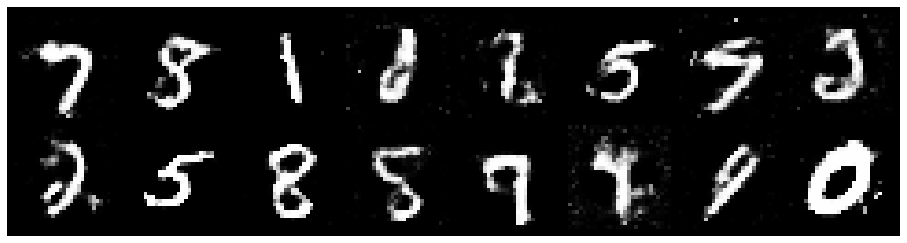

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2652, Generator Loss: 0.8749
D(x): 0.5783, D(G(z)): 0.4509


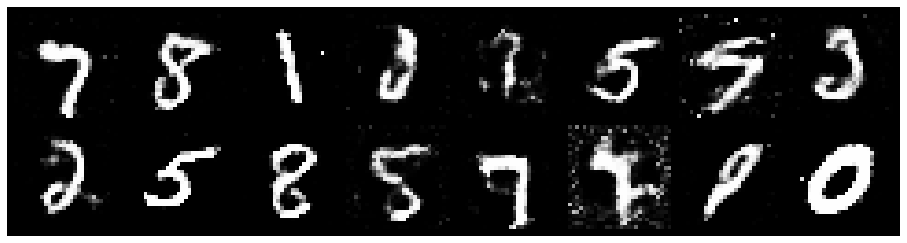

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.3431, Generator Loss: 0.8538
D(x): 0.5361, D(G(z)): 0.4689


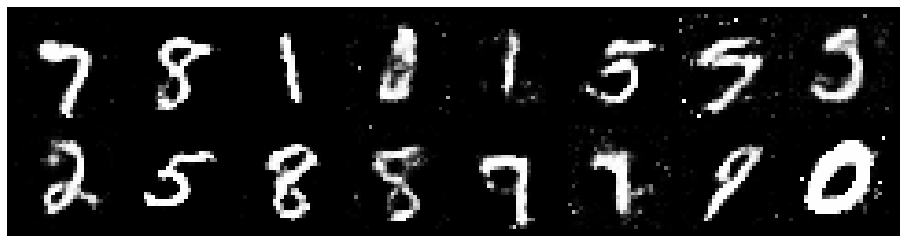

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.3106, Generator Loss: 0.9772
D(x): 0.5220, D(G(z)): 0.4411


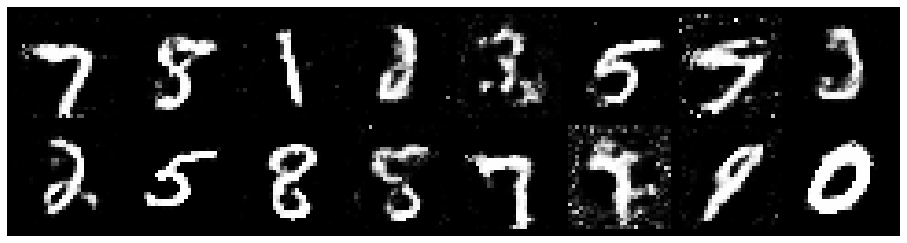

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2290, Generator Loss: 0.8911
D(x): 0.5578, D(G(z)): 0.4406


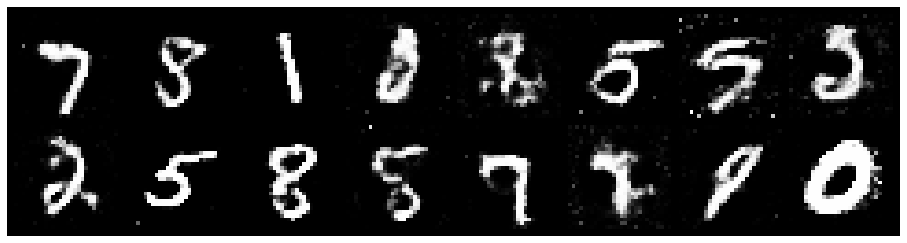

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2451, Generator Loss: 0.9643
D(x): 0.5948, D(G(z)): 0.4691


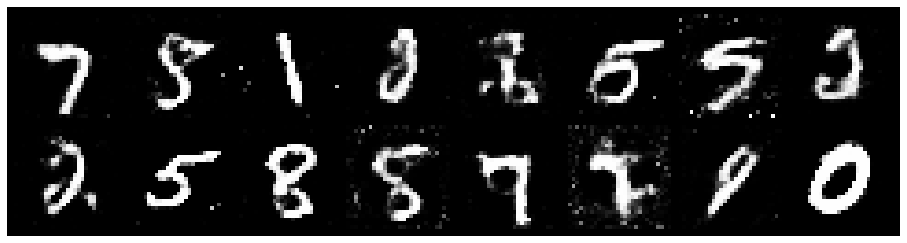

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3154, Generator Loss: 0.8907
D(x): 0.5727, D(G(z)): 0.4665


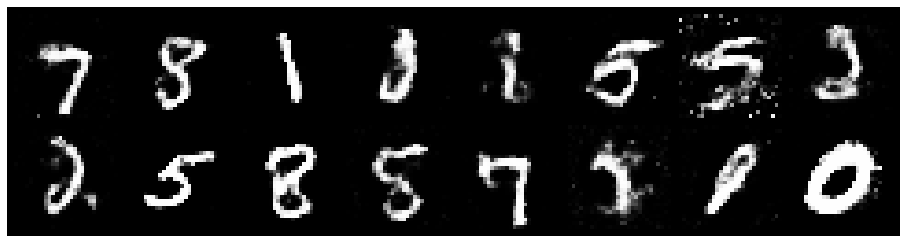

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.3344, Generator Loss: 0.9052
D(x): 0.5474, D(G(z)): 0.4511


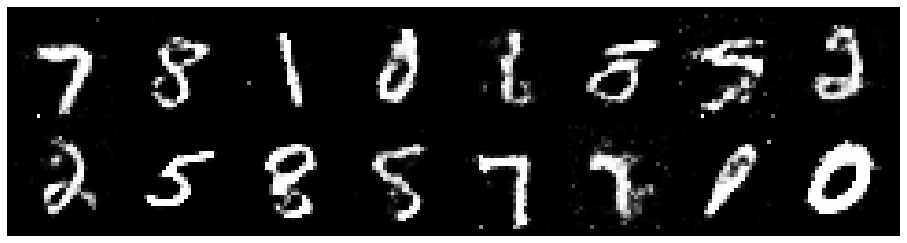

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2865, Generator Loss: 0.8923
D(x): 0.5456, D(G(z)): 0.4484


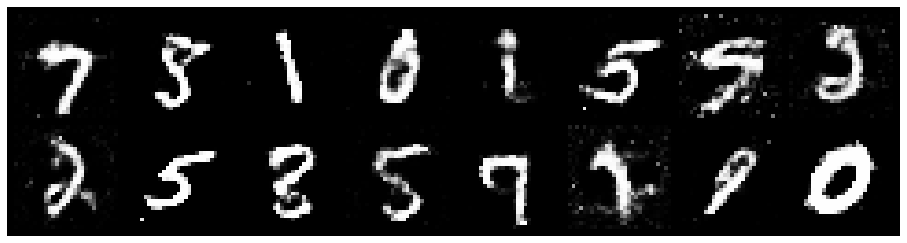

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.4937, Generator Loss: 0.8737
D(x): 0.5126, D(G(z)): 0.4920


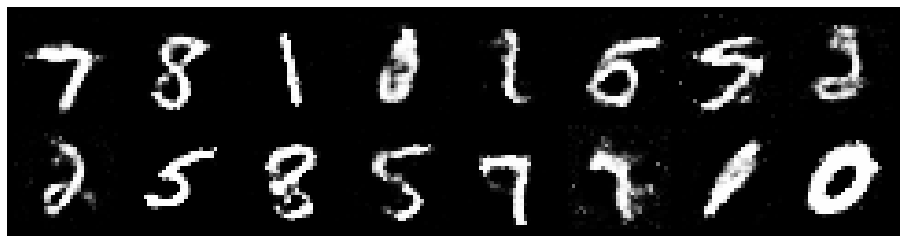

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.3392, Generator Loss: 0.8738
D(x): 0.5369, D(G(z)): 0.4558


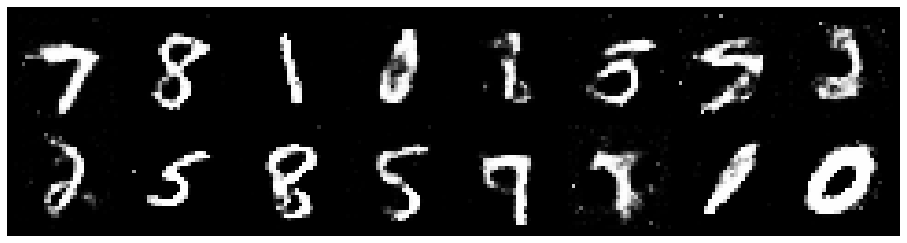

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8580
D(x): 0.5640, D(G(z)): 0.4742


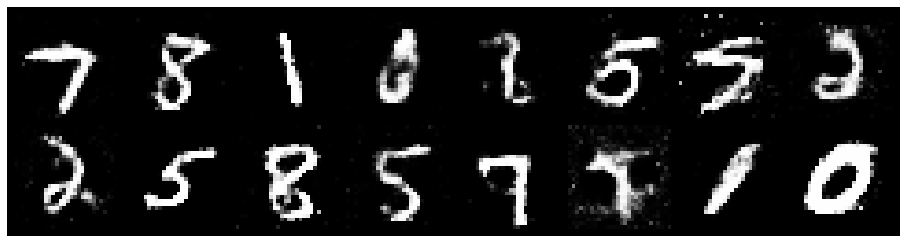

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2164, Generator Loss: 0.8121
D(x): 0.5651, D(G(z)): 0.4389


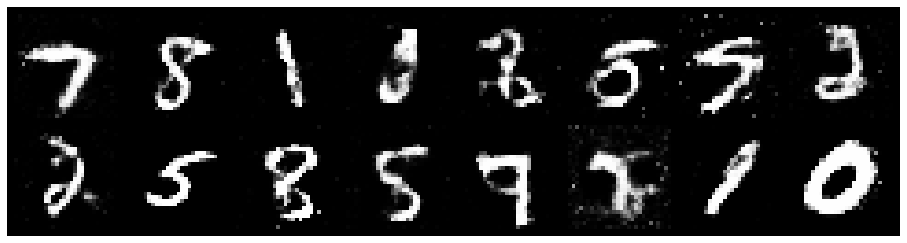

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.1910, Generator Loss: 1.0201
D(x): 0.5663, D(G(z)): 0.4060


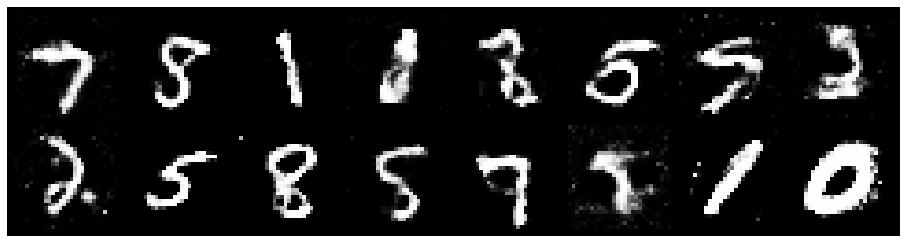

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.2186, Generator Loss: 0.9065
D(x): 0.5931, D(G(z)): 0.4307


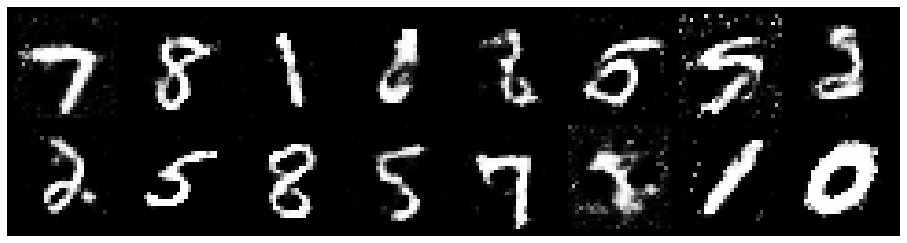

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.3009, Generator Loss: 1.0753
D(x): 0.5446, D(G(z)): 0.4374


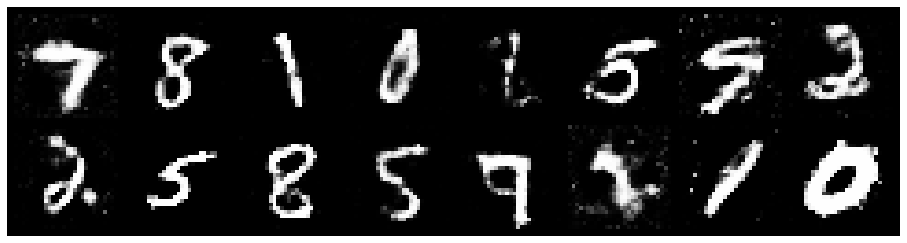

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.2150, Generator Loss: 0.8890
D(x): 0.5650, D(G(z)): 0.4387


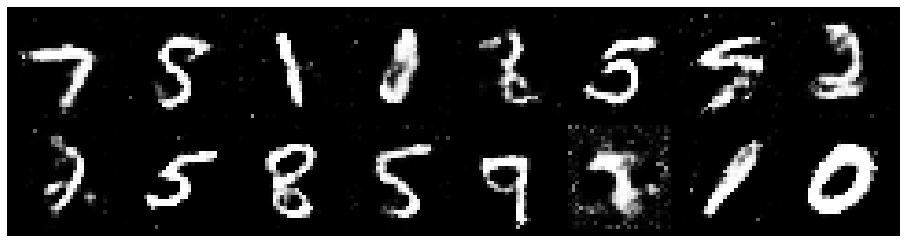

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.2567, Generator Loss: 0.9018
D(x): 0.5565, D(G(z)): 0.4435


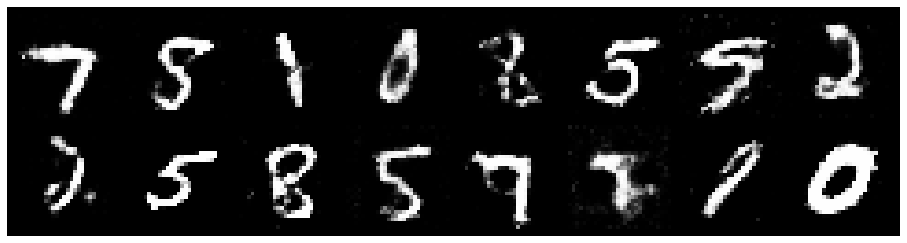

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9882
D(x): 0.5603, D(G(z)): 0.4181


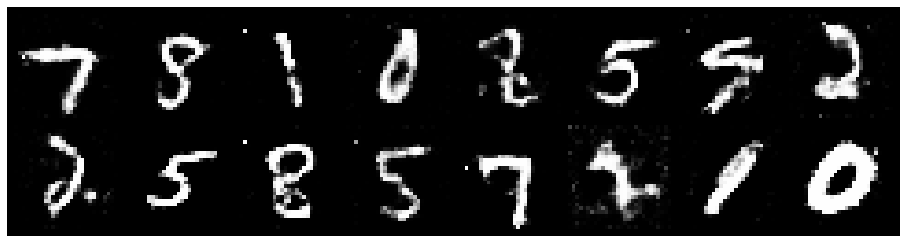

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2651, Generator Loss: 1.0226
D(x): 0.5026, D(G(z)): 0.3679


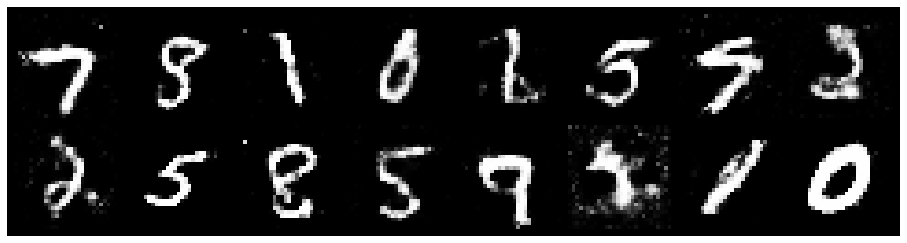

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3813, Generator Loss: 0.7885
D(x): 0.5289, D(G(z)): 0.4843


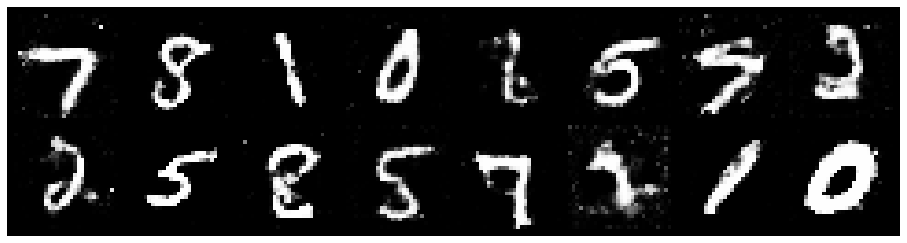

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2076, Generator Loss: 0.9445
D(x): 0.5773, D(G(z)): 0.4206


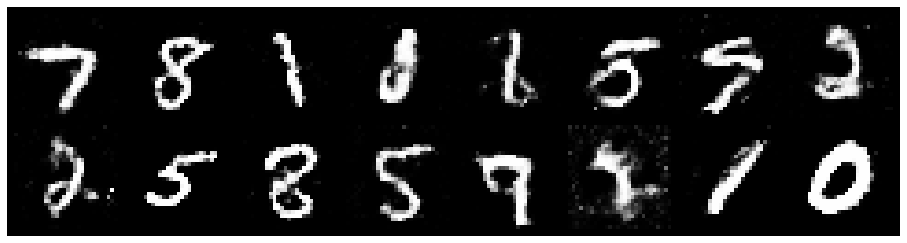

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2415, Generator Loss: 1.0146
D(x): 0.5368, D(G(z)): 0.4101


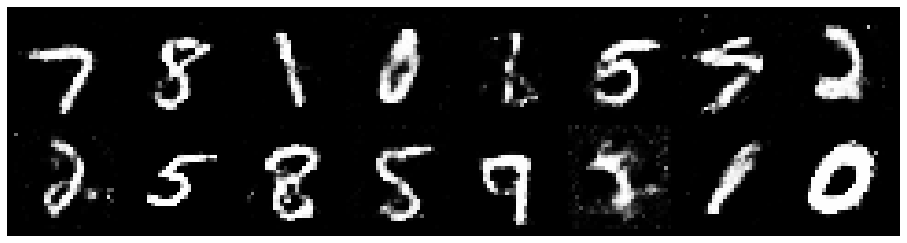

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.3433, Generator Loss: 0.8291
D(x): 0.5235, D(G(z)): 0.4665


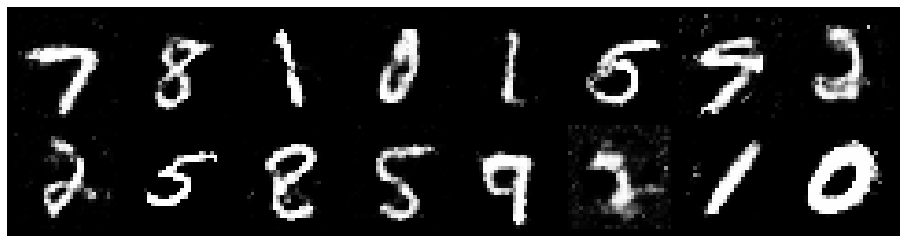

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.2458, Generator Loss: 0.8790
D(x): 0.5352, D(G(z)): 0.4245


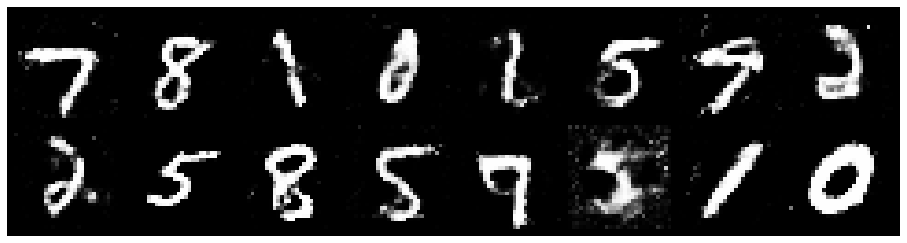

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2622, Generator Loss: 0.7629
D(x): 0.5711, D(G(z)): 0.4608


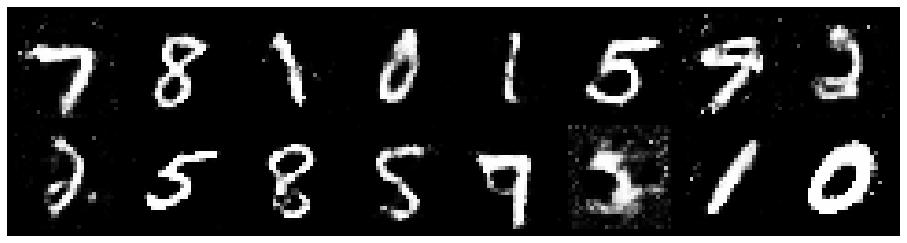

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.3127, Generator Loss: 0.9065
D(x): 0.5344, D(G(z)): 0.4451


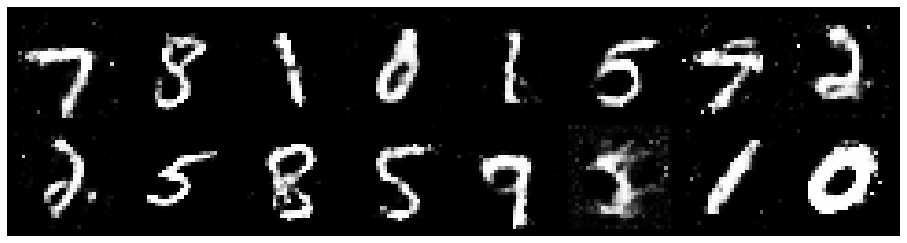

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.3828, Generator Loss: 0.7858
D(x): 0.5309, D(G(z)): 0.4935


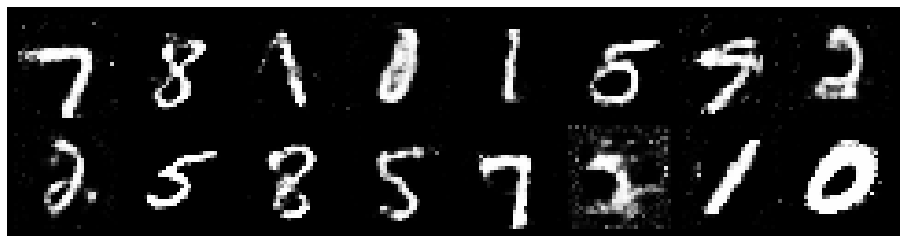

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2630, Generator Loss: 0.9553
D(x): 0.5528, D(G(z)): 0.4318


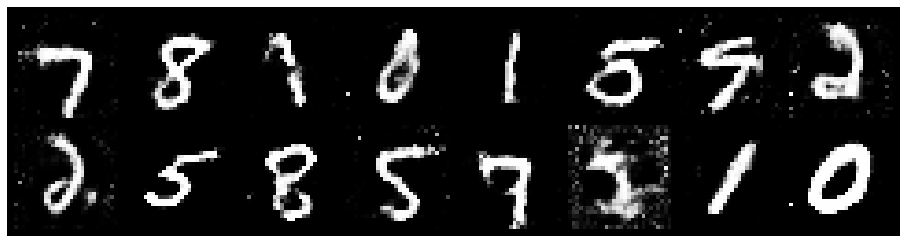

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2062, Generator Loss: 0.8911
D(x): 0.5502, D(G(z)): 0.4197


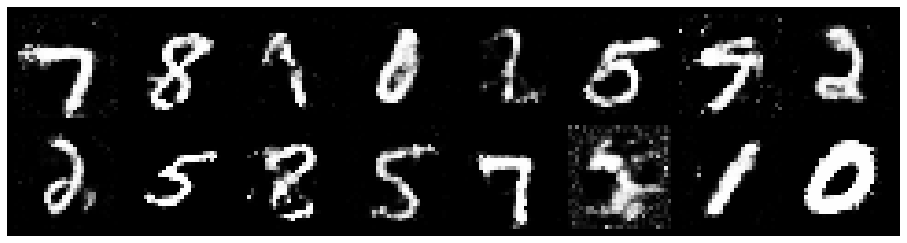

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.2080, Generator Loss: 0.9543
D(x): 0.5714, D(G(z)): 0.4254


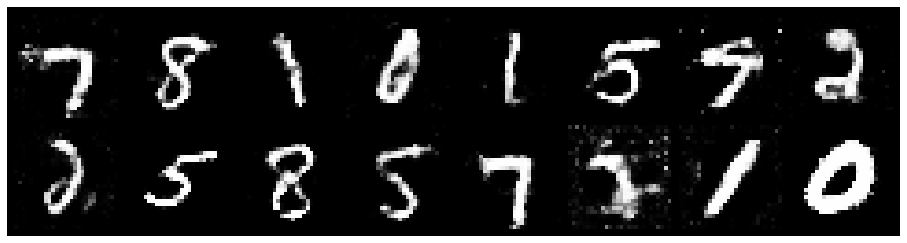

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2342, Generator Loss: 0.7633
D(x): 0.5983, D(G(z)): 0.4457


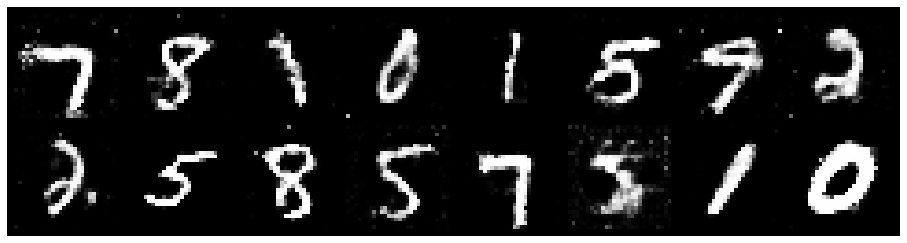

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.3803, Generator Loss: 0.7868
D(x): 0.5027, D(G(z)): 0.4535


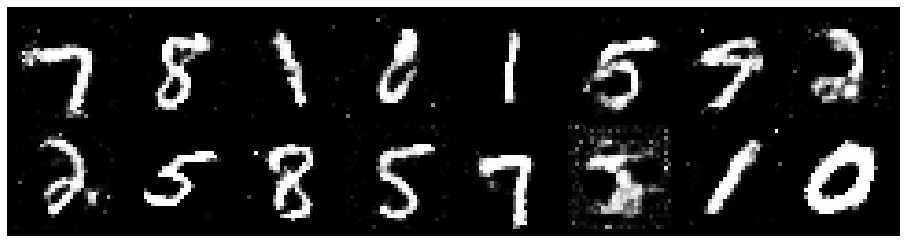

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.3635, Generator Loss: 0.8307
D(x): 0.4976, D(G(z)): 0.4513


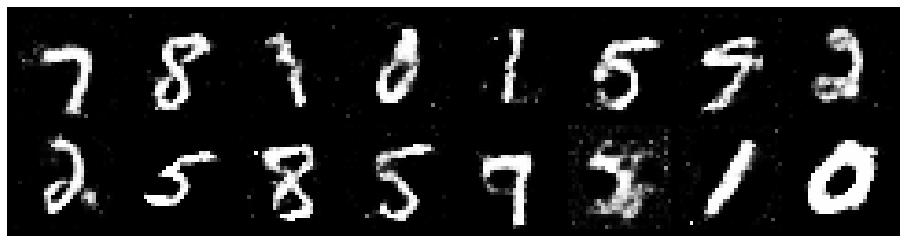

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2270, Generator Loss: 0.9564
D(x): 0.5556, D(G(z)): 0.4090


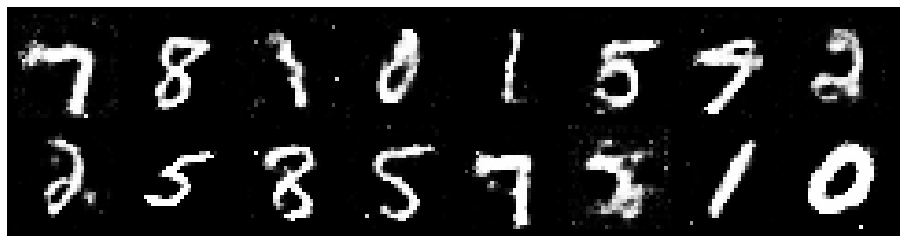

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.4414, Generator Loss: 0.8666
D(x): 0.5349, D(G(z)): 0.4765


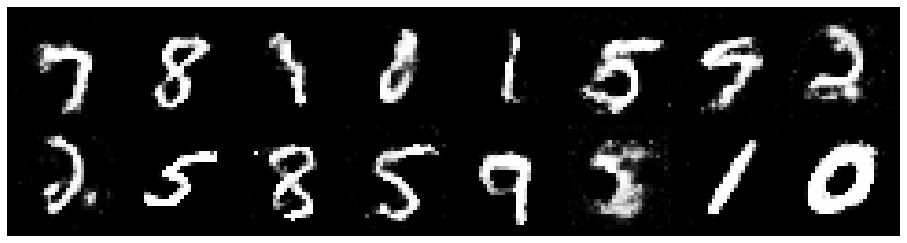

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.4206, Generator Loss: 0.8339
D(x): 0.5170, D(G(z)): 0.4701


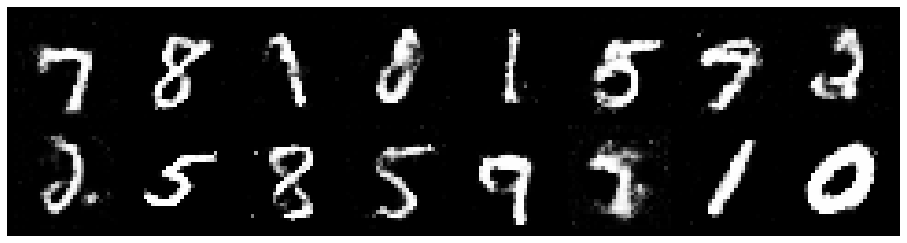

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3505, Generator Loss: 0.7674
D(x): 0.5216, D(G(z)): 0.4667


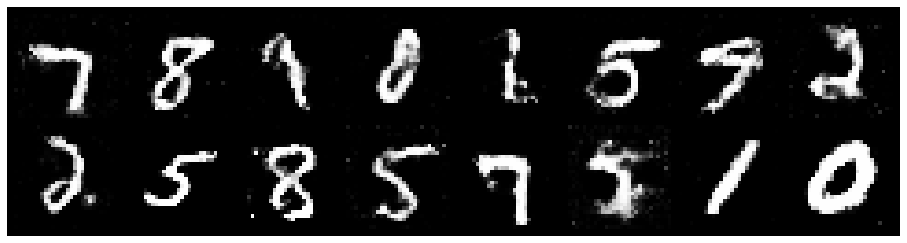

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.1439, Generator Loss: 0.9336
D(x): 0.5603, D(G(z)): 0.3818


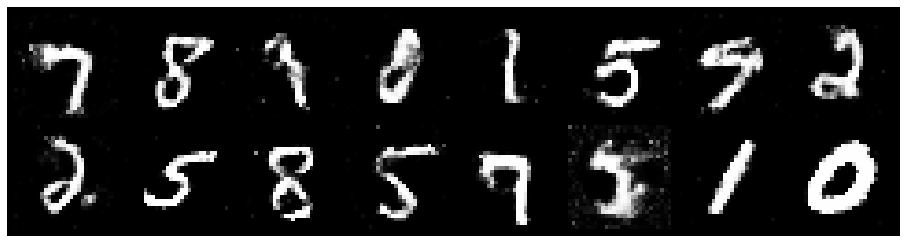

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.3278, Generator Loss: 0.8548
D(x): 0.5222, D(G(z)): 0.4474


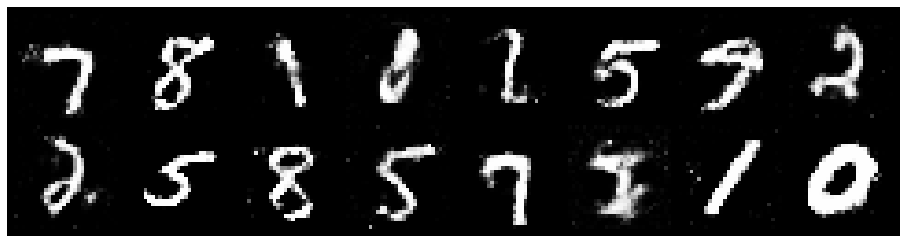

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.3574, Generator Loss: 0.7787
D(x): 0.5209, D(G(z)): 0.4633


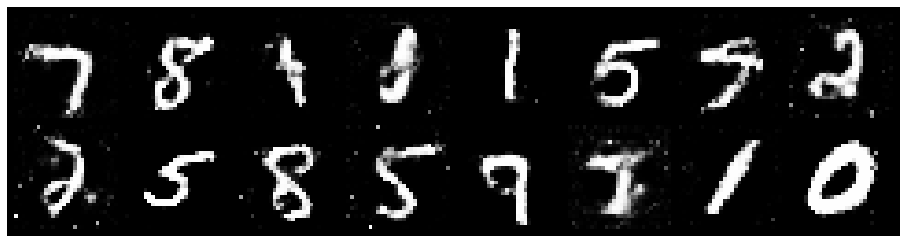

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3025, Generator Loss: 0.8659
D(x): 0.5330, D(G(z)): 0.4490


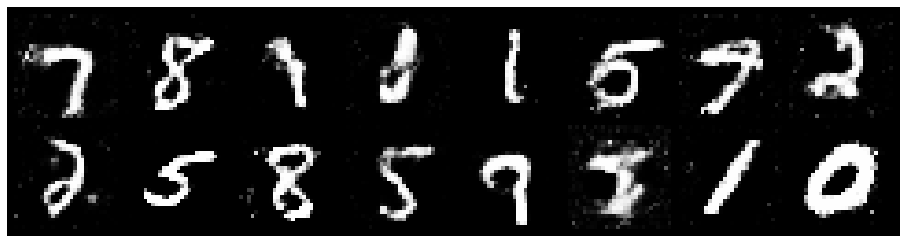

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3180, Generator Loss: 1.0438
D(x): 0.5424, D(G(z)): 0.4512


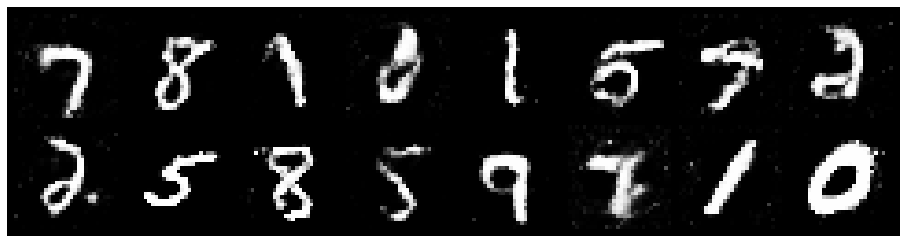

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.2637, Generator Loss: 0.8587
D(x): 0.5514, D(G(z)): 0.4341


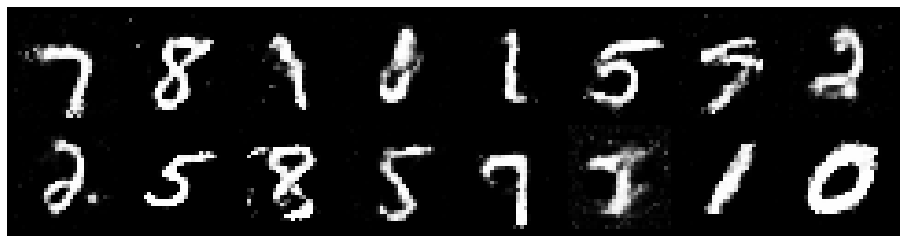

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2786, Generator Loss: 0.9505
D(x): 0.5594, D(G(z)): 0.4512


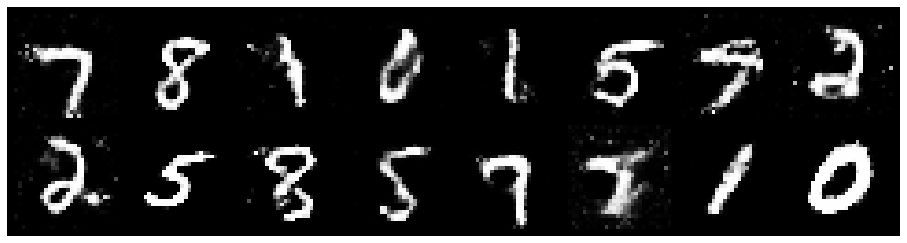

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2857, Generator Loss: 0.7670
D(x): 0.5388, D(G(z)): 0.4580


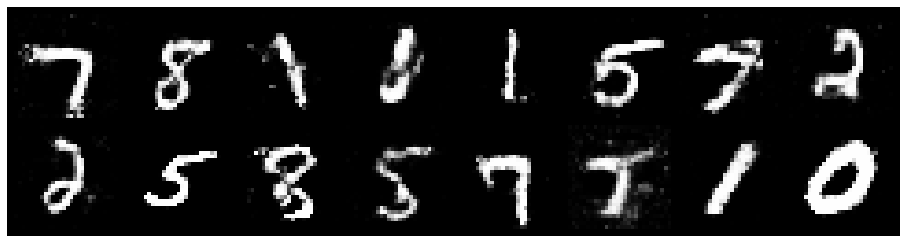

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2383, Generator Loss: 0.8769
D(x): 0.5726, D(G(z)): 0.4618


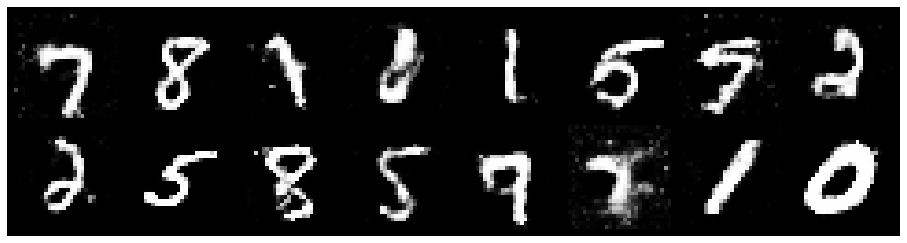

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.3085, Generator Loss: 0.9063
D(x): 0.5586, D(G(z)): 0.4605


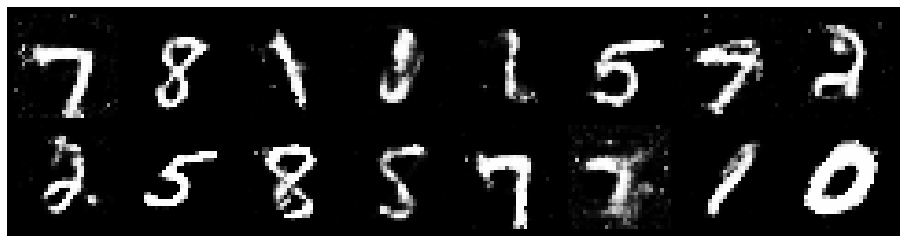

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2215, Generator Loss: 0.7986
D(x): 0.5685, D(G(z)): 0.4343


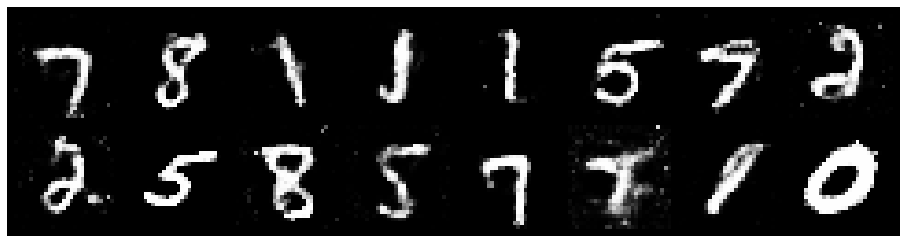

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.3138, Generator Loss: 0.9742
D(x): 0.5673, D(G(z)): 0.4755


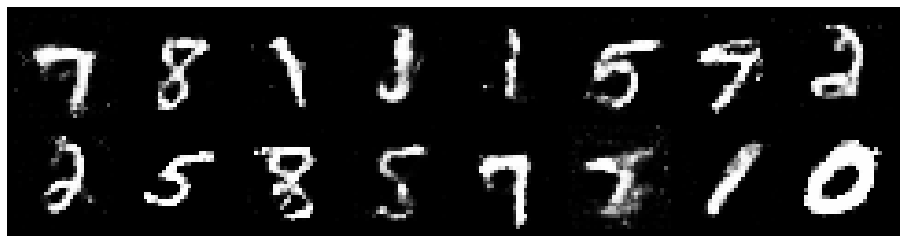

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8738
D(x): 0.5283, D(G(z)): 0.4400


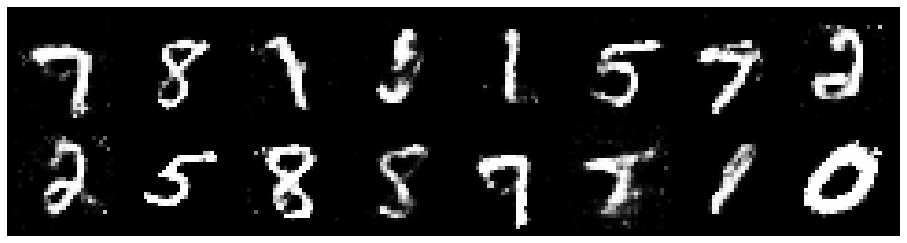

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3050, Generator Loss: 0.8640
D(x): 0.5288, D(G(z)): 0.4437


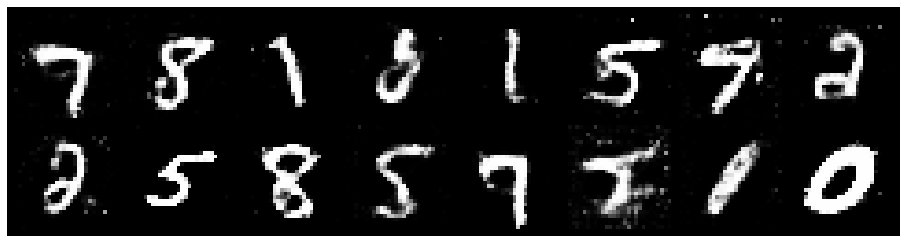

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2986, Generator Loss: 0.8373
D(x): 0.5559, D(G(z)): 0.4737


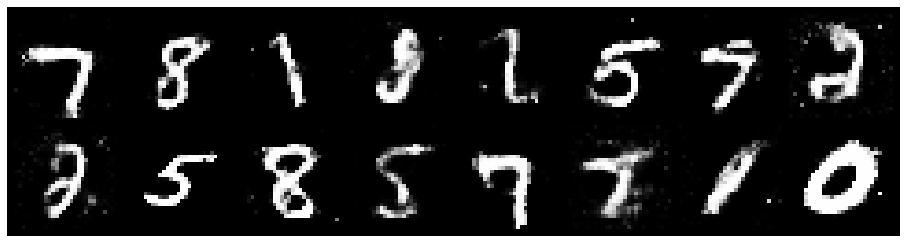

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2415, Generator Loss: 0.8889
D(x): 0.5665, D(G(z)): 0.4253


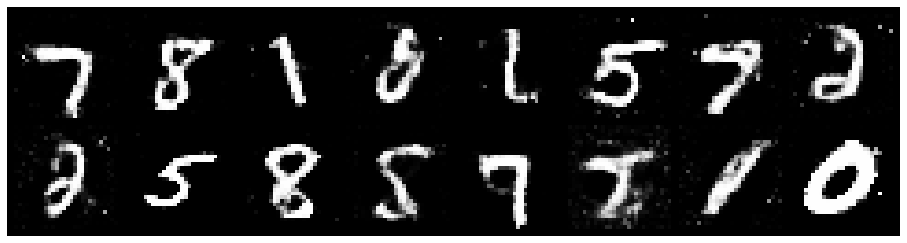

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2755, Generator Loss: 0.8829
D(x): 0.5497, D(G(z)): 0.4482


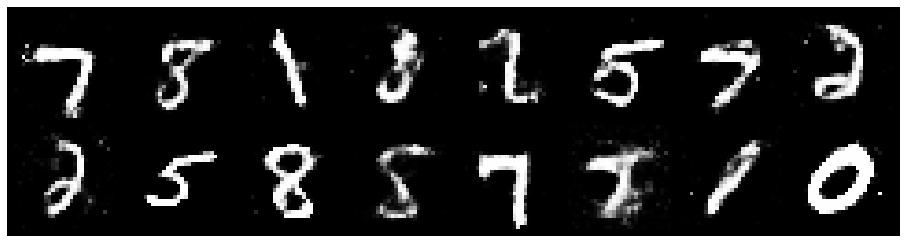

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2775, Generator Loss: 0.8626
D(x): 0.5699, D(G(z)): 0.4408


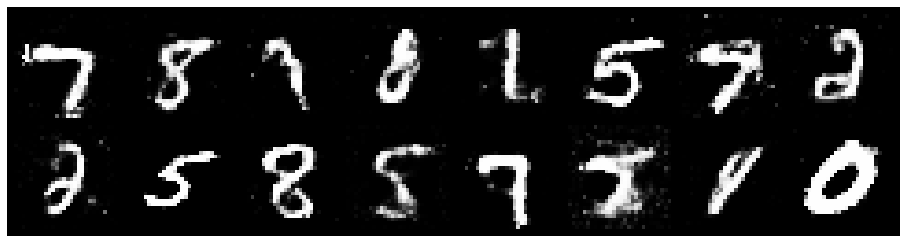

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2294, Generator Loss: 0.9074
D(x): 0.5671, D(G(z)): 0.4332


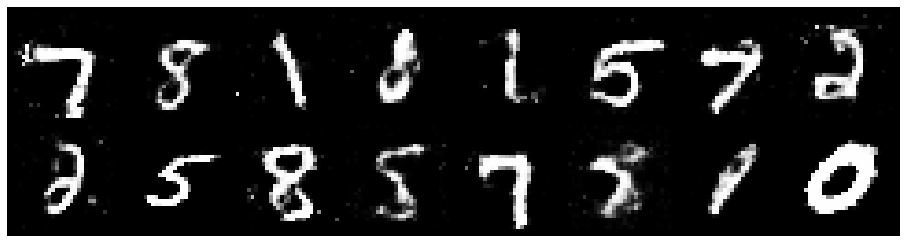

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.3060, Generator Loss: 0.8434
D(x): 0.5816, D(G(z)): 0.4885


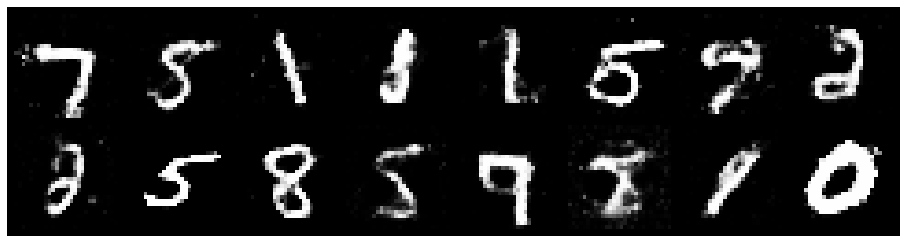

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.2863, Generator Loss: 0.8676
D(x): 0.5090, D(G(z)): 0.4294


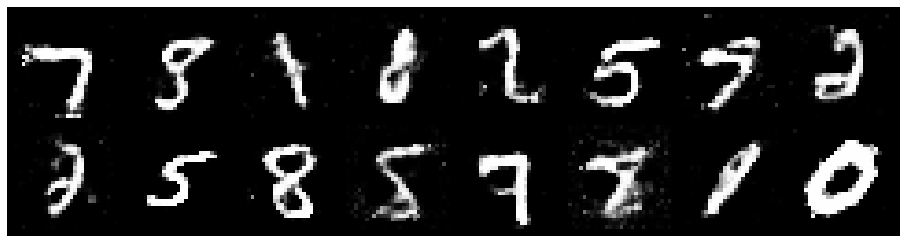

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.4099, Generator Loss: 0.8356
D(x): 0.5131, D(G(z)): 0.4757


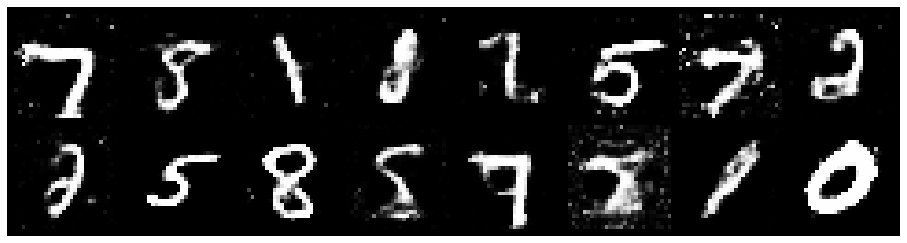

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.3576, Generator Loss: 0.8924
D(x): 0.5794, D(G(z)): 0.4798


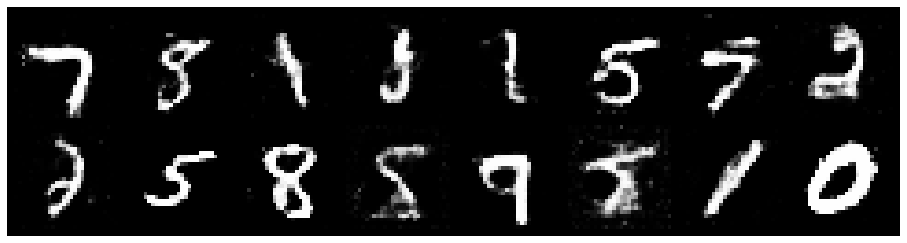

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.3569, Generator Loss: 0.8069
D(x): 0.5816, D(G(z)): 0.5068


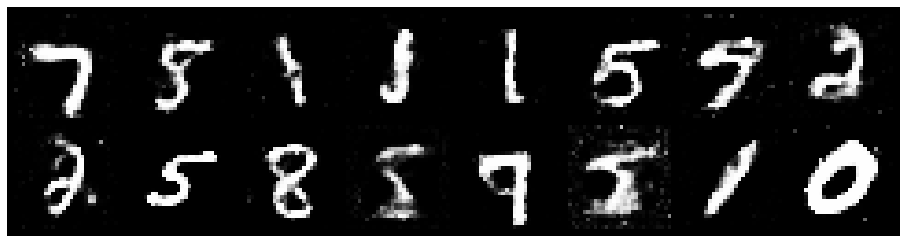

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3266, Generator Loss: 0.7286
D(x): 0.5322, D(G(z)): 0.4614


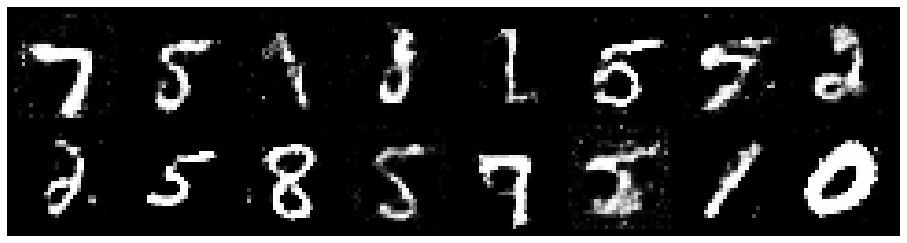

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2666, Generator Loss: 0.9006
D(x): 0.5252, D(G(z)): 0.4263


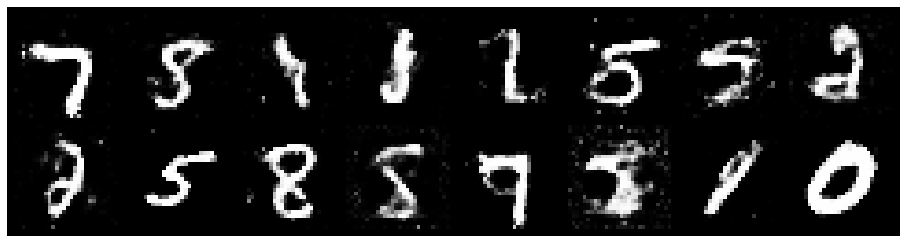

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.1898, Generator Loss: 0.9748
D(x): 0.5676, D(G(z)): 0.4156


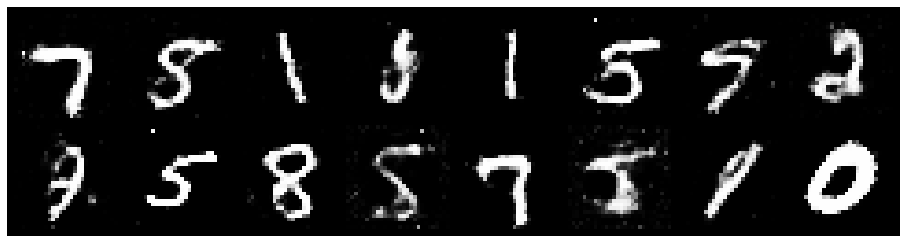

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.4068, Generator Loss: 1.0106
D(x): 0.5040, D(G(z)): 0.4235


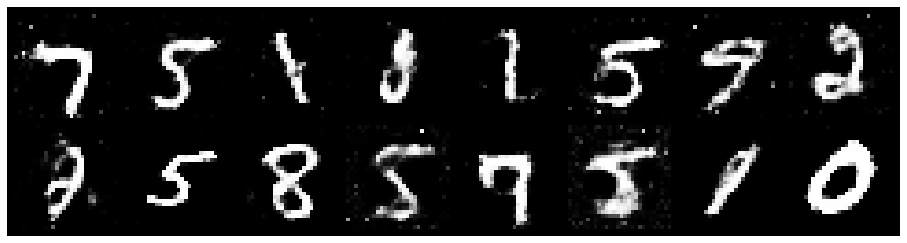

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.3599, Generator Loss: 0.8447
D(x): 0.5725, D(G(z)): 0.4846


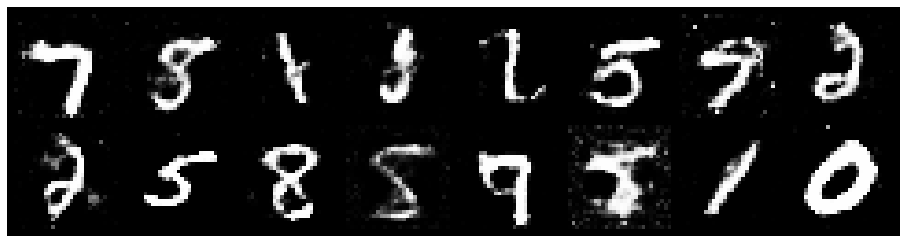

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8987
D(x): 0.5288, D(G(z)): 0.4130


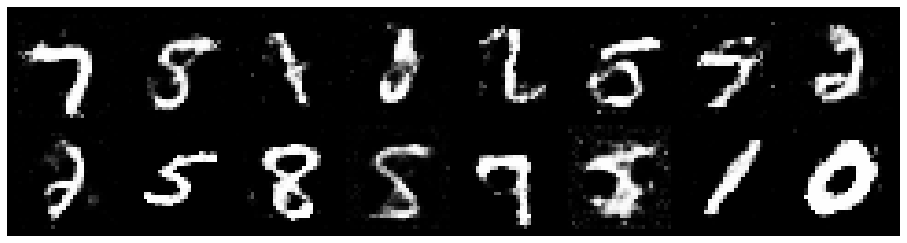

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2561, Generator Loss: 0.8984
D(x): 0.5284, D(G(z)): 0.4201


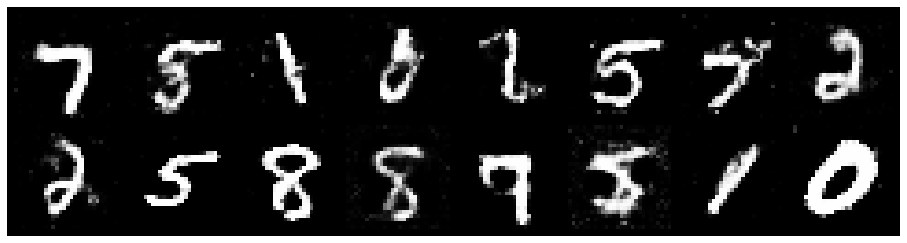

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.3586, Generator Loss: 0.7965
D(x): 0.5644, D(G(z)): 0.4962


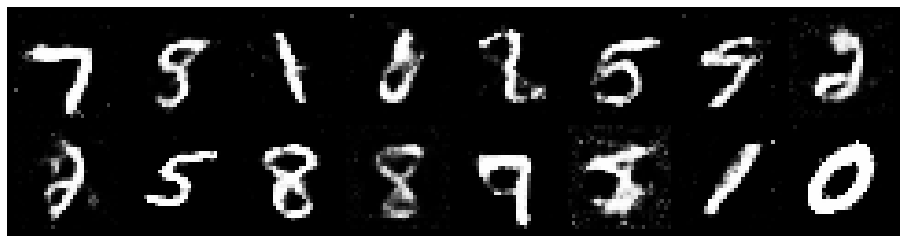

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2058, Generator Loss: 0.8064
D(x): 0.5681, D(G(z)): 0.4368


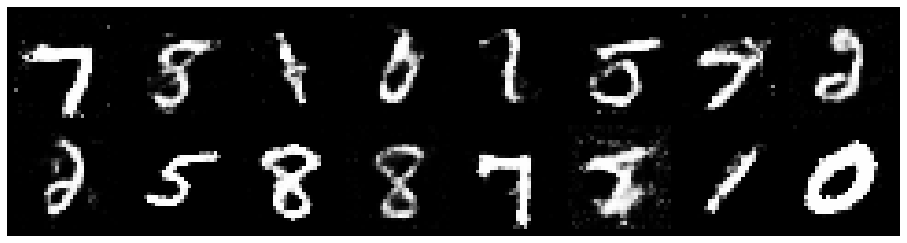

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2796, Generator Loss: 0.9306
D(x): 0.5362, D(G(z)): 0.4280


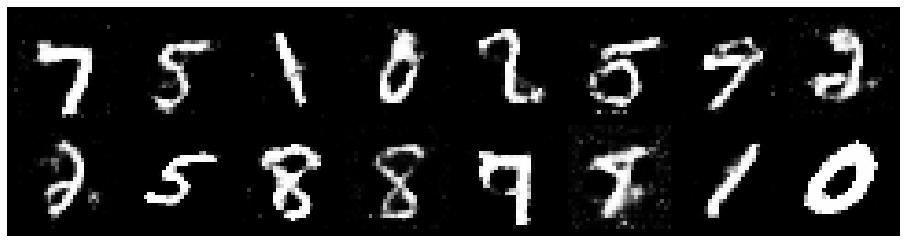

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.3208, Generator Loss: 0.9196
D(x): 0.5502, D(G(z)): 0.4526


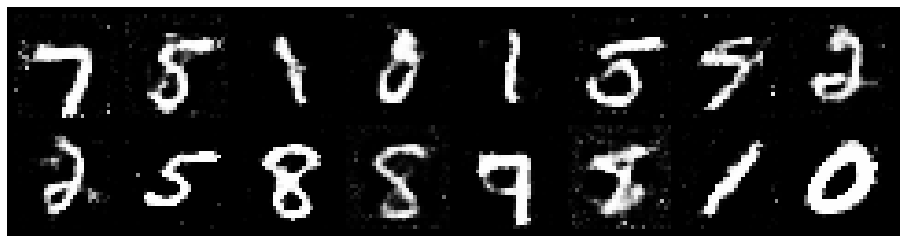

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.3372, Generator Loss: 0.8876
D(x): 0.5267, D(G(z)): 0.4444


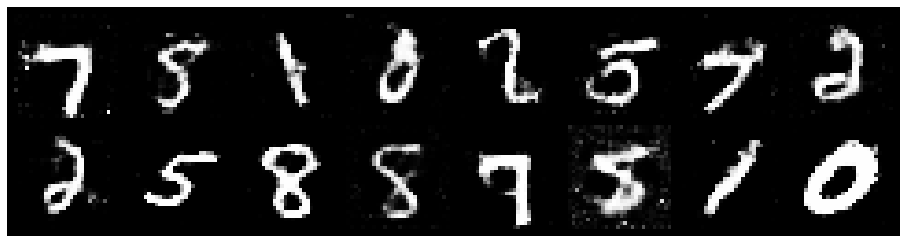

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2674, Generator Loss: 0.9388
D(x): 0.5497, D(G(z)): 0.4371


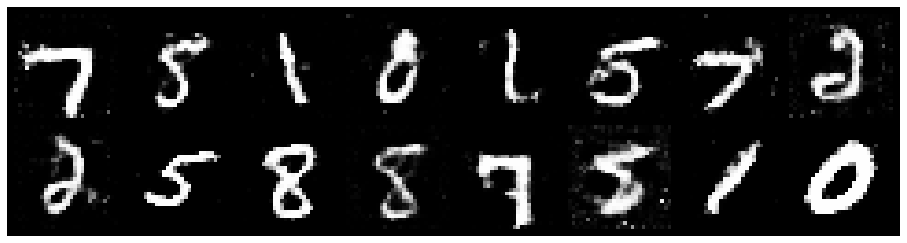

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.3260, Generator Loss: 0.9225
D(x): 0.5340, D(G(z)): 0.4458


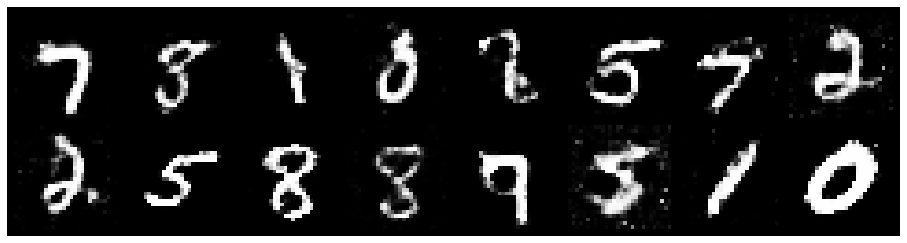

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2684, Generator Loss: 0.9360
D(x): 0.5666, D(G(z)): 0.4474


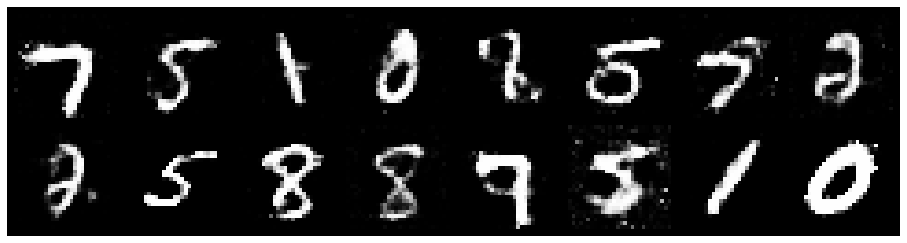

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.2246, Generator Loss: 0.8840
D(x): 0.5893, D(G(z)): 0.4593


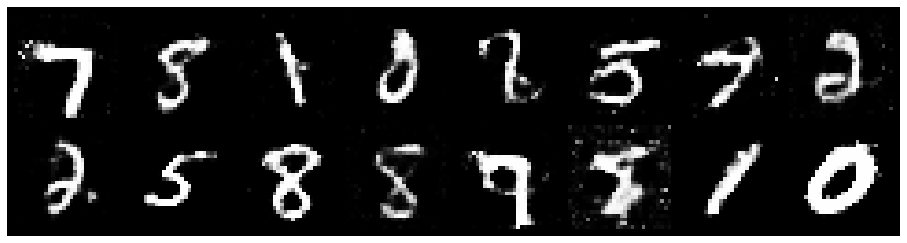

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.2463, Generator Loss: 0.8979
D(x): 0.5641, D(G(z)): 0.4244


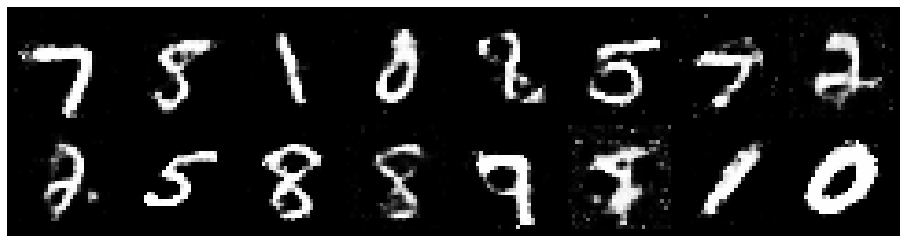

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.1930, Generator Loss: 0.8429
D(x): 0.5775, D(G(z)): 0.4281


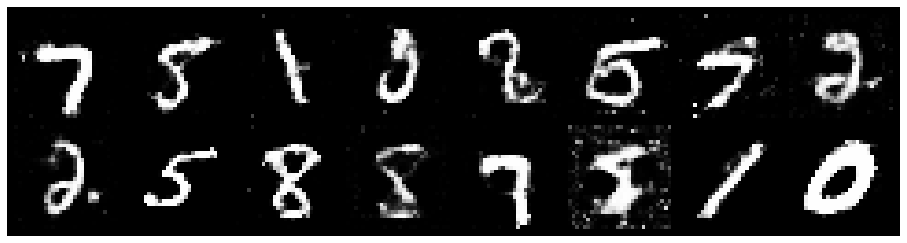

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8909
D(x): 0.5228, D(G(z)): 0.4213


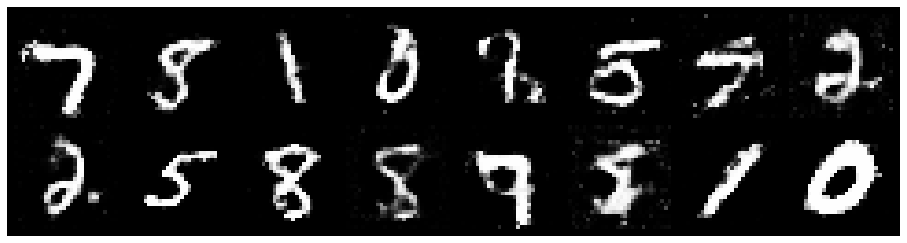

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.3467, Generator Loss: 0.9504
D(x): 0.5720, D(G(z)): 0.4729


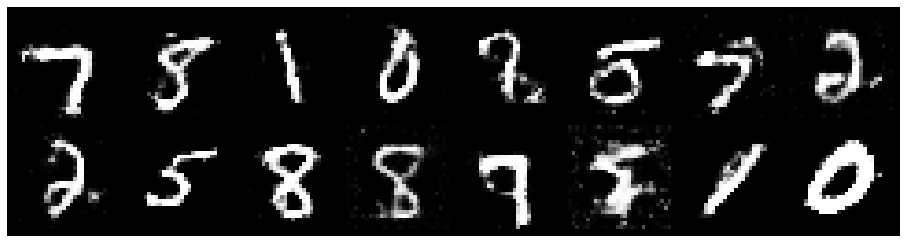

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3359, Generator Loss: 0.7184
D(x): 0.5779, D(G(z)): 0.4987


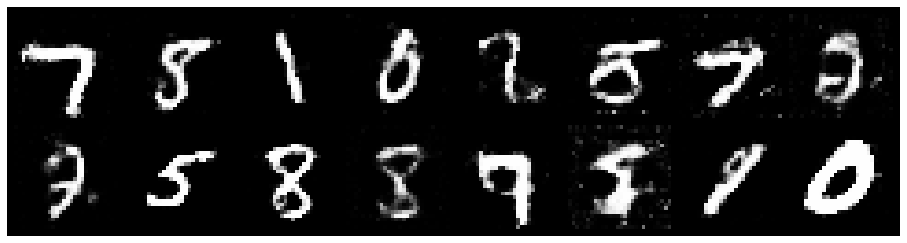

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.3086, Generator Loss: 0.8864
D(x): 0.5455, D(G(z)): 0.4516


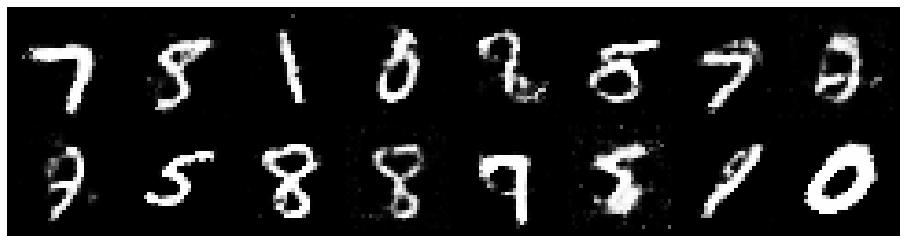

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2902, Generator Loss: 0.8131
D(x): 0.5540, D(G(z)): 0.4633


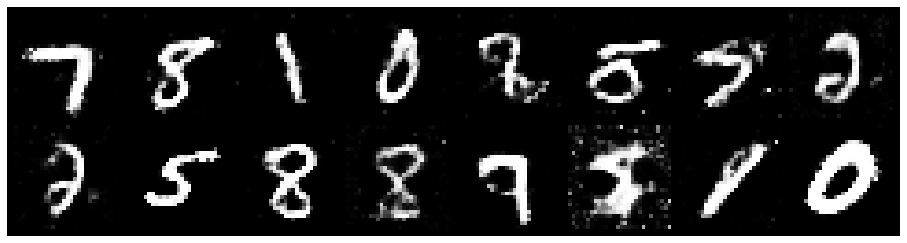

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2726, Generator Loss: 0.8850
D(x): 0.5682, D(G(z)): 0.4574


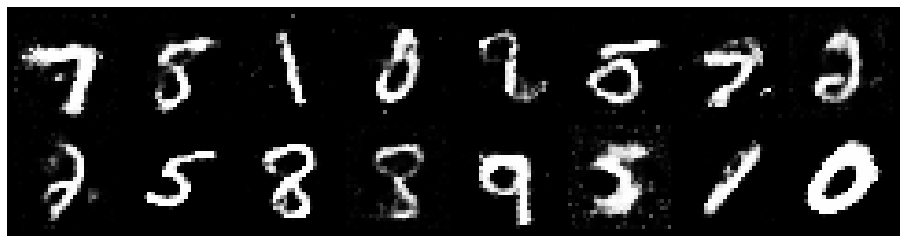

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3348, Generator Loss: 0.9272
D(x): 0.5136, D(G(z)): 0.4464


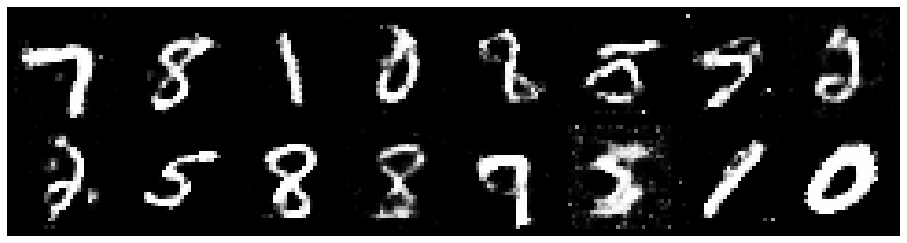

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2793, Generator Loss: 0.8808
D(x): 0.5465, D(G(z)): 0.4528


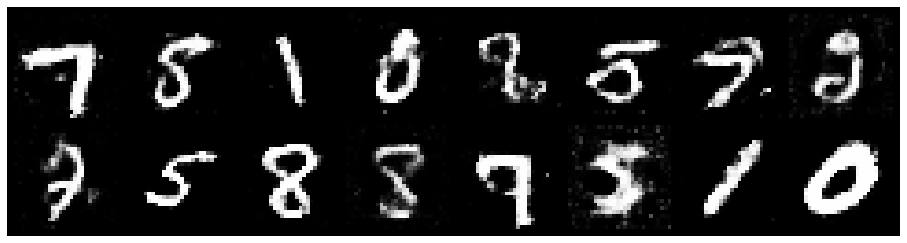

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.1940, Generator Loss: 0.9593
D(x): 0.5816, D(G(z)): 0.4364


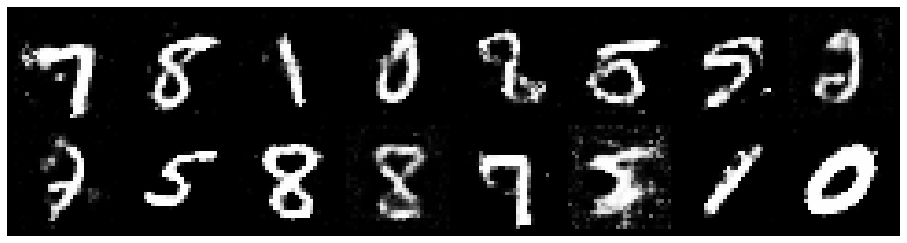

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.3171, Generator Loss: 0.8593
D(x): 0.5321, D(G(z)): 0.4539


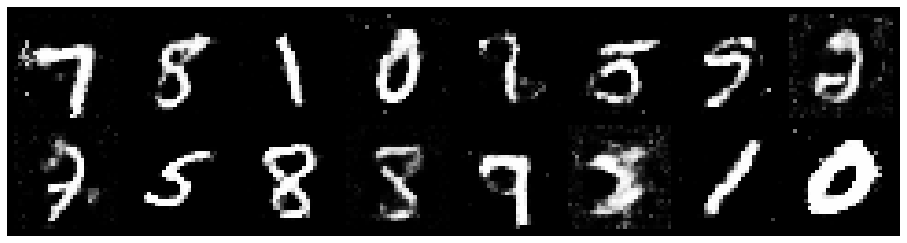

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.3899, Generator Loss: 0.8065
D(x): 0.5137, D(G(z)): 0.4644


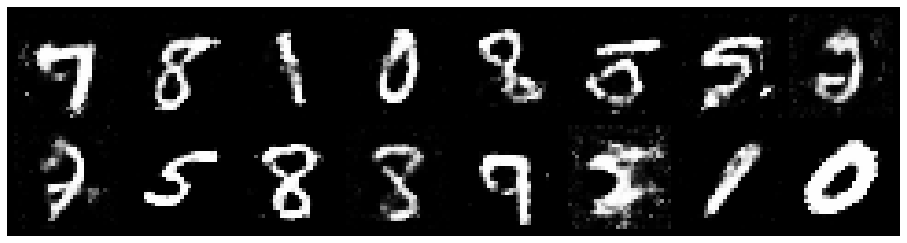

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.3066, Generator Loss: 0.8923
D(x): 0.5208, D(G(z)): 0.4392


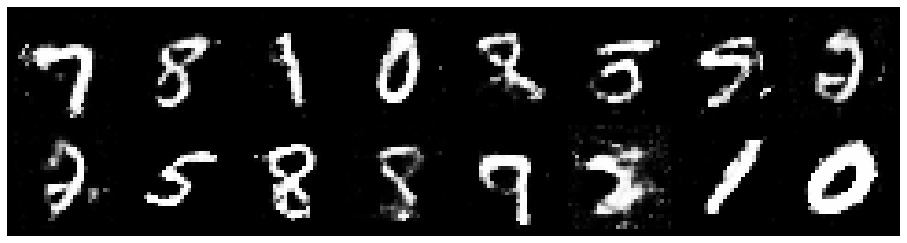

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2303, Generator Loss: 0.8172
D(x): 0.5904, D(G(z)): 0.4684


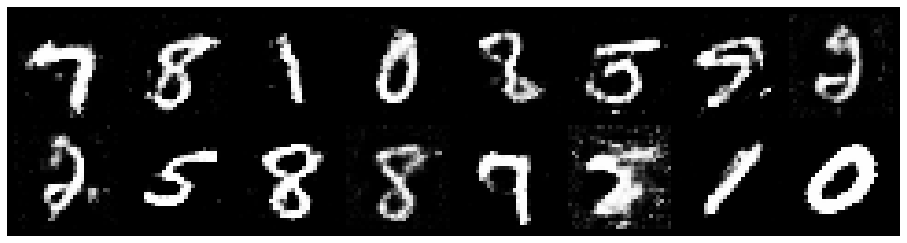

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2334, Generator Loss: 0.8754
D(x): 0.5668, D(G(z)): 0.4346


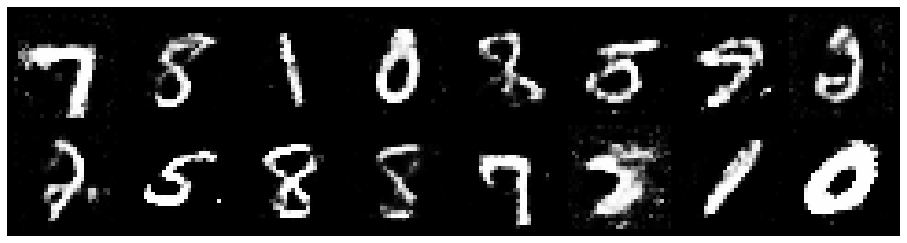

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.2646, Generator Loss: 0.8582
D(x): 0.5488, D(G(z)): 0.4432


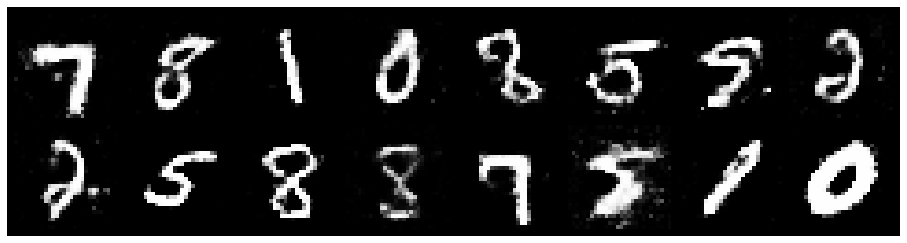

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.3464, Generator Loss: 0.8367
D(x): 0.5279, D(G(z)): 0.4627


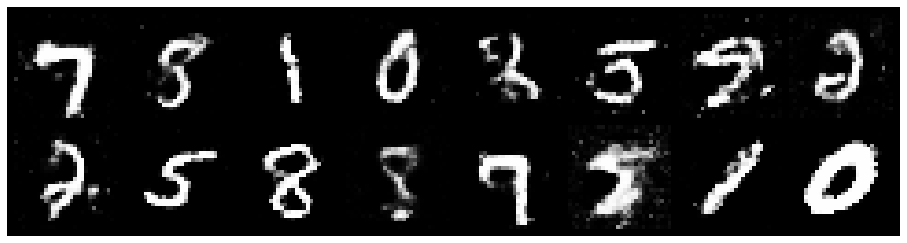

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2262, Generator Loss: 0.8858
D(x): 0.5680, D(G(z)): 0.4464


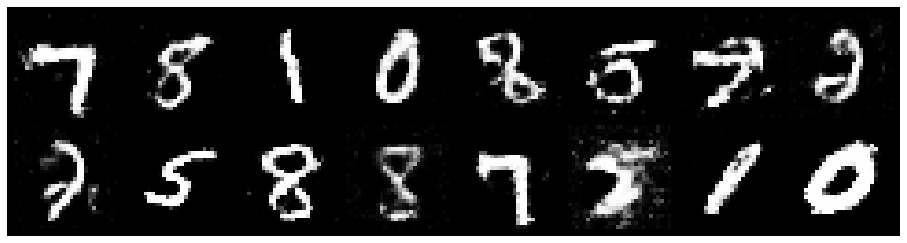

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2525, Generator Loss: 0.7954
D(x): 0.5640, D(G(z)): 0.4421


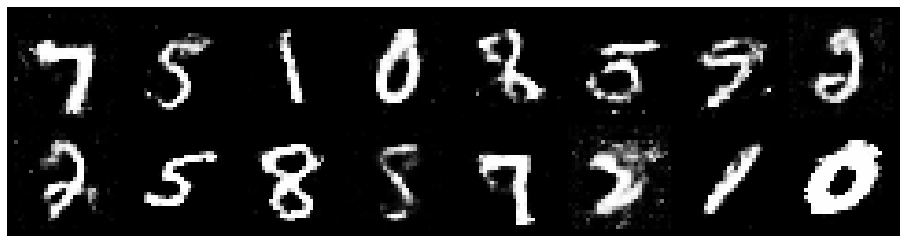

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.4047, Generator Loss: 0.8080
D(x): 0.5398, D(G(z)): 0.4687


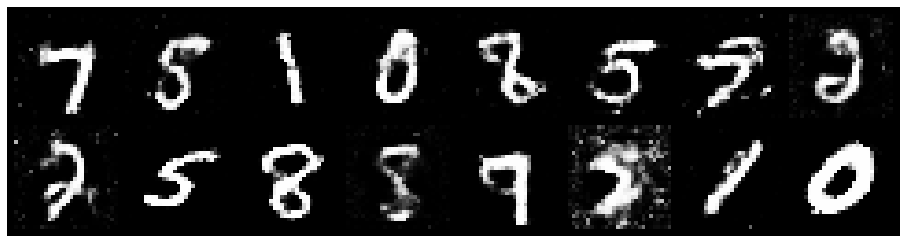

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.4224, Generator Loss: 0.7382
D(x): 0.5266, D(G(z)): 0.4968


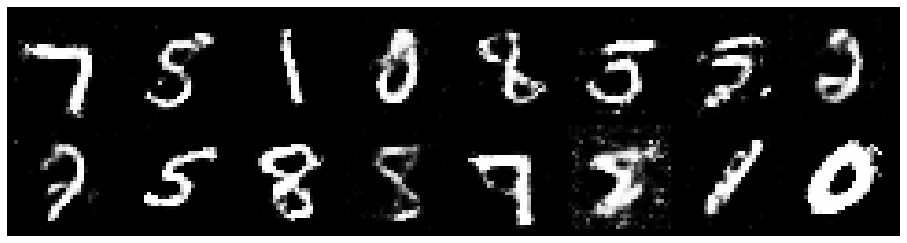

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.3443, Generator Loss: 0.8642
D(x): 0.5494, D(G(z)): 0.4604


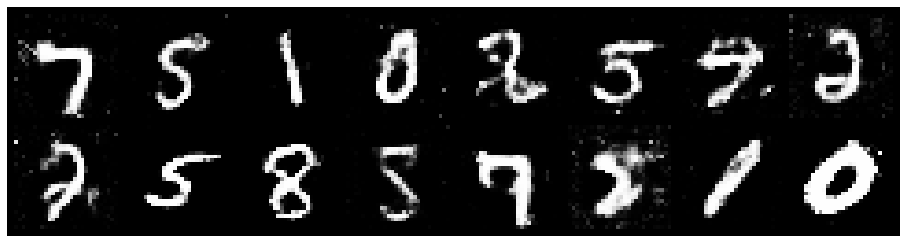

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.3352, Generator Loss: 0.7249
D(x): 0.5710, D(G(z)): 0.4907


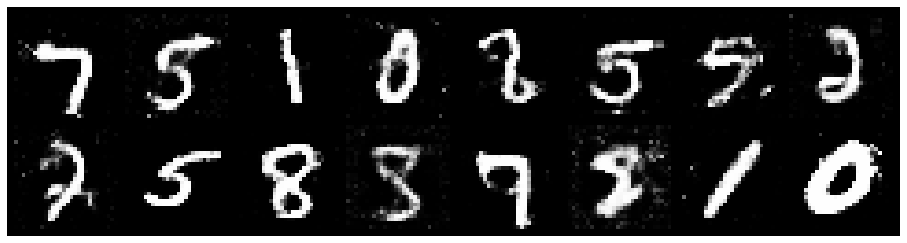

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.3180, Generator Loss: 0.8168
D(x): 0.5524, D(G(z)): 0.4736


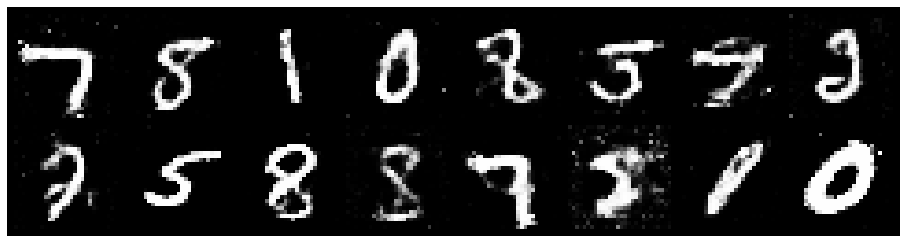

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.3481, Generator Loss: 0.8877
D(x): 0.5119, D(G(z)): 0.4455


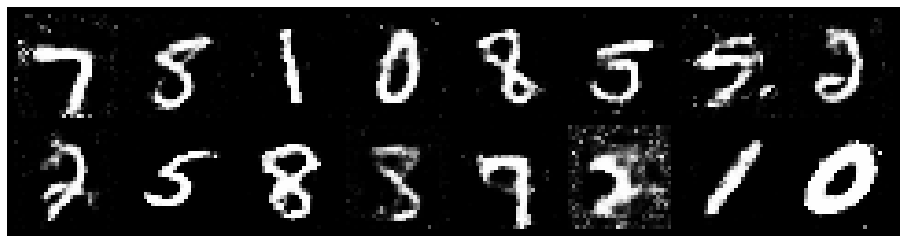

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.2496, Generator Loss: 0.8446
D(x): 0.5757, D(G(z)): 0.4611


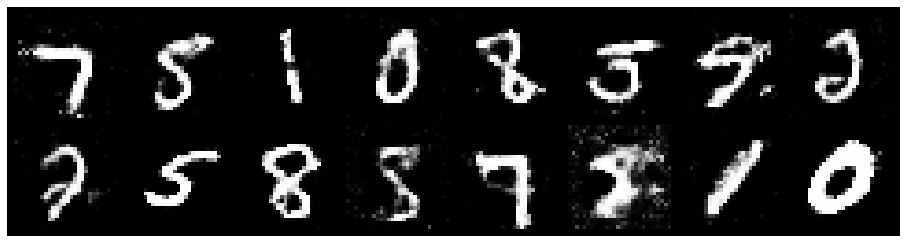

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.3766, Generator Loss: 0.8617
D(x): 0.5553, D(G(z)): 0.4970


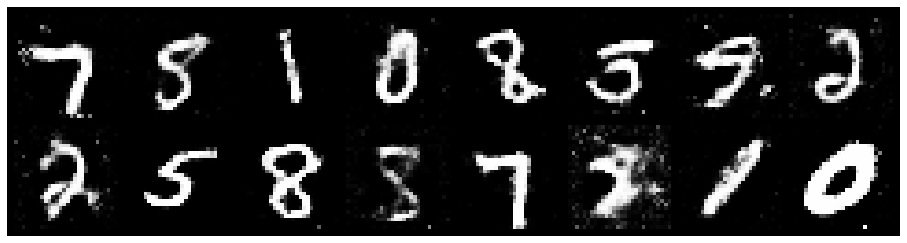

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.3516, Generator Loss: 0.8291
D(x): 0.5592, D(G(z)): 0.4791


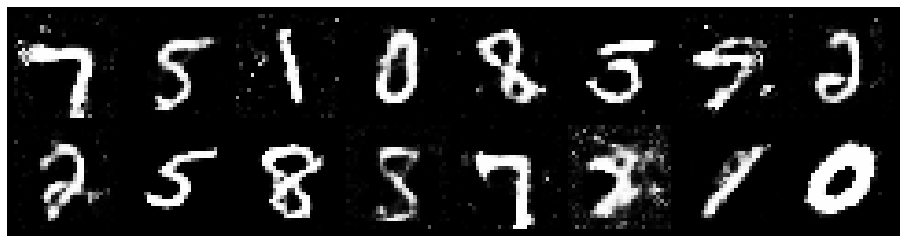

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.3677, Generator Loss: 0.8165
D(x): 0.5335, D(G(z)): 0.4887


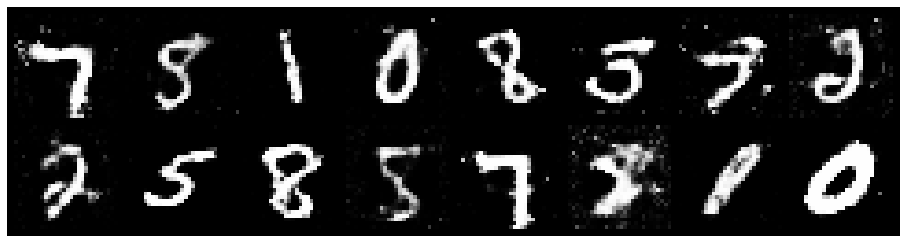

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.3252, Generator Loss: 0.7723
D(x): 0.5358, D(G(z)): 0.4596


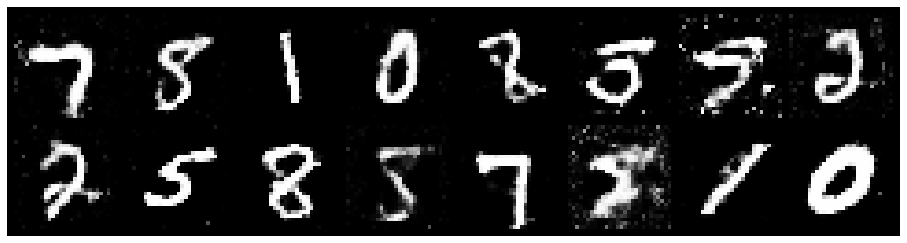

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2137, Generator Loss: 0.8834
D(x): 0.5674, D(G(z)): 0.4416


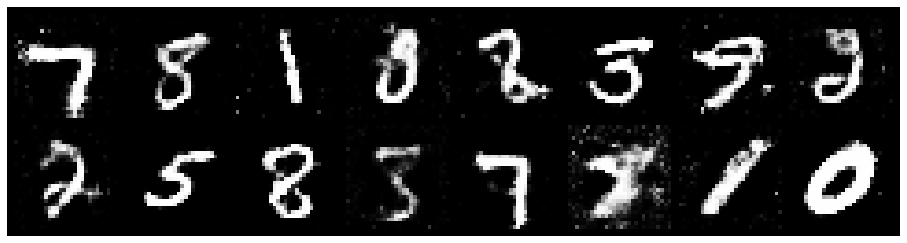

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2627, Generator Loss: 0.8437
D(x): 0.5662, D(G(z)): 0.4415


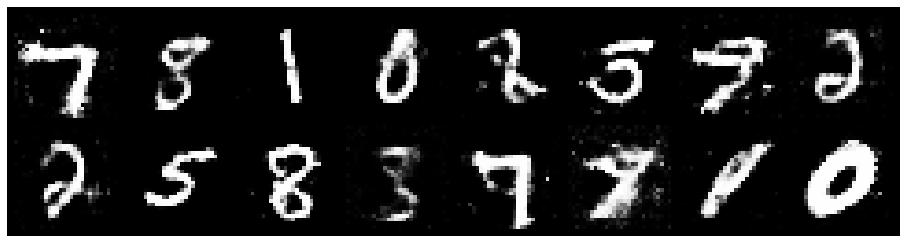

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.1711, Generator Loss: 0.8778
D(x): 0.5922, D(G(z)): 0.4217


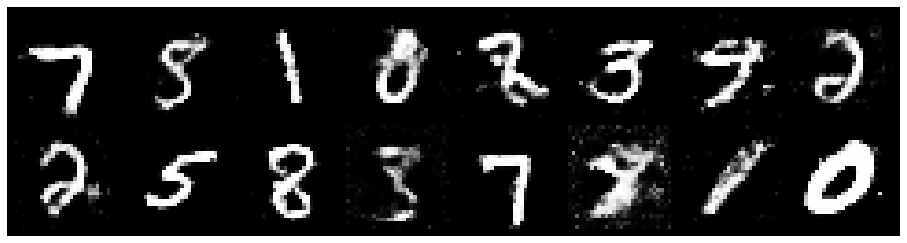

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.3561, Generator Loss: 0.7382
D(x): 0.5590, D(G(z)): 0.4931


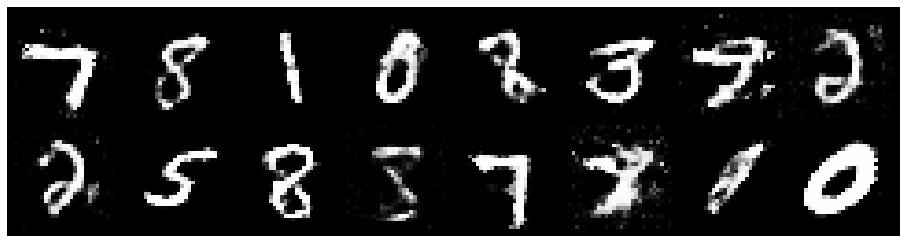

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.3449, Generator Loss: 0.8445
D(x): 0.5071, D(G(z)): 0.4601


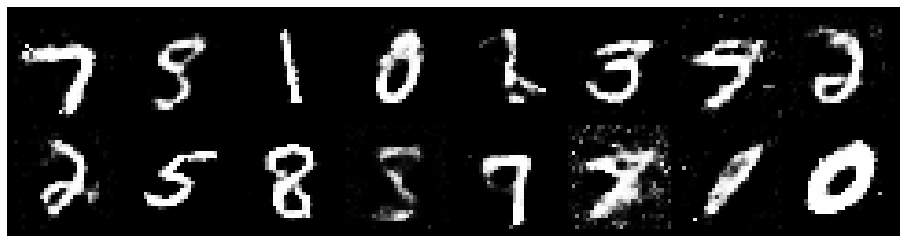

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3071, Generator Loss: 0.7858
D(x): 0.5544, D(G(z)): 0.4599


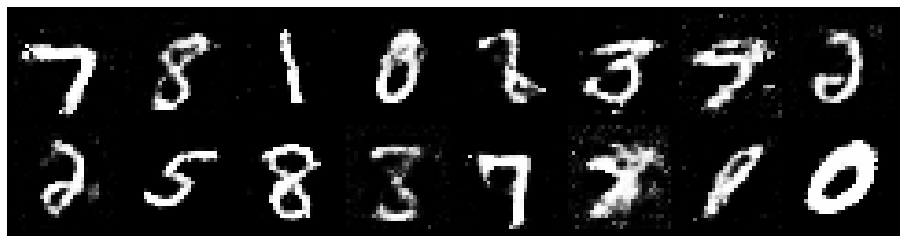

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.2213, Generator Loss: 0.8590
D(x): 0.5461, D(G(z)): 0.4211


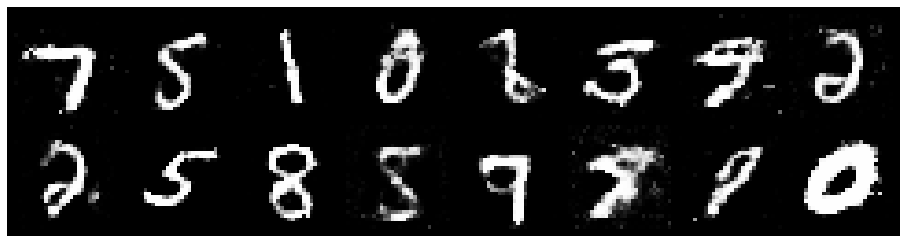

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2661, Generator Loss: 0.9313
D(x): 0.5505, D(G(z)): 0.4332


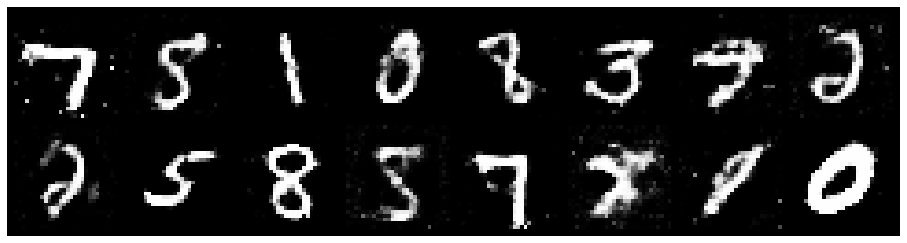

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.2533, Generator Loss: 0.9768
D(x): 0.5480, D(G(z)): 0.4277


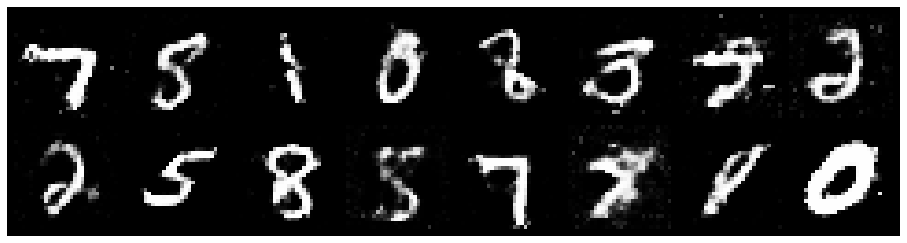

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.3103, Generator Loss: 0.8224
D(x): 0.5065, D(G(z)): 0.4272


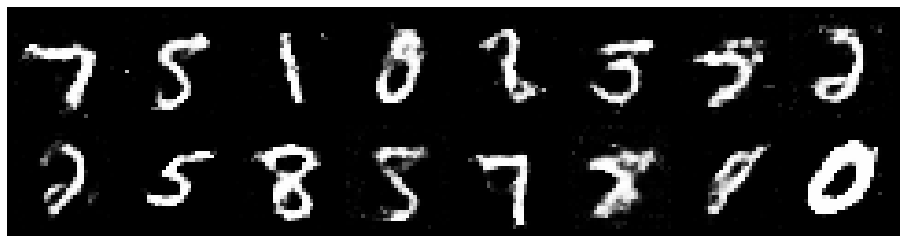

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2655, Generator Loss: 0.8641
D(x): 0.5383, D(G(z)): 0.4457


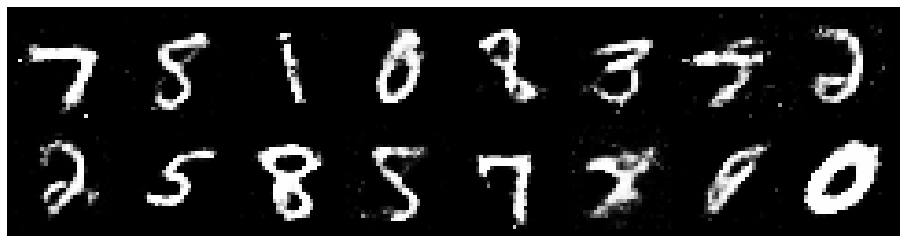

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9678
D(x): 0.5663, D(G(z)): 0.4453


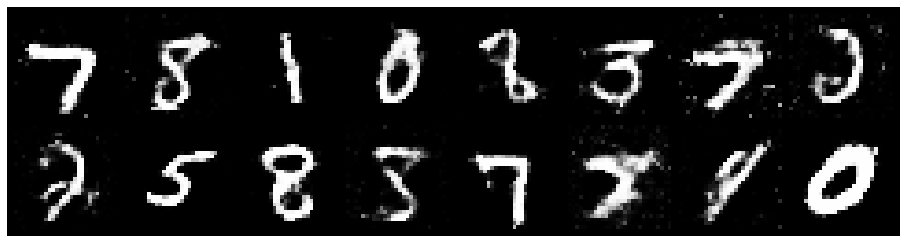

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.3009, Generator Loss: 0.9436
D(x): 0.5624, D(G(z)): 0.4557


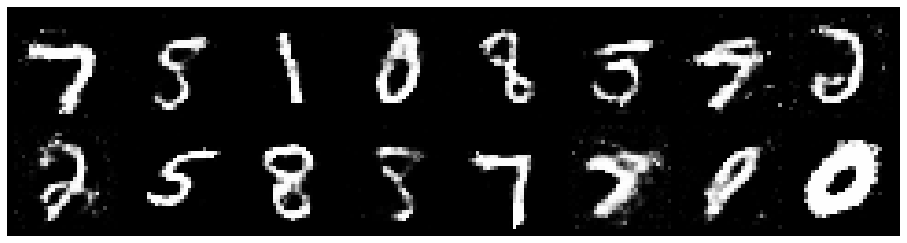

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.3171, Generator Loss: 0.9148
D(x): 0.5596, D(G(z)): 0.4622


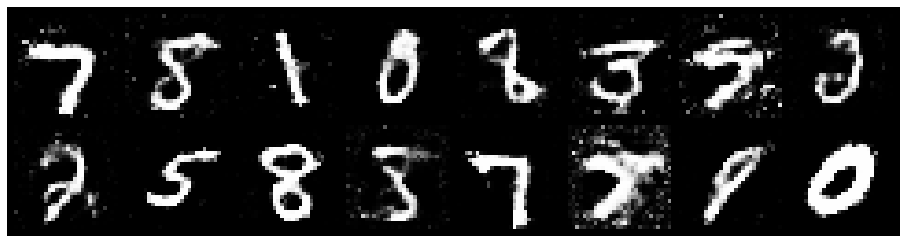

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.3516, Generator Loss: 0.7636
D(x): 0.5319, D(G(z)): 0.4547


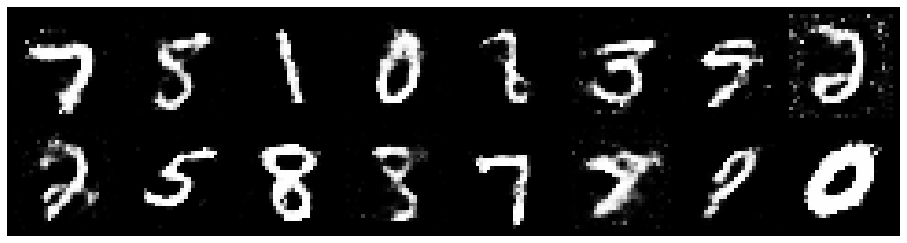

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.2133, Generator Loss: 1.0178
D(x): 0.5757, D(G(z)): 0.4248


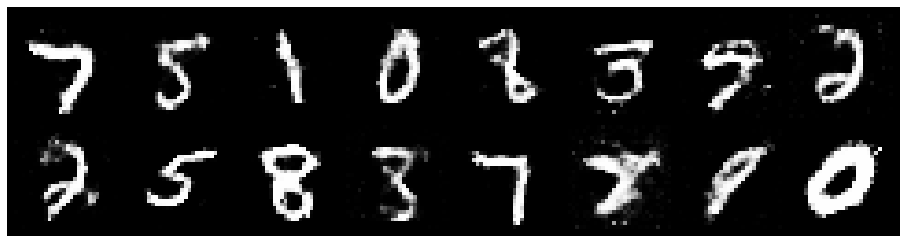

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3045, Generator Loss: 0.7952
D(x): 0.5614, D(G(z)): 0.4546


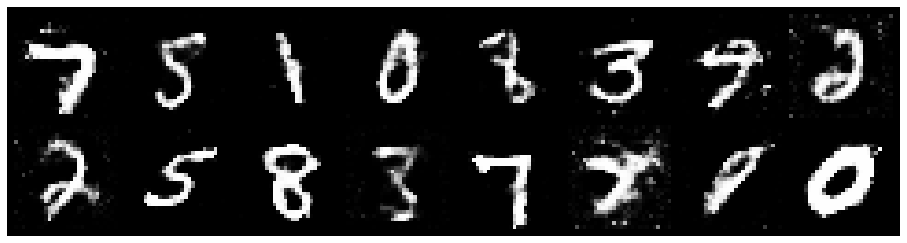

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.3824, Generator Loss: 0.8279
D(x): 0.5285, D(G(z)): 0.4712


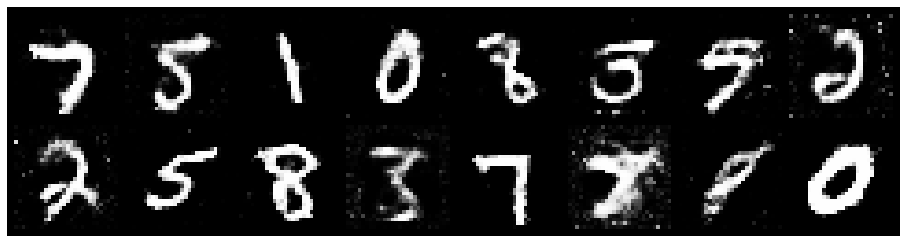

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3523, Generator Loss: 0.8929
D(x): 0.5142, D(G(z)): 0.4530


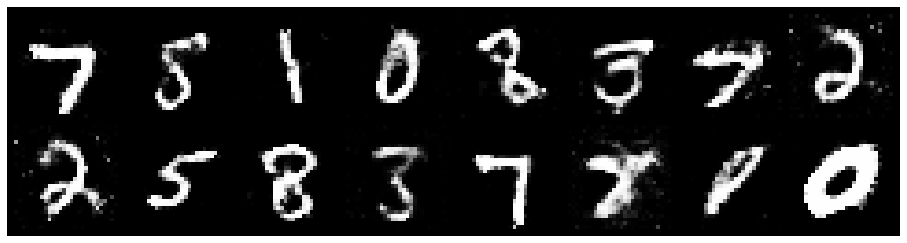

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.2522, Generator Loss: 0.8961
D(x): 0.5573, D(G(z)): 0.4533


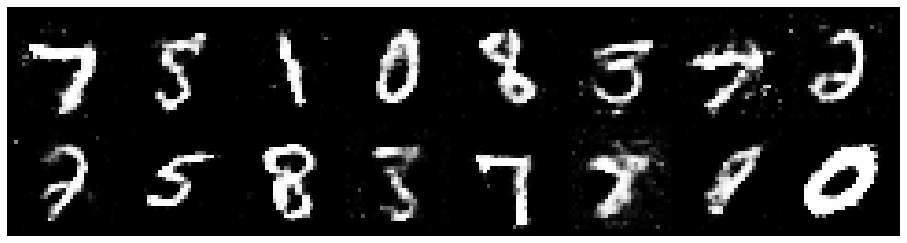

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.3656, Generator Loss: 0.8359
D(x): 0.5180, D(G(z)): 0.4480


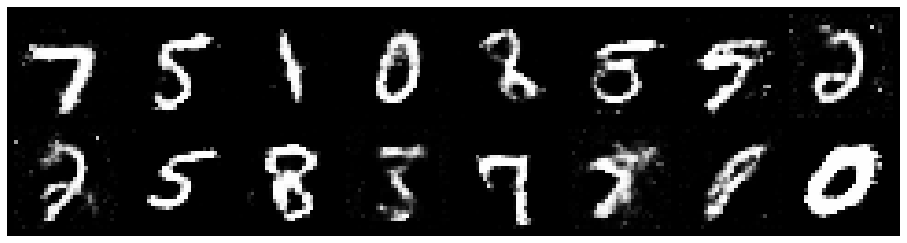

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.3449, Generator Loss: 0.8579
D(x): 0.5019, D(G(z)): 0.4326


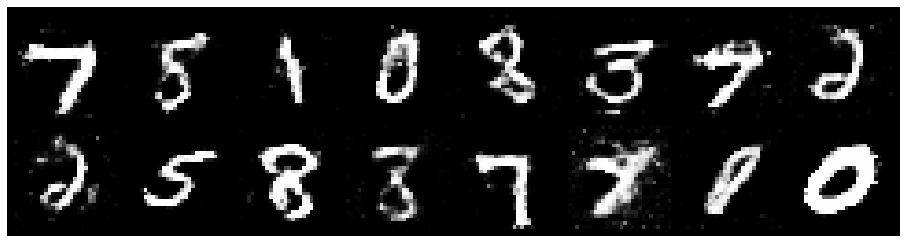

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2027, Generator Loss: 1.0176
D(x): 0.5474, D(G(z)): 0.3974


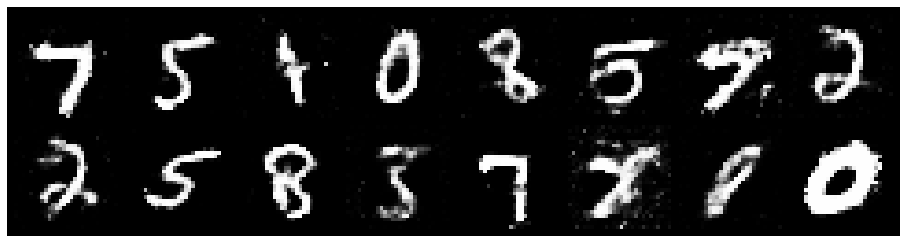

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2461, Generator Loss: 0.8278
D(x): 0.5819, D(G(z)): 0.4671


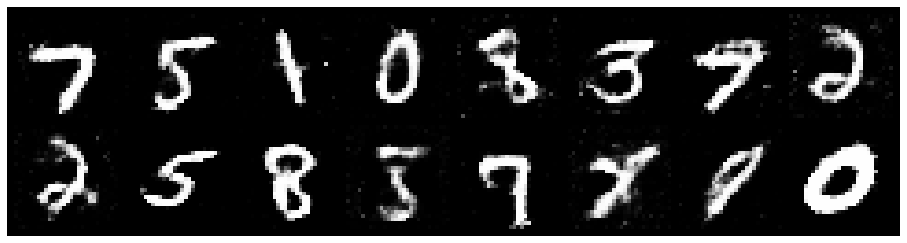

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.2362, Generator Loss: 0.8011
D(x): 0.5619, D(G(z)): 0.4427


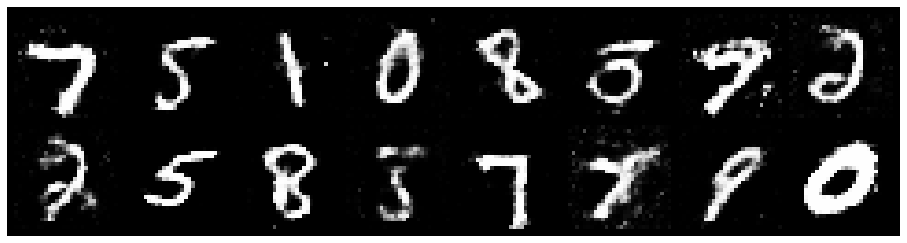

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2935, Generator Loss: 0.8960
D(x): 0.5704, D(G(z)): 0.4591


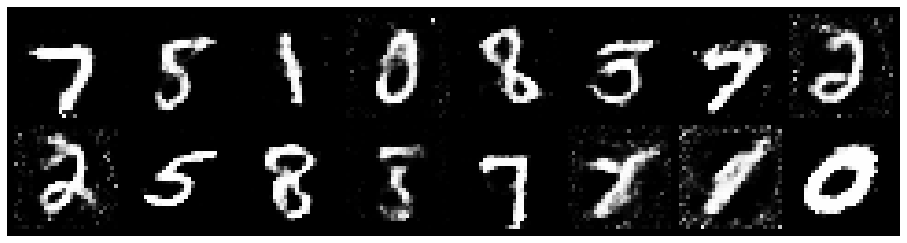

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2224, Generator Loss: 0.9606
D(x): 0.5515, D(G(z)): 0.4198


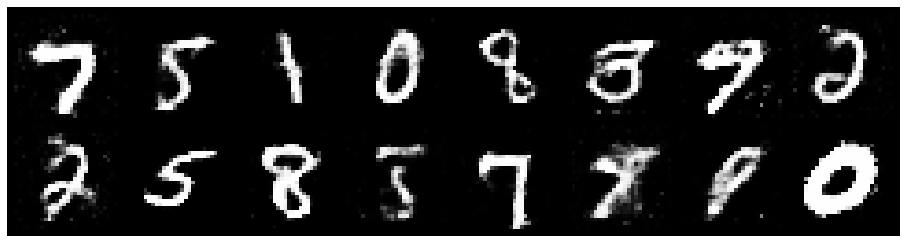

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3412, Generator Loss: 0.9072
D(x): 0.5337, D(G(z)): 0.4448


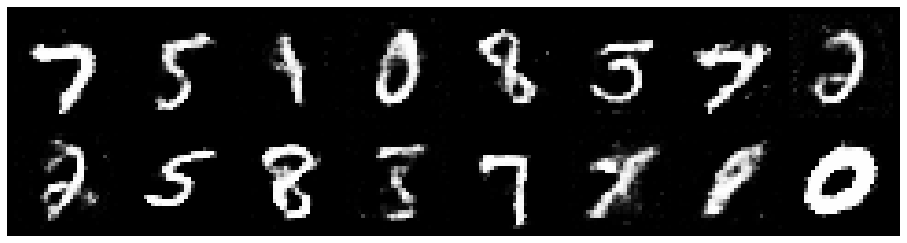

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.4124, Generator Loss: 0.7601
D(x): 0.5277, D(G(z)): 0.4943


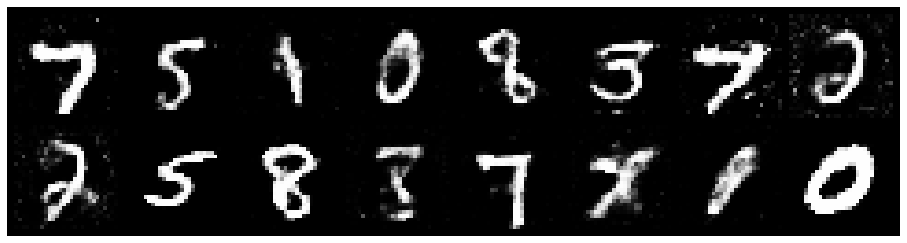

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.2933, Generator Loss: 0.9148
D(x): 0.5217, D(G(z)): 0.4347


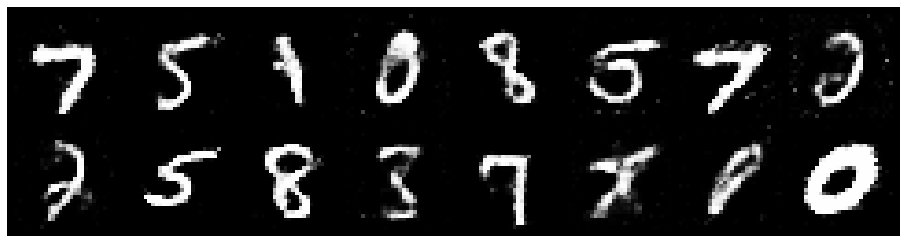

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.2228, Generator Loss: 0.8019
D(x): 0.5873, D(G(z)): 0.4633


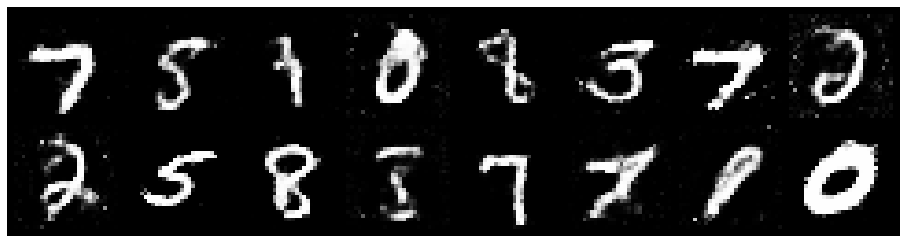

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3318, Generator Loss: 0.8448
D(x): 0.5394, D(G(z)): 0.4574


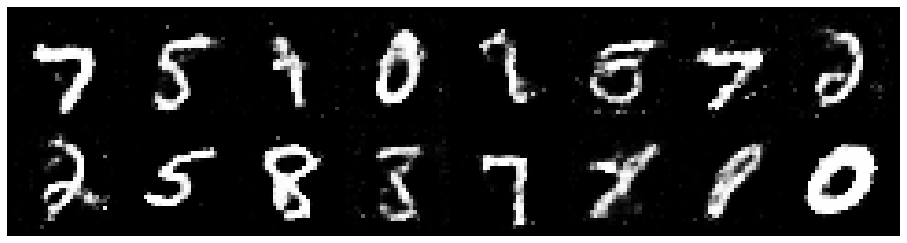

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.3812, Generator Loss: 0.9166
D(x): 0.5447, D(G(z)): 0.4855


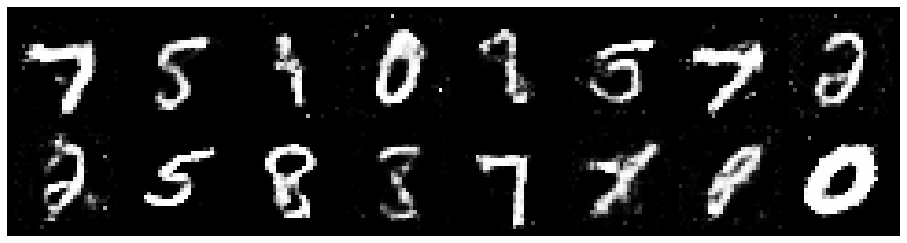

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.2388, Generator Loss: 0.8326
D(x): 0.5808, D(G(z)): 0.4679


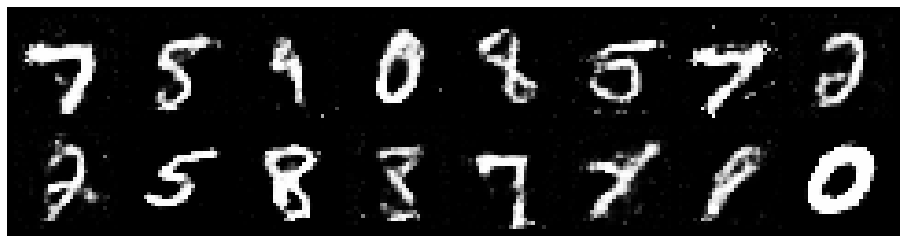

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.4204, Generator Loss: 0.8114
D(x): 0.5344, D(G(z)): 0.4869


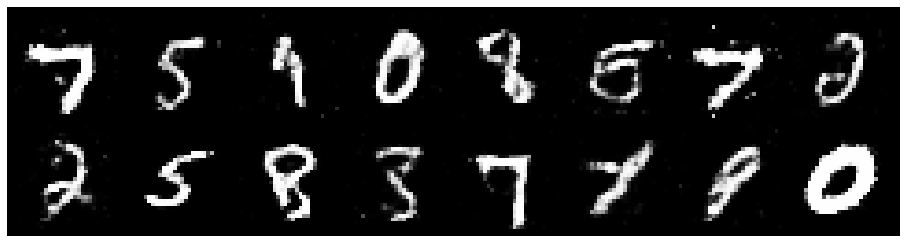

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2756, Generator Loss: 0.8482
D(x): 0.5372, D(G(z)): 0.4488


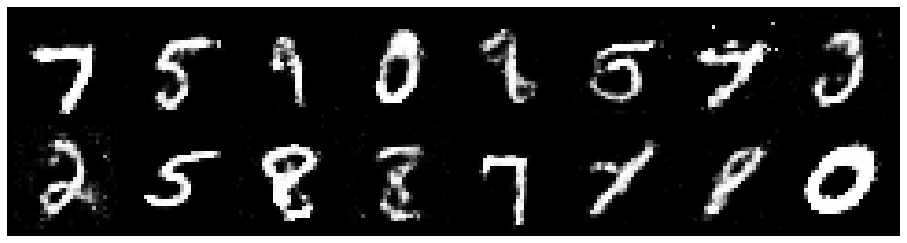

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2521, Generator Loss: 0.9095
D(x): 0.5734, D(G(z)): 0.4631


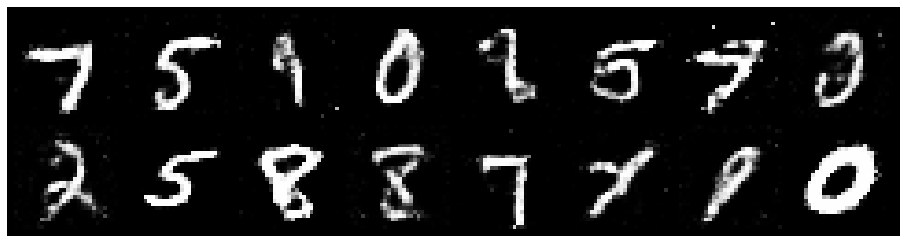

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2851, Generator Loss: 0.8551
D(x): 0.5805, D(G(z)): 0.4825


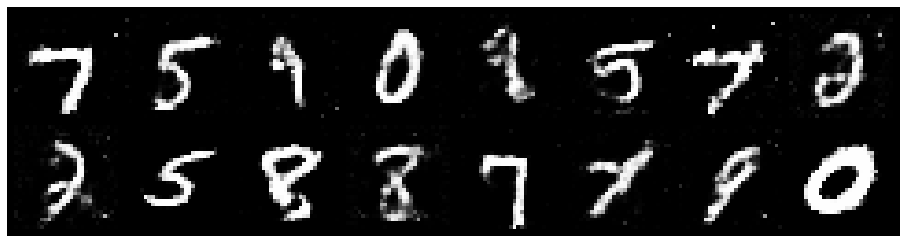

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.3106, Generator Loss: 0.9331
D(x): 0.5013, D(G(z)): 0.4201


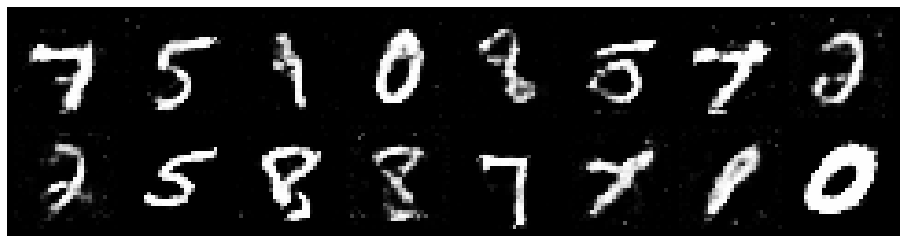

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.1785, Generator Loss: 0.9248
D(x): 0.5524, D(G(z)): 0.4104


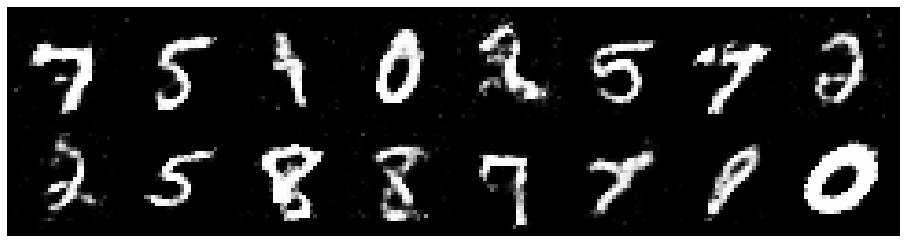

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.3257, Generator Loss: 0.8248
D(x): 0.5601, D(G(z)): 0.4804


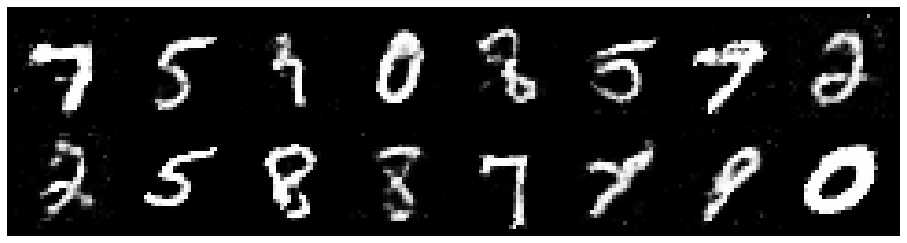

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.3870, Generator Loss: 0.7980
D(x): 0.5452, D(G(z)): 0.4950


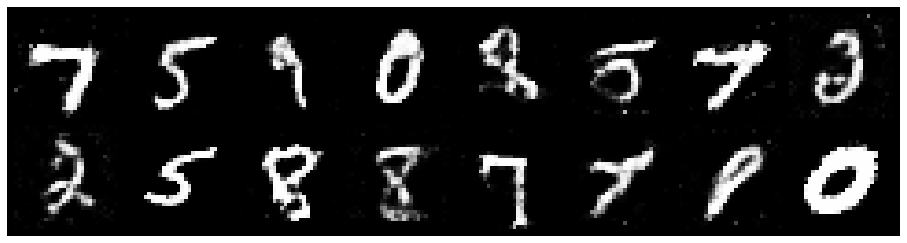

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.2471, Generator Loss: 0.8672
D(x): 0.5661, D(G(z)): 0.4556


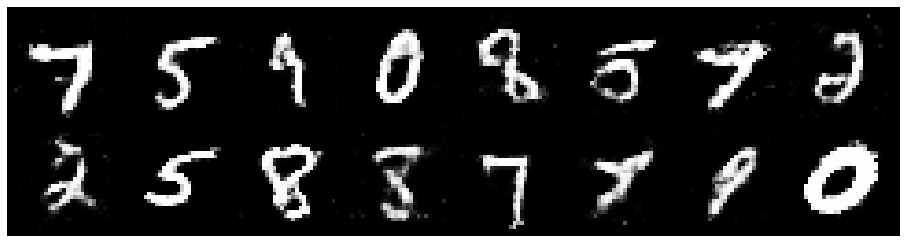

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.3999, Generator Loss: 0.8340
D(x): 0.5172, D(G(z)): 0.4656


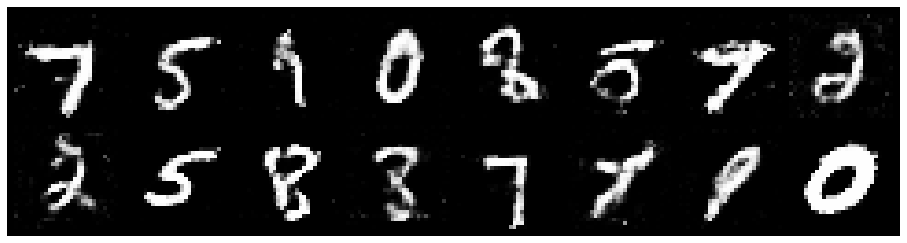

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2959, Generator Loss: 0.8330
D(x): 0.5742, D(G(z)): 0.4743


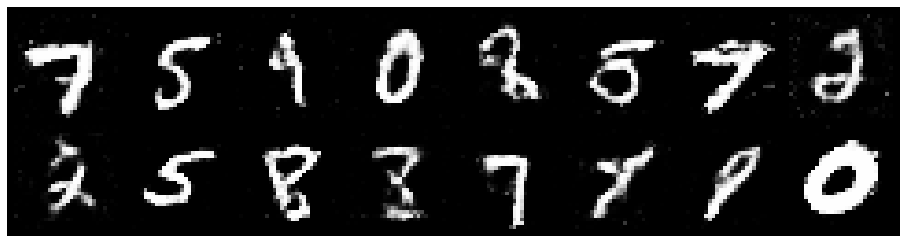

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2856, Generator Loss: 0.8361
D(x): 0.5520, D(G(z)): 0.4572


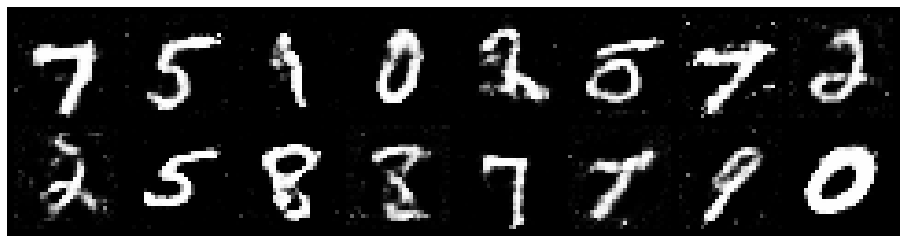

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2457, Generator Loss: 0.8426
D(x): 0.5604, D(G(z)): 0.4411


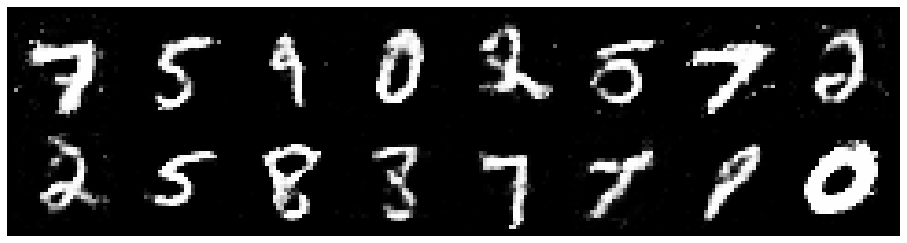

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.1864, Generator Loss: 0.9123
D(x): 0.5749, D(G(z)): 0.4226


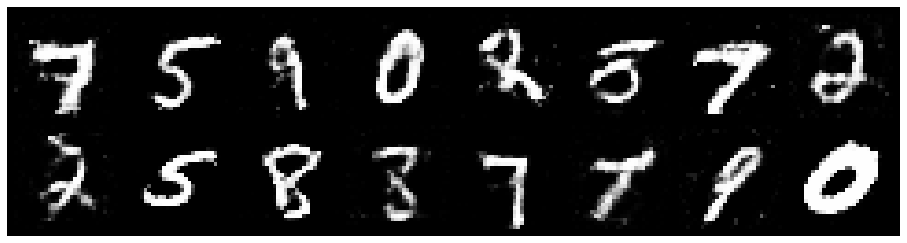

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.2638, Generator Loss: 0.8201
D(x): 0.5618, D(G(z)): 0.4382


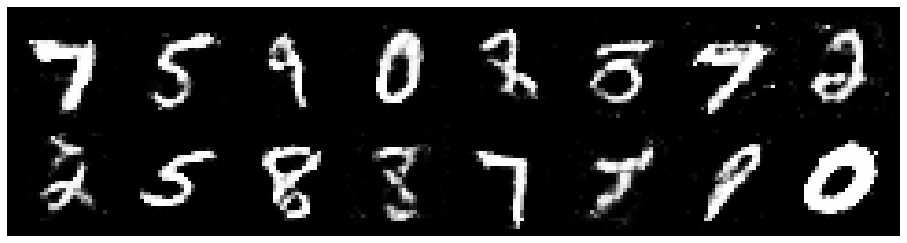

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.2739, Generator Loss: 0.9335
D(x): 0.5486, D(G(z)): 0.4508


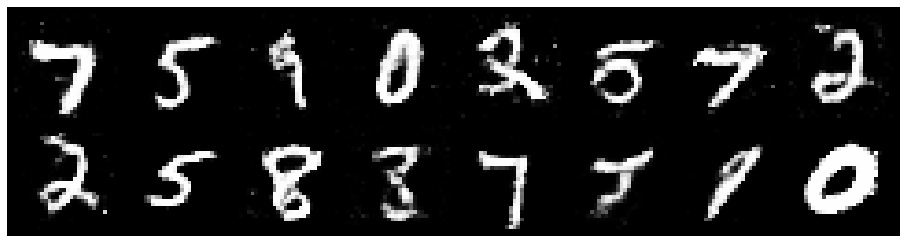

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2347, Generator Loss: 0.8435
D(x): 0.5964, D(G(z)): 0.4805


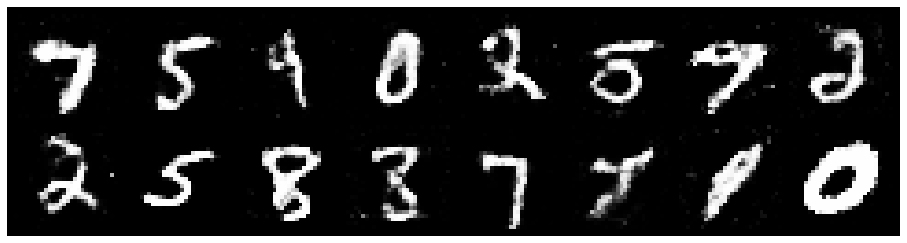

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3205, Generator Loss: 0.8399
D(x): 0.5195, D(G(z)): 0.4367


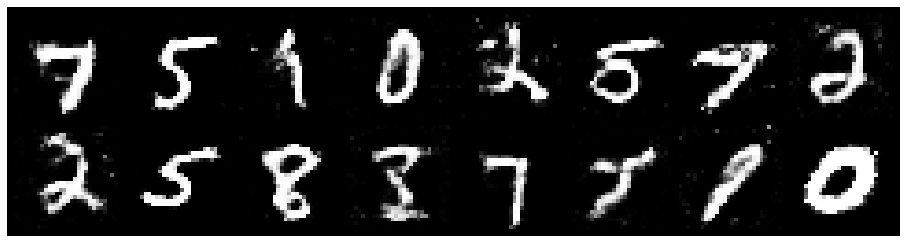

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3876, Generator Loss: 0.7527
D(x): 0.5596, D(G(z)): 0.5103


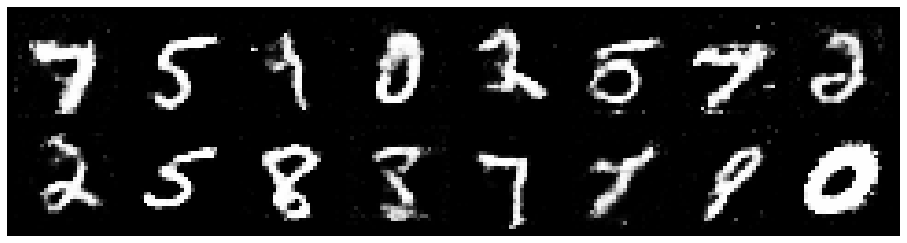

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3042, Generator Loss: 0.9114
D(x): 0.5629, D(G(z)): 0.4616


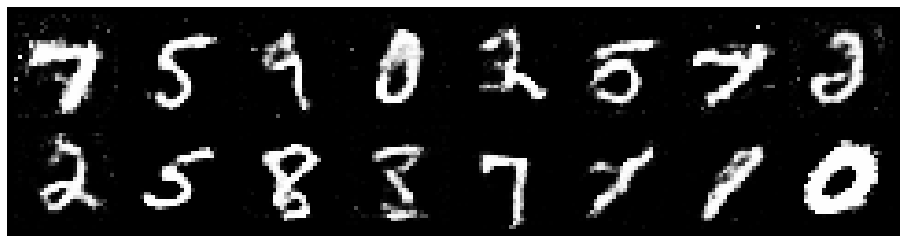

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3402, Generator Loss: 0.8019
D(x): 0.5287, D(G(z)): 0.4798


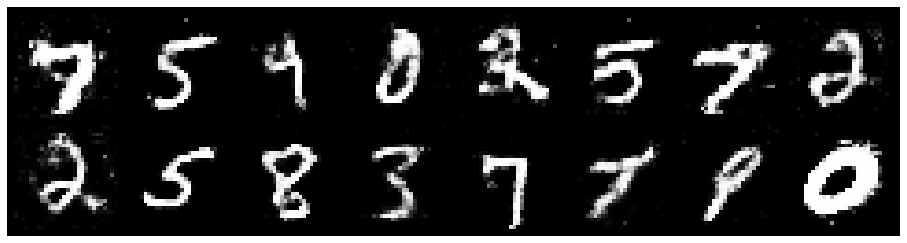

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2342, Generator Loss: 0.8230
D(x): 0.5867, D(G(z)): 0.4731


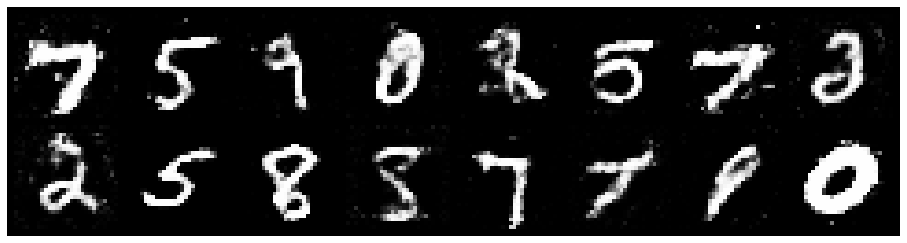

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.1663, Generator Loss: 0.9568
D(x): 0.5761, D(G(z)): 0.4146


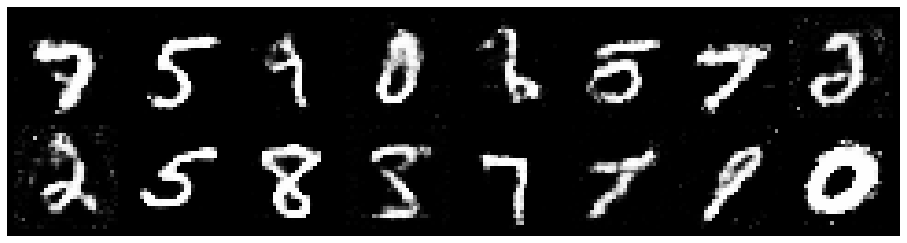

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2622, Generator Loss: 0.8158
D(x): 0.5416, D(G(z)): 0.4347


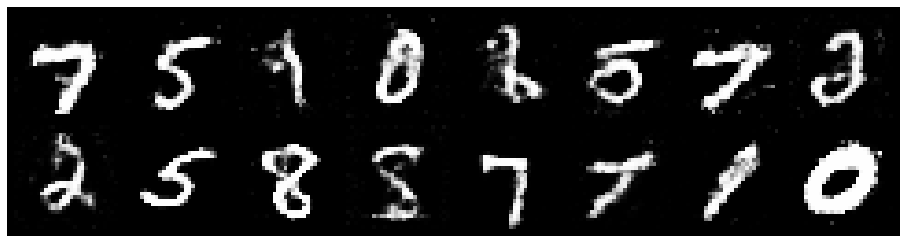

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.3041, Generator Loss: 0.8691
D(x): 0.5155, D(G(z)): 0.4371


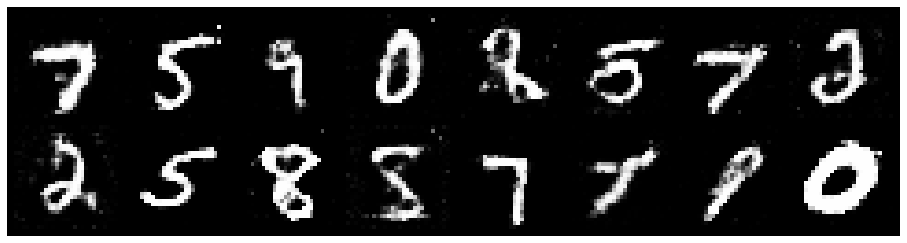

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8285
D(x): 0.5438, D(G(z)): 0.4609


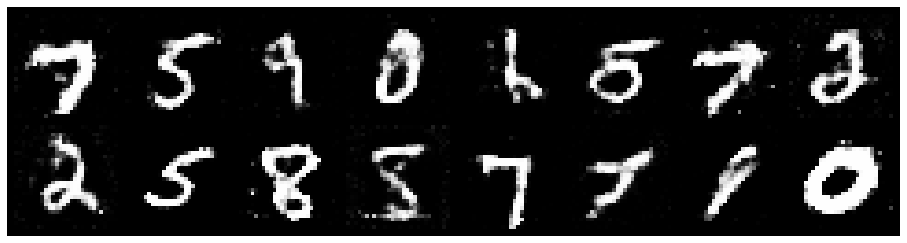

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.3929, Generator Loss: 0.8185
D(x): 0.5098, D(G(z)): 0.4553


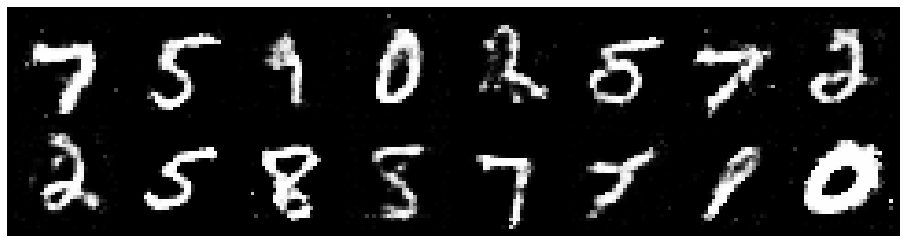

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.3110, Generator Loss: 0.8978
D(x): 0.5065, D(G(z)): 0.4299


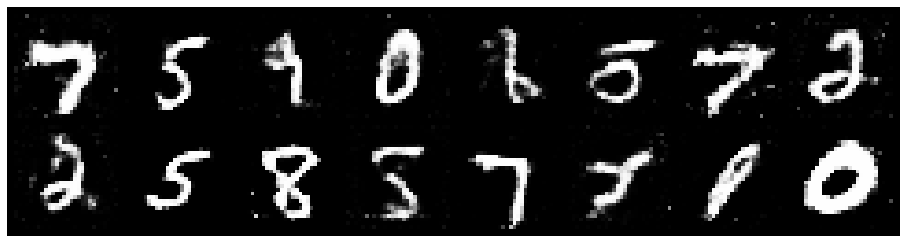

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.2858, Generator Loss: 0.8758
D(x): 0.5275, D(G(z)): 0.4304


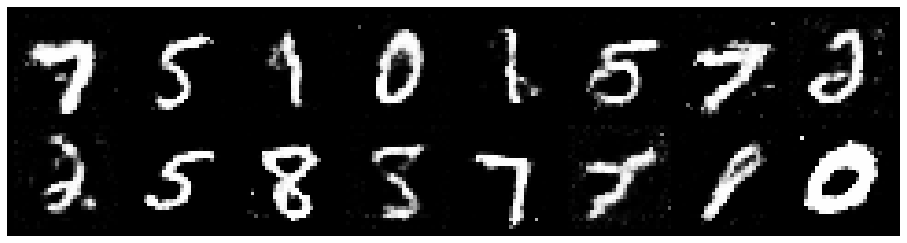

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.2581, Generator Loss: 0.9192
D(x): 0.5560, D(G(z)): 0.4423


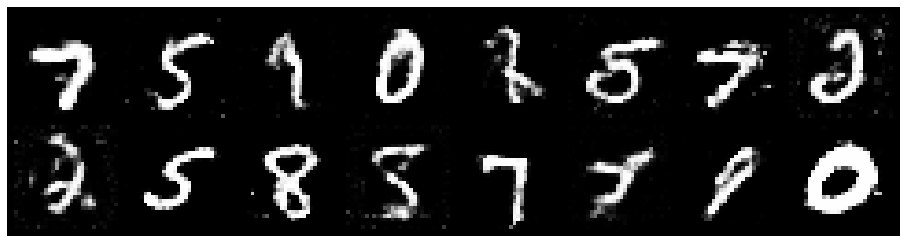

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.3032, Generator Loss: 0.8613
D(x): 0.5394, D(G(z)): 0.4393


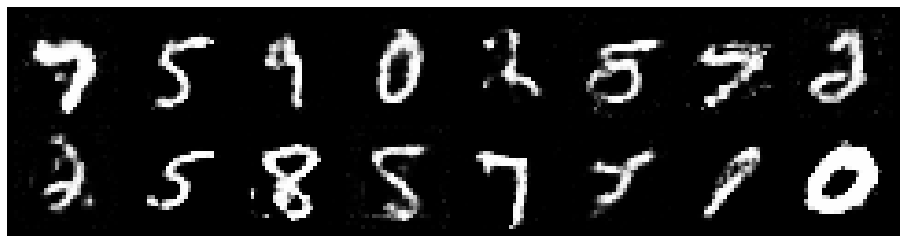

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2811, Generator Loss: 0.8472
D(x): 0.5357, D(G(z)): 0.4373


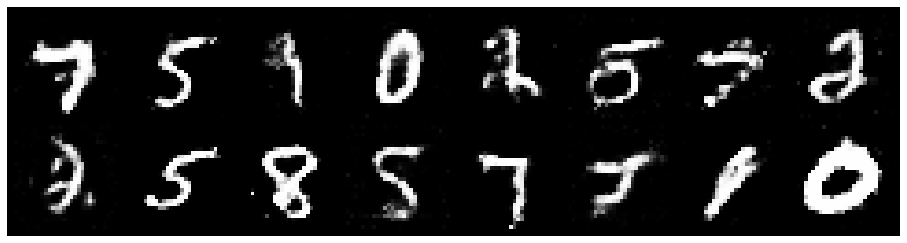

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.2911, Generator Loss: 0.7891
D(x): 0.5340, D(G(z)): 0.4579


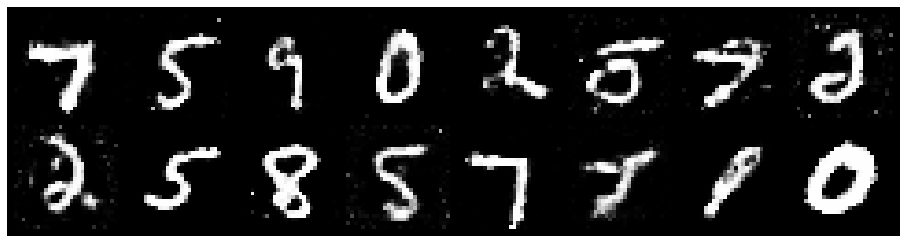

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2677, Generator Loss: 0.9719
D(x): 0.5425, D(G(z)): 0.4434


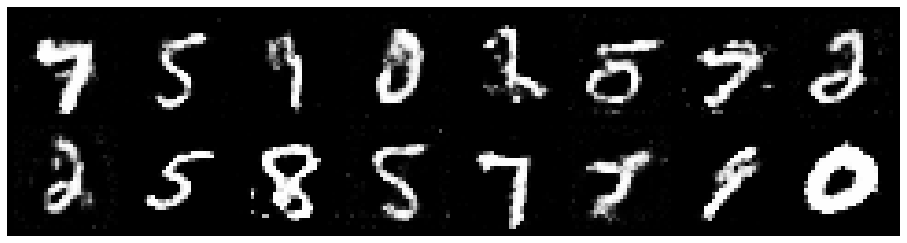

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.3195, Generator Loss: 1.0177
D(x): 0.5429, D(G(z)): 0.4501


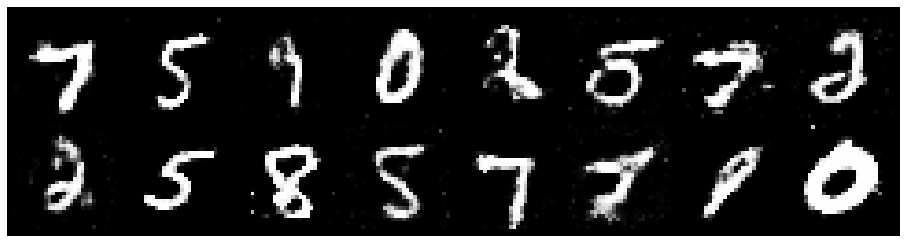

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.3010, Generator Loss: 0.9646
D(x): 0.5166, D(G(z)): 0.4216


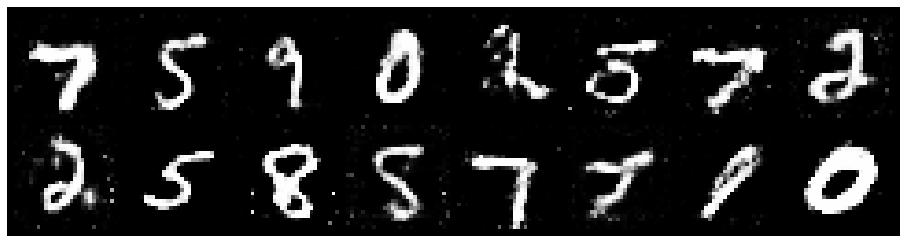

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.2716, Generator Loss: 0.8704
D(x): 0.5554, D(G(z)): 0.4548


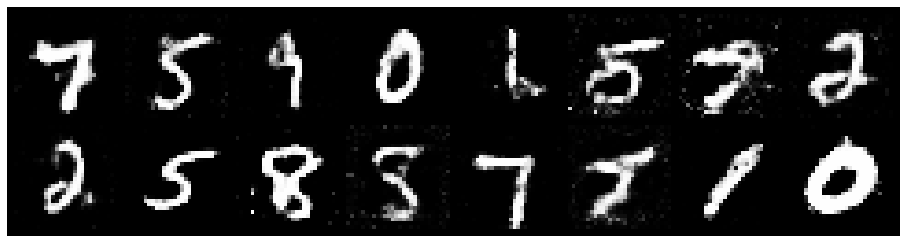

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.3098, Generator Loss: 0.8458
D(x): 0.5465, D(G(z)): 0.4627


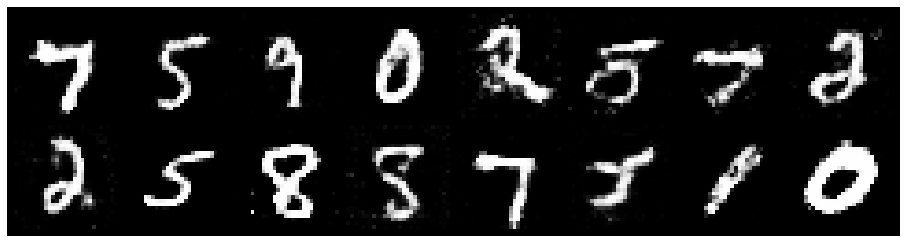

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.2604, Generator Loss: 0.8024
D(x): 0.5504, D(G(z)): 0.4408


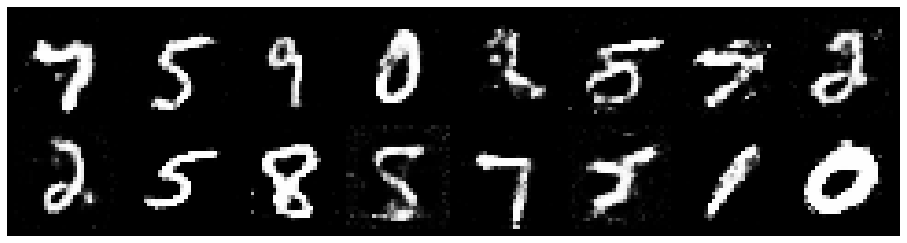

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2538, Generator Loss: 0.8870
D(x): 0.5460, D(G(z)): 0.4227


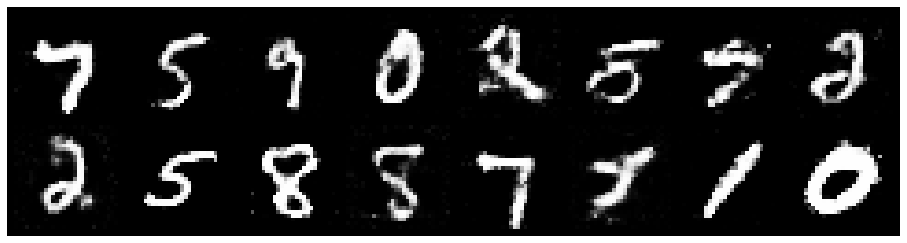

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.3230, Generator Loss: 0.8151
D(x): 0.5147, D(G(z)): 0.4223


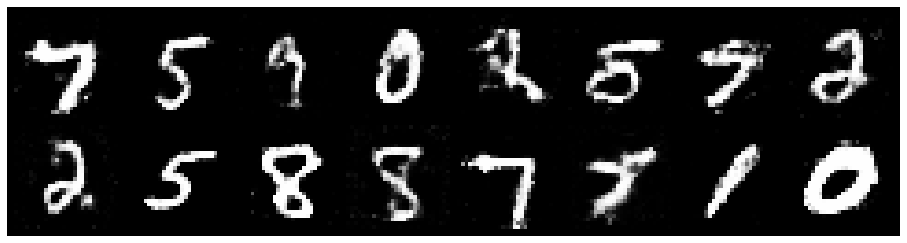

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.2566, Generator Loss: 0.9054
D(x): 0.5458, D(G(z)): 0.4367


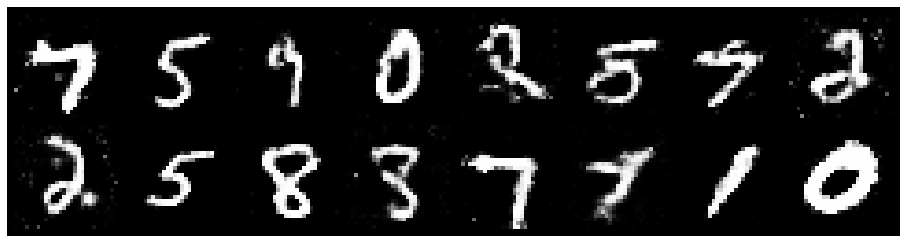

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.4871, Generator Loss: 0.9007
D(x): 0.5004, D(G(z)): 0.4865


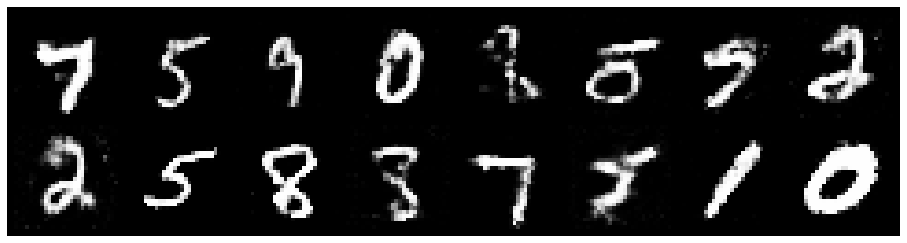

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3825, Generator Loss: 0.8495
D(x): 0.5093, D(G(z)): 0.4732


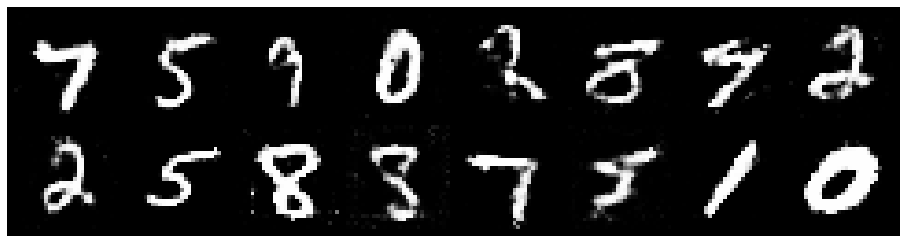

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2781, Generator Loss: 0.7976
D(x): 0.5347, D(G(z)): 0.4419


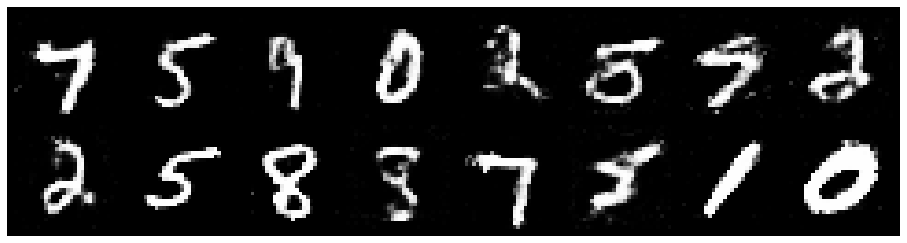

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2194, Generator Loss: 0.8913
D(x): 0.5398, D(G(z)): 0.4170


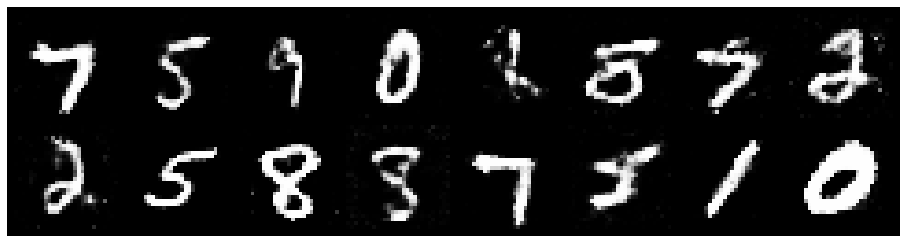

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.3532, Generator Loss: 0.9350
D(x): 0.5014, D(G(z)): 0.4498


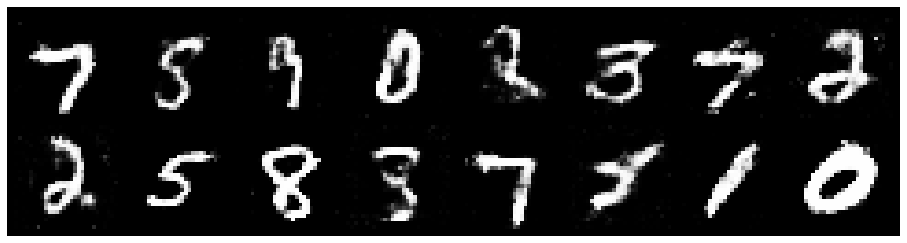

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.1764, Generator Loss: 0.9409
D(x): 0.5556, D(G(z)): 0.3998


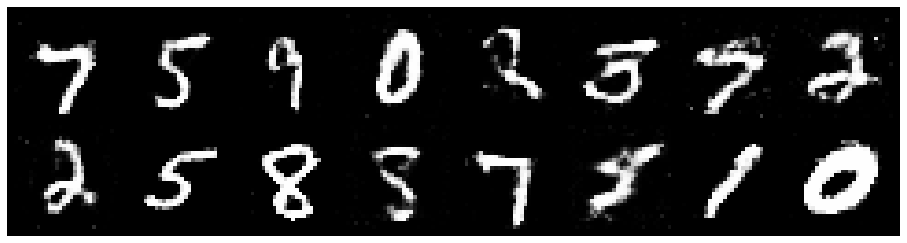

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2368, Generator Loss: 0.8456
D(x): 0.5543, D(G(z)): 0.4278


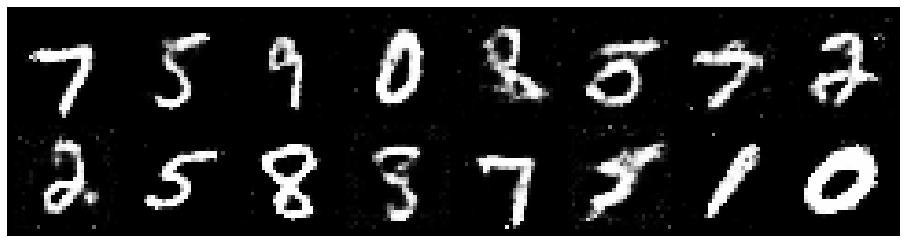

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.3061, Generator Loss: 0.8478
D(x): 0.5665, D(G(z)): 0.4663


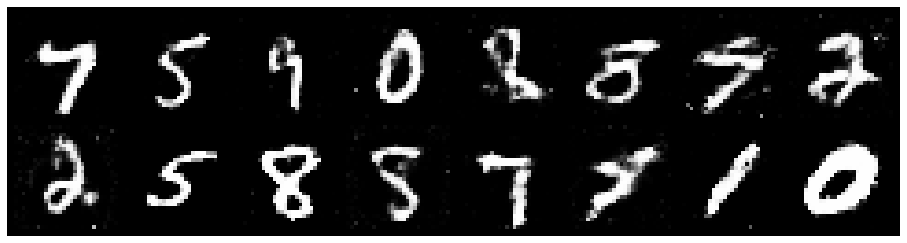

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.2487, Generator Loss: 0.8337
D(x): 0.5323, D(G(z)): 0.4174


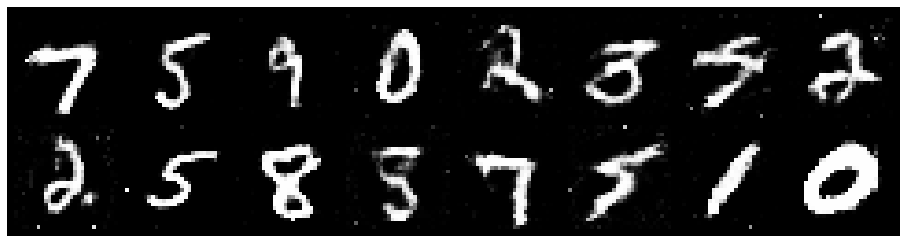

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2488, Generator Loss: 0.7916
D(x): 0.5525, D(G(z)): 0.4345


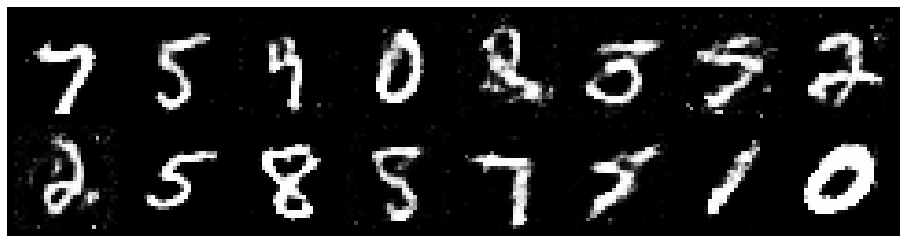

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2112, Generator Loss: 0.9080
D(x): 0.5755, D(G(z)): 0.4460


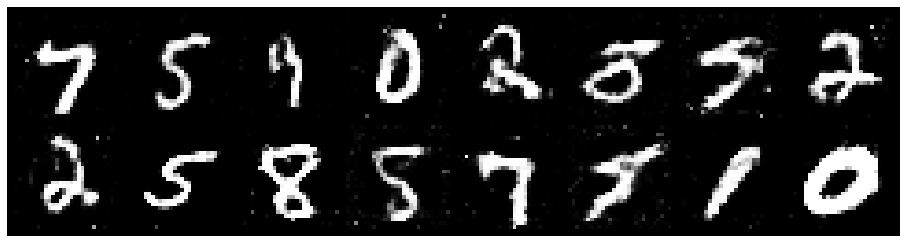

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2840, Generator Loss: 0.8456
D(x): 0.5536, D(G(z)): 0.4483


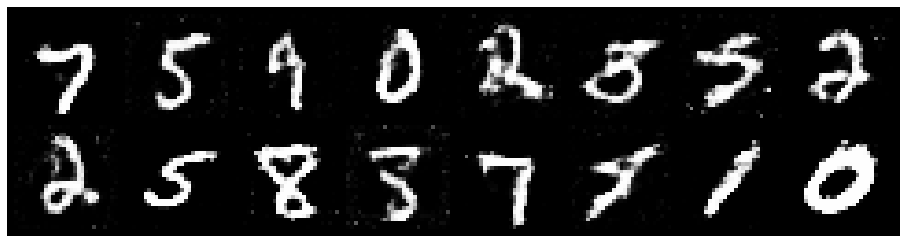

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2922, Generator Loss: 0.8111
D(x): 0.5419, D(G(z)): 0.4654


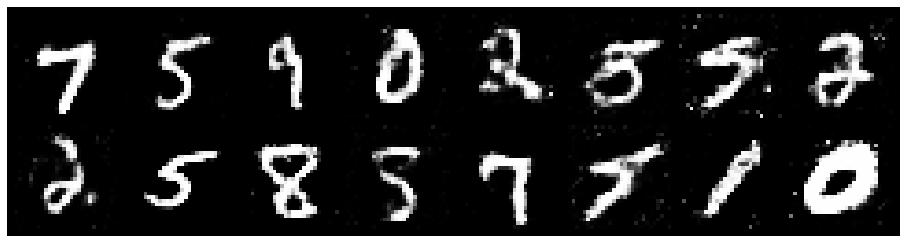

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.1386, Generator Loss: 0.8202
D(x): 0.5916, D(G(z)): 0.4329


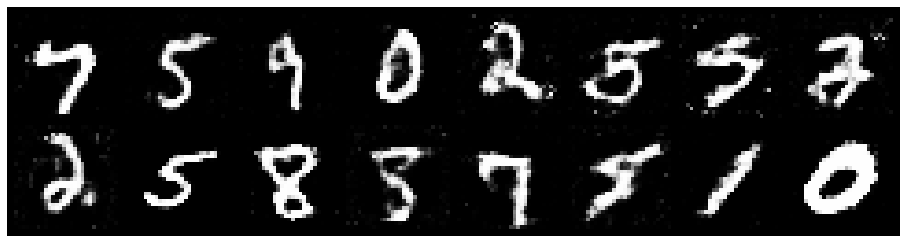

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2616, Generator Loss: 0.9258
D(x): 0.5867, D(G(z)): 0.4631


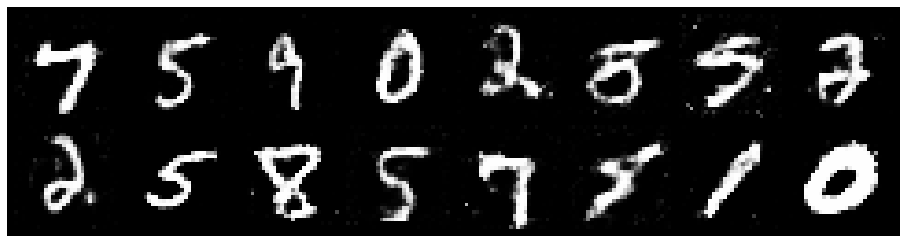

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.3715, Generator Loss: 0.8234
D(x): 0.5681, D(G(z)): 0.4976


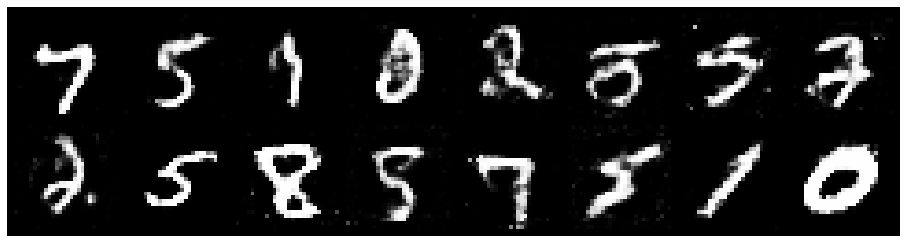

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2525, Generator Loss: 0.9283
D(x): 0.5747, D(G(z)): 0.4557


In [0]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch)).to(device)
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach().to(device)
        # Train D
        d_error, d_pred_real, d_pred_fake = train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images.cpu(), num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error.cpu(), g_error.cpu(), d_pred_real.cpu(), d_pred_fake.cpu()
            )

In [0]:
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip ngrok-stable-linux-amd64.zip

--2019-11-06 20:54:23--  https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
Resolving bin.equinox.io (bin.equinox.io)... 52.4.11.55, 3.223.24.224, 3.221.209.32, ...
Connecting to bin.equinox.io (bin.equinox.io)|52.4.11.55|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13773305 (13M) [application/octet-stream]
Saving to: ‘ngrok-stable-linux-amd64.zip.3’

ngrok-stable-linux- 100%[===================>]  13.13M  6.60MB/s    in 2.0s    

2019-11-06 20:54:26 (6.60 MB/s) - ‘ngrok-stable-linux-amd64.zip.3’ saved [13773305/13773305]

Archive:  ngrok-stable-linux-amd64.zip
replace ngrok? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: ngrok                   


In [0]:
!ls ./runs

Nov06_15-12-47_d88c9c817707VGAN_MNIST  Nov06_18-21-57_d88c9c817707VGAN_MNIST


In [0]:
LOG_DIR = './runs'
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)

In [0]:
get_ipython().system_raw('./ngrok http 6006 &')

In [0]:
! curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

https://113dd903.ngrok.io
